In [1]:
import sys, os, argparse, io
import numpy as np
import pandas as pd
from pathlib import Path
import matplotlib.pyplot as plt
import unyt as u
from widom_analysis import widom_analysis
import scipy.stats
import math
from numpy.random import default_rng
from IPython.display import display

In [48]:
def get_thermo_data(logname, skiplines=0, skipblocks=0, applyfirstskip=True, maxiter=10000):
    logpath = Path(logname)
    with logpath.open() as logfile, io.StringIO() as thermobuffer:
        linestr = ' '
        for i in range(skipblocks+1):
            linestr = logfile.readline()
            while linestr and not ('Per MPI rank memory allocation' in linestr):
                linestr = logfile.readline()
        thermobuffer.write(logfile.readline())
        if applyfirstskip:
            for j in range(skiplines):
                logfile.readline()
        linestr = logfile.readline()
        while linestr and not ('Loop time of' in linestr):
            thermobuffer.write(linestr)
            linestr = logfile.readline()
        for i in range(maxiter-1):
            while linestr and not ('Per MPI rank memory allocation' in linestr):
                linestr = logfile.readline()
            if not linestr:
                break
            logfile.readline()
            for j in range(skiplines):
                logfile.readline()
            linestr = logfile.readline()
            while linestr and not ('Loop time of' in linestr):
                thermobuffer.write(linestr)
                linestr = logfile.readline()
        thermobuffer.seek(0)
        thermodf = pd.read_csv(thermobuffer, delim_whitespace=True)
    return thermodf

In [49]:
def readlog(logpath):
    logpath = Path(logpath)
    outdict = {}
    tmult = {'secs.': 1,
             'mins.': 60,
             'hrs.': 3600,
             'Years': 3600*24*365,
             'Months': 3600*24*30,
             'Days': 3600*24,
             'Hours': 3600,
             'Minutes': 60,
             'Seconds': 1,
             'ms': 0.001,
            }
    with logpath.open() as logfile:
        linelist = logfile.readlines()
    for iline, linestr in enumerate(linelist):
        if 'chemical potential for species 3' in linestr:
            overlapsplit = linelist[iline+1].strip().split()
            outdict["overlap_r32"] = int(overlapsplit[0])
            outdict["attempts_r32"] = int(overlapsplit[-1])
            if "CPU time:" in linelist[iline+2]:
                outdict["t_cpu_r32"] = float(linelist[iline+2].strip().split()[-2])
            if "Wallclock time:" in linelist[iline+3]:
                outdict["t_wallclock_r32"] = float(linelist[iline+3].strip().split()[-2])
            if "Recommended pair U*_max" in linelist[iline+4]:
                outdict["rec_Umax_r32"] = float(linelist[iline+4].split('=')[-1].strip().split()[0])
                outdict["rec_Umax_nskips_r32"] = int(linelist[iline+4].strip().split()[-3])
        elif 'chemical potential for species 4' in linestr:
            overlapsplit = linelist[iline+1].strip().split()
            outdict["overlap_r125"] = int(overlapsplit[0])
            outdict["attempts_r125"] = int(overlapsplit[-1])
            if "CPU time:" in linelist[iline+2]:
                outdict["t_cpu_r125"] = float(linelist[iline+2].strip().split()[-2])
            if "Wallclock time:" in linelist[iline+3]:
                outdict["t_wallclock_r125"] = float(linelist[iline+3].strip().split()[-2])
            if "Recommended pair U*_max" in linelist[iline+4]:
                outdict["rec_Umax_r125"] = float(linelist[iline+4].split('=')[-1].strip().split()[0])
                outdict["rec_Umax_nskips_r125"] = int(linelist[iline+4].strip().split()[-3])
        elif 'Widom time =' in linestr:
            wtimesplit = linestr.strip().split('=')[-1].strip().split()
            outdict["wtime"] = float(wtimesplit[0])*tmult[wtimesplit[1]] # convert time to seconds
        elif 'Program execution time' in linestr:
            time_lines = linelist[(iline+2):(iline+9)]
            cputime = 0.0
            for tline in time_lines:
                tlinesplit = tline.strip().split()
                cputime += float(tlinesplit[0])*tmult[tlinesplit[1]]
            outdict["cputime"] = cputime # cpu time in seconds
    return outdict

In [50]:
def readlog_mi(logpath):
    logpath = Path(logpath)
    species = None
    speclist = ['cation', 'anion', 'R-32', 'R-125']
    outdict = {}
    tmult = {'secs.': 1,
             'mins.': 60,
             'hrs.': 3600,
             'Years': 3600*24*365,
             'Months': 3600*24*30,
             'Days': 3600*24,
             'Hours': 3600,
             'Minutes': 60,
             'Seconds': 1,
             'ms': 0.001,
            }
    with logpath.open() as logfile:
        linelist = logfile.readlines()
    for iline, linestr in enumerate(linelist):
        if 'chemical potential for species' in linestr:
            ispecies = int(linestr.split('chemical potential for species')[-1].strip().split()[0])-1
            species = speclist[ispecies]
        elif "Widom insertions with overlap out of" in linestr and species:
            outdict.setdefault("overlaps", {})
            outdict.setdefault("attempts", {})
            overlapsplit = linestr.strip().split()
            outdict["overlaps"][species] = int(overlapsplit[0])
            outdict["attempts"][species] = int(overlapsplit[-1])
        elif "CPU time:" in linestr and species:
            outdict.setdefault("t_cpu", {})
            outdict["t_cpu"][species] = float(linestr.strip().split()[-2])
        elif "Wallclock time:" in linestr and species:
            outdict.setdefault("t_wallclock", {})
            outdict["t_wallclock"][species] = float(linestr.strip().split()[-2])
        elif "Recommended pair U*_max" in linestr and species:
            outdict.setdefault("rec_Umax", {})
            outdict.setdefault("rec_Umax_overlaps", {})
            outdict["rec_Umax"][species] = float(linestr.split('=')[-1].strip().split()[0])
            outdict["rec_Umax_overlaps"][species] = int(linestr.strip().split()[-3])
        elif "*****************" in linestr:
            species = None
        elif 'Widom time =' in linestr:
            wtimesplit = linestr.strip().split('=')[-1].strip().split()
            outdict["wtime"] = float(wtimesplit[0])*tmult[wtimesplit[1]] # convert time to seconds
        elif 'Program execution time' in linestr:
            time_lines = linelist[(iline+2):(iline+9)]
            cputime = 0.0
            for tline in time_lines:
                tlinesplit = tline.strip().split()
                cputime += float(tlinesplit[0])*tmult[tlinesplit[1]]
            outdict["cputime"] = cputime # cpu time in seconds
    return outdict

In [51]:
def extract_data(tgt_dir,nsplits=10):
    tgt_dir = Path(tgt_dir)
    r32_wprp2 = Path(tgt_dir,'cas_widom.out.spec3.wprp2')
    r125_wprp2 = Path(tgt_dir,'cas_widom.out.spec4.wprp2')
    logpath = Path(tgt_dir,'cas_widom.out.log')
    r32_wmat = np.stack([np.mean(a,0) for a in np.split(np.loadtxt(r32_wprp2).T,nsplits)]) # one row per split
    r125_wmat = np.stack([np.mean(a,0) for a in np.split(np.loadtxt(r125_wprp2).T,nsplits)]) # one row per split
    logseries = pd.Series(readlog(logpath))
    return logseries, r32_wmat, r125_wmat

In [52]:
def convergence_data(tgt_dir,nsplits=10):
    tgt_dir = Path(tgt_dir)
    r32_wprp2 = Path(tgt_dir,'cas_widom.out.spec3.wprp2')
    r125_wprp2 = Path(tgt_dir,'cas_widom.out.spec4.wprp2')
    r32_wmat_full = np.loadtxt(r32_wprp2)
    r125_wmat_full = np.loadtxt(r125_wprp2)
    r32_split_convergence = np.dstack([np.cumsum(a,axis=1)/(np.arange(100/nsplits)+1) for a in np.split(r32_wmat_full,nsplits,axis=1)])
    r125_split_convergence = np.dstack([np.cumsum(a,axis=1)/(np.arange(100/nsplits)+1) for a in np.split(r125_wmat_full,nsplits,axis=1)])
    r32_convergence = np.cumsum(r32_wmat_full,axis=1)/(np.arange(100)+1)
    r125_convergence = np.cumsum(r125_wmat_full,axis=1)/(np.arange(100)+1)
    return r32_convergence, r125_convergence, r32_split_convergence, r125_split_convergence, r32_wmat_full, r125_wmat_full

In [53]:
IL_list = ['BMIM_SCN', 'BMIM_BF4', 'BMIM_PF6', 'HMIM_BF4', 'HMIM_Cl']
V_dict = {IL: get_thermo_data(IL+"/lmp_2_prod.log",1).Volume.mean() * u.Angstrom ** 3 for IL in IL_list}
w_empty = np.array([0.3630331955330950617790E+09, 0.2883213781188606779360E-03])
kH_numerator = 400 * (u.kb * (298.15 * u.K) / (100.0 * u.Angstrom)**3).to_value('MPa') * w_empty
mu_prefactor = - (u.kb * (298.15 * u.K)).to_value('kJ/mol')

In [54]:
kH_numerator

array([5.97756577e+08, 4.74738955e-04])

In [55]:
hrex_H_r32 = np.array([
    1.52,
    0.93,
    0.94,
    0.73,
    0.224,
])
hrex_H_r125 = np.array([
    9.66,
    4.062,
    3.41,
    2.174,
    0.52,
])
hrex_H_r32_uc = np.array([
    0.04,
    0.03,
    0.03,
    0.02,
    0.0,
])
hrex_H_r125_uc = np.array([
    0.3,
    0.1,
    0.1,
    0.06,
    0.0,
])
hrex_isel = hrex_H_r125/hrex_H_r32
hrex_isel_uc = hrex_isel * np.sqrt((hrex_H_r125_uc/hrex_H_r125)**2+(hrex_H_r32_uc/hrex_H_r32)**2)
hrex_isel

array([6.35526316, 4.36774194, 3.62765957, 2.97808219, 2.32142857])

In [56]:
def cdf(wvec):
    wsort = np.sort(wvec)
    p_axis = np.flip(np.linspace(1.0, 0.0, num=len(wvec), endpoint=False))
    return wsort, p_axis

In [57]:
def pdf(wvec):
    wsort = np.sort(wvec)
    dw = wsort[1:]-wsort[:-1]
    dp = 1.0/len(wsort)
    pdf = dp/dw
    pdf_w_axis = dw*0.5+wsort[:-1]
    return pdf_w_axis, pdf

In [58]:
def calc_mu_shift(wvec, axis = None, T=298.15*u.K):
    return (-u.kb*T*np.log(wvec.mean(axis))).to('kJ/mol')

In [59]:
mu_ig_100angstroms_dict = {"r32": -48.860310173976*u.Unit('kJ/mol'), "r125": 20.207079409230 * u.Unit('kJ/mol')}

In [60]:
def calc_mu_ex(wvec, species, V, axis = None, T=298.15*u.K):
    V_ig = (100.0 * u.Angstrom) ** 3
    mu_ig_100angstroms = mu_ig_100angstroms_dict[species]
    mu_ig = mu_ig_100angstroms - u.kb * T * np.log(V/V_ig)
    mu_ex = calc_mu_shift(wvec, axis, T) - mu_ig
    return mu_ex

In [61]:
def calc_Henry(wvec, species, IL, axis=None, T=298.15*u.K):
    V = V_dict[IL]
    mu_ex = calc_mu_ex(wvec, species, V, axis, T)
    density = 400.0 / V
    beta = 1.0/(u.kb * T)
    H = u.kb * T * density * np.exp((beta*mu_ex).to(''))
    return H.to("MPa")

In [62]:
def muex_to_kH(muex, species, V, axis=None, T=298.15*u.K):
    mu_ex = muex * u.Unit('kJ/mol')
    density = 400.0 / (V * u.Angstrom**3)
    beta = 1.0/(u.kb * T)
    H = u.kb * T * density * np.exp((beta*mu_ex).to(''))
    return H.to("MPa")

In [63]:
def get_kH_convergence(ILname, nsplits=10):
    r32_wc_full, r125_wc_full, r32_wc_split, r125_wc_split, r32_wmat_full, r125_wmat_full = convergence_data(ILname+'/cell_list_2', nsplits)
    r32_hc_full = calc_Henry(r32_wc_full, 'r32', ILname,axis=0)
    r125_hc_full = calc_Henry(r125_wc_full, 'r125', ILname,axis=0)
    r32_hc_split = calc_Henry(r32_wc_split, 'r32', ILname, axis=0)
    r125_hc_split = calc_Henry(r125_wc_split, 'r125', ILname, axis=0)
    r32_sub_kH = calc_Henry(r32_wmat_full, 'r32', ILname, axis=0)
    r125_sub_kH = calc_Henry(r125_wmat_full, 'r125', ILname, axis=0)
    return r32_hc_full, r125_hc_full, r32_hc_split, r125_hc_split, r32_sub_kH, r125_sub_kH

In [64]:
def c_interval(vec, c=0.95):
    SEM = vec.std()/(len(vec)**0.5)
    c_int = vec.mean() + scipy.stats.t.interval(c, len(vec)-1)*SEM
    return c_int

In [65]:
def recip_normal_pdf(y, mu, sigma):
    x = 1/y
    return x*x*scipy.stats.norm.pdf(x, loc=mu, scale=sigma)

In [66]:
def latex_with_uncertainty(value, err):
    arrerr = np.ones(2)*err
    if not all(arrerr):
        return "{:.2f}".format(value)
    str_arrerr = "{:e} {:e}".format(arrerr[0],arrerr[1]).split()
    err_be = [s.split('e')[0] for s in str_arrerr]
#     err_rd = [s.replace('.','') for s in err_be]
    err_exp = -np.array([int(s.split('e')[-1]) for s in str_arrerr])
    expmax = err_exp.max()
    expdiff =  expmax-err_exp
    decval = ("{:."+f"{expmax}"+"f}").format(value)
    err_trunc = [("{:"+f"0{expdiff.max()+1}.{expdiff[i]}"+"f}").format(float(s)).replace('.','') for i, s in enumerate(err_be)]
    latex_str = "$\mathrm{"+decval+"_{"+err_trunc[0]+"}^{"+err_trunc[1]+"}}$"
    return latex_str
print(latex_with_uncertainty(53.2345121511, np.array([0.00345,0.0726])))

$\mathrm{53.235_{03}^{73}}$


In [67]:
hrex_mu_ex_r32 = {
    "BMIM_BF4": -6.459,
    "BMIM_PF6": -6.192,
    "BMIM_SCN": -5.4,
    "HMIM_Cl": -9.907,
    "HMIM_BF4": -6.66,
}
hrex_mu_ex_r125 = {
    "BMIM_BF4": -2.795,
    "BMIM_PF6": -2.996,
    "BMIM_SCN": -0.808,
    "HMIM_Cl": -7.827,
    "HMIM_BF4": -3.956,
}


hrex_mu_ex_uc_r32 = {
    "BMIM_BF4": 0.025,
    "BMIM_PF6": 0.027,
    "BMIM_SCN": 0.028,
    "HMIM_Cl": 0.038,
    "HMIM_BF4": 0.027,
}
hrex_mu_ex_uc_r125 = {
    "BMIM_BF4": 0.041,
    "BMIM_PF6": 0.046,
    "BMIM_SCN": 0.048,
    "HMIM_Cl": 0.057,
    "HMIM_BF4": 0.046,
}

In [68]:
ILnames_latex = {
    "BMIM_SCN": r"BMIM-$\mathrm{SCN}$",
    "BMIM_BF4": r"BMIM-$\mathrm{BF_4}$",
    "BMIM_PF6": r"BMIM-$\mathrm{PF_6}$",
    "HMIM_BF4": r"HMIM-$\mathrm{BF_4}$",
    "HMIM_Cl": "HMIM-$\mathrm{Cl}$",
}
ILnames_latex_2line = {
    "BMIM_SCN": "BMIM\n"+r"$\mathrm{SCN}$",
    "BMIM_BF4": "BMIM\n"+r"$\mathrm{BF_4}$",
    "BMIM_PF6": "BMIM\n"+r"$\mathrm{PF_6}$",
    "HMIM_BF4": "HMIM\n"+r"$\mathrm{BF_4}$",
    "HMIM_Cl": "HMIM\n"+r"$\mathrm{Cl}$",
}
ILnames_latex_proper = {
    "BMIM_SCN": r"$\mathrm{[C_4C_1im][SCN]}$",
    "BMIM_BF4": r"$\mathrm{[C_4C_1im][BF_4]}$",
    "BMIM_PF6": r"$\mathrm{[C_4C_1im][PF_6]}$",
    "HMIM_BF4": r"$\mathrm{[C_6C_1im][BF_4]}$",
    "HMIM_Cl": "$\mathrm{[C_6C_1im][Cl]}$",
}
ILnames_latex_proper_2line = {
    "BMIM_SCN": "$\mathrm{[C_4C_1im]}$\n$\mathrm{[SCN]}$",
    "BMIM_BF4": "$\mathrm{[C_4C_1im]}$\n$\mathrm{[BF_4]}$",
    "BMIM_PF6": "$\mathrm{[C_4C_1im]}$\n$\mathrm{[PF_6]}$",
    "HMIM_BF4": "$\mathrm{[C_6C_1im]}$\n$\mathrm{[BF_4]}$",
    "HMIM_Cl": "$\mathrm{[C_6C_1im]}$\n$\mathrm{[Cl]}$",
}

In [69]:
hrex_H = {
    "BMIM_BF4": (0.93,4.062),
    "BMIM_PF6": (0.94,3.41),
    "BMIM_SCN": (1.52,9.66),
    "HMIM_Cl": (0.224,0.52),
    "HMIM_BF4": (0.73,2.174),
}
exp_H = {
    "BMIM_BF4": (1.54,4.19),
    "BMIM_PF6": (1.34,4.05),
    "BMIM_SCN": (3.11,13.32),
    "HMIM_Cl": (2.0,1.16),
}

font = {
    "size": 12
}

# ILnames_latex = {
#     "BMIM_BF4": r"BMIM-$\mathrm{BF_4}$",
#     "BMIM_PF6": r"BMIM-$\mathrm{PF_6}$",
#     "BMIM_SCN": r"BMIM-$\mathrm{SCN}$",
#     "HMIM_Cl": "HMIM-$\mathrm{Cl}$",
#     "HMIM_BF4": r"HMIM-$\mathrm{BF_4}$",
# }

def print_results(ILname):
    logdf, r32_wmat, r125_wmat = extract_data(ILname+"/cell_list_2")
    H_r32 = calc_Henry(r32_wmat, "r32", ILname)
    H_r125 = calc_Henry(r125_wmat, "r125", ILname)
    split_H_r32 = calc_Henry(r32_wmat, "r32", ILname, axis=1)
    split_H_r125 = calc_Henry(r125_wmat, "r125", ILname, axis=1)
    split_selectivity = split_H_r125/split_H_r32
    hrex_selectivity = hrex_H[ILname][1]/hrex_H[ILname][0]
    full_selectivity = H_r125/H_r32
    print("The Henry's constant of R32 in "+ILname+" is ", H_r32)
    print("The Henry's constant of R125 in "+ILname+" is ", H_r125)
    print("The Ideal Selectivity is ", calc_Henry(r32_wmat, "r32", ILname)/calc_Henry(r125_wmat, "r125", ILname))
    #plt.figure()
#     plt.plot(np.repeat(np.arange(2),10),np.concatenate((split_H_r32,split_H_r125)),'_', ms=30)
#     plt.plot(np.arange(2), hrex_H[ILname], 'xk',
#             np.arange(2), [H_r32,H_r125], '+r', ms=20, mew=4)
#     plt.title("Henry's constants of R-32 and R-125 in "+ILname.replace('_','-')+" at 298.15 K")
#     plt.ylabel("Henry's constant (MPa)")
#     plt.legend(["Widom insertions: 10 splits", "HREX", "Widom insertions: full"])
#     plt.xticks(np.arange(2),['R-32','R-125'])
#     plt.margins(0.2)
#     plt.subplots_adjust(bottom=0.15)
#     plt.show()
#     plt.plot(np.full(10,1),split_selectivity, '_', markersize=30)
#     plt.plot([0], [hrex_selectivity], 'xk',
#              [2], [full_selectivity], '+r', ms=20, mew=4)
#     plt.title("Ideal Selectivity in "+ILname.replace('_','-')+" at 298.15 K")
#     plt.ylabel("Ideal selectivity")
#     #plt.legend(["HREX", "Widom insertions: full", "Widom insertions: 10 splits"])
#     plt.xticks(np.arange(3),['Widom splits', 'HREX', 'Full Widom'])
#     plt.margins(0.2)
#     plt.subplots_adjust(bottom=0.15)
#     plt.show()
    return hrex_selectivity, full_selectivity.value, split_selectivity.value, H_r32, H_r125, split_H_r32, split_H_r125

In [70]:
def old_statfunc(bs, ILname):
    nst = bs.shape[:-1]
    theta = np.zeros(nst+(3,))
    theta[...,0] = calc_Henry(bs[...,0].reshape(nst+(1,)), 'r32', ILname, axis=len(nst)).to_value('MPa')
    theta[...,1] = calc_Henry(bs[...,1].reshape(nst+(1,)), 'r125', ILname, axis=len(nst)).to_value('MPa')
    theta[...,2] = theta[...,1]/theta[...,0]
    return theta

In [71]:
def statfunc(bs, ILname):
    nst = bs.shape[:-1]
    theta = np.zeros(nst+(7,))
    theta[...,:2] = kH_numerator / bs
    theta[...,2] = theta[...,1]/theta[...,0]
    theta[...,3:5] = mu_prefactor * np.log(bs)
    theta[...,5:7] = bs
    return theta

In [72]:
def bootstrap(pilot_sample, statistic_function, ns=1000000, alpha=0.05, consolidator=lambda dummy: np.mean(dummy,axis=0)):
    # pilot_sample has one column per rv, one row per observation
    # alpha is the level of significance; 0.05 for 95% confidence interval
    pilot_sample = np.array(pilot_sample)
    n_obs = pilot_sample.shape[0]
    theta_shape = list(pilot_sample.shape)
    quantiles = np.array([alpha*0.5, 1.0-alpha*0.5])
    rng = default_rng()
    if consolidator is None:
        f1 = statistic_function
        f2 = None
        theta_orig = f1(pilot_sample)
        f1_shape = theta_orig.shape
    else:
        f1 = consolidator
        f2 = statistic_function
        consolidated_orig = f1(pilot_sample)
        f1_shape = consolidated_orig.shape
        theta_orig = f2(consolidated_orig)
    
    theta_bs = np.zeros(tuple([ns]+list(f1_shape)))
    
    for ibs in range(ns):
        theta_bs[ibs,...] = f1(pilot_sample[rng.integers(0,n_obs,n_obs)])
    if f2 is not None:
        theta_bs = f2(theta_bs)
    # percentile CI
    CI_percentile = np.quantile(theta_bs, quantiles, 0)
    # jackknife
    theta_jk = np.zeros(tuple([n_obs]+list(f1_shape)))
    i_range = np.arange(n_obs)
    for i in i_range:
        theta_jk[i,...] = f1(pilot_sample[i_range != i,...])
    if f2 is not None:
        theta_jk = f2(theta_jk)
    theta_jk_mean = theta_jk.mean(0)
    theta_jk_diff = theta_jk_mean - theta_jk
    a = np.sum(theta_jk_diff**3,0) / (6*np.sum(theta_jk_diff**2,0)**1.5) # same shape as theta_orig
    z = scipy.stats.norm.ppf(quantiles).reshape(tuple([2]+[1]*theta_orig.ndim))
    # BCa CI
    z0 = scipy.stats.norm.ppf(np.sum(theta_bs < theta_orig,0)/ns) # bias-correction factor
    BCa_quantiles = scipy.stats.norm.cdf(z0+(z0+z)/(1-a*(z0+z)))
    CI_BCa = np.zeros(BCa_quantiles.shape)
    for index in np.ndindex(theta_orig.shape):
        ex_ind = (Ellipsis,)+index
        try:
            CI_BCa[ex_ind] = np.quantile(theta_bs[ex_ind],BCa_quantiles[ex_ind],0)
        except:
            print(f"{BCa_quantiles[ex_ind].min()} {BCa_quantiles[ex_ind].max()}")
            print(f"{theta_jk.max()} {theta_jk_diff.min()} {theta_jk_diff.max()}")
            print(f"{np.isnan(BCa_quantiles[ex_ind]).sum()}")
            CI_BCa[ex_ind] = CI_percentile[ex_ind]
    return theta_orig, theta_bs, CI_percentile, CI_BCa
    

In [73]:
def block_avg(ary, nblocks, axis=0, blocksize=None):
    arylen = ary.shape[0]
    if nblocks is None:
        if blocksize is None:
            return ary
        else:
            nblocks = arylen // blocksize
    len_rem = arylen % nblocks
    if len_rem:
        ary = ary[:(arylen-len_rem)]
        print(f"Warning: omitted last {len_rem} observations for block averaging")
    return np.concatenate([np.mean(a,axis,keepdims=True) for a in np.split(ary,nblocks,axis=axis)],axis=axis)

In [74]:
sys.getsizeof(np.zeros((1000,1000)))

8000120

In [75]:
def make_shiftmat(ary, maxsep=None):
    N = ary.shape[0]
    if maxsep is None:
        maxsep = int(N/2)
    maxsep = min(maxsep,10000)
    diff_N_maxsep = N - maxsep
    shiftmat_shape = (maxsep+1,diff_N_maxsep)
    if len(ary.shape) > 1:
        shiftmat_shape += ary.shape[1:]
    shiftmat = np.zeros(shiftmat_shape)
    for i in np.arange(maxsep+1):
        shiftmat[i,...] = ary[i:diff_N_maxsep+i,...]
    return shiftmat   

In [76]:
def full_corr(ary):
    N = ary.shape[0]
    maxsep = int(N/2)
    Rvec = np.zeros(maxsep)
    for i in range(maxsep):
        Rvec[i] = np.corrcoef(ary[:N-i],ary[i:])[0,1]
    return Rvec

In [77]:
def full_corr_2(ary):
    N = ary.shape[0]
    maxsep = int(N/2)
    Rvec = np.zeros(maxsep)
    ary_var = np.var(ary)
    ary_mean = np.mean(ary)
    for i in range(maxsep):
        Rvec[i] = np.mean(ary[:N-i]*ary[i:])
    Rvec = (Rvec - ary_mean**2)/ary_var
    return Rvec

In [78]:
def full_corr_3(ary):
    N = ary.shape[0]
    maxsep = int(N/2)
    Rvec = np.zeros(maxsep)
    ary_var = np.var(ary)
    ary_mean = np.mean(ary)
    for i in range(maxsep):
        Rvec[i] = np.mean((ary[:N-i]-ary_mean)*(ary[i:]-ary_mean))
    Rvec = Rvec/ary_var
    return Rvec

In [79]:
font = {
    "size": 12
}
legendfont = {}
plt.rc('axes.formatter', limits=[-3,4], use_mathtext=True)
plt.rc('ytick', right=True)
plt.rc('font', **font)
plt.rc("hist", bins=1000)
plt.rc("savefig", bbox="tight")
plt.rc("legend", fontsize=11)
# plt.rc("patch", linewidth=0)

In [80]:
def corr_cols_all(a, axis=1, f_list=[lambda x: x]):
    return np.stack([np.corrcoef(f(a), rowvar= not axis) for f in f_list], axis=-1)
def corr_cols(a, nblocks=None, axis=1, f_list=[lambda x: x]):
    corr_all = corr_cols_all(a, axis, f_list)
    if nblocks is not None:
        corr_blocks = [corr_cols_all(block_avg(a,n,axis),axis,f_list) for n in np.array(nblocks).reshape(-1)]
        if len(corr_blocks) == 1:
            corr_blocks = corr_blocks[0]
        return corr_all, corr_blocks
    return corr_all

In [42]:
ff_conv_factor = 0.2883213781188606779360/0.2847770829082409832500
ff_conv_factor

1.0124458582636782

In [43]:
np.load("genvec1_1/read1/vbs/CI_percentile_3d.npy").shape

(2, 7, 5)

In [44]:
np.load("genvec1_1/read1/vbs/theta_bs_3d.npy").shape

(1000000, 7, 5)

In [45]:
np.load("genvec1_1/read1/vbs/theta_orig_2d.npy").shape

(7, 5)

In [ ]:
### DO NOT UNCOMMENT AND RUN THE CELL BELOW
# It is no longer necessary, but is left in commented form to show you what was done once.
# The empty box <w> values were initially computed with the wrong force fields, but when this was discovered, 
#     they were recomputed with the right force fields.  The resulting <w> was EXACTLY the same as before for 
#     R-32.  The old empty box <w> for R-125 was 0.2847770829082409832500e-3, and the correct empty box <w> 
#     for R-125 is ff_conv_factor times that and equal to 0.2883213781188606779360e-3. The code has been corrected.
#     ff_conv_factor is 1.0124458582636782. 
# Since the only two result properties (R-125 kH and ideal selectivity) dependent 
#     on R-125 empty box <w> are simply directly proportional to it, all stored results 
#     for these properties (including their confidence intervals and bootstrap samples) were 
#     multiplied by ff_conv_factor in the commented code below, and the results were re-plotted.

In [ ]:
# for fname in ["CI_percentile_3d.npy", "CI_BCa_3d.npy", "theta_bs_3d.npy", "theta_orig_2d.npy"]:
#     for p in list(Path('.').glob('**/'+fname)):
#         a = np.load(p)
#         a[...,1:3,:] *= ff_conv_factor
#         np.save(p,a)
#         print(str(p))
# for fname in ["CI_percentile_4d.npy", "CI_BCa_4d.npy", "theta_bs_4d.npy", "theta_orig_3d.npy"]:
#     for p in list(Path('.').glob('**/'+fname)):
#         a = np.load(p)
#         a[...,1:3,:,:] *= ff_conv_factor
#         np.save(p,a)
#         print(str(p))

In [81]:

def plot_results(out_dir, wprp_in_dir, bs_axis=0, nblocks=None, bs_ns=1000000, bs_in_dir=None,convergence=False,IL_list=None,get_fbs=False,get_corr=False, get_highest=10, drop_highest=0, get_prp_corr=True, get_col_corr=True, run_name="cas_widom.out", blocksize=None):
    avg_axis = int(not bs_axis)
    out_dir = Path(out_dir)
    if not out_dir.is_dir():
        os.makedirs(out_dir)
    figdir_main = Path(out_dir,"figures")
    figdir_main_ut = Path(figdir_main,"untitled")
    figdir_main_t = Path(figdir_main,"titled")
    npy_fnames = ["CI_percentile_3d.npy", "CI_BCa_3d.npy", "theta_bs_3d.npy", "theta_orig_2d.npy"]
    npy_pathlist = [Path(out_dir,f) for f in npy_fnames]
    if bs_in_dir is not None:
        npy_pathlist_old = [Path(out_dir,f) for f in npy_fnames]
        for i in range(4):
            if npy_pathlist_old.is_file():
                os.rename(npy_pathlist[i], npy_pathlist_old[i])
    CI_percentile_3d_path = npy_pathlist[0]
    CI_BCa_3d_path = npy_pathlist[1]
    theta_bs_3d_path = npy_pathlist[2]
    theta_orig_2d_path = npy_pathlist[3]
    is_rerun = all([p.is_file() for p in npy_pathlist])
    if IL_list is None:
        IL_list = ["BMIM_SCN",
                   "BMIM_BF4",
                   "BMIM_PF6",
                   "HMIM_BF4",
                   "HMIM_Cl"]
    hrex_selectivity = np.zeros(len(IL_list))
    full_selectivity = np.zeros(len(IL_list))
    hrex_H_r32 = np.zeros(len(IL_list))
    hrex_H_r125 = np.zeros(len(IL_list))
    exp_H_r32 = []
    exp_H_r125 = []
    exp_S = []
    exp_ILs = []
    H_r32 = np.zeros(len(IL_list))
    H_r125 = np.zeros(len(IL_list))
    sH_r32_list = []
    sH_r125_list = []
    ss_list = []
    r32_hc_list = []
    r125_hc_list = []
    r32_std_list = []
    r125_std_list = []
    if is_rerun:
        CI_percentile_3d = np.load(CI_percentile_3d_path)
        CI_BCa_3d = np.load(CI_BCa_3d_path)
        theta_bs_3d = np.load(theta_bs_3d_path)
        theta_orig_2d = np.load(theta_orig_2d_path)
    else:
        CI_percentile_list = []
        CI_BCa_list = []
        theta_bs_list = []
        theta_orig_list = []
    for i_IL, this_IL in enumerate(IL_list):
        try:
            this_blocksize = blocksize[this_IL]
        except:
            try:
                this_blocksize = blocksize[i_IL]
            except:
                this_blocksize = blocksize
        figdir_ut = Path(figdir_main_ut,this_IL)
        figdir_t = Path(figdir_main_t,this_IL)
        if not figdir_ut.is_dir():
            os.makedirs(figdir_ut)
        if not figdir_t.is_dir():
            os.makedirs(figdir_t)
        tgt_dir = Path(this_IL, wprp_in_dir)
        r32_wprp = Path(tgt_dir,run_name+'.spec3.wprp')
        r125_wprp = Path(tgt_dir,run_name+'.spec4.wprp')
        r32_wprp2 = Path(tgt_dir,run_name+'.spec3.wprp2')
        r125_wprp2 = Path(tgt_dir,run_name+'.spec4.wprp2')
        r32_wprp2_npy = Path(tgt_dir,run_name+'.spec3.wprp2.npy')
        r125_wprp2_npy = Path(tgt_dir,run_name+'.spec4.wprp2.npy')
        prp_pearson_corr_path = Path(tgt_dir, 'prp_pearson_corr.csv')
        prp_spearman_corr_path = Path(tgt_dir, 'prp_spearman_corr.csv')
        prp_kendall_corr_path = Path(tgt_dir, 'prp_kendall_corr.csv')
        prp_corr_path_list = [prp_pearson_corr_path,prp_spearman_corr_path,prp_kendall_corr_path]
        col_corr_npy_path = Path(tgt_dir, "col_corr.npy")
        split_10_corr_npy_path = Path(tgt_dir, "split_10_corr.npy")
        if not r32_wprp2_npy.is_file():
            if r32_wprp2.is_file():
                np.save(r32_wprp2_npy, np.loadtxt(r32_wprp2))
            else:
                np.save(r32_wprp2_npy, np.loadtxt(r32_wprp,skiprows=1,usecols=1).reshape(-1,1))
        if r32_wprp2.is_file():
            os.remove(r32_wprp2)
        if not r125_wprp2_npy.is_file():
            if r125_wprp2.is_file():
                np.save(r125_wprp2_npy, np.loadtxt(r125_wprp2))
            else:
                np.save(r125_wprp2_npy, np.loadtxt(r125_wprp,skiprows=1,usecols=1).reshape(-1,1))
        if r125_wprp2.is_file():
            os.remove(r125_wprp2)
        if get_prp_corr:
            logpath = Path(this_IL, "lmp_2_prod.log")
            if all([p.is_file() for p in prp_corr_path_list]) and get_prp_corr != 'remake':
                pearson_corr_df, spearman_corr_df, kendall_corr_df = [pd.read_csv(p,index_col=0) for p in prp_corr_path_list]
            else:
                prp_df = get_thermo_data(logpath,1).loc[:,:"Lx"]
                prp_df["w_r32"] = np.loadtxt(r32_wprp,skiprows=1,usecols=1)[:prp_df.shape[0]]
                prp_df["logw_r32"] = np.log(prp_df["w_r32"])
                prp_df["w_r125"] = np.loadtxt(r125_wprp,skiprows=1,usecols=1)[:prp_df.shape[0]]
                prp_df["logw_r125"] = np.log(prp_df["w_r125"])
                pearson_corr_df = prp_df.corr()
                spearman_corr_df = prp_df.corr('spearman')
                kendall_corr_df = prp_df.corr('kendall')
                pearson_corr_df.to_csv(prp_pearson_corr_path)
                spearman_corr_df.to_csv(prp_spearman_corr_path)
                kendall_corr_df.to_csv(prp_kendall_corr_path)
            print("Pearson Correlation Coefficients:")
            display(pearson_corr_df.loc[:,"w_r32":])
            print("Spearman rank Correlation Coefficients:")
            display(spearman_corr_df.loc[:,"w_r32":])
            print("Kendall Tau rank Correlation Coefficients:")
            display(kendall_corr_df.loc[:,"w_r32":])
        if get_col_corr:
            # subgroup correlation
            if col_corr_npy_path.is_file() and split_10_corr_npy_path.is_file() and get_col_corr != 'remake':
                r32_col_corr, r125_col_corr = [np.squeeze(a) for a in np.split(np.load(col_corr_npy_path),2,-1)]
                r32_split_corr, r125_split_corr = [np.squeeze(a) for a in np.split(np.load(split_10_corr_npy_path),2,-1)]
            else:
                r32_col_corr, r32_split_corr = corr_cols(np.load(r32_wprp2_npy), 10, f_list=[lambda x: x, np.log, lambda x: scipy.stats.rankdata(x,axis=0)])
                r125_col_corr, r125_split_corr = corr_cols(np.load(r125_wprp2_npy), 10, f_list=[lambda x: x, np.log, lambda x: scipy.stats.rankdata(x,axis=0)])
                np.save(col_corr_npy_path, np.stack([r32_col_corr,r125_col_corr],axis=-1))
                np.save(split_10_corr_npy_path, np.stack([r32_split_corr,r125_split_corr],axis=-1))
            print("R-32 w column correlation (first 5 columns):\n", r32_col_corr[:5,:5,0])
            print("R-32 log(w) column correlation (first 5 columns):\n", r32_col_corr[:5,:5,1])
            print("R-32 w column Spearman correlation (first 5 columns):\n", r32_col_corr[:5,:5,2])
            print("R-32 w split correlation:\n", r32_split_corr[...,0])
            print("R-32 log(w) split correlation:\n", r32_split_corr[...,1])
            print("R-32 w split Spearman correlation:\n", r32_split_corr[...,2])
            print("R-125 w column correlation (first 5 columns):\n", r125_col_corr[:5,:5,0])
            print("R-125 log(w) column correlation (first 5 columns):\n", r125_col_corr[:5,:5,1])
            print("R-125 w column Spearman correlation (first 5 columns):\n", r125_col_corr[:5,:5,2])
            print("R-125 w split correlation:\n", r125_split_corr[...,0])
            print("R-125 log(w) split correlation:\n", r125_split_corr[...,1])
            print("R-125 w split Spearman correlation:\n", r125_split_corr[...,2])
        pilot_sample = block_avg(np.stack([np.load(r32_wprp2_npy).mean(avg_axis),np.load(r125_wprp2_npy).mean(avg_axis)],1),nblocks,blocksize=this_blocksize)
        if get_highest:
            highest_obs_ind = np.argsort(pilot_sample, axis=0)[-get_highest:]
            print(f"{get_highest} highest observations are:\n")
            print(np.take_along_axis(pilot_sample, highest_obs_ind, axis=0))
            print("with indices:\n")
            print(highest_obs_ind)
        if drop_highest:
            pilot_sample = np.take_along_axis(pilot_sample, np.sort(np.argsort(pilot_sample, axis=0)[:-drop_highest], axis=0), axis=0)
        if is_rerun:
            theta_orig = theta_orig_2d[:,i_IL]
            theta_bs = theta_bs_3d[...,i_IL]
            CI_percentile = CI_percentile_3d[...,i_IL]
            CI_BCa = CI_BCa_3d[...,i_IL]
        else:
            theta_orig, theta_bs, CI_percentile, CI_BCa = bootstrap(
                pilot_sample,
                statistic_function = lambda bs: statfunc(bs,this_IL),
                ns=bs_ns,
            )
            CI_percentile_list.append(CI_percentile)
            CI_BCa_list.append(CI_BCa)
            theta_bs_list.append(theta_bs)
            theta_orig_list.append(theta_orig)
        
        if get_fbs:
            fbs_array_path = Path(tgt_dir,'fbs_array.npy')
            if fbs_array_path.is_file():
                fbs_array = np.load(fbs_array_path)
            else:
                wprp2_stack = np.stack([np.load(r32_wprp2_npy).T,np.load(r125_wprp2_npy).T],axis=1)
                fbs_theta_orig, fbs_theta_bs, fbs_CI_percentile, fbs_CI_BCa = bootstrap(
                    wprp2_stack,
                    statistic_function = lambda dummy: np.mean(dummy,axis=0),
                    consolidator=None,
                    ns=1000
                )
                fbs_array = np.vstack([fbs_theta_orig.reshape(1,2,-1),fbs_CI_percentile,fbs_CI_BCa])
                np.save(fbs_array_path,fbs_array)
            # sort by <w>
            nframes = fbs_array.shape[2]
            for i in range(fbs_array.shape[1]):
                fbs_array[:,i,:] = fbs_array[:,i,np.argsort(fbs_array[0,i,:])]
            # frame bootstrapping plots
            # R-32
            plt.semilogy(np.arange(nframes),fbs_array[0,0,:],'-',np.arange(nframes),fbs_array[-2:,0,:].T,',')
#             plt.legend([r"Frame $\langle w \rangle$", "lower CI bound", "upper CI bound"], markerscale=10)
            plt.xlabel("Sorted frame number")
            plt.ylabel(r"$\langle w \rangle$")
            figname = "r32_frame_w"
            figtitle = r"Sorted frame $\langle w \rangle$ for R-32 in "+ILnames_latex_proper[this_IL]+" at 298.15 K"
            plt.savefig(Path(figdir_ut, figname+".eps"))
            plt.savefig(Path(figdir_ut, figname+".png"))
            plt.title(figtitle, fontdict=font)
            plt.savefig(Path(figdir_t, figname+".eps"))
            plt.savefig(Path(figdir_t, figname+".png"))
            plt.show()
            # R-125
            plt.semilogy(np.arange(nframes),fbs_array[0,1,:],'-',np.arange(nframes),fbs_array[-2:,1,:].T,',')
#             plt.legend([r"Frame $\langle w \rangle$", "lower CI bound", "upper CI bound"], markerscale=10)
            plt.xlabel("Sorted frame number")
            plt.ylabel(r"$\langle w \rangle$")
            figname = "r125_frame_w"
            figtitle = r"Sorted frame $\langle w \rangle$ for R-125 in "+ILnames_latex_proper[this_IL]+" at 298.15 K"
            plt.savefig(Path(figdir_ut, figname+".eps"))
            plt.savefig(Path(figdir_ut, figname+".png"))
            plt.title(figtitle, fontdict=font)
            plt.savefig(Path(figdir_t, figname+".eps"))
            plt.savefig(Path(figdir_t, figname+".png"))
            plt.show()
            
        if get_corr:
            r32_autocorr = full_corr_3(pilot_sample[:,0])
            r125_autocorr = full_corr_3(pilot_sample[:,1])
            plt.plot(np.arange(r32_autocorr.size)[1:],r32_autocorr[1:])
            plt.xlabel("Frame lag")
            plt.ylabel("Autocorrelation coefficient")
            figname = "r32_autocorr"
            figtitle = r"Auto-correlation coefficient of R-32 in "+ILnames_latex_proper[this_IL]+" at 298.15 K"
            plt.savefig(Path(figdir_ut, figname+".eps"))
            plt.savefig(Path(figdir_ut, figname+".png"))
            plt.title(figtitle, fontdict=font)
            plt.savefig(Path(figdir_t, figname+".eps"))
            plt.savefig(Path(figdir_t, figname+".png"))
            plt.show()
            plt.plot(np.arange(r125_autocorr.size)[1:],r125_autocorr[1:])
            plt.xlabel("Frame lag")
            plt.ylabel("Autocorrelation coefficient")
            figname = "r125_autocorr"
            figtitle = r"Auto-correlation coefficient of R-125 in "+ILnames_latex_proper[this_IL]+" at 298.15 K"
            plt.savefig(Path(figdir_ut, figname+".eps"))
            plt.savefig(Path(figdir_ut, figname+".png"))
            plt.title(figtitle, fontdict=font)
            plt.savefig(Path(figdir_t, figname+".eps"))
            plt.savefig(Path(figdir_t, figname+".png"))
            plt.show()
            
            r32_autocorr_log = full_corr_3(np.log(pilot_sample[:,0]))
            r125_autocorr_log = full_corr_3(np.log(pilot_sample[:,1]))
            plt.plot(np.arange(r32_autocorr_log.size)[1:],r32_autocorr_log[1:])
            plt.xlabel("Frame lag")
            plt.ylabel("Autocorrelation coefficient")
            figname = "r32_autocorr_log"
            figtitle = r"Autocorrelation coefficient of $\ln \langle w \rangle$ for R-32 in "+ILnames_latex_proper[this_IL]+" at 298.15 K"
            plt.savefig(Path(figdir_ut, figname+".eps"))
            plt.savefig(Path(figdir_ut, figname+".png"))
            plt.title(figtitle, fontdict=font)
            plt.savefig(Path(figdir_t, figname+".eps"))
            plt.savefig(Path(figdir_t, figname+".png"))
            plt.show()
            plt.plot(np.arange(r125_autocorr_log.size)[1:],r125_autocorr_log[1:])
            plt.xlabel("Frame lag")
            plt.ylabel("Autocorrelation coefficient")
            figname = "r125_autocorr_log"
            figtitle = r"Autocorrelation coefficient of $\ln \langle w \rangle$ for R-125 in "+ILnames_latex_proper[this_IL]+" at 298.15 K"
            plt.savefig(Path(figdir_ut, figname+".eps"))
            plt.savefig(Path(figdir_ut, figname+".png"))
            plt.title(figtitle, fontdict=font)
            plt.savefig(Path(figdir_t, figname+".eps"))
            plt.savefig(Path(figdir_t, figname+".png"))
            plt.show()
            
            r32_autocorr_spearman = full_corr_3(scipy.stats.rankdata(pilot_sample[:,0]))
            r125_autocorr_spearman = full_corr_3(scipy.stats.rankdata(pilot_sample[:,1]))
            plt.plot(np.arange(r32_autocorr_spearman.size)[1:],r32_autocorr_spearman[1:])
            plt.xlabel("Frame lag")
            plt.ylabel("Autocorrelation coefficient")
            figname = "r32_autocorr_spearman"
            figtitle = r"Spearman autocorrelation coefficient of $w$ for R-32 in "+ILnames_latex_proper[this_IL]+" at 298.15 K"
            plt.savefig(Path(figdir_ut, figname+".eps"))
            plt.savefig(Path(figdir_ut, figname+".png"))
            plt.title(figtitle, fontdict=font)
            plt.savefig(Path(figdir_t, figname+".eps"))
            plt.savefig(Path(figdir_t, figname+".png"))
            plt.show()
            plt.plot(np.arange(r125_autocorr_spearman.size)[1:],r125_autocorr_spearman[1:])
            plt.xlabel("Frame lag")
            plt.ylabel("Autocorrelation coefficient")
            figname = "r125_autocorr_spearman"
            figtitle = r"Spearman autocorrelation coefficient of $w$ for R-125 in "+ILnames_latex_proper[this_IL]+" at 298.15 K"
            plt.savefig(Path(figdir_ut, figname+".eps"))
            plt.savefig(Path(figdir_ut, figname+".png"))
            plt.title(figtitle, fontdict=font)
            plt.savefig(Path(figdir_t, figname+".eps"))
            plt.savefig(Path(figdir_t, figname+".png"))
            plt.show()
            
        
        full_selectivity[i_IL] = theta_orig[2]
        hrex_H_r32[i_IL] = hrex_H[this_IL][0]
        hrex_H_r125[i_IL] = hrex_H[this_IL][1]
        hrex_selectivity[i_IL] = hrex_H_r125[i_IL]/hrex_H_r32[i_IL]
        H_r32[i_IL] = theta_orig[0]
        H_r125[i_IL] = theta_orig[1]
        if this_IL in exp_H:
            exp_ILs.append(i_IL)
            exp_H_r32.append(exp_H[this_IL][0])
            exp_H_r125.append(exp_H[this_IL][1])
            exp_S.append(exp_H_r125[-1]/exp_H_r32[-1])
        if convergence:
            hs, fs, ss, fH_r32, fH_r125, sH_r32, sH_r125 = print_results(this_IL)
            sH_r32_list.append(sH_r32)
            sH_r125_list.append(sH_r125)
            ss_list.append(ss)
            r32_hc_full, r125_hc_full, r32_hc_split, r125_hc_split, r32_sub_kH, r125_sub_kH = get_kH_convergence(this_IL)
            r32_hc_list.append(r32_hc_full)
            r125_hc_list.append(r125_hc_full)
            r32_std_list.append(np.std(r32_hc_split,axis=1))
            r125_std_list.append(np.std(r125_hc_split,axis=1))

            plt.plot((np.arange(10)+1)*5e6,r32_hc_split)
            plt.ylabel("Henry's constant (MPa)")
            plt.xlabel('Number of Widom insertions')
            plt.savefig(Path(figdir_ut, "r32_kH_split_convergence.eps"))
            plt.savefig(Path(figdir_ut, "r32_kH_split_convergence.png"))
            plt.title(r"Convergence of $k_\mathrm{H}$ of R-32 in "+ILnames_latex_proper[this_IL]+" for 10 splits")
            plt.savefig(Path(figdir_t, "r32_kH_split_convergence.eps"))
            plt.savefig(Path(figdir_t, "r32_kH_split_convergence.png"))
            plt.show()

            plt.plot((np.arange(10)+1)*5e6,r125_hc_split)
            plt.ylabel("Henry's constant (MPa)")
            plt.xlabel('Number of Widom insertions')
            namebase = "r125_kH_split_convergence"
            plt.savefig(Path(figdir_ut, namebase+".eps"))
            plt.savefig(Path(figdir_ut, namebase+".png"))
            plt.title(r"Convergence of $k_\mathrm{H}$ of R-125 in "+ILnames_latex_proper[this_IL]+" for 10 splits")
            plt.savefig(Path(figdir_t, namebase+".eps"))
            plt.savefig(Path(figdir_t, namebase+".png"))
            plt.show()


            plt.plot((np.arange(100)+1)*5e6,r32_hc_full)
            plt.ylabel("Henry's constant (MPa)")
            plt.xlabel('Number of Widom insertions')
            plt.savefig(Path(figdir_ut, "r32_kH_full_convergence.eps"))
            plt.savefig(Path(figdir_ut, "r32_kH_full_convergence.png"))
            plt.title(r"Convergence of $k_\mathrm{H}$ of R-32 in "+ILnames_latex_proper[this_IL])
            plt.savefig(Path(figdir_t, "r32_kH_full_convergence.eps"))
            plt.savefig(Path(figdir_t, "r32_kH_full_convergence.png"))
            plt.show()


            plt.plot((np.arange(100)+1)*5e6,r125_hc_full)
            plt.ylabel("Henry's constant (MPa)")
            plt.xlabel('Number of Widom insertions')
            plt.savefig(Path(figdir_ut, "r125_kH_full_convergence.eps"))
            plt.savefig(Path(figdir_ut, "r125_kH_full_convergence.png"))
            plt.title(r"Convergence of $k_\mathrm{H}$ of R-125 in "+ILnames_latex_proper[this_IL])
            plt.savefig(Path(figdir_t, "r125_kH_full_convergence.eps"))
            plt.savefig(Path(figdir_t, "r125_kH_full_convergence.png"))
            plt.show()

    #     plt.hist(r32_sub_kH.value, density=True)
    #     plt.ylabel("Sampling probability density")
    #     plt.xlabel("Henry's constant (MPa)")
    #     plt.title(r"Sampling histogram for $k_\mathrm{H}$ of R-32 in "+ILnames_latex_proper[this_IL]+" at 298.15 K")
    #     plt.show()

        plt.hist(theta_bs[:,0], density=True)
        xvals = np.linspace(theta_bs[:,0].min(), theta_bs[:,0].max(), 1000)
        plt.plot(xvals, scipy.stats.norm.pdf(xvals, loc=theta_bs[:,0].mean(), scale=theta_bs[:,0].std()))
        plt.plot(xvals, recip_normal_pdf(xvals/kH_numerator[0], mu=theta_bs[:,5].mean(), sigma=theta_bs[:,5].std())/kH_numerator[0])
        ylims = plt.ylim()
        plt.vlines(theta_orig[0], ymin=ylims[0], ymax=ylims[1], colors='r')
        plt.vlines(CI_BCa[:,0], ymin=ylims[0], ymax=ylims[1]*0.3, colors='r', linestyles='dashed')
        plt.vlines(CI_percentile[:,0], ymin=ylims[0], ymax=ylims[1]*0.2, colors='r', linestyles='dotted', linewidths=3.0)
        plt.legend(['Normal pdf', 'Recip. Norm. pdf', 'Original value', 'BCa CI', 'Percentile CI', 'Histogram'], prop=legendfont)
        plt.ylabel("Bootstrap probability density", fontdict=font)
        plt.xlabel(r"$k_\mathrm{H}$ (MPa)", fontdict=font)
        plt.savefig(Path(figdir_ut, "r32_kH_bh.eps"))
        plt.savefig(Path(figdir_ut, "r32_kH_bh.png"))
        plt.title(r"Bootstrap histogram for $k_\mathrm{H}$ of R-32 in "+ILnames_latex_proper[this_IL]+" at 298.15 K", fontdict=font)
        plt.savefig(Path(figdir_t, "r32_kH_bh.eps"))
        plt.savefig(Path(figdir_t, "r32_kH_bh.png"))
        plt.show()

    #     plt.hist(r125_sub_kH.value, density=True)
    #     plt.ylabel("Sampling probability density", fontdict=font)
    #     plt.xlabel("Henry's constant (MPa)", fontdict=font)
    #     plt.title(r"Sampling histogram for $k_\mathrm{H}$ of R-125 in "+ILnames_latex_proper[this_IL]+" at 298.15 K", fontdict=font)
    #     plt.show()

        plt.hist(theta_bs[:,1], density=True)
        xvals = np.linspace(theta_bs[:,1].min(), theta_bs[:,1].max(), 1000)
        plt.plot(xvals, scipy.stats.norm.pdf(xvals, loc=theta_bs[:,1].mean(), scale=theta_bs[:,1].std()))
        plt.plot(xvals, recip_normal_pdf(xvals/kH_numerator[1], mu=theta_bs[:,6].mean(), sigma=theta_bs[:,6].std())/kH_numerator[1])
        ylims = plt.ylim()
        plt.vlines(theta_orig[1], ymin=ylims[0], ymax=ylims[1], colors='r')
        plt.vlines(CI_BCa[:,1], ymin=ylims[0], ymax=ylims[1]*0.3, colors='r', linestyles='dashed')
        plt.vlines(CI_percentile[:,1], ymin=ylims[0], ymax=ylims[1]*0.2, colors='r', linestyles='dotted', linewidths=3.0)
        plt.legend(['Normal pdf', 'Recip. Norm. pdf', 'Original value', 'BCa CI', 'Percentile CI', 'Histogram'], prop=legendfont)
        plt.ylabel("Bootstrap probability density", fontdict=font)
        plt.xlabel(r"$k_\mathrm{H}$ (MPa)", fontdict=font)
        plt.savefig(Path(figdir_ut, "r125_kH_bh.eps"))
        plt.savefig(Path(figdir_ut, "r125_kH_bh.png"))
        plt.title(r"Bootstrap histogram for $k_\mathrm{H}$ of R-125 in "+ILnames_latex_proper[this_IL]+" at 298.15 K", fontdict=font)
        plt.savefig(Path(figdir_t, "r125_kH_bh.eps"))
        plt.savefig(Path(figdir_t, "r125_kH_bh.png"))
        plt.show()


        plt.hist(theta_bs[:,2], density=True)
        xvals = np.linspace(theta_bs[:,2].min(), theta_bs[:,2].max(), 1000)
        plt.plot(xvals, scipy.stats.norm.pdf(xvals, loc=theta_bs[:,2].mean(), scale=theta_bs[:,2].std()))
        ylims = plt.ylim()
        plt.vlines(theta_orig[2], ymin=ylims[0], ymax=ylims[1], colors='r')
        plt.vlines(CI_BCa[:,2], ymin=ylims[0], ymax=ylims[1]*0.3, colors='r', linestyles='dashed')
        plt.vlines(CI_percentile[:,2], ymin=ylims[0], ymax=ylims[1]*0.2, colors='r', linestyles='dotted', linewidths=3.0)
        plt.legend(['Normal pdf', 'Original value', 'BCa CI', 'Percentile CI', 'Histogram'], prop=legendfont)
        plt.ylabel("Bootstrap probability density", fontdict=font)
        plt.xlabel(r"Ideal selectivity", fontdict=font)
        plt.savefig(Path(figdir_ut, "isel_bh.eps"))
        plt.savefig(Path(figdir_ut, "isel_bh.png"))
        plt.title(r"Bootstrap histogram for ideal selectivity of "+ILnames_latex_proper[this_IL]+" at 298.15 K", fontdict=font)
        plt.savefig(Path(figdir_t, "isel_bh.eps"))
        plt.savefig(Path(figdir_t, "isel_bh.png"))
        plt.show()
        
        ## mu histograms
        # R-32
        plt.hist(theta_bs[:,3], density=True)
        xvals = np.linspace(theta_bs[:,3].min(), theta_bs[:,3].max(), 1000)
        plt.plot(xvals, scipy.stats.norm.pdf(xvals, loc=theta_bs[:,3].mean(), scale=theta_bs[:,3].std()))
        ylims = plt.ylim()
        plt.vlines(theta_orig[3], ymin=ylims[0], ymax=ylims[1], colors='r')
        plt.vlines(CI_BCa[:,3], ymin=ylims[0], ymax=ylims[1]*0.3, colors='r', linestyles='dashed')
        plt.vlines(CI_percentile[:,3], ymin=ylims[0], ymax=ylims[1]*0.2, colors='r', linestyles='dotted', linewidths=3.0)
        plt.legend(['Normal pdf', 'Original value', 'BCa CI', 'Percentile CI', 'Histogram'], prop=legendfont)
        plt.ylabel("Bootstrap probability density", fontdict=font)
        plt.xlabel(r"$\mu'$ (kJ/mol)", fontdict=font)
        figname = "r32_mu_bh"
        plt.savefig(Path(figdir_ut, figname+".eps"))
        plt.savefig(Path(figdir_ut, figname+".png"))
        plt.title(r"Bootstrap histogram for $\mu'$ of R-32 in "+ILnames_latex_proper[this_IL]+" at 298.15 K", fontdict=font)
        plt.savefig(Path(figdir_t, figname+".eps"))
        plt.savefig(Path(figdir_t, figname+".png"))
        plt.show()
        # R-125
        plt.hist(theta_bs[:,4], density=True)
        xvals = np.linspace(theta_bs[:,4].min(), theta_bs[:,4].max(), 1000)
        plt.plot(xvals, scipy.stats.norm.pdf(xvals, loc=theta_bs[:,4].mean(), scale=theta_bs[:,4].std()))
        ylims = plt.ylim()
        plt.vlines(theta_orig[4], ymin=ylims[0], ymax=ylims[1], colors='r')
        plt.vlines(CI_BCa[:,4], ymin=ylims[0], ymax=ylims[1]*0.3, colors='r', linestyles='dashed')
        plt.vlines(CI_percentile[:,4], ymin=ylims[0], ymax=ylims[1]*0.2, colors='r', linestyles='dotted', linewidths=3.0)
        plt.legend(['Normal pdf', 'Original value', 'BCa CI', 'Percentile CI', 'Histogram'], prop=legendfont)
        plt.ylabel("Bootstrap probability density", fontdict=font)
        plt.xlabel(r"$\mu'$ (kJ/mol)", fontdict=font)
        figname = "r125_mu_bh"
        plt.savefig(Path(figdir_ut, figname+".eps"))
        plt.savefig(Path(figdir_ut, figname+".png"))
        plt.title(r"Bootstrap histogram for $\mu'$ of R-125 in "+ILnames_latex_proper[this_IL]+" at 298.15 K", fontdict=font)
        plt.savefig(Path(figdir_t, figname+".eps"))
        plt.savefig(Path(figdir_t, figname+".png"))
        plt.show()

        ## <w> histograms
        # R-32
        plt.hist(theta_bs[:,5], density=True)
        xvals = np.linspace(theta_bs[:,5].min(), theta_bs[:,5].max(), 1000)
        plt.plot(xvals, scipy.stats.norm.pdf(xvals, loc=theta_bs[:,5].mean(), scale=theta_bs[:,5].std()))
        ylims = plt.ylim()
        plt.vlines(theta_orig[5], ymin=ylims[0], ymax=ylims[1], colors='r')
        plt.vlines(CI_BCa[:,5], ymin=ylims[0], ymax=ylims[1]*0.3, colors='r', linestyles='dashed')
        plt.vlines(CI_percentile[:,5], ymin=ylims[0], ymax=ylims[1]*0.2, colors='r', linestyles='dotted', linewidths=3.0)
        plt.legend(['Normal pdf', 'Original value', 'BCa CI', 'Percentile CI', 'Histogram'], prop=legendfont)
        plt.ylabel("Bootstrap probability density", fontdict=font)
        plt.xlabel(r"$\langle w \rangle$", fontdict=font)
        figname = "r32_w_bh"
        plt.savefig(Path(figdir_ut, figname+".eps"))
        plt.savefig(Path(figdir_ut, figname+".png"))
        plt.title(r"Bootstrap histogram for $\langle w \rangle$ of R-32 in "+ILnames_latex_proper[this_IL]+" at 298.15 K", fontdict=font)
        plt.savefig(Path(figdir_t, figname+".eps"))
        plt.savefig(Path(figdir_t, figname+".png"))
        plt.show()
        # R-125
        plt.hist(theta_bs[:,6], density=True)
        xvals = np.linspace(theta_bs[:,6].min(), theta_bs[:,6].max(), 1000)
        plt.plot(xvals, scipy.stats.norm.pdf(xvals, loc=theta_bs[:,6].mean(), scale=theta_bs[:,6].std()))
        ylims = plt.ylim()
        plt.vlines(theta_orig[6], ymin=ylims[0], ymax=ylims[1], colors='r')
        plt.vlines(CI_BCa[:,6], ymin=ylims[0], ymax=ylims[1]*0.3, colors='r', linestyles='dashed')
        plt.vlines(CI_percentile[:,6], ymin=ylims[0], ymax=ylims[1]*0.2, colors='r', linestyles='dotted', linewidths=3.0)
        plt.legend(['Normal pdf', 'Original value', 'BCa CI', 'Percentile CI', 'Histogram'], prop=legendfont)
        plt.ylabel("Bootstrap probability density", fontdict=font)
        plt.xlabel(r"$\langle w \rangle$", fontdict=font)
        figname = "r125_w_bh"
        plt.savefig(Path(figdir_ut, figname+".eps"))
        plt.savefig(Path(figdir_ut, figname+".png"))
        plt.title(r"Bootstrap histogram for $\langle w \rangle$ of R-125 in "+ILnames_latex_proper[this_IL]+" at 298.15 K", fontdict=font)
        plt.savefig(Path(figdir_t, figname+".eps"))
        plt.savefig(Path(figdir_t, figname+".png"))
        plt.show()




    #     plt.hist(np.loadtxt(this_IL+"/adaptive_rmin_1/cas_widom.out.spec3.wprp2").mean(0), density=True)
    #     plt.ylabel("Sampling probability density")
    #     plt.xlabel(r"Split $\langle w \rangle$ for R-32 in "+ILnames_latex_proper[this_IL])
    #     plt.title(r"Sampling histogram for $\langle w \rangle$ of R-32 in "+ILnames_latex_proper[this_IL])
    #     plt.show()

    #     plt.hist(np.loadtxt(this_IL+"/adaptive_rmin_1/cas_widom.out.spec4.wprp2").mean(0), density=True)
    #     plt.ylabel("Sampling probability density")
    #     plt.xlabel(r"Split $\langle w \rangle$ for R-125 in "+ILnames_latex_proper[this_IL])
    #     plt.title(r"Sampling histogram for $\langle w \rangle$ of R-125 in "+ILnames_latex_proper[this_IL])
    #     plt.show()





    if convergence:
        split_selectivity = np.concatenate(ss_list)
        split_H_r32 = np.concatenate(sH_r32_list)
        split_H_r125 = np.concatenate(sH_r125_list)


    if not is_rerun:
        CI_percentile_3d = np.stack(CI_percentile_list, axis=2)
        CI_BCa_3d = np.stack(CI_BCa_list, axis=2)
        theta_bs_3d = np.stack(theta_bs_list, axis=2)
        theta_orig_2d = np.stack(theta_orig_list, axis=1)
        np.save(CI_percentile_3d_path,CI_percentile_3d)
        np.save(CI_BCa_3d_path,CI_BCa_3d)
        np.save(theta_bs_3d_path,theta_bs_3d)
        np.save(theta_orig_2d_path, theta_orig_2d)
        CI_percentile = np.concatenate(CI_percentile_list)
        CI_BCa = np.concatenate(CI_BCa_list)
    else:
        CI_percentile = np.concatenate(np.split(CI_percentile_3d,len(IL_list),axis=-1)).reshape(len(IL_list)*2,-1)
        CI_BCa = np.concatenate(np.split(CI_BCa_3d,len(IL_list),axis=-1)).reshape(len(IL_list)*2,-1)

#     CI_p_4 = np.array(CI_percentile)
#     CI_BCa_4 = np.array(CI_BCa)
    if len(IL_list) != 5:
        return

    #plt.plot(np.repeat(np.arange(len(IL_list)),10), split_selectivity, '_', markersize=30)
    plt.plot(np.arange(len(IL_list)), hrex_selectivity, '^k',
             np.arange(len(IL_list)), full_selectivity, 'vr')
    plt.plot(np.repeat(np.arange(len(IL_list)),2), CI_percentile[:,2], '_', markersize=30)
    plt.plot(np.repeat(np.arange(len(IL_list)),2), CI_BCa[:,2], '_', markersize=30)
    plt.ylabel("Ideal selectivity", fontdict=font)
    plt.xlabel("IL name", fontdict=font)
    plt.legend(["HREX", "Widom insertions", "Percentile CI", "BCa CI"])
    plt.xticks(np.arange(len(IL_list)),[ILnames_latex_proper[s] for s in IL_list], size=11)
    plt.margins(0.2)
    plt.subplots_adjust(bottom=0.15)
    plt.savefig(Path(figdir_main_ut, "selectivity_vs_IL.eps"))
    plt.savefig(Path(figdir_main_ut, "selectivity_vs_IL.png"))
    plt.title("Ideal Selectivity in ILs at 298.15 K")
    plt.savefig(Path(figdir_main_t, "selectivity_vs_IL.eps"))
    plt.savefig(Path(figdir_main_t, "selectivity_vs_IL.png"))
    # plt.savefig("selectivity_vs_IL.eps")
    plt.show()

    # plt.plot(np.repeat(np.arange(len(IL_list)),10), split_H_r32, '_', markersize=30)
    plt.plot(np.arange(len(IL_list)), hrex_H_r32, '^k',
             np.arange(len(IL_list)), H_r32, 'vr')
    plt.plot(np.repeat(np.arange(len(IL_list)),2), CI_percentile[:,0], '_', markersize=30)
    plt.plot(np.repeat(np.arange(len(IL_list)),2), CI_BCa[:,0], '_', markersize=30)
    plt.ylabel("Henry's Constant (MPa)", fontdict=font)
    plt.xlabel("IL name", fontdict=font)
    plt.legend(["HREX", "Widom insertions", "Percentile CI", "BCa CI"])
    plt.xticks(np.arange(len(IL_list)),[ILnames_latex_proper[s] for s in IL_list], size=11)
    plt.margins(0.2)
    plt.subplots_adjust(bottom=0.15)
    plt.savefig(Path(figdir_main_ut, "r32_H_vs_IL.eps"))
    plt.savefig(Path(figdir_main_ut, "r32_H_vs_IL.png"))
    plt.title("Henry's Constant of R-32 in ILs at 298.15 K")
    plt.savefig(Path(figdir_main_t, "r32_H_vs_IL.eps"))
    plt.savefig(Path(figdir_main_t, "r32_H_vs_IL.png"))
    # plt.savefig("r32_H_vs_IL.eps")
    plt.show()

    # plt.plot(np.repeat(np.arange(len(IL_list)),10), split_H_r125, '_', markersize=30)
    plt.plot(np.arange(len(IL_list)), hrex_H_r125, '^k',
             np.arange(len(IL_list)), H_r125, 'vr')
    plt.plot(np.repeat(np.arange(len(IL_list)),2), CI_percentile[:,1], '_', markersize=30)
    plt.plot(np.repeat(np.arange(len(IL_list)),2), CI_BCa[:,1], '_', markersize=30)
    plt.ylabel("Henry's Constant (MPa)", fontdict=font)
    plt.xlabel("IL name", fontdict=font)
    plt.legend(["HREX", "Widom insertions", "Percentile CI", "BCa CI"])
    plt.xticks(np.arange(len(IL_list)),[ILnames_latex_proper[s] for s in IL_list], size=11)
    plt.margins(0.2)
    plt.subplots_adjust(bottom=0.15)
    plt.savefig(Path(figdir_main_ut,"r125_H_vs_IL.eps"))
    plt.savefig(Path(figdir_main_ut,"r125_H_vs_IL.png"))
    plt.title("Henry's Constant of R-125 in ILs at 298.15 K")
    plt.savefig(Path(figdir_main_t,"r125_H_vs_IL.eps"))
    plt.savefig(Path(figdir_main_t,"r125_H_vs_IL.png"))
    plt.show()



    # plt.plot(np.repeat(np.arange(len(IL_list)),10), split_selectivity, '_', markersize=30)
    plt.plot(exp_ILs, exp_S, 'og')
    plt.plot(np.arange(len(IL_list)), hrex_selectivity, '^k',
             np.arange(len(IL_list)), full_selectivity, 'vr')
    plt.plot(np.repeat(np.arange(len(IL_list)),2), CI_percentile[:,2], '_', markersize=30)
    plt.plot(np.repeat(np.arange(len(IL_list)),2), CI_BCa[:,2], '_', markersize=30)
    plt.legend(["Experimental", "HREX", "Widom insertions", "Percentile CI", "BCa CI"])
    plt.ylabel("Ideal selectivity", fontdict=font)
    plt.xlabel("IL name", fontdict=font)
    plt.xticks(np.arange(len(IL_list)),[ILnames_latex_proper[s] for s in IL_list], size=11)
    plt.margins(0.2)
    plt.subplots_adjust(bottom=0.15)
    basename = "selectivity_with_exp"
    plt.savefig(Path(figdir_main_ut, basename+".eps"))
    plt.savefig(Path(figdir_main_ut, basename+".png"))
    plt.title("Ideal Selectivity in ILs at 298.15 K", fontdict=font)
    plt.savefig(Path(figdir_main_t, basename+".eps"))
    plt.savefig(Path(figdir_main_t, basename+".png"))
    plt.show()

    # plt.plot(np.repeat(np.arange(len(IL_list)),10), split_H_r32, '_', markersize=30)
    plt.plot(exp_ILs, exp_H_r32, 'og')
    plt.plot(np.arange(len(IL_list)), hrex_H_r32, '^k',
             np.arange(len(IL_list)), H_r32, 'vr')
    plt.plot(np.repeat(np.arange(len(IL_list)),2), CI_percentile[:,0], '_', markersize=30)
    plt.plot(np.repeat(np.arange(len(IL_list)),2), CI_BCa[:,0], '_', markersize=30)
    plt.legend(["Experimental", "HREX", "Widom insertions", "Percentile CI", "BCa CI"])
    plt.ylabel("Henry's Constant (MPa)", fontdict=font)
    plt.xlabel("IL name", fontdict=font)
    plt.xticks(np.arange(len(IL_list)),[ILnames_latex_proper[s] for s in IL_list], size=11)
    plt.margins(0.2)
    plt.subplots_adjust(bottom=0.15)
    basename = "r32_kH_with_exp"
    plt.savefig(Path(figdir_main_ut, basename+".eps"))
    plt.savefig(Path(figdir_main_ut, basename+".png"))
    plt.title("Henry's Constant of R-32 in ILs at 298.15 K", fontdict=font)
    plt.savefig(Path(figdir_main_t, basename+".eps"))
    plt.savefig(Path(figdir_main_t, basename+".png"))
    plt.show()

    # plt.plot(np.repeat(np.arange(len(IL_list)),10), split_H_r125, '_', markersize=30)
    plt.plot(exp_ILs, exp_H_r125, 'og')
    plt.plot(np.arange(len(IL_list)), hrex_H_r125, '^k',
             np.arange(len(IL_list)), H_r125, 'vr')
    plt.plot(np.repeat(np.arange(len(IL_list)),2), CI_percentile[:,1], '_', markersize=30)
    plt.plot(np.repeat(np.arange(len(IL_list)),2), CI_BCa[:,1], '_', markersize=30)
    plt.legend(["Experimental", "HREX", "Widom insertions", "Percentile CI", "BCa CI"])
    plt.ylabel("Henry's Constant (MPa)")
    plt.xlabel("IL name", fontdict=font)
    plt.xticks(np.arange(len(IL_list)),[ILnames_latex_proper[s] for s in IL_list], size=11)
#     plt.margins(0.2)
    plt.subplots_adjust(bottom=0.15)
    basename = "r125_kH_with_exp"
    plt.savefig(Path(figdir_main_ut, basename+".eps"))
    plt.savefig(Path(figdir_main_ut, basename+".png"))
    plt.title("Henry's Constant of R-125 in ILs at 298.15 K", fontdict=font)
    plt.savefig(Path(figdir_main_t, basename+".eps"))
    plt.savefig(Path(figdir_main_t, basename+".png"))
    plt.show()

    yerr_BCa= np.abs(CI_BCa_3d - theta_orig_2d)
    yerr_percentile = np.abs(CI_percentile_3d - theta_orig_2d)
   

    # plt.plot(np.repeat(np.arange(len(IL_list)),10), split_selectivity, '_', markersize=30)
#     plt.plot(exp_ILs, exp_S, 'og')
    plt.bar(np.arange(len(IL_list)), hrex_selectivity, yerr = hrex_isel_uc, width=-0.4, align='edge')
    plt.bar(np.arange(len(IL_list)), theta_orig_2d[2,:] , yerr = yerr_BCa[:,2,:], width=0.4, align='edge')
    plt.legend(["HREX", "Widom insertions"])
    plt.ylabel("Ideal selectivity", fontdict=font)
    plt.xlabel("IL name", fontdict=font)
    plt.xticks(np.arange(len(IL_list)),[ILnames_latex_proper[s] for s in IL_list], size=11)
#     plt.margins(0.2)
    plt.subplots_adjust(bottom=0.15)
    basename = "selectivity_vs_IL_bar"
    plt.savefig(Path(figdir_main_ut, basename+".eps"))
    plt.savefig(Path(figdir_main_ut, basename+".png"))
    plt.title("Ideal Selectivity in ILs at 298.15 K", fontdict=font)
    plt.savefig(Path(figdir_main_t, basename+".eps"))
    plt.savefig(Path(figdir_main_t, basename+".png"))
    plt.show()

    # plt.plot(np.repeat(np.arange(len(IL_list)),10), split_H_r32, '_', markersize=30)
#     plt.plot(exp_ILs, exp_H_r32, 'og')
    plt.bar(np.arange(len(IL_list)), hrex_H_r32, yerr = hrex_H_r32_uc, width=-0.4, align='edge')
    plt.bar(np.arange(len(IL_list)), theta_orig_2d[0,:] , yerr = yerr_BCa[:,0,:], width=0.4, align='edge')
    plt.legend(["HREX", "Widom insertions"])
    plt.ylabel("Henry's Constant (MPa)", fontdict=font)
    plt.xlabel("IL name", fontdict=font)
    plt.xticks(np.arange(len(IL_list)),[ILnames_latex_proper[s] for s in IL_list], size=11)
#     plt.margins(0.2)
    plt.subplots_adjust(bottom=0.15)
    basename = "r32_kH_vs_IL_bar"
    plt.savefig(Path(figdir_main_ut, basename+".eps"))
    plt.savefig(Path(figdir_main_ut, basename+".png"))
    plt.title("Henry's Constant of R-32 in ILs at 298.15 K", fontdict=font)
    plt.savefig(Path(figdir_main_t, basename+".eps"))
    plt.savefig(Path(figdir_main_t, basename+".png"))
    plt.show()

    # plt.plot(np.repeat(np.arange(len(IL_list)),10), split_H_r125, '_', markersize=30)
#     plt.plot(exp_ILs, exp_H_r125, 'og')
    plt.bar(np.arange(len(IL_list)), hrex_H_r125, yerr = hrex_H_r125_uc, width=-0.4, align='edge')
    plt.bar(np.arange(len(IL_list)), theta_orig_2d[1,:] , yerr = yerr_BCa[:,1,:], width=0.4, align='edge')
    plt.legend(["HREX", "Widom insertions"])
    plt.ylabel("Henry's Constant (MPa)")
    plt.xlabel("IL name", fontdict=font)
    plt.xticks(np.arange(len(IL_list)),[ILnames_latex_proper[s] for s in IL_list], size=11)
    plt.margins(0.2)
    plt.subplots_adjust(bottom=0.15)
    basename = "r125_kH_vs_IL_bar"
    plt.savefig(Path(figdir_main_ut, basename+".eps"))
    plt.savefig(Path(figdir_main_ut, basename+".png"))
    plt.title("Henry's Constant of R-125 in ILs at 298.15 K", fontdict=font)
    plt.savefig(Path(figdir_main_t, basename+".eps"))
    plt.savefig(Path(figdir_main_t, basename+".png"))
    plt.show()




    if convergence:
        r32_hc = np.stack(r32_hc_list).T
        r125_hc = np.stack(r125_hc_list).T

        plt.plot((np.arange(100)+1)*5e6,r32_hc)
        plt.ylabel("Henry's Constant (MPa)")
        plt.xlabel("Number of Widom insertions")
        plt.legend([ILnames_latex_proper[s] for s in IL_list])
        plt.savefig(Path(figdir_main_ut,"r32_kH_convergence.eps"))
        plt.savefig(Path(figdir_main_ut,"r32_kH_convergence.png"))
        plt.title("Convergence of Henry's constant of R-32 in ILs")
        plt.savefig(Path(figdir_main_t,"r32_kH_convergence.eps"))
        plt.savefig(Path(figdir_main_t,"r32_kH_convergence.png"))
        plt.show()

        # plt.plot((np.arange(100)+1)*5e6,r125_hc)
        # plt.title("Convergence of Henry's constant of R-125 in ILs")
        # plt.ylabel("Henry's Constant (MPa)")
        # plt.xlabel("Number of Widom insertions")
        # plt.legend([ILnames_latex_proper[s] for s in IL_list])
        # plt.show()


        plt.plot((np.arange(100)+1)*5e6,r125_hc)
        plt.ylabel("Henry's Constant (MPa)")
        plt.xlabel("Number of Widom insertions")
        plt.ylim([0,20])
        plt.legend([ILnames_latex_proper[s] for s in IL_list])
        plt.savefig(Path(figdir_main_ut,"r125_kH_convergence.eps"))
        plt.savefig(Path(figdir_main_ut,"r125_kH_convergence.png"))
        plt.title("Convergence of Henry's constant of R-125 in ILs")
        plt.savefig(Path(figdir_main_t,"r125_kH_convergence.eps"))
        plt.savefig(Path(figdir_main_t,"r125_kH_convergence.png"))
        plt.show()

        selectivity_convergence = r125_hc/r32_hc
        plt.plot((np.arange(100)+1)*5e6,selectivity_convergence)
        plt.title("Convergence of Ideal Selectivity in ILs")
        plt.ylabel("Ideal Selectivity")
        plt.xlabel("Number of Widom insertions")
        plt.legend([ILnames_latex_proper[s] for s in IL_list])
        plt.show()


        plt.plot((np.arange(100)+1)*5e6,selectivity_convergence)
        plt.ylabel("Ideal Selectivity")
        plt.xlabel("Number of Widom insertions")
        plt.legend([ILnames_latex_proper[s] for s in IL_list])
        plt.ylim([0,10])
        plt.savefig(Path(figdir_main_ut,"selectivity_convergence.eps"))
        plt.savefig(Path(figdir_main_ut,"selectivity_convergence.png"))
        plt.title("Convergence of Ideal Selectivity in ILs")
        plt.savefig(Path(figdir_main_t,"selectivity_convergence.eps"))
        plt.savefig(Path(figdir_main_t,"selectivity_convergence.png"))
        plt.show()


        plt.semilogy((np.arange(10)+1)*5e6, np.stack(r32_std_list).T)
        plt.ylabel("Standard deviation of $k_\mathrm{H}$ (MPa)")
        plt.xlabel("Number of Widom insertions per split")
        plt.legend([ILnames_latex_proper[s] for s in IL_list])
        plt.savefig(Path(figdir_main_ut,"r32_std.eps"))
        plt.savefig(Path(figdir_main_ut,"r32_std.png"))
        plt.title(r"Standard deviation of $k_\mathrm{H}$ of R-32 over 10 splits")
        plt.savefig(Path(figdir_main_t,"r32_std.eps"))
        plt.savefig(Path(figdir_main_t,"r32_std.png"))
        plt.show()

        plt.plot((np.arange(10)+1)*5e6, np.stack(r32_std_list).T)
        plt.title(r"Standard deviation of $k_\mathrm{H}$ of R-32 over 10 splits")
        plt.ylabel("Standard deviation of $k_\mathrm{H}$ (MPa)")
        plt.xlabel("Number of Widom insertions per split")
        plt.legend([ILnames_latex_proper[s] for s in IL_list])
        plt.show()

        plt.semilogy((np.arange(10)+1)*5e6, np.stack(r125_std_list).T)
        plt.ylabel("Standard deviation of $k_\mathrm{H}$ (MPa)")
        plt.xlabel("Number of Widom insertions per split")
        plt.legend([ILnames_latex_proper[s] for s in IL_list])
        plt.savefig(Path(figdir_main_ut,"r125_std.eps"))
        plt.savefig(Path(figdir_main_ut,"r125_std.png"))
        plt.title(r"Standard deviation of $k_\mathrm{H}$ of R-125 over 10 splits")
        plt.savefig(Path(figdir_main_t,"r125_std.eps"))
        plt.savefig(Path(figdir_main_t,"r125_std.png"))
        plt.show()


        plt.plot((np.arange(10)+1)*5e6, np.stack(r125_std_list).T)
        plt.title(r"Standard deviation of $k_\mathrm{H}$ of R-125 over 10 splits")
        plt.ylabel("Standard deviation of $k_\mathrm{H}$ (MPa)")
        plt.xlabel("Number of Widom insertions per split")
        plt.legend([ILnames_latex_proper[s] for s in IL_list])
        plt.show()
    return

In [82]:
plt.rcParams['figure.figsize']

[6.0, 4.0]

In [83]:
def plot_multibar(values_2d,yerr_3d,xticklab,xlab,leglist,ylab,figtitle,figname,legtitle=None):
    nbarspertick = len(leglist)
    nticks = len(xticklab)
    barwidth = 1.0/(nbarspertick+1)
    barsbound = nbarspertick*barwidth*0.5
    barpos = np.linspace(-barsbound,barsbound,nbarspertick,endpoint=False)
    for i in range(nbarspertick):
        plt.bar(np.arange(nticks)+barpos[i], values_2d[:,i], yerr=yerr_3d[:,:,i], width=barwidth, align='edge', label=leglist[i])
    current_ymin, current_ymax = plt.ylim()
    plt.ylim(top=np.minimum(values_2d.min()*25,current_ymax))
    plt.ylabel(ylab, fontdict=font)
    plt.xlabel(xlab, fontdict=font)
    plt.xticks(np.arange(nticks),xticklab, size=font['size'])
    plt.legend(fontsize=font['size'], title=legtitle)
    plt.savefig('figures/untitled/'+figname+'.eps')
    plt.savefig('figures/untitled/'+figname+'.png')
    plt.title(figtitle, fontdict=font)
    plt.savefig('figures/titled/'+figname+'.eps')
    plt.savefig('figures/titled/'+figname+'.png')
    plt.show()
    return

In [84]:
var_list_latex = ["$k_\mathrm{H}$"]*2+["Ideal Selectivity"]+["$\mu'$"]*2+["$\langle w \rangle$"]*2
var_list_short = ["kH"]*2+["isel"]+["mu"]*2+["w"]*2
var_unit_list = [" (MPa)"]*2+['']+[" (kJ/mol)"]*2+ ['']*2
ylabel_list = [v+var_unit_list[j] for j, v in enumerate(var_list_latex)]
hfc_list = ["R-32", "R-125", ""] + ["R-32", "R-125"]*2
hfc_in_list = [s+" in " if s else "" for s in hfc_list]
hfc_list_f = [s.replace("-","").lower()+"_" if s else "" for s in hfc_list]
def multiplot_multibar(values_3d,yerr_4d,leglist,fignamesuffix,legtitle=None,nplots=3):
    xticklab = [ILnames_latex_proper_2line[s] for s in IL_list]
    for i in range(nplots):
        plot_multibar(values_3d[i,:,:],yerr_4d[:,i,:,:],xticklab,"IL name",leglist,ylab=ylabel_list[i],
                     figtitle=var_list_latex[i]+" of "+hfc_in_list[i]+"5 ILs at 298.15 K",
                     figname=hfc_list_f[i]+var_list_short[i]+fignamesuffix,
                     legtitle=legtitle)

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.006096,0.001310,0.011009,-0.004340
Temp,0.011446,0.005936,0.002277,-0.000279
Volume,0.006084,0.155918,0.004688,0.174994
Press,0.001806,-0.012067,-0.000396,-0.009217
PotEng,0.003661,0.069753,-0.001584,0.072560
KinEng,0.011446,0.005936,0.002277,-0.000279
TotEng,0.010233,0.056628,0.000287,0.054699
E_pair,0.008141,0.107545,-0.000530,0.111157
E_vdwl,0.003289,0.100566,0.002758,0.107033
E_coul,0.007829,0.043540,-0.003525,0.042531


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.001397,0.001397,-0.005871,-0.005871
Temp,0.004803,0.004803,-0.003159,-0.003159
Volume,0.144568,0.144568,0.162262,0.162262
Press,-0.012482,-0.012482,-0.008500,-0.008500
PotEng,0.063208,0.063208,0.064952,0.064952
KinEng,0.004803,0.004803,-0.003159,-0.003159
TotEng,0.051118,0.051118,0.047018,0.047018
E_pair,0.097986,0.097986,0.100355,0.100355
E_vdwl,0.091058,0.091058,0.097294,0.097294
E_coul,0.040291,0.040291,0.035896,0.035896


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.000935,0.000935,-0.003913,-0.003913
Temp,0.003198,0.003198,-0.002101,-0.002101
Volume,0.096821,0.096821,0.108731,0.108731
Press,-0.008329,-0.008329,-0.005669,-0.005669
PotEng,0.042161,0.042161,0.043348,0.043348
KinEng,0.003198,0.003198,-0.002101,-0.002101
TotEng,0.034118,0.034118,0.031380,0.031380
E_pair,0.065457,0.065457,0.067057,0.067057
E_vdwl,0.060765,0.060765,0.065017,0.065017
E_coul,0.026890,0.026890,0.023944,0.023944


R-32 w column correlation (first 5 columns):
 [[1.         0.00299462 0.01228926 0.00852831 0.00268346]
 [0.00299462 1.         0.0019929  0.01127945 0.00116922]
 [0.01228926 0.0019929  1.         0.00441822 0.01050238]
 [0.00852831 0.01127945 0.00441822 1.         0.00252075]
 [0.00268346 0.00116922 0.01050238 0.00252075 1.        ]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.4035876  0.40231286 0.40018135 0.40182394]
 [0.4035876  1.         0.40093912 0.3967632  0.40073431]
 [0.40231286 0.40093912 1.         0.40246862 0.40654753]
 [0.40018135 0.3967632  0.40246862 1.         0.40232772]
 [0.40182394 0.40073431 0.40654753 0.40232772 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.40792556 0.4074117  0.40249547 0.40398156]
 [0.40792556 1.         0.40567501 0.40103586 0.40552099]
 [0.4074117  0.40567501 1.         0.40559425 0.40944947]
 [0.40249547 0.40103586 0.40559425 1.         0.40783143]
 [0.40398156 0.40552099 0.40944947

10 highest observations are:

[[9.88849049e+10 3.80832405e-02]
 [1.05403765e+11 3.87267878e-02]
 [1.15461553e+11 3.99535123e-02]
 [1.31035518e+11 4.32965429e-02]
 [1.31859137e+11 5.25103993e-02]
 [1.40098706e+11 7.69775426e-02]
 [1.41694122e+11 1.02149134e-01]
 [1.46316723e+11 1.06068145e-01]
 [2.87589981e+11 5.86223382e-01]
 [1.28207040e+12 7.01372340e-01]]
with indices:

[[ 9304 34555]
 [35120 29816]
 [18162 35698]
 [24707 22347]
 [25423 22919]
 [25135 38124]
 [14199 11236]
 [12220 33708]
 [49376 49768]
 [47742 49570]]


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


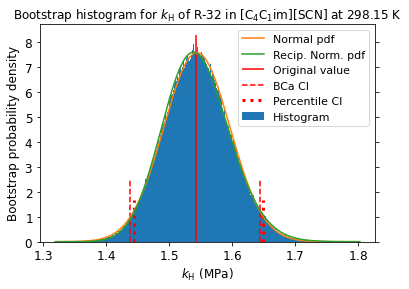

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


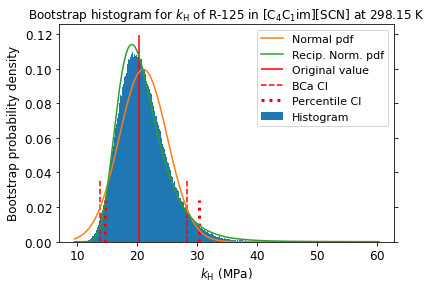

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


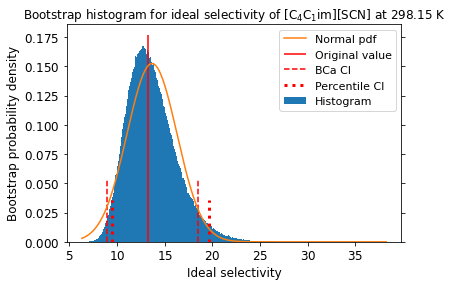

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


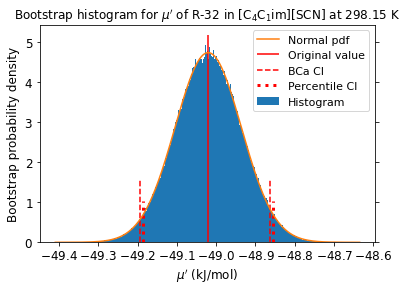

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


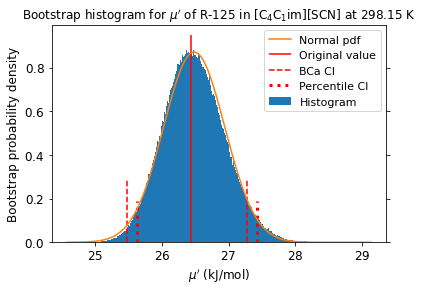

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


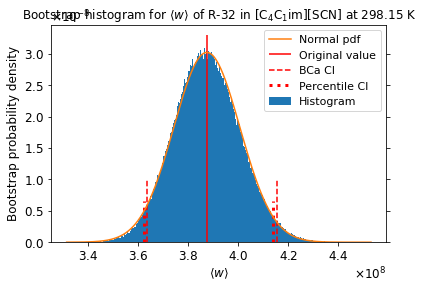

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


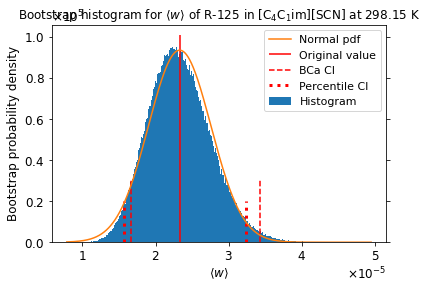

In [85]:
plot_results("cell_list_2/vbs_dh2/", "cell_list_2", drop_highest=2, IL_list=["BMIM_SCN"])

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.001730,0.002395,-0.001822,0.018002
Temp,-0.001264,-0.006630,0.003248,0.000603
Volume,0.037697,0.160781,-0.005567,0.177888
Press,-0.004116,0.004713,0.003603,0.001690
PotEng,0.018463,0.060525,0.004076,0.060012
KinEng,-0.001264,-0.006630,0.003248,0.000603
TotEng,0.013116,0.041369,0.005205,0.045718
E_pair,0.031239,0.115252,-0.003973,0.106738
E_vdwl,0.023845,0.101391,-0.004582,0.106743
E_coul,0.017980,0.054061,-0.001550,0.036045


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.003223,0.003223,0.017760,0.017760
Temp,-0.004529,-0.004529,0.005662,0.005662
Volume,0.150117,0.150117,0.162571,0.162571
Press,0.006217,0.006217,0.003392,0.003392
PotEng,0.054959,0.054959,0.054371,0.054371
KinEng,-0.004529,-0.004529,0.005662,0.005662
TotEng,0.037928,0.037928,0.044860,0.044860
E_pair,0.108868,0.108868,0.096515,0.096515
E_vdwl,0.095482,0.095482,0.096691,0.096691
E_coul,0.052532,0.052532,0.034072,0.034072


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.002131,0.002131,0.011840,0.011840
Temp,-0.003025,-0.003025,0.003770,0.003770
Volume,0.100413,0.100413,0.108907,0.108907
Press,0.004142,0.004142,0.002261,0.002261
PotEng,0.036640,0.036640,0.036241,0.036241
KinEng,-0.003025,-0.003025,0.003770,0.003770
TotEng,0.025260,0.025260,0.029901,0.029901
E_pair,0.072744,0.072744,0.064565,0.064565
E_vdwl,0.063730,0.063730,0.064698,0.064698
E_coul,0.035037,0.035037,0.022739,0.022739


R-32 w column correlation (first 5 columns):
 [[1.         0.01252469 0.0043     0.00553564 0.00416771]
 [0.01252469 1.         0.02451115 0.00762742 0.00367742]
 [0.0043     0.02451115 1.         0.01477745 0.01820313]
 [0.00553564 0.00762742 0.01477745 1.         0.00158652]
 [0.00416771 0.00367742 0.01820313 0.00158652 1.        ]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.31826375 0.32661933 0.33318952 0.32150915]
 [0.31826375 1.         0.32067737 0.32674354 0.31782237]
 [0.32661933 0.32067737 1.         0.33362335 0.321492  ]
 [0.33318952 0.32674354 0.33362335 1.         0.32805344]
 [0.32150915 0.31782237 0.321492   0.32805344 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.30757983 0.31161289 0.31529479 0.3049331 ]
 [0.30757983 1.         0.30544267 0.31257133 0.30142215]
 [0.31161289 0.30544267 1.         0.31471606 0.30794109]
 [0.31529479 0.31257133 0.31471606 1.         0.30999642]
 [0.3049331  0.30142215 0.30794109

10 highest observations are:

[[8.34383274e+10 1.50233813e-01]
 [8.75548178e+10 1.55233969e-01]
 [9.61654495e+10 2.00305202e-01]
 [9.73241733e+10 2.06692685e-01]
 [9.75059670e+10 2.22310411e-01]
 [1.06407376e+11 2.27095517e-01]
 [1.18310558e+11 3.48063621e-01]
 [1.24126319e+11 3.55876686e-01]
 [1.89490033e+11 2.31925609e+00]
 [2.06319506e+11 6.30975881e+00]]
with indices:

[[28037 34332]
 [21651 45686]
 [38524 26526]
 [41650 28467]
 [35508 35615]
 [10356 40831]
 [43383 22011]
 [ 4986 34330]
 [45570 38359]
 [29989 10875]]


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


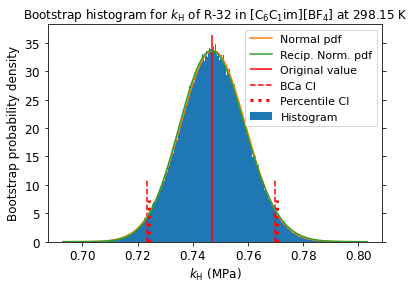

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


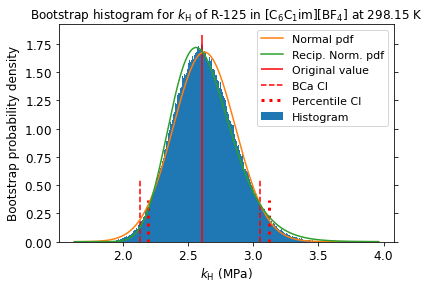

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


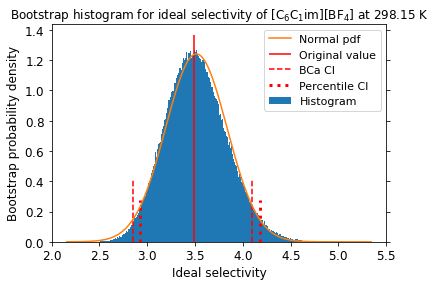

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


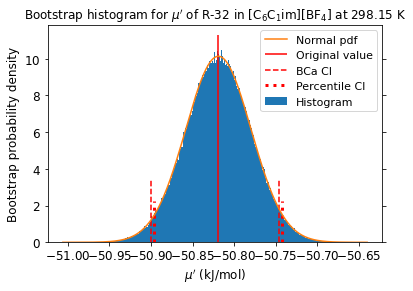

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


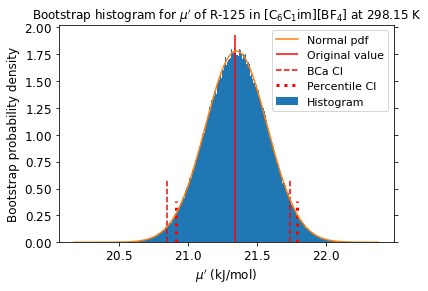

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


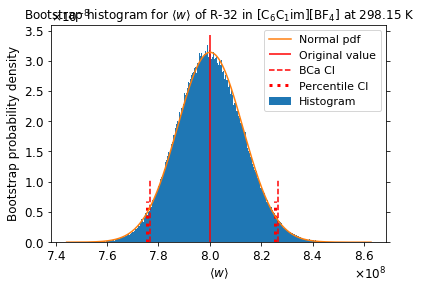

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


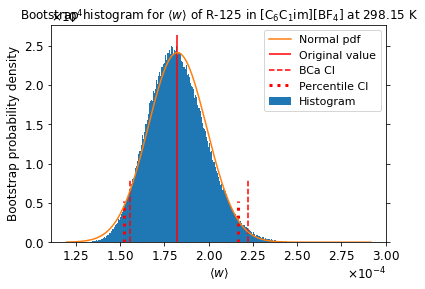

In [86]:
plot_results("adaptive_rmin_1/vbs_dh2/", "adaptive_rmin_1", drop_highest=2, IL_list=["HMIM_BF4"])

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.006096,0.001310,0.011009,-0.004340
Temp,0.011446,0.005936,0.002277,-0.000279
Volume,0.006084,0.155918,0.004688,0.174994
Press,0.001806,-0.012067,-0.000396,-0.009217
PotEng,0.003661,0.069753,-0.001584,0.072560
KinEng,0.011446,0.005936,0.002277,-0.000279
TotEng,0.010233,0.056628,0.000287,0.054699
E_pair,0.008141,0.107545,-0.000530,0.111157
E_vdwl,0.003289,0.100566,0.002758,0.107033
E_coul,0.007829,0.043540,-0.003525,0.042531


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.001397,0.001397,-0.005871,-0.005871
Temp,0.004803,0.004803,-0.003159,-0.003159
Volume,0.144568,0.144568,0.162262,0.162262
Press,-0.012482,-0.012482,-0.008500,-0.008500
PotEng,0.063208,0.063208,0.064952,0.064952
KinEng,0.004803,0.004803,-0.003159,-0.003159
TotEng,0.051118,0.051118,0.047018,0.047018
E_pair,0.097986,0.097986,0.100355,0.100355
E_vdwl,0.091058,0.091058,0.097294,0.097294
E_coul,0.040291,0.040291,0.035896,0.035896


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.000935,0.000935,-0.003913,-0.003913
Temp,0.003198,0.003198,-0.002101,-0.002101
Volume,0.096821,0.096821,0.108731,0.108731
Press,-0.008329,-0.008329,-0.005669,-0.005669
PotEng,0.042161,0.042161,0.043348,0.043348
KinEng,0.003198,0.003198,-0.002101,-0.002101
TotEng,0.034118,0.034118,0.031380,0.031380
E_pair,0.065457,0.065457,0.067057,0.067057
E_vdwl,0.060765,0.060765,0.065017,0.065017
E_coul,0.026890,0.026890,0.023944,0.023944


R-32 w column correlation (first 5 columns):
 [[1.         0.00299462 0.01228926 0.00852831 0.00268346]
 [0.00299462 1.         0.0019929  0.01127945 0.00116922]
 [0.01228926 0.0019929  1.         0.00441822 0.01050238]
 [0.00852831 0.01127945 0.00441822 1.         0.00252075]
 [0.00268346 0.00116922 0.01050238 0.00252075 1.        ]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.4035876  0.40231286 0.40018135 0.40182394]
 [0.4035876  1.         0.40093912 0.3967632  0.40073431]
 [0.40231286 0.40093912 1.         0.40246862 0.40654753]
 [0.40018135 0.3967632  0.40246862 1.         0.40232772]
 [0.40182394 0.40073431 0.40654753 0.40232772 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.40792556 0.4074117  0.40249547 0.40398156]
 [0.40792556 1.         0.40567501 0.40103586 0.40552099]
 [0.4074117  0.40567501 1.         0.40559425 0.40944947]
 [0.40249547 0.40103586 0.40559425 1.         0.40783143]
 [0.40398156 0.40552099 0.40944947

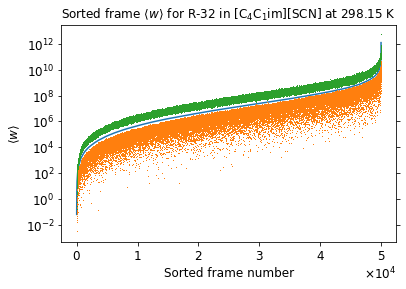

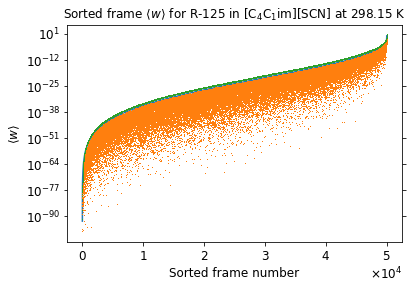

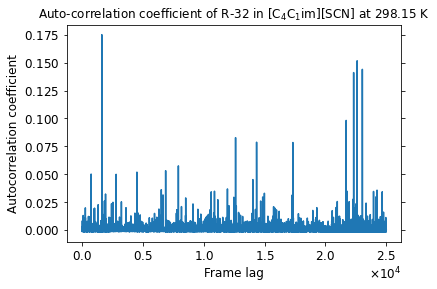

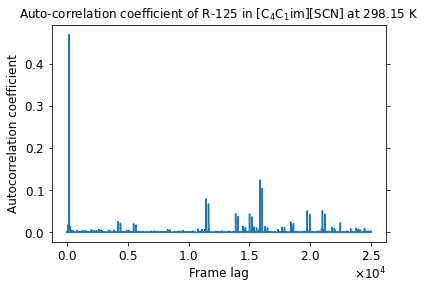

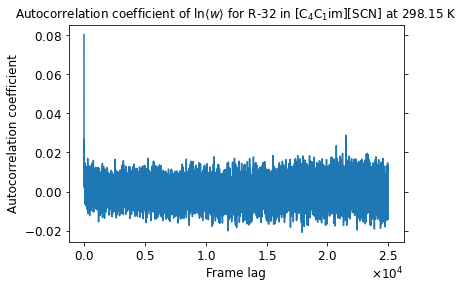

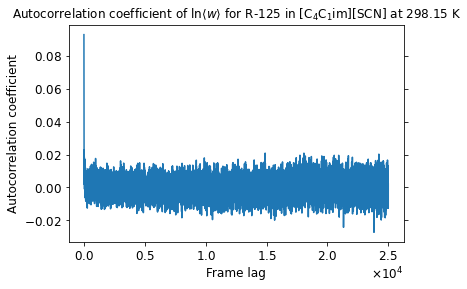

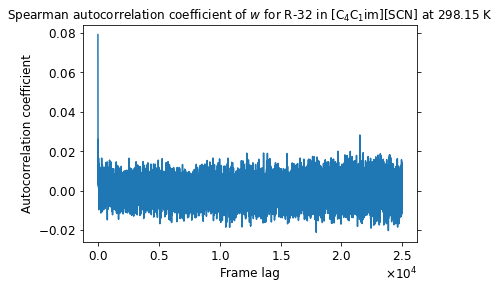

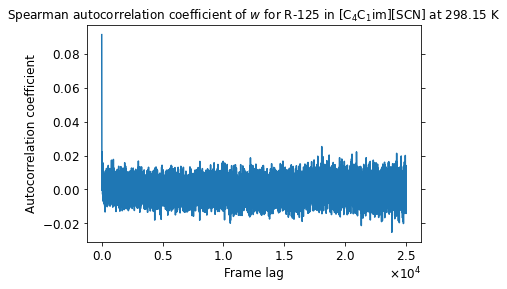

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


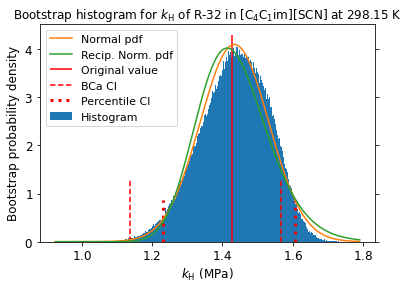

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


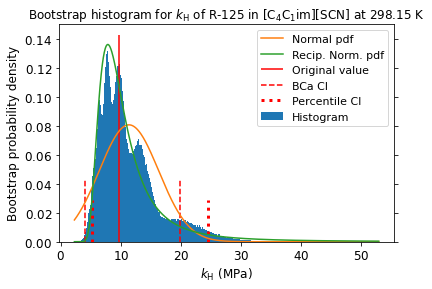

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


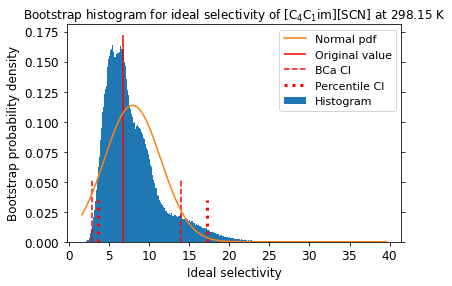

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


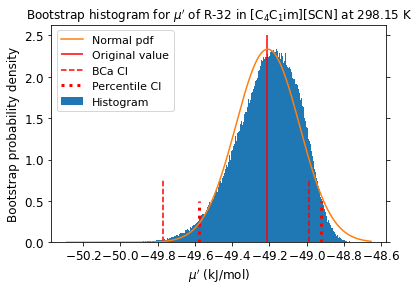

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


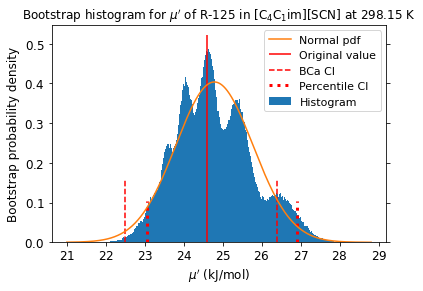

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


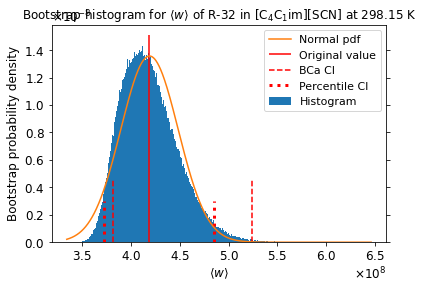

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


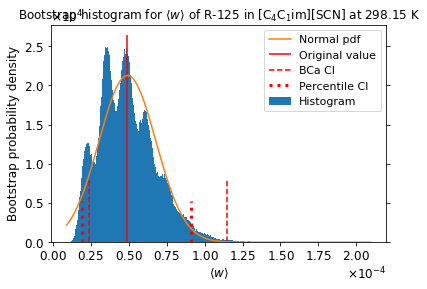

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.004219,0.016750,-0.002473,0.019327
Temp,-0.001532,-0.001053,0.002387,-0.001818
Volume,0.026066,0.160867,0.016023,0.178244
Press,-0.002458,-0.007264,-0.005163,-0.004908
PotEng,0.013103,0.067807,0.003915,0.072843
KinEng,-0.001532,-0.001053,0.002387,-0.001818
TotEng,0.008866,0.050390,0.004514,0.053682
E_pair,0.016925,0.113476,0.014328,0.112302
E_vdwl,0.013895,0.104394,0.009967,0.111905
E_coul,0.007719,0.050629,0.009916,0.042278


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.017013,0.017013,0.018933,0.018933
Temp,-0.000461,-0.000461,-0.001328,-0.001328
Volume,0.151575,0.151575,0.166873,0.166873
Press,-0.007771,-0.007771,-0.005567,-0.005567
PotEng,0.063320,0.063320,0.068003,0.068003
KinEng,-0.000461,-0.000461,-0.001329,-0.001329
TotEng,0.047753,0.047753,0.049316,0.049316
E_pair,0.105195,0.105195,0.102713,0.102713
E_vdwl,0.096666,0.096666,0.103912,0.103912
E_coul,0.047421,0.047421,0.037639,0.037639


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.011334,0.011334,0.012597,0.012597
Temp,-0.000303,-0.000303,-0.000889,-0.000889
Volume,0.101349,0.101349,0.111748,0.111748
Press,-0.005193,-0.005193,-0.003731,-0.003731
PotEng,0.042155,0.042155,0.045366,0.045366
KinEng,-0.000303,-0.000303,-0.000889,-0.000889
TotEng,0.031827,0.031827,0.032852,0.032852
E_pair,0.070152,0.070152,0.068620,0.068620
E_vdwl,0.064600,0.064600,0.069417,0.069417
E_coul,0.031562,0.031562,0.025120,0.025120


R-32 w column correlation (first 5 columns):
 [[1.00000000e+00 1.44741320e-02 2.96360158e-02 1.49979497e-02
  5.98810875e-04]
 [1.44741320e-02 1.00000000e+00 1.03549047e-02 4.08757943e-02
  3.17954526e-03]
 [2.96360158e-02 1.03549047e-02 1.00000000e+00 9.36941670e-03
  1.84374008e-03]
 [1.49979497e-02 4.08757943e-02 9.36941670e-03 1.00000000e+00
  8.18384499e-03]
 [5.98810875e-04 3.17954526e-03 1.84374008e-03 8.18384499e-03
  1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.35820818 0.34702777 0.34750724 0.3533886 ]
 [0.35820818 1.         0.34855761 0.3504523  0.35598449]
 [0.34702777 0.34855761 1.         0.35122401 0.35286417]
 [0.34750724 0.3504523  0.35122401 1.         0.35235471]
 [0.3533886  0.35598449 0.35286417 0.35235471 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.34756144 0.33969858 0.34147971 0.34837361]
 [0.34756144 1.         0.34131957 0.3430805  0.34941326]
 [0.33969858 0.34131957 1.         0.343

10 highest observations are:

[[1.01704446e+11 5.24719885e-02]
 [1.03214941e+11 5.54042066e-02]
 [1.10844797e+11 5.81187749e-02]
 [1.23144186e+11 6.36986022e-02]
 [1.25513248e+11 6.50510430e-02]
 [1.30647693e+11 8.07593060e-02]
 [1.42627391e+11 1.04944112e-01]
 [1.43692194e+11 1.10448687e-01]
 [1.78836854e+11 1.45677384e-01]
 [2.69070956e+11 3.88657953e-01]]
with indices:

[[38798 36420]
 [ 2106 26698]
 [28657 24627]
 [43733 21702]
 [ 9005  3851]
 [10678  2225]
 [41009 28083]
 [24818  6116]
 [15238  4203]
 [18378 33453]]


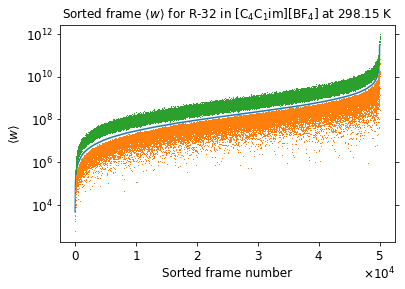

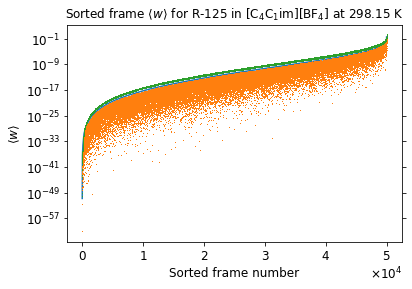

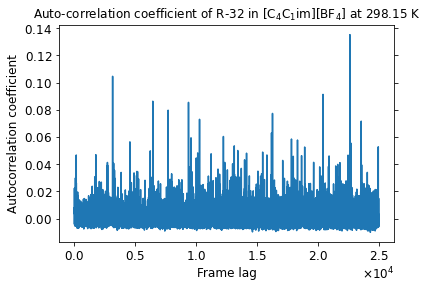

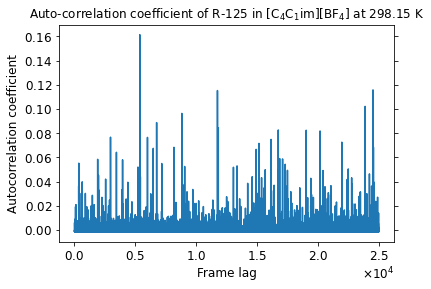

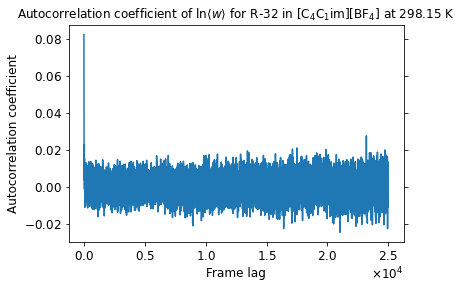

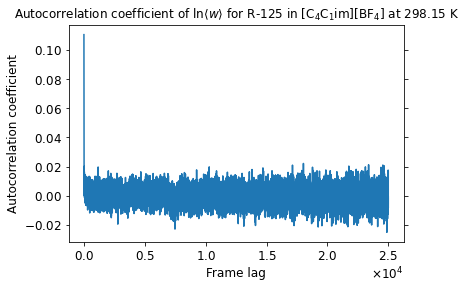

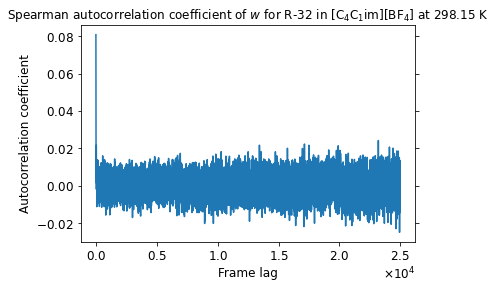

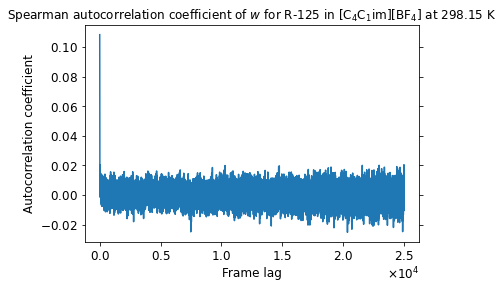

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


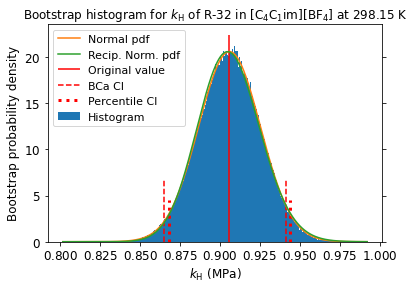

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


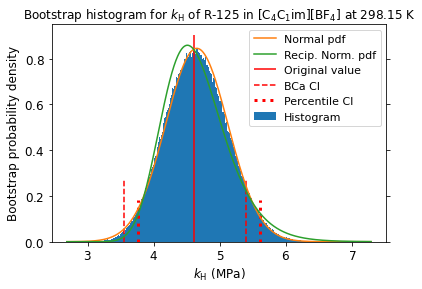

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


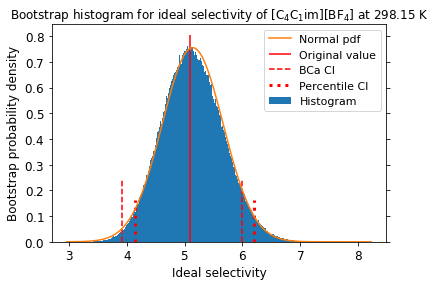

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


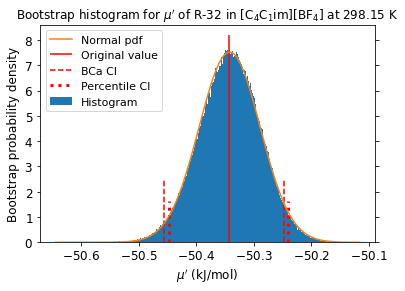

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


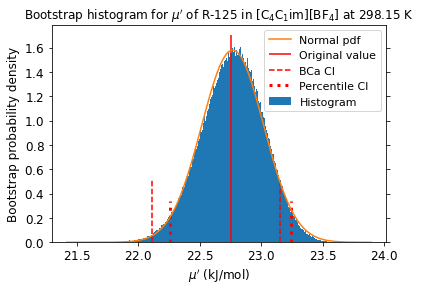

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


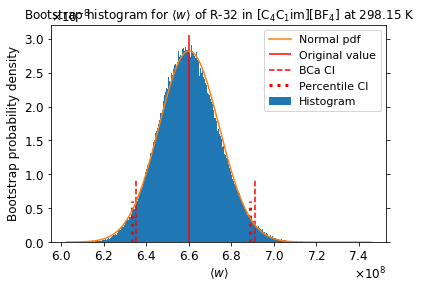

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


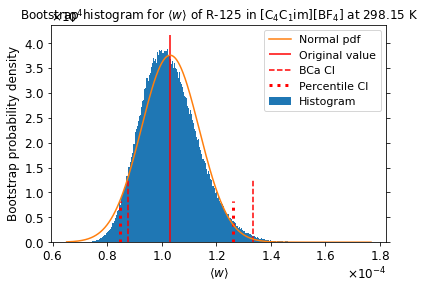

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.004065,0.004867,0.000476,0.008405
Temp,0.004116,0.005434,0.001342,0.004124
Volume,0.031377,0.162113,0.009699,0.179231
Press,-0.000864,-0.001582,-0.002733,-0.004084
PotEng,0.011016,0.065990,0.003773,0.067557
KinEng,0.004116,0.005434,0.001342,0.004124
TotEng,0.011019,0.053428,0.003729,0.053755
E_pair,0.028562,0.119505,0.002774,0.113642
E_vdwl,0.023249,0.113175,0.005896,0.120065
E_coul,0.015791,0.052781,-0.004089,0.036148


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.004306,0.004306,0.009824,0.009824
Temp,0.004693,0.004693,0.003952,0.003952
Volume,0.152912,0.152912,0.165320,0.165320
Press,0.000121,0.000121,-0.001603,-0.001603
PotEng,0.062807,0.062807,0.062353,0.062353
KinEng,0.004693,0.004693,0.003952,0.003952
TotEng,0.050430,0.050430,0.050071,0.050071
E_pair,0.112386,0.112386,0.103925,0.103925
E_vdwl,0.106101,0.106101,0.110383,0.110383
E_coul,0.049779,0.049779,0.032186,0.032186


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.002886,0.002886,0.006571,0.006571
Temp,0.003126,0.003126,0.002637,0.002637
Volume,0.102469,0.102469,0.110663,0.110663
Press,0.000081,0.000081,-0.001080,-0.001080
PotEng,0.041957,0.041957,0.041576,0.041576
KinEng,0.003126,0.003126,0.002637,0.002637
TotEng,0.033689,0.033689,0.033471,0.033471
E_pair,0.075124,0.075124,0.069392,0.069392
E_vdwl,0.070955,0.070955,0.073733,0.073733
E_coul,0.033245,0.033245,0.021468,0.021468


R-32 w column correlation (first 5 columns):
 [[1.         0.00798058 0.00555671 0.03135649 0.00775781]
 [0.00798058 1.         0.00331798 0.01088104 0.00546041]
 [0.00555671 0.00331798 1.         0.00828393 0.00555779]
 [0.03135649 0.01088104 0.00828393 1.         0.01983302]
 [0.00775781 0.00546041 0.00555779 0.01983302 1.        ]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.33877546 0.33951464 0.34103301 0.33737362]
 [0.33877546 1.         0.33793258 0.33839344 0.33591078]
 [0.33951464 0.33793258 1.         0.34636961 0.33120909]
 [0.34103301 0.33839344 0.34636961 1.         0.339449  ]
 [0.33737362 0.33591078 0.33120909 0.339449   1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.33141246 0.32872789 0.33166853 0.32549944]
 [0.33141246 1.         0.32691178 0.3305383  0.32695253]
 [0.32872789 0.32691178 1.         0.33460244 0.32027271]
 [0.33166853 0.3305383  0.33460244 1.         0.3281257 ]
 [0.32549944 0.32695253 0.32027271

10 highest observations are:

[[6.77063659e+10 6.71361190e-02]
 [6.77983075e+10 7.40210824e-02]
 [7.20206034e+10 7.49418005e-02]
 [7.75008386e+10 8.26285960e-02]
 [9.22168385e+10 9.02839132e-02]
 [9.49106114e+10 9.03098143e-02]
 [1.01698809e+11 9.29652312e-02]
 [1.31573314e+11 1.00324554e-01]
 [1.40063039e+11 1.02143390e-01]
 [1.93234064e+11 1.13049109e-01]]
with indices:

[[27702 21080]
 [16654 27482]
 [42405 16119]
 [18195 13978]
 [20182 25408]
 [46815 47316]
 [47459 32151]
 [38305 42010]
 [ 1413 20785]
 [37279 17500]]


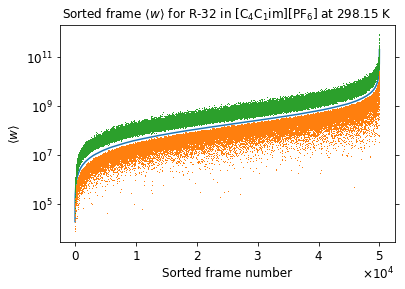

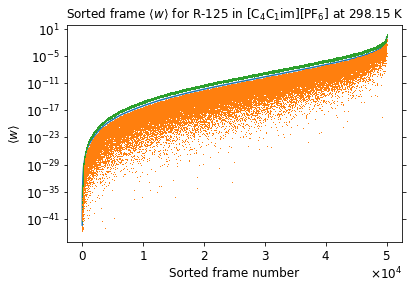

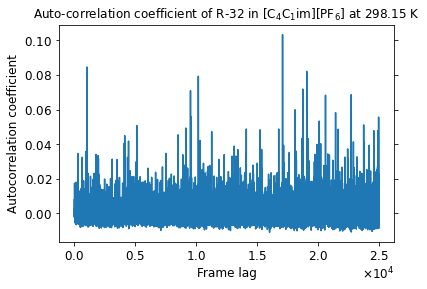

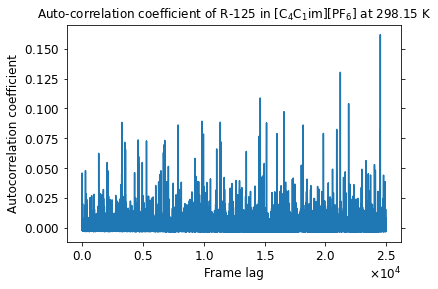

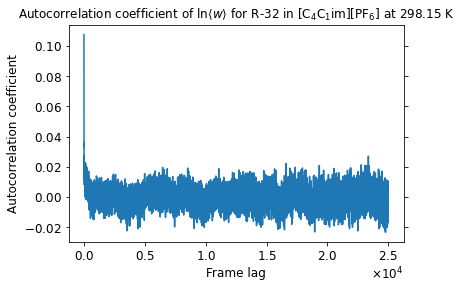

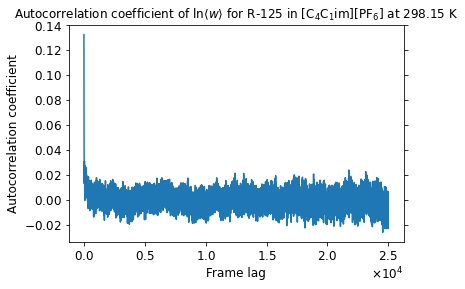

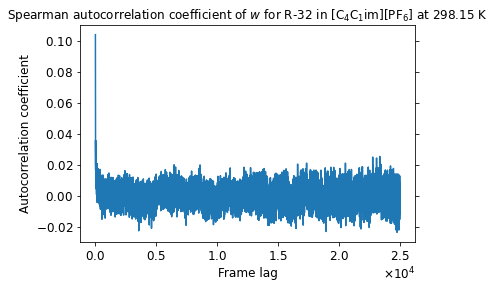

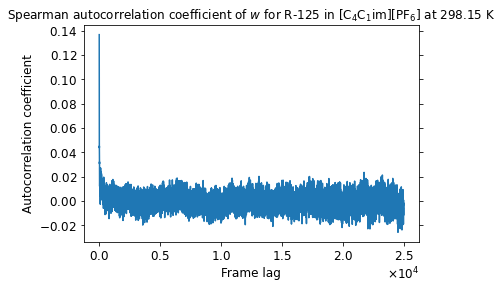

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


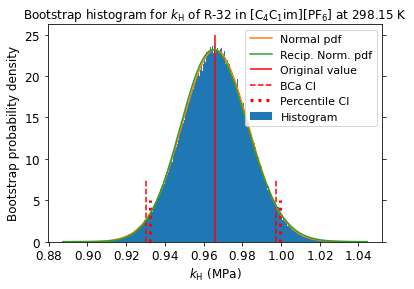

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


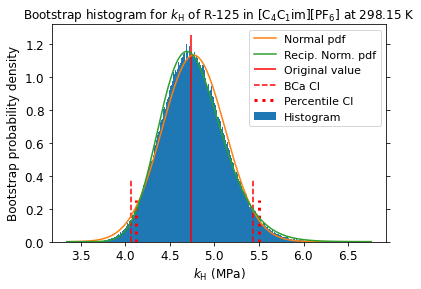

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


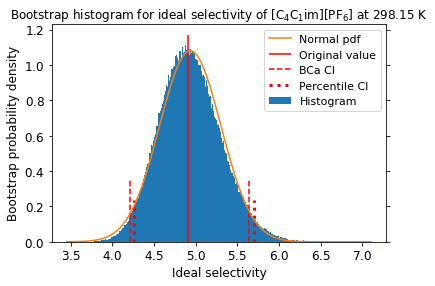

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


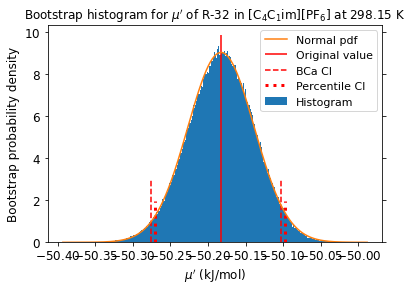

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


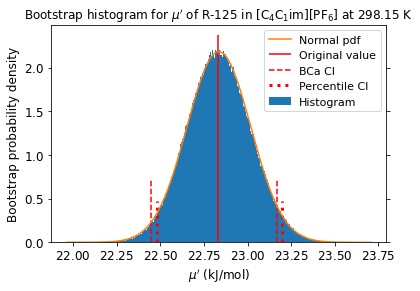

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


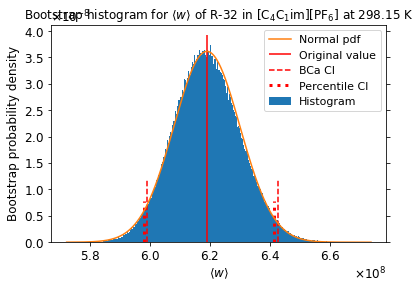

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


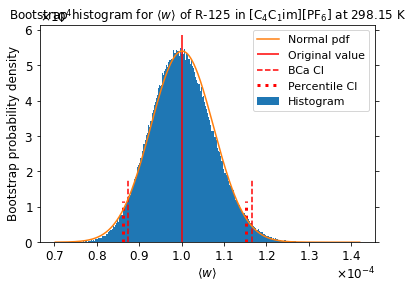

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.000583,0.000339,-0.002779,0.015888
Temp,-0.005968,-0.004685,0.003703,0.000417
Volume,0.020121,0.158611,0.007556,0.177588
Press,0.002071,0.005691,0.001366,0.000056
PotEng,0.014165,0.062149,0.004757,0.055530
KinEng,-0.005968,-0.004685,0.003703,0.000417
TotEng,0.006789,0.043870,0.006017,0.042212
E_pair,0.026193,0.110596,0.010840,0.106027
E_vdwl,0.019567,0.097851,0.009116,0.105074
E_coul,0.016530,0.050526,0.006550,0.036254


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.000277,-0.000277,0.015406,0.015406
Temp,-0.002485,-0.002485,0.006140,0.006140
Volume,0.149712,0.149712,0.162736,0.162736
Press,0.006210,0.006210,0.001842,0.001842
PotEng,0.057108,0.057108,0.050896,0.050896
KinEng,-0.002485,-0.002485,0.006140,0.006140
TotEng,0.041128,0.041128,0.042537,0.042537
E_pair,0.104348,0.104348,0.097322,0.097322
E_vdwl,0.092448,0.092448,0.096382,0.096382
E_coul,0.047877,0.047877,0.035744,0.035744


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.000206,-0.000206,0.010315,0.010315
Temp,-0.001650,-0.001650,0.004100,0.004100
Volume,0.100219,0.100219,0.108960,0.108960
Press,0.004145,0.004145,0.001236,0.001236
PotEng,0.038086,0.038086,0.033929,0.033929
KinEng,-0.001650,-0.001650,0.004100,0.004100
TotEng,0.027391,0.027391,0.028377,0.028377
E_pair,0.069785,0.069785,0.065122,0.065122
E_vdwl,0.061761,0.061761,0.064506,0.064506
E_coul,0.031970,0.031970,0.023851,0.023851


R-32 w column correlation (first 5 columns):
 [[1.         0.01314749 0.00795505 0.00488451 0.0193594 ]
 [0.01314749 1.         0.02772165 0.04747017 0.017724  ]
 [0.00795505 0.02772165 1.         0.00721427 0.00513669]
 [0.00488451 0.04747017 0.00721427 1.         0.00230669]
 [0.0193594  0.017724   0.00513669 0.00230669 1.        ]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.31187599 0.32801014 0.3284186  0.31788913]
 [0.31187599 1.         0.31930369 0.31685385 0.31484632]
 [0.32801014 0.31930369 1.         0.32971804 0.32691328]
 [0.3284186  0.31685385 0.32971804 1.         0.32374404]
 [0.31788913 0.31484632 0.32691328 0.32374404 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.30127725 0.31447806 0.31525504 0.30431935]
 [0.30127725 1.         0.31285017 0.30862358 0.30619547]
 [0.31447806 0.31285017 1.         0.31614329 0.31208592]
 [0.31525504 0.30862358 0.31614329 1.         0.31007053]
 [0.30431935 0.30619547 0.31208592

10 highest observations are:

[[1.43648004e+11 9.72678517e-02]
 [1.66975031e+11 1.07561836e-01]
 [1.67178583e+11 1.14656261e-01]
 [1.82337525e+11 1.29018048e-01]
 [1.84250736e+11 1.50217029e-01]
 [1.85526758e+11 1.61733195e-01]
 [2.20309781e+11 1.75202518e-01]
 [2.33019344e+11 3.17144553e-01]
 [3.27379783e+11 6.86403403e-01]
 [7.44266188e+11 7.28402610e-01]]
with indices:

[[ 9217 11057]
 [16994  1179]
 [21115  2242]
 [45570  7280]
 [17031 38092]
 [44714 39498]
 [13438 41079]
 [48297 11945]
 [ 4986 23344]
 [24708 17062]]


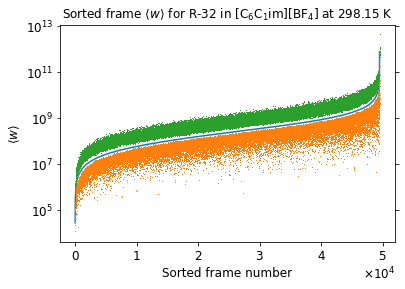

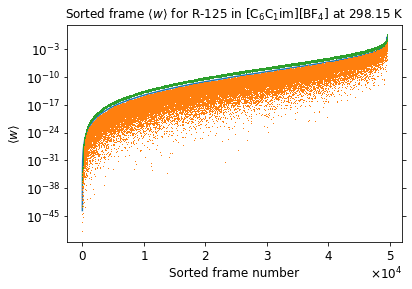

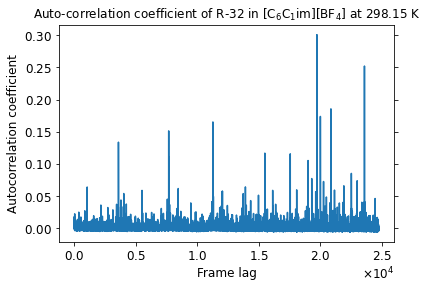

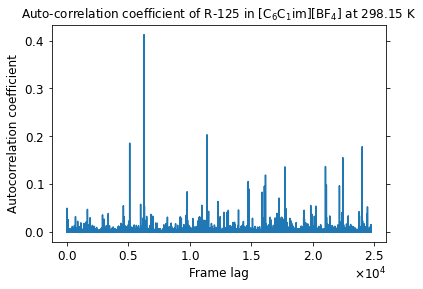

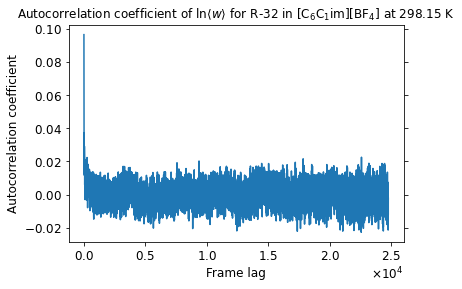

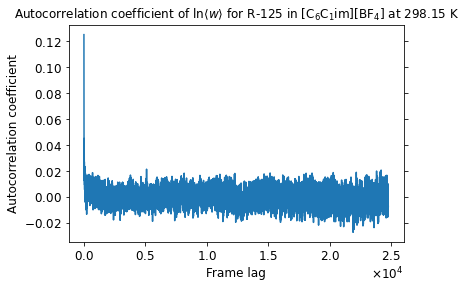

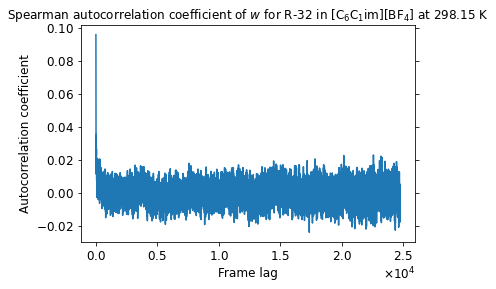

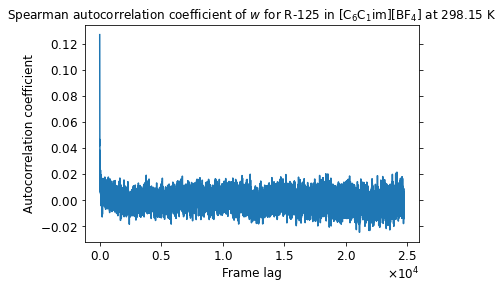

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


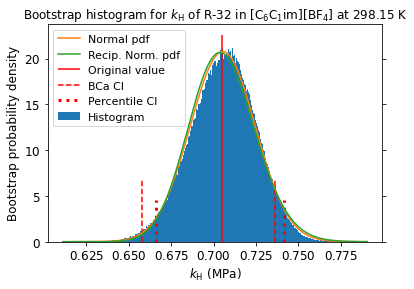

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


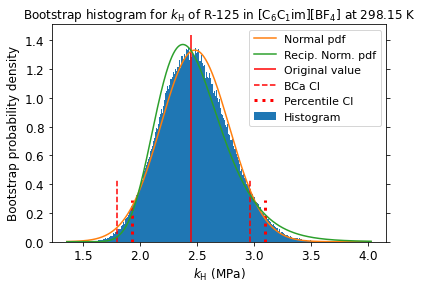

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


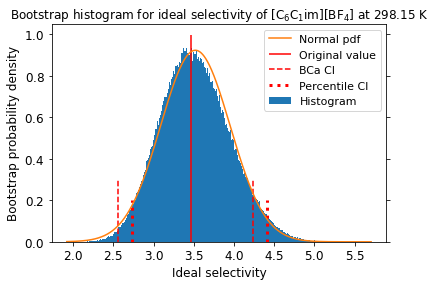

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


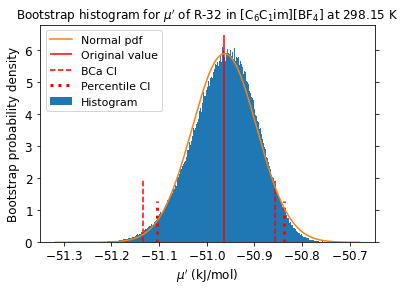

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


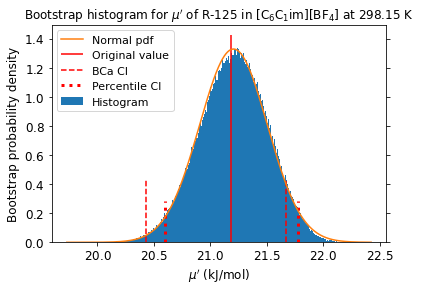

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


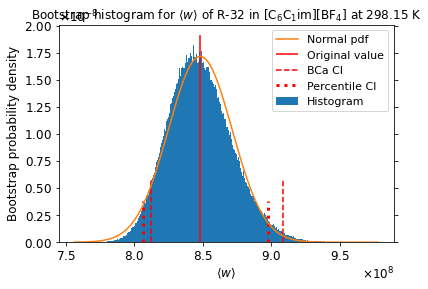

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


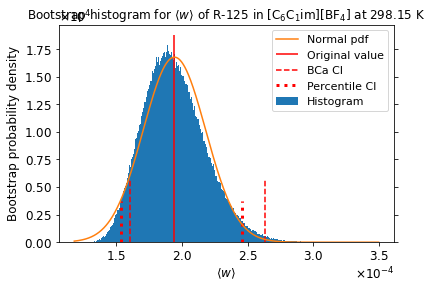

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.011591,-0.037033,-0.006246,-0.021581
Temp,0.006265,-0.000843,0.007835,-0.005737
Volume,0.012498,0.149351,0.013727,0.180684
Press,0.002180,-0.007400,0.001135,-0.012720
PotEng,0.007917,0.058786,0.003131,0.062240
KinEng,0.006265,-0.000843,0.007835,-0.005737
TotEng,0.010076,0.044388,0.007427,0.043884
E_pair,0.014214,0.098071,0.002154,0.102312
E_vdwl,0.009909,0.085702,0.000078,0.090464
E_coul,0.005272,0.034090,0.002639,0.036335


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.038388,-0.038388,-0.020381,-0.020381
Temp,0.002020,0.002020,-0.004925,-0.004925
Volume,0.140668,0.140668,0.167876,0.167876
Press,-0.005897,-0.005897,-0.011142,-0.011142
PotEng,0.056085,0.056085,0.059843,0.059843
KinEng,0.002020,0.002020,-0.004925,-0.004925
TotEng,0.042575,0.042575,0.041631,0.041631
E_pair,0.091684,0.091684,0.094817,0.094817
E_vdwl,0.078716,0.078716,0.086349,0.086349
E_coul,0.032342,0.032342,0.032881,0.032881


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.025454,-0.025454,-0.013634,-0.013634
Temp,0.001331,0.001331,-0.003285,-0.003285
Volume,0.094140,0.094140,0.112430,0.112430
Press,-0.003930,-0.003930,-0.007412,-0.007412
PotEng,0.037431,0.037431,0.039925,0.039925
KinEng,0.001331,0.001331,-0.003285,-0.003285
TotEng,0.028414,0.028414,0.027759,0.027759
E_pair,0.061222,0.061222,0.063326,0.063326
E_vdwl,0.052510,0.052510,0.057594,0.057594
E_coul,0.021567,0.021567,0.021928,0.021928


R-32 w column correlation (first 5 columns):
 [[1.00000000e+00 5.44150537e-04 9.63680414e-04 1.82101268e-02
  9.25752625e-03]
 [5.44150537e-04 1.00000000e+00 6.15532677e-04 1.16108409e-03
  1.05949061e-02]
 [9.63680414e-04 6.15532677e-04 1.00000000e+00 1.32658578e-03
  9.69795024e-03]
 [1.82101268e-02 1.16108409e-03 1.32658578e-03 1.00000000e+00
  8.29304170e-03]
 [9.25752625e-03 1.05949061e-02 9.69795024e-03 8.29304170e-03
  1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.35094453 0.34523616 0.34947235 0.35348992]
 [0.35094453 1.         0.3536894  0.36005292 0.35435603]
 [0.34523616 0.3536894  1.         0.3541886  0.3462274 ]
 [0.34947235 0.36005292 0.3541886  1.         0.3595017 ]
 [0.35348992 0.35435603 0.3462274  0.3595017  1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.34322366 0.33965722 0.3428357  0.3453066 ]
 [0.34322366 1.         0.34411967 0.35073747 0.3464291 ]
 [0.33965722 0.34411967 1.         0.347

10 highest observations are:

[[3.73179959e+11 3.93604778e-01]
 [3.75645216e+11 3.99324407e-01]
 [3.80396984e+11 5.77093058e-01]
 [4.01510085e+11 6.13184952e-01]
 [4.17419046e+11 6.35970922e-01]
 [4.99562756e+11 8.42575760e-01]
 [5.14532340e+11 8.59916947e-01]
 [5.54900019e+11 9.19546106e-01]
 [9.45547550e+11 1.03783865e+00]
 [3.61168154e+12 1.39774663e+00]]
with indices:

[[10256  3549]
 [15540 42250]
 [12875  2677]
 [14671 10072]
 [15321 37069]
 [ 4990 11695]
 [18298    90]
 [29570 46164]
 [34044 23482]
 [ 7061  4873]]


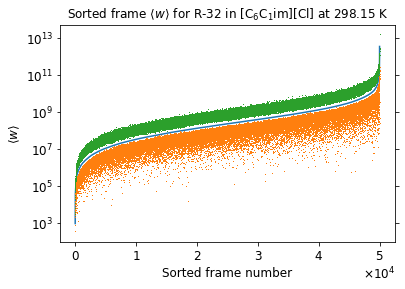

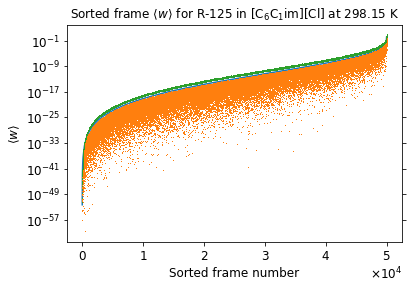

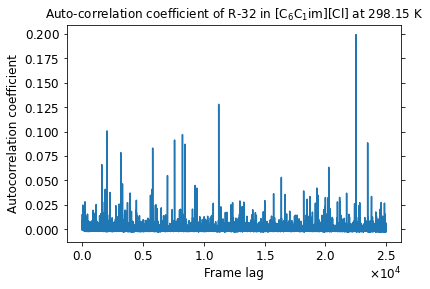

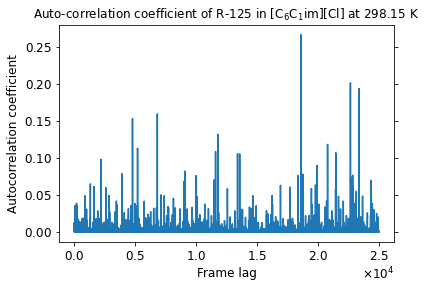

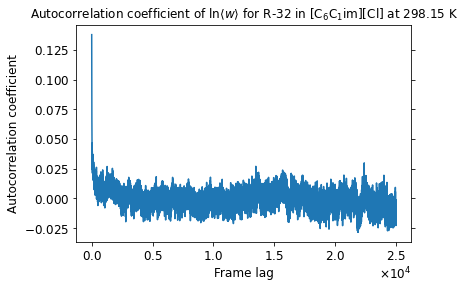

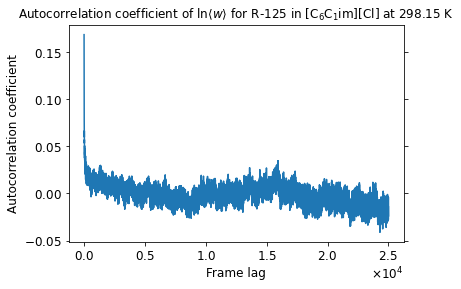

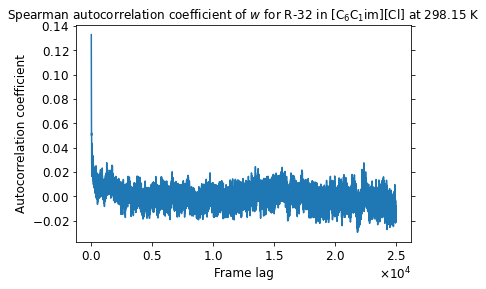

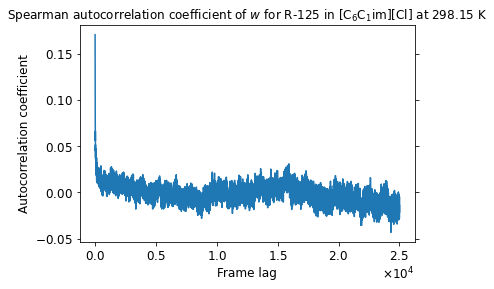

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


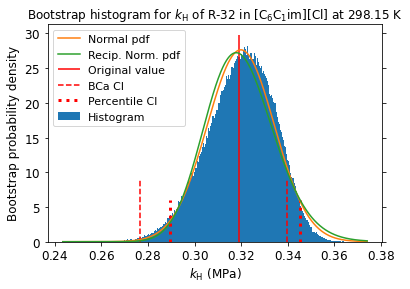

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


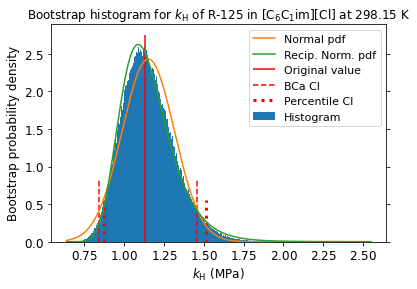

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


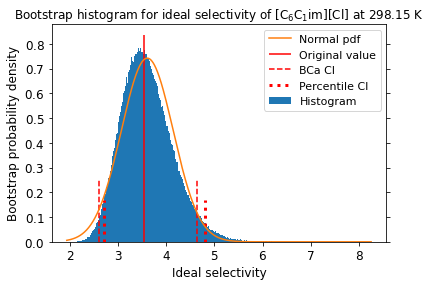

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


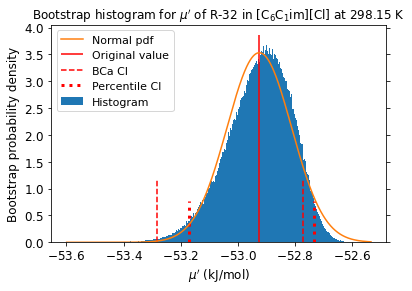

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


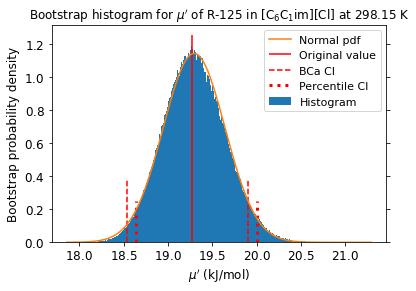

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


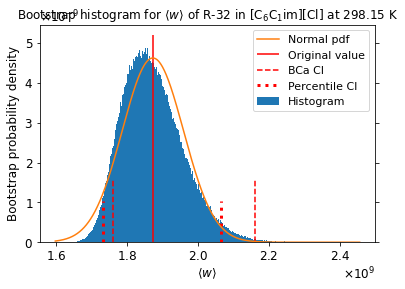

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


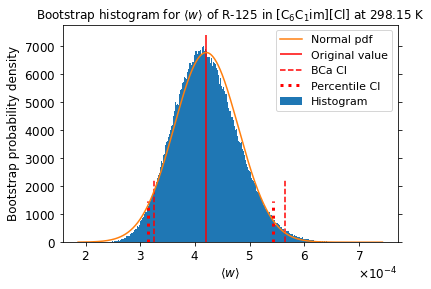

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


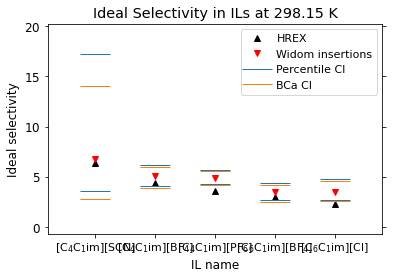

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


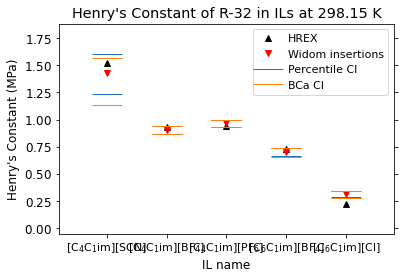

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


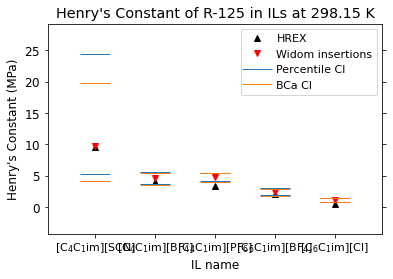

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


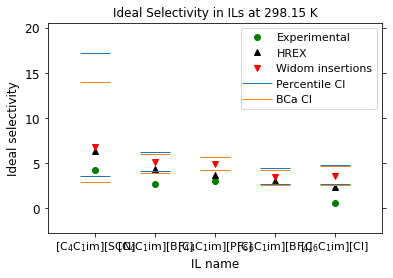

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


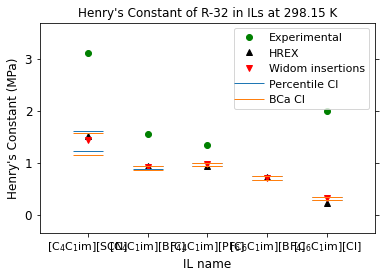

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


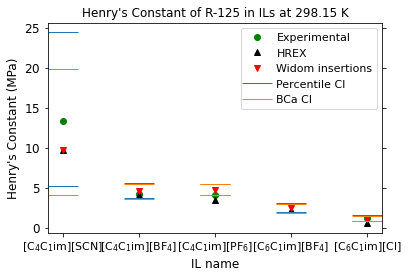

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


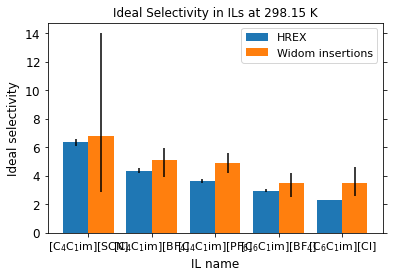

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


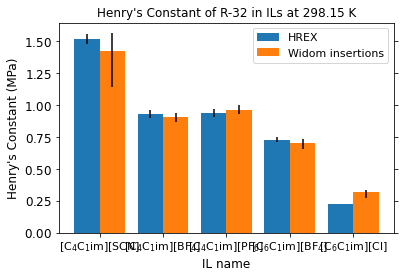

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


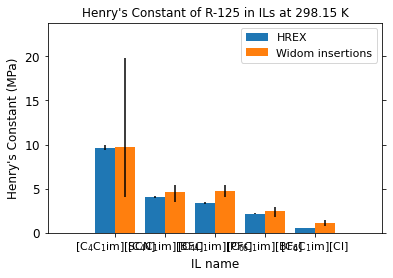

In [87]:
plot_results("cell_list_2/vbs", "cell_list_2", get_fbs=True, get_corr=True)

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.006096,0.001310,0.011009,-0.004340
Temp,0.011446,0.005936,0.002277,-0.000279
Volume,0.006084,0.155918,0.004688,0.174994
Press,0.001806,-0.012067,-0.000396,-0.009217
PotEng,0.003661,0.069753,-0.001584,0.072560
KinEng,0.011446,0.005936,0.002277,-0.000279
TotEng,0.010233,0.056628,0.000287,0.054699
E_pair,0.008141,0.107545,-0.000530,0.111157
E_vdwl,0.003289,0.100566,0.002758,0.107033
E_coul,0.007829,0.043540,-0.003525,0.042531


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.001397,0.001397,-0.005871,-0.005871
Temp,0.004803,0.004803,-0.003159,-0.003159
Volume,0.144568,0.144568,0.162262,0.162262
Press,-0.012482,-0.012482,-0.008500,-0.008500
PotEng,0.063208,0.063208,0.064952,0.064952
KinEng,0.004803,0.004803,-0.003159,-0.003159
TotEng,0.051118,0.051118,0.047018,0.047018
E_pair,0.097986,0.097986,0.100355,0.100355
E_vdwl,0.091058,0.091058,0.097294,0.097294
E_coul,0.040291,0.040291,0.035896,0.035896


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.000935,0.000935,-0.003913,-0.003913
Temp,0.003198,0.003198,-0.002101,-0.002101
Volume,0.096821,0.096821,0.108731,0.108731
Press,-0.008329,-0.008329,-0.005669,-0.005669
PotEng,0.042161,0.042161,0.043348,0.043348
KinEng,0.003198,0.003198,-0.002101,-0.002101
TotEng,0.034118,0.034118,0.031380,0.031380
E_pair,0.065457,0.065457,0.067057,0.067057
E_vdwl,0.060765,0.060765,0.065017,0.065017
E_coul,0.026890,0.026890,0.023944,0.023944


R-32 w column correlation (first 5 columns):
 [[1.         0.00299462 0.01228926 0.00852831 0.00268346]
 [0.00299462 1.         0.0019929  0.01127945 0.00116922]
 [0.01228926 0.0019929  1.         0.00441822 0.01050238]
 [0.00852831 0.01127945 0.00441822 1.         0.00252075]
 [0.00268346 0.00116922 0.01050238 0.00252075 1.        ]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.4035876  0.40231286 0.40018135 0.40182394]
 [0.4035876  1.         0.40093912 0.3967632  0.40073431]
 [0.40231286 0.40093912 1.         0.40246862 0.40654753]
 [0.40018135 0.3967632  0.40246862 1.         0.40232772]
 [0.40182394 0.40073431 0.40654753 0.40232772 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.40792556 0.4074117  0.40249547 0.40398156]
 [0.40792556 1.         0.40567501 0.40103586 0.40552099]
 [0.4074117  0.40567501 1.         0.40559425 0.40944947]
 [0.40249547 0.40103586 0.40559425 1.         0.40783143]
 [0.40398156 0.40552099 0.40944947

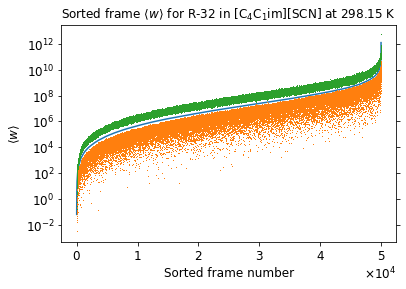

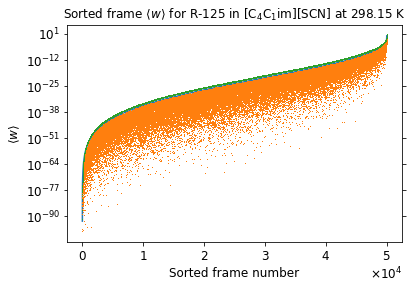

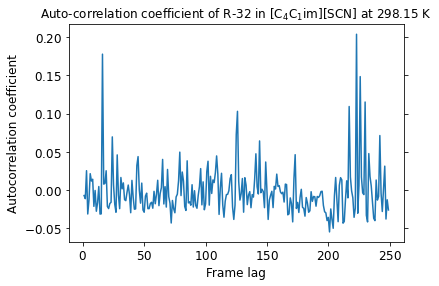

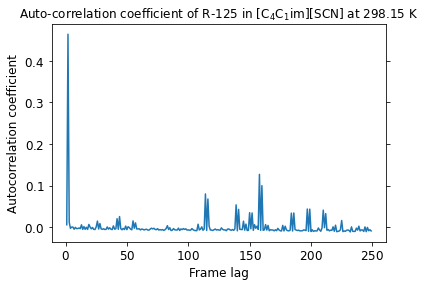

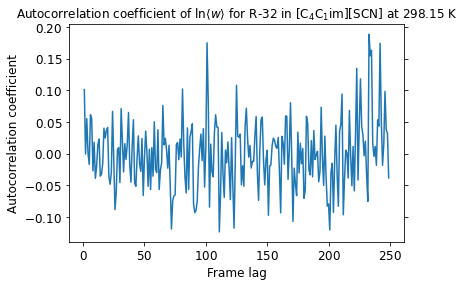

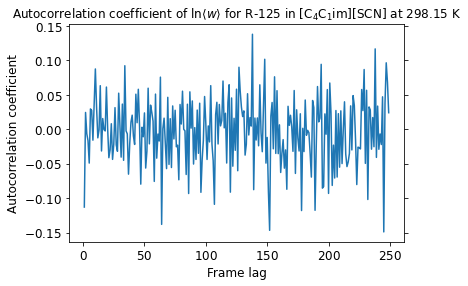

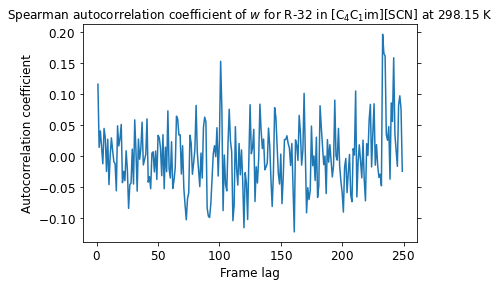

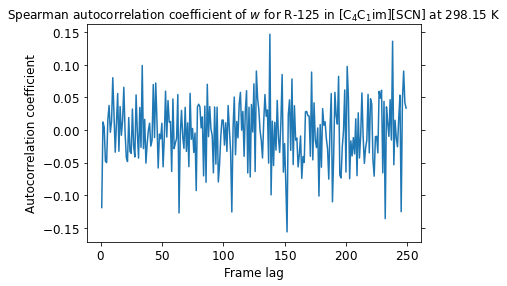

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


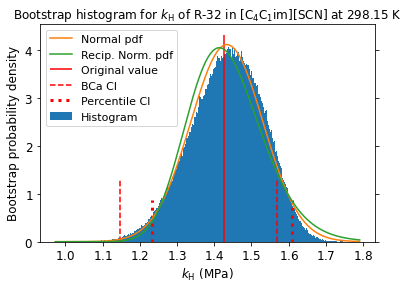

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


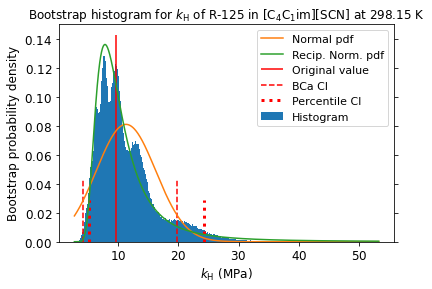

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


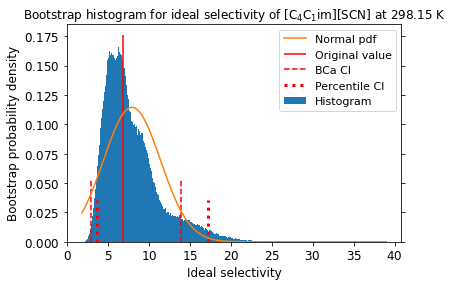

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


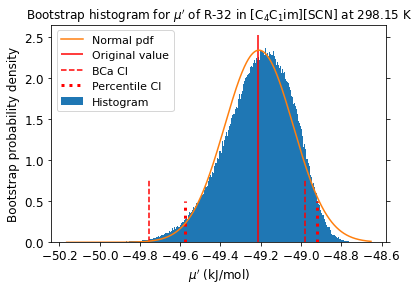

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


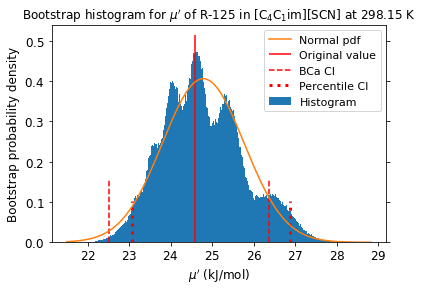

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


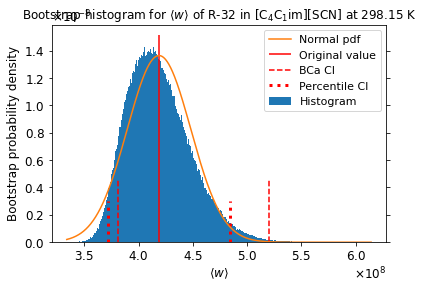

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


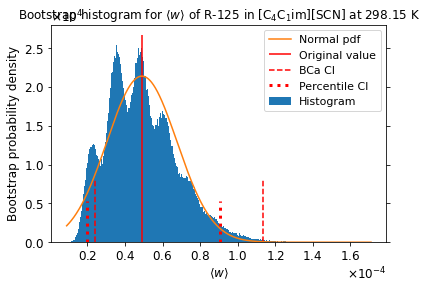

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.004219,0.016750,-0.002473,0.019327
Temp,-0.001532,-0.001053,0.002387,-0.001818
Volume,0.026066,0.160867,0.016023,0.178244
Press,-0.002458,-0.007264,-0.005163,-0.004908
PotEng,0.013103,0.067807,0.003915,0.072843
KinEng,-0.001532,-0.001053,0.002387,-0.001818
TotEng,0.008866,0.050390,0.004514,0.053682
E_pair,0.016925,0.113476,0.014328,0.112302
E_vdwl,0.013895,0.104394,0.009967,0.111905
E_coul,0.007719,0.050629,0.009916,0.042278


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.017013,0.017013,0.018933,0.018933
Temp,-0.000461,-0.000461,-0.001328,-0.001328
Volume,0.151575,0.151575,0.166873,0.166873
Press,-0.007771,-0.007771,-0.005567,-0.005567
PotEng,0.063320,0.063320,0.068003,0.068003
KinEng,-0.000461,-0.000461,-0.001329,-0.001329
TotEng,0.047753,0.047753,0.049316,0.049316
E_pair,0.105195,0.105195,0.102713,0.102713
E_vdwl,0.096666,0.096666,0.103912,0.103912
E_coul,0.047421,0.047421,0.037639,0.037639


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.011334,0.011334,0.012597,0.012597
Temp,-0.000303,-0.000303,-0.000889,-0.000889
Volume,0.101349,0.101349,0.111748,0.111748
Press,-0.005193,-0.005193,-0.003731,-0.003731
PotEng,0.042155,0.042155,0.045366,0.045366
KinEng,-0.000303,-0.000303,-0.000889,-0.000889
TotEng,0.031827,0.031827,0.032852,0.032852
E_pair,0.070152,0.070152,0.068620,0.068620
E_vdwl,0.064600,0.064600,0.069417,0.069417
E_coul,0.031562,0.031562,0.025120,0.025120


R-32 w column correlation (first 5 columns):
 [[1.00000000e+00 1.44741320e-02 2.96360158e-02 1.49979497e-02
  5.98810875e-04]
 [1.44741320e-02 1.00000000e+00 1.03549047e-02 4.08757943e-02
  3.17954526e-03]
 [2.96360158e-02 1.03549047e-02 1.00000000e+00 9.36941670e-03
  1.84374008e-03]
 [1.49979497e-02 4.08757943e-02 9.36941670e-03 1.00000000e+00
  8.18384499e-03]
 [5.98810875e-04 3.17954526e-03 1.84374008e-03 8.18384499e-03
  1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.35820818 0.34702777 0.34750724 0.3533886 ]
 [0.35820818 1.         0.34855761 0.3504523  0.35598449]
 [0.34702777 0.34855761 1.         0.35122401 0.35286417]
 [0.34750724 0.3504523  0.35122401 1.         0.35235471]
 [0.3533886  0.35598449 0.35286417 0.35235471 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.34756144 0.33969858 0.34147971 0.34837361]
 [0.34756144 1.         0.34131957 0.3430805  0.34941326]
 [0.33969858 0.34131957 1.         0.343

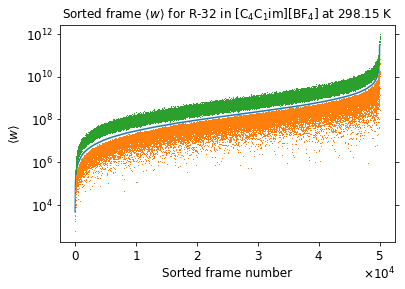

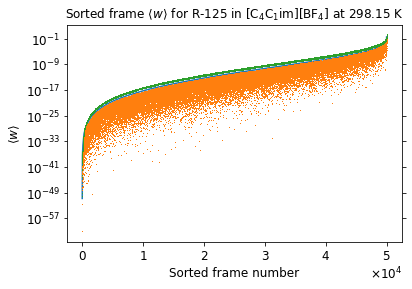

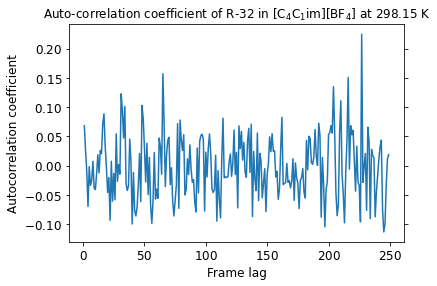

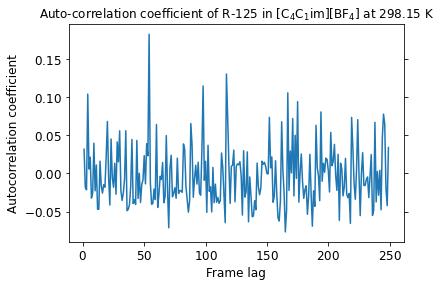

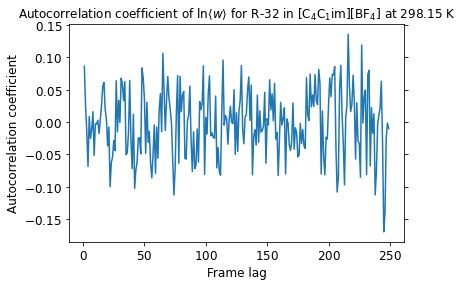

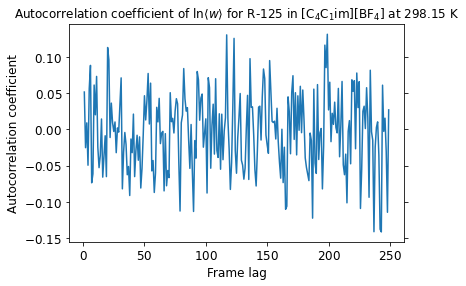

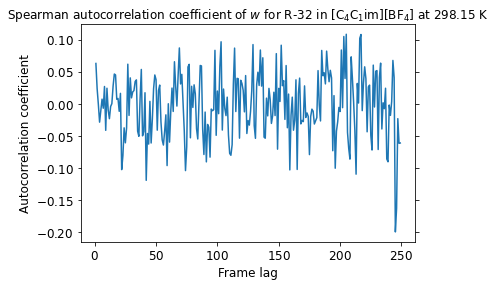

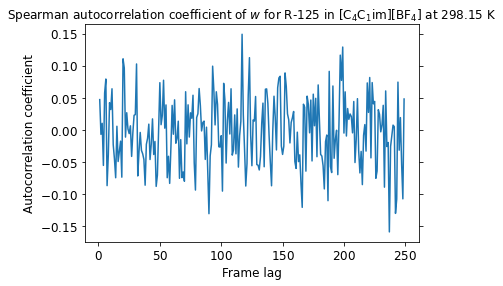

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


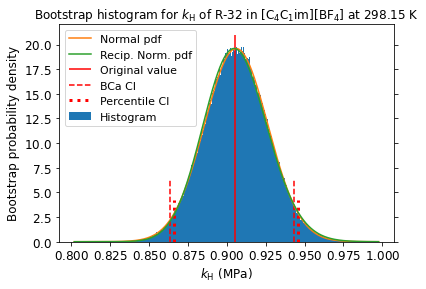

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


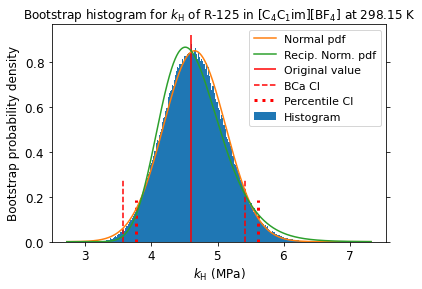

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


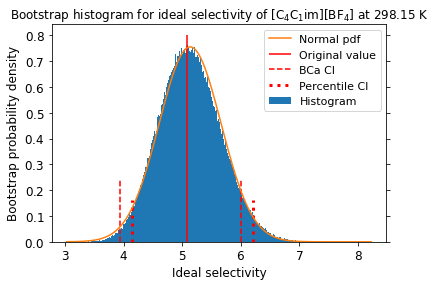

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


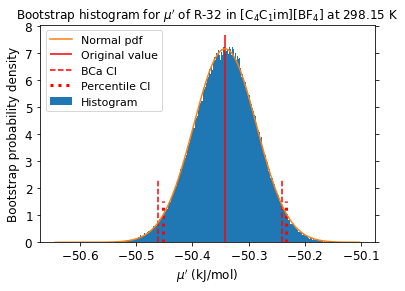

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


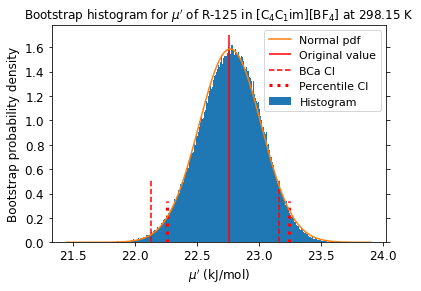

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


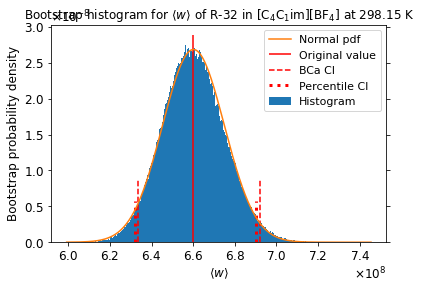

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


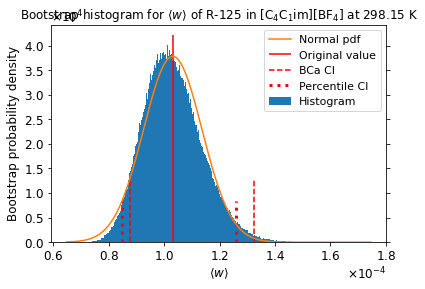

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.004065,0.004867,0.000476,0.008405
Temp,0.004116,0.005434,0.001342,0.004124
Volume,0.031377,0.162113,0.009699,0.179231
Press,-0.000864,-0.001582,-0.002733,-0.004084
PotEng,0.011016,0.065990,0.003773,0.067557
KinEng,0.004116,0.005434,0.001342,0.004124
TotEng,0.011019,0.053428,0.003729,0.053755
E_pair,0.028562,0.119505,0.002774,0.113642
E_vdwl,0.023249,0.113175,0.005896,0.120065
E_coul,0.015791,0.052781,-0.004089,0.036148


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.004306,0.004306,0.009824,0.009824
Temp,0.004693,0.004693,0.003952,0.003952
Volume,0.152912,0.152912,0.165320,0.165320
Press,0.000121,0.000121,-0.001603,-0.001603
PotEng,0.062807,0.062807,0.062353,0.062353
KinEng,0.004693,0.004693,0.003952,0.003952
TotEng,0.050430,0.050430,0.050071,0.050071
E_pair,0.112386,0.112386,0.103925,0.103925
E_vdwl,0.106101,0.106101,0.110383,0.110383
E_coul,0.049779,0.049779,0.032186,0.032186


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.002886,0.002886,0.006571,0.006571
Temp,0.003126,0.003126,0.002637,0.002637
Volume,0.102469,0.102469,0.110663,0.110663
Press,0.000081,0.000081,-0.001080,-0.001080
PotEng,0.041957,0.041957,0.041576,0.041576
KinEng,0.003126,0.003126,0.002637,0.002637
TotEng,0.033689,0.033689,0.033471,0.033471
E_pair,0.075124,0.075124,0.069392,0.069392
E_vdwl,0.070955,0.070955,0.073733,0.073733
E_coul,0.033245,0.033245,0.021468,0.021468


R-32 w column correlation (first 5 columns):
 [[1.         0.00798058 0.00555671 0.03135649 0.00775781]
 [0.00798058 1.         0.00331798 0.01088104 0.00546041]
 [0.00555671 0.00331798 1.         0.00828393 0.00555779]
 [0.03135649 0.01088104 0.00828393 1.         0.01983302]
 [0.00775781 0.00546041 0.00555779 0.01983302 1.        ]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.33877546 0.33951464 0.34103301 0.33737362]
 [0.33877546 1.         0.33793258 0.33839344 0.33591078]
 [0.33951464 0.33793258 1.         0.34636961 0.33120909]
 [0.34103301 0.33839344 0.34636961 1.         0.339449  ]
 [0.33737362 0.33591078 0.33120909 0.339449   1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.33141246 0.32872789 0.33166853 0.32549944]
 [0.33141246 1.         0.32691178 0.3305383  0.32695253]
 [0.32872789 0.32691178 1.         0.33460244 0.32027271]
 [0.33166853 0.3305383  0.33460244 1.         0.3281257 ]
 [0.32549944 0.32695253 0.32027271

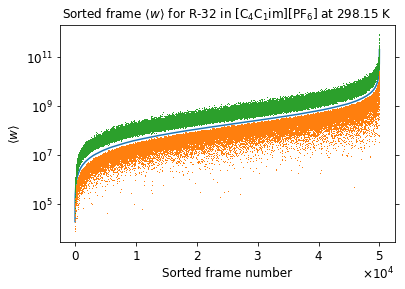

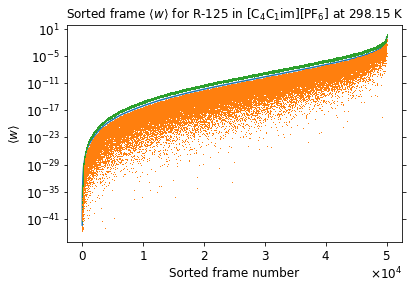

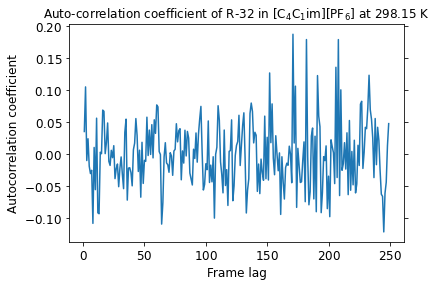

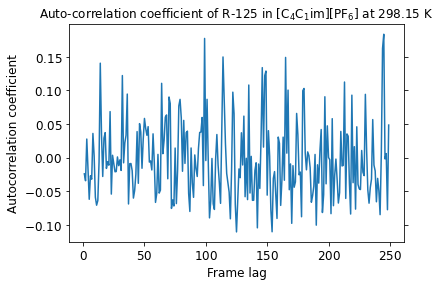

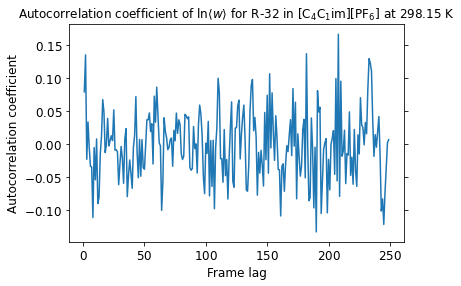

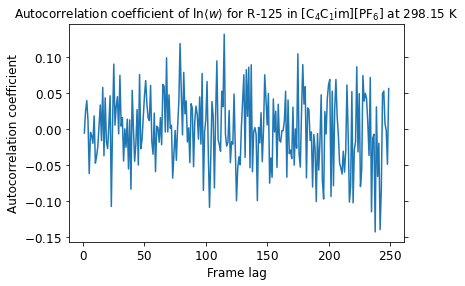

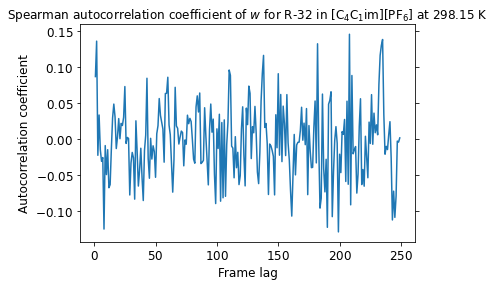

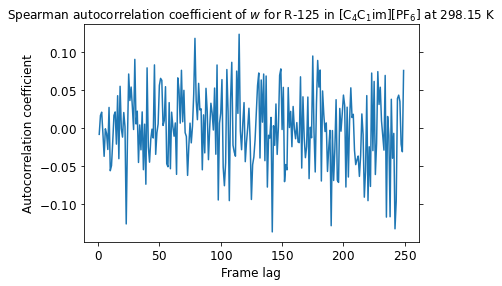

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


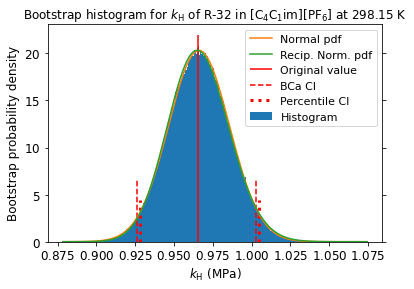

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


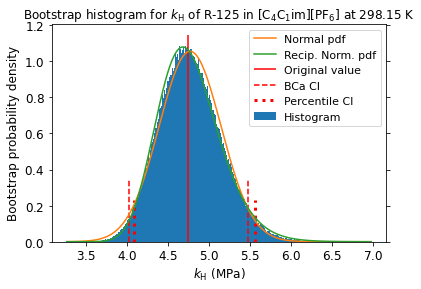

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


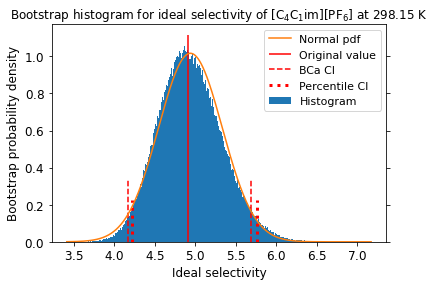

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


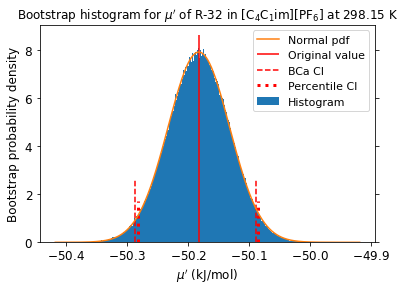

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


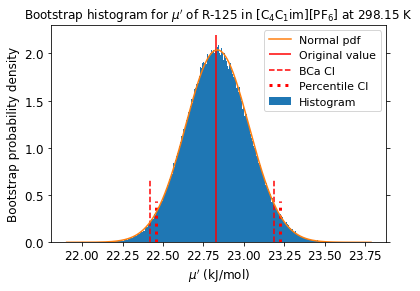

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


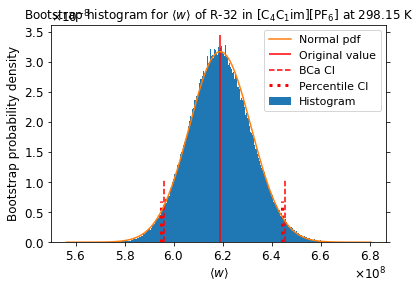

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


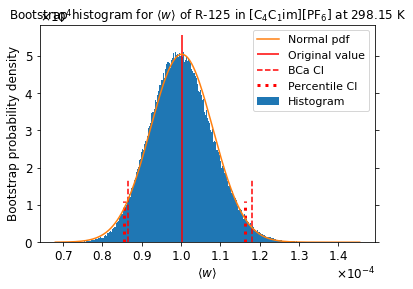

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.000583,0.000339,-0.002779,0.015888
Temp,-0.005968,-0.004685,0.003703,0.000417
Volume,0.020121,0.158611,0.007556,0.177588
Press,0.002071,0.005691,0.001366,0.000056
PotEng,0.014165,0.062149,0.004757,0.055530
KinEng,-0.005968,-0.004685,0.003703,0.000417
TotEng,0.006789,0.043870,0.006017,0.042212
E_pair,0.026193,0.110596,0.010840,0.106027
E_vdwl,0.019567,0.097851,0.009116,0.105074
E_coul,0.016530,0.050526,0.006550,0.036254


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.000277,-0.000277,0.015406,0.015406
Temp,-0.002485,-0.002485,0.006140,0.006140
Volume,0.149712,0.149712,0.162736,0.162736
Press,0.006210,0.006210,0.001842,0.001842
PotEng,0.057108,0.057108,0.050896,0.050896
KinEng,-0.002485,-0.002485,0.006140,0.006140
TotEng,0.041128,0.041128,0.042537,0.042537
E_pair,0.104348,0.104348,0.097322,0.097322
E_vdwl,0.092448,0.092448,0.096382,0.096382
E_coul,0.047877,0.047877,0.035744,0.035744


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.000206,-0.000206,0.010315,0.010315
Temp,-0.001650,-0.001650,0.004100,0.004100
Volume,0.100219,0.100219,0.108960,0.108960
Press,0.004145,0.004145,0.001236,0.001236
PotEng,0.038086,0.038086,0.033929,0.033929
KinEng,-0.001650,-0.001650,0.004100,0.004100
TotEng,0.027391,0.027391,0.028377,0.028377
E_pair,0.069785,0.069785,0.065122,0.065122
E_vdwl,0.061761,0.061761,0.064506,0.064506
E_coul,0.031970,0.031970,0.023851,0.023851


R-32 w column correlation (first 5 columns):
 [[1.         0.01314749 0.00795505 0.00488451 0.0193594 ]
 [0.01314749 1.         0.02772165 0.04747017 0.017724  ]
 [0.00795505 0.02772165 1.         0.00721427 0.00513669]
 [0.00488451 0.04747017 0.00721427 1.         0.00230669]
 [0.0193594  0.017724   0.00513669 0.00230669 1.        ]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.31187599 0.32801014 0.3284186  0.31788913]
 [0.31187599 1.         0.31930369 0.31685385 0.31484632]
 [0.32801014 0.31930369 1.         0.32971804 0.32691328]
 [0.3284186  0.31685385 0.32971804 1.         0.32374404]
 [0.31788913 0.31484632 0.32691328 0.32374404 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.30127725 0.31447806 0.31525504 0.30431935]
 [0.30127725 1.         0.31285017 0.30862358 0.30619547]
 [0.31447806 0.31285017 1.         0.31614329 0.31208592]
 [0.31525504 0.30862358 0.31614329 1.         0.31007053]
 [0.30431935 0.30619547 0.31208592

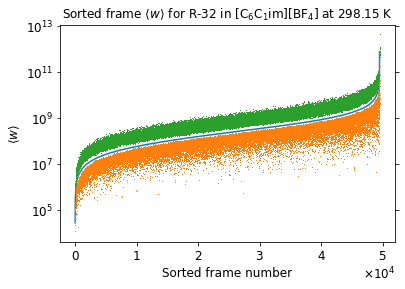

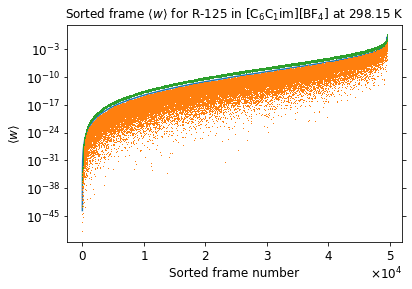

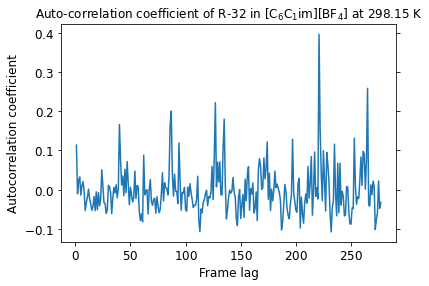

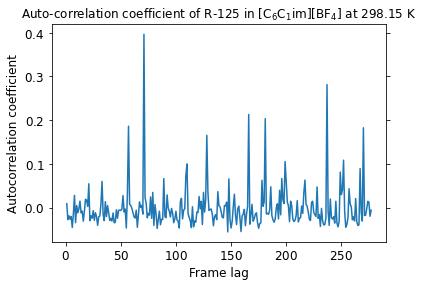

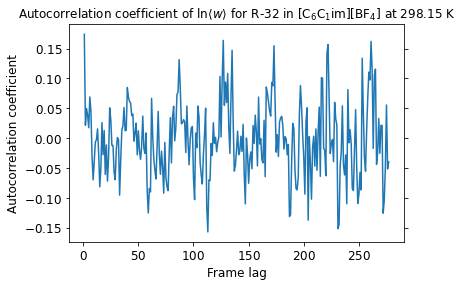

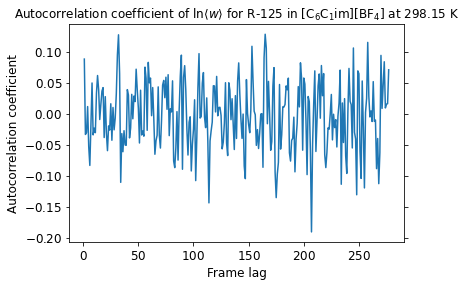

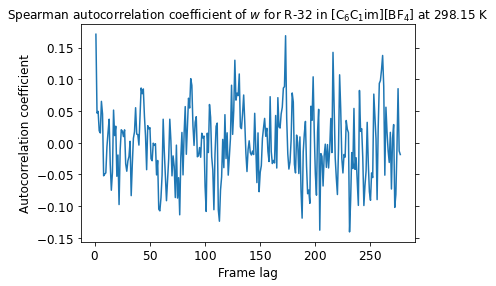

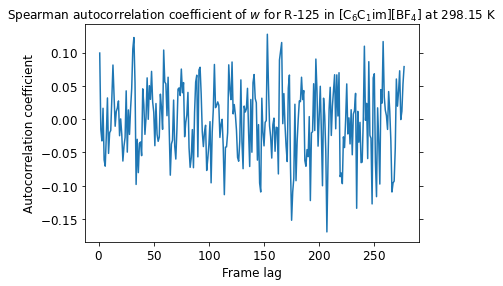

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


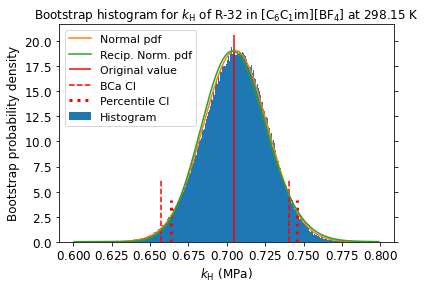

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


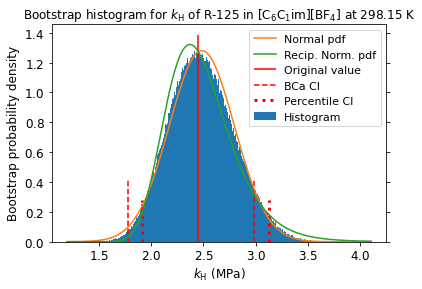

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


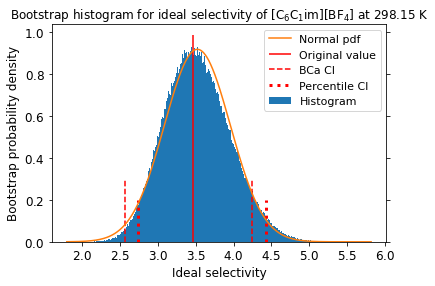

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


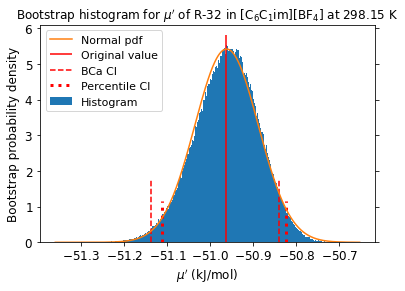

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


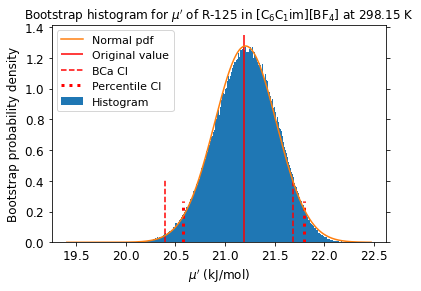

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


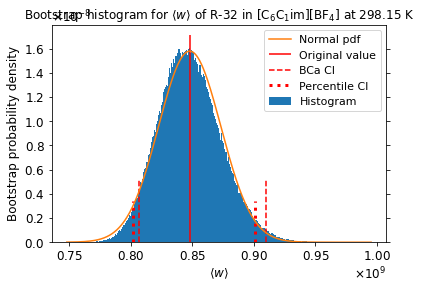

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


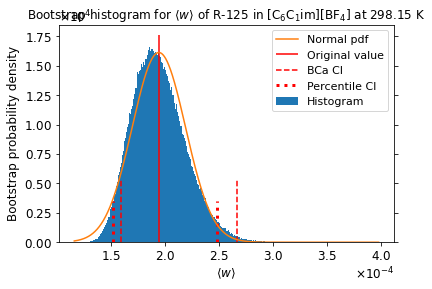

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.011591,-0.037033,-0.006246,-0.021581
Temp,0.006265,-0.000843,0.007835,-0.005737
Volume,0.012498,0.149351,0.013727,0.180684
Press,0.002180,-0.007400,0.001135,-0.012720
PotEng,0.007917,0.058786,0.003131,0.062240
KinEng,0.006265,-0.000843,0.007835,-0.005737
TotEng,0.010076,0.044388,0.007427,0.043884
E_pair,0.014214,0.098071,0.002154,0.102312
E_vdwl,0.009909,0.085702,0.000078,0.090464
E_coul,0.005272,0.034090,0.002639,0.036335


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.038388,-0.038388,-0.020381,-0.020381
Temp,0.002020,0.002020,-0.004925,-0.004925
Volume,0.140668,0.140668,0.167876,0.167876
Press,-0.005897,-0.005897,-0.011142,-0.011142
PotEng,0.056085,0.056085,0.059843,0.059843
KinEng,0.002020,0.002020,-0.004925,-0.004925
TotEng,0.042575,0.042575,0.041631,0.041631
E_pair,0.091684,0.091684,0.094817,0.094817
E_vdwl,0.078716,0.078716,0.086349,0.086349
E_coul,0.032342,0.032342,0.032881,0.032881


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.025454,-0.025454,-0.013634,-0.013634
Temp,0.001331,0.001331,-0.003285,-0.003285
Volume,0.094140,0.094140,0.112430,0.112430
Press,-0.003930,-0.003930,-0.007412,-0.007412
PotEng,0.037431,0.037431,0.039925,0.039925
KinEng,0.001331,0.001331,-0.003285,-0.003285
TotEng,0.028414,0.028414,0.027759,0.027759
E_pair,0.061222,0.061222,0.063326,0.063326
E_vdwl,0.052510,0.052510,0.057594,0.057594
E_coul,0.021567,0.021567,0.021928,0.021928


R-32 w column correlation (first 5 columns):
 [[1.00000000e+00 5.44150537e-04 9.63680414e-04 1.82101268e-02
  9.25752625e-03]
 [5.44150537e-04 1.00000000e+00 6.15532677e-04 1.16108409e-03
  1.05949061e-02]
 [9.63680414e-04 6.15532677e-04 1.00000000e+00 1.32658578e-03
  9.69795024e-03]
 [1.82101268e-02 1.16108409e-03 1.32658578e-03 1.00000000e+00
  8.29304170e-03]
 [9.25752625e-03 1.05949061e-02 9.69795024e-03 8.29304170e-03
  1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.35094453 0.34523616 0.34947235 0.35348992]
 [0.35094453 1.         0.3536894  0.36005292 0.35435603]
 [0.34523616 0.3536894  1.         0.3541886  0.3462274 ]
 [0.34947235 0.36005292 0.3541886  1.         0.3595017 ]
 [0.35348992 0.35435603 0.3462274  0.3595017  1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.34322366 0.33965722 0.3428357  0.3453066 ]
 [0.34322366 1.         0.34411967 0.35073747 0.3464291 ]
 [0.33965722 0.34411967 1.         0.347

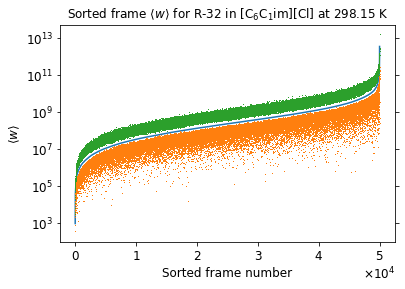

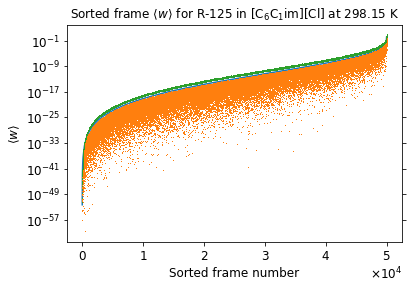

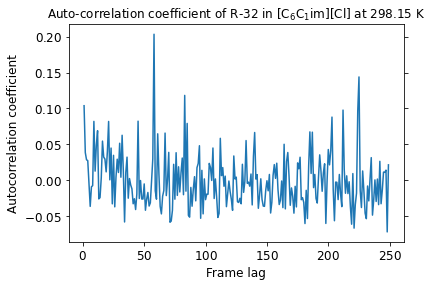

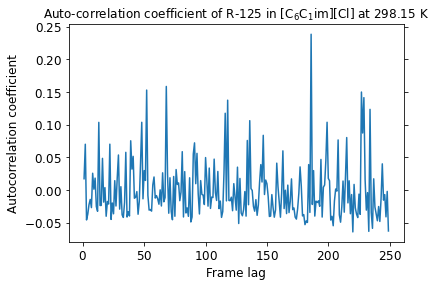

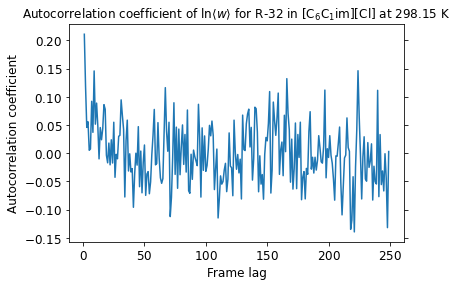

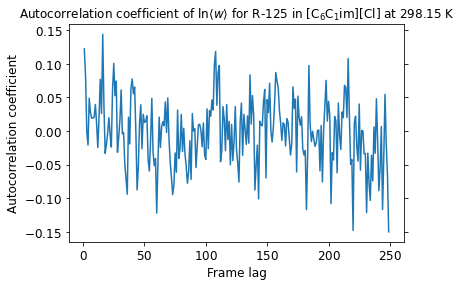

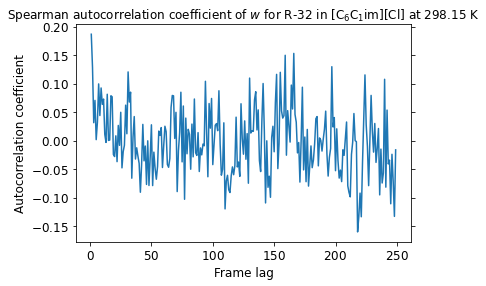

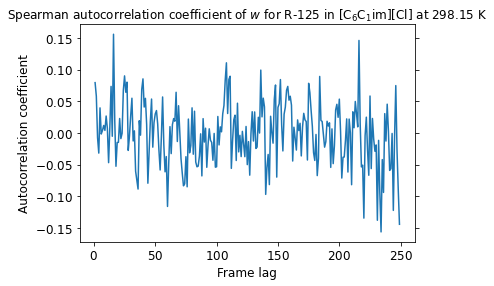

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


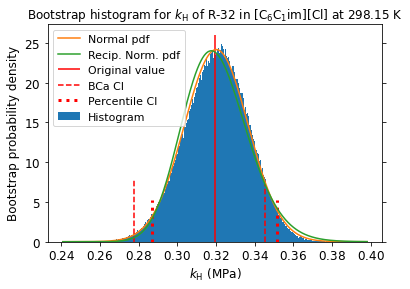

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


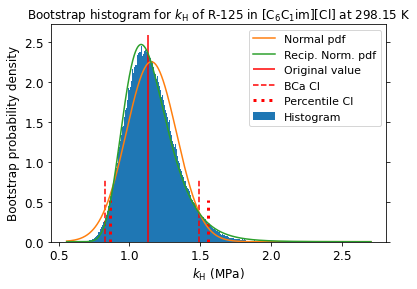

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


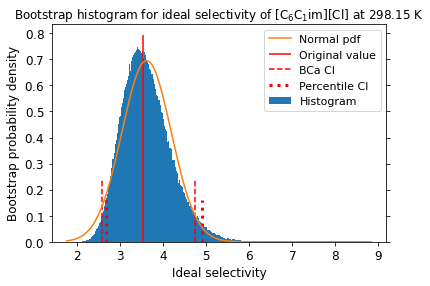

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


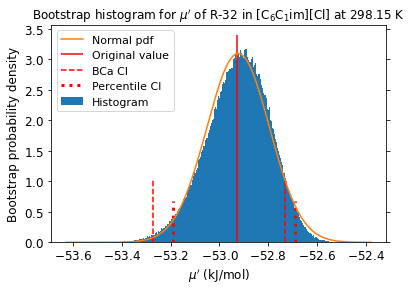

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


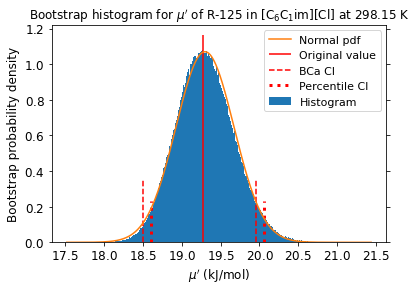

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


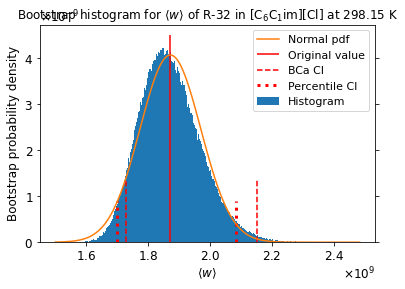

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


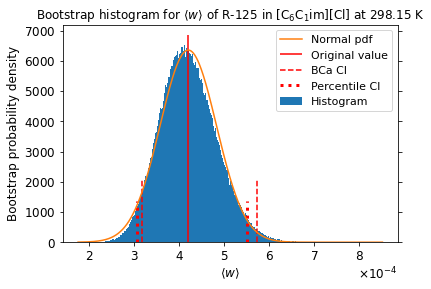

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


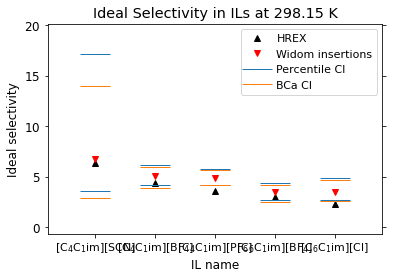

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


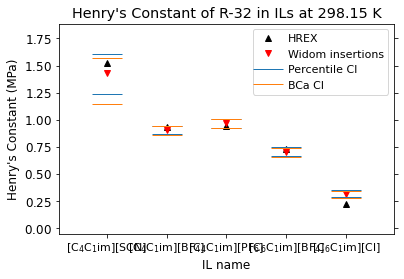

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


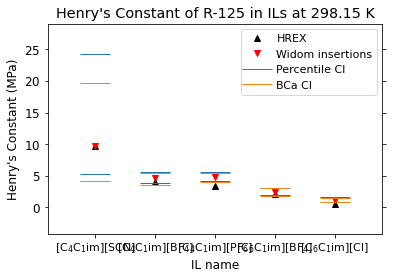

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


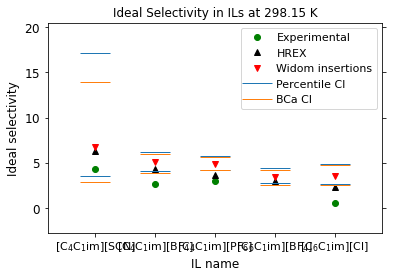

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


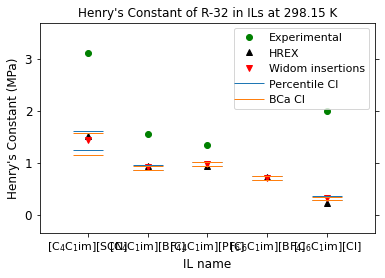

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


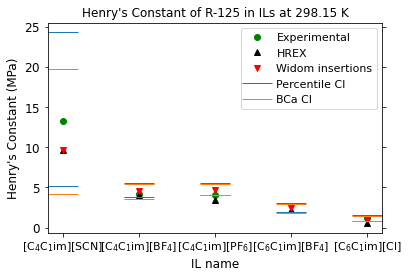

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


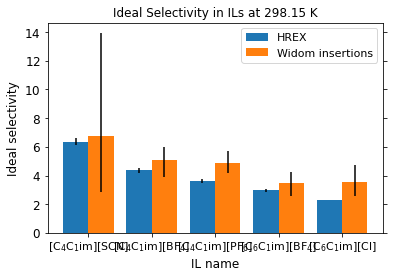

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


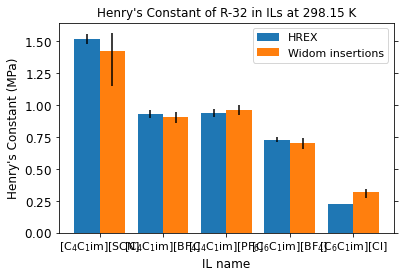

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


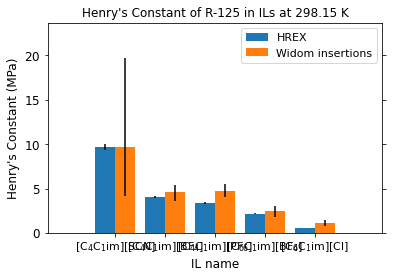

In [88]:
plot_results("cell_list_2/vbs_blocksize100_89", "cell_list_2", get_fbs=True, get_corr=True, blocksize=(100,100,100,89,100))

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.004838,-0.000313,0.000702,-0.003707
Temp,0.002626,0.002816,-0.000526,-0.001785
Volume,0.020435,0.156892,0.005571,0.176870
Press,-0.006432,-0.014198,-0.004301,-0.007062
PotEng,0.011868,0.070777,-0.003254,0.074060
KinEng,0.002626,0.002816,-0.000526,-0.001785
TotEng,0.010689,0.055368,-0.002804,0.054851
E_pair,0.013666,0.107754,0.003786,0.111653
E_vdwl,0.006656,0.099567,0.004022,0.109623
E_coul,0.013929,0.045016,0.001081,0.039898


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.001043,-0.001043,-0.005432,-0.005432
Temp,0.001041,0.001041,-0.003965,-0.003965
Volume,0.144062,0.144062,0.163464,0.163464
Press,-0.014720,-0.014720,-0.007419,-0.007419
PotEng,0.064943,0.064943,0.068323,0.068323
KinEng,0.001041,0.001041,-0.003965,-0.003965
TotEng,0.050213,0.050213,0.049694,0.049694
E_pair,0.098832,0.098832,0.102590,0.102590
E_vdwl,0.091341,0.091341,0.101340,0.101340
E_coul,0.040993,0.040993,0.034040,0.034040


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.000715,-0.000715,-0.003617,-0.003617
Temp,0.000694,0.000694,-0.002647,-0.002647
Volume,0.096440,0.096440,0.109549,0.109549
Press,-0.009812,-0.009812,-0.004943,-0.004943
PotEng,0.043319,0.043319,0.045542,0.045542
KinEng,0.000694,0.000694,-0.002647,-0.002647
TotEng,0.033498,0.033498,0.033129,0.033129
E_pair,0.066010,0.066010,0.068515,0.068515
E_vdwl,0.060954,0.060954,0.067681,0.067681
E_coul,0.027372,0.027372,0.022701,0.022701


R-32 w column correlation (first 5 columns):
 [[1.00000000e+00 9.07930643e-03 8.41741860e-03 3.29614579e-03
  7.21887344e-01]
 [9.07930643e-03 1.00000000e+00 1.40378266e-02 9.80340187e-02
  3.42201917e-04]
 [8.41741860e-03 1.40378266e-02 1.00000000e+00 1.69022611e-03
  3.81436948e-03]
 [3.29614579e-03 9.80340187e-02 1.69022611e-03 1.00000000e+00
  3.24415414e-03]
 [7.21887344e-01 3.42201917e-04 3.81436948e-03 3.24415414e-03
  1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.4030826  0.40452712 0.39431377 0.40034288]
 [0.4030826  1.         0.40787079 0.40347922 0.39952638]
 [0.40452712 0.40787079 1.         0.40268818 0.39905045]
 [0.39431377 0.40347922 0.40268818 1.         0.39376247]
 [0.40034288 0.39952638 0.39905045 0.39376247 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.40386218 0.40900748 0.40050283 0.404273  ]
 [0.40386218 1.         0.41182703 0.40723365 0.40271663]
 [0.40900748 0.41182703 1.         0.409

10 highest observations are:

[[1.37456608e+11 3.01088820e-02]
 [1.41780930e+11 3.76910352e-02]
 [1.52581391e+11 3.79556431e-02]
 [1.82147495e+11 3.90932740e-02]
 [1.83736000e+11 4.70384380e-02]
 [2.00773325e+11 7.86001539e-02]
 [2.13174249e+11 8.46143119e-02]
 [2.78526617e+11 1.18139989e-01]
 [2.80754533e+11 1.19179486e-01]
 [2.94517677e+11 1.19980638e-01]]
with indices:

[[30413  7808]
 [46403 46906]
 [32857  4889]
 [  650 22642]
 [47742 19457]
 [44497 35698]
 [21782 34555]
 [49376  6411]
 [16599 49570]
 [49594  8449]]


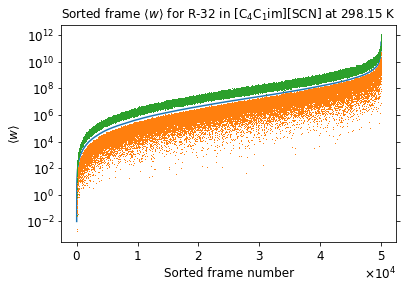

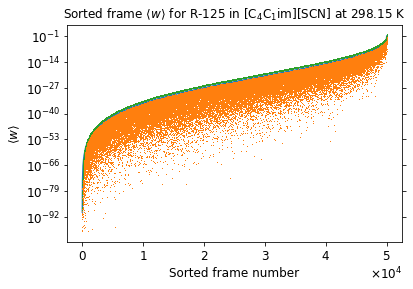

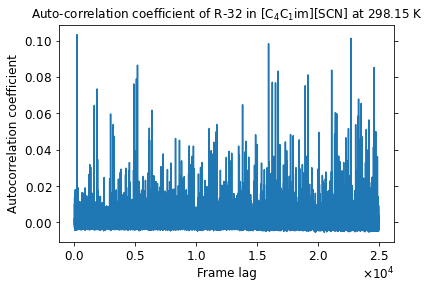

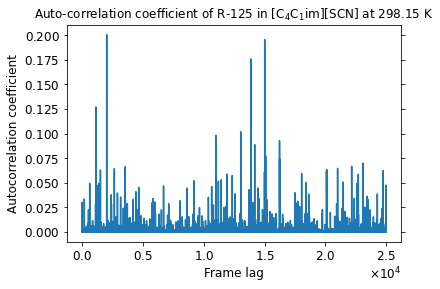

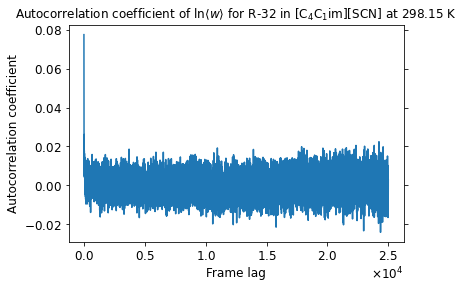

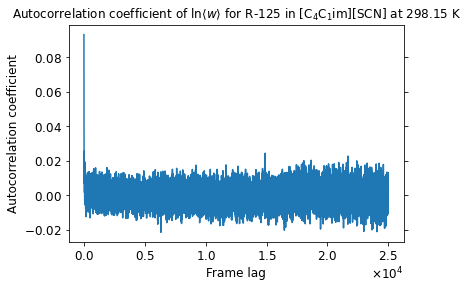

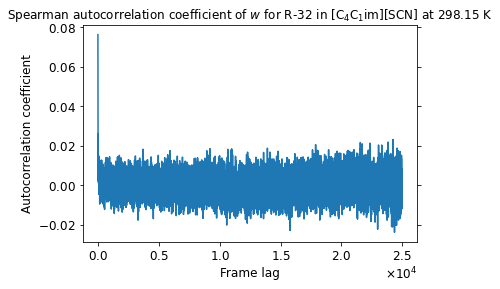

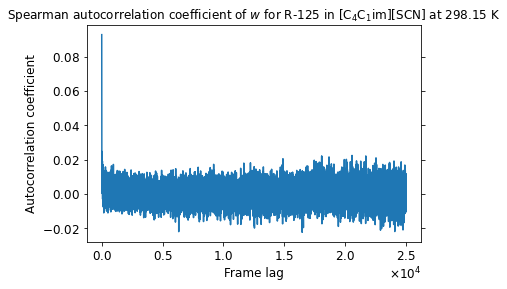

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


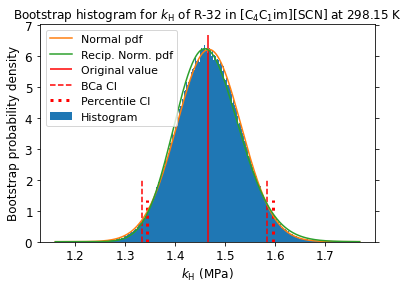

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


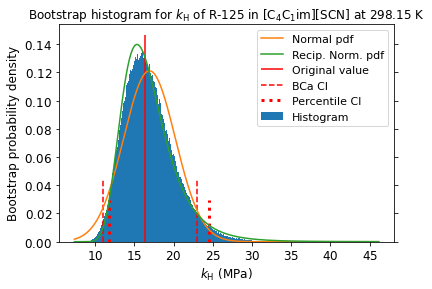

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


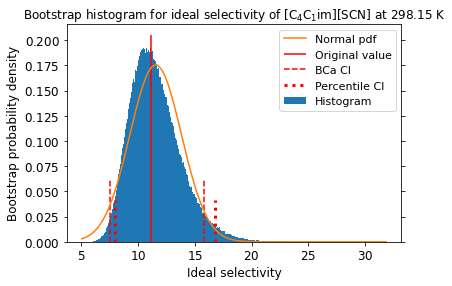

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


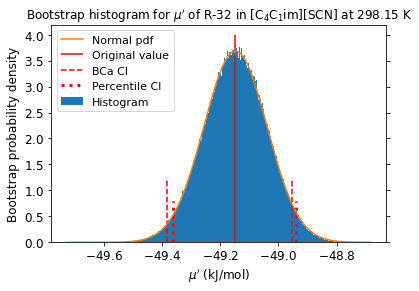

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


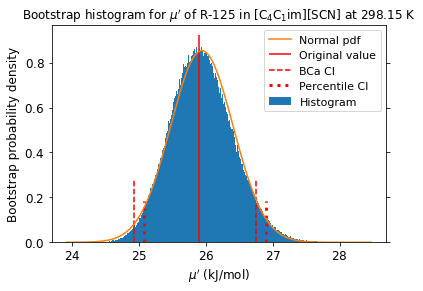

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


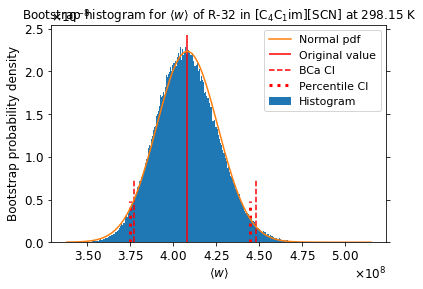

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


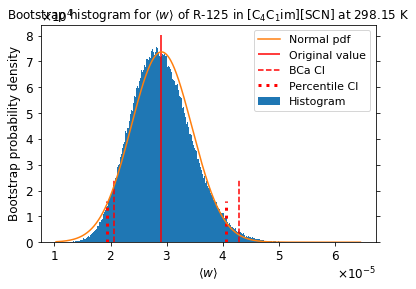

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.003831,0.019248,-0.008196,0.021976
Temp,-0.003847,0.003411,-0.003761,0.001469
Volume,0.032898,0.161028,0.015053,0.184538
Press,0.003566,-0.004462,-0.001812,-0.006973
PotEng,0.019518,0.068687,0.000721,0.075222
KinEng,-0.003847,0.003411,-0.003761,0.001469
TotEng,0.012181,0.053980,-0.001923,0.057630
E_pair,0.025892,0.112828,0.006637,0.117005
E_vdwl,0.023327,0.103301,0.008333,0.114015
E_coul,0.010684,0.051200,0.000436,0.047043


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.017872,0.017872,0.018699,0.018699
Temp,0.004438,0.004438,0.000556,0.000556
Volume,0.150723,0.150723,0.171795,0.171795
Press,-0.004536,-0.004536,-0.006832,-0.006832
PotEng,0.064595,0.064595,0.071442,0.071442
KinEng,0.004438,0.004438,0.000556,0.000556
TotEng,0.050854,0.050854,0.053576,0.053576
E_pair,0.106483,0.106483,0.106355,0.106355
E_vdwl,0.097927,0.097927,0.105390,0.105390
E_coul,0.047009,0.047009,0.042067,0.042067


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.011924,0.011924,0.012458,0.012458
Temp,0.002962,0.002962,0.000365,0.000365
Volume,0.100799,0.100799,0.115049,0.115049
Press,-0.003029,-0.003029,-0.004565,-0.004565
PotEng,0.043040,0.043040,0.047699,0.047699
KinEng,0.002962,0.002962,0.000365,0.000365
TotEng,0.033887,0.033887,0.035736,0.035736
E_pair,0.070997,0.070997,0.071050,0.071050
E_vdwl,0.065426,0.065426,0.070411,0.070411
E_coul,0.031317,0.031317,0.028051,0.028051


R-32 w column correlation (first 5 columns):
 [[1.00000000e+00 4.54997284e-04 1.97771370e-03 6.11668121e-04
  4.02921334e-03]
 [4.54997284e-04 1.00000000e+00 4.06082403e-04 8.48262616e-04
  2.31485687e-03]
 [1.97771370e-03 4.06082403e-04 1.00000000e+00 3.91002862e-03
  8.76333945e-03]
 [6.11668121e-04 8.48262616e-04 3.91002862e-03 1.00000000e+00
  4.60241658e-03]
 [4.02921334e-03 2.31485687e-03 8.76333945e-03 4.60241658e-03
  1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.35685374 0.35215022 0.36205921 0.35639759]
 [0.35685374 1.         0.34841556 0.36316075 0.35472133]
 [0.35215022 0.34841556 1.         0.3582231  0.35394505]
 [0.36205921 0.36316075 0.3582231  1.         0.36332528]
 [0.35639759 0.35472133 0.35394505 0.36332528 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.34825897 0.3433029  0.35193156 0.34991133]
 [0.34825897 1.         0.3415056  0.35167971 0.34634582]
 [0.3433029  0.3415056  1.         0.352

10 highest observations are:

[[9.14125465e+10 5.69486836e-02]
 [1.01113794e+11 5.85226368e-02]
 [1.04008398e+11 6.10851664e-02]
 [1.29710819e+11 6.49102878e-02]
 [1.45964812e+11 7.16769304e-02]
 [1.56627690e+11 7.30811462e-02]
 [1.78200876e+11 8.91129927e-02]
 [1.92620909e+11 1.08773045e-01]
 [2.17640575e+11 1.11876572e-01]
 [2.79161209e+11 1.13305832e-01]]
with indices:

[[31422 49571]
 [13218 24200]
 [17791  3180]
 [ 6435 37544]
 [31579  4319]
 [15238 19828]
 [18382 14183]
 [ 4448  9076]
 [11305 43313]
 [21851  2304]]


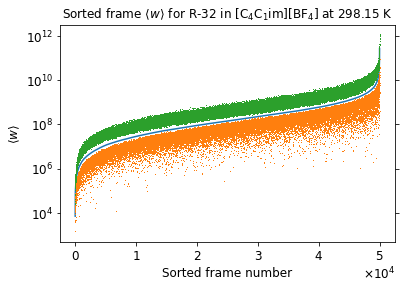

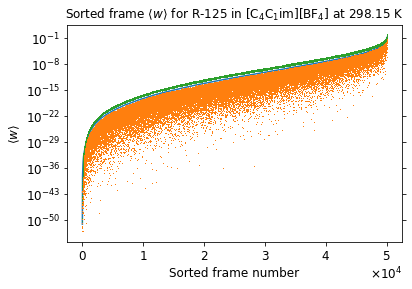

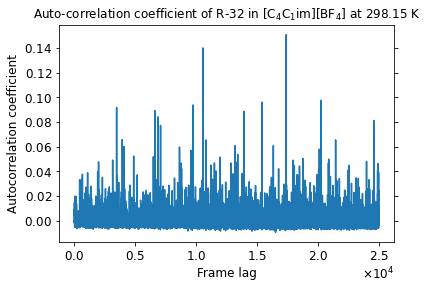

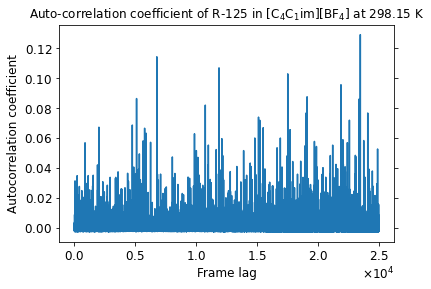

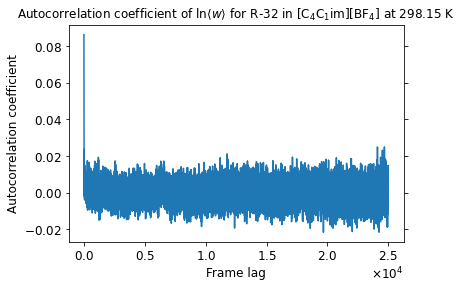

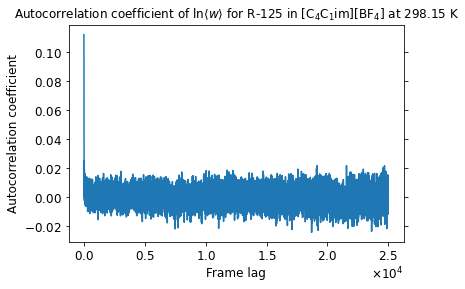

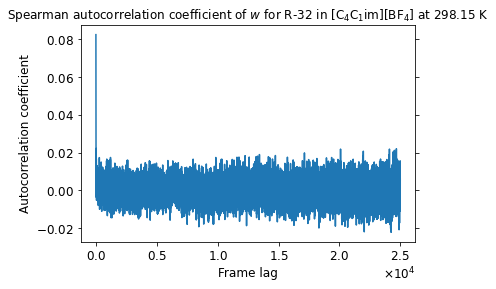

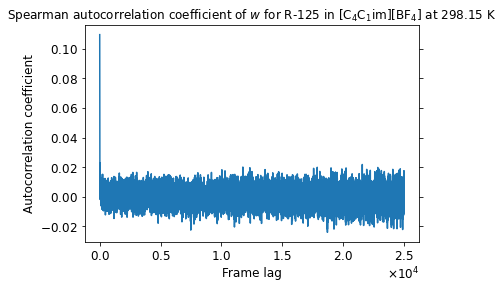

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


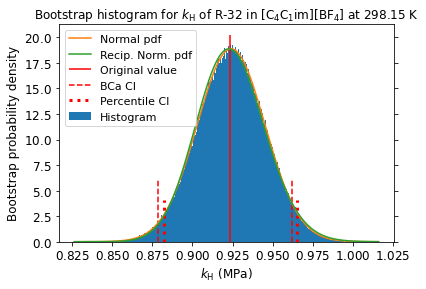

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


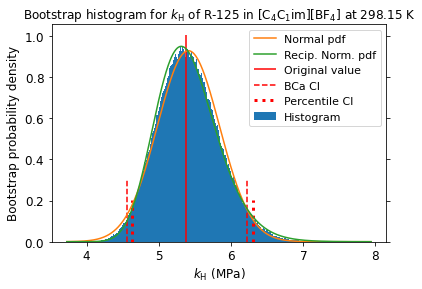

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


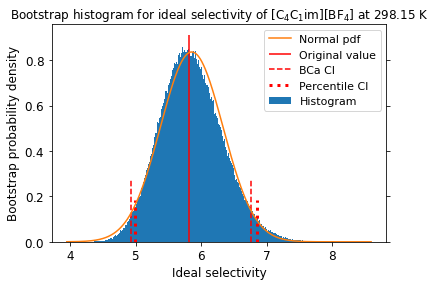

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


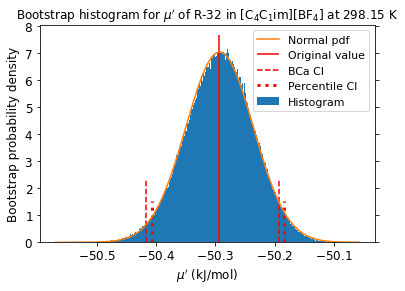

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


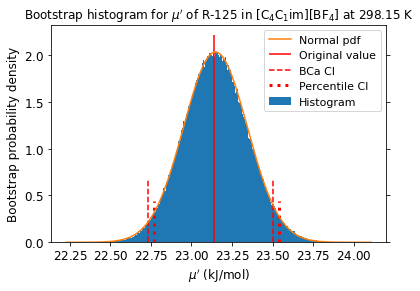

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


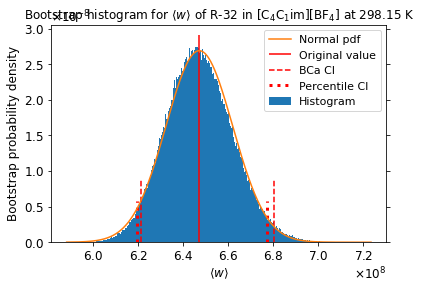

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


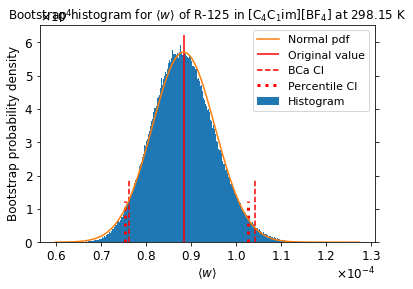

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.001098,0.002117,0.000462,0.008340
Temp,0.003908,0.002266,0.002161,0.001835
Volume,0.022342,0.159916,0.008015,0.177956
Press,0.001145,-0.002722,0.002520,-0.003482
PotEng,0.010890,0.067591,0.004426,0.065223
KinEng,0.003908,0.002266,0.002161,0.001835
TotEng,0.010787,0.052565,0.004759,0.050493
E_pair,0.019621,0.115217,0.003684,0.112454
E_vdwl,0.014426,0.109998,0.000423,0.120187
E_coul,0.012768,0.049693,0.003840,0.033821


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.000919,0.000919,0.008223,0.008223
Temp,0.001683,0.001683,0.002912,0.002912
Volume,0.151884,0.151884,0.163243,0.163243
Press,-0.001279,-0.001279,-0.001507,-0.001507
PotEng,0.063644,0.063644,0.059404,0.059404
KinEng,0.001683,0.001683,0.002912,0.002912
TotEng,0.048789,0.048789,0.046922,0.046922
E_pair,0.107555,0.107555,0.102346,0.102346
E_vdwl,0.102405,0.102405,0.109562,0.109562
E_coul,0.046311,0.046311,0.028477,0.028477


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.000640,0.000640,0.005548,0.005548
Temp,0.001129,0.001129,0.001946,0.001946
Volume,0.101674,0.101674,0.109264,0.109264
Press,-0.000859,-0.000859,-0.001019,-0.001019
PotEng,0.042483,0.042483,0.039608,0.039608
KinEng,0.001129,0.001129,0.001946,0.001946
TotEng,0.032580,0.032580,0.031370,0.031370
E_pair,0.071906,0.071906,0.068304,0.068304
E_vdwl,0.068431,0.068431,0.073158,0.073158
E_coul,0.030939,0.030939,0.018990,0.018990


R-32 w column correlation (first 5 columns):
 [[1.00000000e+00 7.44470042e-04 9.56278143e-03 2.26769913e-01
  6.88018696e-03]
 [7.44470042e-04 1.00000000e+00 3.51172387e-03 1.52009798e-02
  9.27935928e-03]
 [9.56278143e-03 3.51172387e-03 1.00000000e+00 3.51060708e-03
  1.01790677e-02]
 [2.26769913e-01 1.52009798e-02 3.51060708e-03 1.00000000e+00
  3.09415580e-02]
 [6.88018696e-03 9.27935928e-03 1.01790677e-02 3.09415580e-02
  1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.34001771 0.33594825 0.33647298 0.33288035]
 [0.34001771 1.         0.33496918 0.34169104 0.3346576 ]
 [0.33594825 0.33496918 1.         0.33856024 0.33881875]
 [0.33647298 0.34169104 0.33856024 1.         0.33097789]
 [0.33288035 0.3346576  0.33881875 0.33097789 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.33167178 0.32520865 0.32589936 0.32640677]
 [0.33167178 1.         0.32819886 0.33092603 0.32732883]
 [0.32520865 0.32819886 1.         0.326

10 highest observations are:

[[8.88272102e+10 7.95103963e-02]
 [9.48654989e+10 8.49221496e-02]
 [1.02262623e+11 9.84440419e-02]
 [1.13201829e+11 9.86777039e-02]
 [1.19201704e+11 1.22824713e-01]
 [1.28423892e+11 2.01271796e-01]
 [1.31813891e+11 2.15326274e-01]
 [1.40703531e+11 2.22954943e-01]
 [1.43641867e+11 2.39801240e-01]
 [1.56600298e+11 2.86156309e-01]]
with indices:

[[ 4758 16557]
 [38305 21080]
 [29524 15826]
 [42405 10521]
 [36331 37914]
 [17526 10676]
 [10353 45994]
 [ 1413 42010]
 [46815 10715]
 [38161 28022]]


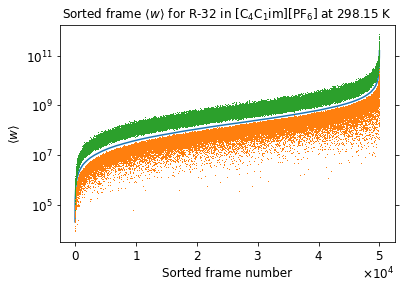

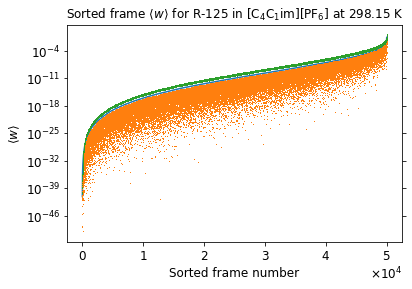

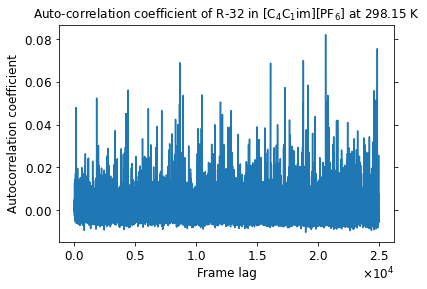

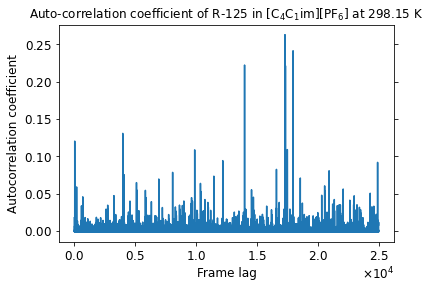

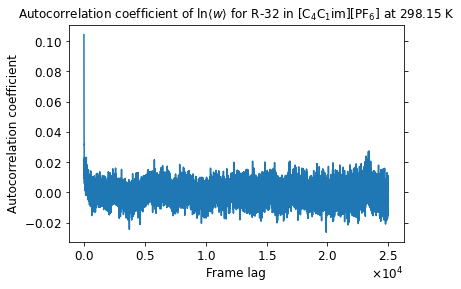

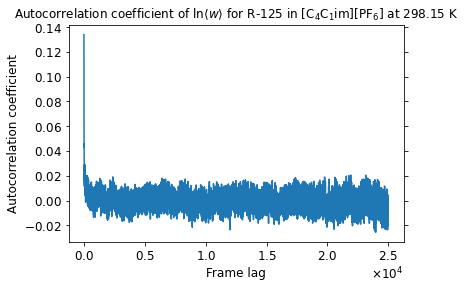

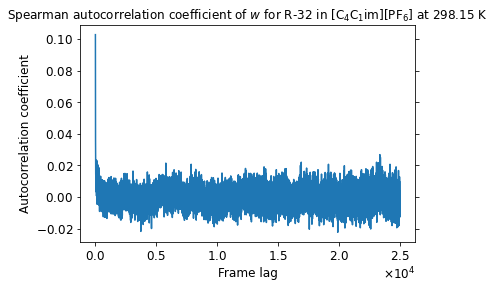

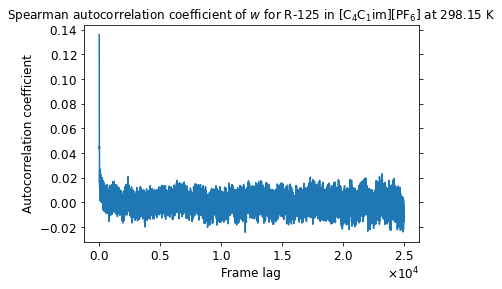

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


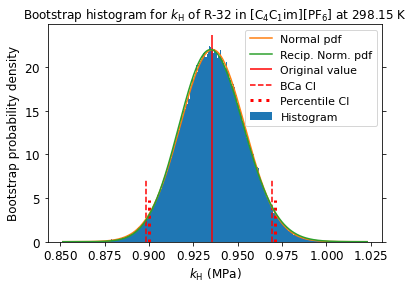

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


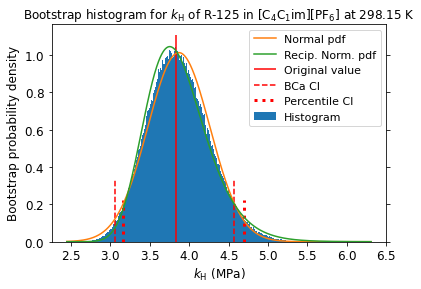

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


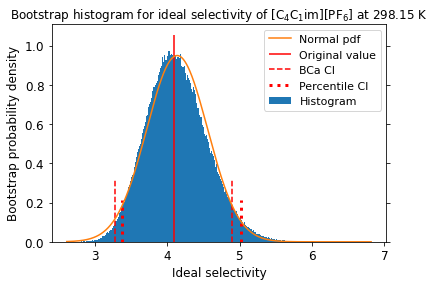

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


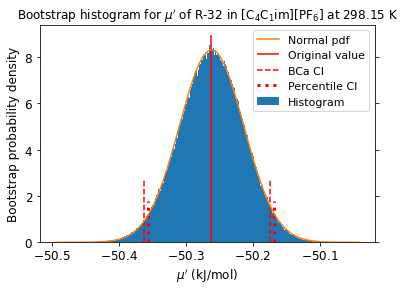

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


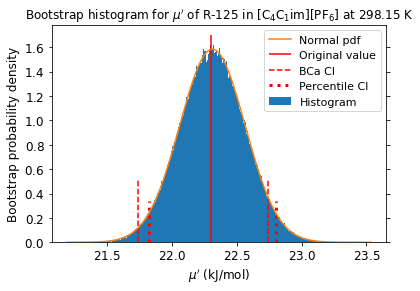

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


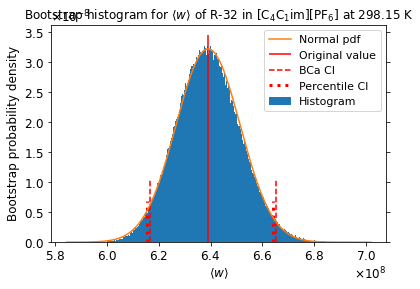

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


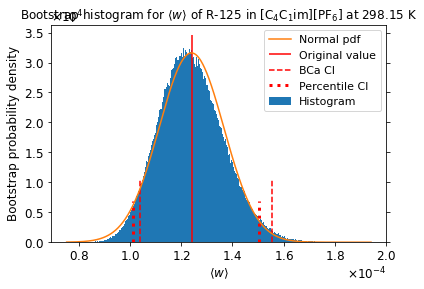

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.001730,0.002395,-0.001822,0.018002
Temp,-0.001264,-0.006630,0.003248,0.000603
Volume,0.037697,0.160781,-0.005567,0.177888
Press,-0.004116,0.004713,0.003603,0.001690
PotEng,0.018463,0.060525,0.004076,0.060012
KinEng,-0.001264,-0.006630,0.003248,0.000603
TotEng,0.013116,0.041369,0.005205,0.045718
E_pair,0.031239,0.115252,-0.003973,0.106738
E_vdwl,0.023845,0.101391,-0.004582,0.106743
E_coul,0.017980,0.054061,-0.001550,0.036045


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.003223,0.003223,0.017760,0.017760
Temp,-0.004529,-0.004529,0.005662,0.005662
Volume,0.150117,0.150117,0.162571,0.162571
Press,0.006217,0.006217,0.003392,0.003392
PotEng,0.054959,0.054959,0.054371,0.054371
KinEng,-0.004529,-0.004529,0.005662,0.005662
TotEng,0.037928,0.037928,0.044860,0.044860
E_pair,0.108868,0.108868,0.096515,0.096515
E_vdwl,0.095482,0.095482,0.096691,0.096691
E_coul,0.052532,0.052532,0.034072,0.034072


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.002131,0.002131,0.011840,0.011840
Temp,-0.003025,-0.003025,0.003770,0.003770
Volume,0.100413,0.100413,0.108907,0.108907
Press,0.004142,0.004142,0.002261,0.002261
PotEng,0.036640,0.036640,0.036241,0.036241
KinEng,-0.003025,-0.003025,0.003770,0.003770
TotEng,0.025260,0.025260,0.029901,0.029901
E_pair,0.072744,0.072744,0.064565,0.064565
E_vdwl,0.063730,0.063730,0.064698,0.064698
E_coul,0.035037,0.035037,0.022739,0.022739


R-32 w column correlation (first 5 columns):
 [[1.         0.01252469 0.0043     0.00553564 0.00416771]
 [0.01252469 1.         0.02451115 0.00762742 0.00367742]
 [0.0043     0.02451115 1.         0.01477745 0.01820313]
 [0.00553564 0.00762742 0.01477745 1.         0.00158652]
 [0.00416771 0.00367742 0.01820313 0.00158652 1.        ]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.31826375 0.32661933 0.33318952 0.32150915]
 [0.31826375 1.         0.32067737 0.32674354 0.31782237]
 [0.32661933 0.32067737 1.         0.33362335 0.321492  ]
 [0.33318952 0.32674354 0.33362335 1.         0.32805344]
 [0.32150915 0.31782237 0.321492   0.32805344 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.30757983 0.31161289 0.31529479 0.3049331 ]
 [0.30757983 1.         0.30544267 0.31257133 0.30142215]
 [0.31161289 0.30544267 1.         0.31471606 0.30794109]
 [0.31529479 0.31257133 0.31471606 1.         0.30999642]
 [0.3049331  0.30142215 0.30794109

10 highest observations are:

[[8.34383274e+10 1.50233813e-01]
 [8.75548178e+10 1.55233969e-01]
 [9.61654495e+10 2.00305202e-01]
 [9.73241733e+10 2.06692685e-01]
 [9.75059670e+10 2.22310411e-01]
 [1.06407376e+11 2.27095517e-01]
 [1.18310558e+11 3.48063621e-01]
 [1.24126319e+11 3.55876686e-01]
 [1.89490033e+11 2.31925609e+00]
 [2.06319506e+11 6.30975881e+00]]
with indices:

[[28037 34332]
 [21651 45686]
 [38524 26526]
 [41650 28467]
 [35508 35615]
 [10356 40831]
 [43383 22011]
 [ 4986 34330]
 [45570 38359]
 [29989 10875]]


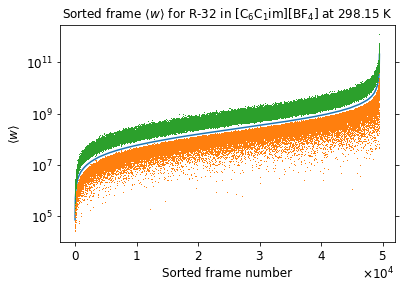

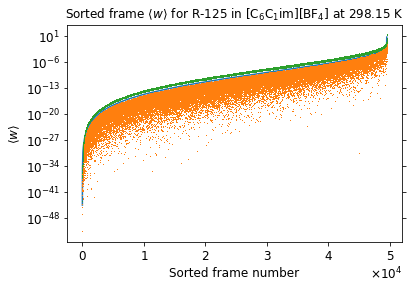

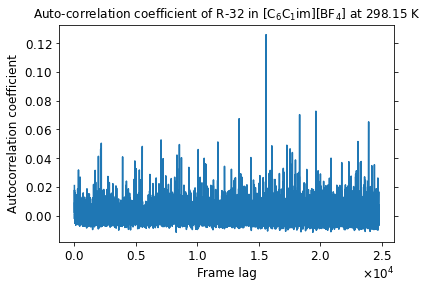

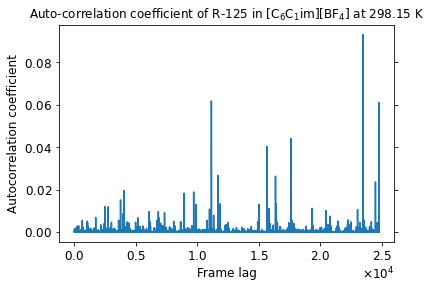

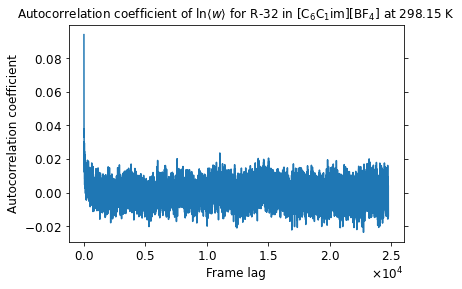

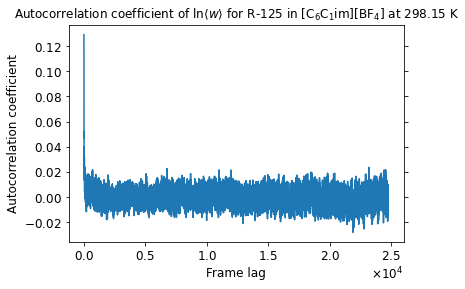

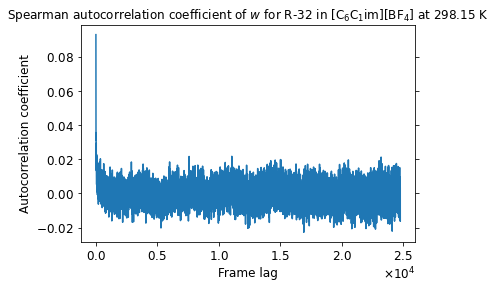

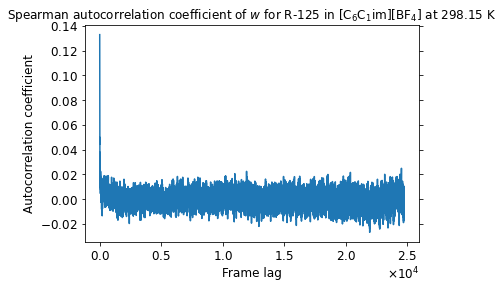

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


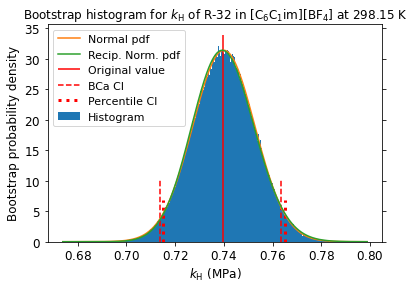

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


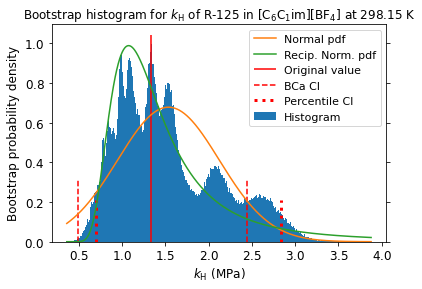

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


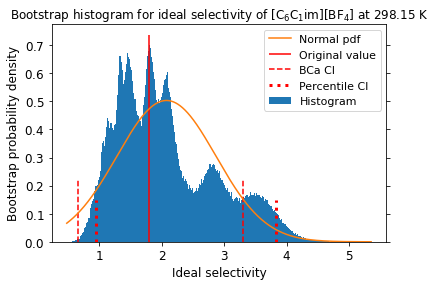

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


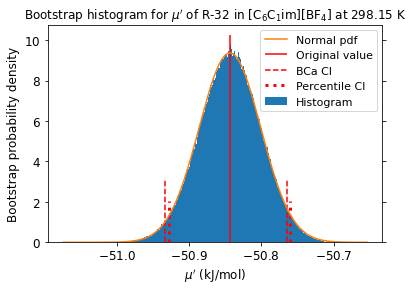

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


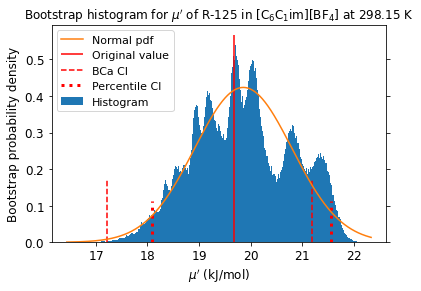

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


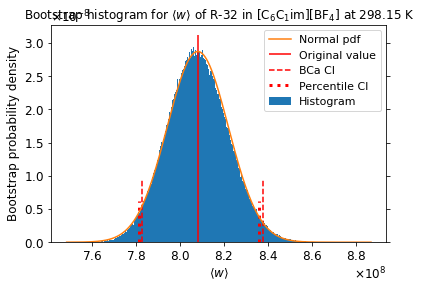

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


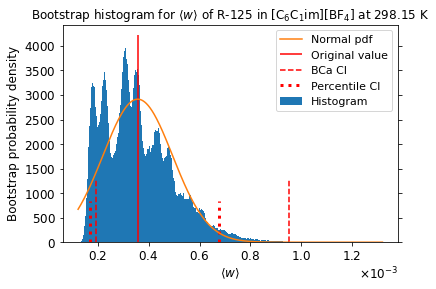

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.011533,-0.040341,-0.000633,-0.023731
Temp,0.004051,-0.000450,-0.003450,-0.006595
Volume,0.021401,0.148628,0.002756,0.180333
Press,-0.001623,-0.006412,0.000278,-0.011804
PotEng,0.011732,0.058215,0.000087,0.068069
KinEng,0.004051,-0.000450,-0.003450,-0.006595
TotEng,0.011570,0.044205,-0.002150,0.047788
E_pair,0.020167,0.100297,0.000615,0.103977
E_vdwl,0.016477,0.083529,-0.001379,0.089706
E_coul,0.006843,0.039928,0.003323,0.039171


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.041249,-0.041249,-0.022070,-0.022070
Temp,0.002182,0.002182,-0.005021,-0.005021
Volume,0.140012,0.140012,0.167942,0.167942
Press,-0.004795,-0.004795,-0.010446,-0.010446
PotEng,0.055298,0.055298,0.064429,0.064429
KinEng,0.002182,0.002182,-0.005021,-0.005021
TotEng,0.042124,0.042124,0.044925,0.044925
E_pair,0.094484,0.094484,0.095674,0.095674
E_vdwl,0.077300,0.077300,0.083859,0.083859
E_coul,0.037834,0.037834,0.036252,0.036252


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.027374,-0.027374,-0.014827,-0.014827
Temp,0.001447,0.001447,-0.003348,-0.003348
Volume,0.093684,0.093684,0.112470,0.112470
Press,-0.003196,-0.003196,-0.006953,-0.006953
PotEng,0.036920,0.036920,0.042966,0.042966
KinEng,0.001447,0.001447,-0.003348,-0.003348
TotEng,0.028128,0.028128,0.029962,0.029962
E_pair,0.063147,0.063147,0.063889,0.063889
E_vdwl,0.051599,0.051599,0.055916,0.055916
E_coul,0.025221,0.025221,0.024166,0.024166


R-32 w column correlation (first 5 columns):
 [[1.00000000e+00 3.02617264e-03 1.66251192e-02 2.07999084e-02
  5.38769080e-03]
 [3.02617264e-03 1.00000000e+00 5.02966847e-04 5.90569953e-03
  1.98569089e-02]
 [1.66251192e-02 5.02966847e-04 1.00000000e+00 2.06265259e-03
  2.37771434e-03]
 [2.07999084e-02 5.90569953e-03 2.06265259e-03 1.00000000e+00
  8.90193347e-03]
 [5.38769080e-03 1.98569089e-02 2.37771434e-03 8.90193347e-03
  1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.35335302 0.35355973 0.35080922 0.35444958]
 [0.35335302 1.         0.347148   0.35486906 0.35366884]
 [0.35355973 0.347148   1.         0.35546095 0.35643332]
 [0.35080922 0.35486906 0.35546095 1.         0.35814423]
 [0.35444958 0.35366884 0.35643332 0.35814423 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.34370044 0.34531633 0.34085617 0.34691722]
 [0.34370044 1.         0.33868775 0.3439067  0.34500061]
 [0.34531633 0.33868775 1.         0.342

10 highest observations are:

[[5.15792074e+11 2.61767566e-01]
 [5.45539757e+11 2.65494969e-01]
 [6.33621755e+11 3.02275691e-01]
 [6.83127992e+11 3.06679433e-01]
 [7.77683480e+11 3.77885155e-01]
 [8.99888099e+11 7.13752670e-01]
 [1.08294343e+12 7.55659292e-01]
 [1.32012473e+12 7.82472381e-01]
 [1.63262924e+12 1.31221895e+00]
 [2.17170855e+12 1.99137336e+00]]
with indices:

[[15321 31735]
 [46736    90]
 [44775 11672]
 [39955 11623]
 [15540 40616]
 [10396 19492]
 [23442 11695]
 [18585 47197]
 [34044 25745]
 [10589 18307]]


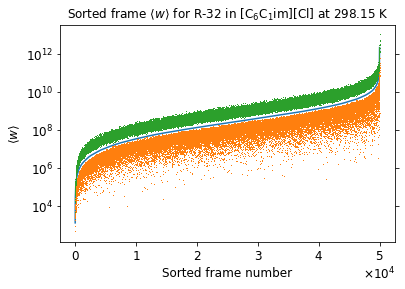

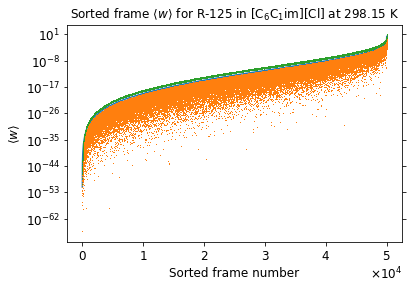

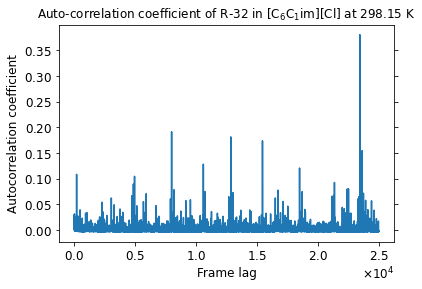

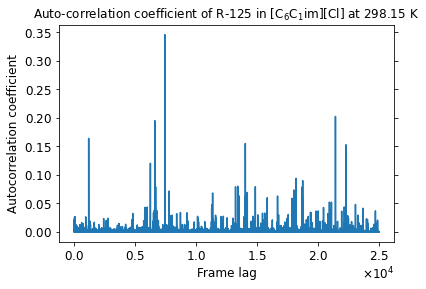

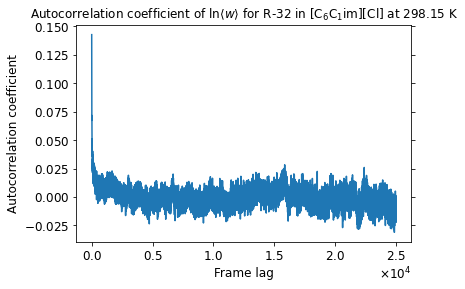

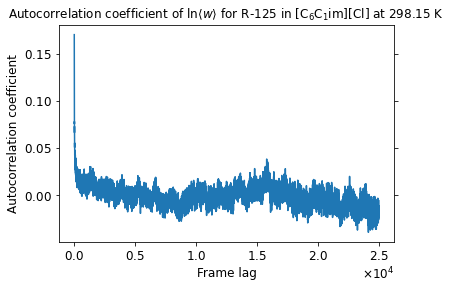

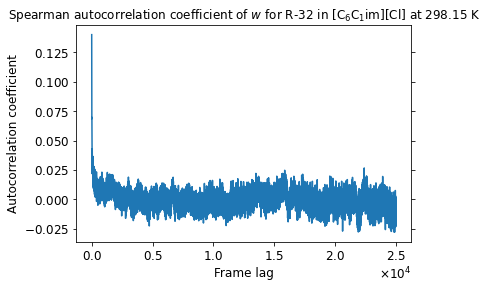

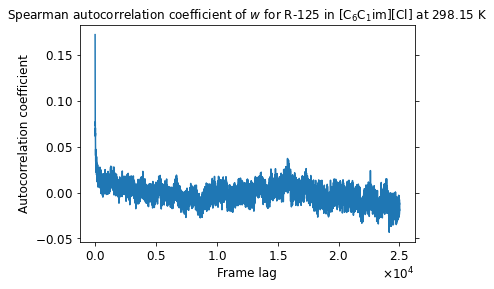

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


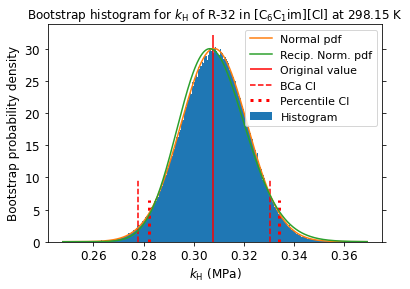

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


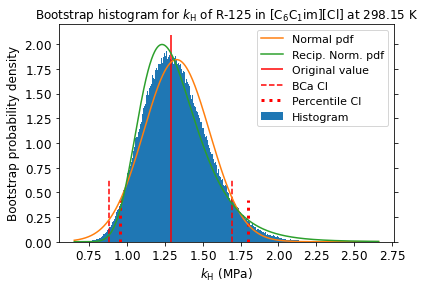

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


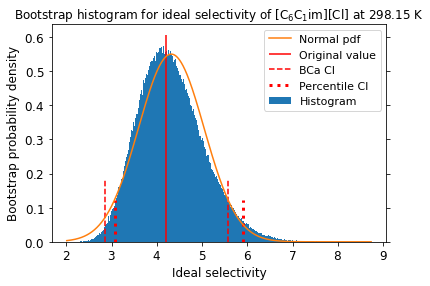

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


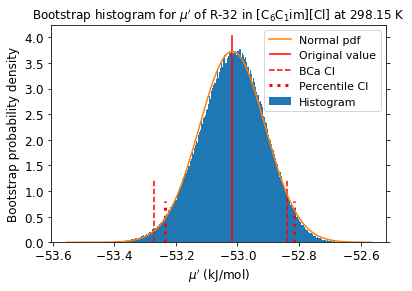

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


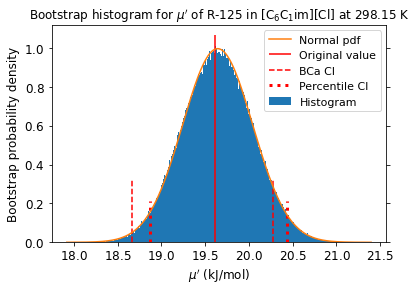

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


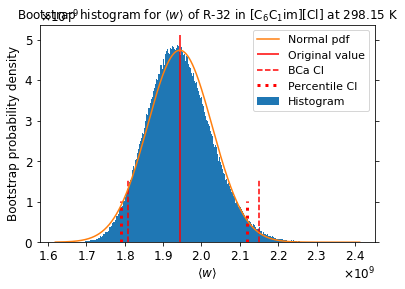

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


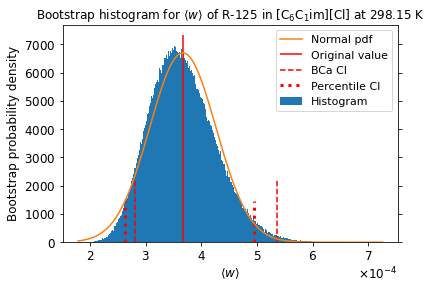

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


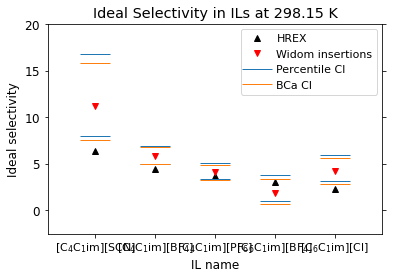

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


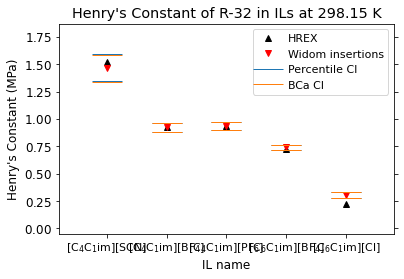

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


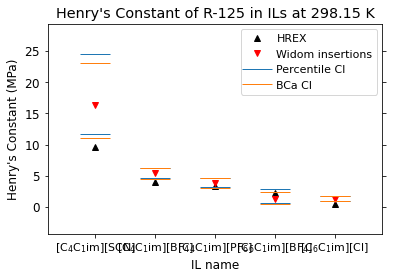

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


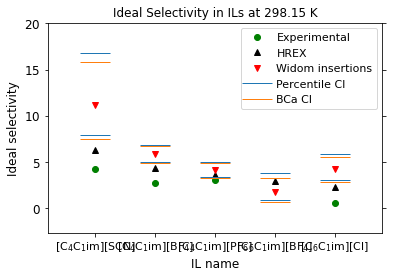

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


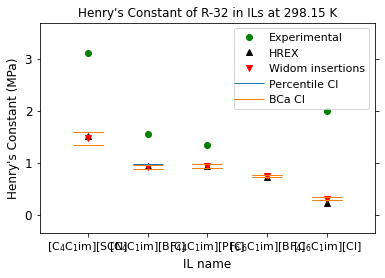

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


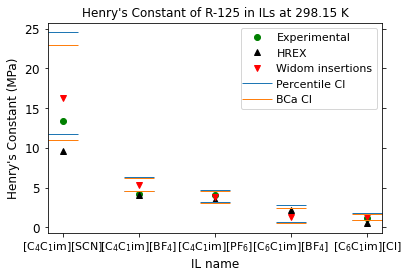

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


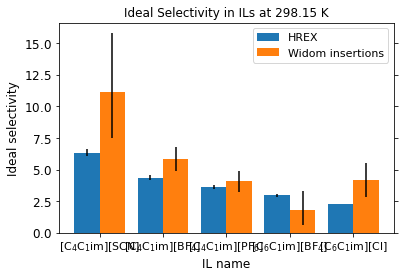

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


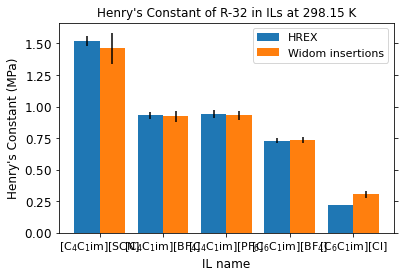

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


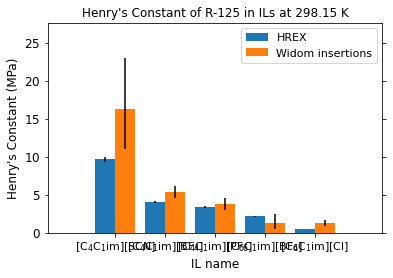

In [89]:
plot_results("adaptive_rmin_1/vbs", "adaptive_rmin_1", get_fbs=True, get_corr=True)

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.004838,-0.000313,0.000702,-0.003707
Temp,0.002626,0.002816,-0.000526,-0.001785
Volume,0.020435,0.156892,0.005571,0.176870
Press,-0.006432,-0.014198,-0.004301,-0.007062
PotEng,0.011868,0.070777,-0.003254,0.074060
KinEng,0.002626,0.002816,-0.000526,-0.001785
TotEng,0.010689,0.055368,-0.002804,0.054851
E_pair,0.013666,0.107754,0.003786,0.111653
E_vdwl,0.006656,0.099567,0.004022,0.109623
E_coul,0.013929,0.045016,0.001081,0.039898


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.001043,-0.001043,-0.005432,-0.005432
Temp,0.001041,0.001041,-0.003965,-0.003965
Volume,0.144062,0.144062,0.163464,0.163464
Press,-0.014720,-0.014720,-0.007419,-0.007419
PotEng,0.064943,0.064943,0.068323,0.068323
KinEng,0.001041,0.001041,-0.003965,-0.003965
TotEng,0.050213,0.050213,0.049694,0.049694
E_pair,0.098832,0.098832,0.102590,0.102590
E_vdwl,0.091341,0.091341,0.101340,0.101340
E_coul,0.040993,0.040993,0.034040,0.034040


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.000715,-0.000715,-0.003617,-0.003617
Temp,0.000694,0.000694,-0.002647,-0.002647
Volume,0.096440,0.096440,0.109549,0.109549
Press,-0.009812,-0.009812,-0.004943,-0.004943
PotEng,0.043319,0.043319,0.045542,0.045542
KinEng,0.000694,0.000694,-0.002647,-0.002647
TotEng,0.033498,0.033498,0.033129,0.033129
E_pair,0.066010,0.066010,0.068515,0.068515
E_vdwl,0.060954,0.060954,0.067681,0.067681
E_coul,0.027372,0.027372,0.022701,0.022701


R-32 w column correlation (first 5 columns):
 [[1.00000000e+00 9.07930643e-03 8.41741860e-03 3.29614579e-03
  7.21887344e-01]
 [9.07930643e-03 1.00000000e+00 1.40378266e-02 9.80340187e-02
  3.42201917e-04]
 [8.41741860e-03 1.40378266e-02 1.00000000e+00 1.69022611e-03
  3.81436948e-03]
 [3.29614579e-03 9.80340187e-02 1.69022611e-03 1.00000000e+00
  3.24415414e-03]
 [7.21887344e-01 3.42201917e-04 3.81436948e-03 3.24415414e-03
  1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.4030826  0.40452712 0.39431377 0.40034288]
 [0.4030826  1.         0.40787079 0.40347922 0.39952638]
 [0.40452712 0.40787079 1.         0.40268818 0.39905045]
 [0.39431377 0.40347922 0.40268818 1.         0.39376247]
 [0.40034288 0.39952638 0.39905045 0.39376247 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.40386218 0.40900748 0.40050283 0.404273  ]
 [0.40386218 1.         0.41182703 0.40723365 0.40271663]
 [0.40900748 0.41182703 1.         0.409

10 highest observations are:

[[1.63245240e+09 3.79666328e-04]
 [1.95316588e+09 3.95594698e-04]
 [2.00953935e+09 4.09367663e-04]
 [2.04534902e+09 4.57496386e-04]
 [2.05531222e+09 4.70542502e-04]
 [2.34496095e+09 7.99491641e-04]
 [2.35291402e+09 1.11030709e-03]
 [3.24643488e+09 1.18200014e-03]
 [3.31390983e+09 1.19179518e-03]
 [3.75336532e+09 1.20014555e-03]]
with indices:

[[381  48]
 [328 226]
 [477 469]
 [  6 131]
 [254 194]
 [217 356]
 [444 345]
 [165  64]
 [495 495]
 [493  84]]


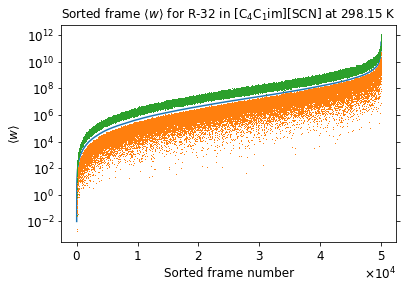

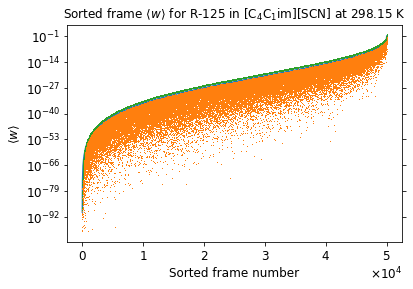

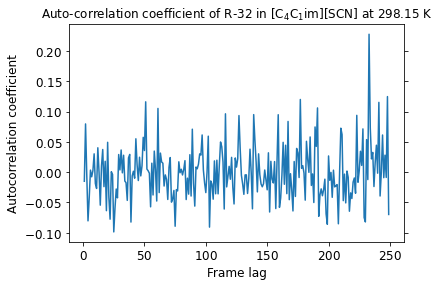

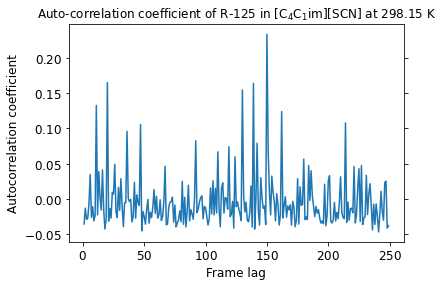

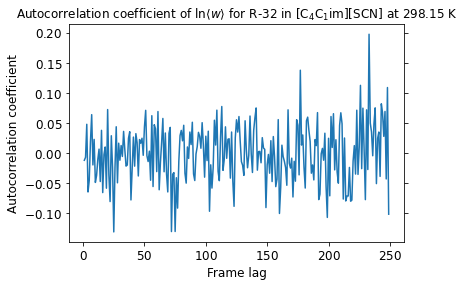

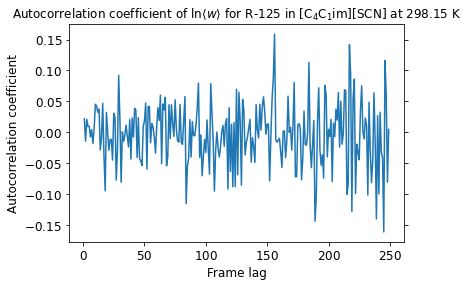

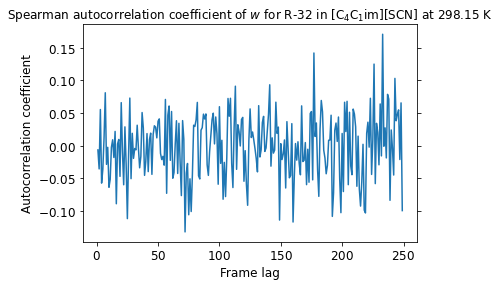

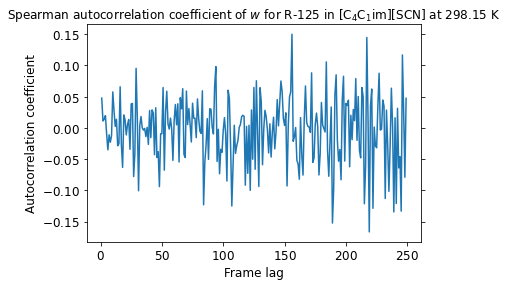

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


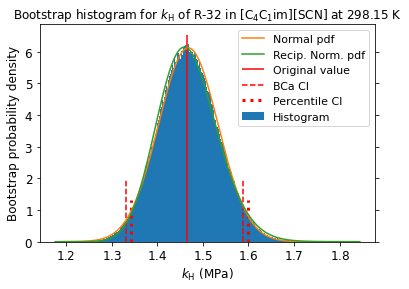

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


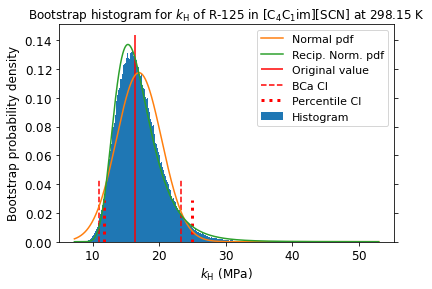

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


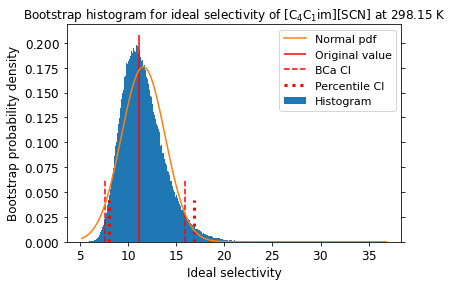

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


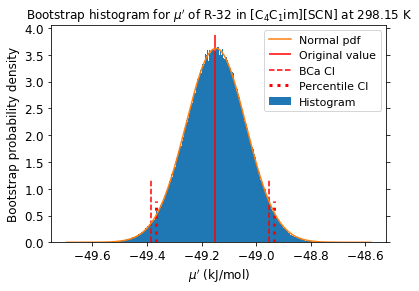

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


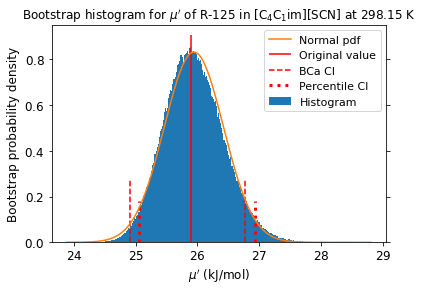

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


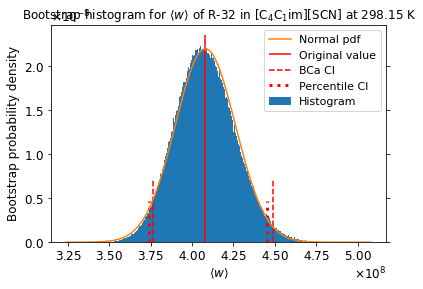

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


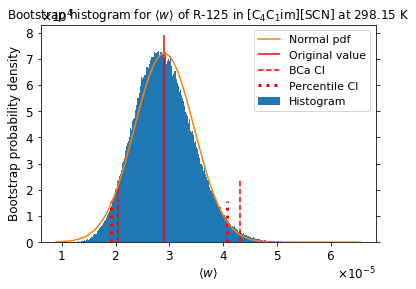

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.003831,0.019248,-0.008196,0.021976
Temp,-0.003847,0.003411,-0.003761,0.001469
Volume,0.032898,0.161028,0.015053,0.184538
Press,0.003566,-0.004462,-0.001812,-0.006973
PotEng,0.019518,0.068687,0.000721,0.075222
KinEng,-0.003847,0.003411,-0.003761,0.001469
TotEng,0.012181,0.053980,-0.001923,0.057630
E_pair,0.025892,0.112828,0.006637,0.117005
E_vdwl,0.023327,0.103301,0.008333,0.114015
E_coul,0.010684,0.051200,0.000436,0.047043


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.017872,0.017872,0.018699,0.018699
Temp,0.004438,0.004438,0.000556,0.000556
Volume,0.150723,0.150723,0.171795,0.171795
Press,-0.004536,-0.004536,-0.006832,-0.006832
PotEng,0.064595,0.064595,0.071442,0.071442
KinEng,0.004438,0.004438,0.000556,0.000556
TotEng,0.050854,0.050854,0.053576,0.053576
E_pair,0.106483,0.106483,0.106355,0.106355
E_vdwl,0.097927,0.097927,0.105390,0.105390
E_coul,0.047009,0.047009,0.042067,0.042067


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.011924,0.011924,0.012458,0.012458
Temp,0.002962,0.002962,0.000365,0.000365
Volume,0.100799,0.100799,0.115049,0.115049
Press,-0.003029,-0.003029,-0.004565,-0.004565
PotEng,0.043040,0.043040,0.047699,0.047699
KinEng,0.002962,0.002962,0.000365,0.000365
TotEng,0.033887,0.033887,0.035736,0.035736
E_pair,0.070997,0.070997,0.071050,0.071050
E_vdwl,0.065426,0.065426,0.070411,0.070411
E_coul,0.031317,0.031317,0.028051,0.028051


R-32 w column correlation (first 5 columns):
 [[1.00000000e+00 4.54997284e-04 1.97771370e-03 6.11668121e-04
  4.02921334e-03]
 [4.54997284e-04 1.00000000e+00 4.06082403e-04 8.48262616e-04
  2.31485687e-03]
 [1.97771370e-03 4.06082403e-04 1.00000000e+00 3.91002862e-03
  8.76333945e-03]
 [6.11668121e-04 8.48262616e-04 3.91002862e-03 1.00000000e+00
  4.60241658e-03]
 [4.02921334e-03 2.31485687e-03 8.76333945e-03 4.60241658e-03
  1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.35685374 0.35215022 0.36205921 0.35639759]
 [0.35685374 1.         0.34841556 0.36316075 0.35472133]
 [0.35215022 0.34841556 1.         0.3582231  0.35394505]
 [0.36205921 0.36316075 0.3582231  1.         0.36332528]
 [0.35639759 0.35472133 0.35394505 0.36332528 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.34825897 0.3433029  0.35193156 0.34991133]
 [0.34825897 1.         0.3415056  0.35167971 0.34634582]
 [0.3433029  0.3415056  1.         0.352

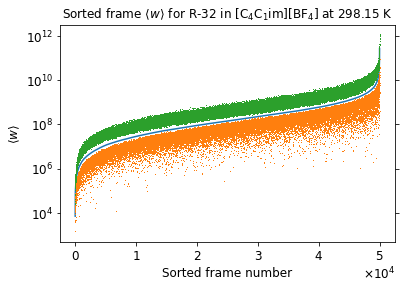

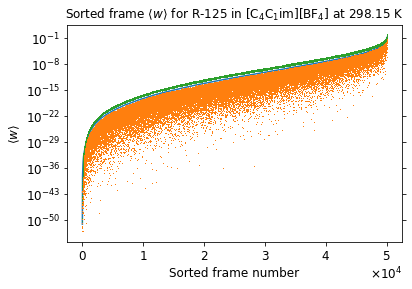

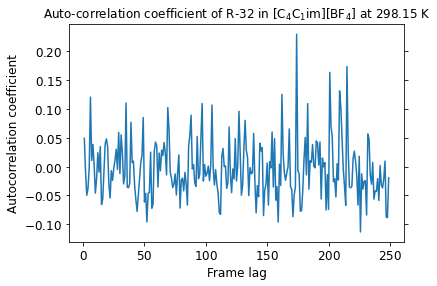

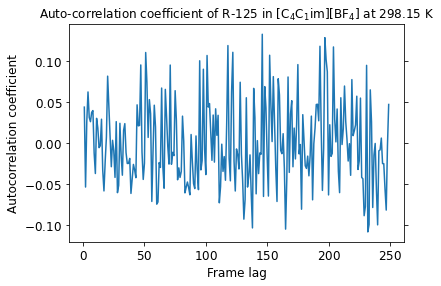

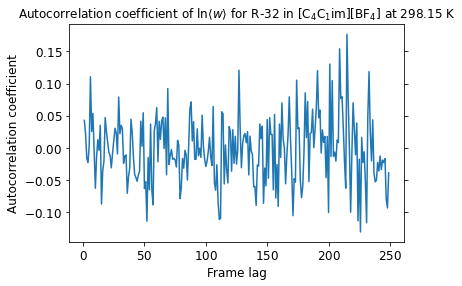

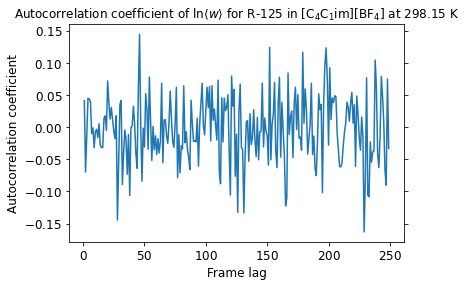

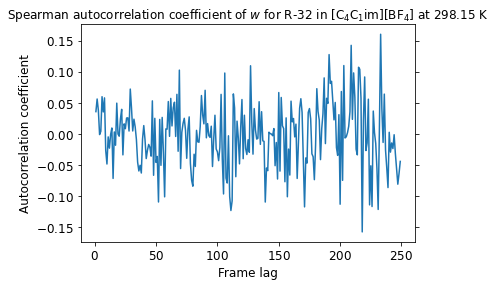

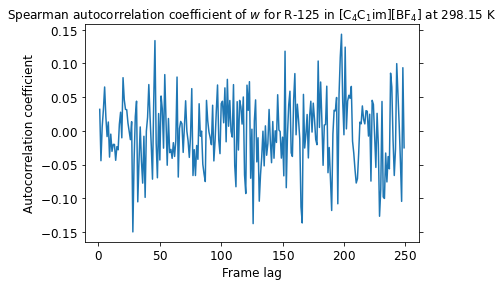

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


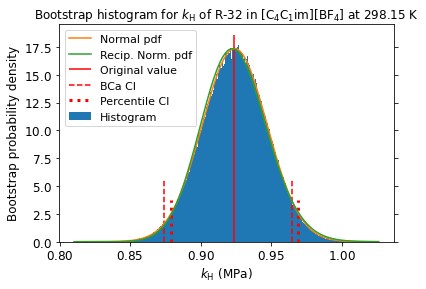

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


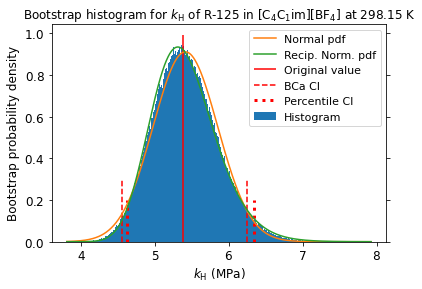

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


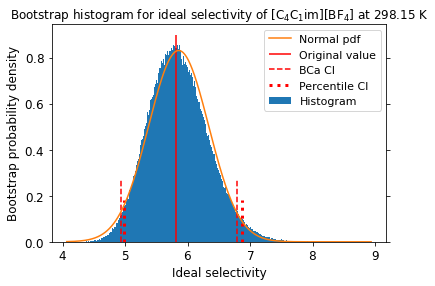

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


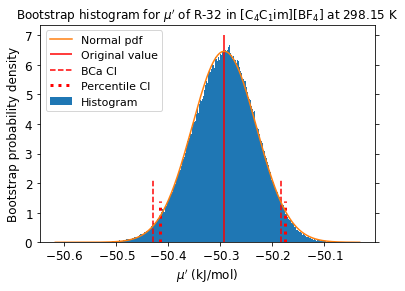

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


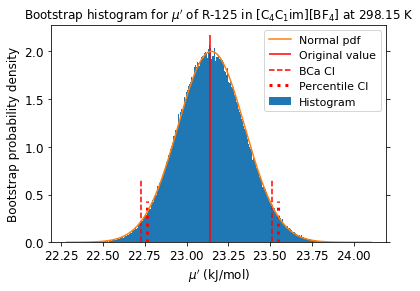

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


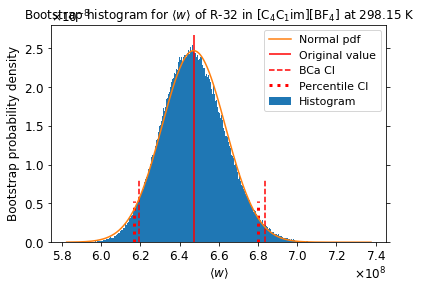

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


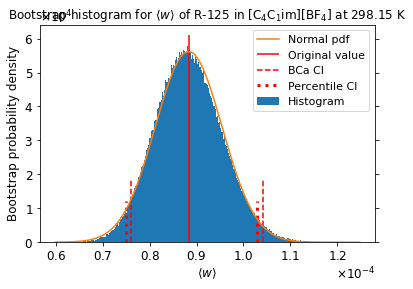

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.001098,0.002117,0.000462,0.008340
Temp,0.003908,0.002266,0.002161,0.001835
Volume,0.022342,0.159916,0.008015,0.177956
Press,0.001145,-0.002722,0.002520,-0.003482
PotEng,0.010890,0.067591,0.004426,0.065223
KinEng,0.003908,0.002266,0.002161,0.001835
TotEng,0.010787,0.052565,0.004759,0.050493
E_pair,0.019621,0.115217,0.003684,0.112454
E_vdwl,0.014426,0.109998,0.000423,0.120187
E_coul,0.012768,0.049693,0.003840,0.033821


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.000919,0.000919,0.008223,0.008223
Temp,0.001683,0.001683,0.002912,0.002912
Volume,0.151884,0.151884,0.163243,0.163243
Press,-0.001279,-0.001279,-0.001507,-0.001507
PotEng,0.063644,0.063644,0.059404,0.059404
KinEng,0.001683,0.001683,0.002912,0.002912
TotEng,0.048789,0.048789,0.046922,0.046922
E_pair,0.107555,0.107555,0.102346,0.102346
E_vdwl,0.102405,0.102405,0.109562,0.109562
E_coul,0.046311,0.046311,0.028477,0.028477


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.000640,0.000640,0.005548,0.005548
Temp,0.001129,0.001129,0.001946,0.001946
Volume,0.101674,0.101674,0.109264,0.109264
Press,-0.000859,-0.000859,-0.001019,-0.001019
PotEng,0.042483,0.042483,0.039608,0.039608
KinEng,0.001129,0.001129,0.001946,0.001946
TotEng,0.032580,0.032580,0.031370,0.031370
E_pair,0.071906,0.071906,0.068304,0.068304
E_vdwl,0.068431,0.068431,0.073158,0.073158
E_coul,0.030939,0.030939,0.018990,0.018990


R-32 w column correlation (first 5 columns):
 [[1.00000000e+00 7.44470042e-04 9.56278143e-03 2.26769913e-01
  6.88018696e-03]
 [7.44470042e-04 1.00000000e+00 3.51172387e-03 1.52009798e-02
  9.27935928e-03]
 [9.56278143e-03 3.51172387e-03 1.00000000e+00 3.51060708e-03
  1.01790677e-02]
 [2.26769913e-01 1.52009798e-02 3.51060708e-03 1.00000000e+00
  3.09415580e-02]
 [6.88018696e-03 9.27935928e-03 1.01790677e-02 3.09415580e-02
  1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.34001771 0.33594825 0.33647298 0.33288035]
 [0.34001771 1.         0.33496918 0.34169104 0.3346576 ]
 [0.33594825 0.33496918 1.         0.33856024 0.33881875]
 [0.33647298 0.34169104 0.33856024 1.         0.33097789]
 [0.33288035 0.3346576  0.33881875 0.33097789 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.33167178 0.32520865 0.32589936 0.32640677]
 [0.33167178 1.         0.32819886 0.33092603 0.32732883]
 [0.32520865 0.32819886 1.         0.326

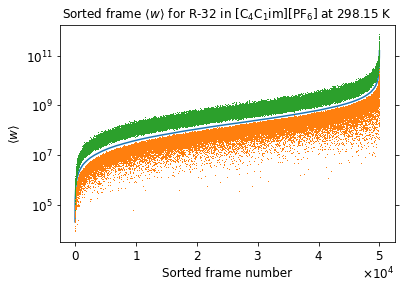

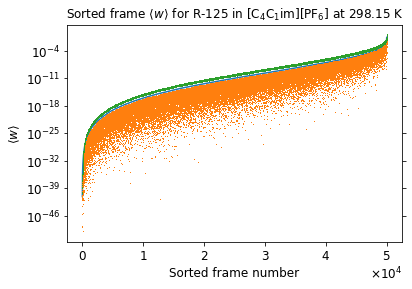

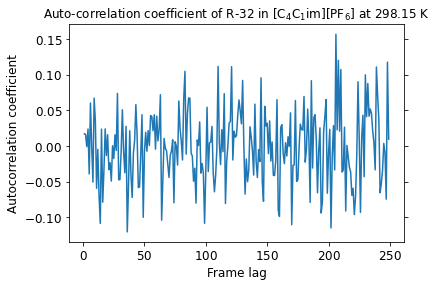

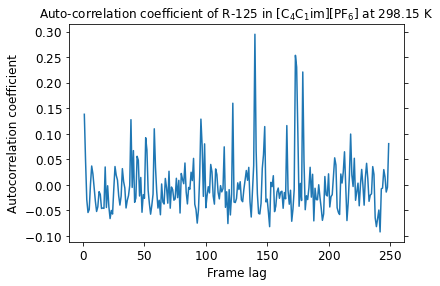

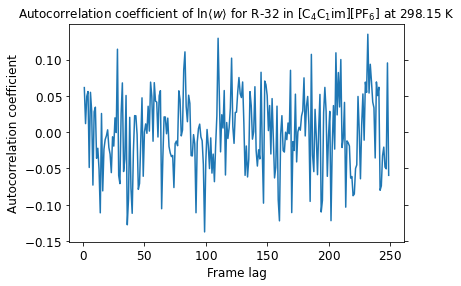

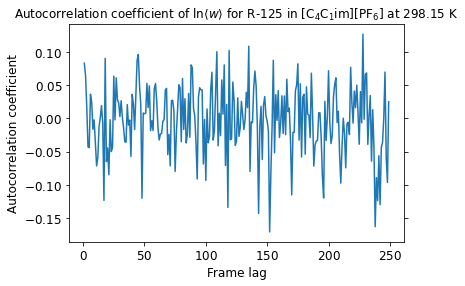

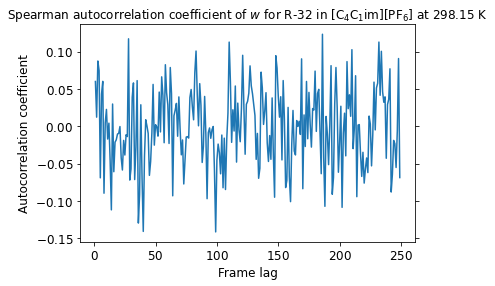

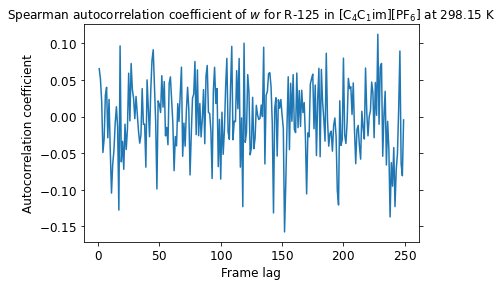

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


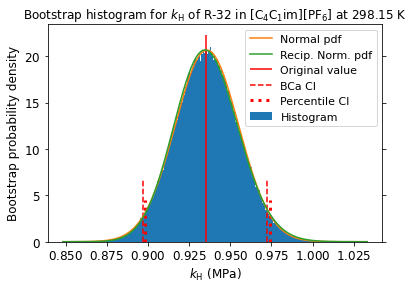

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


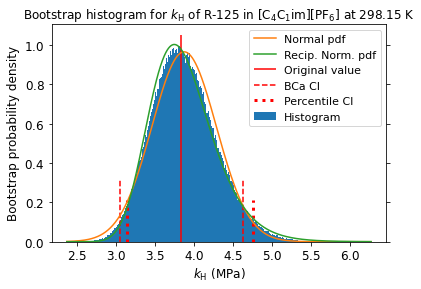

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


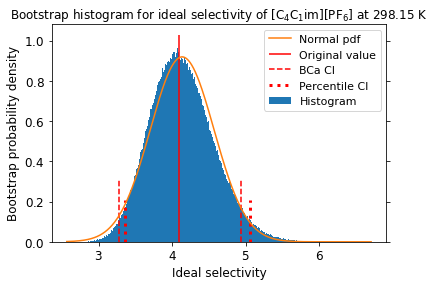

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


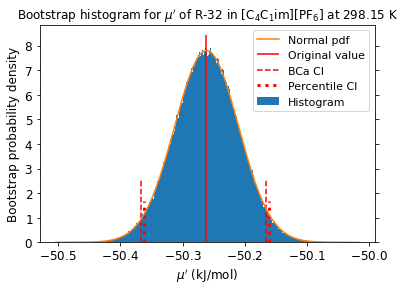

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


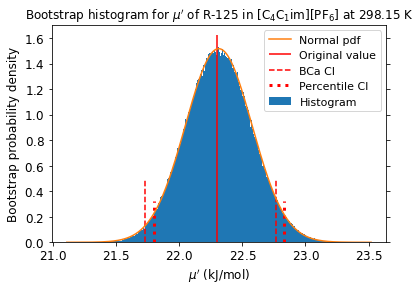

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


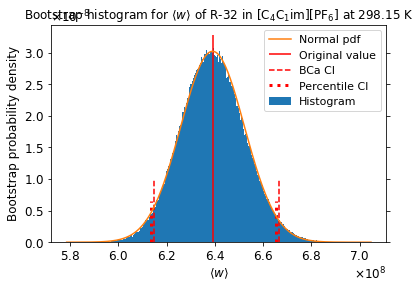

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


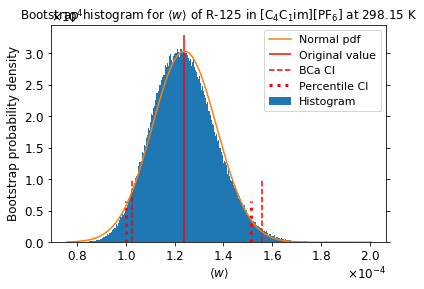

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.001730,0.002395,-0.001822,0.018002
Temp,-0.001264,-0.006630,0.003248,0.000603
Volume,0.037697,0.160781,-0.005567,0.177888
Press,-0.004116,0.004713,0.003603,0.001690
PotEng,0.018463,0.060525,0.004076,0.060012
KinEng,-0.001264,-0.006630,0.003248,0.000603
TotEng,0.013116,0.041369,0.005205,0.045718
E_pair,0.031239,0.115252,-0.003973,0.106738
E_vdwl,0.023845,0.101391,-0.004582,0.106743
E_coul,0.017980,0.054061,-0.001550,0.036045


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.003223,0.003223,0.017760,0.017760
Temp,-0.004529,-0.004529,0.005662,0.005662
Volume,0.150117,0.150117,0.162571,0.162571
Press,0.006217,0.006217,0.003392,0.003392
PotEng,0.054959,0.054959,0.054371,0.054371
KinEng,-0.004529,-0.004529,0.005662,0.005662
TotEng,0.037928,0.037928,0.044860,0.044860
E_pair,0.108868,0.108868,0.096515,0.096515
E_vdwl,0.095482,0.095482,0.096691,0.096691
E_coul,0.052532,0.052532,0.034072,0.034072


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.002131,0.002131,0.011840,0.011840
Temp,-0.003025,-0.003025,0.003770,0.003770
Volume,0.100413,0.100413,0.108907,0.108907
Press,0.004142,0.004142,0.002261,0.002261
PotEng,0.036640,0.036640,0.036241,0.036241
KinEng,-0.003025,-0.003025,0.003770,0.003770
TotEng,0.025260,0.025260,0.029901,0.029901
E_pair,0.072744,0.072744,0.064565,0.064565
E_vdwl,0.063730,0.063730,0.064698,0.064698
E_coul,0.035037,0.035037,0.022739,0.022739


R-32 w column correlation (first 5 columns):
 [[1.         0.01252469 0.0043     0.00553564 0.00416771]
 [0.01252469 1.         0.02451115 0.00762742 0.00367742]
 [0.0043     0.02451115 1.         0.01477745 0.01820313]
 [0.00553564 0.00762742 0.01477745 1.         0.00158652]
 [0.00416771 0.00367742 0.01820313 0.00158652 1.        ]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.31826375 0.32661933 0.33318952 0.32150915]
 [0.31826375 1.         0.32067737 0.32674354 0.31782237]
 [0.32661933 0.32067737 1.         0.33362335 0.321492  ]
 [0.33318952 0.32674354 0.33362335 1.         0.32805344]
 [0.32150915 0.31782237 0.321492   0.32805344 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.30757983 0.31161289 0.31529479 0.3049331 ]
 [0.30757983 1.         0.30544267 0.31257133 0.30142215]
 [0.31161289 0.30544267 1.         0.31471606 0.30794109]
 [0.31529479 0.31257133 0.31471606 1.         0.30999642]
 [0.3049331  0.30142215 0.30794109

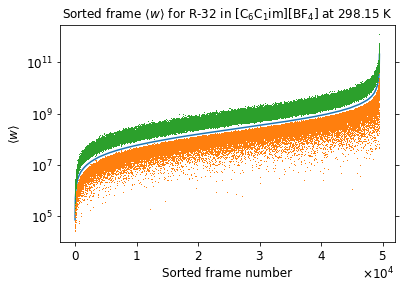

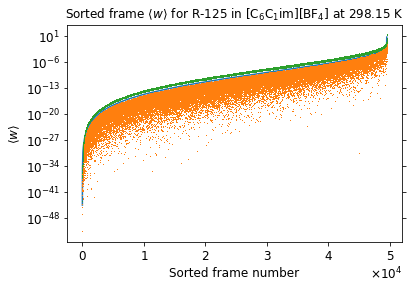

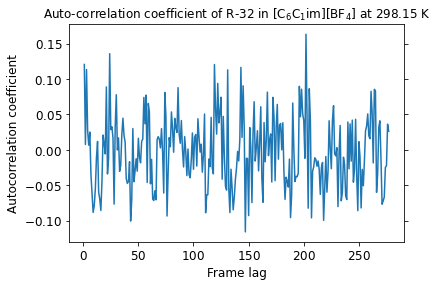

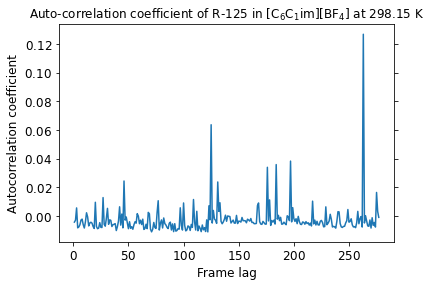

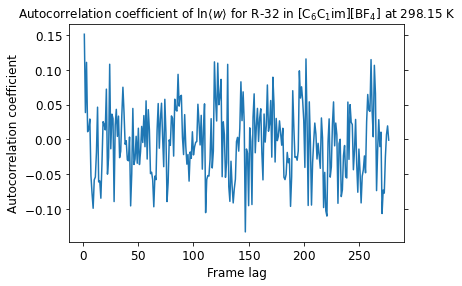

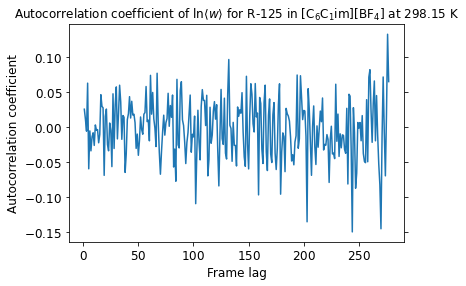

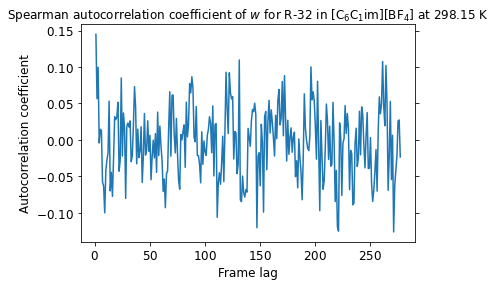

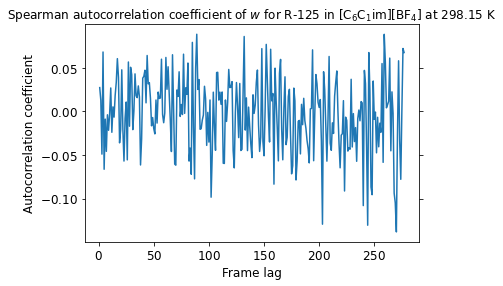

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


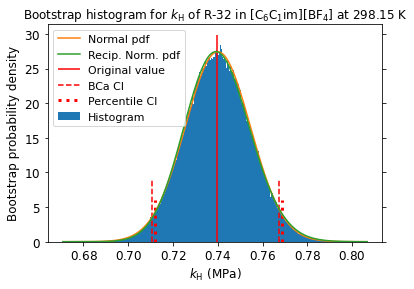

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


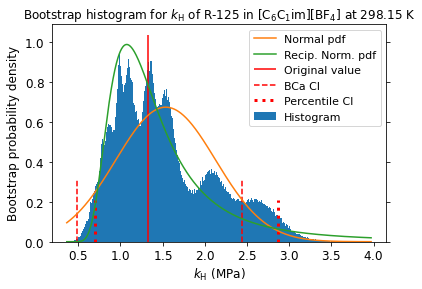

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


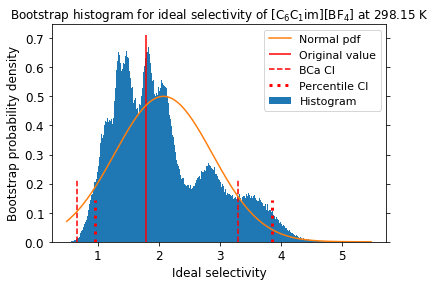

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


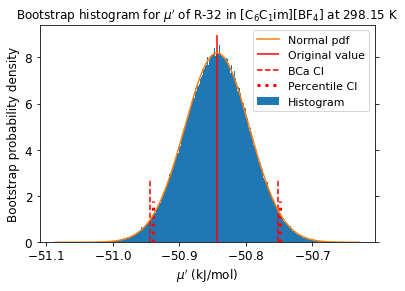

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


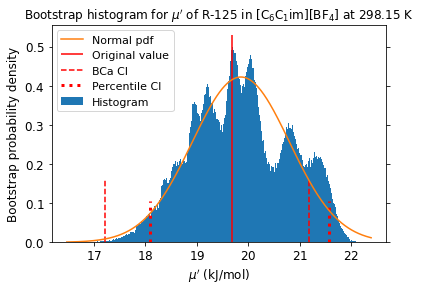

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


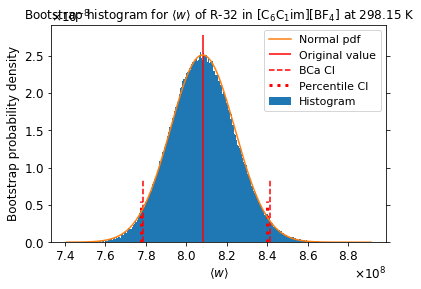

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


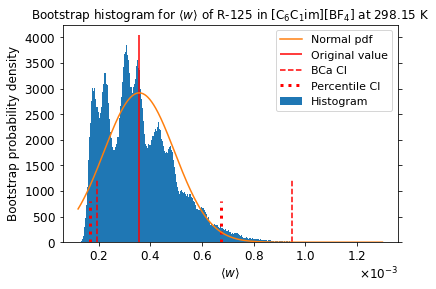

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.011533,-0.040341,-0.000633,-0.023731
Temp,0.004051,-0.000450,-0.003450,-0.006595
Volume,0.021401,0.148628,0.002756,0.180333
Press,-0.001623,-0.006412,0.000278,-0.011804
PotEng,0.011732,0.058215,0.000087,0.068069
KinEng,0.004051,-0.000450,-0.003450,-0.006595
TotEng,0.011570,0.044205,-0.002150,0.047788
E_pair,0.020167,0.100297,0.000615,0.103977
E_vdwl,0.016477,0.083529,-0.001379,0.089706
E_coul,0.006843,0.039928,0.003323,0.039171


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.041249,-0.041249,-0.022070,-0.022070
Temp,0.002182,0.002182,-0.005021,-0.005021
Volume,0.140012,0.140012,0.167942,0.167942
Press,-0.004795,-0.004795,-0.010446,-0.010446
PotEng,0.055298,0.055298,0.064429,0.064429
KinEng,0.002182,0.002182,-0.005021,-0.005021
TotEng,0.042124,0.042124,0.044925,0.044925
E_pair,0.094484,0.094484,0.095674,0.095674
E_vdwl,0.077300,0.077300,0.083859,0.083859
E_coul,0.037834,0.037834,0.036252,0.036252


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.027374,-0.027374,-0.014827,-0.014827
Temp,0.001447,0.001447,-0.003348,-0.003348
Volume,0.093684,0.093684,0.112470,0.112470
Press,-0.003196,-0.003196,-0.006953,-0.006953
PotEng,0.036920,0.036920,0.042966,0.042966
KinEng,0.001447,0.001447,-0.003348,-0.003348
TotEng,0.028128,0.028128,0.029962,0.029962
E_pair,0.063147,0.063147,0.063889,0.063889
E_vdwl,0.051599,0.051599,0.055916,0.055916
E_coul,0.025221,0.025221,0.024166,0.024166


R-32 w column correlation (first 5 columns):
 [[1.00000000e+00 3.02617264e-03 1.66251192e-02 2.07999084e-02
  5.38769080e-03]
 [3.02617264e-03 1.00000000e+00 5.02966847e-04 5.90569953e-03
  1.98569089e-02]
 [1.66251192e-02 5.02966847e-04 1.00000000e+00 2.06265259e-03
  2.37771434e-03]
 [2.07999084e-02 5.90569953e-03 2.06265259e-03 1.00000000e+00
  8.90193347e-03]
 [5.38769080e-03 1.98569089e-02 2.37771434e-03 8.90193347e-03
  1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.35335302 0.35355973 0.35080922 0.35444958]
 [0.35335302 1.         0.347148   0.35486906 0.35366884]
 [0.35355973 0.347148   1.         0.35546095 0.35643332]
 [0.35080922 0.35486906 0.35546095 1.         0.35814423]
 [0.35444958 0.35366884 0.35643332 0.35814423 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.34370044 0.34531633 0.34085617 0.34691722]
 [0.34370044 1.         0.33868775 0.3439067  0.34500061]
 [0.34531633 0.33868775 1.         0.342

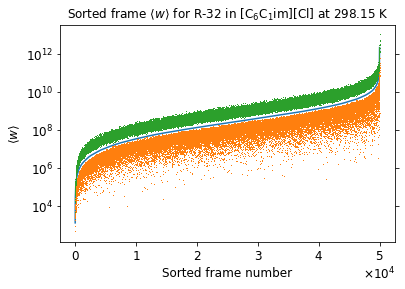

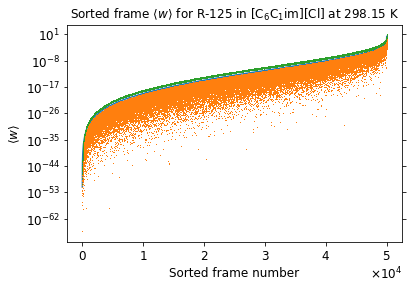

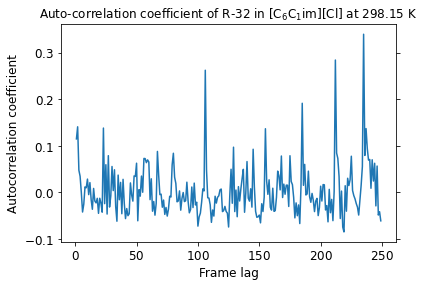

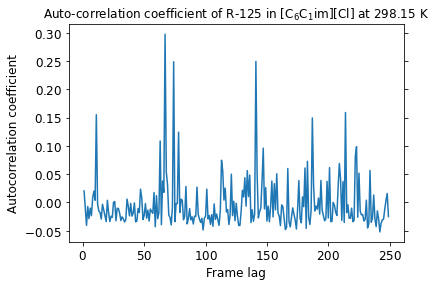

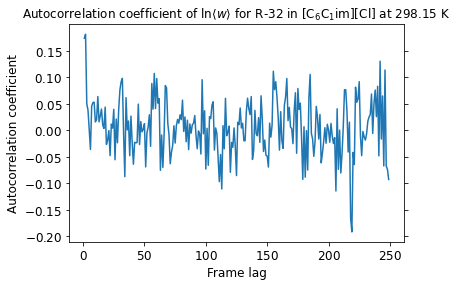

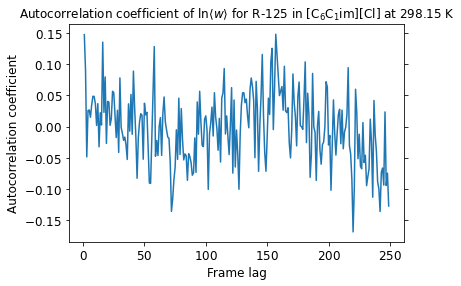

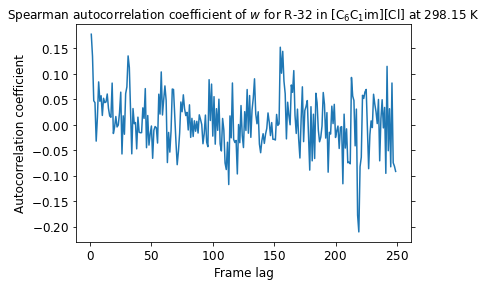

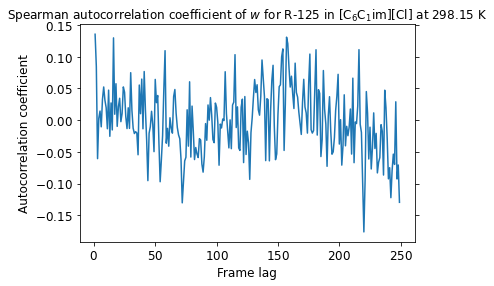

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


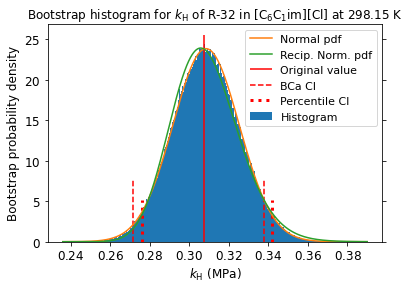

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


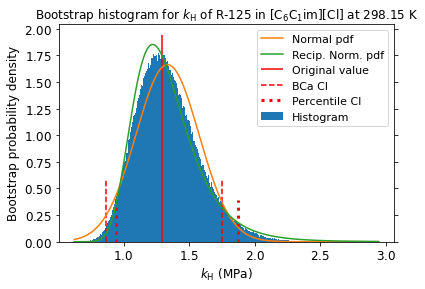

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


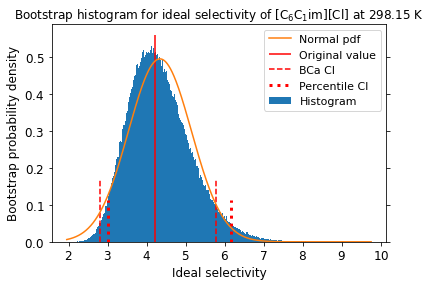

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


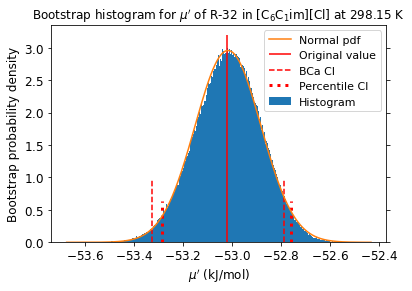

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


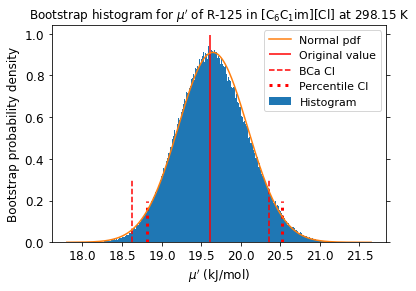

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


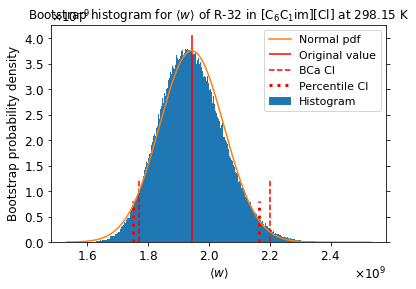

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


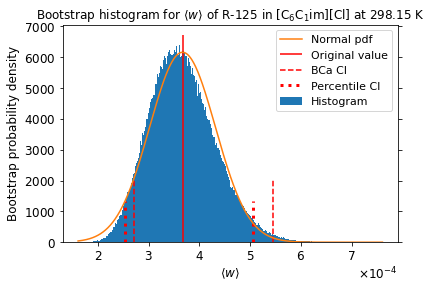

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


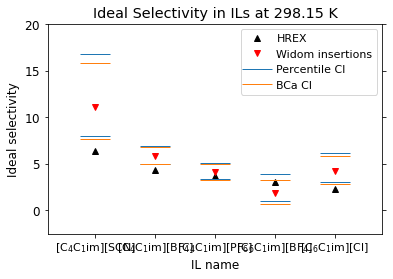

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


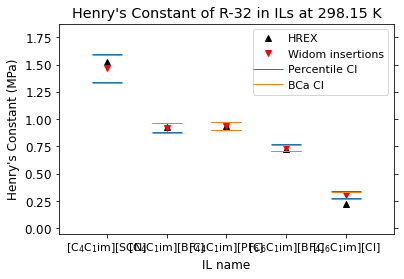

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


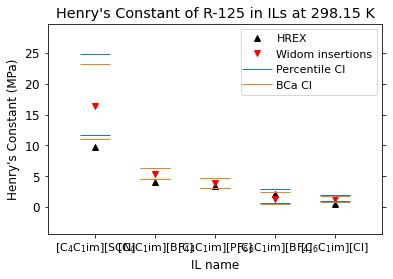

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


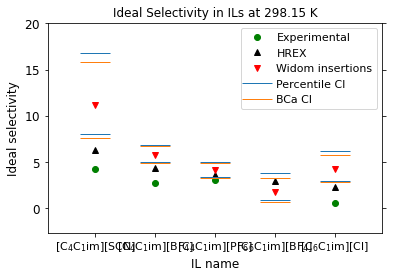

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


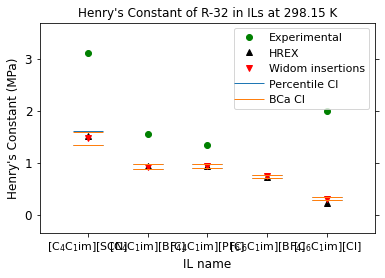

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


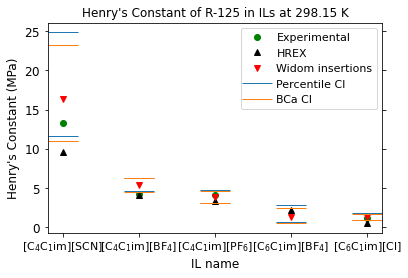

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


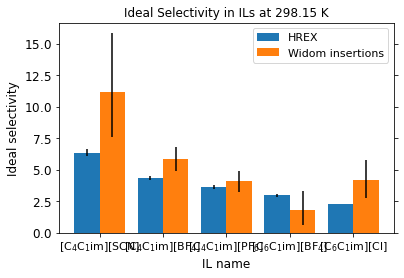

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


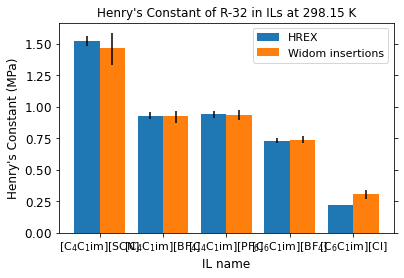

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


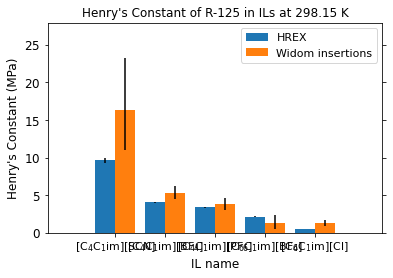

In [90]:
plot_results("adaptive_rmin_1/vbs_blocksize100_89", "adaptive_rmin_1", get_fbs=True, get_corr=True, blocksize=(100,100,100,89,100))

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.006358,0.000022,-0.007127,-0.004251
Temp,0.006377,0.004028,0.000393,0.000505
Volume,0.018107,0.154296,0.003952,0.173543
Press,-0.005077,-0.012063,0.003195,-0.010377
PotEng,0.009197,0.067192,-0.003026,0.071095
KinEng,0.006377,0.004028,0.000393,0.000505
TotEng,0.011114,0.053447,-0.002032,0.054102
E_pair,0.010723,0.104031,0.000316,0.107344
E_vdwl,0.005690,0.098005,-0.000376,0.106602
E_coul,0.008258,0.040704,0.000538,0.037204


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.000680,-0.000680,-0.006149,-0.006149
Temp,0.001339,0.001339,-0.000792,-0.000792
Volume,0.143519,0.143519,0.160668,0.160668
Press,-0.013868,-0.013868,-0.009283,-0.009283
PotEng,0.060412,0.060412,0.063631,0.063631
KinEng,0.001339,0.001339,-0.000792,-0.000792
TotEng,0.046661,0.046661,0.047855,0.047855
E_pair,0.095169,0.095169,0.098198,0.098198
E_vdwl,0.087875,0.087875,0.098624,0.098624
E_coul,0.038571,0.038571,0.031996,0.031996


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.000440,-0.000440,-0.004114,-0.004114
Temp,0.000909,0.000909,-0.000527,-0.000527
Volume,0.096090,0.096090,0.107632,0.107632
Press,-0.009244,-0.009244,-0.006187,-0.006187
PotEng,0.040297,0.040297,0.042454,0.042454
KinEng,0.000909,0.000909,-0.000527,-0.000527
TotEng,0.031123,0.031123,0.031920,0.031920
E_pair,0.063533,0.063533,0.065495,0.065495
E_vdwl,0.058670,0.058670,0.065832,0.065832
E_coul,0.025745,0.025745,0.021322,0.021322


R-32 w column correlation (first 5 columns):
 [[1.00000000e+00 2.23729091e-03 1.59073157e-02 1.69811930e-02
  4.18246331e-04]
 [2.23729091e-03 1.00000000e+00 7.15502715e-03 2.78392553e-03
  2.91618096e-03]
 [1.59073157e-02 7.15502715e-03 1.00000000e+00 1.45607733e-02
  1.01753859e-02]
 [1.69811930e-02 2.78392553e-03 1.45607733e-02 1.00000000e+00
  3.03418302e-02]
 [4.18246331e-04 2.91618096e-03 1.01753859e-02 3.03418302e-02
  1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.39303958 0.39854397 0.40033207 0.39702409]
 [0.39303958 1.         0.39693898 0.40182951 0.40379913]
 [0.39854397 0.39693898 1.         0.40119513 0.39483349]
 [0.40033207 0.40182951 0.40119513 1.         0.40303377]
 [0.39702409 0.40379913 0.39483349 0.40303377 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.40019608 0.40317663 0.40477566 0.40334643]
 [0.40019608 1.         0.40158177 0.40530907 0.40922393]
 [0.40317663 0.40158177 1.         0.405

10 highest observations are:

[[9.88022227e+10 3.98197597e-02]
 [1.53262532e+11 4.21895401e-02]
 [1.57302196e+11 4.66132318e-02]
 [1.58380032e+11 5.78367105e-02]
 [1.69090458e+11 7.96896895e-02]
 [1.70395863e+11 9.12513052e-02]
 [2.30340418e+11 9.56553596e-02]
 [2.99168571e+11 1.08843023e-01]
 [3.88015237e+11 2.10338949e-01]
 [4.86740501e+11 2.15671190e-01]]
with indices:

[[42566 19714]
 [32857 28568]
 [46188  8449]
 [28627  6582]
 [46403  7808]
 [26274  6411]
 [49376  9589]
 [26035 49570]
 [46542 22642]
 [22671  3821]]


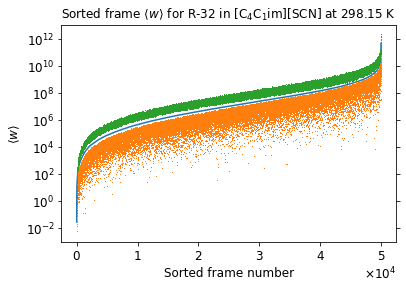

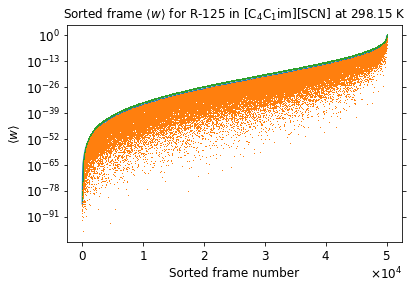

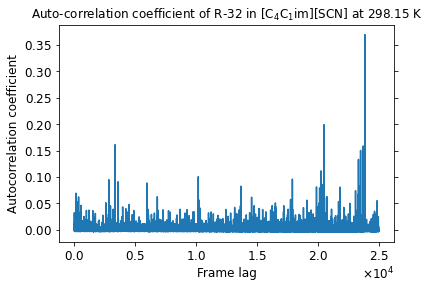

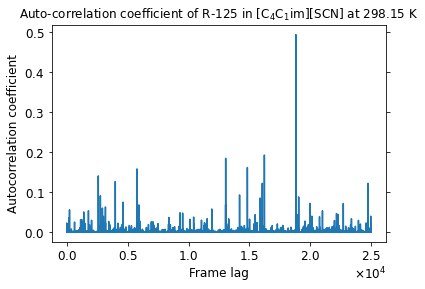

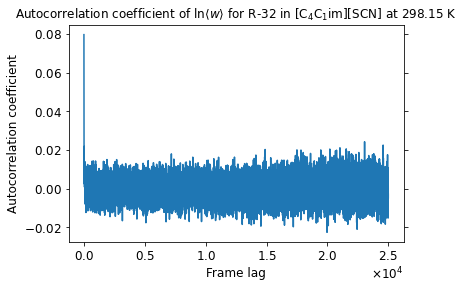

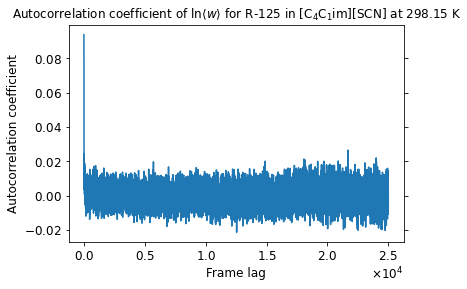

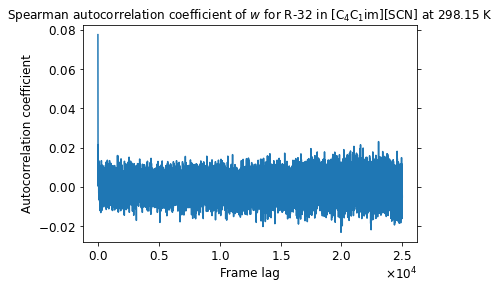

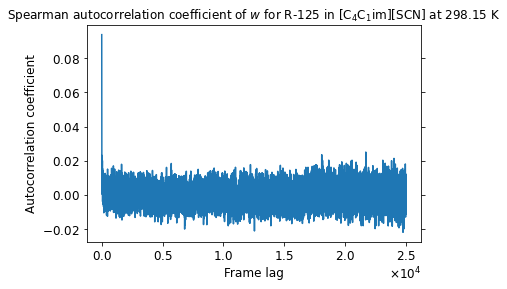

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


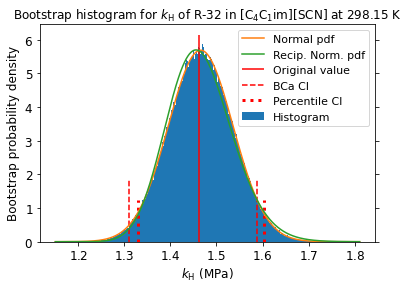

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


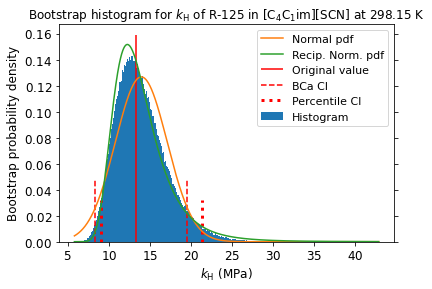

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


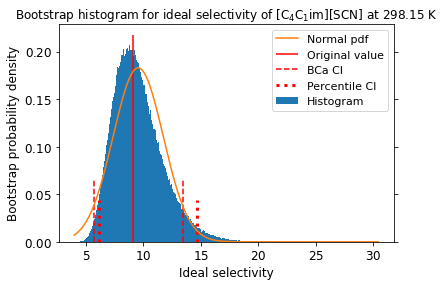

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


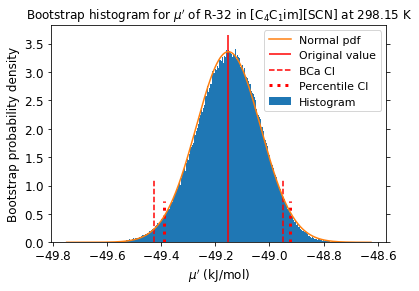

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


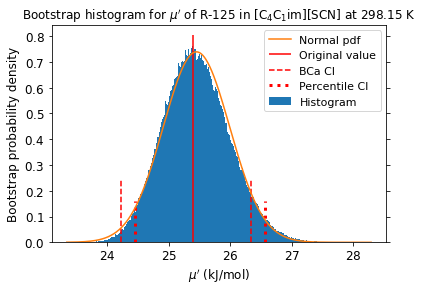

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


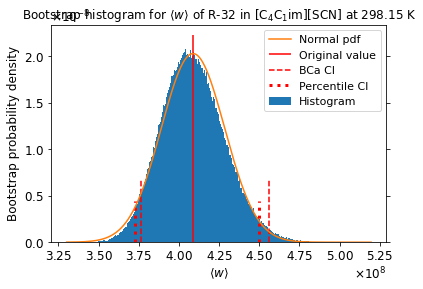

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


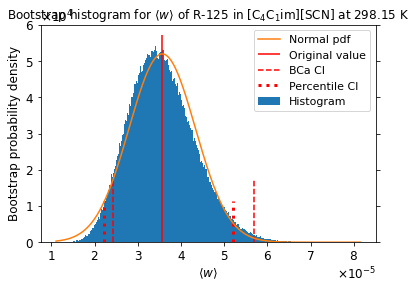

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.003080,0.019021,-0.006499,0.022433
Temp,-0.007240,0.001663,-0.003684,-0.002473
Volume,0.036928,0.161726,0.002720,0.180501
Press,-0.003510,-0.004693,0.001286,-0.008608
PotEng,0.020971,0.068966,0.004039,0.073863
KinEng,-0.007240,0.001662,-0.003684,-0.002473
TotEng,0.011050,0.053044,0.000627,0.054021
E_pair,0.025486,0.112494,0.004012,0.114228
E_vdwl,0.027688,0.105044,0.005200,0.113173
E_coul,0.004313,0.048172,0.000538,0.043563


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.019153,0.019153,0.021217,0.021217
Temp,0.002263,0.002263,-0.002243,-0.002243
Volume,0.152067,0.152067,0.166817,0.166817
Press,-0.005703,-0.005703,-0.007631,-0.007631
PotEng,0.065132,0.065132,0.070182,0.070182
KinEng,0.002263,0.002263,-0.002243,-0.002243
TotEng,0.050452,0.050452,0.050775,0.050775
E_pair,0.106670,0.106670,0.103436,0.103436
E_vdwl,0.097985,0.097985,0.103491,0.103491
E_coul,0.046042,0.046042,0.038581,0.038581


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.012754,0.012754,0.014127,0.014127
Temp,0.001517,0.001517,-0.001502,-0.001502
Volume,0.101639,0.101639,0.111796,0.111796
Press,-0.003807,-0.003807,-0.005085,-0.005085
PotEng,0.043403,0.043403,0.046843,0.046843
KinEng,0.001517,0.001517,-0.001502,-0.001502
TotEng,0.033650,0.033650,0.033868,0.033868
E_pair,0.071064,0.071064,0.069179,0.069179
E_vdwl,0.065446,0.065446,0.069207,0.069207
E_coul,0.030644,0.030644,0.025713,0.025713


R-32 w column correlation (first 5 columns):
 [[1.         0.00844294 0.00986427 0.04192554 0.01492575]
 [0.00844294 1.         0.00152537 0.00433367 0.00323201]
 [0.00986427 0.00152537 1.         0.00228322 0.00560595]
 [0.04192554 0.00433367 0.00228322 1.         0.00335189]
 [0.01492575 0.00323201 0.00560595 0.00335189 1.        ]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.35104267 0.35186526 0.35852816 0.35646682]
 [0.35104267 1.         0.354638   0.36536299 0.35189332]
 [0.35186526 0.354638   1.         0.35179467 0.35357036]
 [0.35852816 0.36536299 0.35179467 1.         0.35996185]
 [0.35646682 0.35189332 0.35357036 0.35996185 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.3414719  0.34238603 0.35072531 0.34484883]
 [0.3414719  1.         0.34284929 0.35489459 0.34233728]
 [0.34238603 0.34284929 1.         0.34121249 0.34607728]
 [0.35072531 0.35489459 0.34121249 1.         0.34902804]
 [0.34484883 0.34233728 0.34607728

10 highest observations are:

[[8.70249051e+10 5.83107944e-02]
 [9.24687796e+10 6.34368848e-02]
 [9.30377127e+10 6.39827389e-02]
 [1.24412868e+11 6.41163748e-02]
 [1.26629323e+11 6.72278367e-02]
 [1.27048551e+11 7.01649799e-02]
 [1.33231168e+11 7.73342781e-02]
 [1.37230269e+11 8.56098093e-02]
 [1.45150080e+11 1.24053798e-01]
 [3.14534350e+11 4.55240393e-01]]
with indices:

[[ 9134 29766]
 [23137 19219]
 [  963  4638]
 [39249 47263]
 [32333 28083]
 [40188 31433]
 [15562  4203]
 [  277 49609]
 [22937 28699]
 [ 7371  2579]]


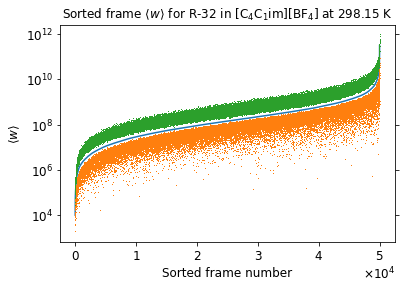

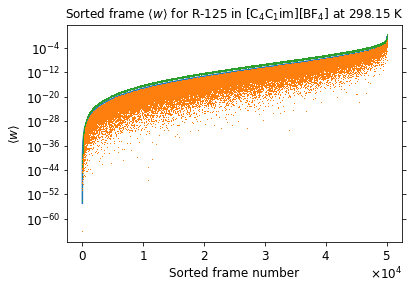

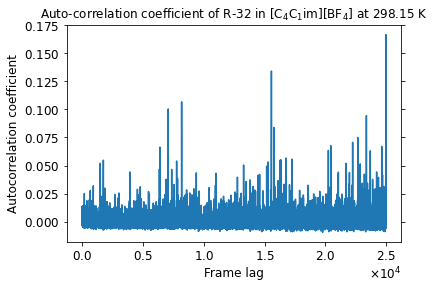

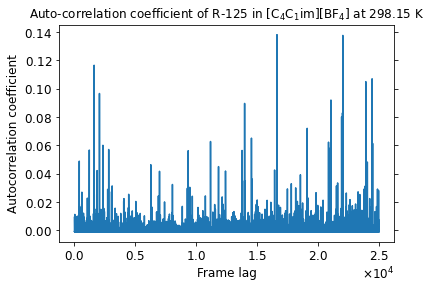

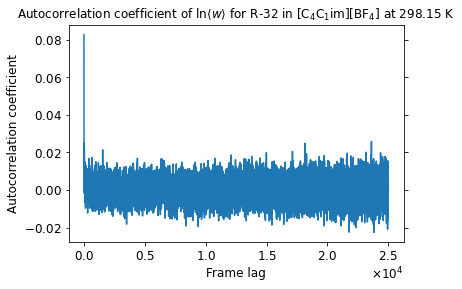

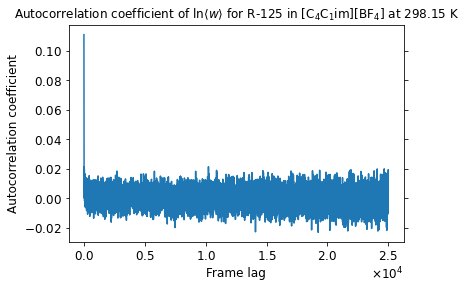

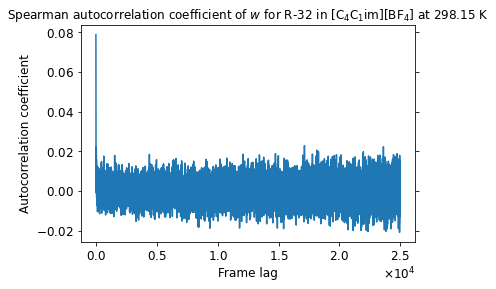

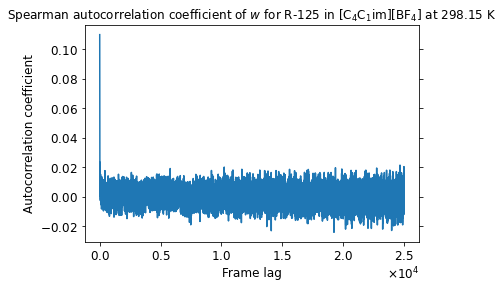

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


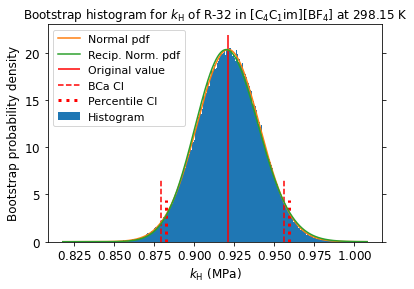

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


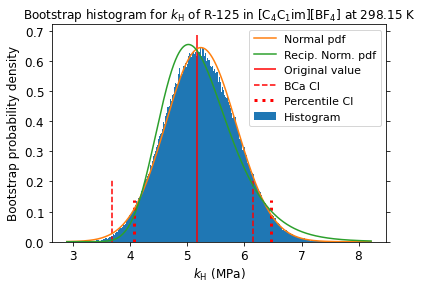

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


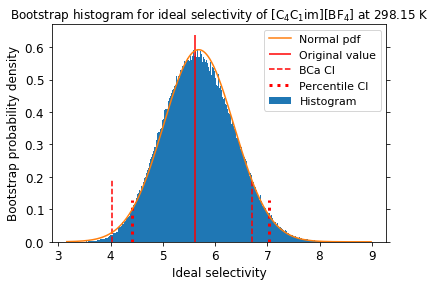

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


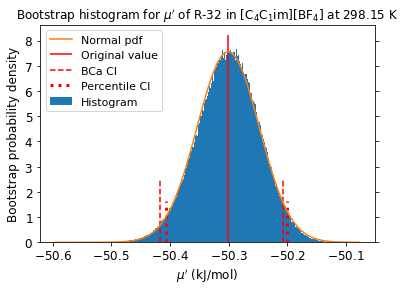

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


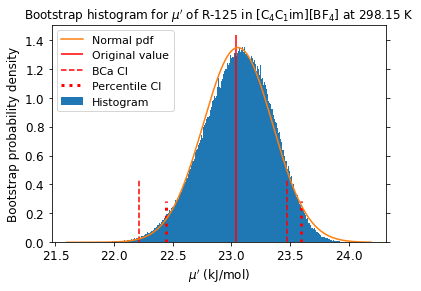

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


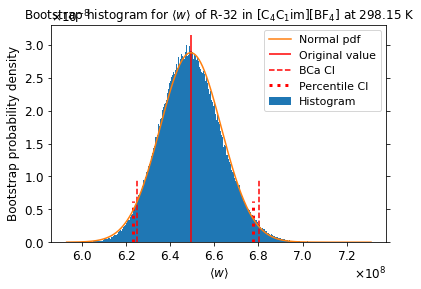

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


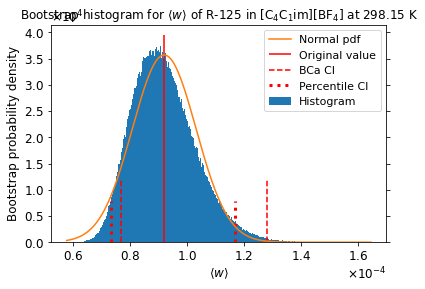

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.002037,0.004947,-0.001527,0.008376
Temp,0.005830,0.008588,-0.001122,0.002916
Volume,0.028535,0.160717,0.021734,0.179438
Press,-0.002328,-0.000703,-0.000371,-0.001510
PotEng,0.010299,0.067600,0.008631,0.067312
KinEng,0.005830,0.008588,-0.001122,0.002916
TotEng,0.011598,0.056708,0.005789,0.052778
E_pair,0.025245,0.115983,0.006403,0.113136
E_vdwl,0.020732,0.110978,0.011329,0.121114
E_coul,0.012640,0.049875,-0.004079,0.033689


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.005394,0.005394,0.009712,0.009712
Temp,0.008105,0.008105,0.003209,0.003209
Volume,0.150910,0.150910,0.165253,0.165253
Press,0.001761,0.001761,-0.000573,-0.000573
PotEng,0.064376,0.064376,0.061847,0.061847
KinEng,0.008105,0.008105,0.003209,0.003209
TotEng,0.053779,0.053779,0.049729,0.049729
E_pair,0.108893,0.108893,0.103446,0.103446
E_vdwl,0.103393,0.103393,0.110673,0.110673
E_coul,0.047664,0.047664,0.030312,0.030312


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.003631,0.003631,0.006525,0.006525
Temp,0.005403,0.005403,0.002133,0.002133
Volume,0.101059,0.101059,0.110701,0.110701
Press,0.001191,0.001191,-0.000376,-0.000376
PotEng,0.042988,0.042988,0.041274,0.041274
KinEng,0.005403,0.005403,0.002133,0.002133
TotEng,0.035936,0.035936,0.033249,0.033249
E_pair,0.072760,0.072760,0.069103,0.069103
E_vdwl,0.069077,0.069077,0.073998,0.073998
E_coul,0.031846,0.031846,0.020227,0.020227


R-32 w column correlation (first 5 columns):
 [[1.00000000e+00 2.66398132e-03 8.66912111e-03 8.07804994e-03
  8.19718673e-04]
 [2.66398132e-03 1.00000000e+00 2.74243735e-03 6.36855994e-03
  3.12361282e-03]
 [8.66912111e-03 2.74243735e-03 1.00000000e+00 2.40659625e-03
  7.10380389e-03]
 [8.07804994e-03 6.36855994e-03 2.40659625e-03 1.00000000e+00
  4.24250297e-03]
 [8.19718673e-04 3.12361282e-03 7.10380389e-03 4.24250297e-03
  1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.33648311 0.33986088 0.34355701 0.33594386]
 [0.33648311 1.         0.3380427  0.3402847  0.33727248]
 [0.33986088 0.3380427  1.         0.33497375 0.34049341]
 [0.34355701 0.3402847  0.33497375 1.         0.34084191]
 [0.33594386 0.33727248 0.34049341 0.34084191 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.32921703 0.33005389 0.32985764 0.32603666]
 [0.32921703 1.         0.32880779 0.33572562 0.32836685]
 [0.33005389 0.32880779 1.         0.326

10 highest observations are:

[[8.80595744e+10 5.13825835e-02]
 [9.14149484e+10 5.45318065e-02]
 [9.66194255e+10 5.65513455e-02]
 [1.01009736e+11 6.50210604e-02]
 [1.04182976e+11 7.09839801e-02]
 [1.08810239e+11 8.64581894e-02]
 [1.16148760e+11 9.76401966e-02]
 [1.45218956e+11 1.02300691e-01]
 [1.66205612e+11 1.47213548e-01]
 [2.38382189e+11 1.51008541e-01]]
with indices:

[[41413  4007]
 [14226 15722]
 [21327 19485]
 [23858  2056]
 [26002 27482]
 [18885 21687]
 [20524 32478]
 [ 1413 25408]
 [36331 13462]
 [38305 31281]]


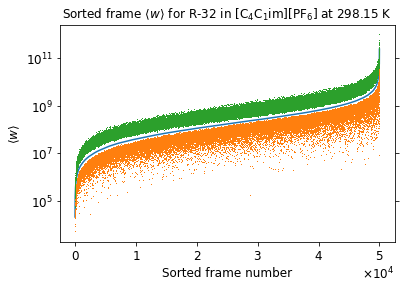

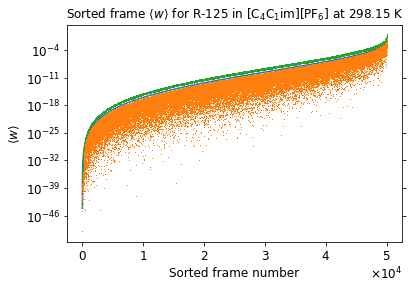

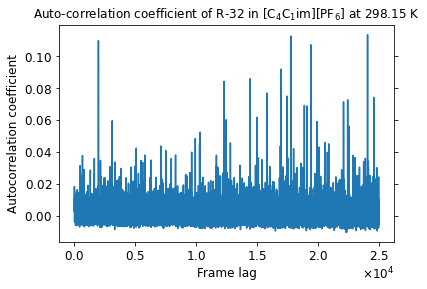

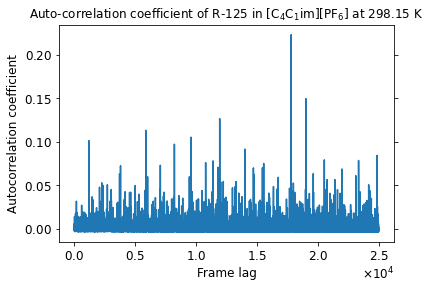

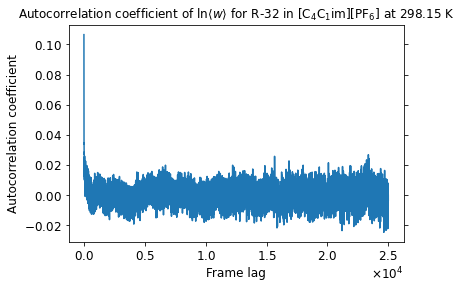

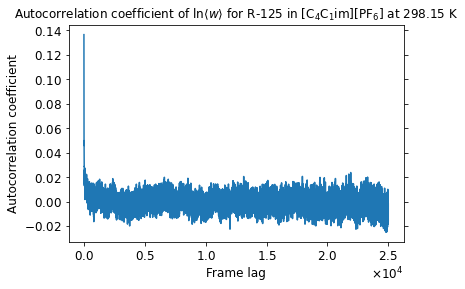

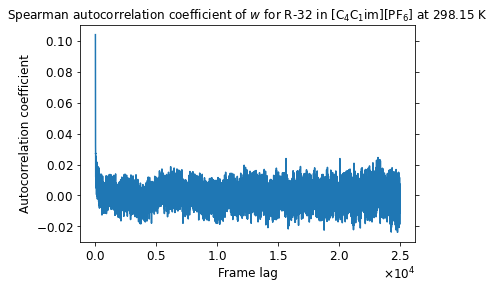

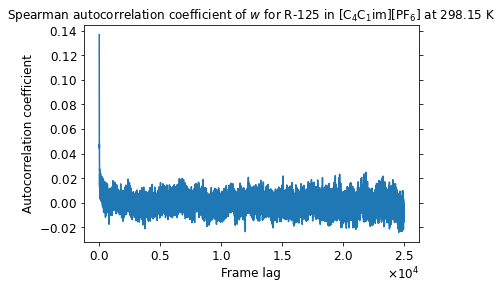

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


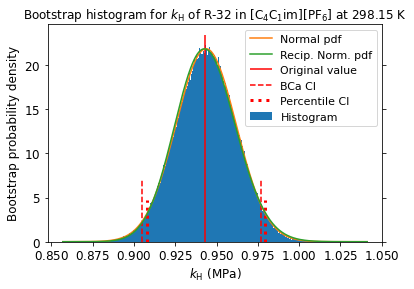

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


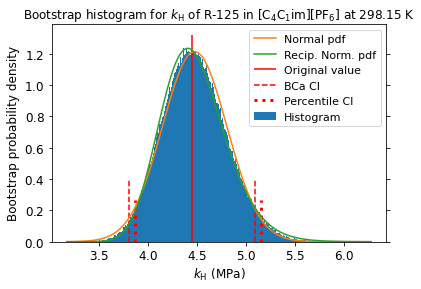

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


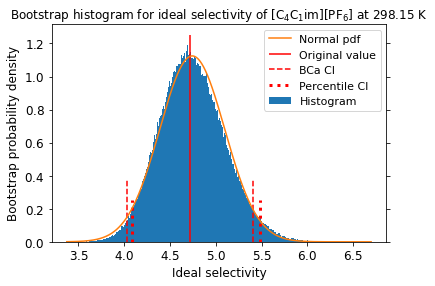

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


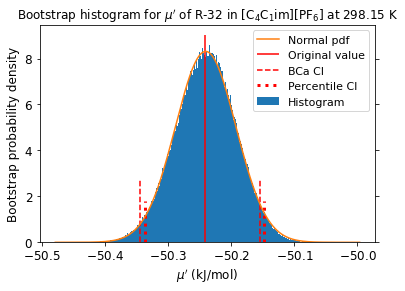

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


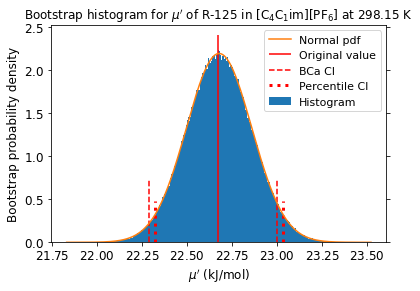

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


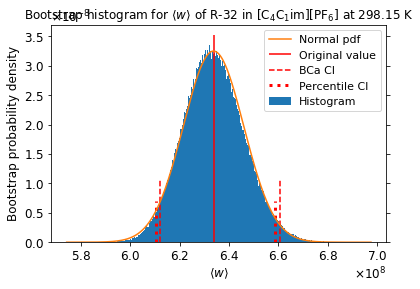

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


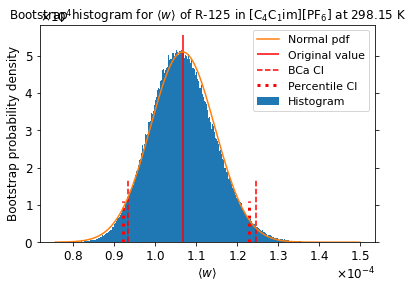

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.000860,0.004771,-0.008477,0.014896
Temp,-0.003282,-0.007365,0.001578,-0.000468
Volume,0.028097,0.159387,0.017384,0.176595
Press,-0.004648,0.001333,0.003868,0.001591
PotEng,0.013172,0.061060,0.004100,0.058387
KinEng,-0.003282,-0.007365,0.001578,-0.000468
TotEng,0.007798,0.041292,0.004129,0.043790
E_pair,0.028290,0.114843,0.009425,0.104075
E_vdwl,0.016651,0.097919,0.010006,0.103266
E_coul,0.022751,0.057663,0.002981,0.036467


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.005306,0.005306,0.014829,0.014829
Temp,-0.005707,-0.005707,0.003649,0.003649
Volume,0.150265,0.150265,0.162246,0.162246
Press,0.003657,0.003657,0.002841,0.002841
PotEng,0.056034,0.056034,0.054925,0.054925
KinEng,-0.005707,-0.005707,0.003649,0.003649
TotEng,0.038901,0.038901,0.043739,0.043739
E_pair,0.109655,0.109655,0.095613,0.095613
E_vdwl,0.094379,0.094379,0.094734,0.094734
E_coul,0.053277,0.053277,0.035099,0.035099


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.003508,0.003508,0.009882,0.009882
Temp,-0.003805,-0.003805,0.002432,0.002432
Volume,0.100579,0.100579,0.108714,0.108714
Press,0.002448,0.002448,0.001889,0.001889
PotEng,0.037370,0.037370,0.036584,0.036584
KinEng,-0.003805,-0.003805,0.002432,0.002432
TotEng,0.025921,0.025921,0.029148,0.029148
E_pair,0.073267,0.073267,0.063901,0.063901
E_vdwl,0.063045,0.063045,0.063386,0.063386
E_coul,0.035520,0.035520,0.023408,0.023408


R-32 w column correlation (first 5 columns):
 [[1.         0.06043235 0.03436774 0.01164063 0.01283363]
 [0.06043235 1.         0.00669824 0.02112949 0.01263622]
 [0.03436774 0.00669824 1.         0.00820634 0.01336026]
 [0.01164063 0.02112949 0.00820634 1.         0.01709713]
 [0.01283363 0.01263622 0.01336026 0.01709713 1.        ]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.32482077 0.32131096 0.32869215 0.31849859]
 [0.32482077 1.         0.32506142 0.3252825  0.32104983]
 [0.32131096 0.32506142 1.         0.33031652 0.31934905]
 [0.32869215 0.3252825  0.33031652 1.         0.31829329]
 [0.31849859 0.32104983 0.31934905 0.31829329 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.3078711  0.30937869 0.3123766  0.30844337]
 [0.3078711  1.         0.30873774 0.31144847 0.30957765]
 [0.30937869 0.30873774 1.         0.31788178 0.30675063]
 [0.3123766  0.31144847 0.31788178 1.         0.30456431]
 [0.30844337 0.30957765 0.30675063

10 highest observations are:

[[1.18949460e+11 8.79531073e-02]
 [1.19659200e+11 1.12943768e-01]
 [1.35598563e+11 1.12997806e-01]
 [1.44687355e+11 1.18156852e-01]
 [1.70207266e+11 1.52218817e-01]
 [1.92654662e+11 1.52646948e-01]
 [2.22985044e+11 1.59070575e-01]
 [2.32322030e+11 2.33566636e-01]
 [2.51751858e+11 2.38684778e-01]
 [2.79518212e+11 5.54086108e-01]]
with indices:

[[46621  7280]
 [47450 16155]
 [   77 34330]
 [26788 28467]
 [ 9182 10164]
 [48297 38676]
 [ 7677  1179]
 [ 4986  9140]
 [24708 43790]
 [28517  1965]]


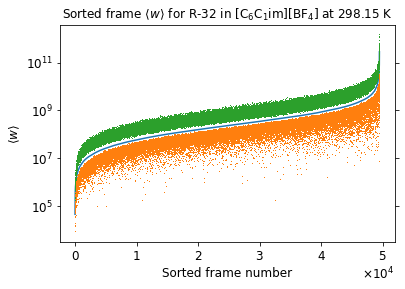

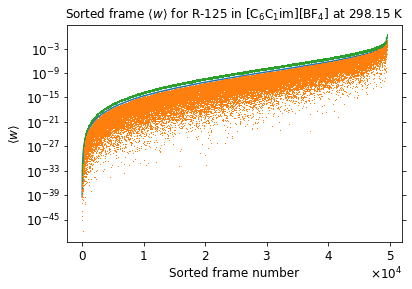

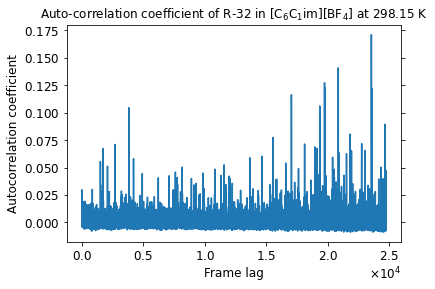

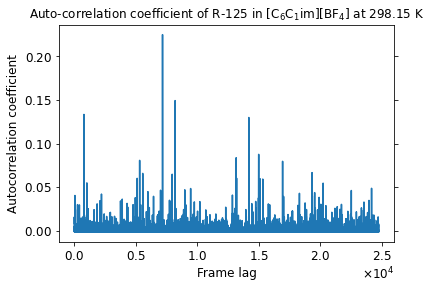

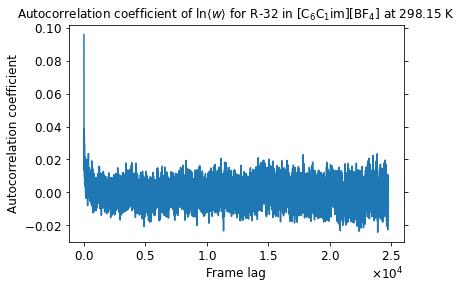

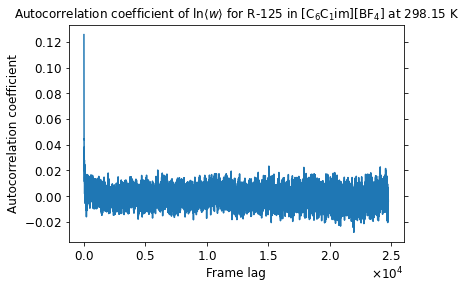

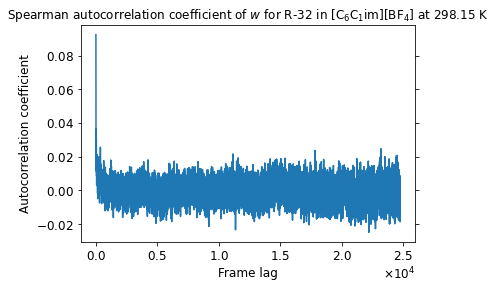

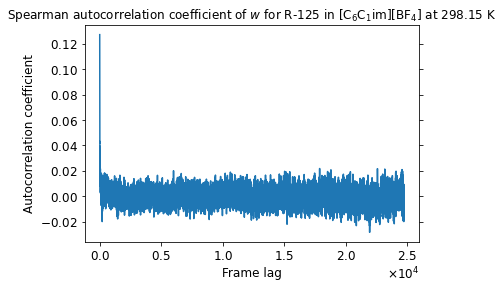

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


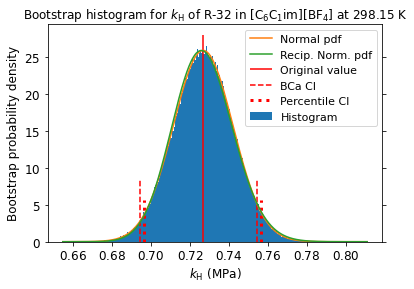

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


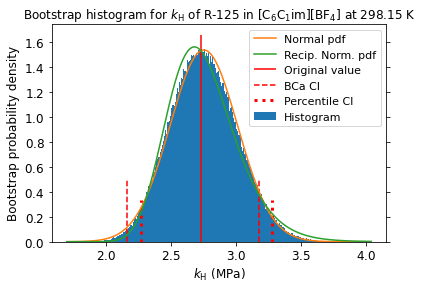

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


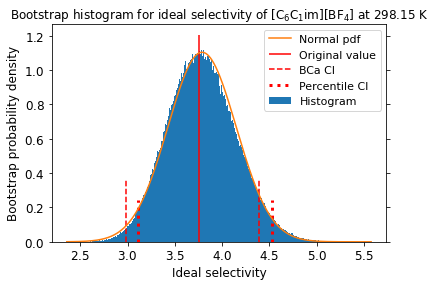

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


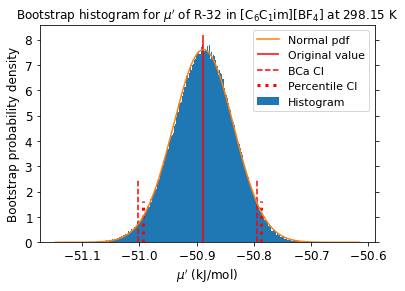

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


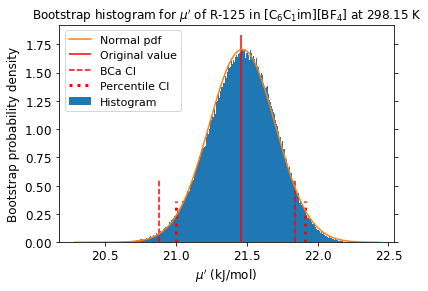

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


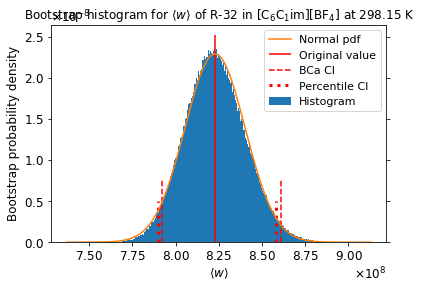

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


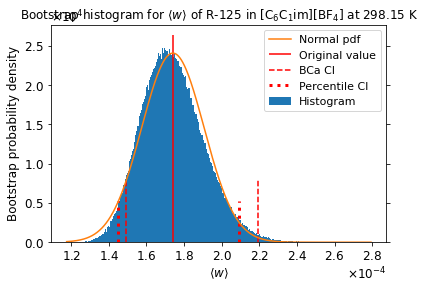

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.008061,-0.041218,-0.005323,-0.023393
Temp,0.004997,-0.003320,-0.003618,-0.003830
Volume,0.002645,0.149877,0.002475,0.181983
Press,0.007616,-0.001031,0.006708,-0.012312
PotEng,0.002867,0.060446,0.000584,0.065834
KinEng,0.004997,-0.003320,-0.003618,-0.003830
TotEng,0.005401,0.044066,-0.001878,0.047856
E_pair,0.006482,0.100010,0.002653,0.106401
E_vdwl,0.004240,0.082922,0.002634,0.094492
E_coul,0.002207,0.040661,0.001281,0.037220


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.042714,-0.042714,-0.022455,-0.022455
Temp,0.000175,0.000175,-0.001597,-0.001597
Volume,0.141113,0.141113,0.168683,0.168683
Press,0.000817,0.000817,-0.010688,-0.010688
PotEng,0.056900,0.056900,0.061916,0.061916
KinEng,0.000175,0.000175,-0.001597,-0.001597
TotEng,0.042200,0.042200,0.045099,0.045099
E_pair,0.095020,0.095020,0.097349,0.097349
E_vdwl,0.078166,0.078166,0.088565,0.088565
E_coul,0.037336,0.037336,0.033832,0.033832


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.028341,-0.028341,-0.015021,-0.015021
Temp,0.000117,0.000117,-0.001068,-0.001068
Volume,0.094517,0.094517,0.112941,0.112941
Press,0.000554,0.000554,-0.007102,-0.007102
PotEng,0.038020,0.038020,0.041293,0.041293
KinEng,0.000117,0.000117,-0.001068,-0.001068
TotEng,0.028174,0.028174,0.030091,0.030091
E_pair,0.063421,0.063421,0.065027,0.065027
E_vdwl,0.052170,0.052170,0.059095,0.059095
E_coul,0.024878,0.024878,0.022578,0.022578


R-32 w column correlation (first 5 columns):
 [[1.00000000e+00 5.05038905e-04 2.44129732e-03 4.38277114e-04
  2.38216353e-03]
 [5.05038905e-04 1.00000000e+00 1.42858874e-03 3.46009966e-03
  2.79048859e-03]
 [2.44129732e-03 1.42858874e-03 1.00000000e+00 3.37195198e-03
  2.27543141e-02]
 [4.38277114e-04 3.46009966e-03 3.37195198e-03 1.00000000e+00
  4.05128256e-03]
 [2.38216353e-03 2.79048859e-03 2.27543141e-02 4.05128256e-03
  1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.35798502 0.35164651 0.35631771 0.35493755]
 [0.35798502 1.         0.3518497  0.34818418 0.35551497]
 [0.35164651 0.3518497  1.         0.34957911 0.35510731]
 [0.35631771 0.34818418 0.34957911 1.         0.34639628]
 [0.35493755 0.35551497 0.35510731 0.34639628 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.3468738  0.34386298 0.34779543 0.34422902]
 [0.3468738  1.         0.34344781 0.33930024 0.34687603]
 [0.34386298 0.34344781 1.         0.345

10 highest observations are:

[[4.82171462e+11 3.60708969e-01]
 [4.91701808e+11 3.93216053e-01]
 [5.04354014e+11 4.28306705e-01]
 [5.58045164e+11 4.38655574e-01]
 [5.96912620e+11 6.24662331e-01]
 [6.16464560e+11 7.32547688e-01]
 [6.32214138e+11 8.81108551e-01]
 [9.31192990e+11 1.14930436e+00]
 [9.63115716e+11 1.21167328e+00]
 [8.48040414e+12 3.62013781e+00]]
with indices:

[[34081  8543]
 [ 3729 41180]
 [14086  4563]
 [12861 30275]
 [34062 11695]
 [18585  4004]
 [39955 11672]
 [15540 31553]
 [34044  8784]
 [ 7061 18307]]


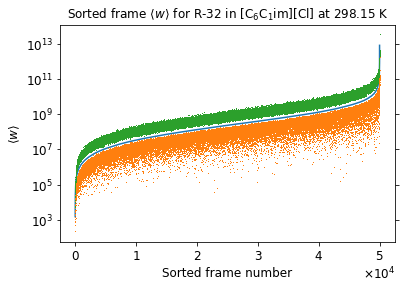

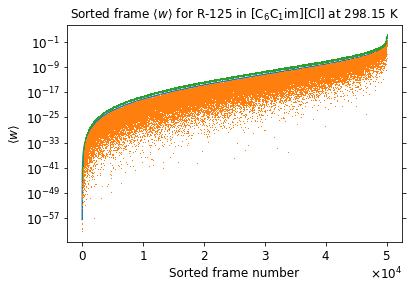

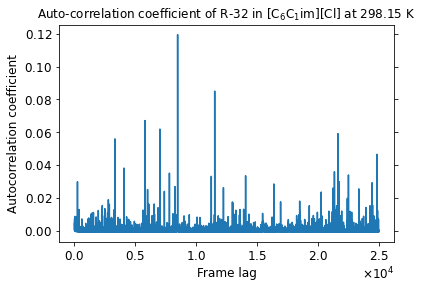

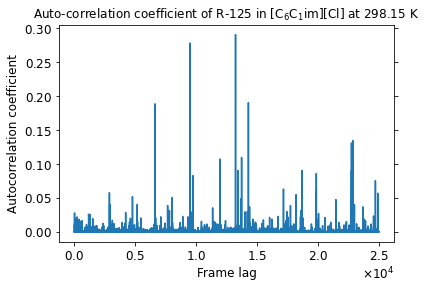

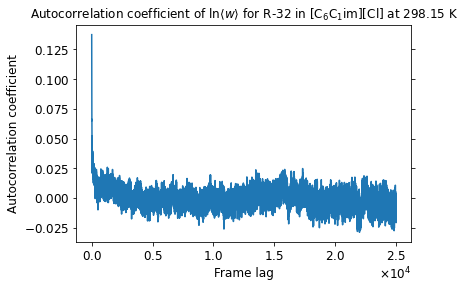

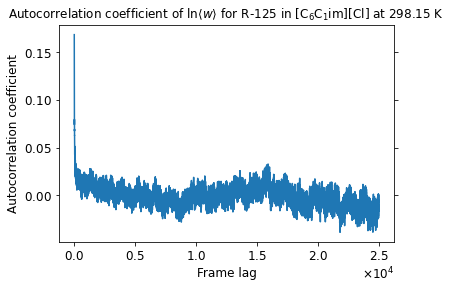

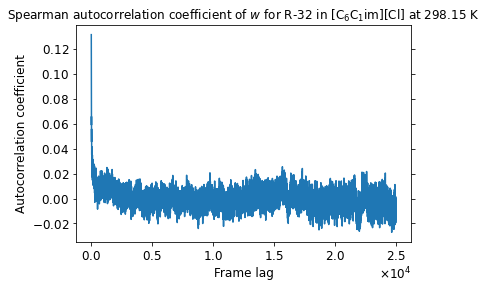

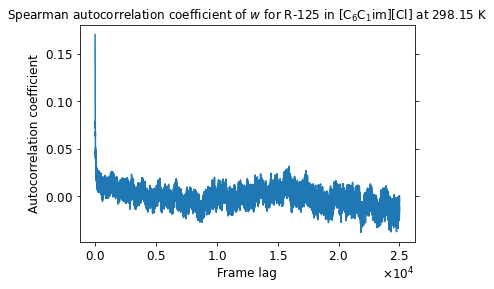

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


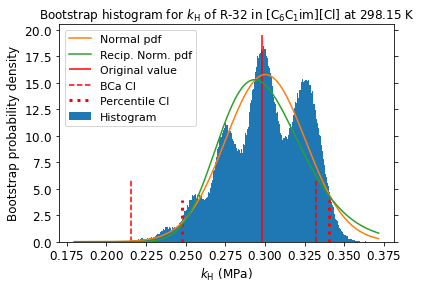

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


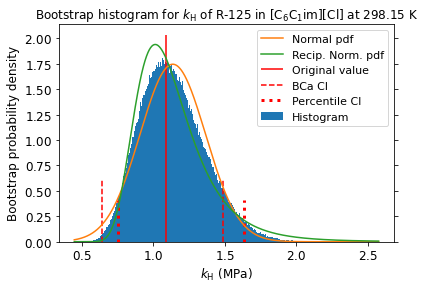

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


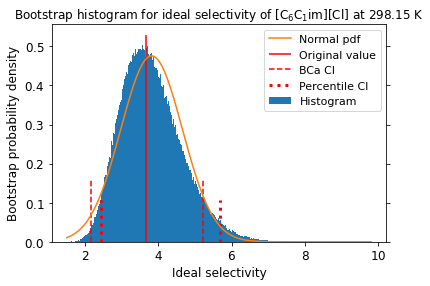

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


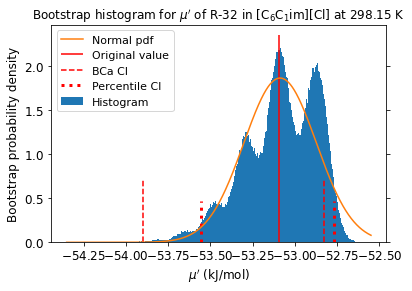

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


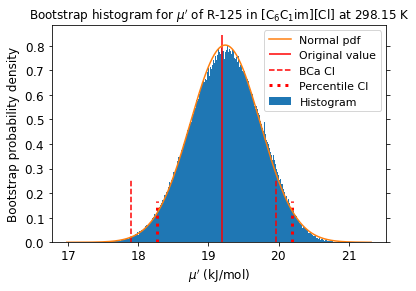

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


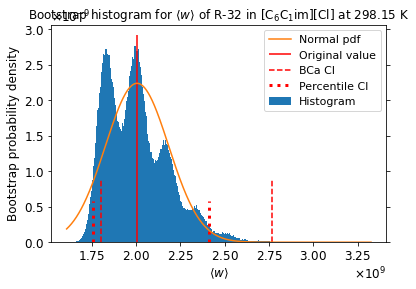

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


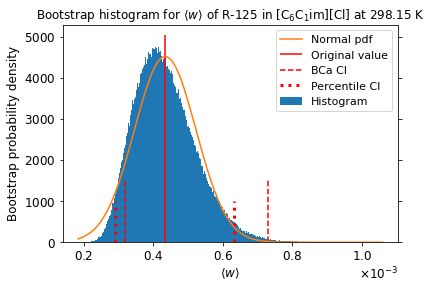

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


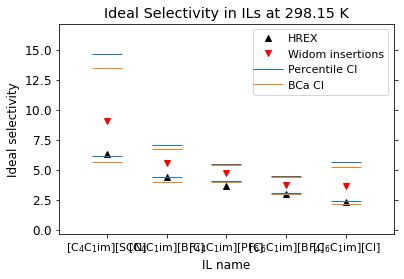

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


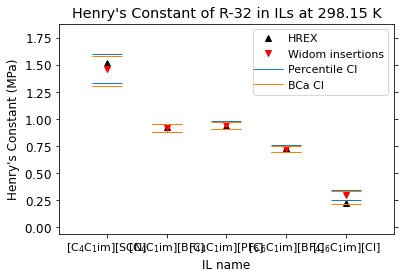

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


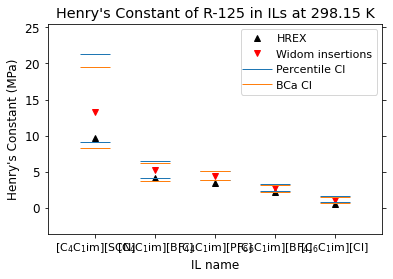

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


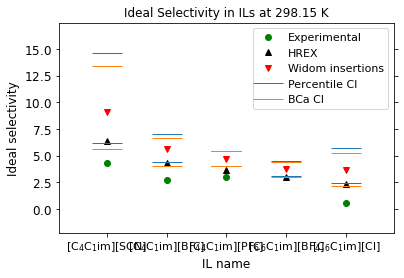

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


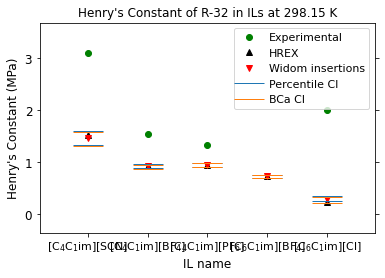

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


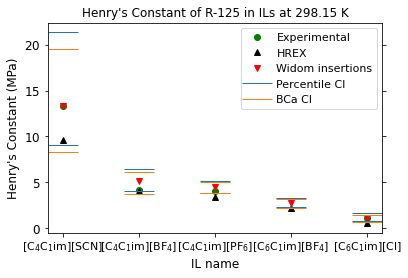

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


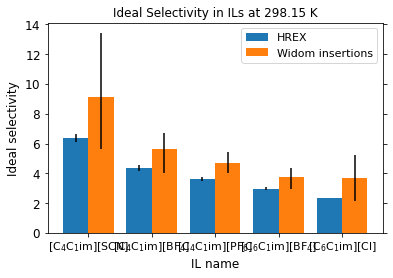

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


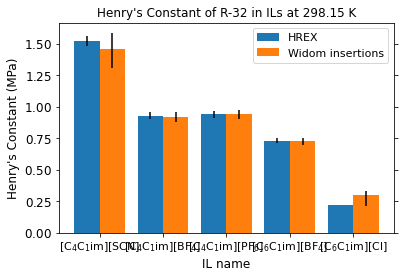

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


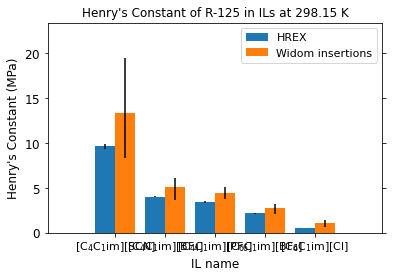

In [91]:
plot_results("adaptive_rmin_2/vbs", "adaptive_rmin_2", get_fbs=True, get_corr=True)

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.006358,0.000022,-0.007127,-0.004251
Temp,0.006377,0.004028,0.000393,0.000505
Volume,0.018107,0.154296,0.003952,0.173543
Press,-0.005077,-0.012063,0.003195,-0.010377
PotEng,0.009197,0.067192,-0.003026,0.071095
KinEng,0.006377,0.004028,0.000393,0.000505
TotEng,0.011114,0.053447,-0.002032,0.054102
E_pair,0.010723,0.104031,0.000316,0.107344
E_vdwl,0.005690,0.098005,-0.000376,0.106602
E_coul,0.008258,0.040704,0.000538,0.037204


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.000680,-0.000680,-0.006149,-0.006149
Temp,0.001339,0.001339,-0.000792,-0.000792
Volume,0.143519,0.143519,0.160668,0.160668
Press,-0.013868,-0.013868,-0.009283,-0.009283
PotEng,0.060412,0.060412,0.063631,0.063631
KinEng,0.001339,0.001339,-0.000792,-0.000792
TotEng,0.046661,0.046661,0.047855,0.047855
E_pair,0.095169,0.095169,0.098198,0.098198
E_vdwl,0.087875,0.087875,0.098624,0.098624
E_coul,0.038571,0.038571,0.031996,0.031996


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.000440,-0.000440,-0.004114,-0.004114
Temp,0.000909,0.000909,-0.000527,-0.000527
Volume,0.096090,0.096090,0.107632,0.107632
Press,-0.009244,-0.009244,-0.006187,-0.006187
PotEng,0.040297,0.040297,0.042454,0.042454
KinEng,0.000909,0.000909,-0.000527,-0.000527
TotEng,0.031123,0.031123,0.031920,0.031920
E_pair,0.063533,0.063533,0.065495,0.065495
E_vdwl,0.058670,0.058670,0.065832,0.065832
E_coul,0.025745,0.025745,0.021322,0.021322


R-32 w column correlation (first 5 columns):
 [[1.00000000e+00 2.23729091e-03 1.59073157e-02 1.69811930e-02
  4.18246331e-04]
 [2.23729091e-03 1.00000000e+00 7.15502715e-03 2.78392553e-03
  2.91618096e-03]
 [1.59073157e-02 7.15502715e-03 1.00000000e+00 1.45607733e-02
  1.01753859e-02]
 [1.69811930e-02 2.78392553e-03 1.45607733e-02 1.00000000e+00
  3.03418302e-02]
 [4.18246331e-04 2.91618096e-03 1.01753859e-02 3.03418302e-02
  1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.39303958 0.39854397 0.40033207 0.39702409]
 [0.39303958 1.         0.39693898 0.40182951 0.40379913]
 [0.39854397 0.39693898 1.         0.40119513 0.39483349]
 [0.40033207 0.40182951 0.40119513 1.         0.40303377]
 [0.39702409 0.40379913 0.39483349 0.40303377 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.40019608 0.40317663 0.40477566 0.40334643]
 [0.40019608 1.         0.40158177 0.40530907 0.40922393]
 [0.40317663 0.40158177 1.         0.405

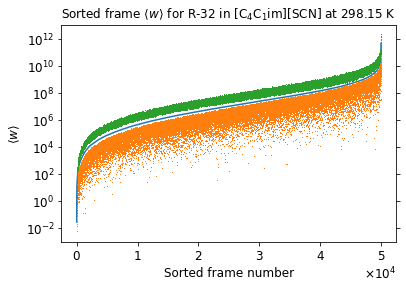

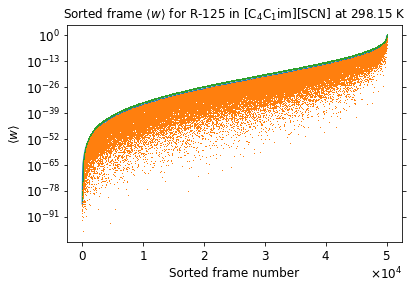

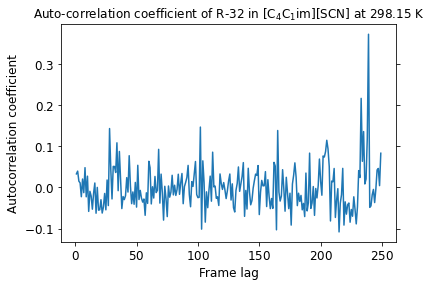

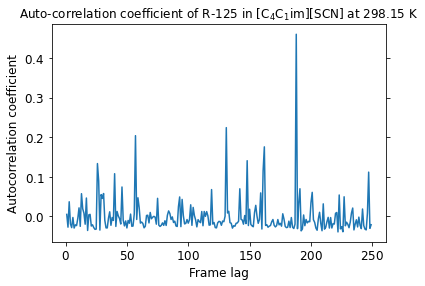

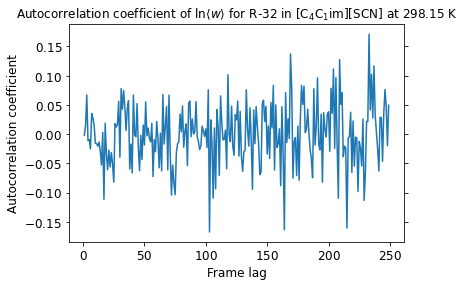

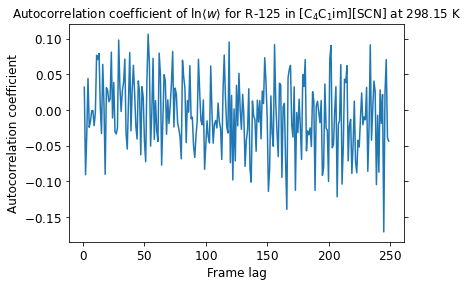

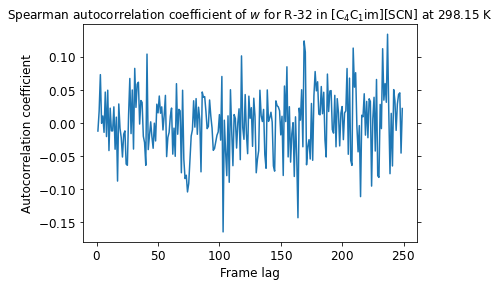

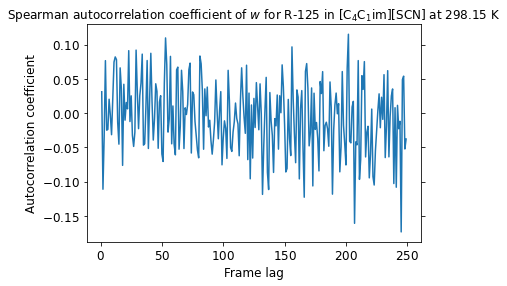

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


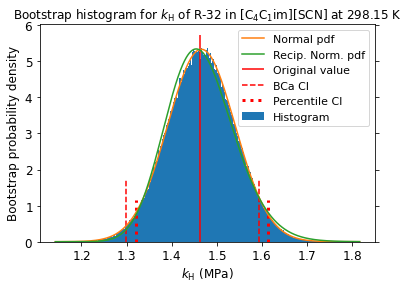

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


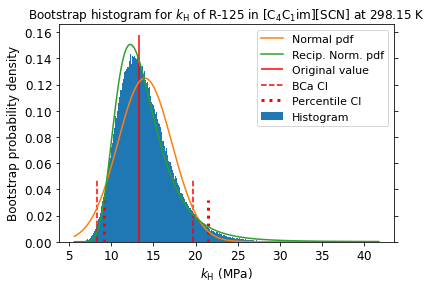

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


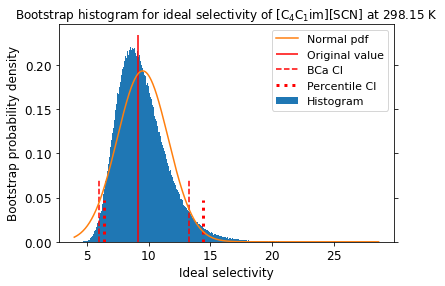

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


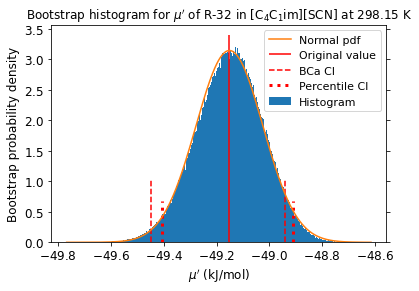

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


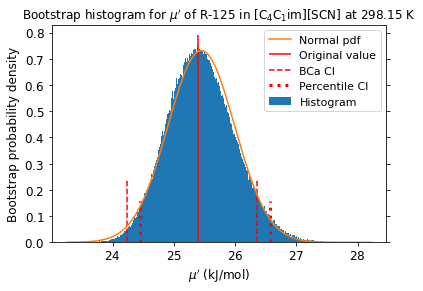

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


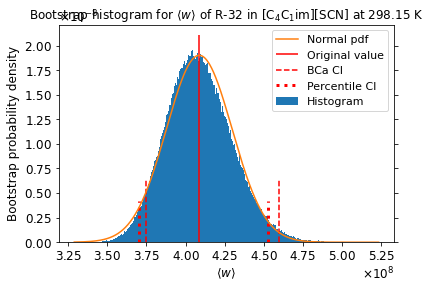

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


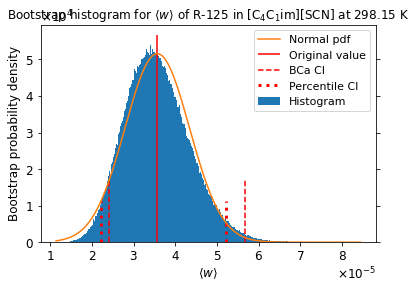

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.003080,0.019021,-0.006499,0.022433
Temp,-0.007240,0.001663,-0.003684,-0.002473
Volume,0.036928,0.161726,0.002720,0.180501
Press,-0.003510,-0.004693,0.001286,-0.008608
PotEng,0.020971,0.068966,0.004039,0.073863
KinEng,-0.007240,0.001662,-0.003684,-0.002473
TotEng,0.011050,0.053044,0.000627,0.054021
E_pair,0.025486,0.112494,0.004012,0.114228
E_vdwl,0.027688,0.105044,0.005200,0.113173
E_coul,0.004313,0.048172,0.000538,0.043563


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.019153,0.019153,0.021217,0.021217
Temp,0.002263,0.002263,-0.002243,-0.002243
Volume,0.152067,0.152067,0.166817,0.166817
Press,-0.005703,-0.005703,-0.007631,-0.007631
PotEng,0.065132,0.065132,0.070182,0.070182
KinEng,0.002263,0.002263,-0.002243,-0.002243
TotEng,0.050452,0.050452,0.050775,0.050775
E_pair,0.106670,0.106670,0.103436,0.103436
E_vdwl,0.097985,0.097985,0.103491,0.103491
E_coul,0.046042,0.046042,0.038581,0.038581


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.012754,0.012754,0.014127,0.014127
Temp,0.001517,0.001517,-0.001502,-0.001502
Volume,0.101639,0.101639,0.111796,0.111796
Press,-0.003807,-0.003807,-0.005085,-0.005085
PotEng,0.043403,0.043403,0.046843,0.046843
KinEng,0.001517,0.001517,-0.001502,-0.001502
TotEng,0.033650,0.033650,0.033868,0.033868
E_pair,0.071064,0.071064,0.069179,0.069179
E_vdwl,0.065446,0.065446,0.069207,0.069207
E_coul,0.030644,0.030644,0.025713,0.025713


R-32 w column correlation (first 5 columns):
 [[1.         0.00844294 0.00986427 0.04192554 0.01492575]
 [0.00844294 1.         0.00152537 0.00433367 0.00323201]
 [0.00986427 0.00152537 1.         0.00228322 0.00560595]
 [0.04192554 0.00433367 0.00228322 1.         0.00335189]
 [0.01492575 0.00323201 0.00560595 0.00335189 1.        ]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.35104267 0.35186526 0.35852816 0.35646682]
 [0.35104267 1.         0.354638   0.36536299 0.35189332]
 [0.35186526 0.354638   1.         0.35179467 0.35357036]
 [0.35852816 0.36536299 0.35179467 1.         0.35996185]
 [0.35646682 0.35189332 0.35357036 0.35996185 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.3414719  0.34238603 0.35072531 0.34484883]
 [0.3414719  1.         0.34284929 0.35489459 0.34233728]
 [0.34238603 0.34284929 1.         0.34121249 0.34607728]
 [0.35072531 0.35489459 0.34121249 1.         0.34902804]
 [0.34484883 0.34233728 0.34607728

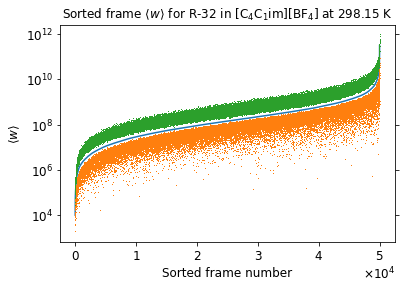

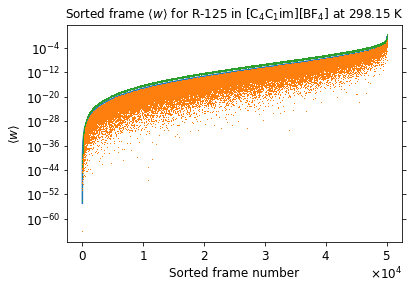

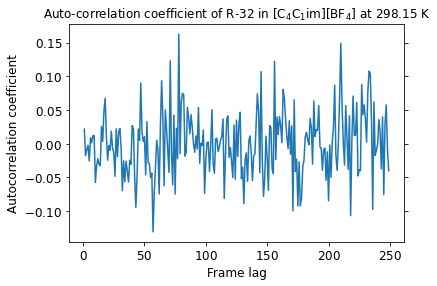

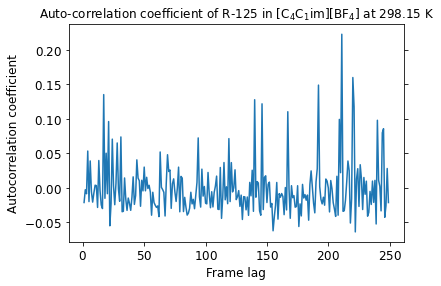

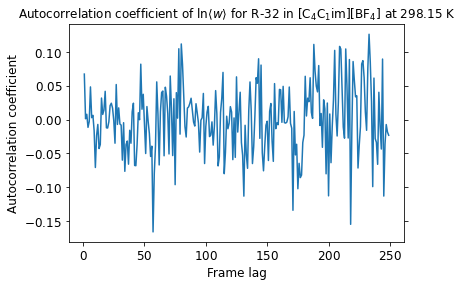

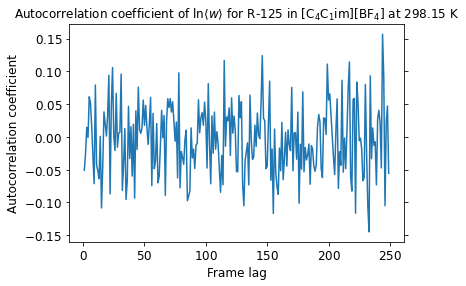

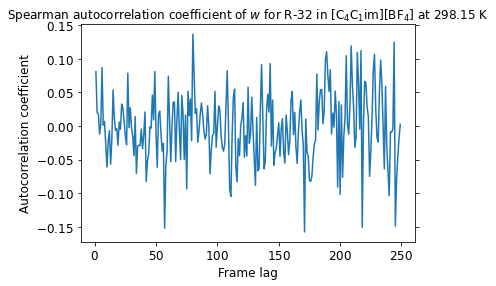

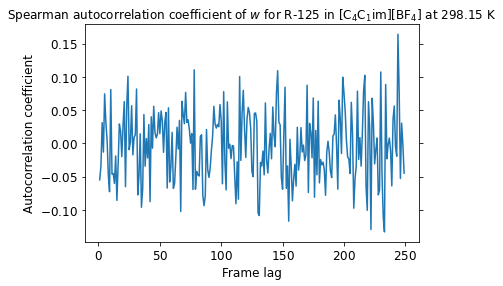

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


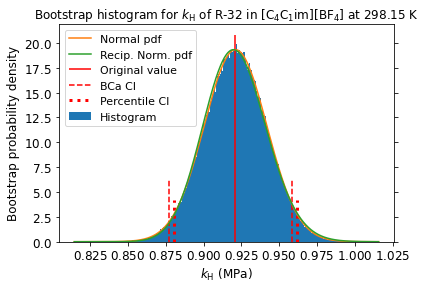

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


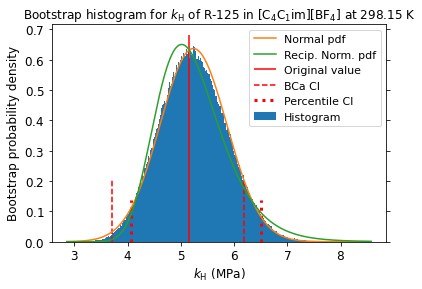

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


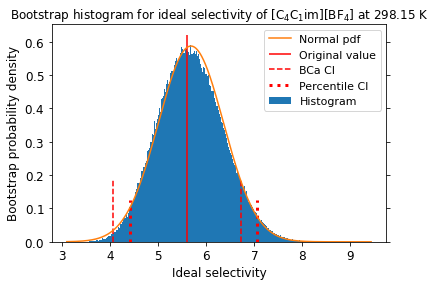

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


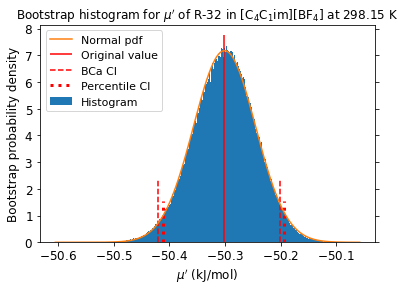

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


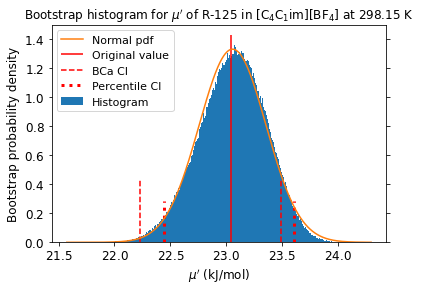

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


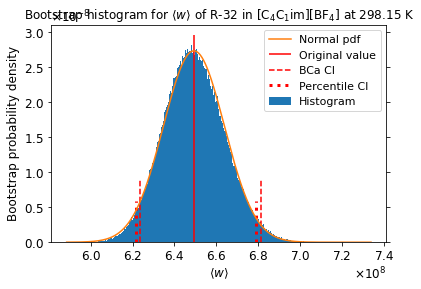

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


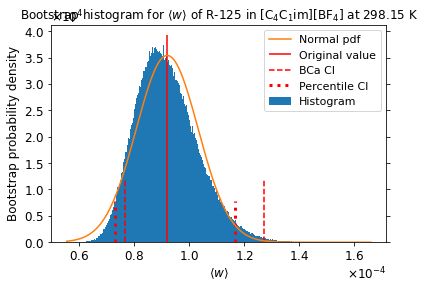

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.002037,0.004947,-0.001527,0.008376
Temp,0.005830,0.008588,-0.001122,0.002916
Volume,0.028535,0.160717,0.021734,0.179438
Press,-0.002328,-0.000703,-0.000371,-0.001510
PotEng,0.010299,0.067600,0.008631,0.067312
KinEng,0.005830,0.008588,-0.001122,0.002916
TotEng,0.011598,0.056708,0.005789,0.052778
E_pair,0.025245,0.115983,0.006403,0.113136
E_vdwl,0.020732,0.110978,0.011329,0.121114
E_coul,0.012640,0.049875,-0.004079,0.033689


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.005394,0.005394,0.009712,0.009712
Temp,0.008105,0.008105,0.003209,0.003209
Volume,0.150910,0.150910,0.165253,0.165253
Press,0.001761,0.001761,-0.000573,-0.000573
PotEng,0.064376,0.064376,0.061847,0.061847
KinEng,0.008105,0.008105,0.003209,0.003209
TotEng,0.053779,0.053779,0.049729,0.049729
E_pair,0.108893,0.108893,0.103446,0.103446
E_vdwl,0.103393,0.103393,0.110673,0.110673
E_coul,0.047664,0.047664,0.030312,0.030312


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.003631,0.003631,0.006525,0.006525
Temp,0.005403,0.005403,0.002133,0.002133
Volume,0.101059,0.101059,0.110701,0.110701
Press,0.001191,0.001191,-0.000376,-0.000376
PotEng,0.042988,0.042988,0.041274,0.041274
KinEng,0.005403,0.005403,0.002133,0.002133
TotEng,0.035936,0.035936,0.033249,0.033249
E_pair,0.072760,0.072760,0.069103,0.069103
E_vdwl,0.069077,0.069077,0.073998,0.073998
E_coul,0.031846,0.031846,0.020227,0.020227


R-32 w column correlation (first 5 columns):
 [[1.00000000e+00 2.66398132e-03 8.66912111e-03 8.07804994e-03
  8.19718673e-04]
 [2.66398132e-03 1.00000000e+00 2.74243735e-03 6.36855994e-03
  3.12361282e-03]
 [8.66912111e-03 2.74243735e-03 1.00000000e+00 2.40659625e-03
  7.10380389e-03]
 [8.07804994e-03 6.36855994e-03 2.40659625e-03 1.00000000e+00
  4.24250297e-03]
 [8.19718673e-04 3.12361282e-03 7.10380389e-03 4.24250297e-03
  1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.33648311 0.33986088 0.34355701 0.33594386]
 [0.33648311 1.         0.3380427  0.3402847  0.33727248]
 [0.33986088 0.3380427  1.         0.33497375 0.34049341]
 [0.34355701 0.3402847  0.33497375 1.         0.34084191]
 [0.33594386 0.33727248 0.34049341 0.34084191 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.32921703 0.33005389 0.32985764 0.32603666]
 [0.32921703 1.         0.32880779 0.33572562 0.32836685]
 [0.33005389 0.32880779 1.         0.326

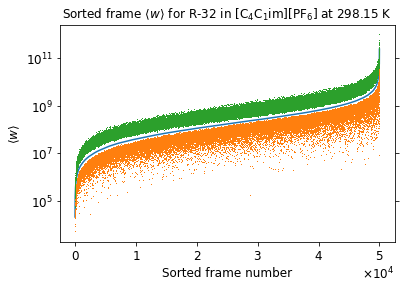

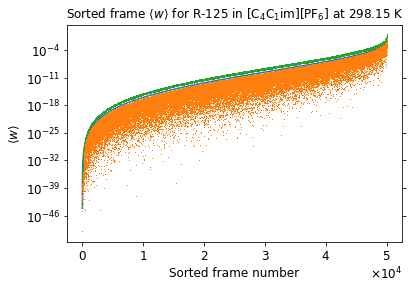

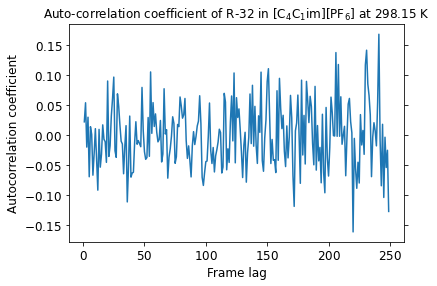

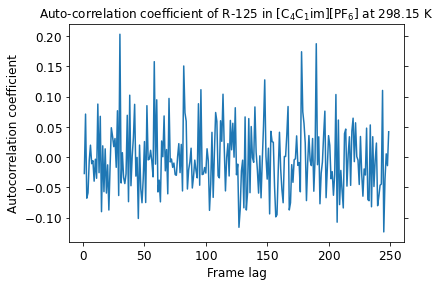

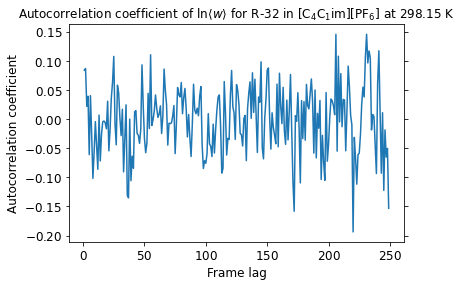

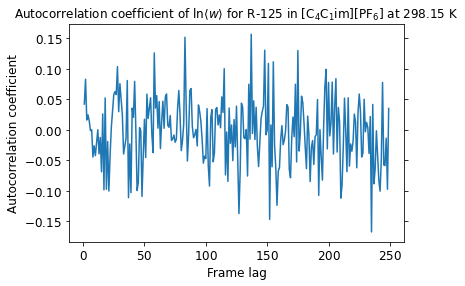

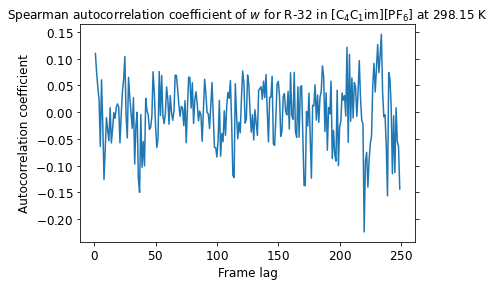

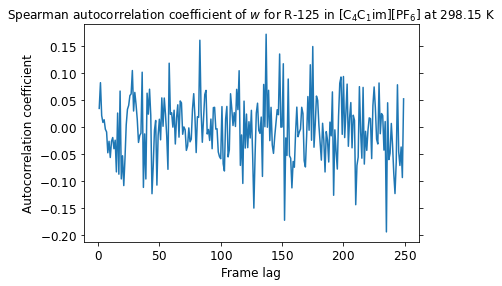

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


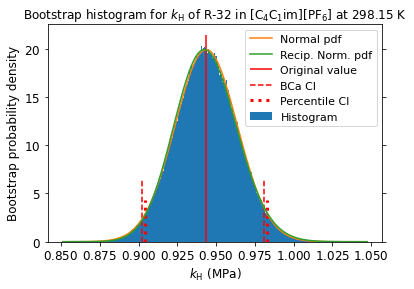

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


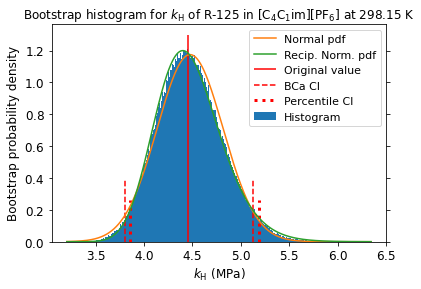

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


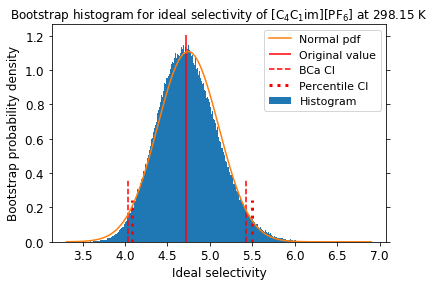

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


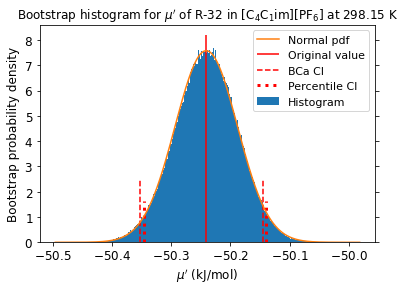

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


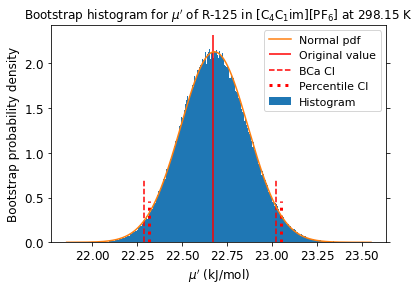

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


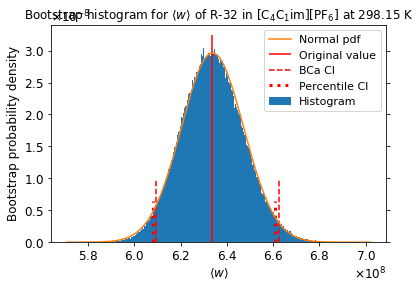

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


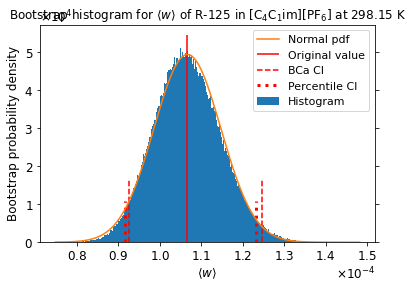

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.000860,0.004771,-0.008477,0.014896
Temp,-0.003282,-0.007365,0.001578,-0.000468
Volume,0.028097,0.159387,0.017384,0.176595
Press,-0.004648,0.001333,0.003868,0.001591
PotEng,0.013172,0.061060,0.004100,0.058387
KinEng,-0.003282,-0.007365,0.001578,-0.000468
TotEng,0.007798,0.041292,0.004129,0.043790
E_pair,0.028290,0.114843,0.009425,0.104075
E_vdwl,0.016651,0.097919,0.010006,0.103266
E_coul,0.022751,0.057663,0.002981,0.036467


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.005306,0.005306,0.014829,0.014829
Temp,-0.005707,-0.005707,0.003649,0.003649
Volume,0.150265,0.150265,0.162246,0.162246
Press,0.003657,0.003657,0.002841,0.002841
PotEng,0.056034,0.056034,0.054925,0.054925
KinEng,-0.005707,-0.005707,0.003649,0.003649
TotEng,0.038901,0.038901,0.043739,0.043739
E_pair,0.109655,0.109655,0.095613,0.095613
E_vdwl,0.094379,0.094379,0.094734,0.094734
E_coul,0.053277,0.053277,0.035099,0.035099


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.003508,0.003508,0.009882,0.009882
Temp,-0.003805,-0.003805,0.002432,0.002432
Volume,0.100579,0.100579,0.108714,0.108714
Press,0.002448,0.002448,0.001889,0.001889
PotEng,0.037370,0.037370,0.036584,0.036584
KinEng,-0.003805,-0.003805,0.002432,0.002432
TotEng,0.025921,0.025921,0.029148,0.029148
E_pair,0.073267,0.073267,0.063901,0.063901
E_vdwl,0.063045,0.063045,0.063386,0.063386
E_coul,0.035520,0.035520,0.023408,0.023408


R-32 w column correlation (first 5 columns):
 [[1.         0.06043235 0.03436774 0.01164063 0.01283363]
 [0.06043235 1.         0.00669824 0.02112949 0.01263622]
 [0.03436774 0.00669824 1.         0.00820634 0.01336026]
 [0.01164063 0.02112949 0.00820634 1.         0.01709713]
 [0.01283363 0.01263622 0.01336026 0.01709713 1.        ]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.32482077 0.32131096 0.32869215 0.31849859]
 [0.32482077 1.         0.32506142 0.3252825  0.32104983]
 [0.32131096 0.32506142 1.         0.33031652 0.31934905]
 [0.32869215 0.3252825  0.33031652 1.         0.31829329]
 [0.31849859 0.32104983 0.31934905 0.31829329 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.3078711  0.30937869 0.3123766  0.30844337]
 [0.3078711  1.         0.30873774 0.31144847 0.30957765]
 [0.30937869 0.30873774 1.         0.31788178 0.30675063]
 [0.3123766  0.31144847 0.31788178 1.         0.30456431]
 [0.30844337 0.30957765 0.30675063

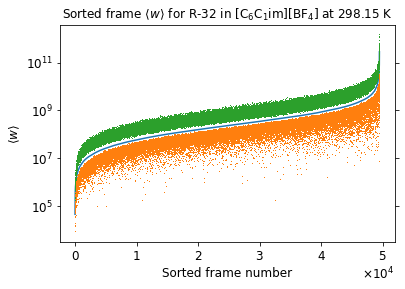

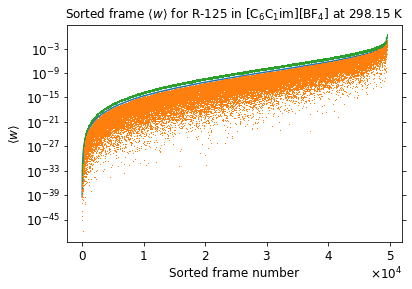

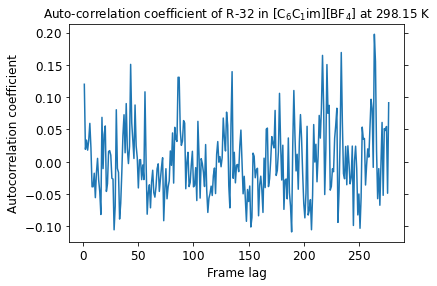

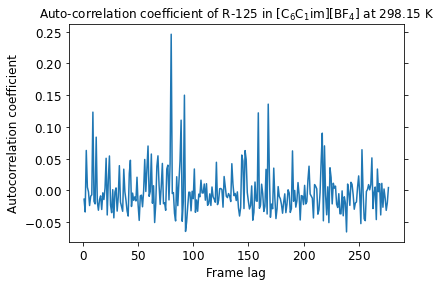

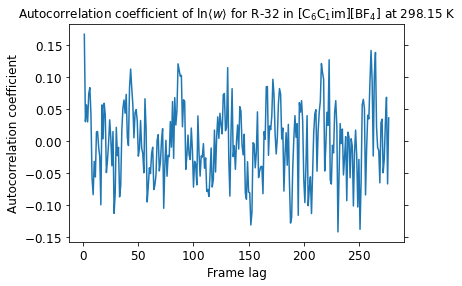

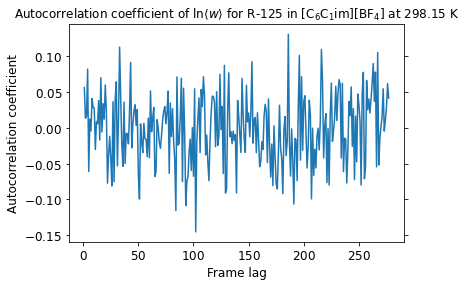

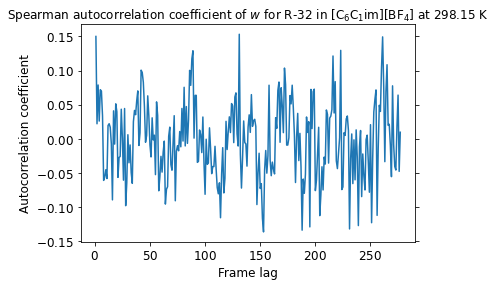

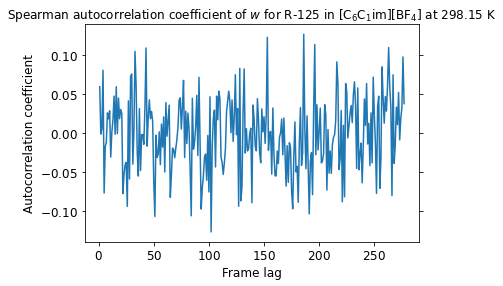

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


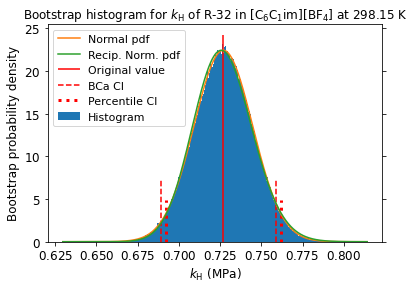

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


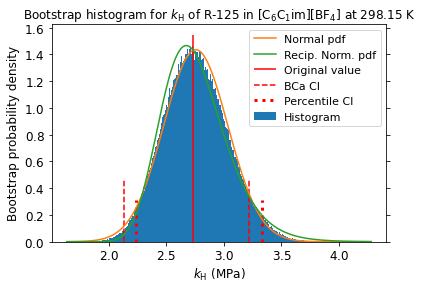

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


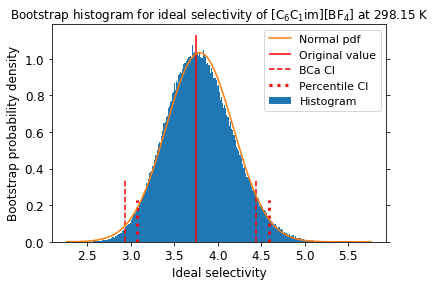

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


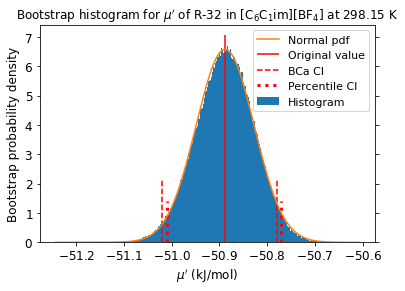

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


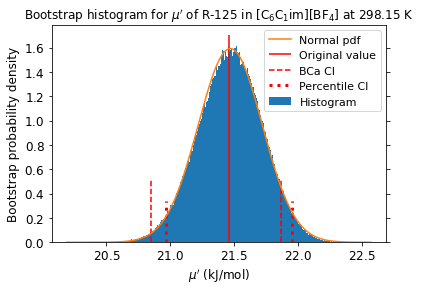

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


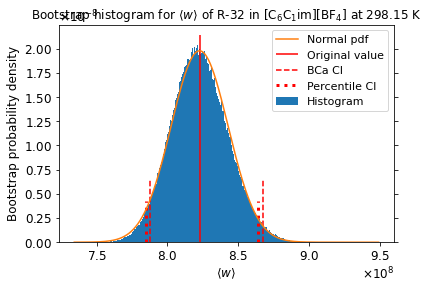

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


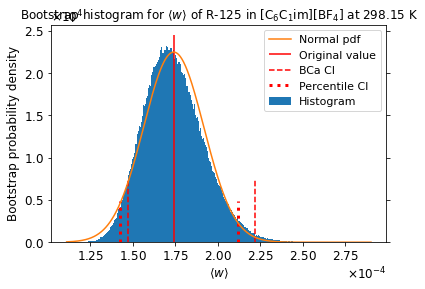

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.008061,-0.041218,-0.005323,-0.023393
Temp,0.004997,-0.003320,-0.003618,-0.003830
Volume,0.002645,0.149877,0.002475,0.181983
Press,0.007616,-0.001031,0.006708,-0.012312
PotEng,0.002867,0.060446,0.000584,0.065834
KinEng,0.004997,-0.003320,-0.003618,-0.003830
TotEng,0.005401,0.044066,-0.001878,0.047856
E_pair,0.006482,0.100010,0.002653,0.106401
E_vdwl,0.004240,0.082922,0.002634,0.094492
E_coul,0.002207,0.040661,0.001281,0.037220


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.042714,-0.042714,-0.022455,-0.022455
Temp,0.000175,0.000175,-0.001597,-0.001597
Volume,0.141113,0.141113,0.168683,0.168683
Press,0.000817,0.000817,-0.010688,-0.010688
PotEng,0.056900,0.056900,0.061916,0.061916
KinEng,0.000175,0.000175,-0.001597,-0.001597
TotEng,0.042200,0.042200,0.045099,0.045099
E_pair,0.095020,0.095020,0.097349,0.097349
E_vdwl,0.078166,0.078166,0.088565,0.088565
E_coul,0.037336,0.037336,0.033832,0.033832


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.028341,-0.028341,-0.015021,-0.015021
Temp,0.000117,0.000117,-0.001068,-0.001068
Volume,0.094517,0.094517,0.112941,0.112941
Press,0.000554,0.000554,-0.007102,-0.007102
PotEng,0.038020,0.038020,0.041293,0.041293
KinEng,0.000117,0.000117,-0.001068,-0.001068
TotEng,0.028174,0.028174,0.030091,0.030091
E_pair,0.063421,0.063421,0.065027,0.065027
E_vdwl,0.052170,0.052170,0.059095,0.059095
E_coul,0.024878,0.024878,0.022578,0.022578


R-32 w column correlation (first 5 columns):
 [[1.00000000e+00 5.05038905e-04 2.44129732e-03 4.38277114e-04
  2.38216353e-03]
 [5.05038905e-04 1.00000000e+00 1.42858874e-03 3.46009966e-03
  2.79048859e-03]
 [2.44129732e-03 1.42858874e-03 1.00000000e+00 3.37195198e-03
  2.27543141e-02]
 [4.38277114e-04 3.46009966e-03 3.37195198e-03 1.00000000e+00
  4.05128256e-03]
 [2.38216353e-03 2.79048859e-03 2.27543141e-02 4.05128256e-03
  1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.35798502 0.35164651 0.35631771 0.35493755]
 [0.35798502 1.         0.3518497  0.34818418 0.35551497]
 [0.35164651 0.3518497  1.         0.34957911 0.35510731]
 [0.35631771 0.34818418 0.34957911 1.         0.34639628]
 [0.35493755 0.35551497 0.35510731 0.34639628 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.3468738  0.34386298 0.34779543 0.34422902]
 [0.3468738  1.         0.34344781 0.33930024 0.34687603]
 [0.34386298 0.34344781 1.         0.345

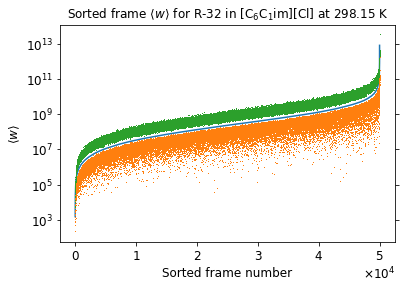

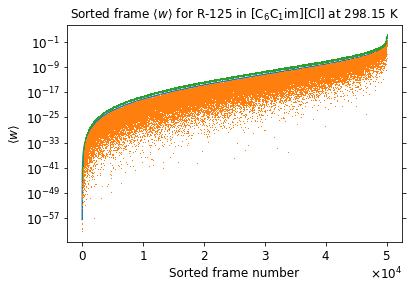

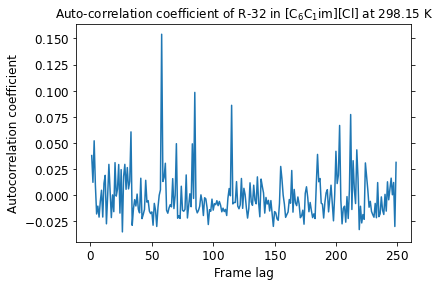

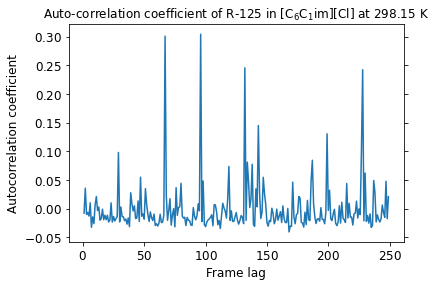

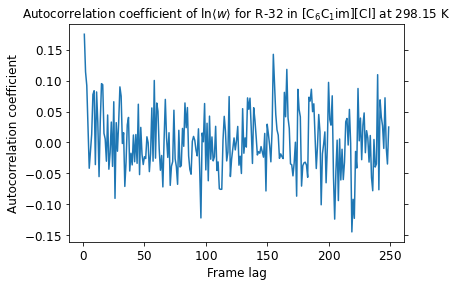

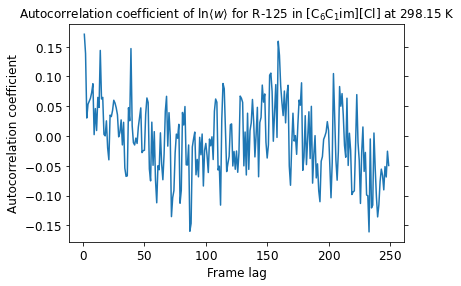

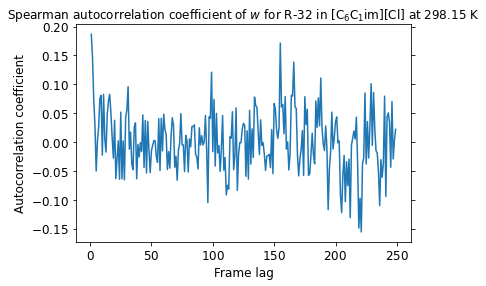

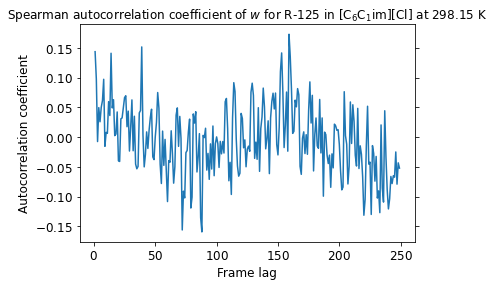

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


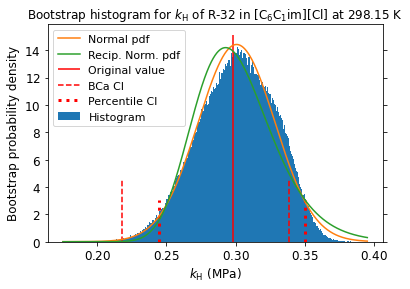

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


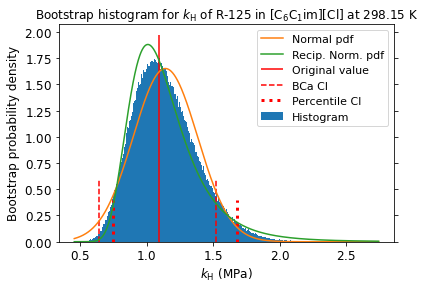

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


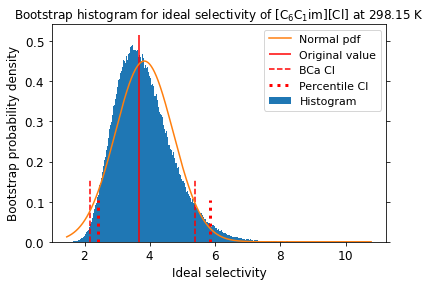

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


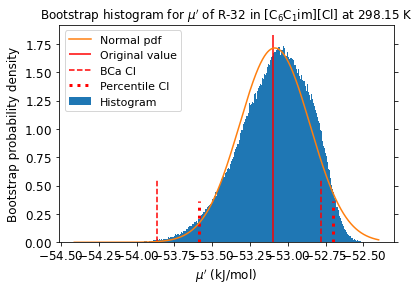

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


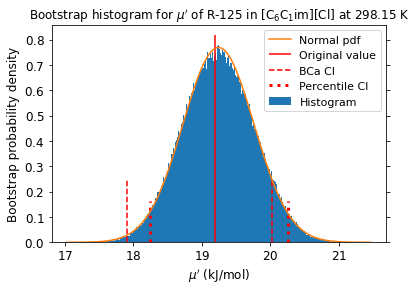

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


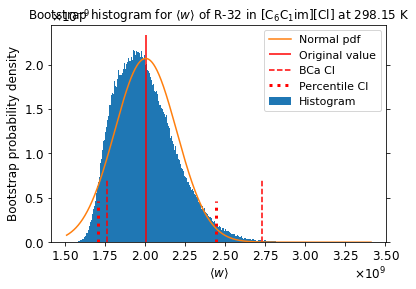

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


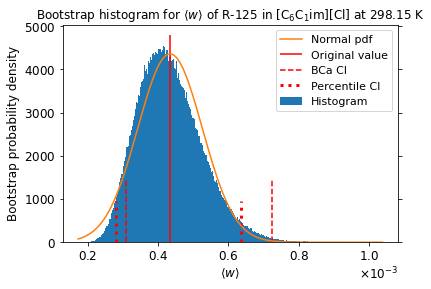

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


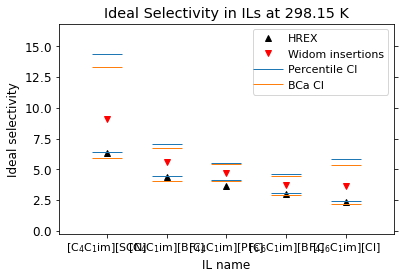

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


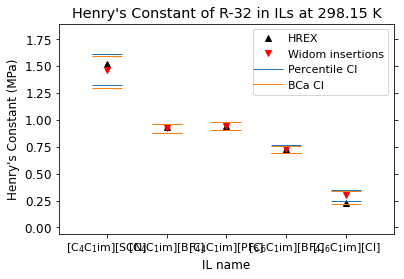

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


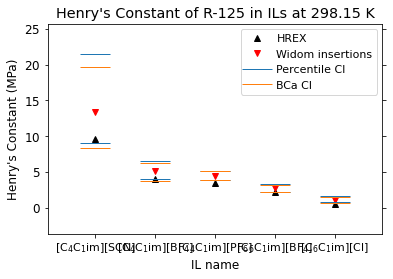

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


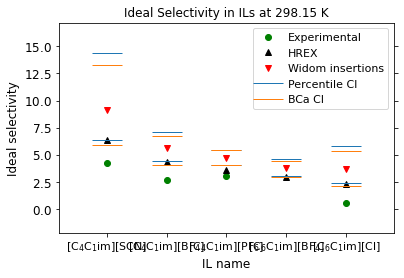

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


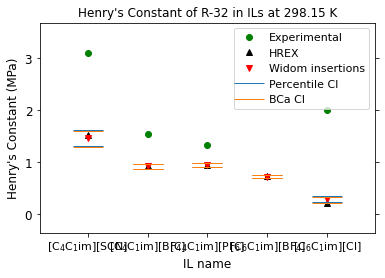

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


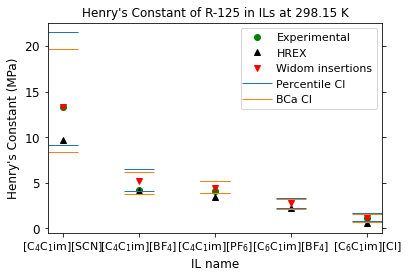

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


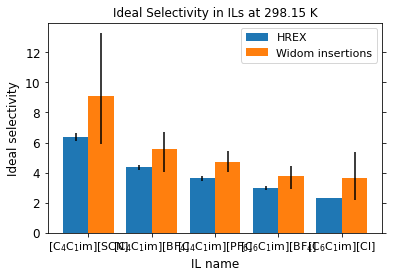

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


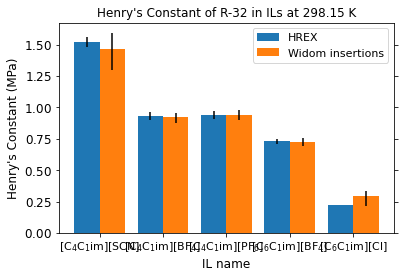

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


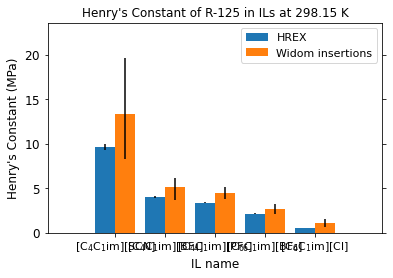

In [92]:
plot_results("adaptive_rmin_2/vbs_blocksize100_89", "adaptive_rmin_2", get_fbs=True, get_corr=True, blocksize=(100,100,100,89,100))

R-32 w column correlation (first 5 columns):
 [[1.         0.00797328 0.00159419 0.04636462 0.01833437]
 [0.00797328 1.         0.00462307 0.00472713 0.0355314 ]
 [0.00159419 0.00462307 1.         0.00995165 0.02197724]
 [0.04636462 0.00472713 0.00995165 1.         0.06528589]
 [0.01833437 0.0355314  0.02197724 0.06528589 1.        ]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.40445856 0.41178434 0.40503156 0.40107805]
 [0.40445856 1.         0.40974618 0.40862618 0.38959163]
 [0.41178434 0.40974618 1.         0.39032491 0.38280745]
 [0.40503156 0.40862618 0.39032491 1.         0.39984114]
 [0.40107805 0.38959163 0.38280745 0.39984114 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.4072312  0.41293341 0.40406534 0.405839  ]
 [0.4072312  1.         0.40934303 0.41266002 0.39638206]
 [0.41293341 0.40934303 1.         0.39701395 0.39020977]
 [0.40406534 0.41266002 0.39701395 1.         0.40647072]
 [0.405839   0.39638206 0.39020977

10 highest observations are:

[[1.34460135e+10 1.84173665e-03]
 [1.47214095e+10 2.22239718e-03]
 [1.54140612e+10 2.73524797e-03]
 [1.58146386e+10 2.81008352e-03]
 [1.68764063e+10 2.94775730e-03]
 [1.89627068e+10 3.44749897e-03]
 [2.27505639e+10 4.65805737e-03]
 [2.65756581e+10 6.23926441e-03]
 [3.79553832e+10 1.01415149e-02]
 [8.80182897e+10 3.64711102e-02]]
with indices:

[[7494  610]
 [ 600  598]
 [5181  778]
 [1066  501]
 [7498  590]
 [9632  588]
 [2860  593]
 [2168  594]
 [5178 9210]
 [6315  625]]


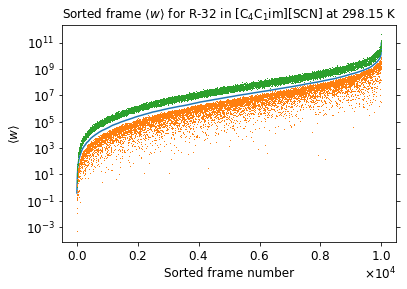

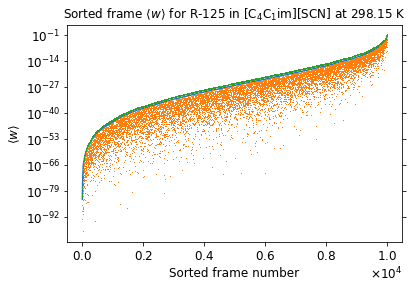

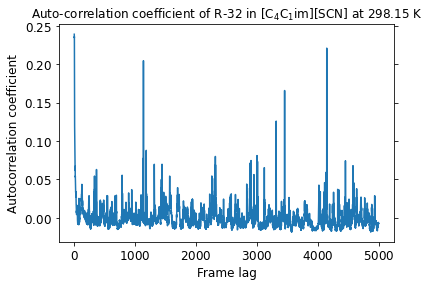

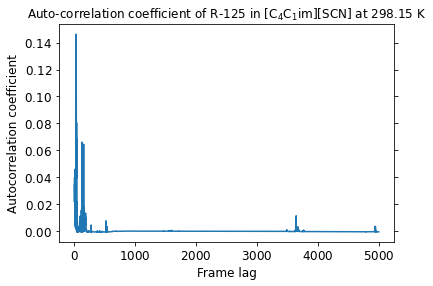

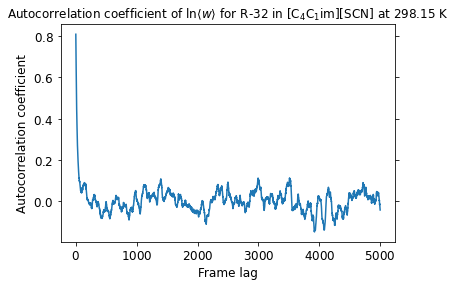

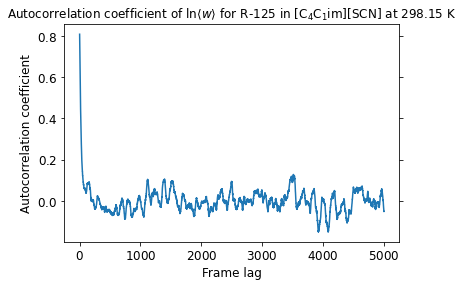

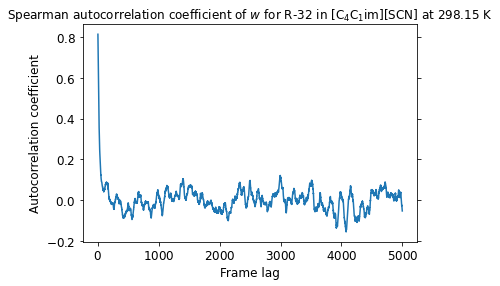

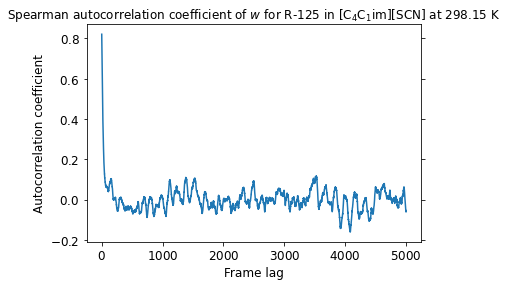

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


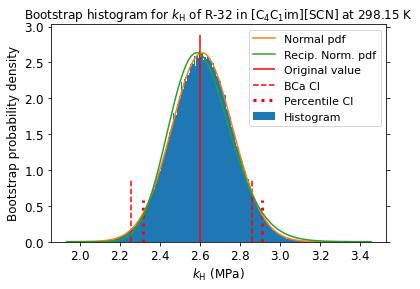

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


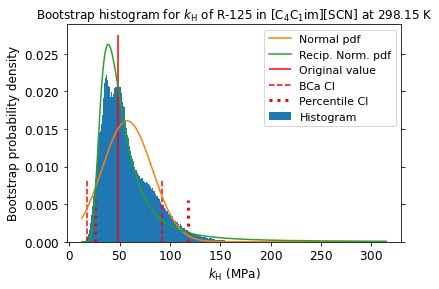

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


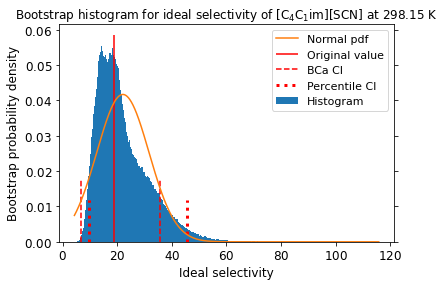

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


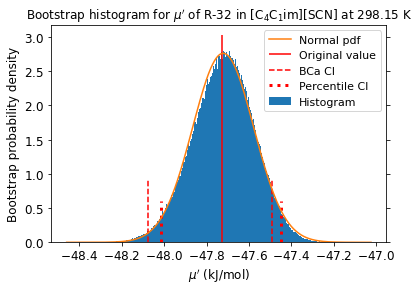

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


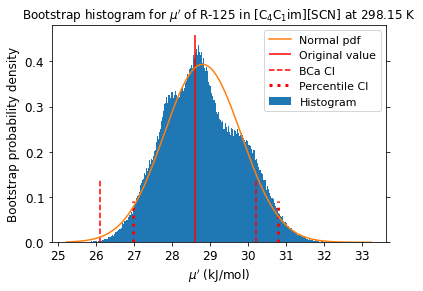

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


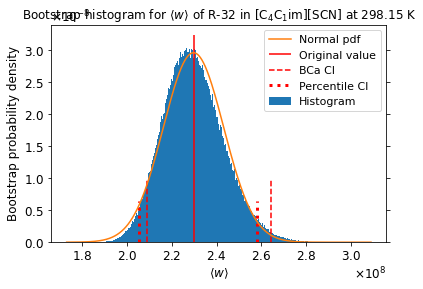

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


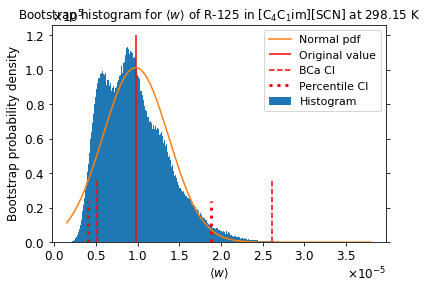

R-32 w column correlation (first 5 columns):
 [[ 1.00000000e+00  2.83761684e-02 -1.04822488e-04  8.55046320e-03
   4.16021773e-02]
 [ 2.83761684e-02  1.00000000e+00  3.18570549e-02  1.09139915e-02
   3.93409192e-02]
 [-1.04822488e-04  3.18570549e-02  1.00000000e+00  5.65882936e-03
   1.90548146e-02]
 [ 8.55046320e-03  1.09139915e-02  5.65882936e-03  1.00000000e+00
   1.14686532e-02]
 [ 4.16021773e-02  3.93409192e-02  1.90548146e-02  1.14686532e-02
   1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.32814766 0.31606881 0.32444995 0.32213776]
 [0.32814766 1.         0.33030708 0.34479023 0.31931165]
 [0.31606881 0.33030708 1.         0.31840988 0.31336807]
 [0.32444995 0.34479023 0.31840988 1.         0.33904156]
 [0.32213776 0.31931165 0.31336807 0.33904156 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.31403496 0.3072061  0.32263092 0.31414096]
 [0.31403496 1.         0.32687171 0.33169337 0.3048587 ]
 [0.3072061  0.

10 highest observations are:

[[2.98413258e+10 5.92271605e-03]
 [3.05755583e+10 6.10995124e-03]
 [3.89773921e+10 6.97080343e-03]
 [3.94710681e+10 8.45269619e-03]
 [3.99837499e+10 8.46536607e-03]
 [4.51379460e+10 8.63388165e-03]
 [4.95547802e+10 9.09098289e-03]
 [5.36659432e+10 1.21963374e-02]
 [5.79316302e+10 1.74201319e-02]
 [8.79477921e+10 1.75829445e-02]]
with indices:

[[9505 3847]
 [9515 3845]
 [6512  818]
 [7037 5097]
 [6065 5096]
 [6071 7561]
 [6515  560]
 [9512 9880]
 [9506 5099]
 [6073 4495]]


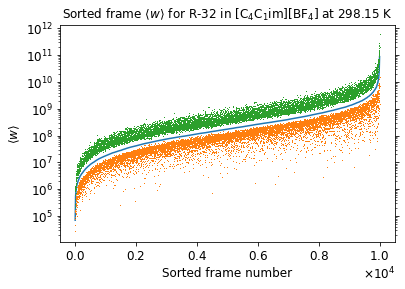

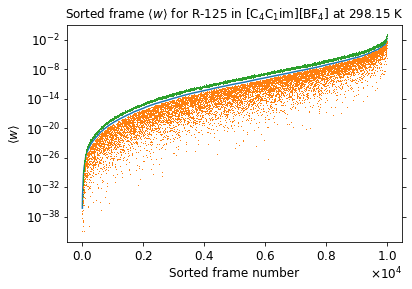

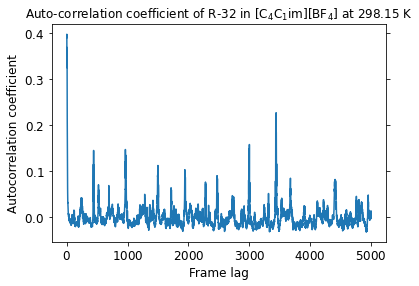

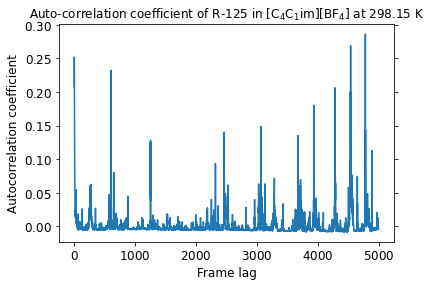

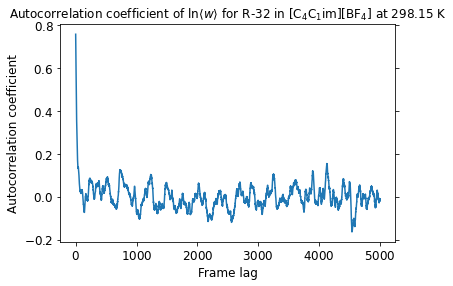

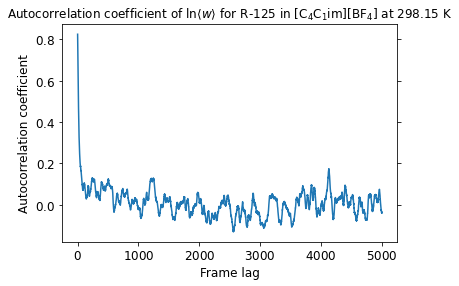

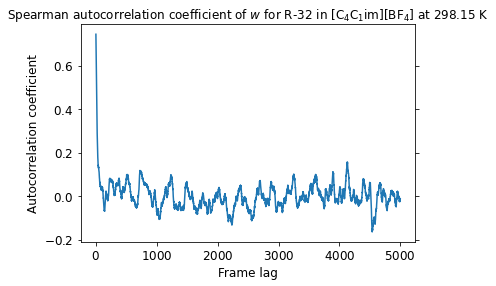

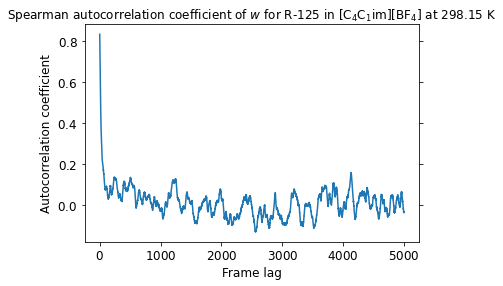

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


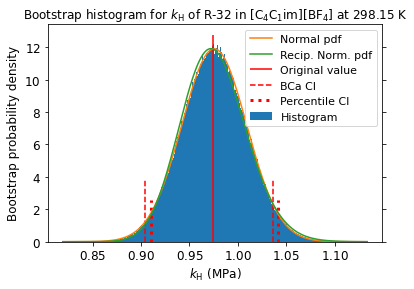

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


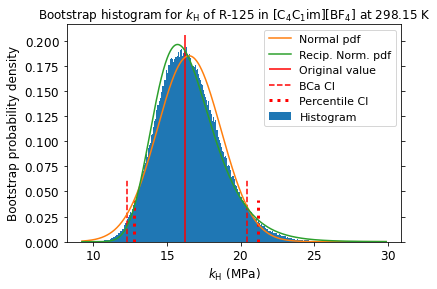

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


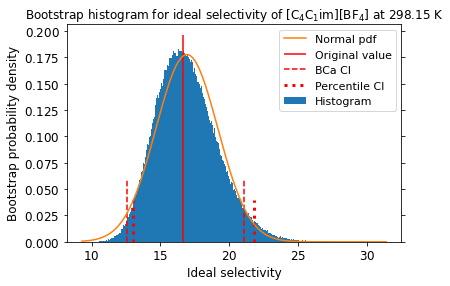

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


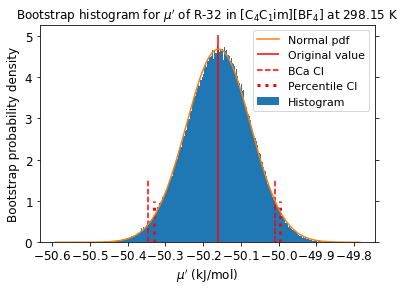

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


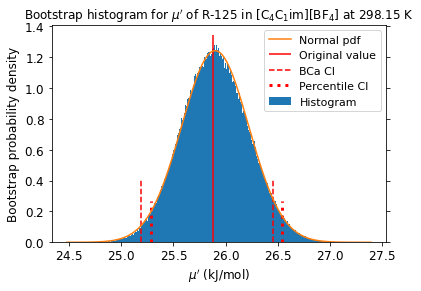

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


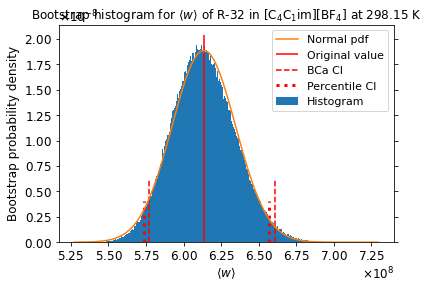

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


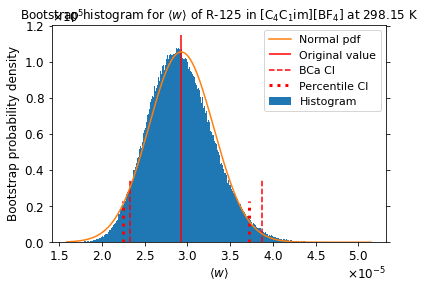

R-32 w column correlation (first 5 columns):
 [[1.00000000e+00 3.69177079e-05 2.65290383e-03 5.81742374e-03
  2.92446120e-03]
 [3.69177079e-05 1.00000000e+00 1.65213080e-02 2.88784207e-02
  1.37132630e-02]
 [2.65290383e-03 1.65213080e-02 1.00000000e+00 1.83859298e-02
  4.29635251e-03]
 [5.81742374e-03 2.88784207e-02 1.83859298e-02 1.00000000e+00
  3.77421251e-03]
 [2.92446120e-03 1.37132630e-02 4.29635251e-03 3.77421251e-03
  1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.30656497 0.32984148 0.33179477 0.31566755]
 [0.30656497 1.         0.32579163 0.33176834 0.31800285]
 [0.32984148 0.32579163 1.         0.3260385  0.33145681]
 [0.33179477 0.33176834 0.3260385  1.         0.32563758]
 [0.31566755 0.31800285 0.33145681 0.32563758 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.30516563 0.31548013 0.32300479 0.30454389]
 [0.30516563 1.         0.32124386 0.31126016 0.30989522]
 [0.31548013 0.32124386 1.         0.320

10 highest observations are:

[[1.02639655e+11 9.99210254e-03]
 [1.06682632e+11 1.04492121e-02]
 [1.17017538e+11 1.06447149e-02]
 [1.39943586e+11 1.12557988e-02]
 [1.66656950e+11 1.16748262e-02]
 [1.73261629e+11 1.28203941e-02]
 [1.94916557e+11 1.35076007e-02]
 [2.17392062e+11 1.67795187e-02]
 [3.55415895e+11 1.80861974e-02]
 [4.77749468e+11 4.12457172e-02]]
with indices:

[[4403 3286]
 [4357 3293]
 [4363 3285]
 [4405 4835]
 [4303 3290]
 [4304 3287]
 [2202 9322]
 [4305 9242]
 [4365 3282]
 [4367 4849]]


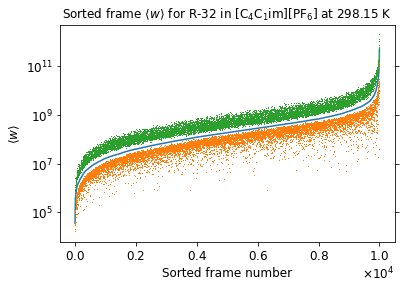

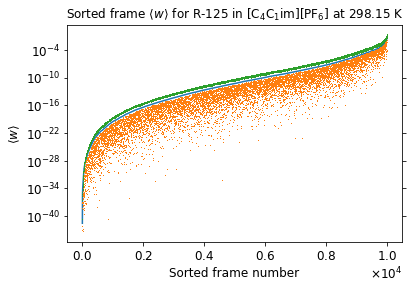

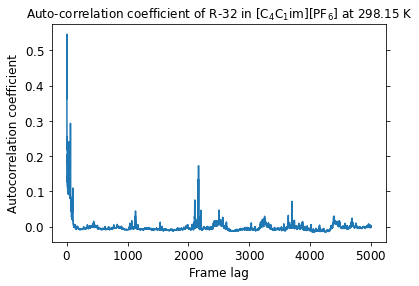

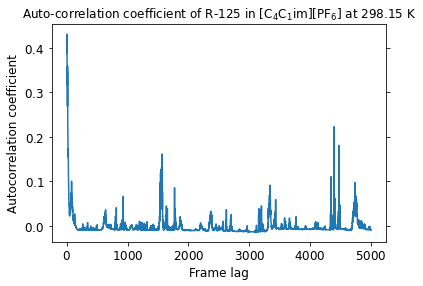

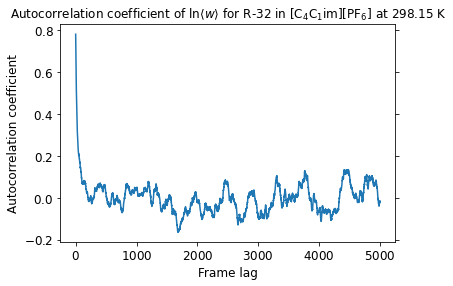

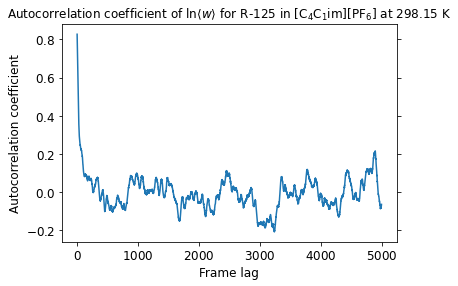

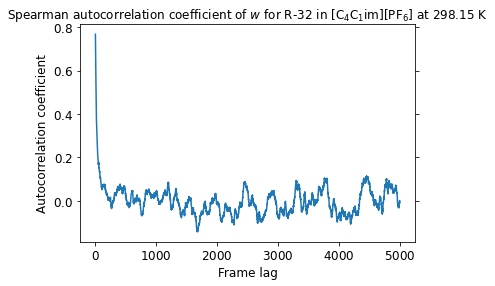

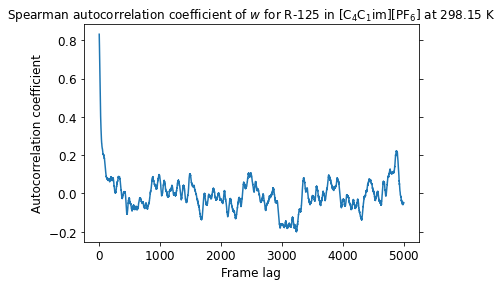

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


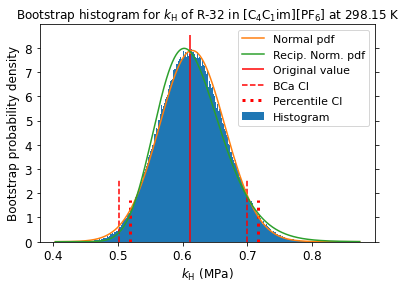

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


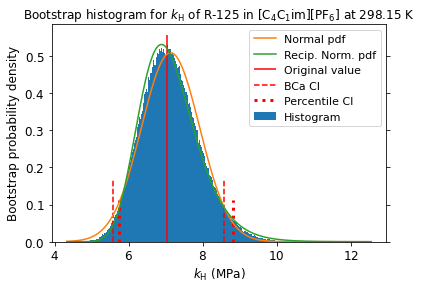

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


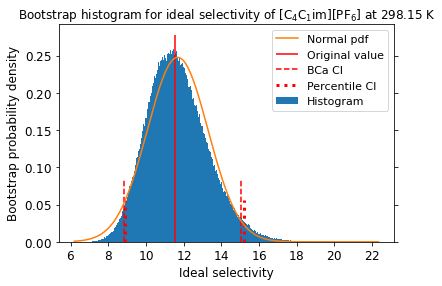

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


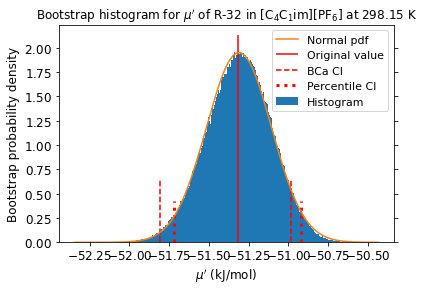

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


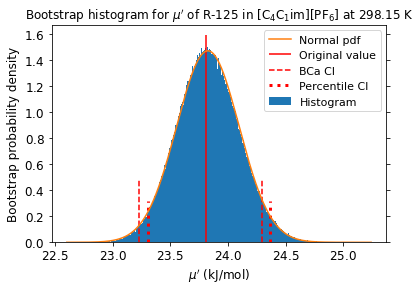

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


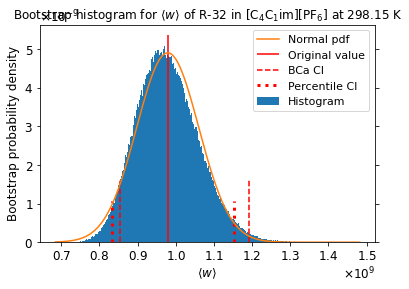

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


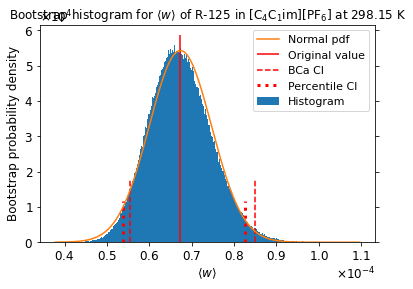

R-32 w column correlation (first 5 columns):
 [[1.00000000e+00 3.18683613e-01 2.62246317e-02 6.34505909e-04
  5.44336628e-02]
 [3.18683613e-01 1.00000000e+00 1.88191782e-02 3.63431457e-02
  2.35577365e-02]
 [2.62246317e-02 1.88191782e-02 1.00000000e+00 2.61852060e-03
  8.69022612e-03]
 [6.34505909e-04 3.63431457e-02 2.61852060e-03 1.00000000e+00
  1.71732874e-02]
 [5.44336628e-02 2.35577365e-02 8.69022612e-03 1.71732874e-02
  1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.30545155 0.31181994 0.31839299 0.30544519]
 [0.30545155 1.         0.30394064 0.31789293 0.31067325]
 [0.31181994 0.30394064 1.         0.32005125 0.31617157]
 [0.31839299 0.31789293 0.32005125 1.         0.324103  ]
 [0.30544519 0.31067325 0.31617157 0.324103   1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.29248056 0.29397067 0.30067621 0.28739149]
 [0.29248056 1.         0.28687095 0.29347318 0.28807488]
 [0.29397067 0.28687095 1.         0.300

10 highest observations are:

[[2.79625685e+10 3.77194825e-02]
 [2.82132804e+10 4.35369548e-02]
 [3.12683780e+10 4.42719466e-02]
 [3.23276528e+10 4.66194630e-02]
 [3.34268150e+10 4.68411318e-02]
 [3.47926250e+10 7.75221300e-02]
 [3.55098959e+10 9.32634616e-02]
 [3.97271608e+10 1.00321310e-01]
 [4.47213389e+10 1.11195098e-01]
 [7.96071648e+10 2.23975389e-01]]
with indices:

[[ 556 5569]
 [7738  812]
 [ 555 7850]
 [ 658 5556]
 [ 903 4792]
 [6310 4801]
 [6314 4005]
 [ 581 5558]
 [9024 7725]
 [7474 4012]]


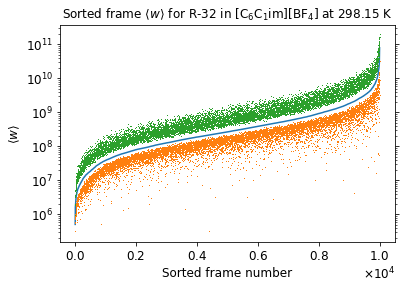

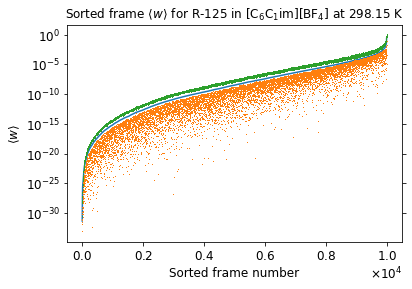

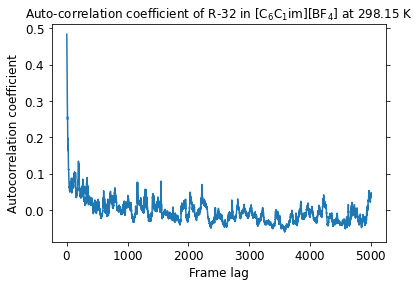

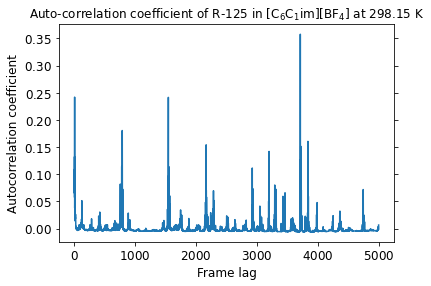

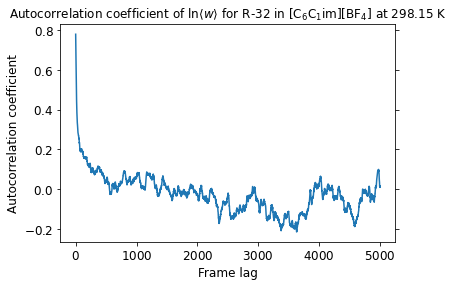

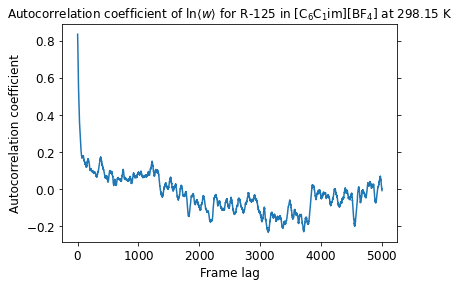

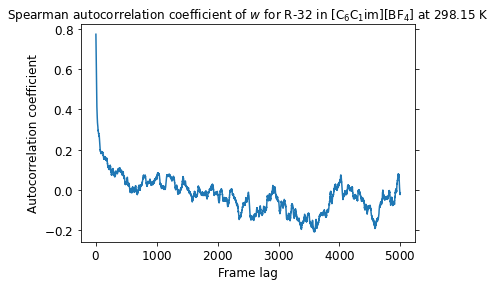

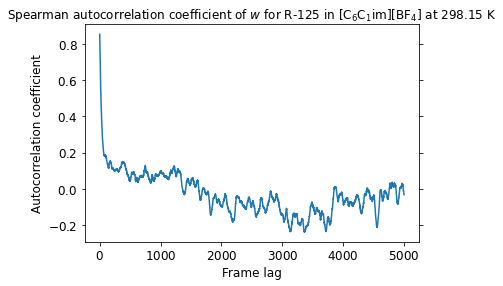

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


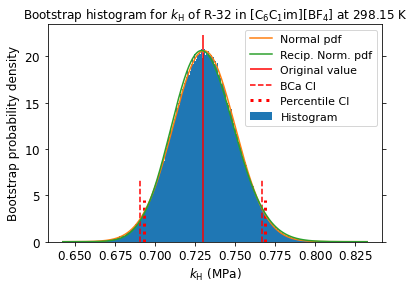

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


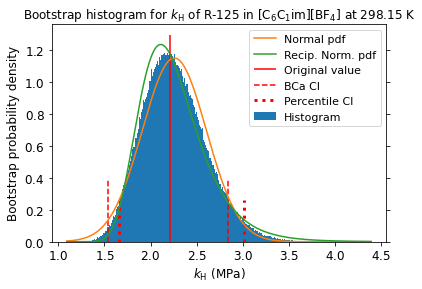

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


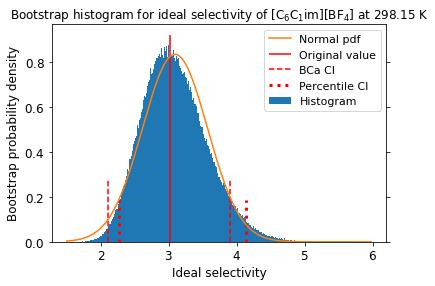

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


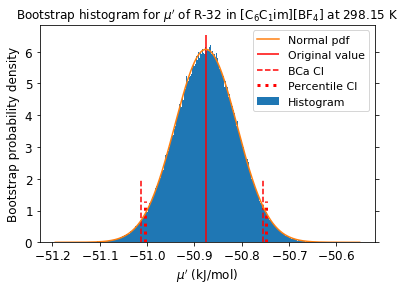

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


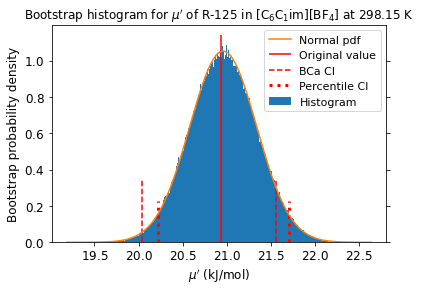

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


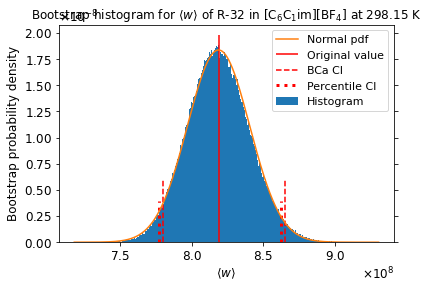

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


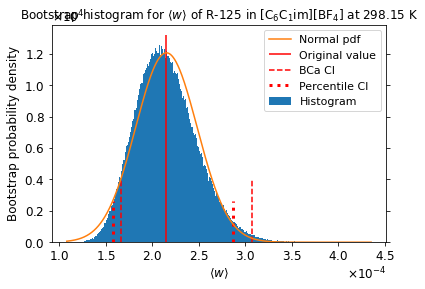

R-32 w column correlation (first 5 columns):
 [[1.         0.00189404 0.02905782 0.00361332 0.00909817]
 [0.00189404 1.         0.00403944 0.02285274 0.00273071]
 [0.02905782 0.00403944 1.         0.09517064 0.00600819]
 [0.00361332 0.02285274 0.09517064 1.         0.01063236]
 [0.00909817 0.00273071 0.00600819 0.01063236 1.        ]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.28585939 0.28643399 0.29225435 0.28669206]
 [0.28585939 1.         0.277772   0.30472443 0.30268427]
 [0.28643399 0.277772   1.         0.30882798 0.31743239]
 [0.29225435 0.30472443 0.30882798 1.         0.29682721]
 [0.28669206 0.30268427 0.31743239 0.29682721 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.27549    0.27224712 0.28548701 0.27786754]
 [0.27549    1.         0.27405787 0.2890655  0.29384882]
 [0.27224712 0.27405787 1.         0.29550988 0.30862765]
 [0.28548701 0.2890655  0.29550988 1.         0.29609832]
 [0.27786754 0.29384882 0.30862765

10 highest observations are:

[[1.86776048e+11 2.13531829e-01]
 [2.29417237e+11 2.54941018e-01]
 [2.73919867e+11 2.85709436e-01]
 [3.05827107e+11 3.01126849e-01]
 [3.40640449e+11 3.06553805e-01]
 [3.50791636e+11 3.23671925e-01]
 [4.41007179e+11 3.34846734e-01]
 [4.60515066e+11 4.49616052e-01]
 [4.89137366e+11 5.65408485e-01]
 [1.12781796e+12 6.96541864e-01]]
with indices:

[[2885 4692]
 [   6 2652]
 [2890 4694]
 [   1 4688]
 [ 379 5126]
 [ 377 5129]
 [2892 5095]
 [ 375 5128]
 [ 376 7991]
 [2882 5025]]


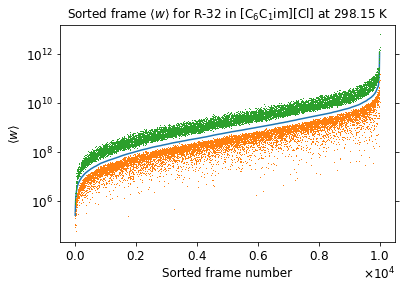

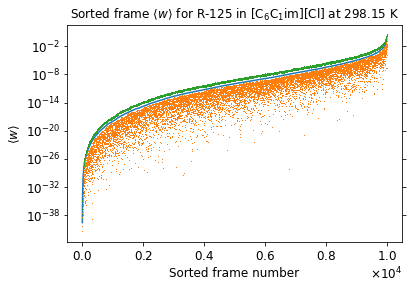

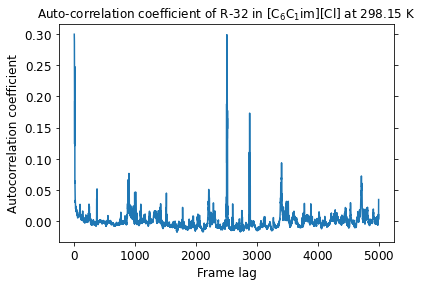

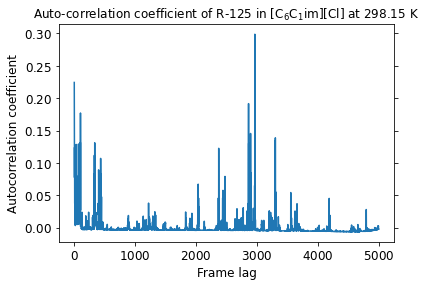

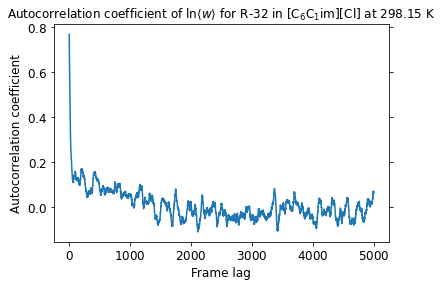

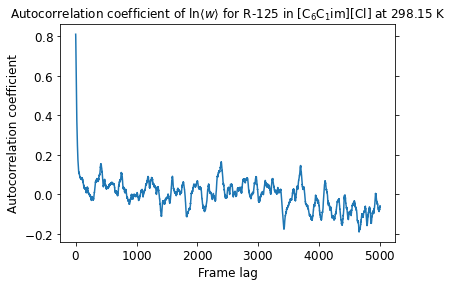

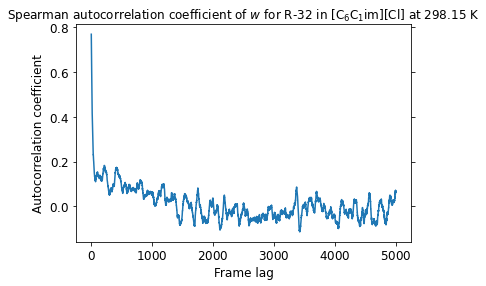

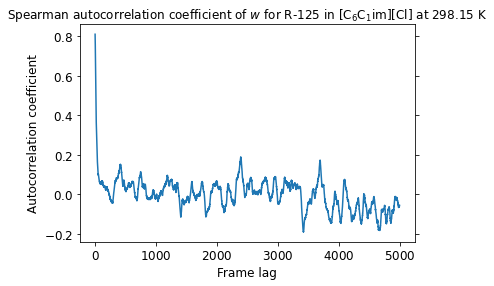

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


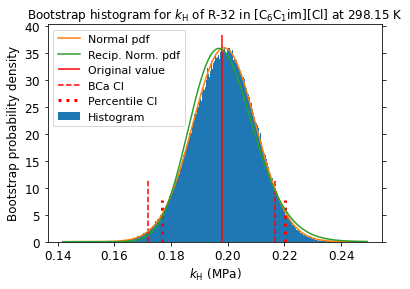

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


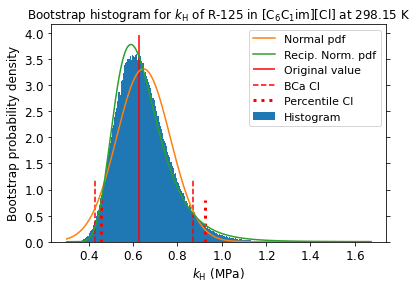

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


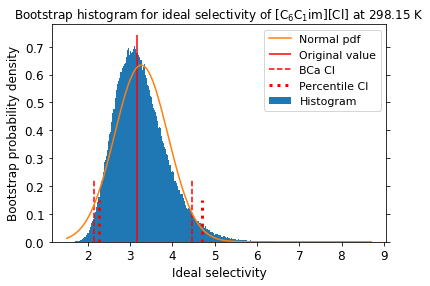

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


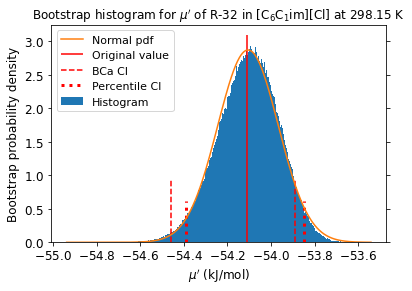

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


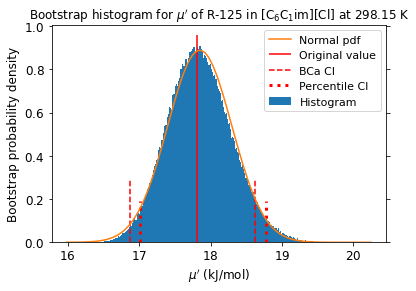

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


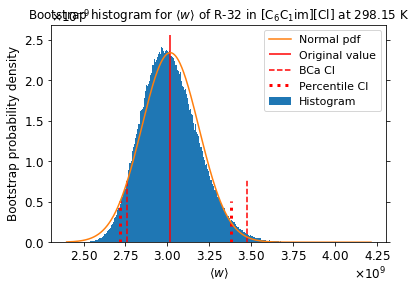

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


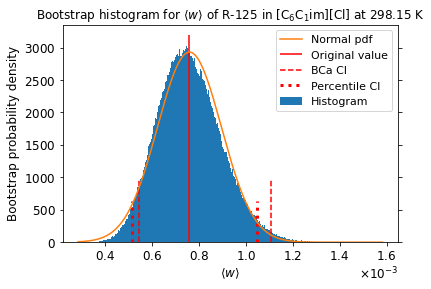

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


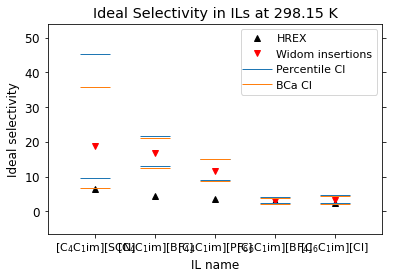

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


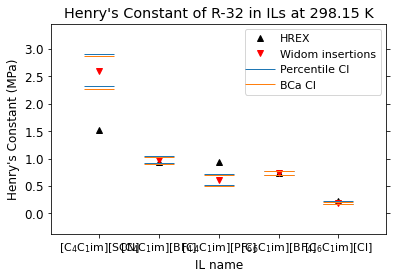

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


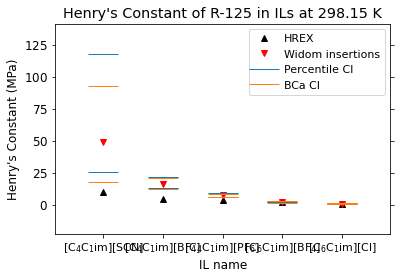

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


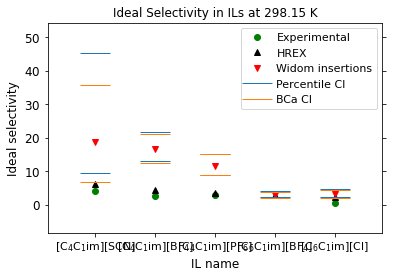

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


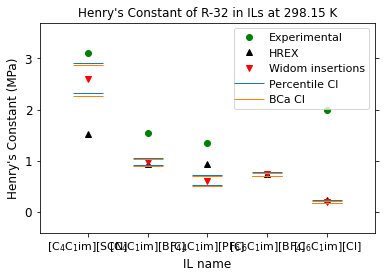

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


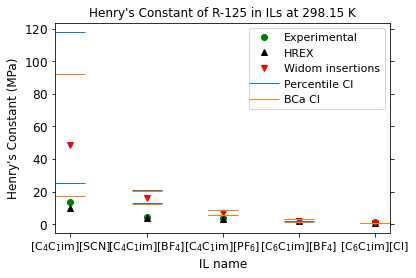

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


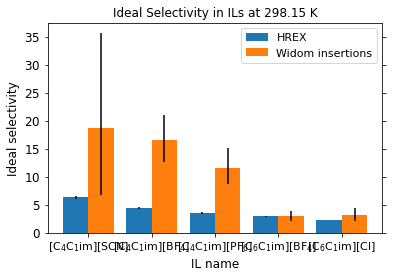

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


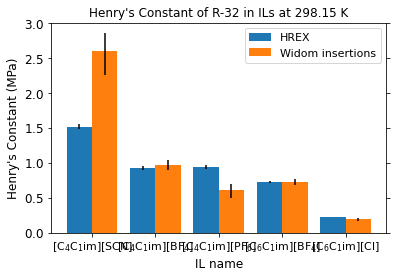

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


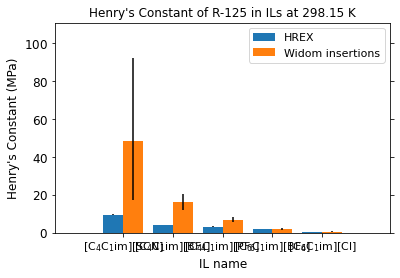

In [93]:
plot_results("Eij_max_estimation_1_corr/vbs", "Eij_max_estimation_1_corr", get_fbs=True, get_corr=True, get_prp_corr=False)

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.009593,-0.000408,-0.003801,-0.004264
Temp,0.012135,0.005719,-0.004614,-0.002846
Volume,0.005957,0.156410,0.003950,0.174771
Press,-0.002372,-0.010923,-0.002049,-0.010573
PotEng,0.000200,0.067640,0.000143,0.074838
KinEng,0.012135,0.005719,-0.004614,-0.002846
TotEng,0.008064,0.054889,-0.002900,0.054748
E_pair,0.006435,0.107356,0.003844,0.108709
E_vdwl,-0.001151,0.099502,0.002334,0.104679
E_coul,0.010951,0.044706,0.003831,0.041516


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.000265,-0.000265,-0.005701,-0.005701
Temp,0.004139,0.004139,-0.004361,-0.004361
Volume,0.144727,0.144727,0.160629,0.160629
Press,-0.010327,-0.010327,-0.010134,-0.010134
PotEng,0.060614,0.060614,0.067692,0.067692
KinEng,0.004139,0.004139,-0.004361,-0.004361
TotEng,0.048131,0.048131,0.048443,0.048443
E_pair,0.098088,0.098088,0.098777,0.098777
E_vdwl,0.091115,0.091115,0.096069,0.096069
E_coul,0.039793,0.039793,0.035089,0.035089


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.000154,-0.000154,-0.003810,-0.003810
Temp,0.002776,0.002776,-0.002917,-0.002917
Volume,0.096975,0.096975,0.107572,0.107572
Press,-0.006881,-0.006881,-0.006757,-0.006757
PotEng,0.040437,0.040437,0.045129,0.045129
KinEng,0.002776,0.002776,-0.002918,-0.002918
TotEng,0.032125,0.032125,0.032278,0.032278
E_pair,0.065504,0.065504,0.065943,0.065943
E_vdwl,0.060831,0.060831,0.064129,0.064129
E_coul,0.026555,0.026555,0.023402,0.023402


R-32 w column correlation (first 5 columns):
 [[1.00000000e+00 4.35421836e-03 1.06373402e-03 2.13937644e-03
  8.05801837e-03]
 [4.35421836e-03 1.00000000e+00 4.13247945e-01 3.55550070e-04
  6.30238110e-03]
 [1.06373402e-03 4.13247945e-01 1.00000000e+00 1.38825133e-03
  3.12672603e-03]
 [2.13937644e-03 3.55550070e-04 1.38825133e-03 1.00000000e+00
  9.95103906e-03]
 [8.05801837e-03 6.30238110e-03 3.12672603e-03 9.95103906e-03
  1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.4003562  0.3956163  0.40092154 0.40060193]
 [0.4003562  1.         0.40033316 0.39866978 0.40025258]
 [0.3956163  0.40033316 1.         0.40286882 0.39939541]
 [0.40092154 0.39866978 0.40286882 1.         0.39967267]
 [0.40060193 0.40025258 0.39939541 0.39967267 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.40418504 0.40319857 0.40477497 0.40641997]
 [0.40418504 1.         0.40323465 0.40254934 0.40401274]
 [0.40319857 0.40323465 1.         0.406

10 highest observations are:

[[1.59004706e+11 3.67077319e-02]
 [1.59210541e+11 3.79171274e-02]
 [1.65376274e+11 4.19865577e-02]
 [1.69847356e+11 4.41964531e-02]
 [1.79564480e+11 4.64942762e-02]
 [1.86875017e+11 5.50766372e-02]
 [2.26646285e+11 6.15659525e-02]
 [2.44244866e+11 1.01969184e-01]
 [4.14512250e+11 1.06102158e-01]
 [1.64498841e+12 1.81650534e-01]]
with indices:

[[25135 49768]
 [46219 12370]
 [  650 35698]
 [30413 31152]
 [49594 49570]
 [49376  9592]
 [26035 34555]
 [45308 27178]
 [46542  8449]
 [47742  6411]]


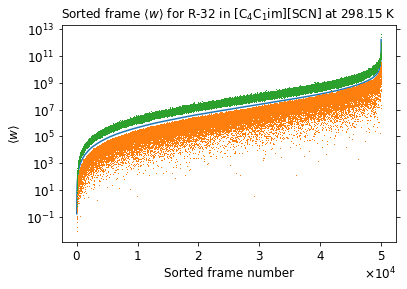

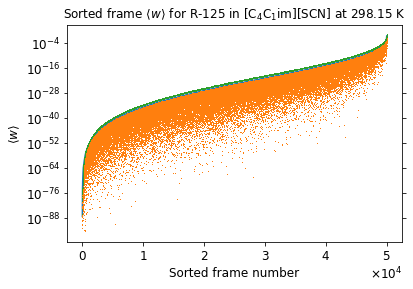

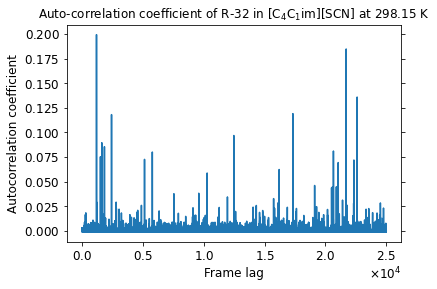

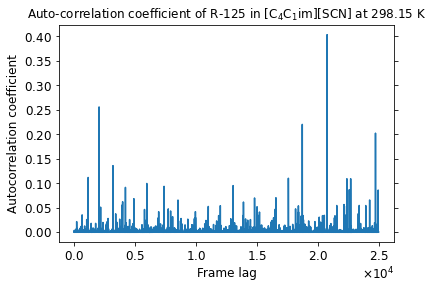

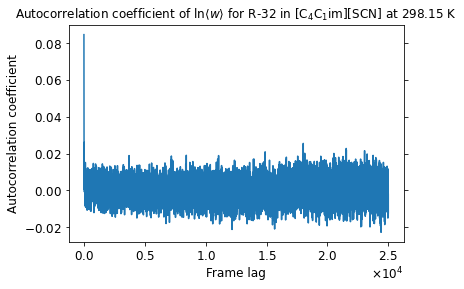

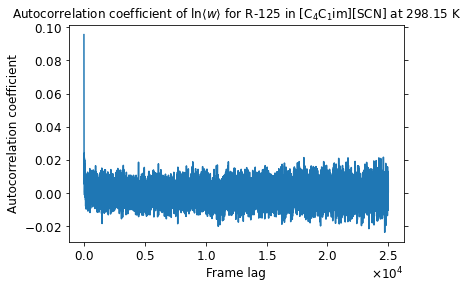

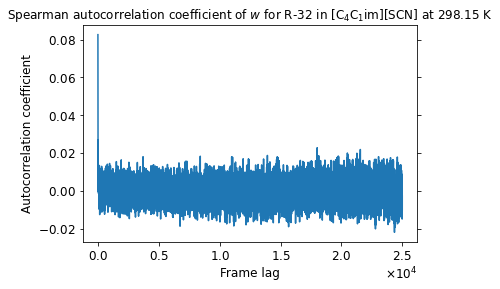

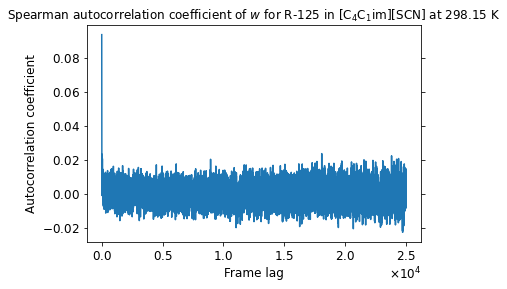

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


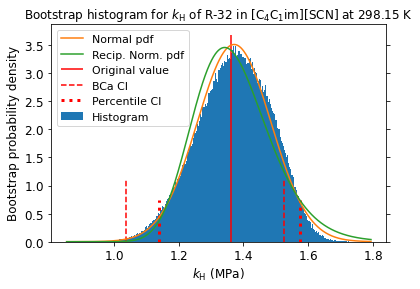

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


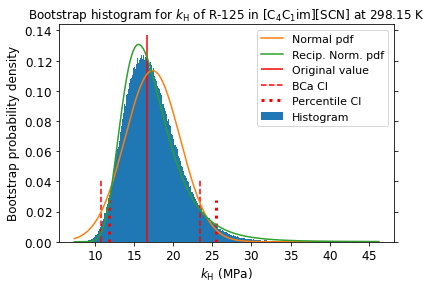

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


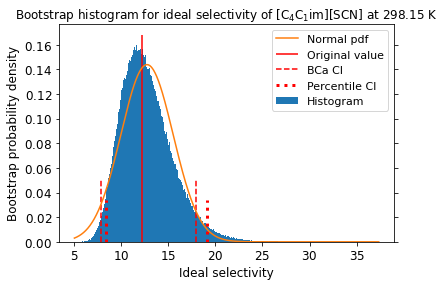

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


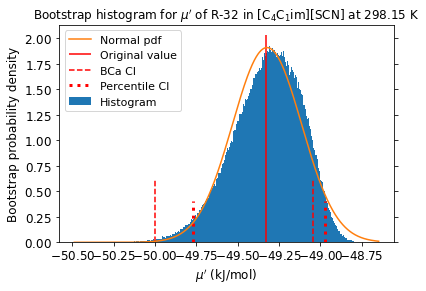

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


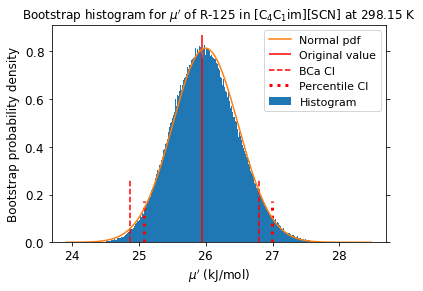

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


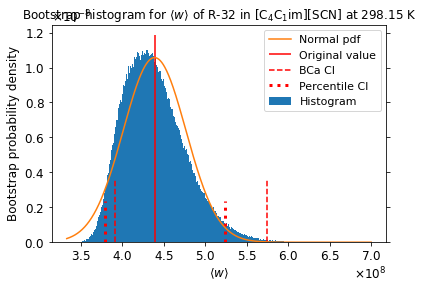

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


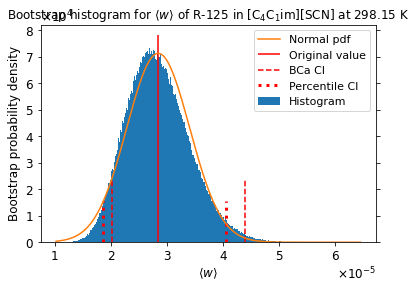

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.006956,0.021652,-0.009246,0.020624
Temp,0.005669,0.000421,-0.006003,0.001621
Volume,0.035328,0.162238,0.009179,0.182023
Press,0.000996,-0.005054,-0.004146,-0.005382
PotEng,0.019181,0.069590,0.003372,0.076146
KinEng,0.005669,0.000421,-0.006003,0.001621
TotEng,0.018166,0.052699,-0.001396,0.058425
E_pair,0.031087,0.113896,0.006862,0.115227
E_vdwl,0.029712,0.107489,0.002754,0.112746
E_coul,0.011885,0.047791,0.007427,0.045667


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.020647,0.020647,0.021185,0.021185
Temp,-0.000022,-0.000022,0.000925,0.000925
Volume,0.152421,0.152421,0.169815,0.169815
Press,-0.006468,-0.006468,-0.004445,-0.004445
PotEng,0.064743,0.064743,0.071881,0.071881
KinEng,-0.000022,-0.000022,0.000925,0.000925
TotEng,0.048831,0.048831,0.054591,0.054591
E_pair,0.107388,0.107388,0.104428,0.104428
E_vdwl,0.101174,0.101174,0.103580,0.103580
E_coul,0.045056,0.045056,0.041209,0.041209


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.013748,0.013748,0.014095,0.014095
Temp,-0.000013,-0.000013,0.000616,0.000616
Volume,0.101970,0.101970,0.113763,0.113763
Press,-0.004327,-0.004327,-0.002976,-0.002976
PotEng,0.043153,0.043153,0.047933,0.047933
KinEng,-0.000013,-0.000013,0.000616,0.000616
TotEng,0.032550,0.032550,0.036384,0.036384
E_pair,0.071562,0.071562,0.069782,0.069782
E_vdwl,0.067571,0.067571,0.069211,0.069211
E_coul,0.029985,0.029985,0.027504,0.027504


R-32 w column correlation (first 5 columns):
 [[1.         0.01642778 0.00572564 0.01005609 0.00834105]
 [0.01642778 1.         0.02001384 0.00520182 0.03277801]
 [0.00572564 0.02001384 1.         0.013267   0.02537419]
 [0.01005609 0.00520182 0.013267   1.         0.02319268]
 [0.00834105 0.03277801 0.02537419 0.02319268 1.        ]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.35610545 0.35506125 0.36413449 0.35418701]
 [0.35610545 1.         0.34782106 0.36043301 0.35134157]
 [0.35506125 0.34782106 1.         0.36214669 0.35698583]
 [0.36413449 0.36043301 0.36214669 1.         0.35769594]
 [0.35418701 0.35134157 0.35698583 0.35769594 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.34810547 0.34574279 0.35272682 0.34637824]
 [0.34810547 1.         0.34130863 0.35010238 0.3422042 ]
 [0.34574279 0.34130863 1.         0.35252646 0.34917114]
 [0.35272682 0.35010238 0.35252646 1.         0.34694475]
 [0.34637824 0.3422042  0.34917114

10 highest observations are:

[[8.31075619e+10 7.70575956e-02]
 [8.37006637e+10 7.99418752e-02]
 [9.41073526e+10 8.74125361e-02]
 [9.48115508e+10 9.17910605e-02]
 [9.55310619e+10 1.00043527e-01]
 [9.62601531e+10 1.01314410e-01]
 [1.04105160e+11 1.08388172e-01]
 [1.15155760e+11 1.78328805e-01]
 [1.26323504e+11 2.51621206e-01]
 [4.68081143e+11 2.98253890e-01]]
with indices:

[[20653 28083]
 [15842 16135]
 [34277 18229]
 [47395 46516]
 [43326  3804]
 [ 9005  2014]
 [31579 18724]
 [28508 24627]
 [47133 10945]
 [42249 11777]]


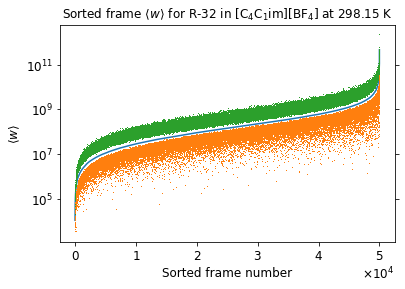

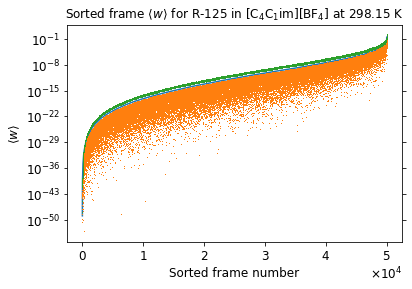

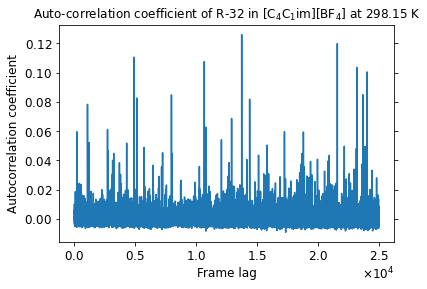

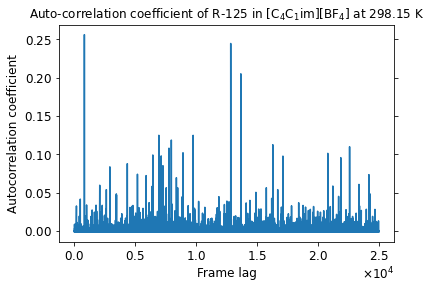

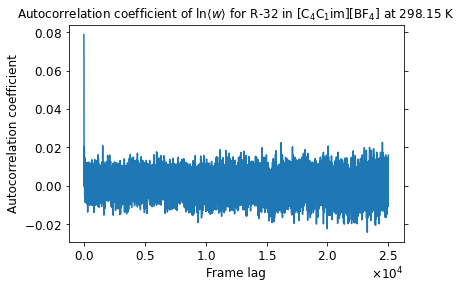

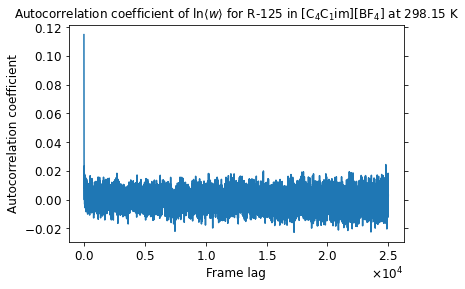

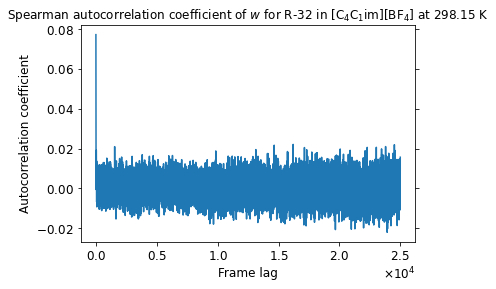

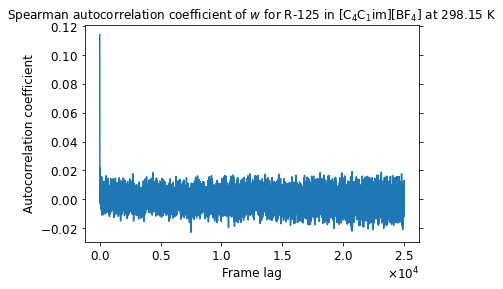

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


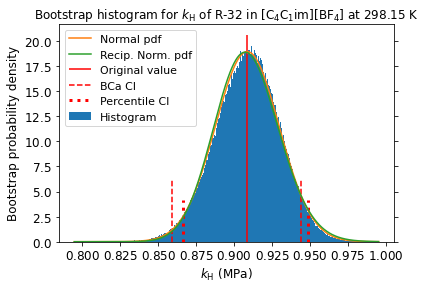

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


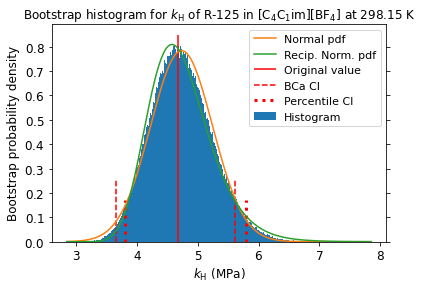

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


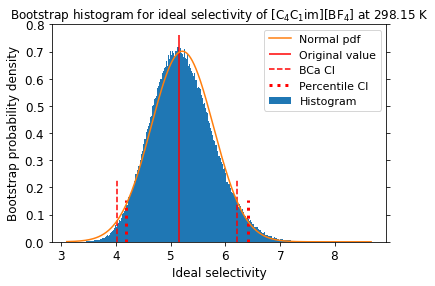

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


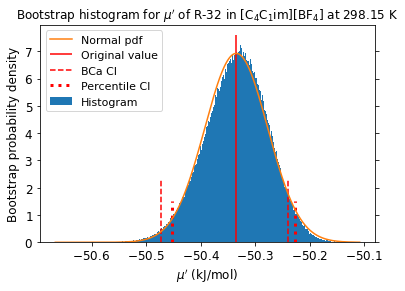

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


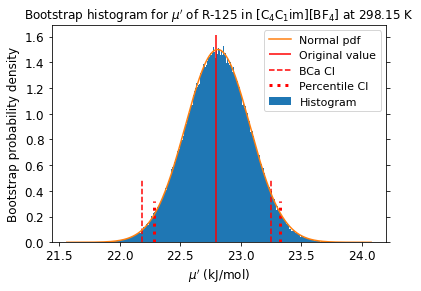

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


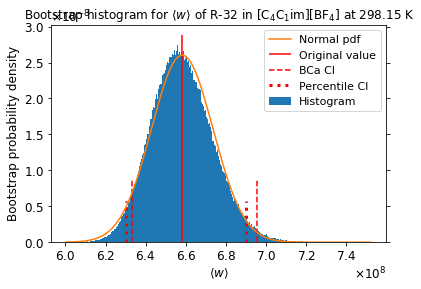

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


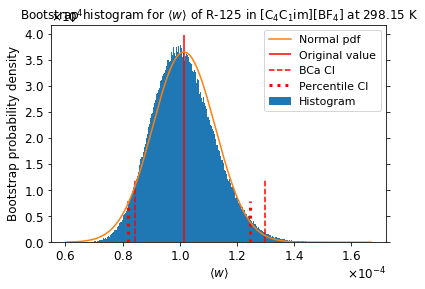

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.002158,0.004577,0.002468,0.007268
Temp,0.006965,0.003623,-0.000712,0.001125
Volume,0.027982,0.161962,0.011604,0.181858
Press,0.002778,-0.002157,-0.002155,-0.006413
PotEng,0.006804,0.063166,0.003224,0.064404
KinEng,0.006965,0.003623,-0.000712,0.001125
TotEng,0.009700,0.050108,0.001971,0.049409
E_pair,0.025717,0.116558,0.004153,0.115254
E_vdwl,0.025207,0.111302,0.006832,0.120452
E_coul,0.008295,0.050344,-0.001862,0.038348


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.003847,0.003847,0.007230,0.007230
Temp,0.002414,0.002414,0.000584,0.000584
Volume,0.155282,0.155282,0.165196,0.165196
Press,-0.000772,-0.000772,-0.002708,-0.002708
PotEng,0.061961,0.061961,0.057922,0.057922
KinEng,0.002414,0.002414,0.000584,0.000584
TotEng,0.047479,0.047479,0.045526,0.045526
E_pair,0.109666,0.109666,0.103770,0.103770
E_vdwl,0.103526,0.103526,0.108943,0.108943
E_coul,0.047764,0.047764,0.033126,0.033126


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.002574,0.002574,0.004847,0.004847
Temp,0.001612,0.001612,0.000381,0.000381
Volume,0.103974,0.103974,0.110647,0.110647
Press,-0.000508,-0.000508,-0.001805,-0.001805
PotEng,0.041367,0.041367,0.038653,0.038653
KinEng,0.001612,0.001612,0.000381,0.000381
TotEng,0.031751,0.031751,0.030426,0.030426
E_pair,0.073315,0.073315,0.069298,0.069298
E_vdwl,0.069218,0.069218,0.072786,0.072786
E_coul,0.031919,0.031919,0.022113,0.022113


R-32 w column correlation (first 5 columns):
 [[1.         0.00208979 0.0143919  0.00468749 0.00436689]
 [0.00208979 1.         0.00658631 0.00888344 0.00441957]
 [0.0143919  0.00658631 1.         0.01681707 0.00958775]
 [0.00468749 0.00888344 0.01681707 1.         0.00426914]
 [0.00436689 0.00441957 0.00958775 0.00426914 1.        ]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.33178313 0.33604073 0.32870706 0.33425826]
 [0.33178313 1.         0.3226715  0.32877332 0.32903066]
 [0.33604073 0.3226715  1.         0.33497411 0.33801888]
 [0.32870706 0.32877332 0.33497411 1.         0.33388231]
 [0.33425826 0.32903066 0.33801888 0.33388231 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.32080252 0.32493697 0.31802404 0.32727066]
 [0.32080252 1.         0.31345278 0.31838606 0.31727375]
 [0.32493697 0.31345278 1.         0.32368651 0.33134781]
 [0.31802404 0.31838606 0.32368651 1.         0.32533996]
 [0.32727066 0.31727375 0.33134781

10 highest observations are:

[[8.51581308e+10 6.18154356e-02]
 [9.10339641e+10 6.62930208e-02]
 [9.36409898e+10 7.10759970e-02]
 [9.50189558e+10 7.66001224e-02]
 [9.59050718e+10 8.19451036e-02]
 [9.76975578e+10 8.46112043e-02]
 [1.01610471e+11 1.01821256e-01]
 [1.13030138e+11 1.02714532e-01]
 [1.47672563e+11 1.22060963e-01]
 [1.62001452e+11 1.31441542e-01]]
with indices:

[[19246 45994]
 [32092 49143]
 [37641 46793]
 [28022  1080]
 [24760 15826]
 [ 3034  2056]
 [18004 22460]
 [ 7204 37993]
 [38305 27482]
 [42405 35931]]


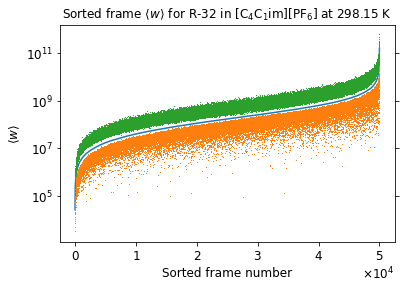

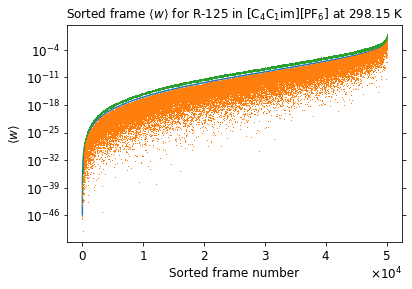

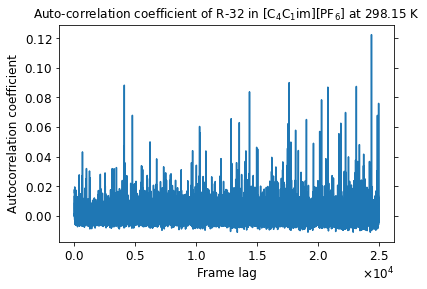

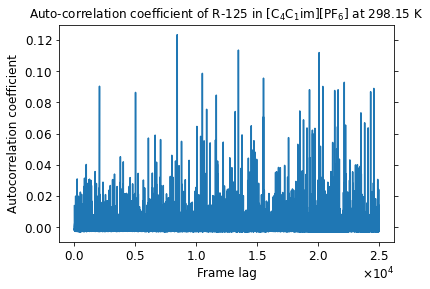

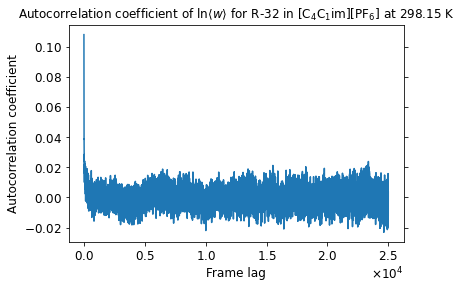

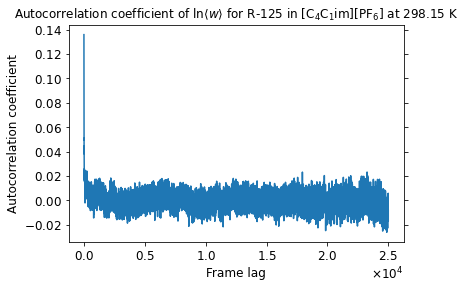

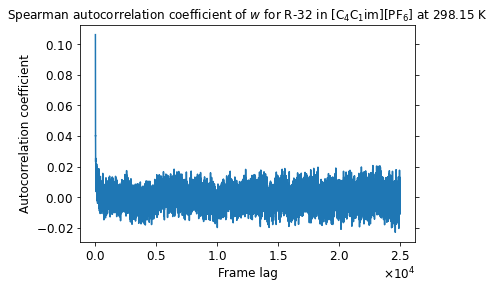

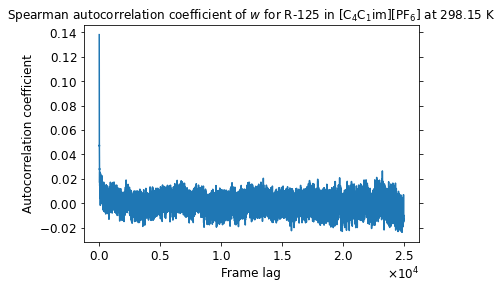

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


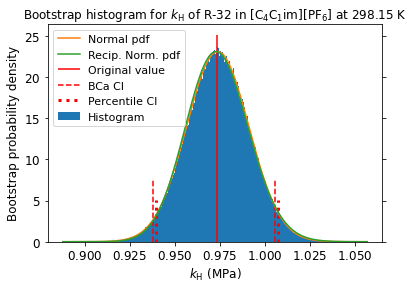

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


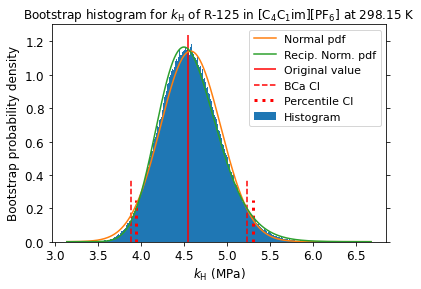

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


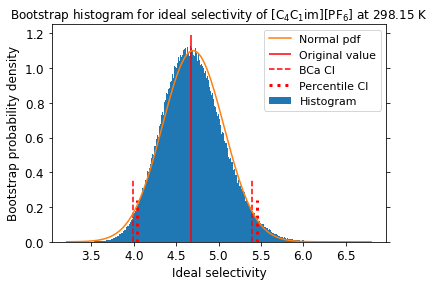

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


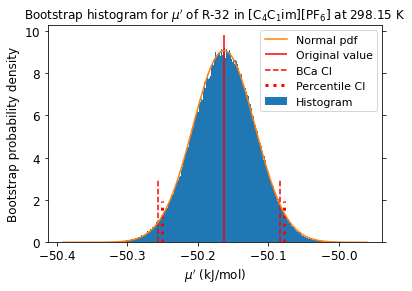

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


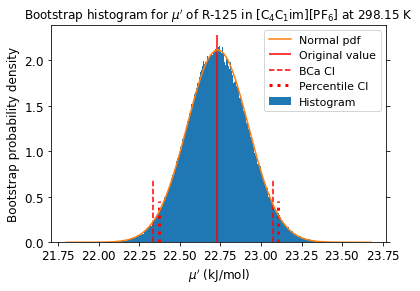

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


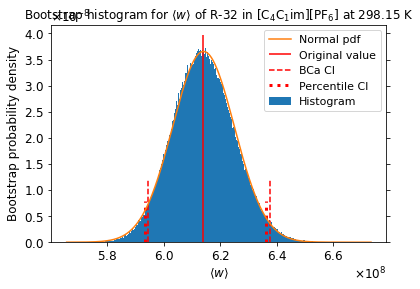

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


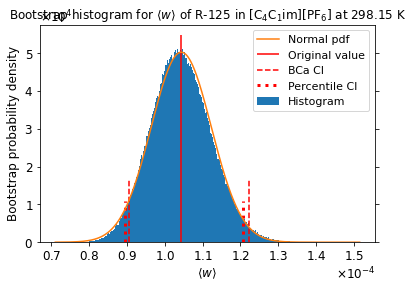

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.001807,0.003506,0.004717,0.015468
Temp,0.003944,-0.003004,0.004393,-0.002556
Volume,0.026730,0.162997,0.009428,0.176513
Press,0.001577,0.006428,0.003256,0.001321
PotEng,0.014599,0.059125,0.011866,0.054732
KinEng,0.003944,-0.003004,0.004393,-0.002556
TotEng,0.013608,0.042686,0.011838,0.039662
E_pair,0.025957,0.116690,0.006516,0.102916
E_vdwl,0.018604,0.101042,0.005866,0.103259
E_coul,0.015427,0.056412,0.003043,0.034245


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.004462,0.004462,0.017212,0.017212
Temp,-0.001332,-0.001332,0.002739,0.002739
Volume,0.153190,0.153190,0.161776,0.161776
Press,0.007574,0.007574,0.004014,0.004014
PotEng,0.055965,0.055965,0.049383,0.049383
KinEng,-0.001332,-0.001332,0.002739,0.002739
TotEng,0.041184,0.041184,0.038992,0.038992
E_pair,0.110738,0.110738,0.093703,0.093703
E_vdwl,0.095714,0.095714,0.094951,0.094951
E_coul,0.052554,0.052554,0.032250,0.032250


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.002960,0.002960,0.011492,0.011492
Temp,-0.000902,-0.000902,0.001841,0.001841
Volume,0.102411,0.102411,0.108368,0.108368
Press,0.005059,0.005059,0.002663,0.002663
PotEng,0.037338,0.037338,0.032889,0.032889
KinEng,-0.000902,-0.000902,0.001841,0.001841
TotEng,0.027433,0.027433,0.025977,0.025977
E_pair,0.073976,0.073976,0.062607,0.062607
E_vdwl,0.063916,0.063916,0.063527,0.063527
E_coul,0.035073,0.035073,0.021520,0.021520


R-32 w column correlation (first 5 columns):
 [[1.00000000e+00 3.37353917e-03 3.02665117e-04 5.97665611e-04
  2.78675990e-03]
 [3.37353917e-03 1.00000000e+00 5.42153853e-03 7.96431386e-03
  1.01957834e-02]
 [3.02665117e-04 5.42153853e-03 1.00000000e+00 2.46600347e-03
  4.57262377e-03]
 [5.97665611e-04 7.96431386e-03 2.46600347e-03 1.00000000e+00
  2.59922840e-03]
 [2.78675990e-03 1.01957834e-02 4.57262377e-03 2.59922840e-03
  1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.318909   0.31719986 0.32419942 0.31472287]
 [0.318909   1.         0.31897106 0.3214289  0.32059951]
 [0.31719986 0.31897106 1.         0.32135282 0.31746543]
 [0.32419942 0.3214289  0.32135282 1.         0.3292529 ]
 [0.31472287 0.32059951 0.31746543 0.3292529  1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.30839516 0.30642359 0.31470662 0.30407131]
 [0.30839516 1.         0.30783769 0.3111281  0.30951924]
 [0.30642359 0.30783769 1.         0.306

10 highest observations are:

[[1.20907498e+11 1.03187588e-01]
 [1.22996875e+11 1.14756811e-01]
 [1.44225570e+11 1.31222858e-01]
 [1.45583462e+11 1.38146381e-01]
 [1.59513198e+11 1.40287536e-01]
 [1.67372986e+11 1.47426401e-01]
 [1.67936217e+11 2.10616171e-01]
 [2.06811651e+11 3.97723425e-01]
 [2.81827635e+11 4.11894827e-01]
 [5.15439732e+11 4.33631091e-01]]
with indices:

[[48898 21664]
 [32715 33106]
 [10356  7280]
 [31804 17328]
 [38359  9140]
 [ 5818 44989]
 [ 9258 35347]
 [26287 43287]
 [27848 38359]
 [45570 34330]]


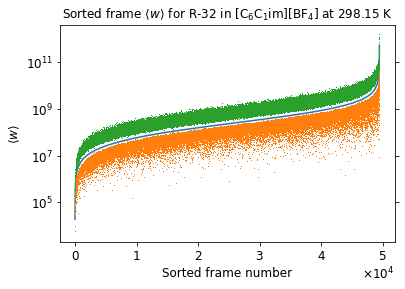

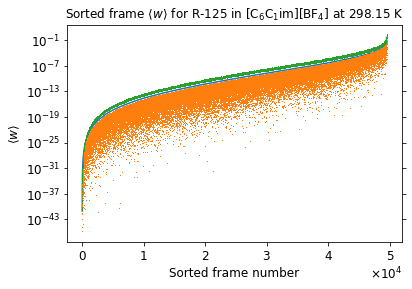

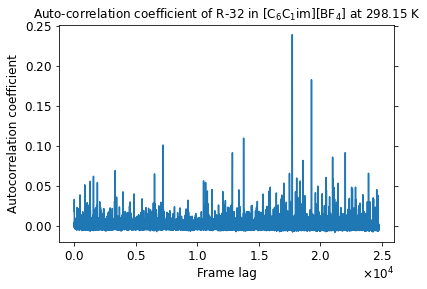

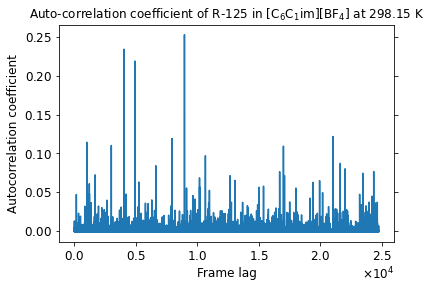

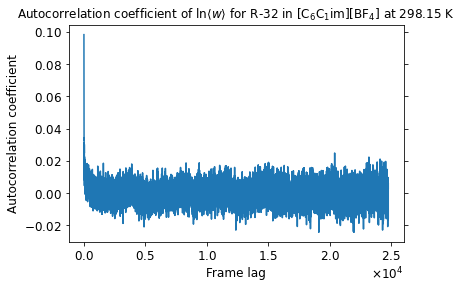

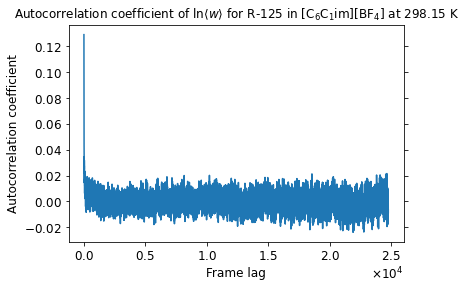

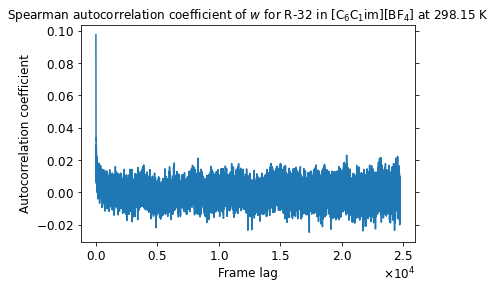

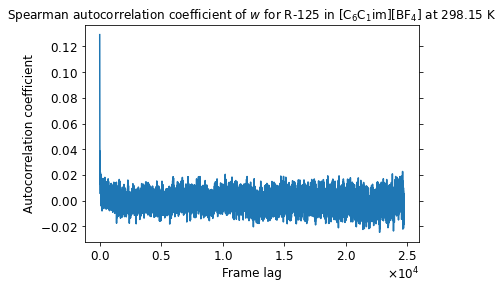

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


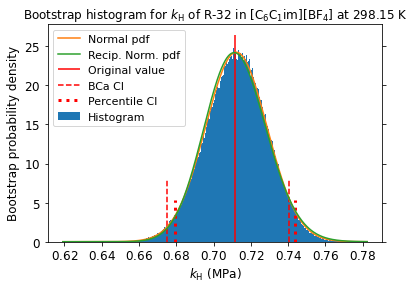

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


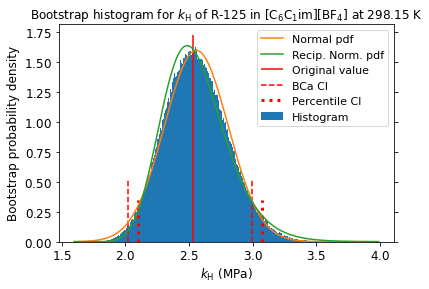

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


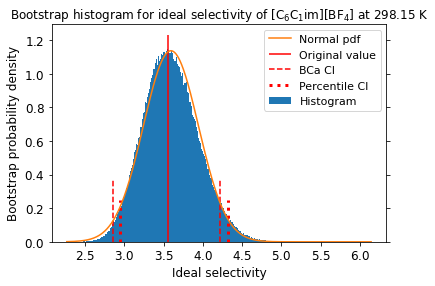

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


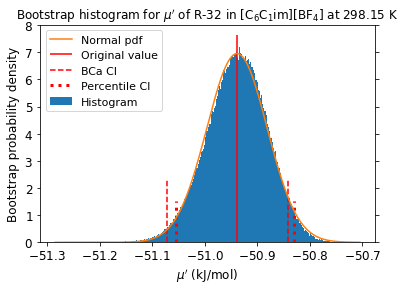

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


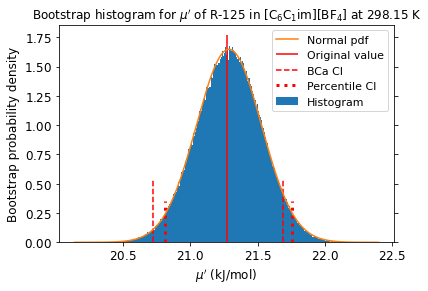

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


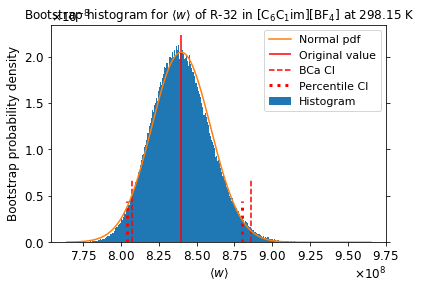

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


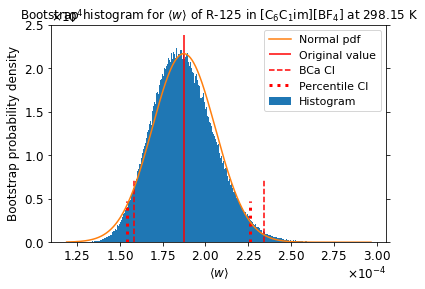

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.010142,-0.042443,-0.003951,-0.024002
Temp,0.006332,-0.004469,0.004769,-0.003577
Volume,0.010333,0.153720,0.011489,0.178021
Press,0.006498,-0.005343,0.000843,-0.015675
PotEng,0.010478,0.061507,0.002521,0.064417
KinEng,0.006332,-0.004469,0.004769,-0.003577
TotEng,0.012077,0.044138,0.004990,0.046936
E_pair,0.016953,0.104596,0.003405,0.103108
E_vdwl,0.014011,0.087658,0.004799,0.092977
E_coul,0.005687,0.041116,-0.000415,0.034595


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.042601,-0.042601,-0.022033,-0.022033
Temp,-0.003862,-0.003862,-0.000958,-0.000958
Volume,0.144626,0.144626,0.164732,0.164732
Press,-0.002801,-0.002801,-0.013318,-0.013318
PotEng,0.057813,0.057813,0.061866,0.061866
KinEng,-0.003862,-0.003862,-0.000958,-0.000958
TotEng,0.040270,0.040270,0.045484,0.045484
E_pair,0.099408,0.099408,0.095486,0.095486
E_vdwl,0.082699,0.082699,0.087147,0.087147
E_coul,0.038998,0.038998,0.033357,0.033357


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.028260,-0.028260,-0.014806,-0.014806
Temp,-0.002574,-0.002574,-0.000617,-0.000617
Volume,0.096811,0.096811,0.110275,0.110275
Press,-0.001861,-0.001861,-0.008864,-0.008864
PotEng,0.038573,0.038573,0.041249,0.041249
KinEng,-0.002574,-0.002574,-0.000617,-0.000617
TotEng,0.026857,0.026857,0.030332,0.030332
E_pair,0.066409,0.066409,0.063781,0.063781
E_vdwl,0.055198,0.055198,0.058116,0.058116
E_coul,0.026009,0.026009,0.022246,0.022246


R-32 w column correlation (first 5 columns):
 [[1.00000000e+00 2.60189185e-02 9.02132467e-04 2.27271635e-03
  2.03915318e-04]
 [2.60189185e-02 1.00000000e+00 8.91733316e-04 5.15794091e-03
  9.16802274e-04]
 [9.02132467e-04 8.91733316e-04 1.00000000e+00 6.97762298e-04
  1.87620218e-03]
 [2.27271635e-03 5.15794091e-03 6.97762298e-04 1.00000000e+00
  3.19696899e-03]
 [2.03915318e-04 9.16802274e-04 1.87620218e-03 3.19696899e-03
  1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.34911671 0.34901315 0.35241552 0.350182  ]
 [0.34911671 1.         0.35135649 0.35170916 0.35635999]
 [0.34901315 0.35135649 1.         0.34450559 0.35282386]
 [0.35241552 0.35170916 0.34450559 1.         0.35089901]
 [0.350182   0.35635999 0.35282386 0.35089901 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.34257156 0.33929046 0.34146324 0.34177178]
 [0.34257156 1.         0.34279211 0.34389884 0.34533863]
 [0.33929046 0.34279211 1.         0.338

10 highest observations are:

[[3.18061126e+11 2.72862130e-01]
 [3.21557935e+11 2.75879862e-01]
 [3.28295740e+11 2.84463769e-01]
 [5.17281390e+11 3.10209185e-01]
 [6.58509082e+11 3.64682417e-01]
 [8.36280959e+11 3.85909198e-01]
 [1.09090197e+12 3.89480392e-01]
 [1.54065741e+12 7.48228467e-01]
 [3.03899257e+12 7.71312125e-01]
 [4.55890015e+12 1.61112123e+00]]
with indices:

[[34062 11738]
 [18476 47963]
 [28592    90]
 [14671 11695]
 [28419  4873]
 [15540 31735]
 [34033 13224]
 [12722 30500]
 [15321 37035]
 [ 7061 17277]]


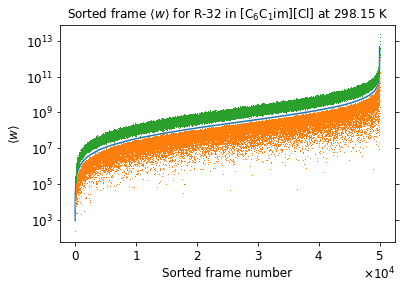

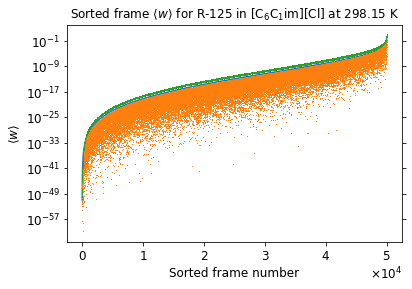

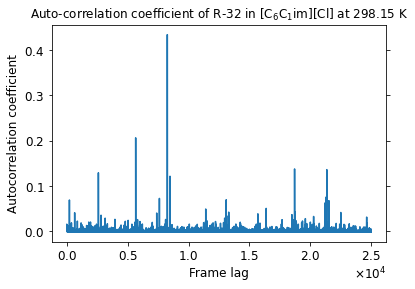

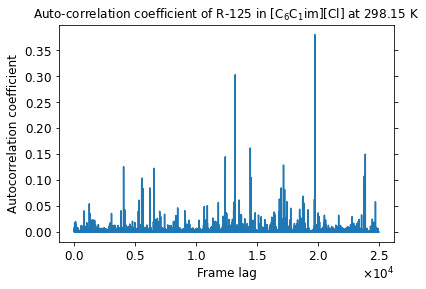

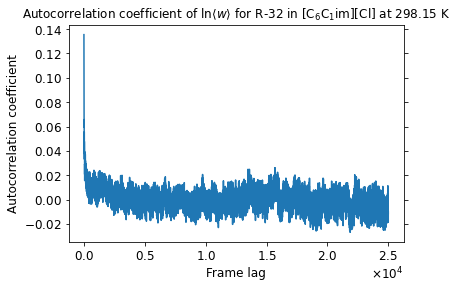

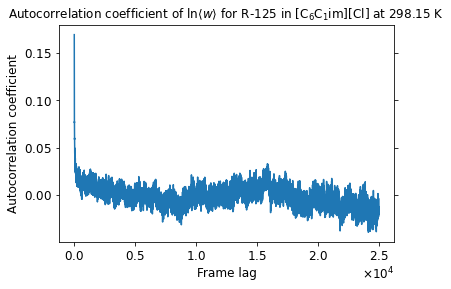

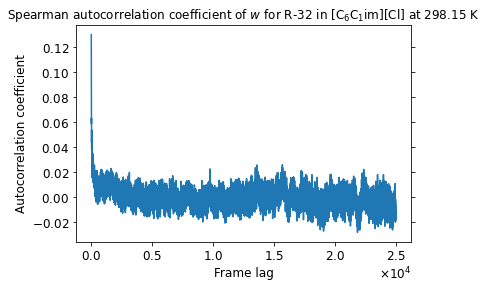

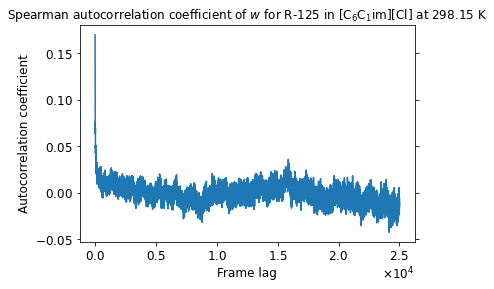

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


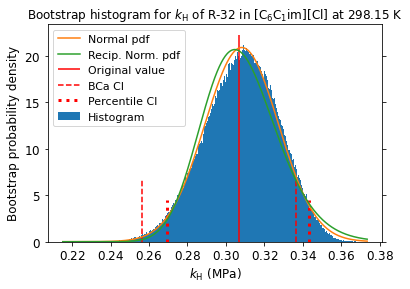

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


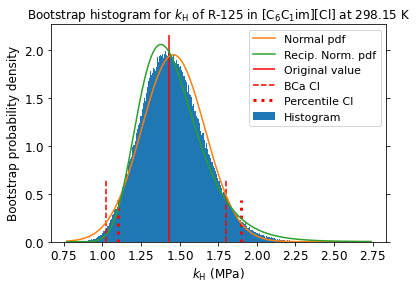

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


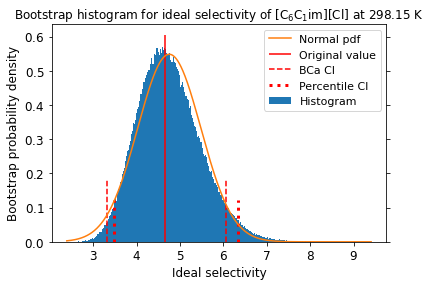

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


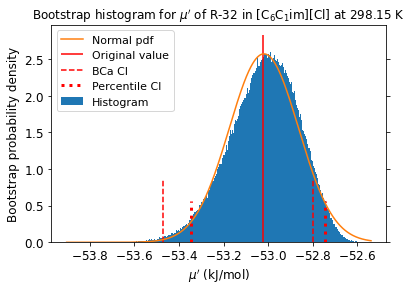

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


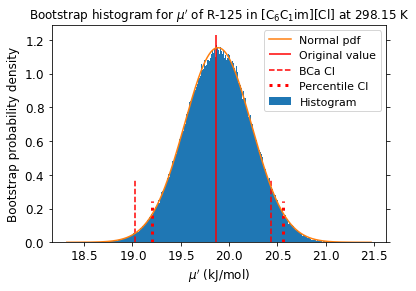

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


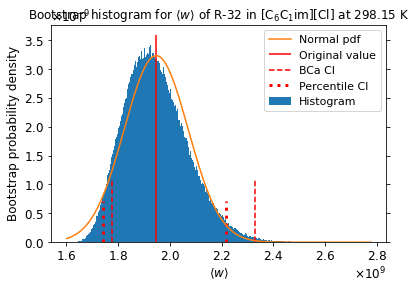

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


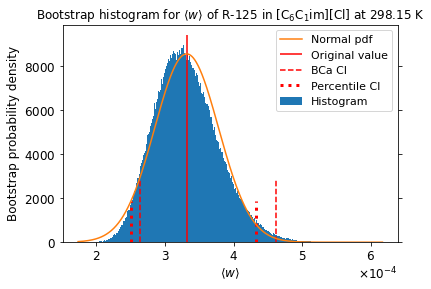

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


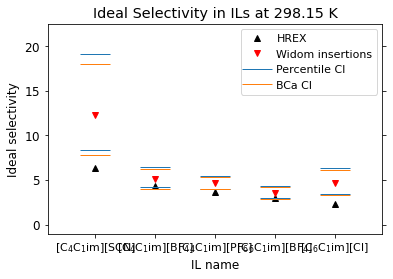

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


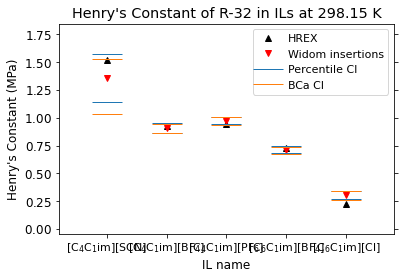

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


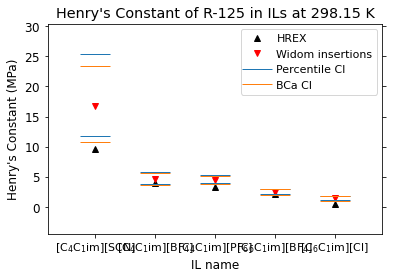

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


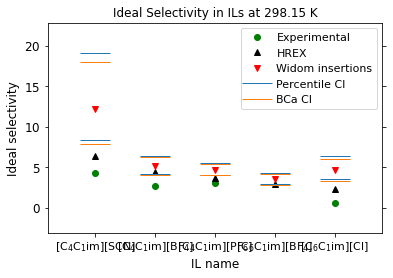

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


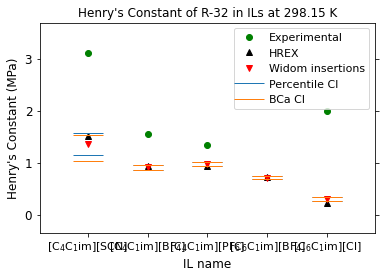

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


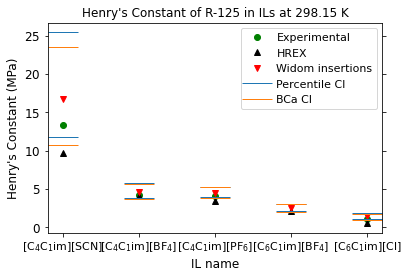

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


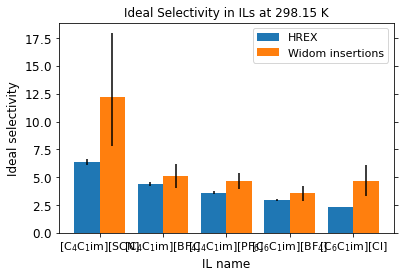

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


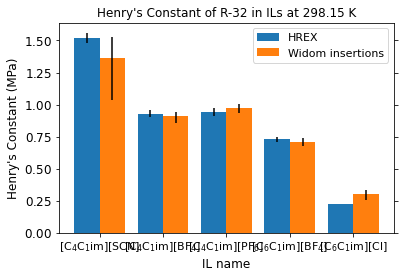

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


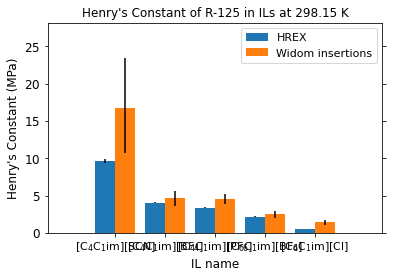

In [94]:
plot_results("Eij_max_estimation_1/vbs", "Eij_max_estimation_1", get_fbs=True, get_corr=True)

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.009593,-0.000408,-0.003801,-0.004264
Temp,0.012135,0.005719,-0.004614,-0.002846
Volume,0.005957,0.156410,0.003950,0.174771
Press,-0.002372,-0.010923,-0.002049,-0.010573
PotEng,0.000200,0.067640,0.000143,0.074838
KinEng,0.012135,0.005719,-0.004614,-0.002846
TotEng,0.008064,0.054889,-0.002900,0.054748
E_pair,0.006435,0.107356,0.003844,0.108709
E_vdwl,-0.001151,0.099502,0.002334,0.104679
E_coul,0.010951,0.044706,0.003831,0.041516


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.000265,-0.000265,-0.005701,-0.005701
Temp,0.004139,0.004139,-0.004361,-0.004361
Volume,0.144727,0.144727,0.160629,0.160629
Press,-0.010327,-0.010327,-0.010134,-0.010134
PotEng,0.060614,0.060614,0.067692,0.067692
KinEng,0.004139,0.004139,-0.004361,-0.004361
TotEng,0.048131,0.048131,0.048443,0.048443
E_pair,0.098088,0.098088,0.098777,0.098777
E_vdwl,0.091115,0.091115,0.096069,0.096069
E_coul,0.039793,0.039793,0.035089,0.035089


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.000154,-0.000154,-0.003810,-0.003810
Temp,0.002776,0.002776,-0.002917,-0.002917
Volume,0.096975,0.096975,0.107572,0.107572
Press,-0.006881,-0.006881,-0.006757,-0.006757
PotEng,0.040437,0.040437,0.045129,0.045129
KinEng,0.002776,0.002776,-0.002918,-0.002918
TotEng,0.032125,0.032125,0.032278,0.032278
E_pair,0.065504,0.065504,0.065943,0.065943
E_vdwl,0.060831,0.060831,0.064129,0.064129
E_coul,0.026555,0.026555,0.023402,0.023402


R-32 w column correlation (first 5 columns):
 [[1.00000000e+00 4.35421836e-03 1.06373402e-03 2.13937644e-03
  8.05801837e-03]
 [4.35421836e-03 1.00000000e+00 4.13247945e-01 3.55550070e-04
  6.30238110e-03]
 [1.06373402e-03 4.13247945e-01 1.00000000e+00 1.38825133e-03
  3.12672603e-03]
 [2.13937644e-03 3.55550070e-04 1.38825133e-03 1.00000000e+00
  9.95103906e-03]
 [8.05801837e-03 6.30238110e-03 3.12672603e-03 9.95103906e-03
  1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.4003562  0.3956163  0.40092154 0.40060193]
 [0.4003562  1.         0.40033316 0.39866978 0.40025258]
 [0.3956163  0.40033316 1.         0.40286882 0.39939541]
 [0.40092154 0.39866978 0.40286882 1.         0.39967267]
 [0.40060193 0.40025258 0.39939541 0.39967267 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.40418504 0.40319857 0.40477497 0.40641997]
 [0.40418504 1.         0.40323465 0.40254934 0.40401274]
 [0.40319857 0.40323465 1.         0.406

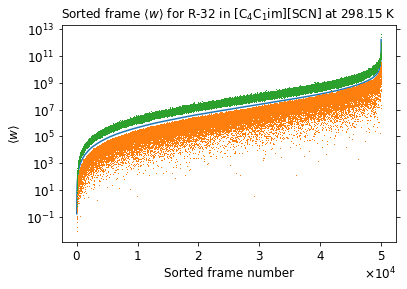

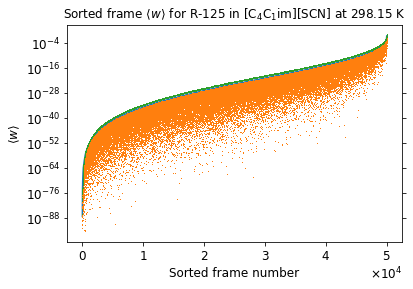

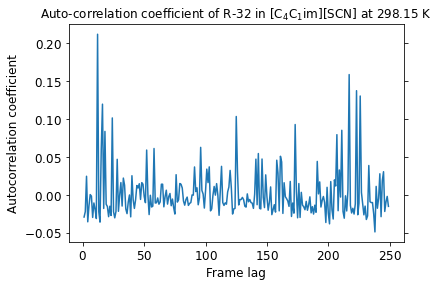

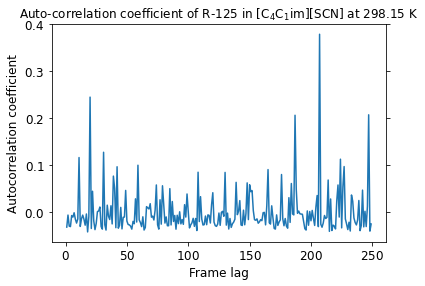

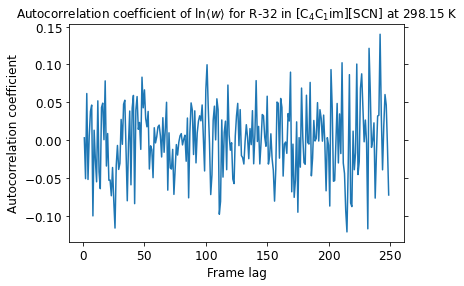

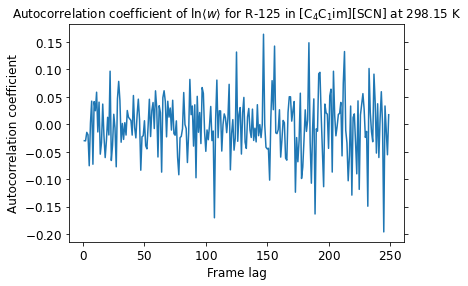

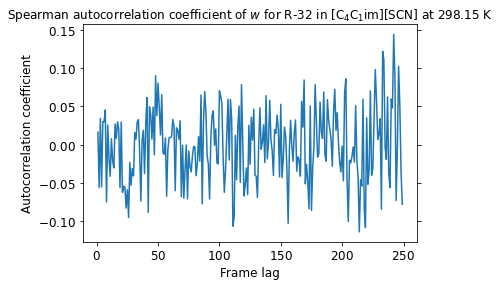

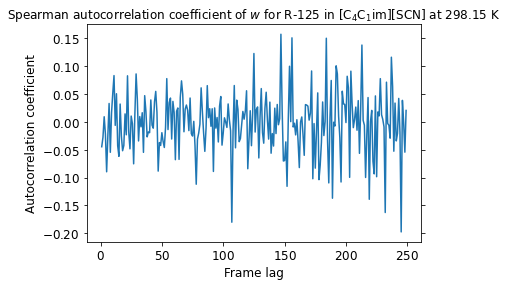

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


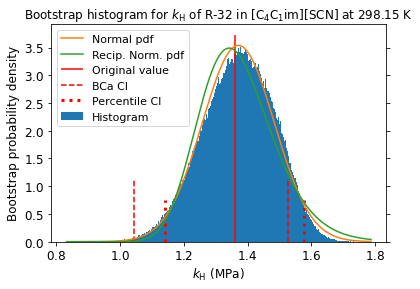

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


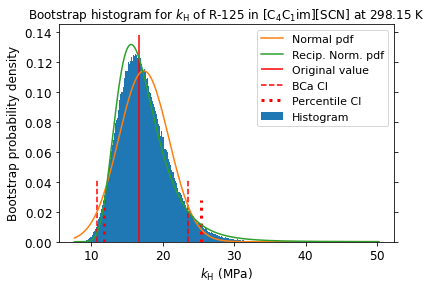

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


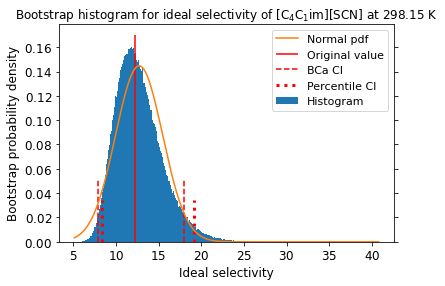

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


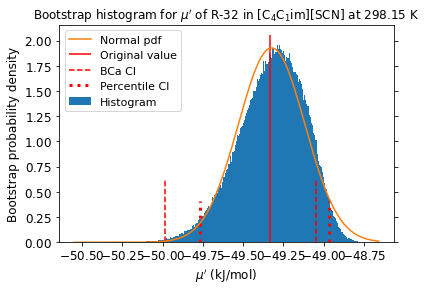

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


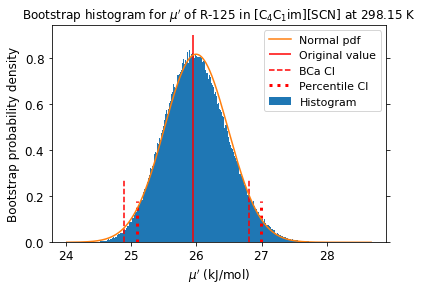

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


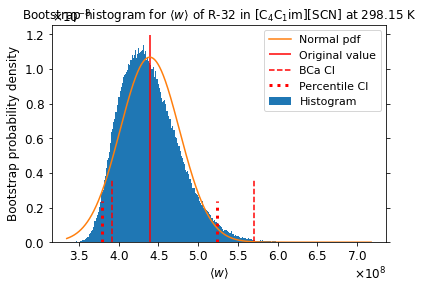

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


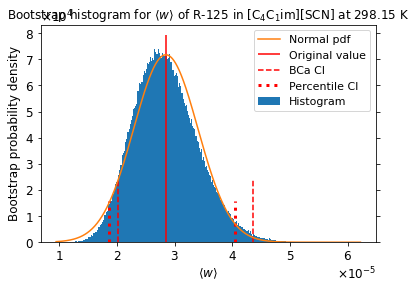

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.006956,0.021652,-0.009246,0.020624
Temp,0.005669,0.000421,-0.006003,0.001621
Volume,0.035328,0.162238,0.009179,0.182023
Press,0.000996,-0.005054,-0.004146,-0.005382
PotEng,0.019181,0.069590,0.003372,0.076146
KinEng,0.005669,0.000421,-0.006003,0.001621
TotEng,0.018166,0.052699,-0.001396,0.058425
E_pair,0.031087,0.113896,0.006862,0.115227
E_vdwl,0.029712,0.107489,0.002754,0.112746
E_coul,0.011885,0.047791,0.007427,0.045667


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.020647,0.020647,0.021185,0.021185
Temp,-0.000022,-0.000022,0.000925,0.000925
Volume,0.152421,0.152421,0.169815,0.169815
Press,-0.006468,-0.006468,-0.004445,-0.004445
PotEng,0.064743,0.064743,0.071881,0.071881
KinEng,-0.000022,-0.000022,0.000925,0.000925
TotEng,0.048831,0.048831,0.054591,0.054591
E_pair,0.107388,0.107388,0.104428,0.104428
E_vdwl,0.101174,0.101174,0.103580,0.103580
E_coul,0.045056,0.045056,0.041209,0.041209


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.013748,0.013748,0.014095,0.014095
Temp,-0.000013,-0.000013,0.000616,0.000616
Volume,0.101970,0.101970,0.113763,0.113763
Press,-0.004327,-0.004327,-0.002976,-0.002976
PotEng,0.043153,0.043153,0.047933,0.047933
KinEng,-0.000013,-0.000013,0.000616,0.000616
TotEng,0.032550,0.032550,0.036384,0.036384
E_pair,0.071562,0.071562,0.069782,0.069782
E_vdwl,0.067571,0.067571,0.069211,0.069211
E_coul,0.029985,0.029985,0.027504,0.027504


R-32 w column correlation (first 5 columns):
 [[1.         0.01642778 0.00572564 0.01005609 0.00834105]
 [0.01642778 1.         0.02001384 0.00520182 0.03277801]
 [0.00572564 0.02001384 1.         0.013267   0.02537419]
 [0.01005609 0.00520182 0.013267   1.         0.02319268]
 [0.00834105 0.03277801 0.02537419 0.02319268 1.        ]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.35610545 0.35506125 0.36413449 0.35418701]
 [0.35610545 1.         0.34782106 0.36043301 0.35134157]
 [0.35506125 0.34782106 1.         0.36214669 0.35698583]
 [0.36413449 0.36043301 0.36214669 1.         0.35769594]
 [0.35418701 0.35134157 0.35698583 0.35769594 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.34810547 0.34574279 0.35272682 0.34637824]
 [0.34810547 1.         0.34130863 0.35010238 0.3422042 ]
 [0.34574279 0.34130863 1.         0.35252646 0.34917114]
 [0.35272682 0.35010238 0.35252646 1.         0.34694475]
 [0.34637824 0.3422042  0.34917114

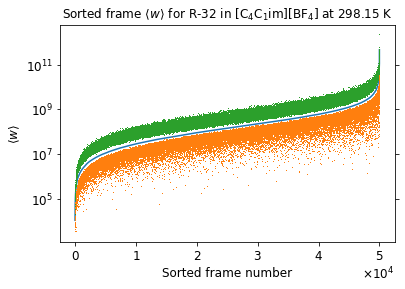

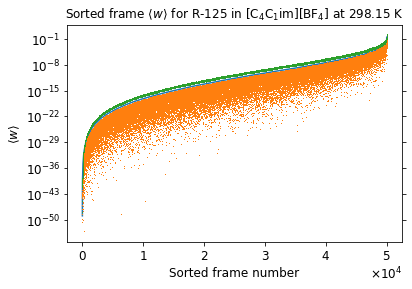

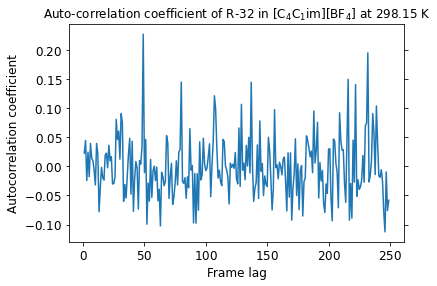

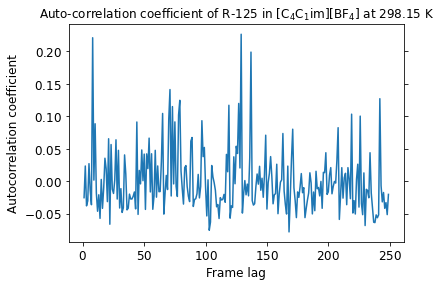

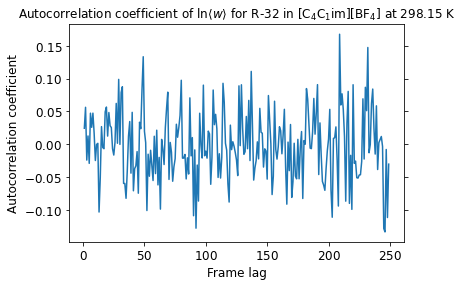

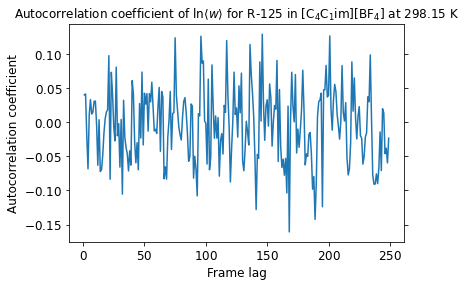

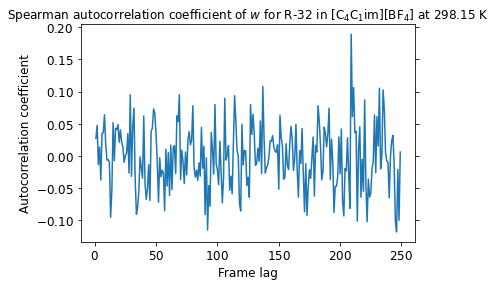

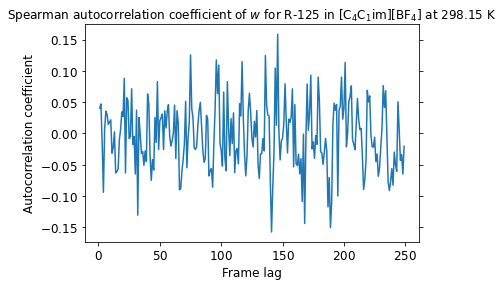

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


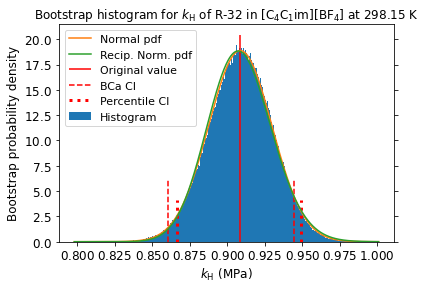

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


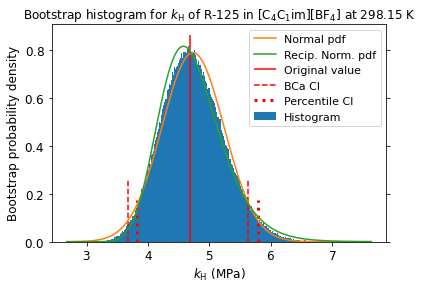

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


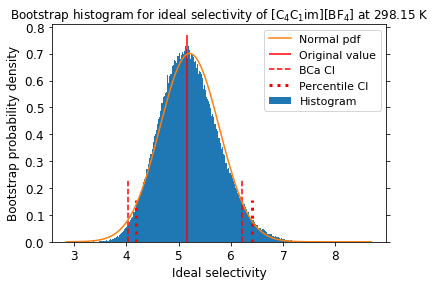

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


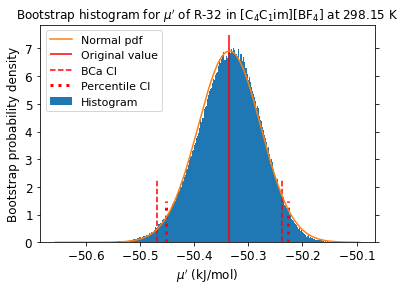

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


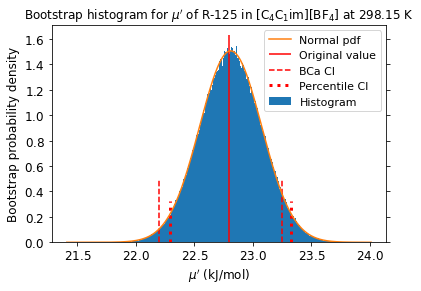

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


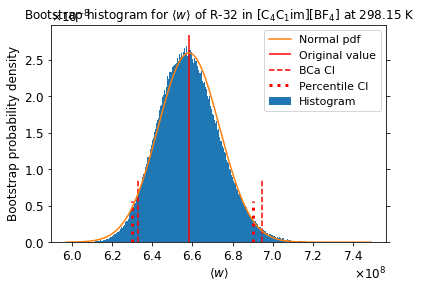

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


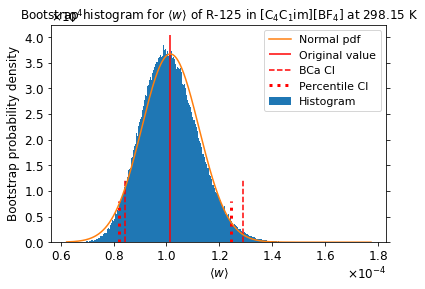

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.002158,0.004577,0.002468,0.007268
Temp,0.006965,0.003623,-0.000712,0.001125
Volume,0.027982,0.161962,0.011604,0.181858
Press,0.002778,-0.002157,-0.002155,-0.006413
PotEng,0.006804,0.063166,0.003224,0.064404
KinEng,0.006965,0.003623,-0.000712,0.001125
TotEng,0.009700,0.050108,0.001971,0.049409
E_pair,0.025717,0.116558,0.004153,0.115254
E_vdwl,0.025207,0.111302,0.006832,0.120452
E_coul,0.008295,0.050344,-0.001862,0.038348


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.003847,0.003847,0.007230,0.007230
Temp,0.002414,0.002414,0.000584,0.000584
Volume,0.155282,0.155282,0.165196,0.165196
Press,-0.000772,-0.000772,-0.002708,-0.002708
PotEng,0.061961,0.061961,0.057922,0.057922
KinEng,0.002414,0.002414,0.000584,0.000584
TotEng,0.047479,0.047479,0.045526,0.045526
E_pair,0.109666,0.109666,0.103770,0.103770
E_vdwl,0.103526,0.103526,0.108943,0.108943
E_coul,0.047764,0.047764,0.033126,0.033126


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.002574,0.002574,0.004847,0.004847
Temp,0.001612,0.001612,0.000381,0.000381
Volume,0.103974,0.103974,0.110647,0.110647
Press,-0.000508,-0.000508,-0.001805,-0.001805
PotEng,0.041367,0.041367,0.038653,0.038653
KinEng,0.001612,0.001612,0.000381,0.000381
TotEng,0.031751,0.031751,0.030426,0.030426
E_pair,0.073315,0.073315,0.069298,0.069298
E_vdwl,0.069218,0.069218,0.072786,0.072786
E_coul,0.031919,0.031919,0.022113,0.022113


R-32 w column correlation (first 5 columns):
 [[1.         0.00208979 0.0143919  0.00468749 0.00436689]
 [0.00208979 1.         0.00658631 0.00888344 0.00441957]
 [0.0143919  0.00658631 1.         0.01681707 0.00958775]
 [0.00468749 0.00888344 0.01681707 1.         0.00426914]
 [0.00436689 0.00441957 0.00958775 0.00426914 1.        ]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.33178313 0.33604073 0.32870706 0.33425826]
 [0.33178313 1.         0.3226715  0.32877332 0.32903066]
 [0.33604073 0.3226715  1.         0.33497411 0.33801888]
 [0.32870706 0.32877332 0.33497411 1.         0.33388231]
 [0.33425826 0.32903066 0.33801888 0.33388231 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.32080252 0.32493697 0.31802404 0.32727066]
 [0.32080252 1.         0.31345278 0.31838606 0.31727375]
 [0.32493697 0.31345278 1.         0.32368651 0.33134781]
 [0.31802404 0.31838606 0.32368651 1.         0.32533996]
 [0.32727066 0.31727375 0.33134781

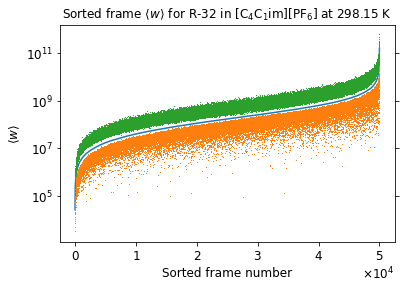

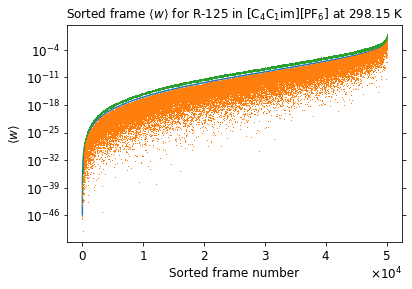

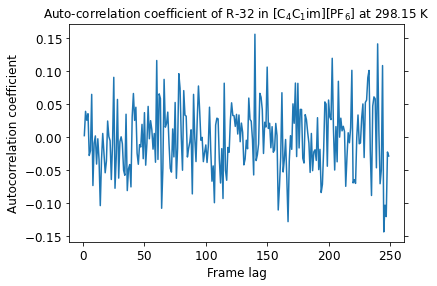

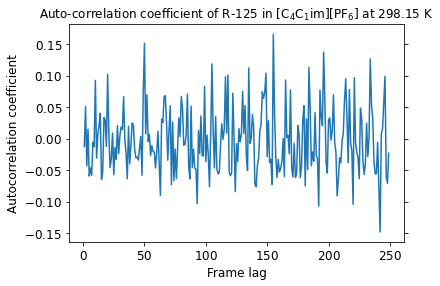

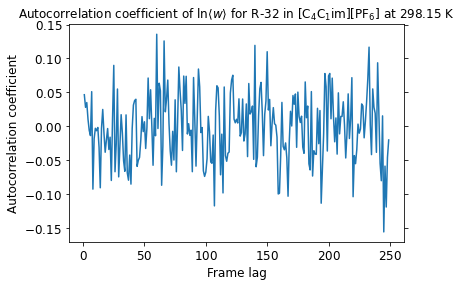

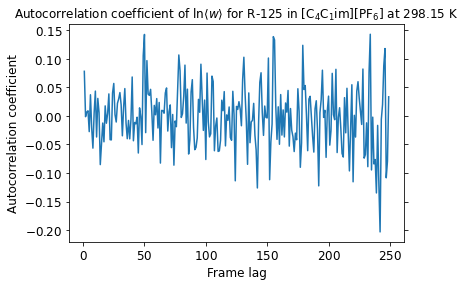

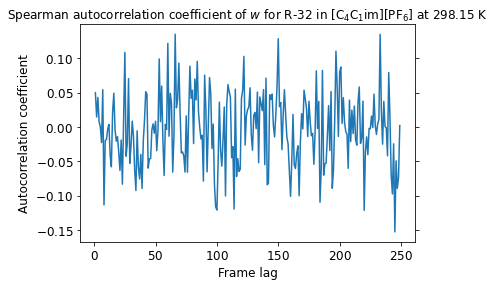

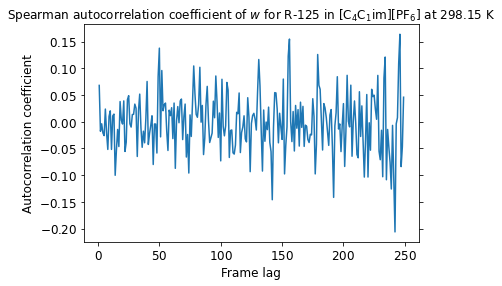

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


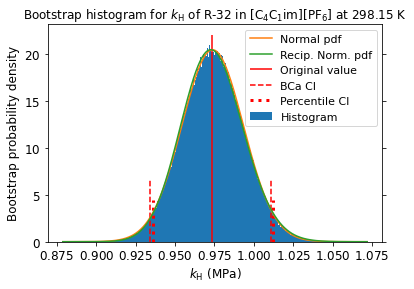

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


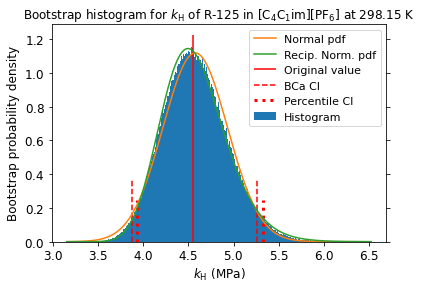

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


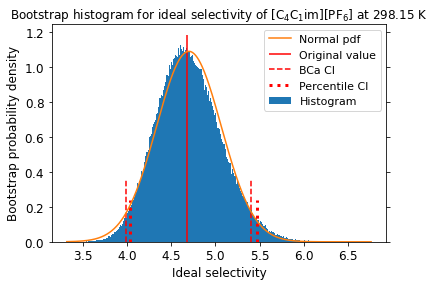

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


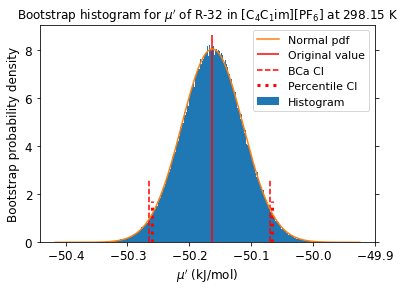

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


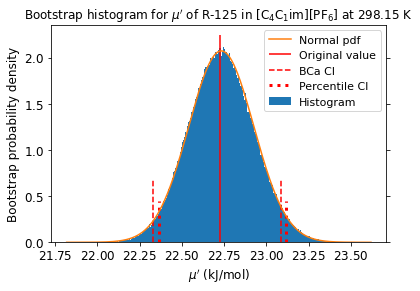

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


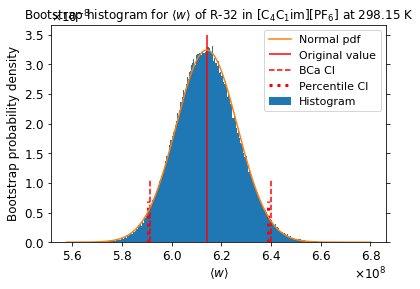

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


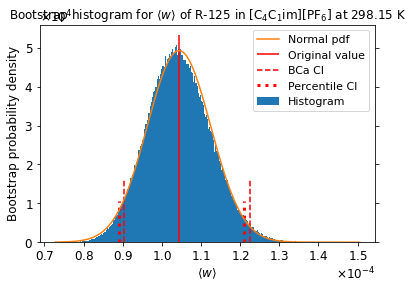

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.001807,0.003506,0.004717,0.015468
Temp,0.003944,-0.003004,0.004393,-0.002556
Volume,0.026730,0.162997,0.009428,0.176513
Press,0.001577,0.006428,0.003256,0.001321
PotEng,0.014599,0.059125,0.011866,0.054732
KinEng,0.003944,-0.003004,0.004393,-0.002556
TotEng,0.013608,0.042686,0.011838,0.039662
E_pair,0.025957,0.116690,0.006516,0.102916
E_vdwl,0.018604,0.101042,0.005866,0.103259
E_coul,0.015427,0.056412,0.003043,0.034245


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.004462,0.004462,0.017212,0.017212
Temp,-0.001332,-0.001332,0.002739,0.002739
Volume,0.153190,0.153190,0.161776,0.161776
Press,0.007574,0.007574,0.004014,0.004014
PotEng,0.055965,0.055965,0.049383,0.049383
KinEng,-0.001332,-0.001332,0.002739,0.002739
TotEng,0.041184,0.041184,0.038992,0.038992
E_pair,0.110738,0.110738,0.093703,0.093703
E_vdwl,0.095714,0.095714,0.094951,0.094951
E_coul,0.052554,0.052554,0.032250,0.032250


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.002960,0.002960,0.011492,0.011492
Temp,-0.000902,-0.000902,0.001841,0.001841
Volume,0.102411,0.102411,0.108368,0.108368
Press,0.005059,0.005059,0.002663,0.002663
PotEng,0.037338,0.037338,0.032889,0.032889
KinEng,-0.000902,-0.000902,0.001841,0.001841
TotEng,0.027433,0.027433,0.025977,0.025977
E_pair,0.073976,0.073976,0.062607,0.062607
E_vdwl,0.063916,0.063916,0.063527,0.063527
E_coul,0.035073,0.035073,0.021520,0.021520


R-32 w column correlation (first 5 columns):
 [[1.00000000e+00 3.37353917e-03 3.02665117e-04 5.97665611e-04
  2.78675990e-03]
 [3.37353917e-03 1.00000000e+00 5.42153853e-03 7.96431386e-03
  1.01957834e-02]
 [3.02665117e-04 5.42153853e-03 1.00000000e+00 2.46600347e-03
  4.57262377e-03]
 [5.97665611e-04 7.96431386e-03 2.46600347e-03 1.00000000e+00
  2.59922840e-03]
 [2.78675990e-03 1.01957834e-02 4.57262377e-03 2.59922840e-03
  1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.318909   0.31719986 0.32419942 0.31472287]
 [0.318909   1.         0.31897106 0.3214289  0.32059951]
 [0.31719986 0.31897106 1.         0.32135282 0.31746543]
 [0.32419942 0.3214289  0.32135282 1.         0.3292529 ]
 [0.31472287 0.32059951 0.31746543 0.3292529  1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.30839516 0.30642359 0.31470662 0.30407131]
 [0.30839516 1.         0.30783769 0.3111281  0.30951924]
 [0.30642359 0.30783769 1.         0.306

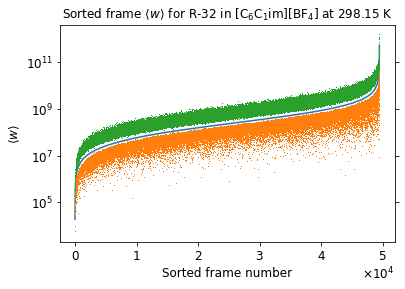

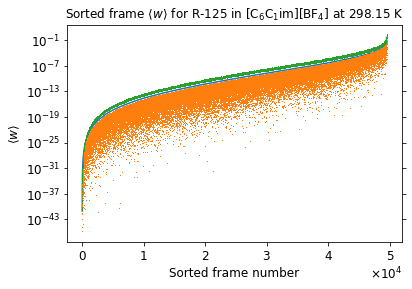

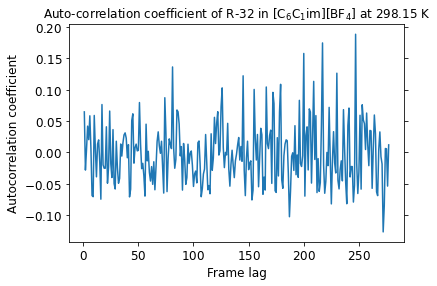

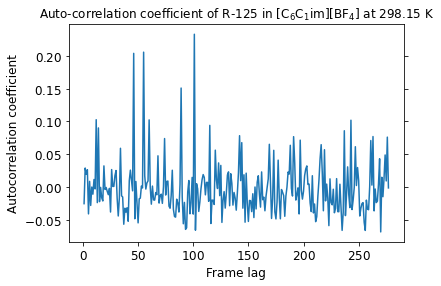

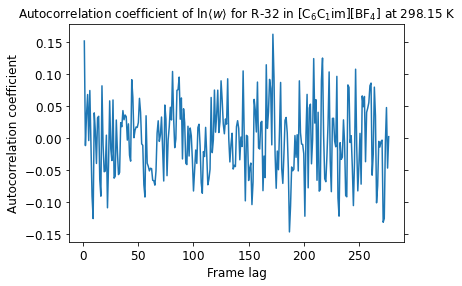

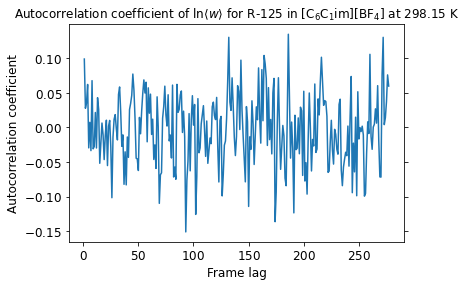

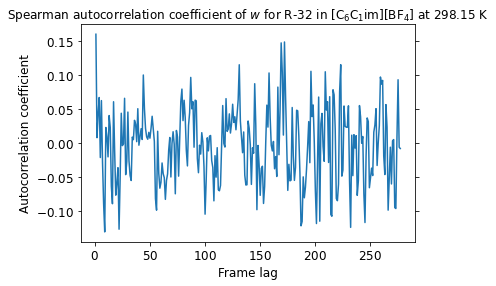

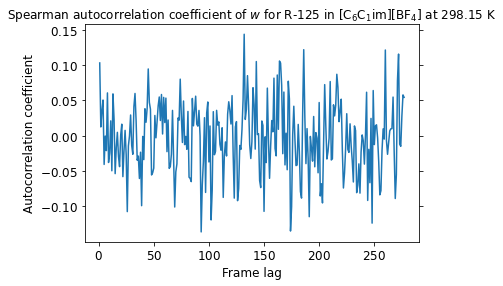

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


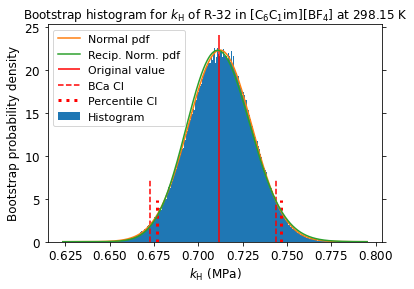

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


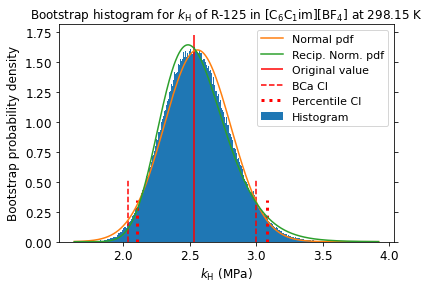

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


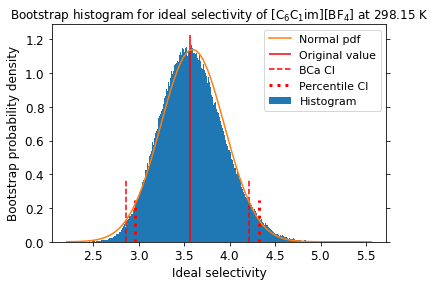

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


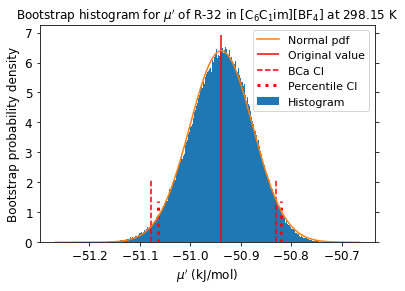

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


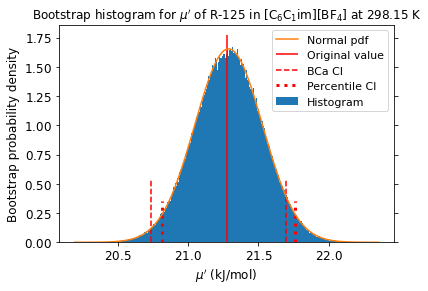

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


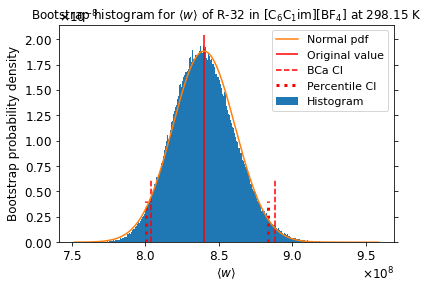

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


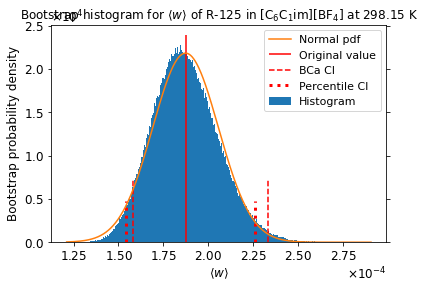

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.010142,-0.042443,-0.003951,-0.024002
Temp,0.006332,-0.004469,0.004769,-0.003577
Volume,0.010333,0.153720,0.011489,0.178021
Press,0.006498,-0.005343,0.000843,-0.015675
PotEng,0.010478,0.061507,0.002521,0.064417
KinEng,0.006332,-0.004469,0.004769,-0.003577
TotEng,0.012077,0.044138,0.004990,0.046936
E_pair,0.016953,0.104596,0.003405,0.103108
E_vdwl,0.014011,0.087658,0.004799,0.092977
E_coul,0.005687,0.041116,-0.000415,0.034595


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.042601,-0.042601,-0.022033,-0.022033
Temp,-0.003862,-0.003862,-0.000958,-0.000958
Volume,0.144626,0.144626,0.164732,0.164732
Press,-0.002801,-0.002801,-0.013318,-0.013318
PotEng,0.057813,0.057813,0.061866,0.061866
KinEng,-0.003862,-0.003862,-0.000958,-0.000958
TotEng,0.040270,0.040270,0.045484,0.045484
E_pair,0.099408,0.099408,0.095486,0.095486
E_vdwl,0.082699,0.082699,0.087147,0.087147
E_coul,0.038998,0.038998,0.033357,0.033357


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.028260,-0.028260,-0.014806,-0.014806
Temp,-0.002574,-0.002574,-0.000617,-0.000617
Volume,0.096811,0.096811,0.110275,0.110275
Press,-0.001861,-0.001861,-0.008864,-0.008864
PotEng,0.038573,0.038573,0.041249,0.041249
KinEng,-0.002574,-0.002574,-0.000617,-0.000617
TotEng,0.026857,0.026857,0.030332,0.030332
E_pair,0.066409,0.066409,0.063781,0.063781
E_vdwl,0.055198,0.055198,0.058116,0.058116
E_coul,0.026009,0.026009,0.022246,0.022246


R-32 w column correlation (first 5 columns):
 [[1.00000000e+00 2.60189185e-02 9.02132467e-04 2.27271635e-03
  2.03915318e-04]
 [2.60189185e-02 1.00000000e+00 8.91733316e-04 5.15794091e-03
  9.16802274e-04]
 [9.02132467e-04 8.91733316e-04 1.00000000e+00 6.97762298e-04
  1.87620218e-03]
 [2.27271635e-03 5.15794091e-03 6.97762298e-04 1.00000000e+00
  3.19696899e-03]
 [2.03915318e-04 9.16802274e-04 1.87620218e-03 3.19696899e-03
  1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.34911671 0.34901315 0.35241552 0.350182  ]
 [0.34911671 1.         0.35135649 0.35170916 0.35635999]
 [0.34901315 0.35135649 1.         0.34450559 0.35282386]
 [0.35241552 0.35170916 0.34450559 1.         0.35089901]
 [0.350182   0.35635999 0.35282386 0.35089901 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.34257156 0.33929046 0.34146324 0.34177178]
 [0.34257156 1.         0.34279211 0.34389884 0.34533863]
 [0.33929046 0.34279211 1.         0.338

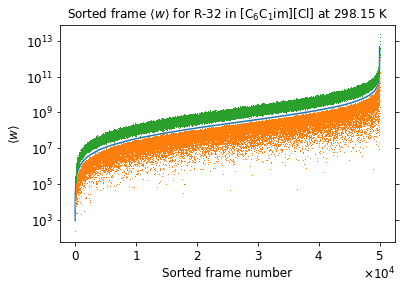

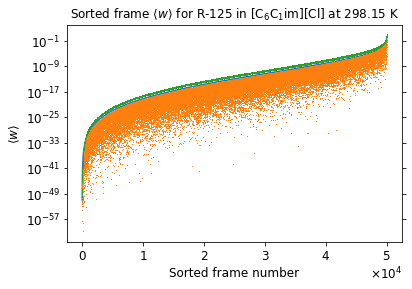

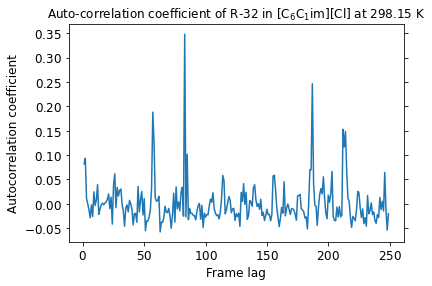

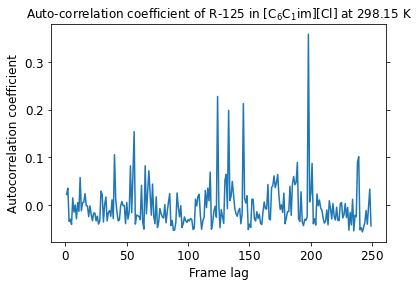

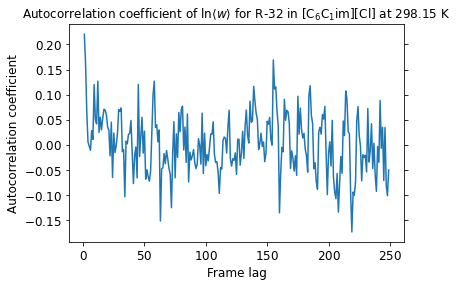

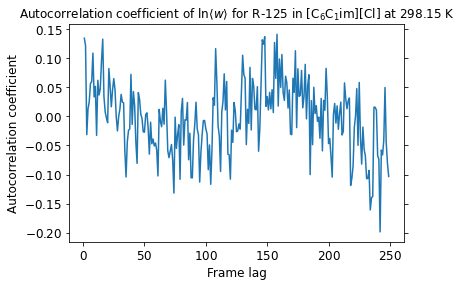

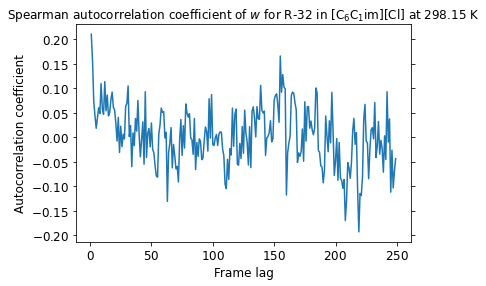

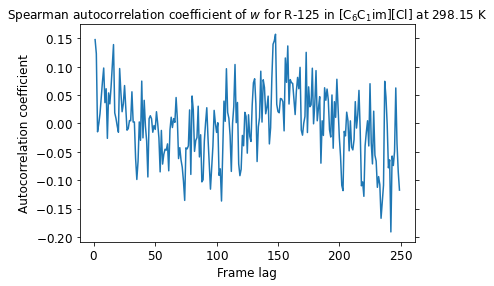

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


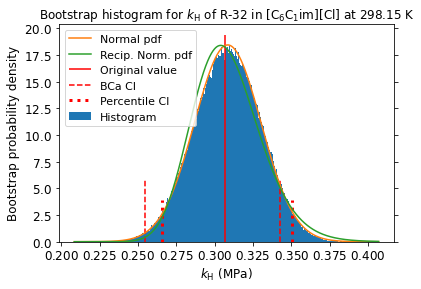

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


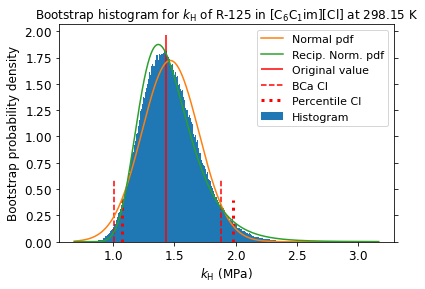

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


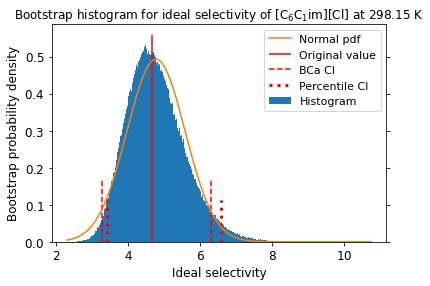

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


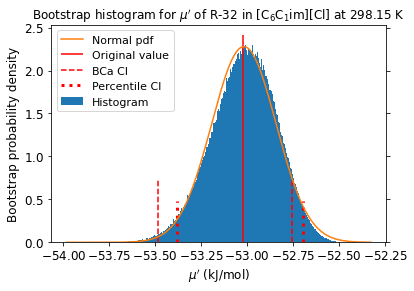

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


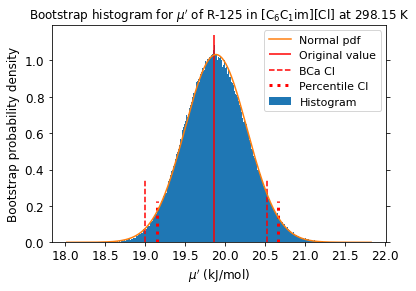

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


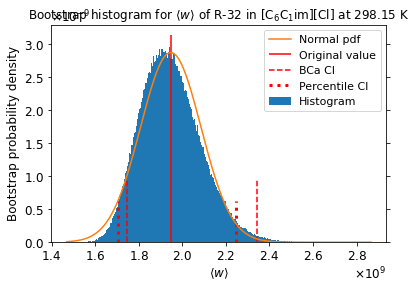

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


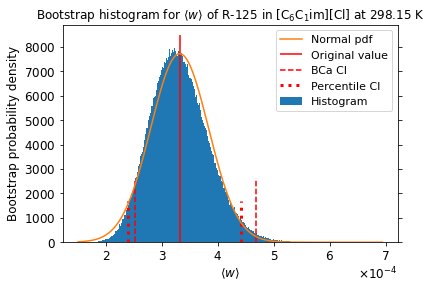

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


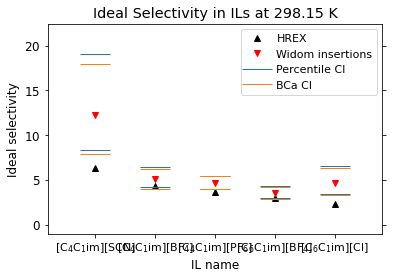

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


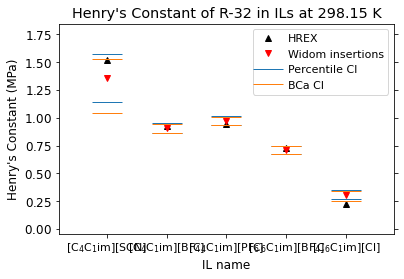

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


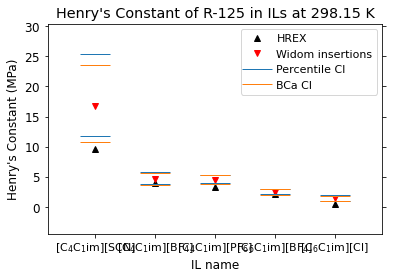

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


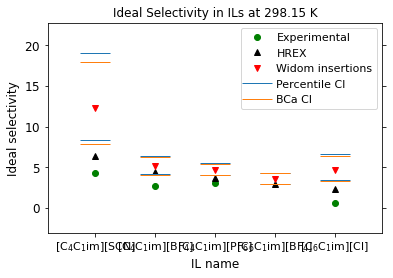

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


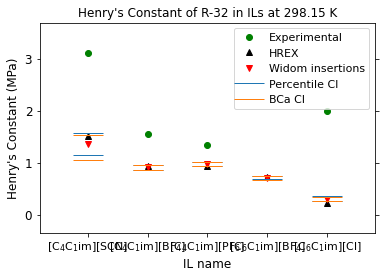

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


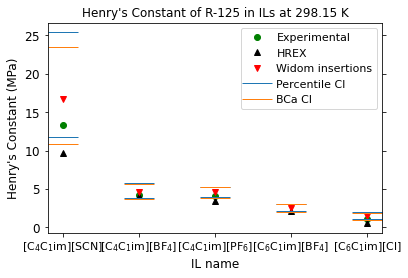

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


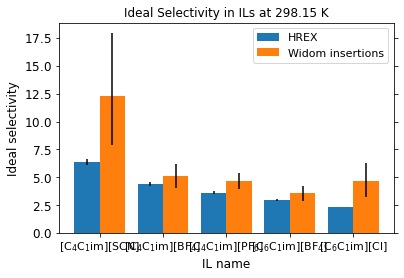

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


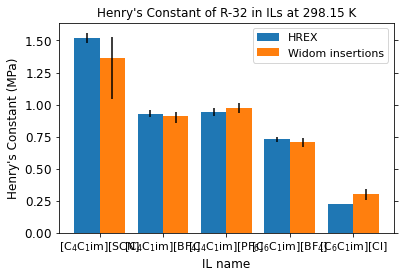

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


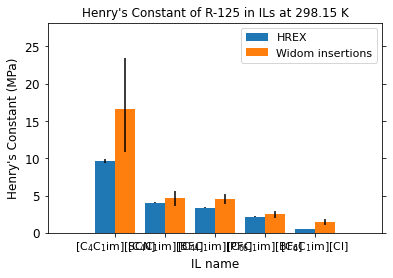

In [95]:
plot_results("Eij_max_estimation_1/vbs_blocksize100_89", "Eij_max_estimation_1", get_fbs=True, get_corr=True, blocksize=(100,100,100,89,100))

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.009593,-0.000408,-0.003801,-0.004264
Temp,0.012135,0.005719,-0.004614,-0.002846
Volume,0.005957,0.156410,0.003950,0.174771
Press,-0.002372,-0.010923,-0.002049,-0.010573
PotEng,0.000200,0.067640,0.000143,0.074838
KinEng,0.012135,0.005719,-0.004614,-0.002846
TotEng,0.008064,0.054889,-0.002900,0.054748
E_pair,0.006435,0.107356,0.003844,0.108709
E_vdwl,-0.001151,0.099502,0.002334,0.104679
E_coul,0.010951,0.044706,0.003831,0.041516


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.000265,-0.000265,-0.005701,-0.005701
Temp,0.004139,0.004139,-0.004361,-0.004361
Volume,0.144727,0.144727,0.160629,0.160629
Press,-0.010327,-0.010327,-0.010134,-0.010134
PotEng,0.060614,0.060614,0.067692,0.067692
KinEng,0.004139,0.004139,-0.004361,-0.004361
TotEng,0.048131,0.048131,0.048443,0.048443
E_pair,0.098088,0.098088,0.098777,0.098777
E_vdwl,0.091115,0.091115,0.096069,0.096069
E_coul,0.039793,0.039793,0.035089,0.035089


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.000154,-0.000154,-0.003810,-0.003810
Temp,0.002776,0.002776,-0.002917,-0.002917
Volume,0.096975,0.096975,0.107572,0.107572
Press,-0.006881,-0.006881,-0.006757,-0.006757
PotEng,0.040437,0.040437,0.045129,0.045129
KinEng,0.002776,0.002776,-0.002918,-0.002918
TotEng,0.032125,0.032125,0.032278,0.032278
E_pair,0.065504,0.065504,0.065943,0.065943
E_vdwl,0.060831,0.060831,0.064129,0.064129
E_coul,0.026555,0.026555,0.023402,0.023402


R-32 w column correlation (first 5 columns):
 [[1.00000000e+00 4.35421836e-03 1.06373402e-03 2.13937644e-03
  8.05801837e-03]
 [4.35421836e-03 1.00000000e+00 4.13247945e-01 3.55550070e-04
  6.30238110e-03]
 [1.06373402e-03 4.13247945e-01 1.00000000e+00 1.38825133e-03
  3.12672603e-03]
 [2.13937644e-03 3.55550070e-04 1.38825133e-03 1.00000000e+00
  9.95103906e-03]
 [8.05801837e-03 6.30238110e-03 3.12672603e-03 9.95103906e-03
  1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.4003562  0.3956163  0.40092154 0.40060193]
 [0.4003562  1.         0.40033316 0.39866978 0.40025258]
 [0.3956163  0.40033316 1.         0.40286882 0.39939541]
 [0.40092154 0.39866978 0.40286882 1.         0.39967267]
 [0.40060193 0.40025258 0.39939541 0.39967267 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.40418504 0.40319857 0.40477497 0.40641997]
 [0.40418504 1.         0.40323465 0.40254934 0.40401274]
 [0.40319857 0.40323465 1.         0.406

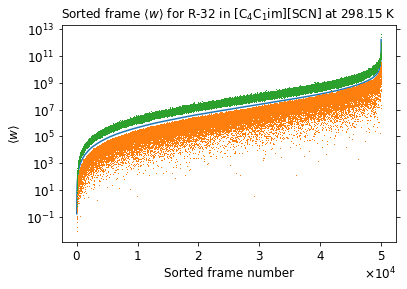

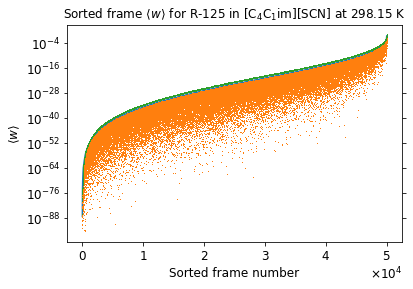

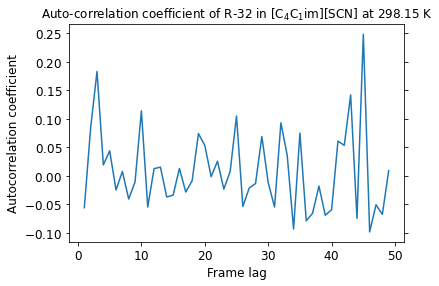

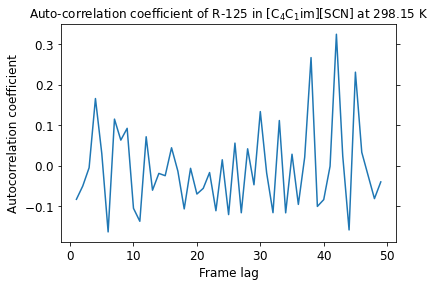

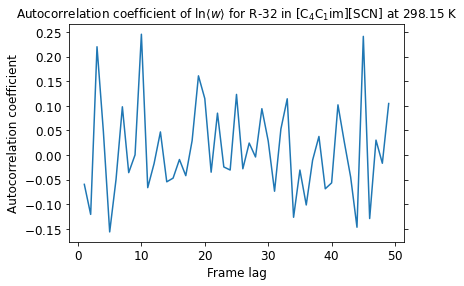

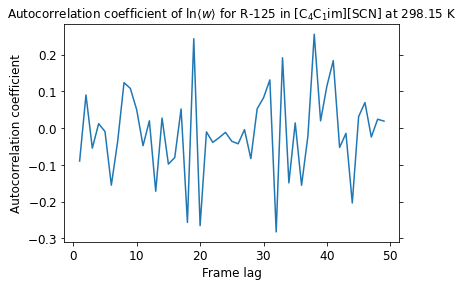

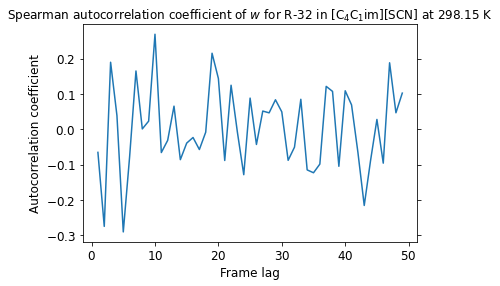

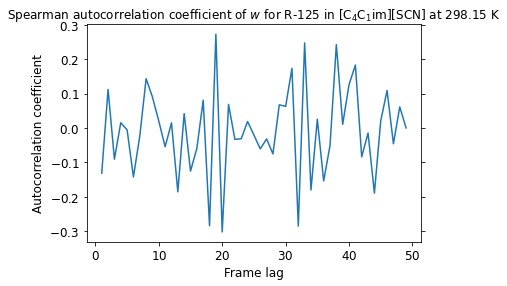

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


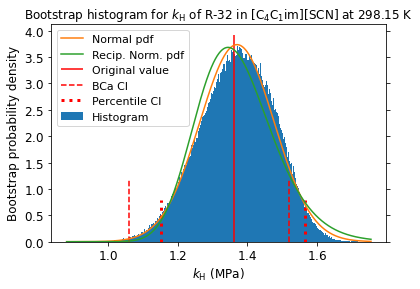

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


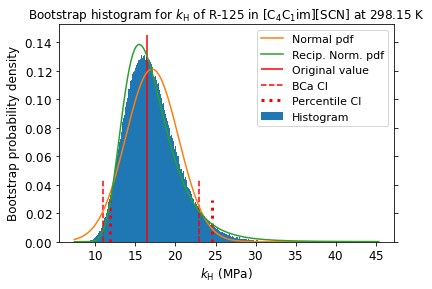

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


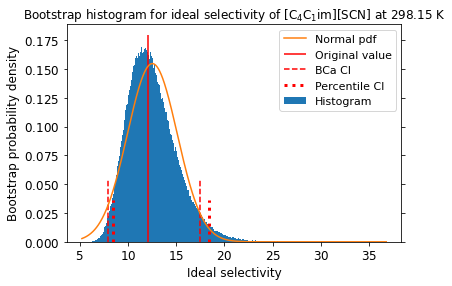

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


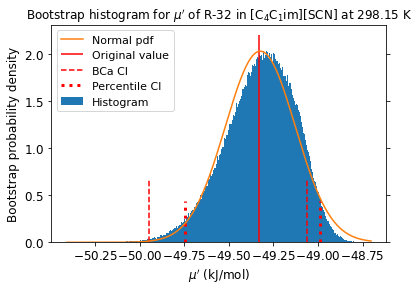

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


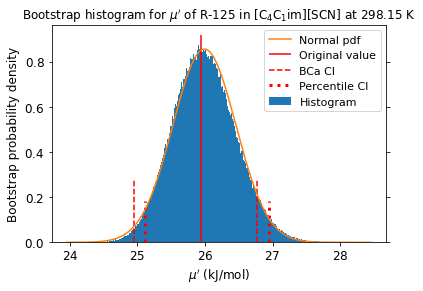

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


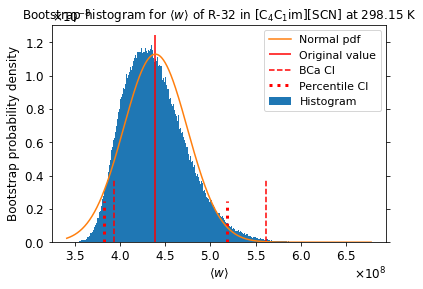

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


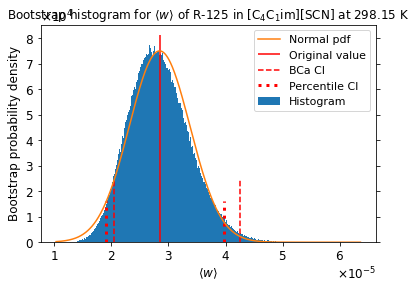

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.006956,0.021652,-0.009246,0.020624
Temp,0.005669,0.000421,-0.006003,0.001621
Volume,0.035328,0.162238,0.009179,0.182023
Press,0.000996,-0.005054,-0.004146,-0.005382
PotEng,0.019181,0.069590,0.003372,0.076146
KinEng,0.005669,0.000421,-0.006003,0.001621
TotEng,0.018166,0.052699,-0.001396,0.058425
E_pair,0.031087,0.113896,0.006862,0.115227
E_vdwl,0.029712,0.107489,0.002754,0.112746
E_coul,0.011885,0.047791,0.007427,0.045667


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.020647,0.020647,0.021185,0.021185
Temp,-0.000022,-0.000022,0.000925,0.000925
Volume,0.152421,0.152421,0.169815,0.169815
Press,-0.006468,-0.006468,-0.004445,-0.004445
PotEng,0.064743,0.064743,0.071881,0.071881
KinEng,-0.000022,-0.000022,0.000925,0.000925
TotEng,0.048831,0.048831,0.054591,0.054591
E_pair,0.107388,0.107388,0.104428,0.104428
E_vdwl,0.101174,0.101174,0.103580,0.103580
E_coul,0.045056,0.045056,0.041209,0.041209


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.013748,0.013748,0.014095,0.014095
Temp,-0.000013,-0.000013,0.000616,0.000616
Volume,0.101970,0.101970,0.113763,0.113763
Press,-0.004327,-0.004327,-0.002976,-0.002976
PotEng,0.043153,0.043153,0.047933,0.047933
KinEng,-0.000013,-0.000013,0.000616,0.000616
TotEng,0.032550,0.032550,0.036384,0.036384
E_pair,0.071562,0.071562,0.069782,0.069782
E_vdwl,0.067571,0.067571,0.069211,0.069211
E_coul,0.029985,0.029985,0.027504,0.027504


R-32 w column correlation (first 5 columns):
 [[1.         0.01642778 0.00572564 0.01005609 0.00834105]
 [0.01642778 1.         0.02001384 0.00520182 0.03277801]
 [0.00572564 0.02001384 1.         0.013267   0.02537419]
 [0.01005609 0.00520182 0.013267   1.         0.02319268]
 [0.00834105 0.03277801 0.02537419 0.02319268 1.        ]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.35610545 0.35506125 0.36413449 0.35418701]
 [0.35610545 1.         0.34782106 0.36043301 0.35134157]
 [0.35506125 0.34782106 1.         0.36214669 0.35698583]
 [0.36413449 0.36043301 0.36214669 1.         0.35769594]
 [0.35418701 0.35134157 0.35698583 0.35769594 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.34810547 0.34574279 0.35272682 0.34637824]
 [0.34810547 1.         0.34130863 0.35010238 0.3422042 ]
 [0.34574279 0.34130863 1.         0.35252646 0.34917114]
 [0.35272682 0.35010238 0.35252646 1.         0.34694475]
 [0.34637824 0.3422042  0.34917114

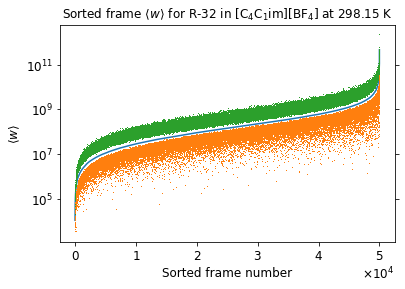

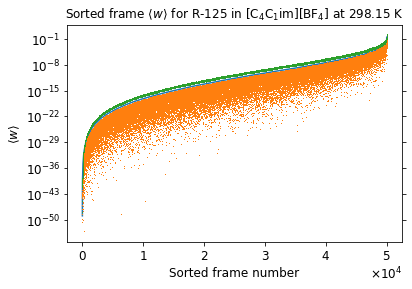

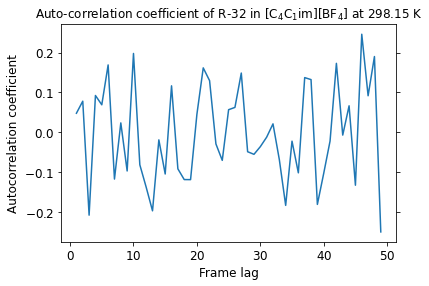

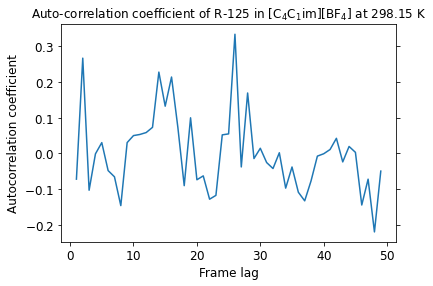

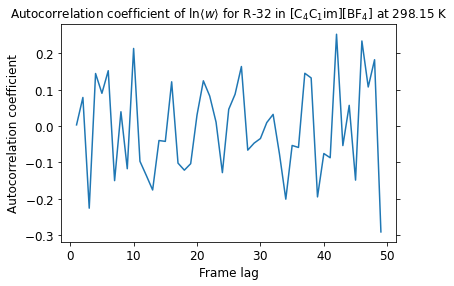

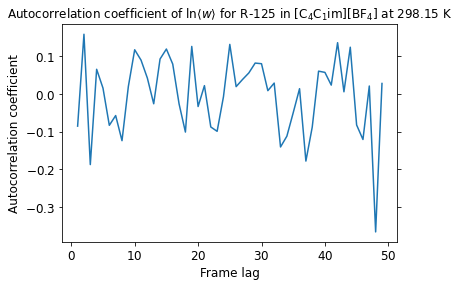

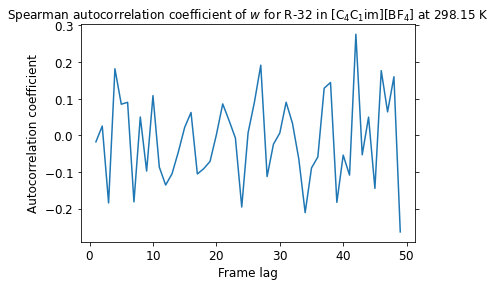

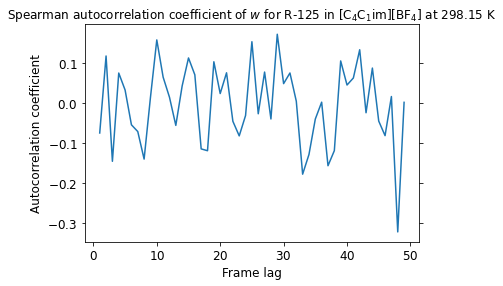

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


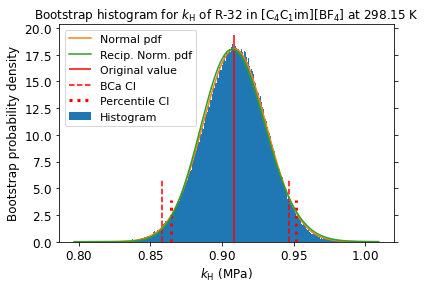

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


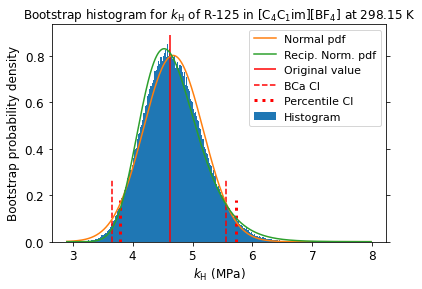

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


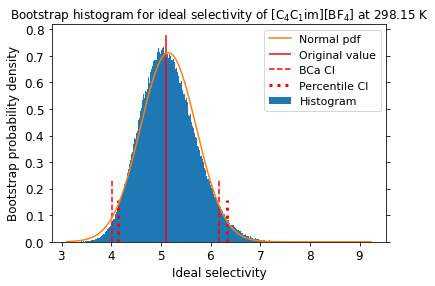

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


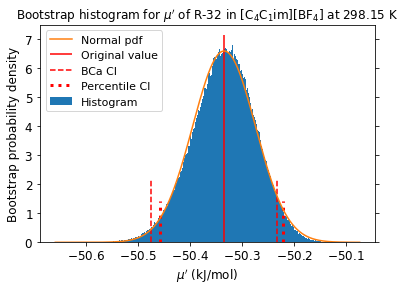

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


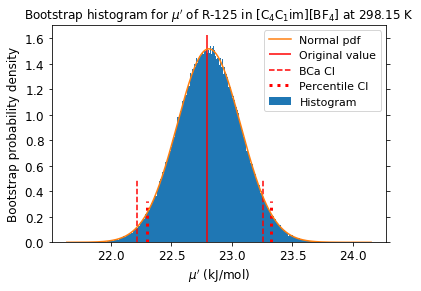

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


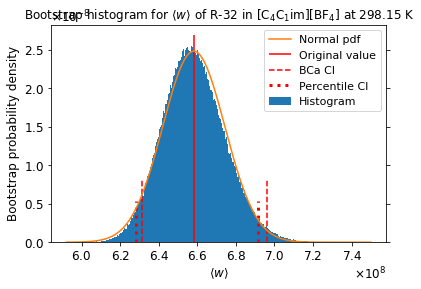

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


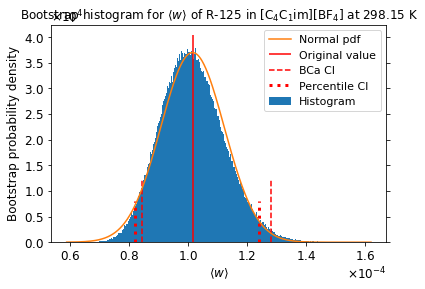

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.002158,0.004577,0.002468,0.007268
Temp,0.006965,0.003623,-0.000712,0.001125
Volume,0.027982,0.161962,0.011604,0.181858
Press,0.002778,-0.002157,-0.002155,-0.006413
PotEng,0.006804,0.063166,0.003224,0.064404
KinEng,0.006965,0.003623,-0.000712,0.001125
TotEng,0.009700,0.050108,0.001971,0.049409
E_pair,0.025717,0.116558,0.004153,0.115254
E_vdwl,0.025207,0.111302,0.006832,0.120452
E_coul,0.008295,0.050344,-0.001862,0.038348


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.003847,0.003847,0.007230,0.007230
Temp,0.002414,0.002414,0.000584,0.000584
Volume,0.155282,0.155282,0.165196,0.165196
Press,-0.000772,-0.000772,-0.002708,-0.002708
PotEng,0.061961,0.061961,0.057922,0.057922
KinEng,0.002414,0.002414,0.000584,0.000584
TotEng,0.047479,0.047479,0.045526,0.045526
E_pair,0.109666,0.109666,0.103770,0.103770
E_vdwl,0.103526,0.103526,0.108943,0.108943
E_coul,0.047764,0.047764,0.033126,0.033126


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.002574,0.002574,0.004847,0.004847
Temp,0.001612,0.001612,0.000381,0.000381
Volume,0.103974,0.103974,0.110647,0.110647
Press,-0.000508,-0.000508,-0.001805,-0.001805
PotEng,0.041367,0.041367,0.038653,0.038653
KinEng,0.001612,0.001612,0.000381,0.000381
TotEng,0.031751,0.031751,0.030426,0.030426
E_pair,0.073315,0.073315,0.069298,0.069298
E_vdwl,0.069218,0.069218,0.072786,0.072786
E_coul,0.031919,0.031919,0.022113,0.022113


R-32 w column correlation (first 5 columns):
 [[1.         0.00208979 0.0143919  0.00468749 0.00436689]
 [0.00208979 1.         0.00658631 0.00888344 0.00441957]
 [0.0143919  0.00658631 1.         0.01681707 0.00958775]
 [0.00468749 0.00888344 0.01681707 1.         0.00426914]
 [0.00436689 0.00441957 0.00958775 0.00426914 1.        ]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.33178313 0.33604073 0.32870706 0.33425826]
 [0.33178313 1.         0.3226715  0.32877332 0.32903066]
 [0.33604073 0.3226715  1.         0.33497411 0.33801888]
 [0.32870706 0.32877332 0.33497411 1.         0.33388231]
 [0.33425826 0.32903066 0.33801888 0.33388231 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.32080252 0.32493697 0.31802404 0.32727066]
 [0.32080252 1.         0.31345278 0.31838606 0.31727375]
 [0.32493697 0.31345278 1.         0.32368651 0.33134781]
 [0.31802404 0.31838606 0.32368651 1.         0.32533996]
 [0.32727066 0.31727375 0.33134781

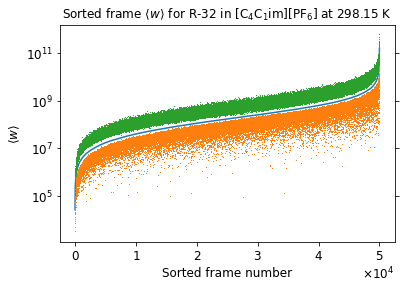

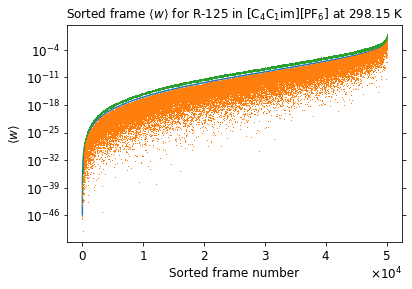

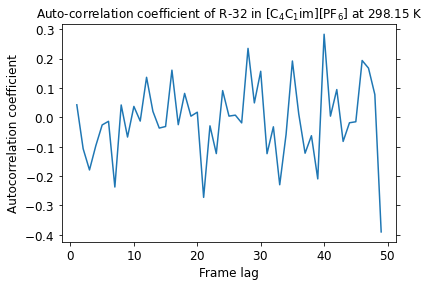

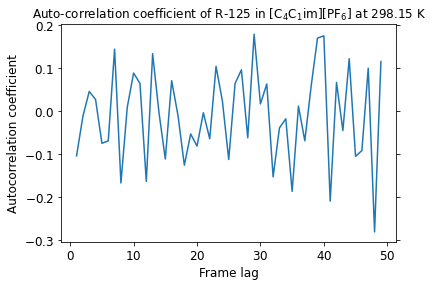

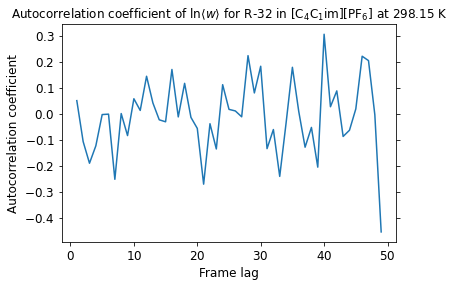

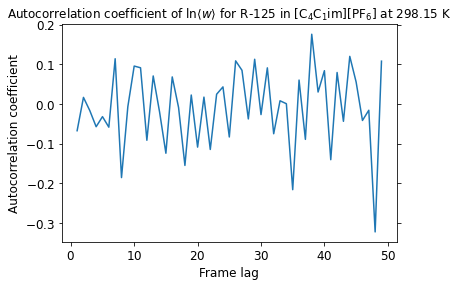

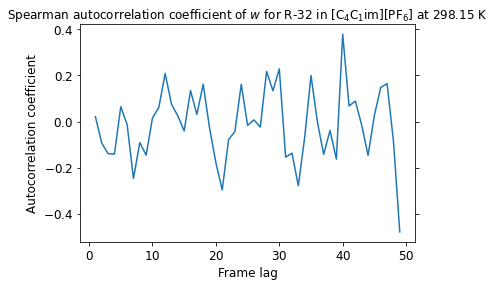

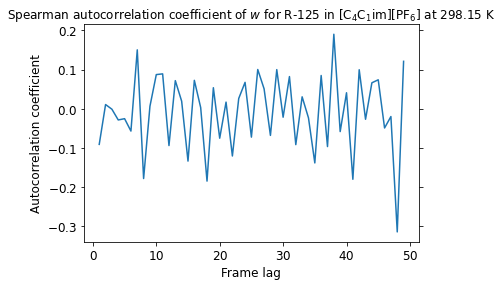

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


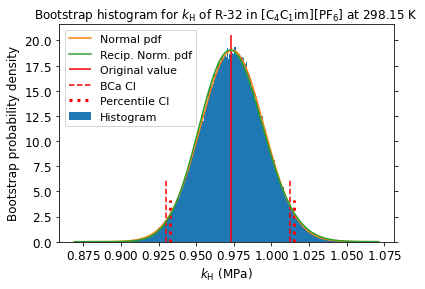

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


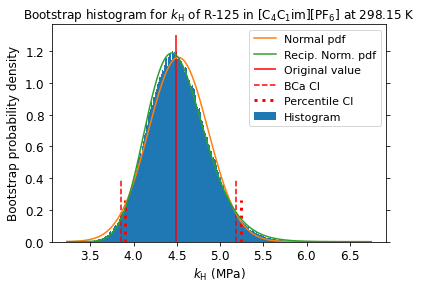

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


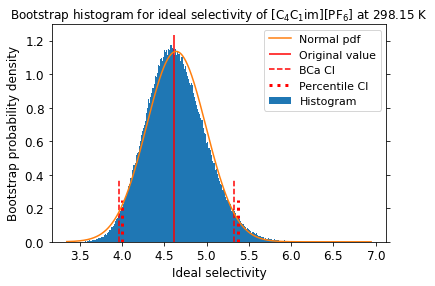

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


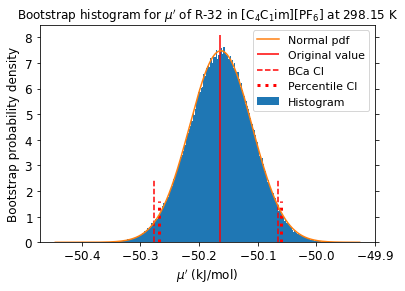

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


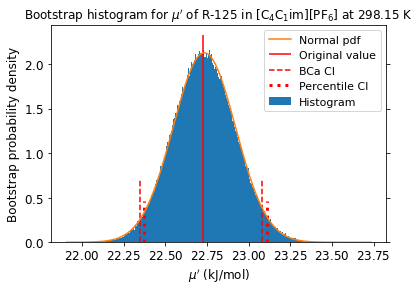

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


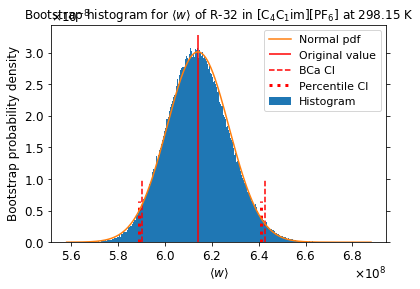

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


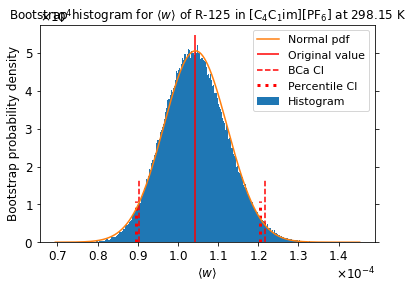

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.001807,0.003506,0.004717,0.015468
Temp,0.003944,-0.003004,0.004393,-0.002556
Volume,0.026730,0.162997,0.009428,0.176513
Press,0.001577,0.006428,0.003256,0.001321
PotEng,0.014599,0.059125,0.011866,0.054732
KinEng,0.003944,-0.003004,0.004393,-0.002556
TotEng,0.013608,0.042686,0.011838,0.039662
E_pair,0.025957,0.116690,0.006516,0.102916
E_vdwl,0.018604,0.101042,0.005866,0.103259
E_coul,0.015427,0.056412,0.003043,0.034245


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.004462,0.004462,0.017212,0.017212
Temp,-0.001332,-0.001332,0.002739,0.002739
Volume,0.153190,0.153190,0.161776,0.161776
Press,0.007574,0.007574,0.004014,0.004014
PotEng,0.055965,0.055965,0.049383,0.049383
KinEng,-0.001332,-0.001332,0.002739,0.002739
TotEng,0.041184,0.041184,0.038992,0.038992
E_pair,0.110738,0.110738,0.093703,0.093703
E_vdwl,0.095714,0.095714,0.094951,0.094951
E_coul,0.052554,0.052554,0.032250,0.032250


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.002960,0.002960,0.011492,0.011492
Temp,-0.000902,-0.000902,0.001841,0.001841
Volume,0.102411,0.102411,0.108368,0.108368
Press,0.005059,0.005059,0.002663,0.002663
PotEng,0.037338,0.037338,0.032889,0.032889
KinEng,-0.000902,-0.000902,0.001841,0.001841
TotEng,0.027433,0.027433,0.025977,0.025977
E_pair,0.073976,0.073976,0.062607,0.062607
E_vdwl,0.063916,0.063916,0.063527,0.063527
E_coul,0.035073,0.035073,0.021520,0.021520


R-32 w column correlation (first 5 columns):
 [[1.00000000e+00 3.37353917e-03 3.02665117e-04 5.97665611e-04
  2.78675990e-03]
 [3.37353917e-03 1.00000000e+00 5.42153853e-03 7.96431386e-03
  1.01957834e-02]
 [3.02665117e-04 5.42153853e-03 1.00000000e+00 2.46600347e-03
  4.57262377e-03]
 [5.97665611e-04 7.96431386e-03 2.46600347e-03 1.00000000e+00
  2.59922840e-03]
 [2.78675990e-03 1.01957834e-02 4.57262377e-03 2.59922840e-03
  1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.318909   0.31719986 0.32419942 0.31472287]
 [0.318909   1.         0.31897106 0.3214289  0.32059951]
 [0.31719986 0.31897106 1.         0.32135282 0.31746543]
 [0.32419942 0.3214289  0.32135282 1.         0.3292529 ]
 [0.31472287 0.32059951 0.31746543 0.3292529  1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.30839516 0.30642359 0.31470662 0.30407131]
 [0.30839516 1.         0.30783769 0.3111281  0.30951924]
 [0.30642359 0.30783769 1.         0.306

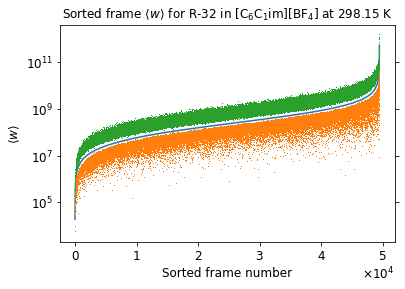

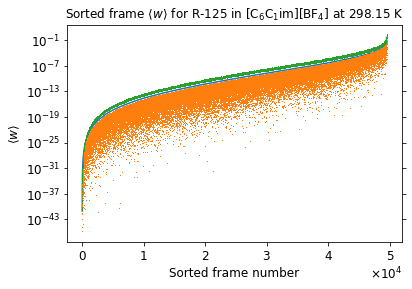

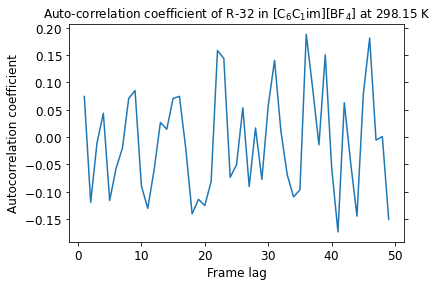

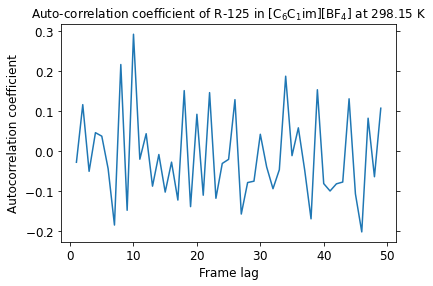

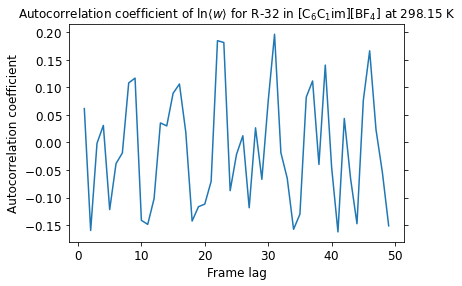

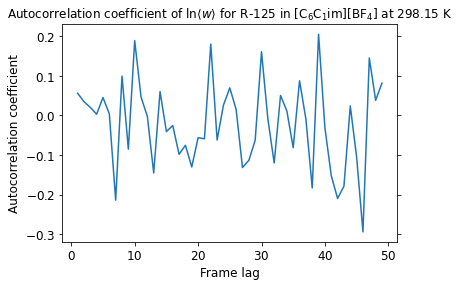

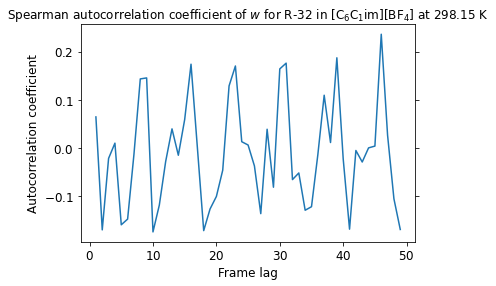

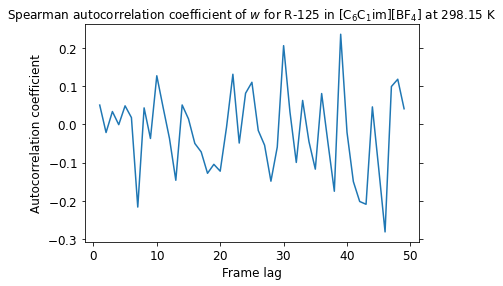

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


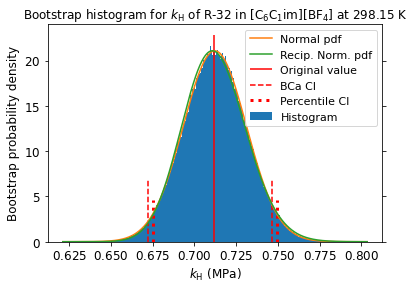

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


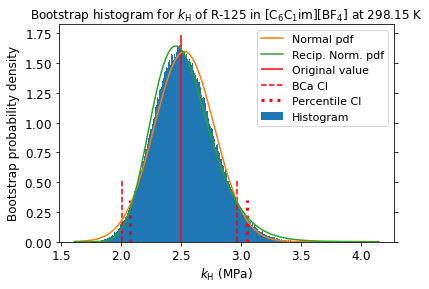

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


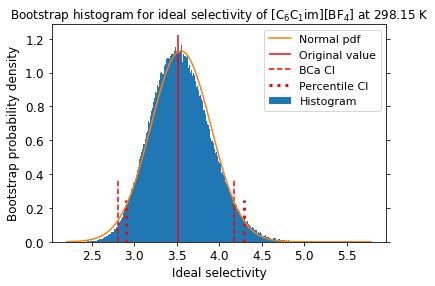

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


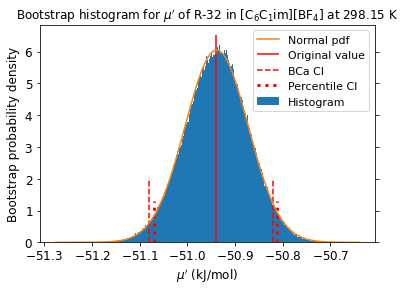

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


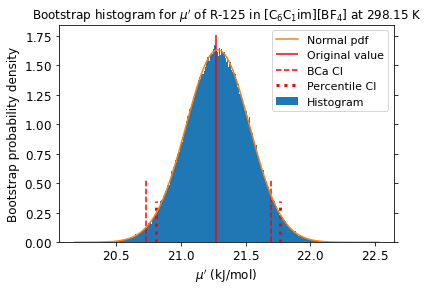

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


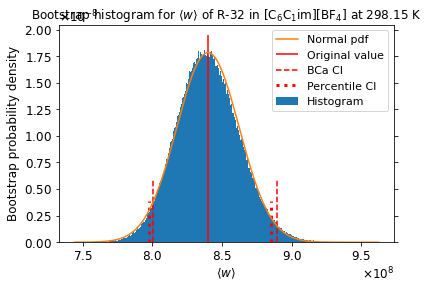

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


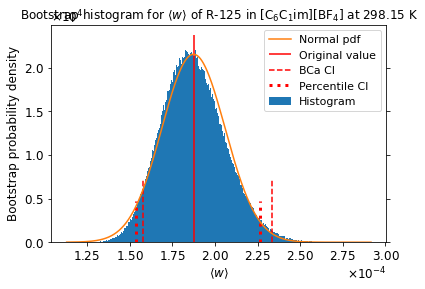

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.010142,-0.042443,-0.003951,-0.024002
Temp,0.006332,-0.004469,0.004769,-0.003577
Volume,0.010333,0.153720,0.011489,0.178021
Press,0.006498,-0.005343,0.000843,-0.015675
PotEng,0.010478,0.061507,0.002521,0.064417
KinEng,0.006332,-0.004469,0.004769,-0.003577
TotEng,0.012077,0.044138,0.004990,0.046936
E_pair,0.016953,0.104596,0.003405,0.103108
E_vdwl,0.014011,0.087658,0.004799,0.092977
E_coul,0.005687,0.041116,-0.000415,0.034595


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.042601,-0.042601,-0.022033,-0.022033
Temp,-0.003862,-0.003862,-0.000958,-0.000958
Volume,0.144626,0.144626,0.164732,0.164732
Press,-0.002801,-0.002801,-0.013318,-0.013318
PotEng,0.057813,0.057813,0.061866,0.061866
KinEng,-0.003862,-0.003862,-0.000958,-0.000958
TotEng,0.040270,0.040270,0.045484,0.045484
E_pair,0.099408,0.099408,0.095486,0.095486
E_vdwl,0.082699,0.082699,0.087147,0.087147
E_coul,0.038998,0.038998,0.033357,0.033357


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.028260,-0.028260,-0.014806,-0.014806
Temp,-0.002574,-0.002574,-0.000617,-0.000617
Volume,0.096811,0.096811,0.110275,0.110275
Press,-0.001861,-0.001861,-0.008864,-0.008864
PotEng,0.038573,0.038573,0.041249,0.041249
KinEng,-0.002574,-0.002574,-0.000617,-0.000617
TotEng,0.026857,0.026857,0.030332,0.030332
E_pair,0.066409,0.066409,0.063781,0.063781
E_vdwl,0.055198,0.055198,0.058116,0.058116
E_coul,0.026009,0.026009,0.022246,0.022246


R-32 w column correlation (first 5 columns):
 [[1.00000000e+00 2.60189185e-02 9.02132467e-04 2.27271635e-03
  2.03915318e-04]
 [2.60189185e-02 1.00000000e+00 8.91733316e-04 5.15794091e-03
  9.16802274e-04]
 [9.02132467e-04 8.91733316e-04 1.00000000e+00 6.97762298e-04
  1.87620218e-03]
 [2.27271635e-03 5.15794091e-03 6.97762298e-04 1.00000000e+00
  3.19696899e-03]
 [2.03915318e-04 9.16802274e-04 1.87620218e-03 3.19696899e-03
  1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.34911671 0.34901315 0.35241552 0.350182  ]
 [0.34911671 1.         0.35135649 0.35170916 0.35635999]
 [0.34901315 0.35135649 1.         0.34450559 0.35282386]
 [0.35241552 0.35170916 0.34450559 1.         0.35089901]
 [0.350182   0.35635999 0.35282386 0.35089901 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.34257156 0.33929046 0.34146324 0.34177178]
 [0.34257156 1.         0.34279211 0.34389884 0.34533863]
 [0.33929046 0.34279211 1.         0.338

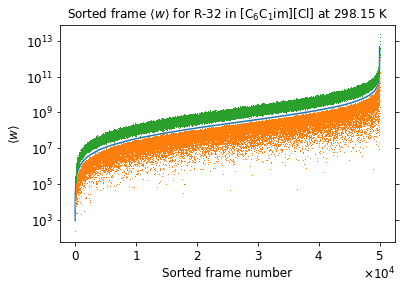

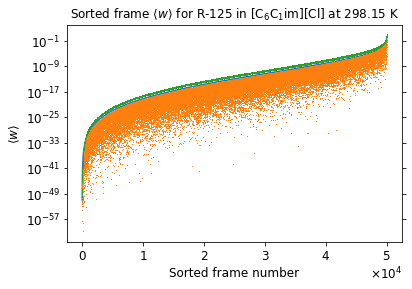

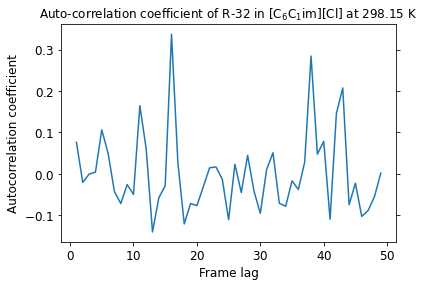

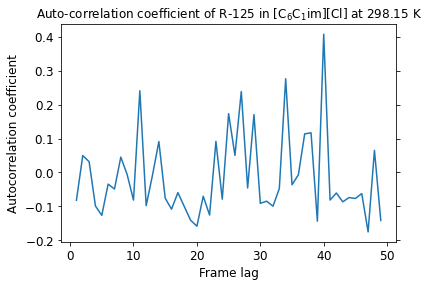

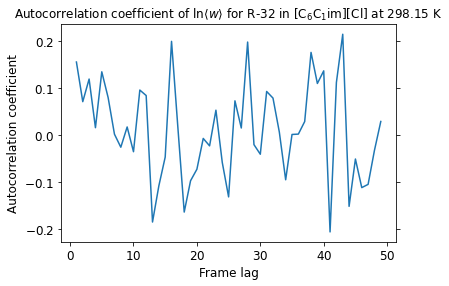

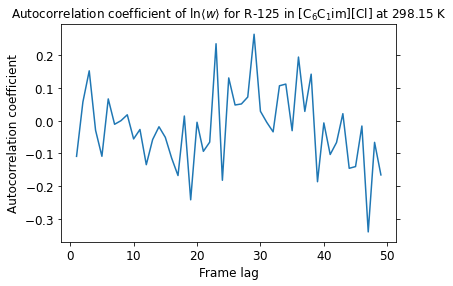

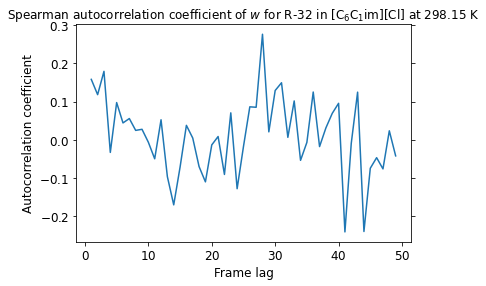

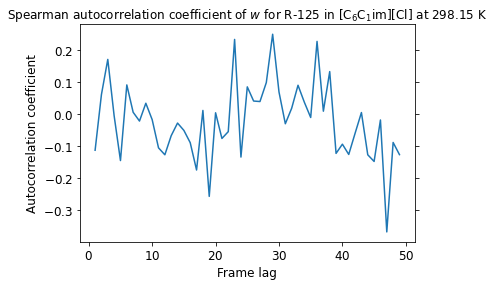

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


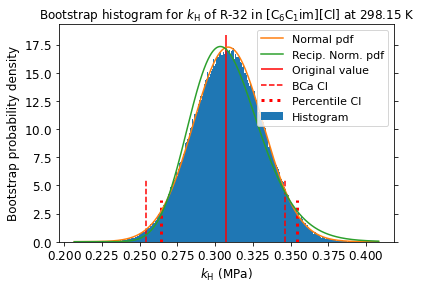

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


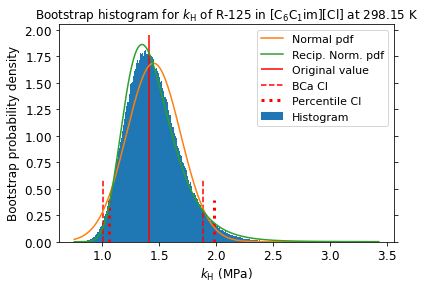

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


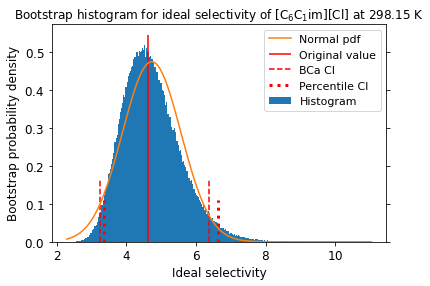

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


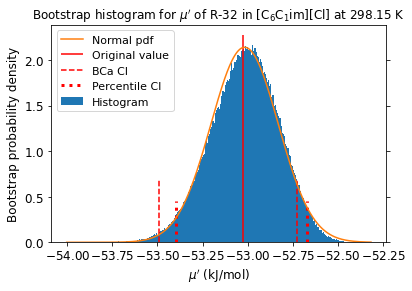

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


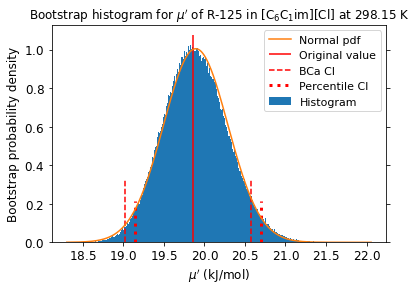

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


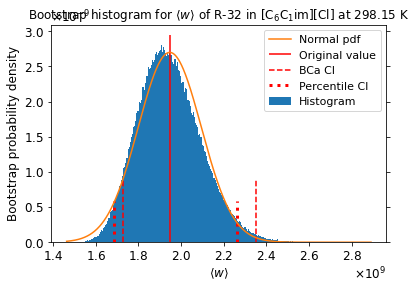

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


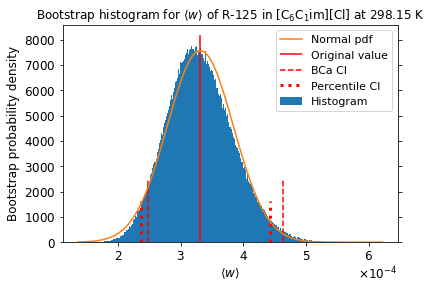

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


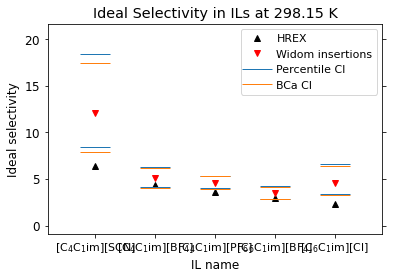

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


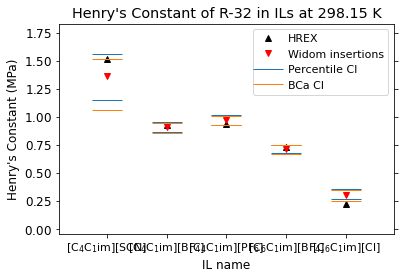

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


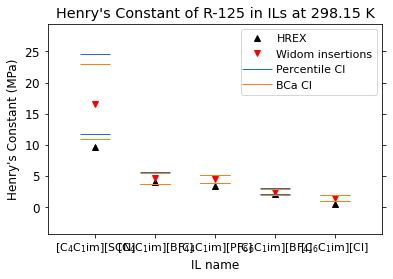

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


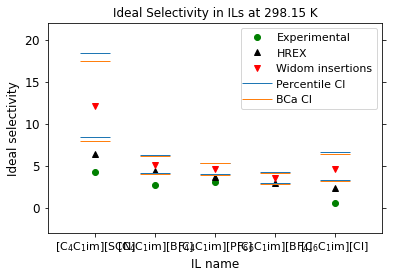

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


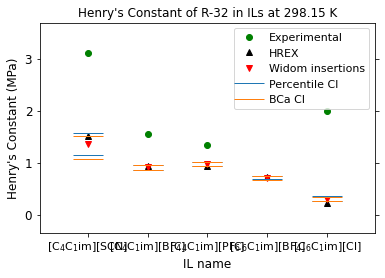

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


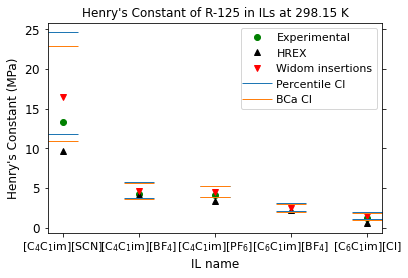

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


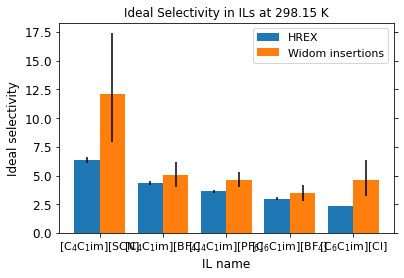

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


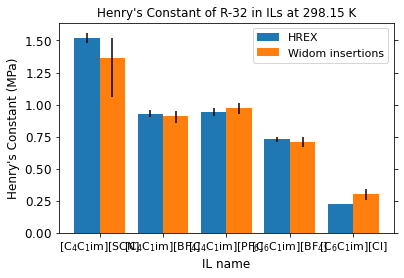

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


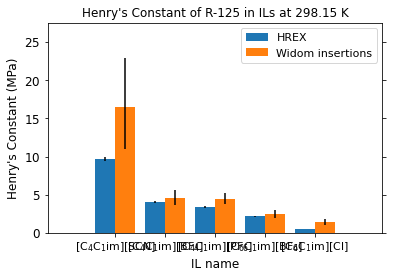

In [48]:
plot_results("Eij_max_estimation_1/vbs_100blocks", "Eij_max_estimation_1", nblocks=100, get_fbs=True, get_corr=True)

In [ ]:
plot_results("Eij_max_estimation_1/vbs_10000blocks", "Eij_max_estimation_1", nblocks=10000, get_corr=True)

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.009593,-0.000408,-0.003801,-0.004264
Temp,0.012135,0.005719,-0.004614,-0.002846
Volume,0.005957,0.156410,0.003950,0.174771
Press,-0.002372,-0.010923,-0.002049,-0.010573
PotEng,0.000200,0.067640,0.000143,0.074838
KinEng,0.012135,0.005719,-0.004614,-0.002846
TotEng,0.008064,0.054889,-0.002900,0.054748
E_pair,0.006435,0.107356,0.003844,0.108709
E_vdwl,-0.001151,0.099502,0.002334,0.104679
E_coul,0.010951,0.044706,0.003831,0.041516


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.000265,-0.000265,-0.005701,-0.005701
Temp,0.004139,0.004139,-0.004361,-0.004361
Volume,0.144727,0.144727,0.160629,0.160629
Press,-0.010327,-0.010327,-0.010134,-0.010134
PotEng,0.060614,0.060614,0.067692,0.067692
KinEng,0.004139,0.004139,-0.004361,-0.004361
TotEng,0.048131,0.048131,0.048443,0.048443
E_pair,0.098088,0.098088,0.098777,0.098777
E_vdwl,0.091115,0.091115,0.096069,0.096069
E_coul,0.039793,0.039793,0.035089,0.035089


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.000154,-0.000154,-0.003810,-0.003810
Temp,0.002776,0.002776,-0.002917,-0.002917
Volume,0.096975,0.096975,0.107572,0.107572
Press,-0.006881,-0.006881,-0.006757,-0.006757
PotEng,0.040437,0.040437,0.045129,0.045129
KinEng,0.002776,0.002776,-0.002918,-0.002918
TotEng,0.032125,0.032125,0.032278,0.032278
E_pair,0.065504,0.065504,0.065943,0.065943
E_vdwl,0.060831,0.060831,0.064129,0.064129
E_coul,0.026555,0.026555,0.023402,0.023402


R-32 w column correlation (first 5 columns):
 [[1.00000000e+00 4.35421836e-03 1.06373402e-03 2.13937644e-03
  8.05801837e-03]
 [4.35421836e-03 1.00000000e+00 4.13247945e-01 3.55550070e-04
  6.30238110e-03]
 [1.06373402e-03 4.13247945e-01 1.00000000e+00 1.38825133e-03
  3.12672603e-03]
 [2.13937644e-03 3.55550070e-04 1.38825133e-03 1.00000000e+00
  9.95103906e-03]
 [8.05801837e-03 6.30238110e-03 3.12672603e-03 9.95103906e-03
  1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.4003562  0.3956163  0.40092154 0.40060193]
 [0.4003562  1.         0.40033316 0.39866978 0.40025258]
 [0.3956163  0.40033316 1.         0.40286882 0.39939541]
 [0.40092154 0.39866978 0.40286882 1.         0.39967267]
 [0.40060193 0.40025258 0.39939541 0.39967267 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.40418504 0.40319857 0.40477497 0.40641997]
 [0.40418504 1.         0.40323465 0.40254934 0.40401274]
 [0.40319857 0.40323465 1.         0.406

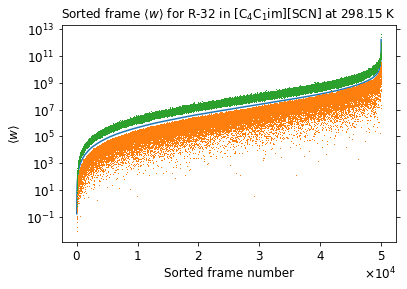

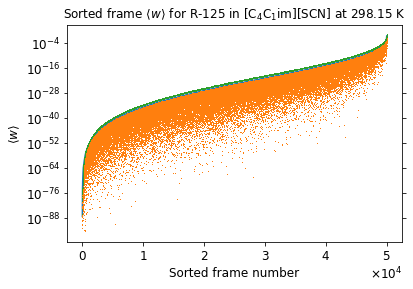

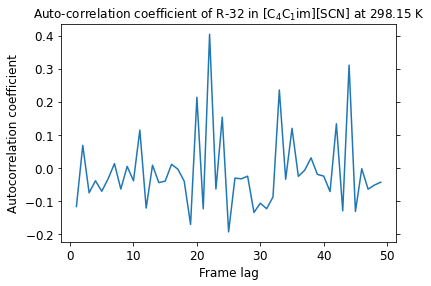

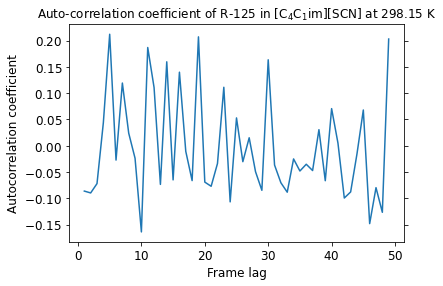

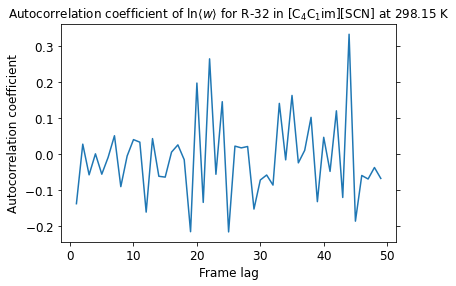

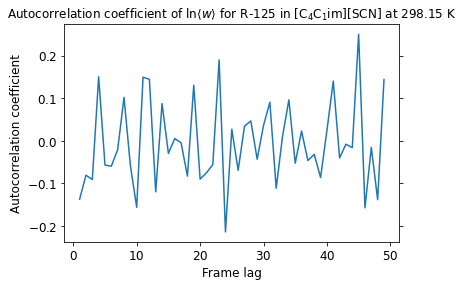

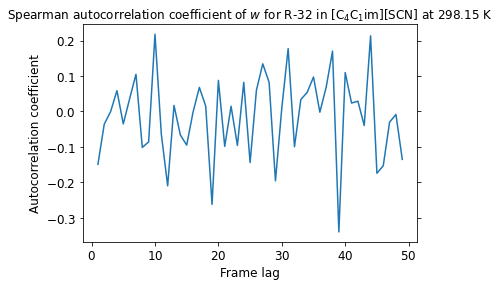

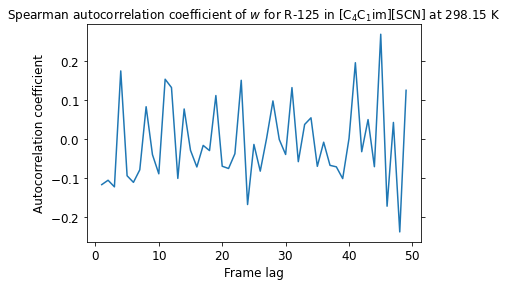

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


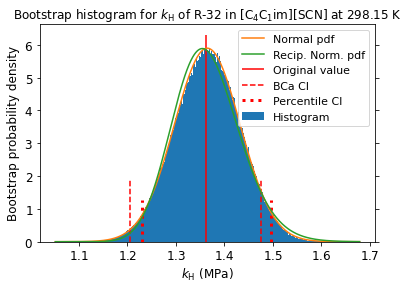

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


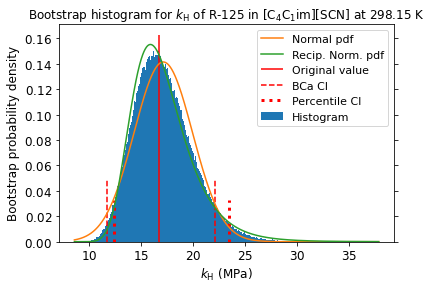

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


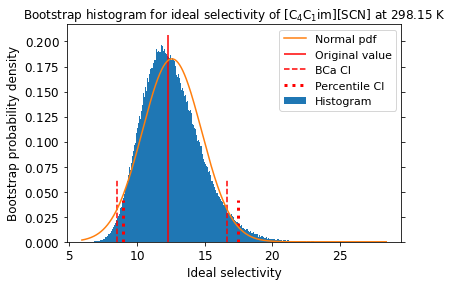

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


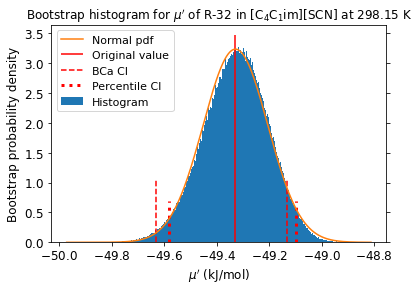

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


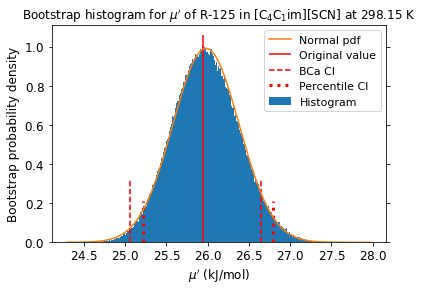

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


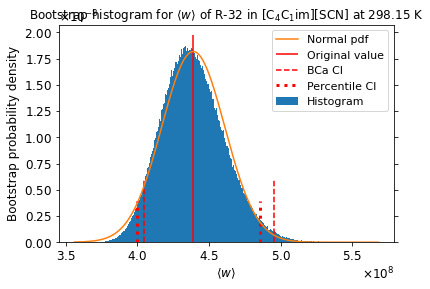

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


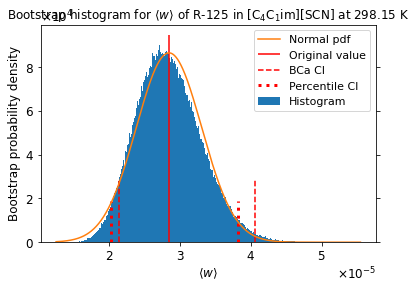

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.006956,0.021652,-0.009246,0.020624
Temp,0.005669,0.000421,-0.006003,0.001621
Volume,0.035328,0.162238,0.009179,0.182023
Press,0.000996,-0.005054,-0.004146,-0.005382
PotEng,0.019181,0.069590,0.003372,0.076146
KinEng,0.005669,0.000421,-0.006003,0.001621
TotEng,0.018166,0.052699,-0.001396,0.058425
E_pair,0.031087,0.113896,0.006862,0.115227
E_vdwl,0.029712,0.107489,0.002754,0.112746
E_coul,0.011885,0.047791,0.007427,0.045667


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.020647,0.020647,0.021185,0.021185
Temp,-0.000022,-0.000022,0.000925,0.000925
Volume,0.152421,0.152421,0.169815,0.169815
Press,-0.006468,-0.006468,-0.004445,-0.004445
PotEng,0.064743,0.064743,0.071881,0.071881
KinEng,-0.000022,-0.000022,0.000925,0.000925
TotEng,0.048831,0.048831,0.054591,0.054591
E_pair,0.107388,0.107388,0.104428,0.104428
E_vdwl,0.101174,0.101174,0.103580,0.103580
E_coul,0.045056,0.045056,0.041209,0.041209


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.013748,0.013748,0.014095,0.014095
Temp,-0.000013,-0.000013,0.000616,0.000616
Volume,0.101970,0.101970,0.113763,0.113763
Press,-0.004327,-0.004327,-0.002976,-0.002976
PotEng,0.043153,0.043153,0.047933,0.047933
KinEng,-0.000013,-0.000013,0.000616,0.000616
TotEng,0.032550,0.032550,0.036384,0.036384
E_pair,0.071562,0.071562,0.069782,0.069782
E_vdwl,0.067571,0.067571,0.069211,0.069211
E_coul,0.029985,0.029985,0.027504,0.027504


R-32 w column correlation (first 5 columns):
 [[1.         0.01642778 0.00572564 0.01005609 0.00834105]
 [0.01642778 1.         0.02001384 0.00520182 0.03277801]
 [0.00572564 0.02001384 1.         0.013267   0.02537419]
 [0.01005609 0.00520182 0.013267   1.         0.02319268]
 [0.00834105 0.03277801 0.02537419 0.02319268 1.        ]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.35610545 0.35506125 0.36413449 0.35418701]
 [0.35610545 1.         0.34782106 0.36043301 0.35134157]
 [0.35506125 0.34782106 1.         0.36214669 0.35698583]
 [0.36413449 0.36043301 0.36214669 1.         0.35769594]
 [0.35418701 0.35134157 0.35698583 0.35769594 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.34810547 0.34574279 0.35272682 0.34637824]
 [0.34810547 1.         0.34130863 0.35010238 0.3422042 ]
 [0.34574279 0.34130863 1.         0.35252646 0.34917114]
 [0.35272682 0.35010238 0.35252646 1.         0.34694475]
 [0.34637824 0.3422042  0.34917114

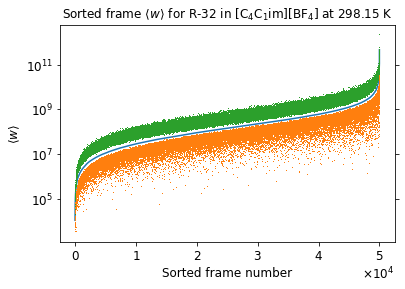

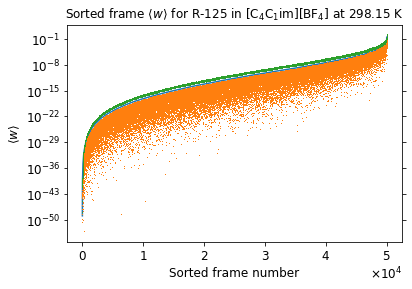

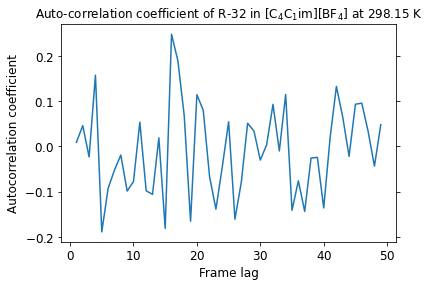

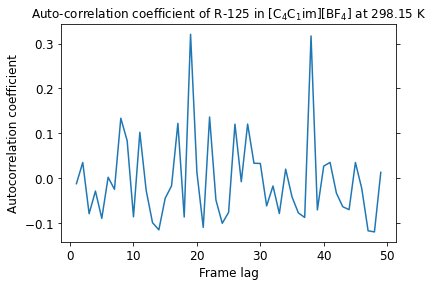

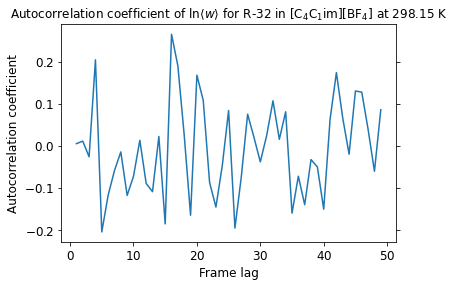

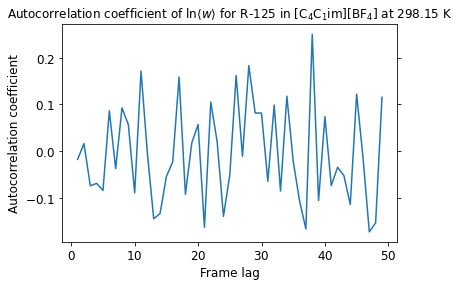

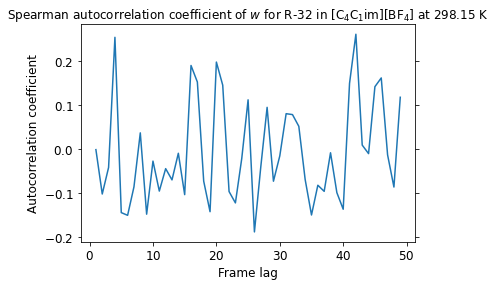

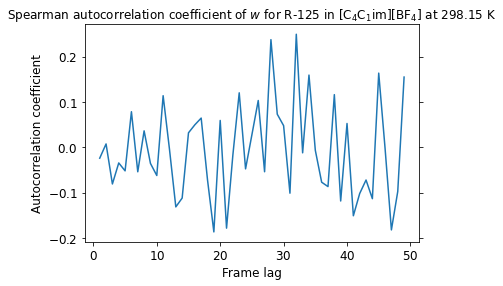

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


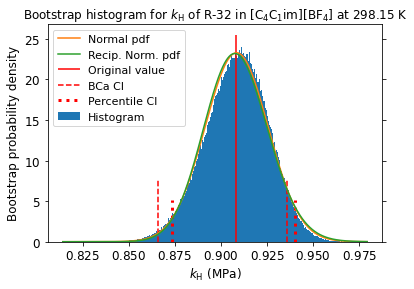

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


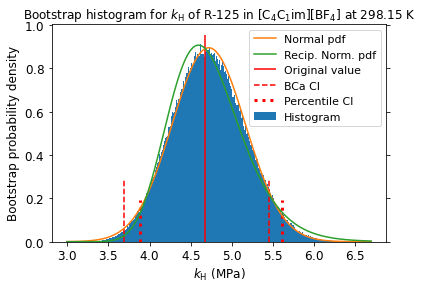

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


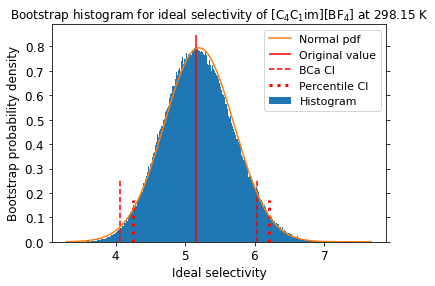

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


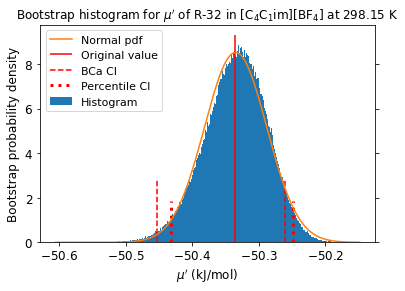

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


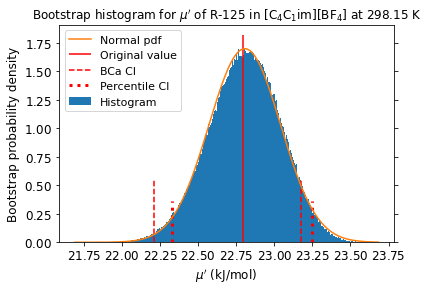

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


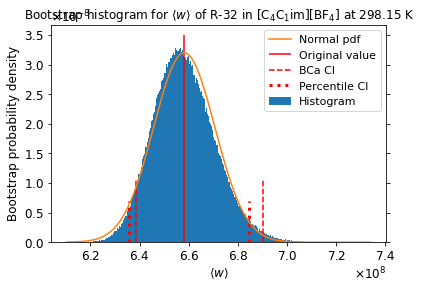

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


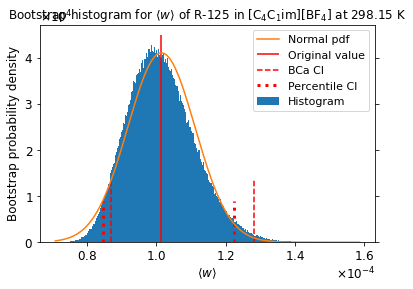

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.002158,0.004577,0.002468,0.007268
Temp,0.006965,0.003623,-0.000712,0.001125
Volume,0.027982,0.161962,0.011604,0.181858
Press,0.002778,-0.002157,-0.002155,-0.006413
PotEng,0.006804,0.063166,0.003224,0.064404
KinEng,0.006965,0.003623,-0.000712,0.001125
TotEng,0.009700,0.050108,0.001971,0.049409
E_pair,0.025717,0.116558,0.004153,0.115254
E_vdwl,0.025207,0.111302,0.006832,0.120452
E_coul,0.008295,0.050344,-0.001862,0.038348


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.003847,0.003847,0.007230,0.007230
Temp,0.002414,0.002414,0.000584,0.000584
Volume,0.155282,0.155282,0.165196,0.165196
Press,-0.000772,-0.000772,-0.002708,-0.002708
PotEng,0.061961,0.061961,0.057922,0.057922
KinEng,0.002414,0.002414,0.000584,0.000584
TotEng,0.047479,0.047479,0.045526,0.045526
E_pair,0.109666,0.109666,0.103770,0.103770
E_vdwl,0.103526,0.103526,0.108943,0.108943
E_coul,0.047764,0.047764,0.033126,0.033126


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.002574,0.002574,0.004847,0.004847
Temp,0.001612,0.001612,0.000381,0.000381
Volume,0.103974,0.103974,0.110647,0.110647
Press,-0.000508,-0.000508,-0.001805,-0.001805
PotEng,0.041367,0.041367,0.038653,0.038653
KinEng,0.001612,0.001612,0.000381,0.000381
TotEng,0.031751,0.031751,0.030426,0.030426
E_pair,0.073315,0.073315,0.069298,0.069298
E_vdwl,0.069218,0.069218,0.072786,0.072786
E_coul,0.031919,0.031919,0.022113,0.022113


R-32 w column correlation (first 5 columns):
 [[1.         0.00208979 0.0143919  0.00468749 0.00436689]
 [0.00208979 1.         0.00658631 0.00888344 0.00441957]
 [0.0143919  0.00658631 1.         0.01681707 0.00958775]
 [0.00468749 0.00888344 0.01681707 1.         0.00426914]
 [0.00436689 0.00441957 0.00958775 0.00426914 1.        ]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.33178313 0.33604073 0.32870706 0.33425826]
 [0.33178313 1.         0.3226715  0.32877332 0.32903066]
 [0.33604073 0.3226715  1.         0.33497411 0.33801888]
 [0.32870706 0.32877332 0.33497411 1.         0.33388231]
 [0.33425826 0.32903066 0.33801888 0.33388231 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.32080252 0.32493697 0.31802404 0.32727066]
 [0.32080252 1.         0.31345278 0.31838606 0.31727375]
 [0.32493697 0.31345278 1.         0.32368651 0.33134781]
 [0.31802404 0.31838606 0.32368651 1.         0.32533996]
 [0.32727066 0.31727375 0.33134781

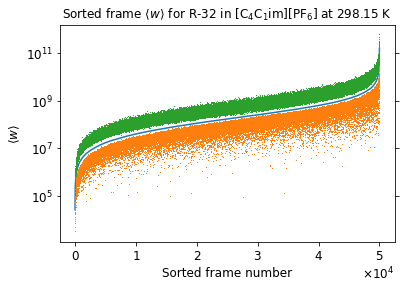

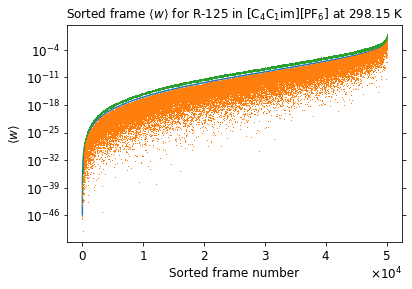

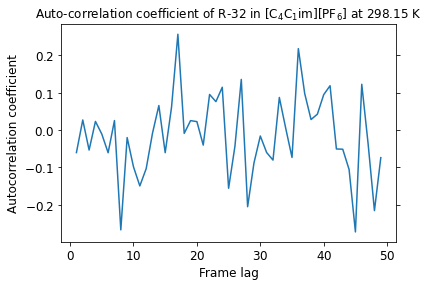

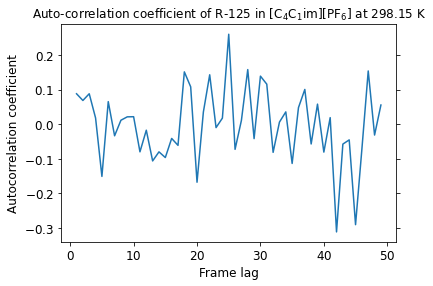

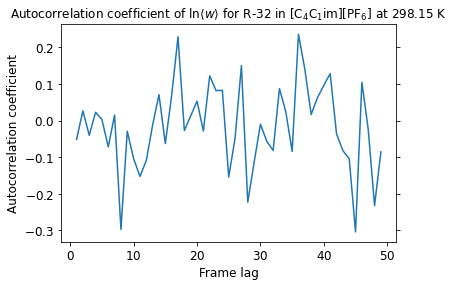

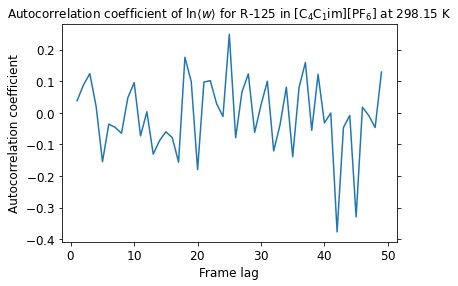

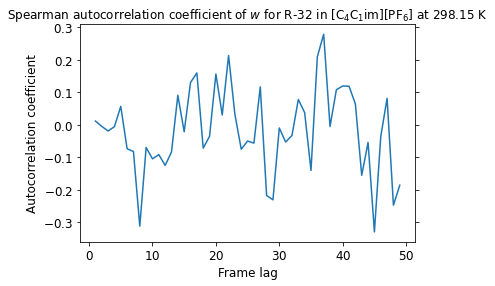

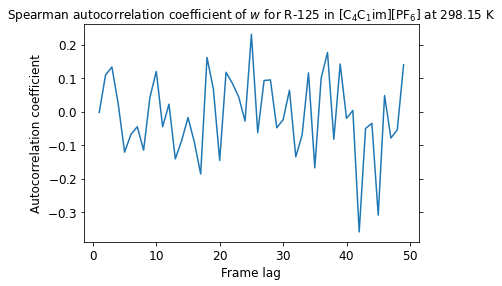

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


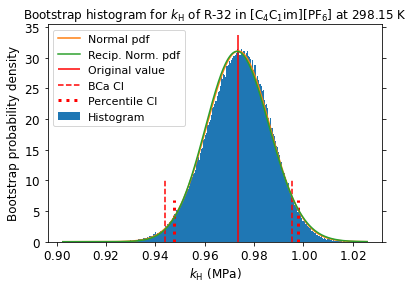

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


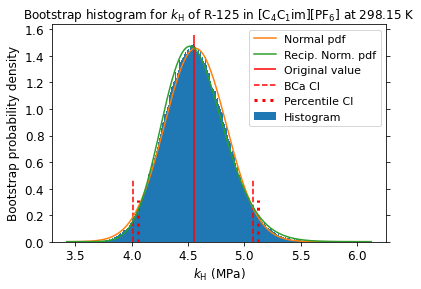

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


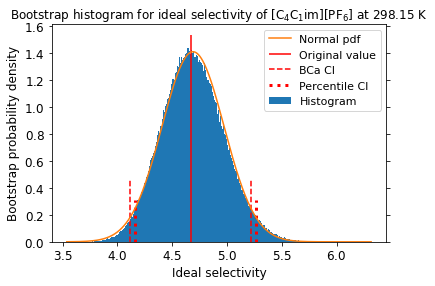

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


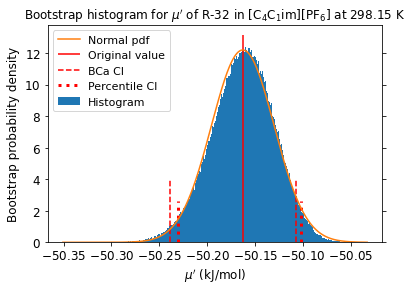

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


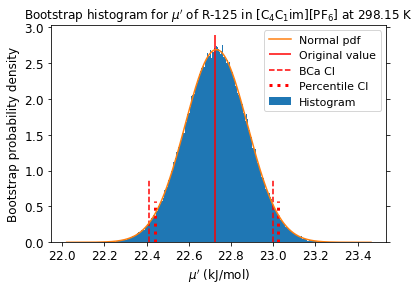

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


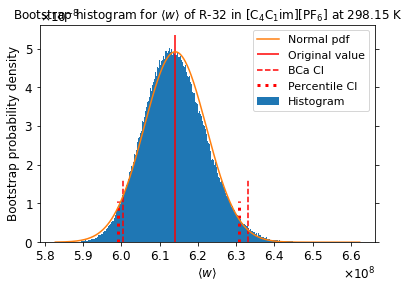

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


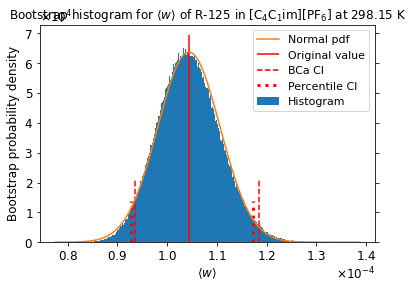

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.001807,0.003506,0.004717,0.015468
Temp,0.003944,-0.003004,0.004393,-0.002556
Volume,0.026730,0.162997,0.009428,0.176513
Press,0.001577,0.006428,0.003256,0.001321
PotEng,0.014599,0.059125,0.011866,0.054732
KinEng,0.003944,-0.003004,0.004393,-0.002556
TotEng,0.013608,0.042686,0.011838,0.039662
E_pair,0.025957,0.116690,0.006516,0.102916
E_vdwl,0.018604,0.101042,0.005866,0.103259
E_coul,0.015427,0.056412,0.003043,0.034245


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.004462,0.004462,0.017212,0.017212
Temp,-0.001332,-0.001332,0.002739,0.002739
Volume,0.153190,0.153190,0.161776,0.161776
Press,0.007574,0.007574,0.004014,0.004014
PotEng,0.055965,0.055965,0.049383,0.049383
KinEng,-0.001332,-0.001332,0.002739,0.002739
TotEng,0.041184,0.041184,0.038992,0.038992
E_pair,0.110738,0.110738,0.093703,0.093703
E_vdwl,0.095714,0.095714,0.094951,0.094951
E_coul,0.052554,0.052554,0.032250,0.032250


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.002960,0.002960,0.011492,0.011492
Temp,-0.000902,-0.000902,0.001841,0.001841
Volume,0.102411,0.102411,0.108368,0.108368
Press,0.005059,0.005059,0.002663,0.002663
PotEng,0.037338,0.037338,0.032889,0.032889
KinEng,-0.000902,-0.000902,0.001841,0.001841
TotEng,0.027433,0.027433,0.025977,0.025977
E_pair,0.073976,0.073976,0.062607,0.062607
E_vdwl,0.063916,0.063916,0.063527,0.063527
E_coul,0.035073,0.035073,0.021520,0.021520


R-32 w column correlation (first 5 columns):
 [[1.00000000e+00 3.37353917e-03 3.02665117e-04 5.97665611e-04
  2.78675990e-03]
 [3.37353917e-03 1.00000000e+00 5.42153853e-03 7.96431386e-03
  1.01957834e-02]
 [3.02665117e-04 5.42153853e-03 1.00000000e+00 2.46600347e-03
  4.57262377e-03]
 [5.97665611e-04 7.96431386e-03 2.46600347e-03 1.00000000e+00
  2.59922840e-03]
 [2.78675990e-03 1.01957834e-02 4.57262377e-03 2.59922840e-03
  1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.318909   0.31719986 0.32419942 0.31472287]
 [0.318909   1.         0.31897106 0.3214289  0.32059951]
 [0.31719986 0.31897106 1.         0.32135282 0.31746543]
 [0.32419942 0.3214289  0.32135282 1.         0.3292529 ]
 [0.31472287 0.32059951 0.31746543 0.3292529  1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.30839516 0.30642359 0.31470662 0.30407131]
 [0.30839516 1.         0.30783769 0.3111281  0.30951924]
 [0.30642359 0.30783769 1.         0.306

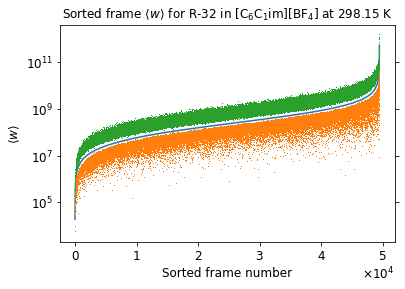

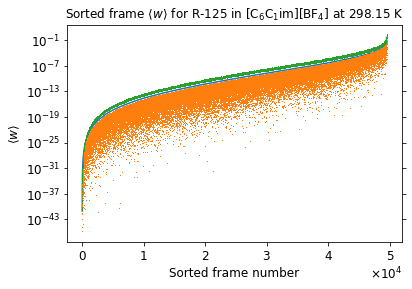

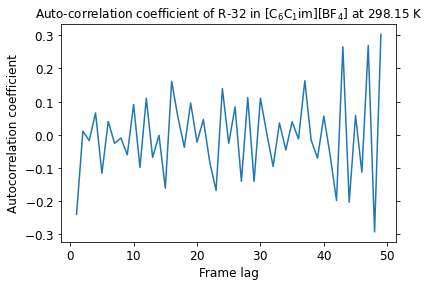

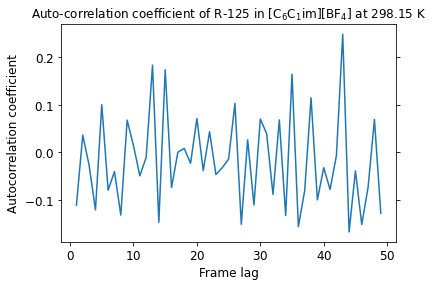

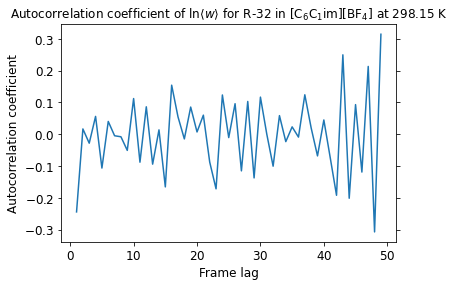

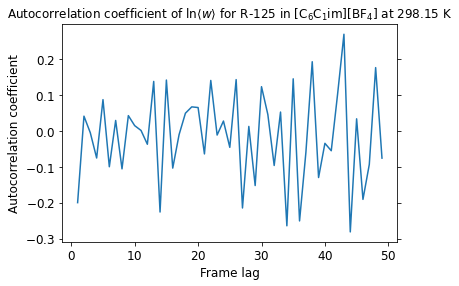

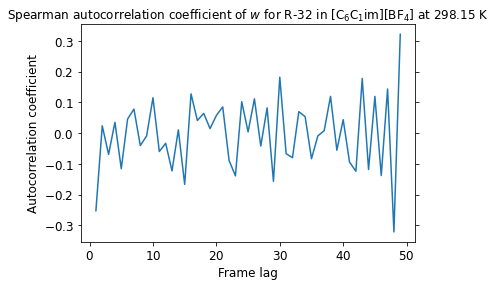

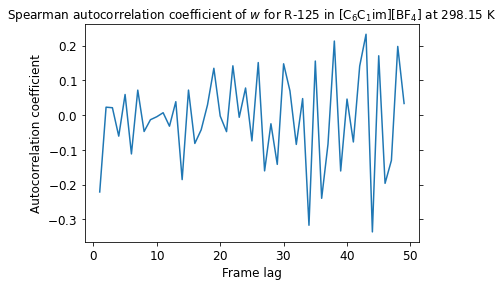

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


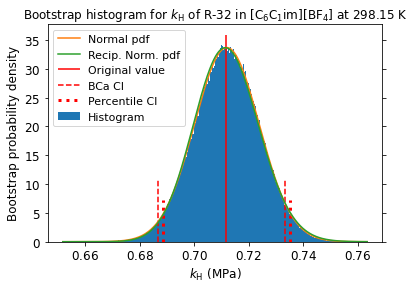

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


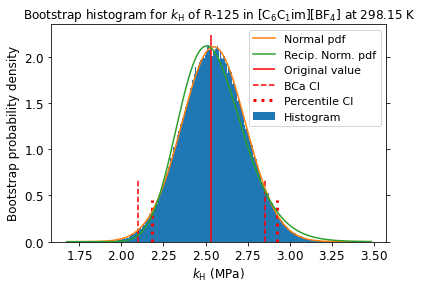

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


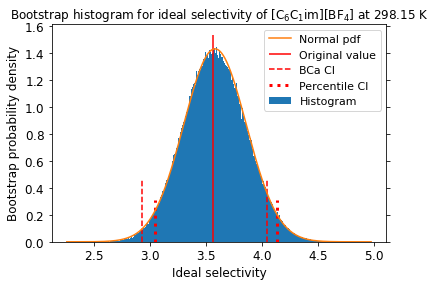

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


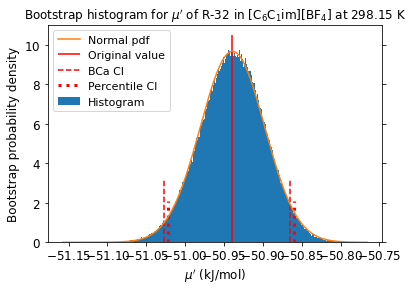

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


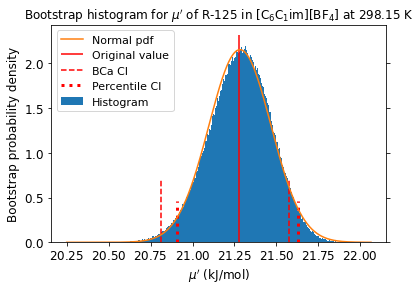

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


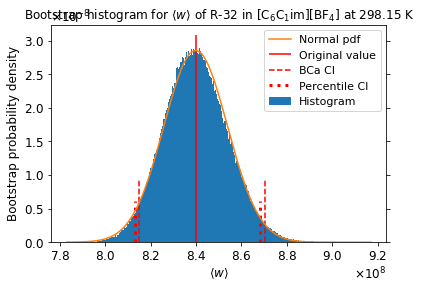

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


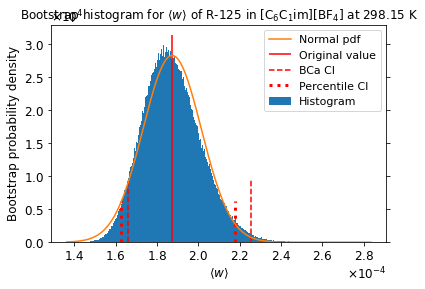

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.010142,-0.042443,-0.003951,-0.024002
Temp,0.006332,-0.004469,0.004769,-0.003577
Volume,0.010333,0.153720,0.011489,0.178021
Press,0.006498,-0.005343,0.000843,-0.015675
PotEng,0.010478,0.061507,0.002521,0.064417
KinEng,0.006332,-0.004469,0.004769,-0.003577
TotEng,0.012077,0.044138,0.004990,0.046936
E_pair,0.016953,0.104596,0.003405,0.103108
E_vdwl,0.014011,0.087658,0.004799,0.092977
E_coul,0.005687,0.041116,-0.000415,0.034595


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.042601,-0.042601,-0.022033,-0.022033
Temp,-0.003862,-0.003862,-0.000958,-0.000958
Volume,0.144626,0.144626,0.164732,0.164732
Press,-0.002801,-0.002801,-0.013318,-0.013318
PotEng,0.057813,0.057813,0.061866,0.061866
KinEng,-0.003862,-0.003862,-0.000958,-0.000958
TotEng,0.040270,0.040270,0.045484,0.045484
E_pair,0.099408,0.099408,0.095486,0.095486
E_vdwl,0.082699,0.082699,0.087147,0.087147
E_coul,0.038998,0.038998,0.033357,0.033357


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.028260,-0.028260,-0.014806,-0.014806
Temp,-0.002574,-0.002574,-0.000617,-0.000617
Volume,0.096811,0.096811,0.110275,0.110275
Press,-0.001861,-0.001861,-0.008864,-0.008864
PotEng,0.038573,0.038573,0.041249,0.041249
KinEng,-0.002574,-0.002574,-0.000617,-0.000617
TotEng,0.026857,0.026857,0.030332,0.030332
E_pair,0.066409,0.066409,0.063781,0.063781
E_vdwl,0.055198,0.055198,0.058116,0.058116
E_coul,0.026009,0.026009,0.022246,0.022246


R-32 w column correlation (first 5 columns):
 [[1.00000000e+00 2.60189185e-02 9.02132467e-04 2.27271635e-03
  2.03915318e-04]
 [2.60189185e-02 1.00000000e+00 8.91733316e-04 5.15794091e-03
  9.16802274e-04]
 [9.02132467e-04 8.91733316e-04 1.00000000e+00 6.97762298e-04
  1.87620218e-03]
 [2.27271635e-03 5.15794091e-03 6.97762298e-04 1.00000000e+00
  3.19696899e-03]
 [2.03915318e-04 9.16802274e-04 1.87620218e-03 3.19696899e-03
  1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.34911671 0.34901315 0.35241552 0.350182  ]
 [0.34911671 1.         0.35135649 0.35170916 0.35635999]
 [0.34901315 0.35135649 1.         0.34450559 0.35282386]
 [0.35241552 0.35170916 0.34450559 1.         0.35089901]
 [0.350182   0.35635999 0.35282386 0.35089901 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.34257156 0.33929046 0.34146324 0.34177178]
 [0.34257156 1.         0.34279211 0.34389884 0.34533863]
 [0.33929046 0.34279211 1.         0.338

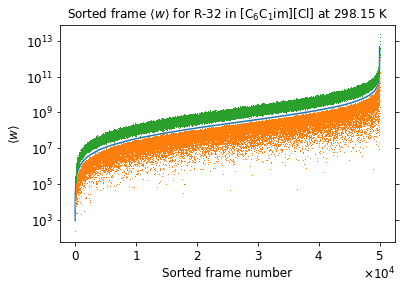

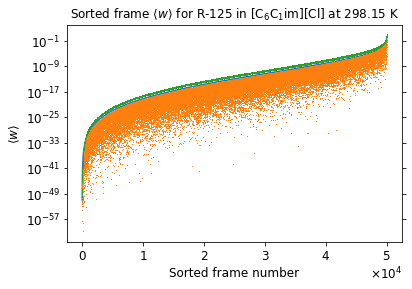

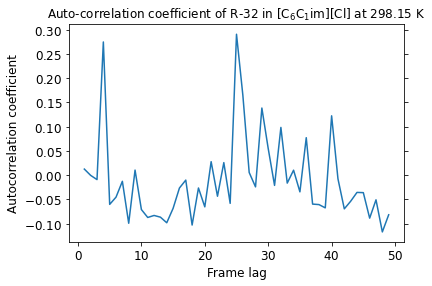

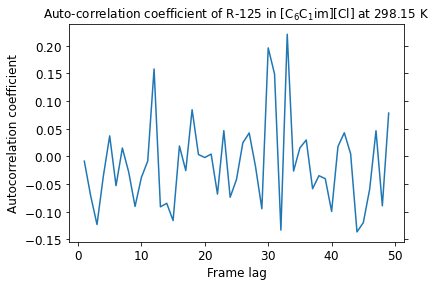

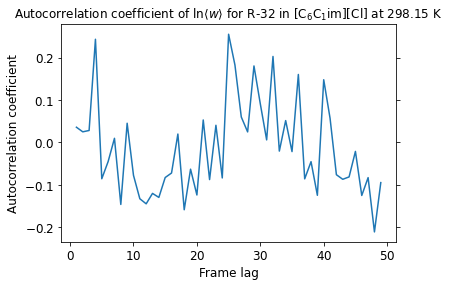

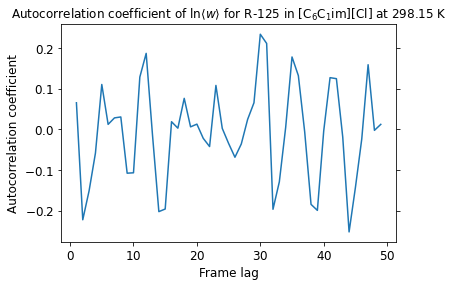

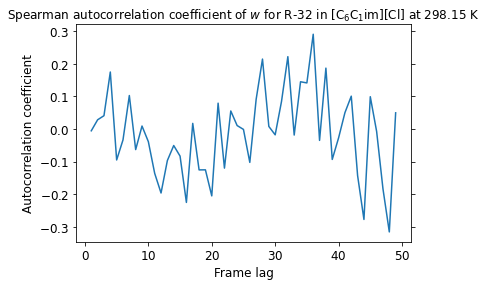

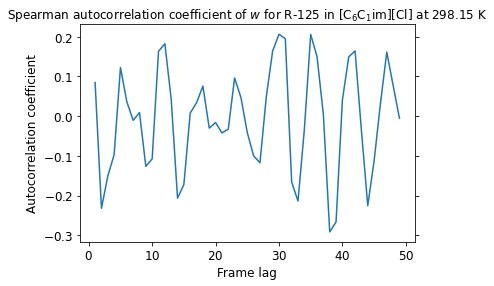

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


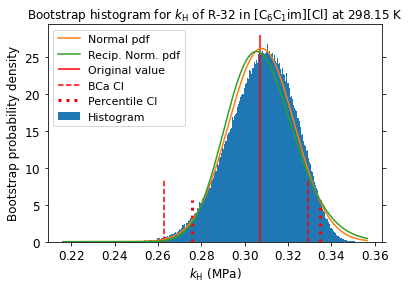

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


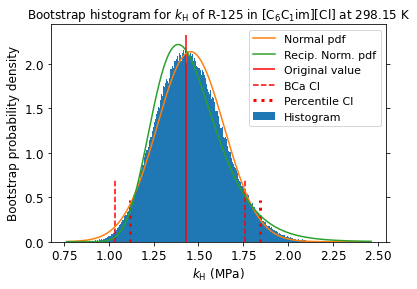

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


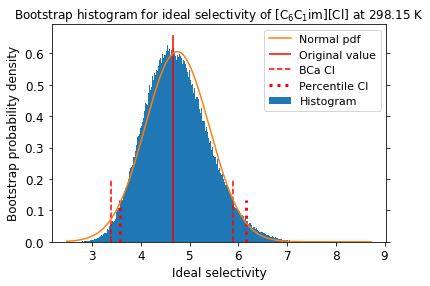

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


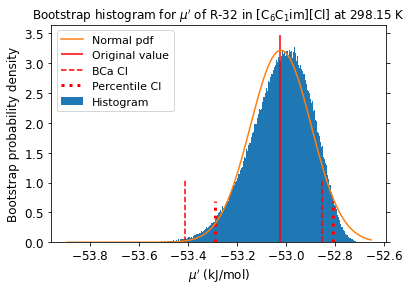

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


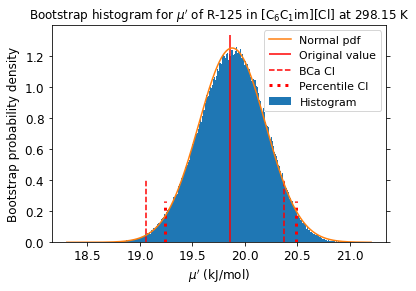

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


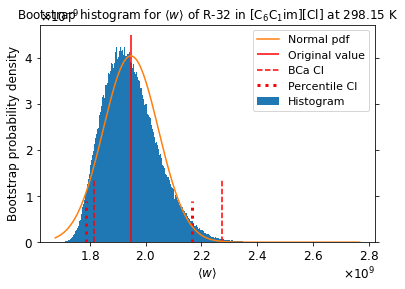

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


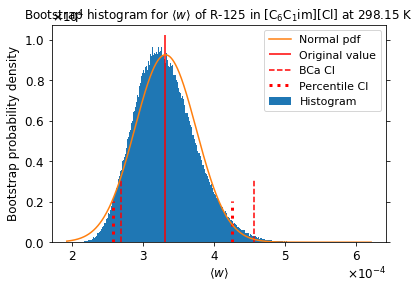

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


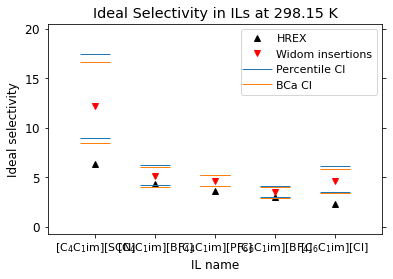

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


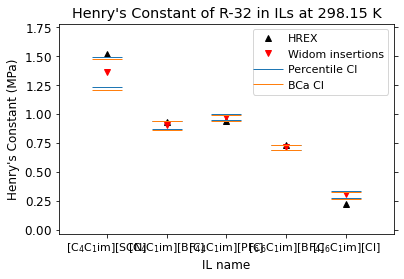

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


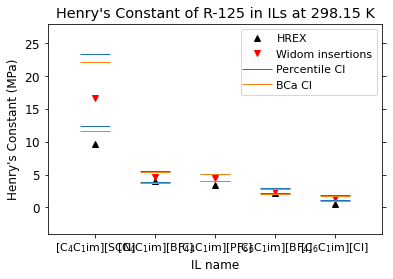

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


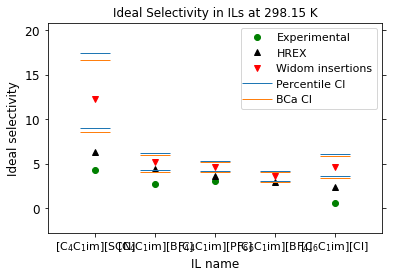

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


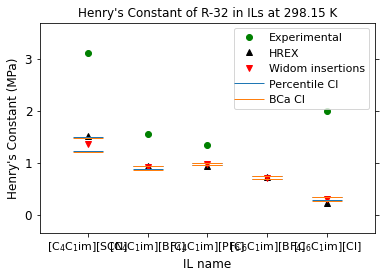

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


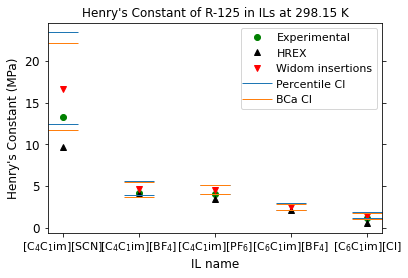

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


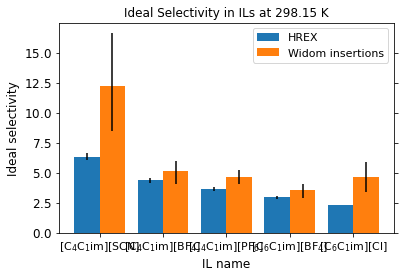

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


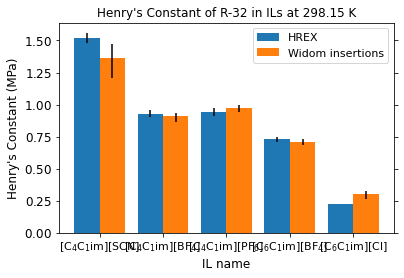

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


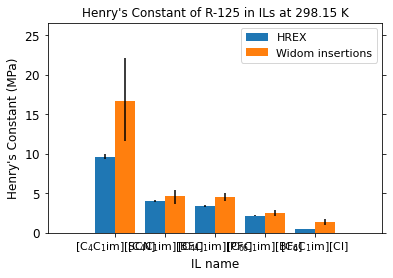

In [96]:
plot_results("Eij_max_estimation_1/hbs", "Eij_max_estimation_1", bs_axis=1, get_fbs=True, get_corr=True)

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.004094,-0.003274,0.009835,-0.003577
Temp,0.003750,-0.001042,0.001556,-0.001401
Volume,0.005750,0.156033,-0.000977,0.158417
Press,-0.001064,-0.008034,-0.004185,-0.008777
PotEng,-0.000657,0.065505,-0.002053,0.065270
KinEng,0.003750,-0.001042,0.001556,-0.001401
TotEng,0.001948,0.048865,-0.000539,0.048447
E_pair,0.005417,0.103515,0.001631,0.102822
E_vdwl,0.003820,0.098439,0.002131,0.100489
E_coul,0.003607,0.039595,-0.000196,0.037485


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.004241,-0.004241,-0.002097,-0.003395
Temp,-0.003879,-0.003879,-0.002761,-0.003074
Volume,0.143540,0.143540,0.152390,0.148519
Press,-0.008630,-0.008630,-0.008283,-0.008222
PotEng,0.062565,0.062565,0.060185,0.059011
KinEng,-0.003879,-0.003879,-0.002762,-0.003074
TotEng,0.044981,0.044981,0.043592,0.042420
E_pair,0.094590,0.094590,0.096648,0.094239
E_vdwl,0.089621,0.089621,0.093373,0.091294
E_coul,0.035571,0.035571,0.034910,0.033463


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.002831,-0.002831,-0.001430,-0.002290
Temp,-0.002575,-0.002575,-0.001846,-0.002053
Volume,0.096087,0.096087,0.102011,0.099379
Press,-0.005754,-0.005754,-0.005510,-0.005470
PotEng,0.041725,0.041725,0.040152,0.039367
KinEng,-0.002575,-0.002575,-0.001846,-0.002053
TotEng,0.030035,0.030035,0.029080,0.028299
E_pair,0.063130,0.063130,0.064507,0.062885
E_vdwl,0.059817,0.059817,0.062267,0.060866
E_coul,0.023712,0.023712,0.023292,0.022326


R-32 w column correlation (first 5 columns):
 [[ 1.00000000e+00 -1.01355366e-04 -2.52131575e-05  3.06377664e-03
  -1.54992587e-04]
 [-1.01355366e-04  1.00000000e+00 -4.22932472e-05 -1.64712382e-04
   7.48259491e-04]
 [-2.52131575e-05 -4.22932472e-05  1.00000000e+00  9.87836709e-04
  -1.77351747e-04]
 [ 3.06377664e-03 -1.64712382e-04  9.87836709e-04  1.00000000e+00
  -1.40973340e-04]
 [-1.54992587e-04  7.48259491e-04 -1.77351747e-04 -1.40973340e-04
   1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.13993892 0.12838318 0.13117267        nan]
 [0.13993892 1.         0.1251832  0.13566133        nan]
 [0.12838318 0.1251832  1.         0.13542383        nan]
 [0.13117267 0.13566133 0.13542383 1.                nan]
 [       nan        nan        nan        nan        nan]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.1450277  0.1357062  0.14251525 0.15001874]
 [0.1450277  1.         0.13263383 0.14477524 0.13745482]
 [0.1357062  0.

10 highest observations are:

[[2.04827134e+11 1.06424015e-02]
 [2.13902340e+11 1.09497161e-02]
 [2.27956692e+11 1.13423481e-02]
 [2.39398543e+11 1.16164909e-02]
 [2.60405575e+11 1.36240380e-02]
 [2.78732418e+11 2.03151922e-02]
 [3.15005880e+11 2.07745010e-02]
 [3.19980869e+11 2.14071796e-02]
 [6.02016228e+11 6.43661152e-02]
 [1.18145246e+12 7.86495408e-02]]
with indices:

[[27083 45355]
 [30868 29816]
 [13405 13123]
 [34874 49297]
 [43222 11833]
 [21379 42212]
 [38617  7808]
 [27566 34555]
 [25401 47570]
 [ 4904 49570]]


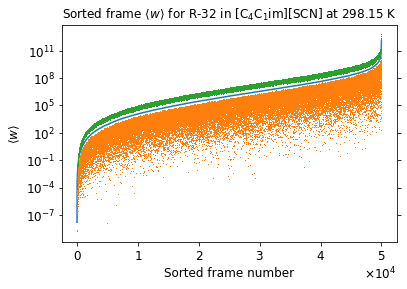

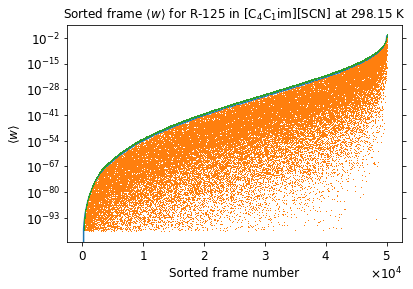

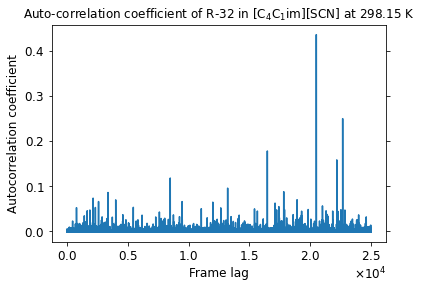

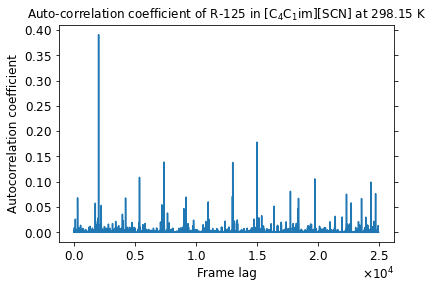

/afs/crc.nd.edu/user/r/rsmith56/miniconda3/envs/plotting/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in log
/afs/crc.nd.edu/user/r/rsmith56/miniconda3/envs/plotting/lib/python3.7/site-packages/numpy/core/_methods.py:229: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)
/afs/crc.nd.edu/user/r/rsmith56/miniconda3/envs/plotting/lib/python3.7/site-packages/ipykernel_launcher.py:8: RuntimeWarning: invalid value encountered in subtract
  


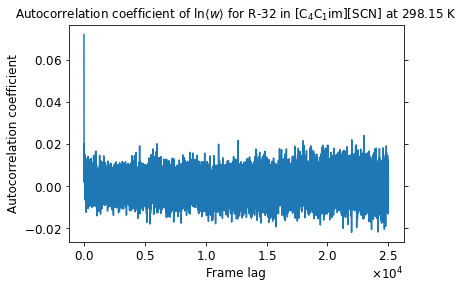

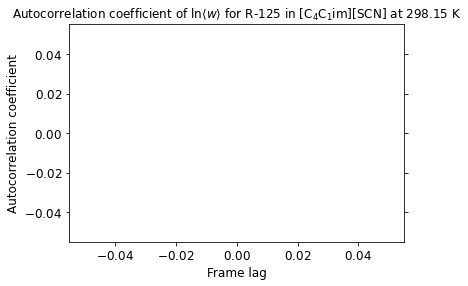

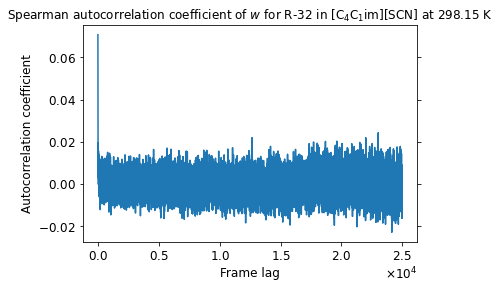

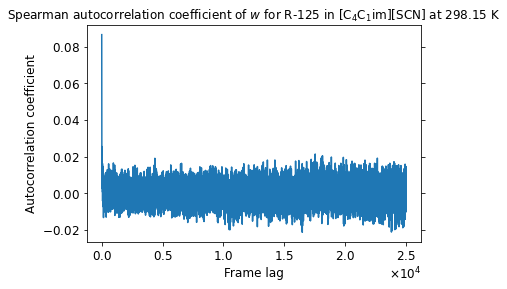

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


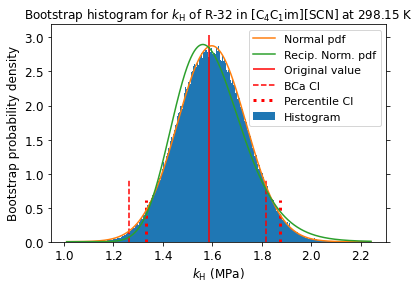

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


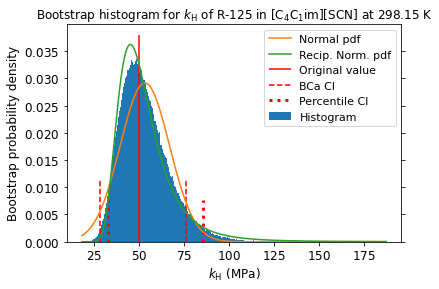

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


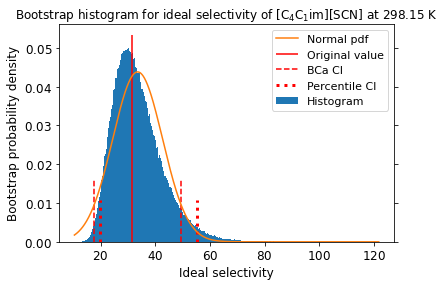

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


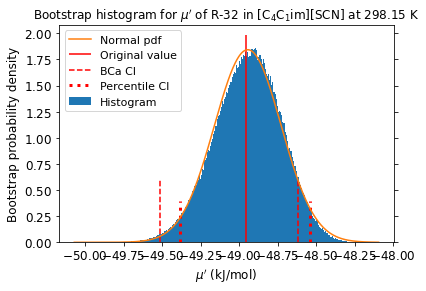

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


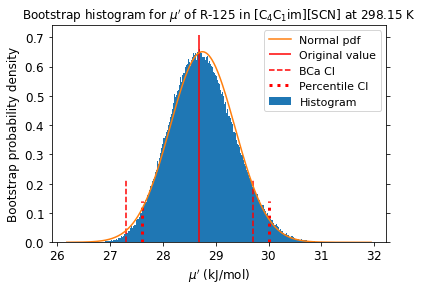

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


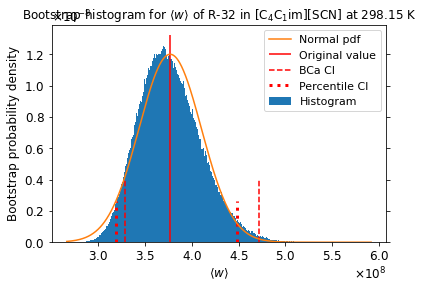

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


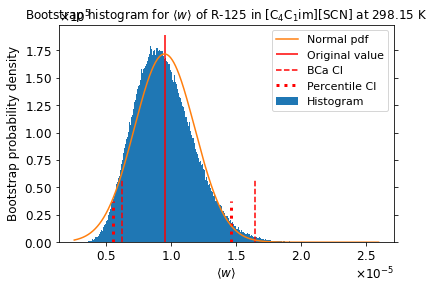

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.000488,0.014947,-0.000255,0.021984
Temp,-0.007144,-0.003439,0.001291,-0.001005
Volume,0.010482,0.157436,0.000857,0.181183
Press,-0.001300,-0.008888,0.004640,-0.006752
PotEng,0.001917,0.066232,0.001888,0.074505
KinEng,-0.007144,-0.003439,0.001291,-0.001005
TotEng,-0.003240,0.047639,0.002269,0.055468
E_pair,0.009640,0.109963,0.002381,0.114637
E_vdwl,0.011416,0.104670,-0.003252,0.110540
E_coul,-0.000215,0.045866,0.007669,0.047771


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.013710,0.013710,0.020462,0.020462
Temp,-0.003541,-0.003541,-0.001108,-0.001108
Volume,0.148015,0.148015,0.167609,0.167609
Press,-0.009239,-0.009239,-0.005392,-0.005392
PotEng,0.062742,0.062742,0.071870,0.071870
KinEng,-0.003541,-0.003541,-0.001108,-0.001108
TotEng,0.044550,0.044550,0.052969,0.052969
E_pair,0.102318,0.102318,0.104774,0.104774
E_vdwl,0.097992,0.097992,0.102215,0.102215
E_coul,0.042127,0.042127,0.042184,0.042184


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.009149,0.009149,0.013625,0.013625
Temp,-0.002366,-0.002366,-0.000731,-0.000731
Volume,0.099012,0.099012,0.112304,0.112304
Press,-0.006169,-0.006169,-0.003588,-0.003588
PotEng,0.041824,0.041824,0.047948,0.047948
KinEng,-0.002366,-0.002366,-0.000731,-0.000731
TotEng,0.029686,0.029686,0.035293,0.035293
E_pair,0.068271,0.068271,0.070006,0.070006
E_vdwl,0.065430,0.065430,0.068373,0.068373
E_coul,0.028081,0.028081,0.028130,0.028130


R-32 w column correlation (first 5 columns):
 [[ 1.00000000e+00  8.35351567e-04 -6.96525417e-05 -9.96247349e-05
   1.57516736e-04]
 [ 8.35351567e-04  1.00000000e+00  4.75289976e-03  4.87609384e-04
   2.20674520e-03]
 [-6.96525417e-05  4.75289976e-03  1.00000000e+00  2.10729546e-03
  -1.72717660e-04]
 [-9.96247349e-05  4.87609384e-04  2.10729546e-03  1.00000000e+00
  -2.60973253e-04]
 [ 1.57516736e-04  2.20674520e-03 -1.72717660e-04 -2.60973253e-04
   1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.14040318 0.14544025 0.14321816 0.14141293]
 [0.14040318 1.         0.13435651 0.14432586 0.14191152]
 [0.14544025 0.13435651 1.         0.14300732 0.14269558]
 [0.14321816 0.14432586 0.14300732 1.         0.13707884]
 [0.14141293 0.14191152 0.14269558 0.13707884 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.15091164 0.15389399 0.15575884 0.14844493]
 [0.15091164 1.         0.14460609 0.15255264 0.15060837]
 [0.15389399 0.

10 highest observations are:

[[1.43279269e+11 1.64891477e-01]
 [1.60577788e+11 1.67431518e-01]
 [1.75496685e+11 1.80379454e-01]
 [1.78603713e+11 1.87279540e-01]
 [3.13774374e+11 2.08542985e-01]
 [3.54406854e+11 2.10773881e-01]
 [3.61860951e+11 2.27335221e-01]
 [4.26503788e+11 2.69107579e-01]
 [6.16376223e+11 5.50108457e-01]
 [1.34454961e+12 8.16632223e+00]]
with indices:

[[27643 38872]
 [16407 26624]
 [24005  3851]
 [ 9925 49609]
 [32695 17122]
 [43326 19219]
 [ 4409 21599]
 [32333 28990]
 [22099 23648]
 [27124 24627]]


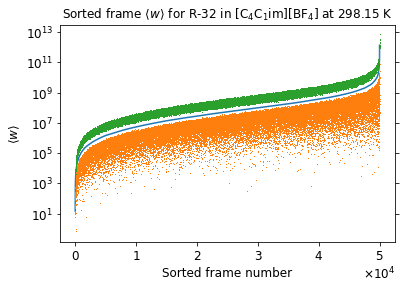

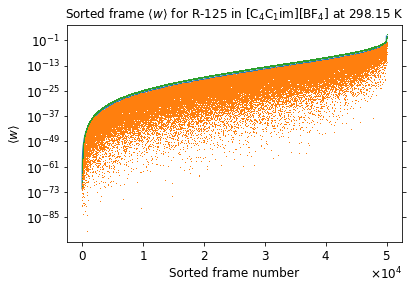

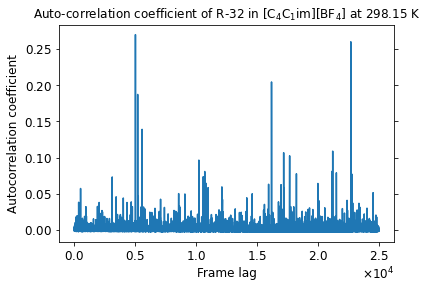

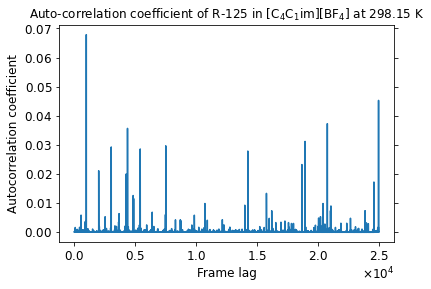

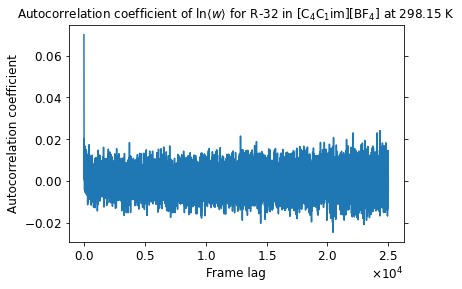

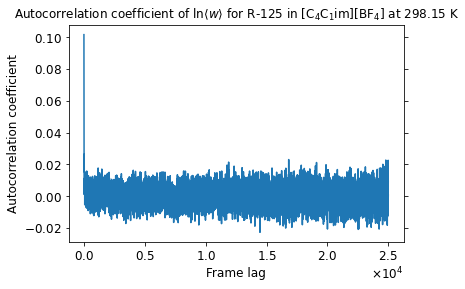

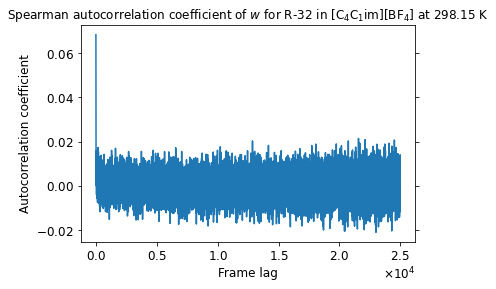

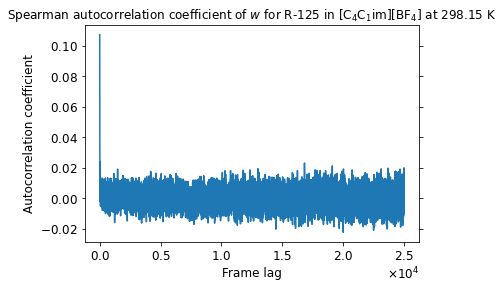

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


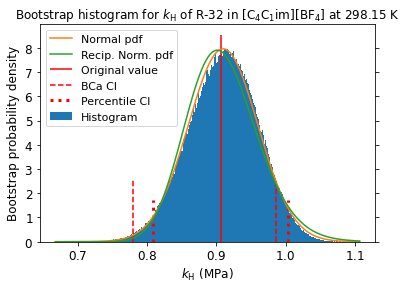

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


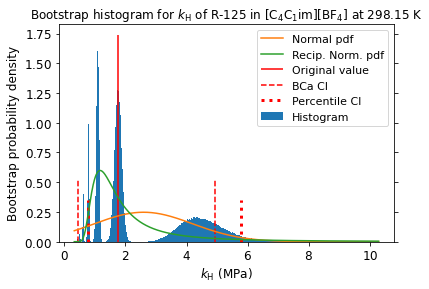

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


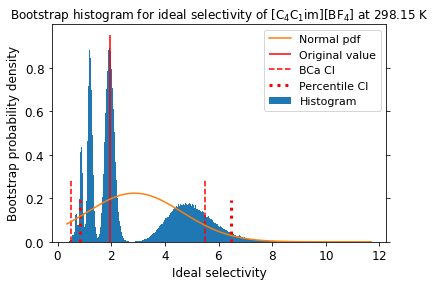

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


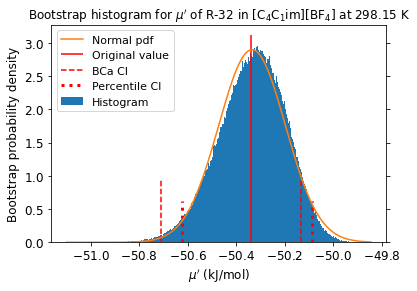

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


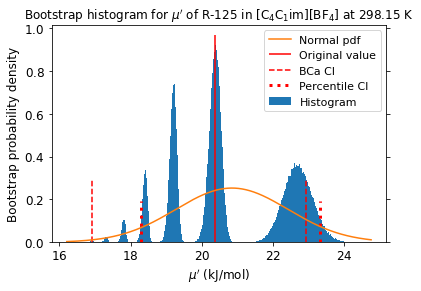

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


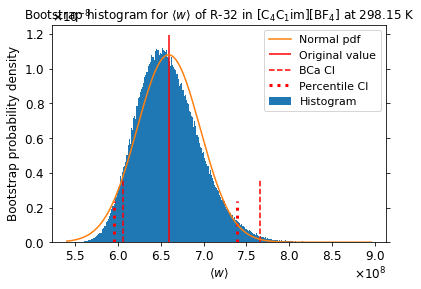

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


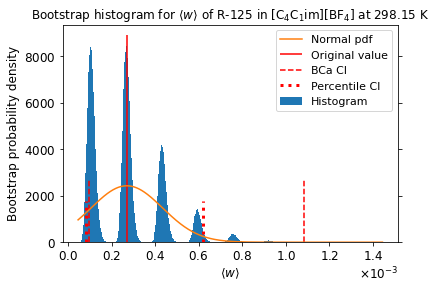

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.006549,0.005969,0.004959,0.007688
Temp,0.007728,0.000076,-0.005083,0.003217
Volume,0.003706,0.155508,0.006186,0.177387
Press,0.001836,-0.001944,-0.008171,-0.001153
PotEng,0.009789,0.064388,0.009248,0.064812
KinEng,0.007728,0.000076,-0.005083,0.003217
TotEng,0.012455,0.048711,0.003663,0.051086
E_pair,0.002535,0.108017,0.006996,0.113521
E_vdwl,-0.000392,0.109493,0.007581,0.118536
E_coul,0.002720,0.039264,0.002128,0.037943


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.005036,0.005036,0.007670,0.007670
Temp,-0.000955,-0.000955,0.004379,0.004379
Volume,0.145291,0.145291,0.162504,0.162504
Press,-0.001824,-0.001824,0.001236,0.001236
PotEng,0.059272,0.059272,0.059835,0.059835
KinEng,-0.000955,-0.000955,0.004379,0.004379
TotEng,0.044093,0.044093,0.048576,0.048576
E_pair,0.100778,0.100778,0.103082,0.103082
E_vdwl,0.101764,0.101764,0.107281,0.107281
E_coul,0.035773,0.035773,0.033624,0.033624


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.003385,0.003385,0.005160,0.005160
Temp,-0.000626,-0.000626,0.002926,0.002926
Volume,0.097360,0.097360,0.108813,0.108813
Press,-0.001207,-0.001207,0.000814,0.000814
PotEng,0.039569,0.039569,0.039926,0.039926
KinEng,-0.000626,-0.000626,0.002926,0.002926
TotEng,0.029470,0.029470,0.032457,0.032457
E_pair,0.067343,0.067343,0.068838,0.068838
E_vdwl,0.067977,0.067977,0.071686,0.071686
E_coul,0.023871,0.023871,0.022446,0.022446


R-32 w column correlation (first 5 columns):
 [[ 1.00000000e+00 -9.24216135e-07 -1.83821072e-04  5.10694660e-04
   8.36968009e-05]
 [-9.24216135e-07  1.00000000e+00 -2.42221017e-04 -2.27976921e-04
  -9.43522353e-05]
 [-1.83821072e-04 -2.42221017e-04  1.00000000e+00 -1.29337720e-04
   1.10772501e-03]
 [ 5.10694660e-04 -2.27976921e-04 -1.29337720e-04  1.00000000e+00
  -8.42166387e-04]
 [ 8.36968009e-05 -9.43522353e-05  1.10772501e-03 -8.42166387e-04
   1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.13646225 0.12880344 0.13020445 0.12989797]
 [0.13646225 1.         0.12594618 0.1291931  0.1295033 ]
 [0.12880344 0.12594618 1.         0.13238926 0.12493166]
 [0.13020445 0.1291931  0.13238926 1.         0.13082611]
 [0.12989797 0.1295033  0.12493166 0.13082611 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.14032844 0.13454716 0.13736994 0.13782297]
 [0.14032844 1.         0.13581997 0.13490342 0.1361052 ]
 [0.13454716 0.

10 highest observations are:

[[1.28962929e+11 8.03601269e-02]
 [1.31395090e+11 8.72459749e-02]
 [1.37130184e+11 1.17419565e-01]
 [1.38440308e+11 1.26973079e-01]
 [1.63594256e+11 1.39008555e-01]
 [1.69555791e+11 2.38413055e-01]
 [1.70555660e+11 2.67414169e-01]
 [1.81194604e+11 3.81348420e-01]
 [2.28400140e+11 5.53684709e-01]
 [6.69236983e+11 1.22348483e+00]]
with indices:

[[46188 14579]
 [19971 12783]
 [23858 42148]
 [44857 37116]
 [35502 21080]
 [19246 32694]
 [33932 32076]
 [17526 24539]
 [46614  9866]
 [31651 45734]]


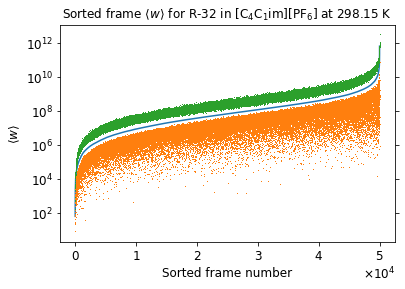

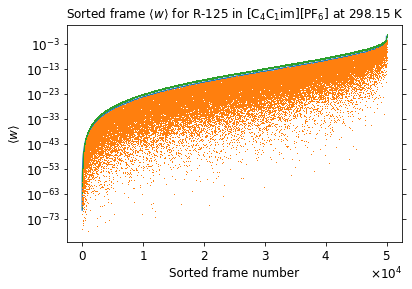

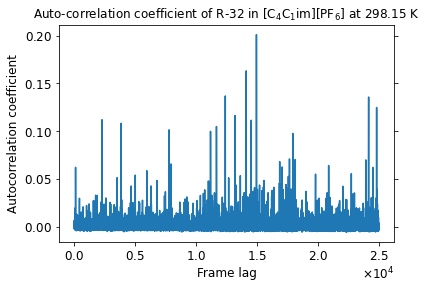

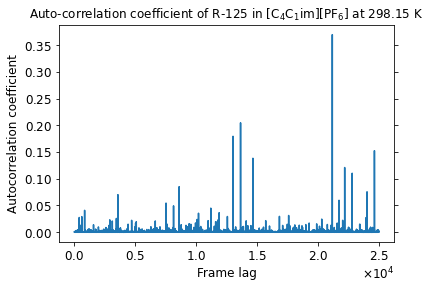

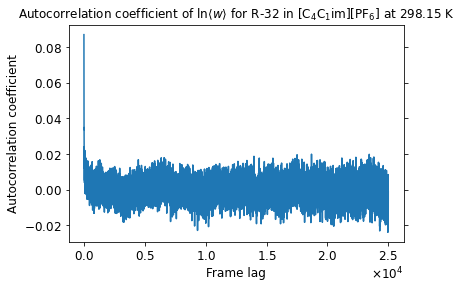

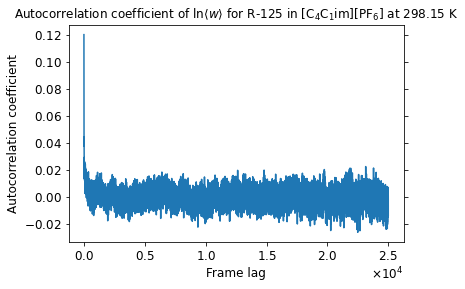

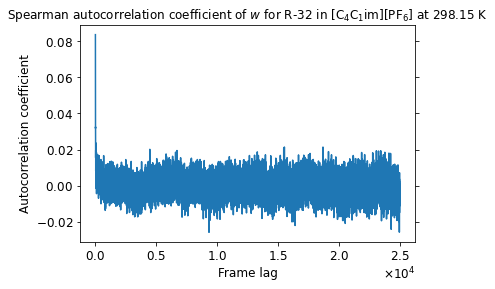

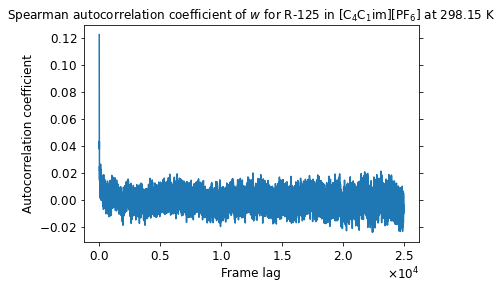

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


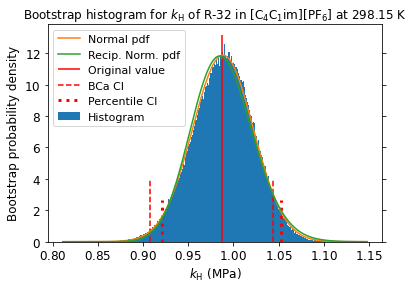

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


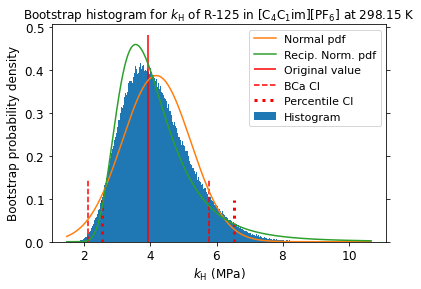

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


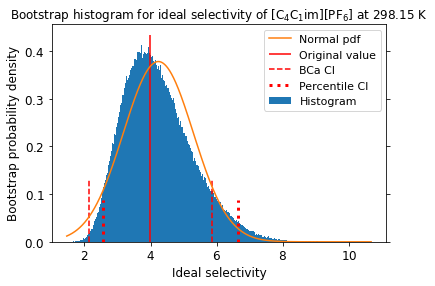

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


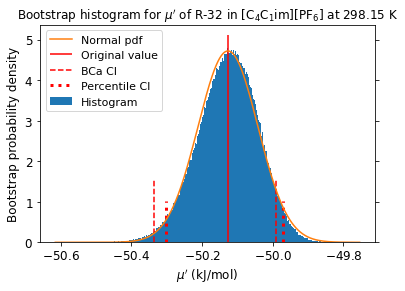

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


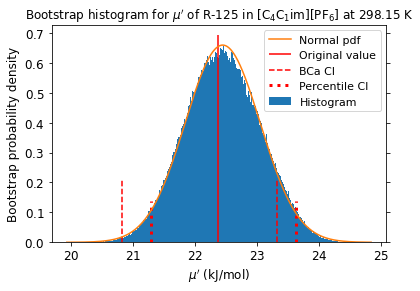

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


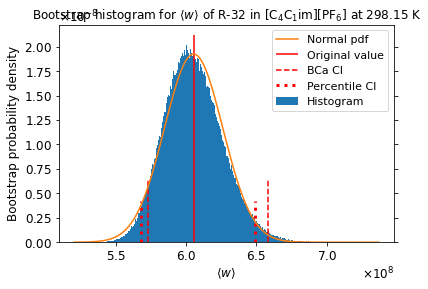

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


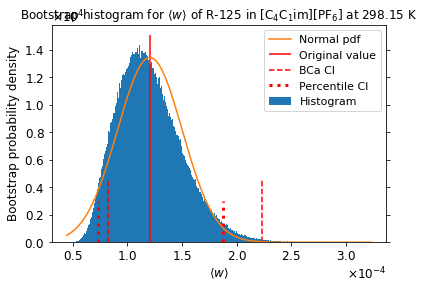

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.000813,0.009029,-0.008141,0.016726
Temp,-0.002151,-0.008014,-0.004272,-0.003271
Volume,0.002242,0.150067,0.008150,0.170669
Press,-0.001170,-0.000887,-0.008952,0.001146
PotEng,0.002691,0.055473,0.009251,0.054609
KinEng,-0.002151,-0.008014,-0.004272,-0.003271
TotEng,0.000623,0.036648,0.004189,0.039101
E_pair,0.007926,0.099215,0.005881,0.100215
E_vdwl,0.005710,0.092662,0.002117,0.101697
E_coul,0.006584,0.040727,0.007042,0.031446


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.007770,0.007770,0.017274,0.017274
Temp,-0.004802,-0.004802,0.000445,0.000445
Volume,0.141414,0.141414,0.156622,0.156622
Press,-0.000494,-0.000494,0.003752,0.003752
PotEng,0.052741,0.052741,0.049389,0.049389
KinEng,-0.004802,-0.004802,0.000445,0.000445
TotEng,0.036285,0.036285,0.037391,0.037391
E_pair,0.094878,0.094878,0.089794,0.089794
E_vdwl,0.088330,0.088330,0.090945,0.090945
E_coul,0.038743,0.038743,0.029896,0.029896


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.005173,0.005173,0.011511,0.011511
Temp,-0.003220,-0.003220,0.000305,0.000305
Volume,0.094554,0.094554,0.104833,0.104833
Press,-0.000333,-0.000333,0.002476,0.002476
PotEng,0.035111,0.035111,0.032909,0.032909
KinEng,-0.003220,-0.003220,0.000306,0.000306
TotEng,0.024145,0.024145,0.024948,0.024948
E_pair,0.063249,0.063249,0.060026,0.060026
E_vdwl,0.058914,0.058914,0.060846,0.060846
E_coul,0.025801,0.025801,0.019944,0.019944


R-32 w column correlation (first 5 columns):
 [[ 1.00000000e+00  1.57809219e-03  6.08536538e-03 -5.96462232e-04
   5.18128929e-03]
 [ 1.57809219e-03  1.00000000e+00 -2.78290631e-04  3.04677929e-03
   4.92436056e-04]
 [ 6.08536538e-03 -2.78290631e-04  1.00000000e+00  9.72517913e-04
  -3.24685410e-04]
 [-5.96462232e-04  3.04677929e-03  9.72517913e-04  1.00000000e+00
   9.34009573e-04]
 [ 5.18128929e-03  4.92436056e-04 -3.24685410e-04  9.34009573e-04
   1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.13120207 0.13410361 0.13494169 0.12747868]
 [0.13120207 1.         0.13106556 0.12992141 0.12664798]
 [0.13410361 0.13106556 1.         0.13020129 0.13086561]
 [0.13494169 0.12992141 0.13020129 1.         0.12931232]
 [0.12747868 0.12664798 0.13086561 0.12931232 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.14358128 0.13869828 0.1400031  0.13603777]
 [0.14358128 1.         0.13834504 0.14038288 0.13928693]
 [0.13869828 0.

10 highest observations are:

[[2.52356671e+11 1.27983489e-01]
 [2.64470985e+11 1.32979860e-01]
 [2.98781280e+11 1.39732877e-01]
 [4.47889885e+11 1.48733251e-01]
 [4.77804400e+11 1.61588783e-01]
 [5.36448127e+11 1.84459387e-01]
 [7.26107341e+11 3.65725454e-01]
 [8.88920133e+11 3.87774958e-01]
 [1.24168710e+12 1.05659710e+00]
 [3.40295318e+12 1.95663299e+00]]
with indices:

[[33368 10164]
 [23537  1179]
 [ 9217 30864]
 [ 6089  1875]
 [40541 29811]
 [31804 17032]
 [46621  3101]
 [   77 36011]
 [29678 16135]
 [24708  6040]]


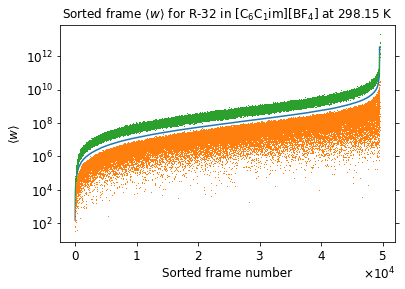

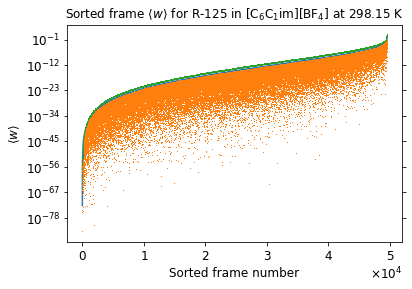

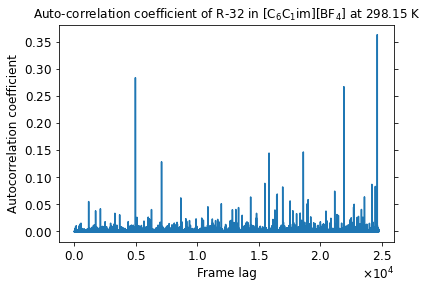

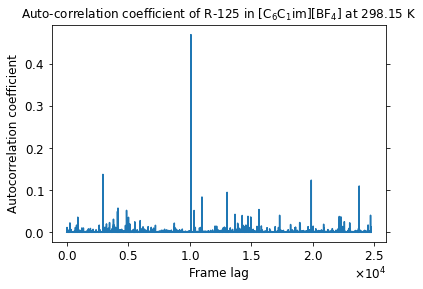

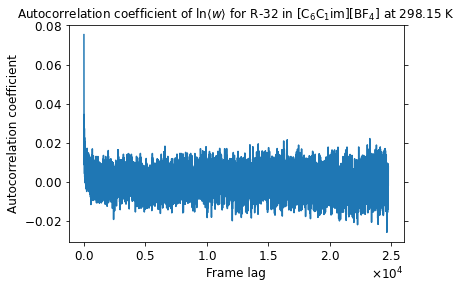

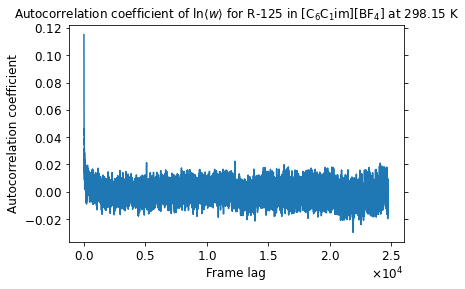

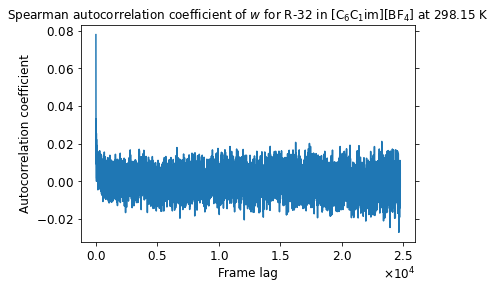

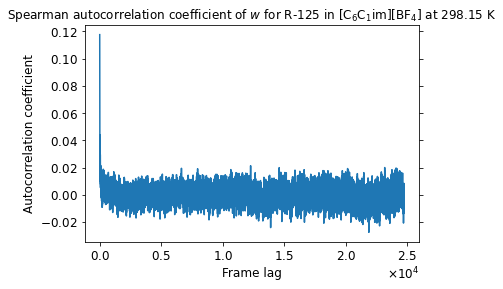

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


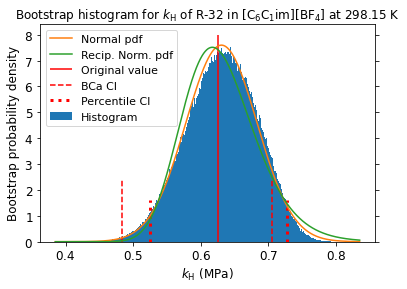

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


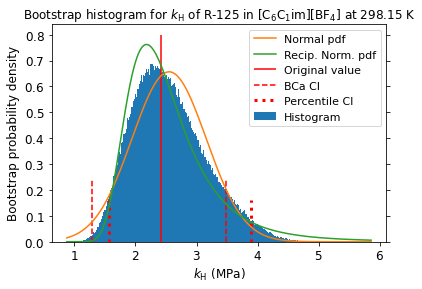

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


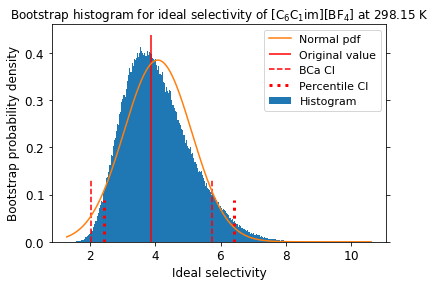

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


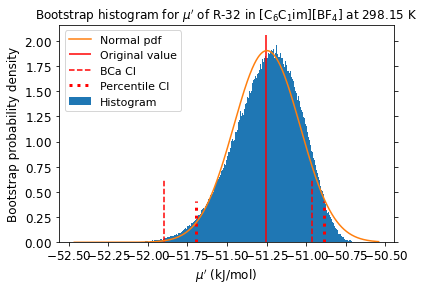

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


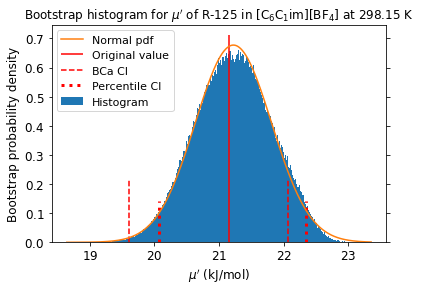

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


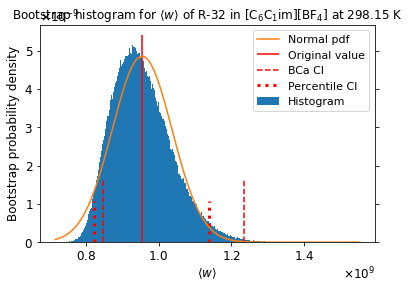

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


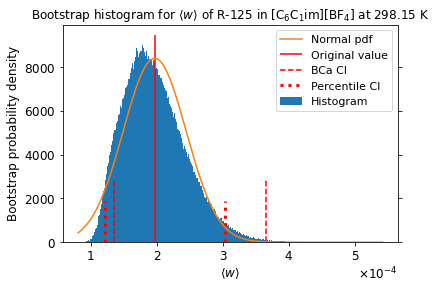

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.004591,-0.036325,0.006637,-0.017627
Temp,-0.003022,-0.003659,0.010984,-0.006744
Volume,0.017946,0.151725,-0.003845,0.185051
Press,0.003153,-0.005783,-0.003326,-0.015749
PotEng,0.014303,0.058880,-0.002077,0.067548
KinEng,-0.003022,-0.003659,0.010984,-0.006744
TotEng,0.008990,0.042651,0.005470,0.047294
E_pair,0.016670,0.096847,-0.005365,0.109069
E_vdwl,0.016457,0.080896,0.001192,0.100699
E_coul,0.002517,0.040012,-0.008393,0.034574


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.037274,-0.037274,-0.017090,-0.017090
Temp,-0.002118,-0.002118,-0.005292,-0.005292
Volume,0.140890,0.140890,0.170435,0.170435
Press,-0.003920,-0.003920,-0.014932,-0.014932
PotEng,0.054983,0.054983,0.061258,0.061258
KinEng,-0.002118,-0.002118,-0.005292,-0.005292
TotEng,0.039494,0.039494,0.042010,0.042010
E_pair,0.089056,0.089056,0.099344,0.099344
E_vdwl,0.075179,0.075179,0.093535,0.093535
E_coul,0.037074,0.037074,0.030097,0.030097


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.024765,-0.024765,-0.011398,-0.011398
Temp,-0.001404,-0.001404,-0.003528,-0.003528
Volume,0.094298,0.094298,0.114205,0.114205
Press,-0.002621,-0.002621,-0.009956,-0.009956
PotEng,0.036688,0.036688,0.040905,0.040905
KinEng,-0.001404,-0.001404,-0.003528,-0.003528
TotEng,0.026363,0.026363,0.028047,0.028047
E_pair,0.059547,0.059547,0.066351,0.066351
E_vdwl,0.050166,0.050166,0.062425,0.062425
E_coul,0.024737,0.024737,0.020100,0.020100


R-32 w column correlation (first 5 columns):
 [[ 1.00000000e+00 -3.87505163e-04 -2.63937091e-04  1.15794544e-03
  -3.47373405e-04]
 [-3.87505163e-04  1.00000000e+00  4.22641527e-04 -4.36806411e-04
  -2.75225132e-04]
 [-2.63937091e-04  4.22641527e-04  1.00000000e+00  1.18786731e-04
  -1.74164430e-04]
 [ 1.15794544e-03 -4.36806411e-04  1.18786731e-04  1.00000000e+00
   5.33825844e-04]
 [-3.47373405e-04 -2.75225132e-04 -1.74164430e-04  5.33825844e-04
   1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.14928063 0.13767289 0.14478252 0.14373624]
 [0.14928063 1.         0.14327647 0.13960729 0.13935408]
 [0.13767289 0.14327647 1.         0.14414636 0.1352374 ]
 [0.14478252 0.13960729 0.14414636 1.         0.13788301]
 [0.14373624 0.13935408 0.1352374  0.13788301 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.15750957 0.14467297 0.15851656 0.15191107]
 [0.15750957 1.         0.15098492 0.15181691 0.15107038]
 [0.14467297 0.

10 highest observations are:

[[5.97104858e+11 3.50223411e-01]
 [6.06391766e+11 4.50637003e-01]
 [7.32203145e+11 4.52169405e-01]
 [7.83831655e+11 5.61547899e-01]
 [8.05463622e+11 6.05897530e-01]
 [9.22116984e+11 1.12365685e+00]
 [9.50117713e+11 1.24771233e+00]
 [1.04777817e+12 1.59414622e+00]
 [1.23000046e+12 2.62720217e+00]
 [1.87542087e+12 1.54647671e+01]]
with indices:

[[10614 36064]
 [34044  4004]
 [19273 31774]
 [47607  4891]
 [34175  4563]
 [11443 41370]
 [19302 43041]
 [  933 11695]
 [ 1428 20102]
 [39955 47963]]


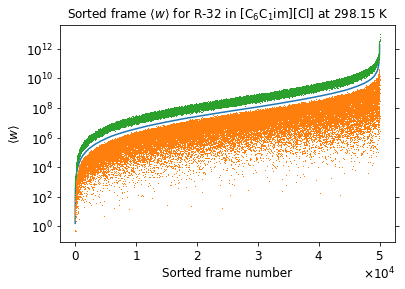

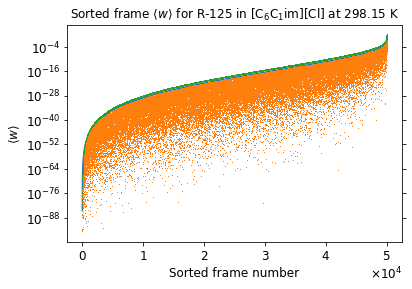

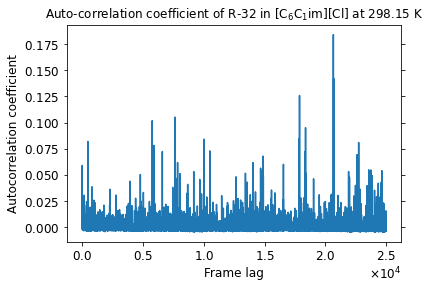

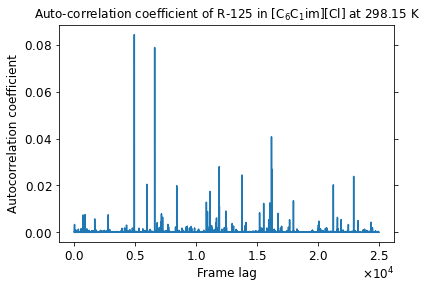

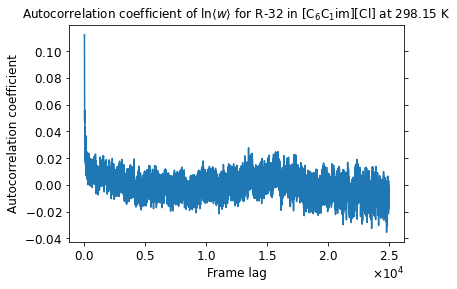

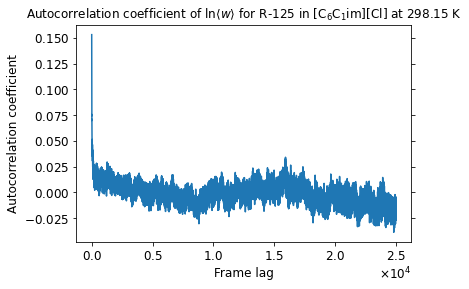

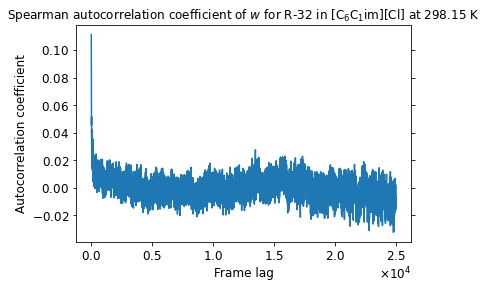

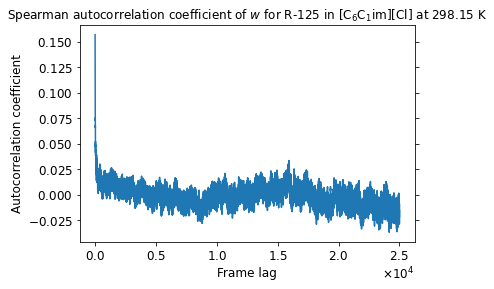

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


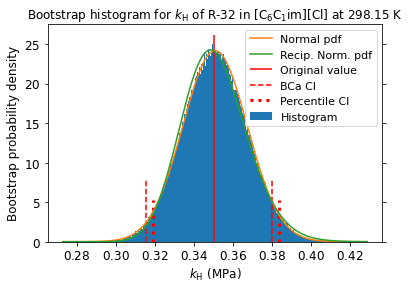

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


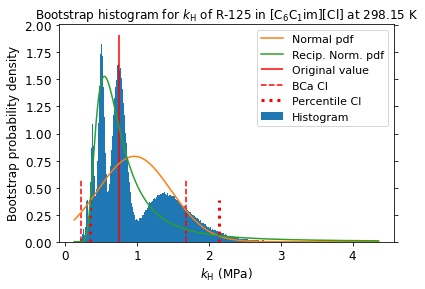

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


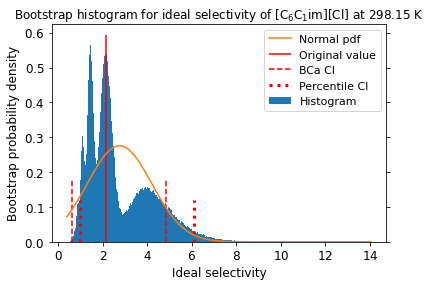

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


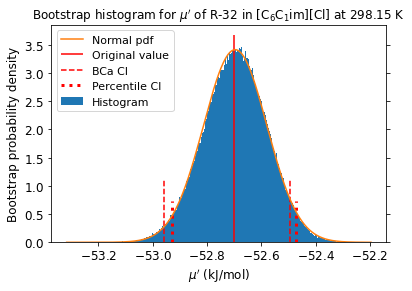

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


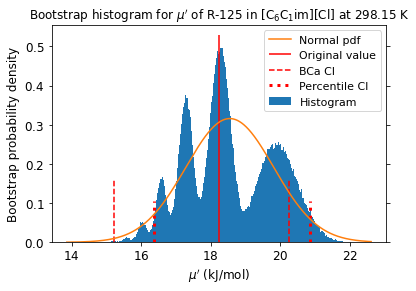

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


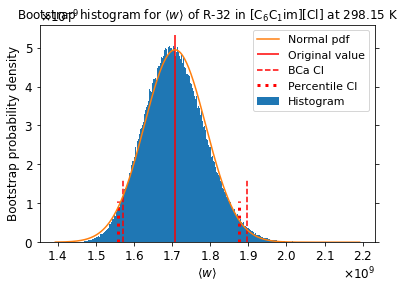

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


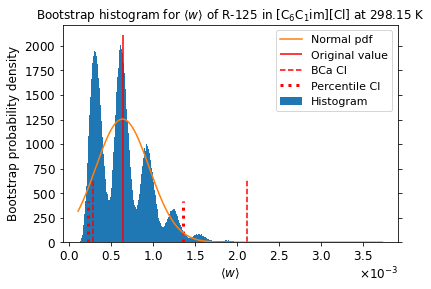

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


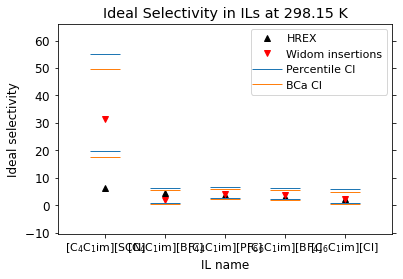

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


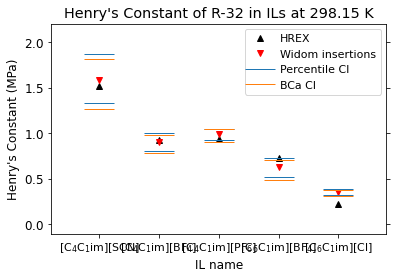

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


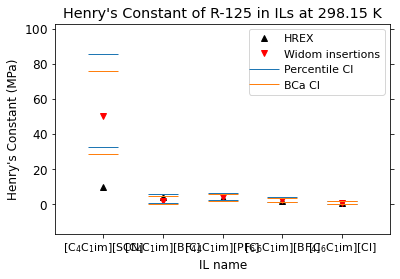

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


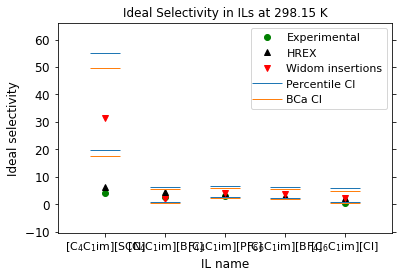

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


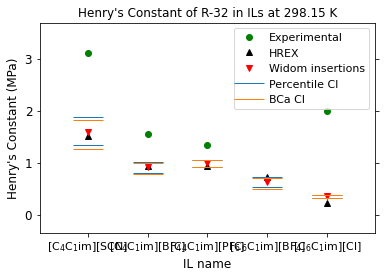

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


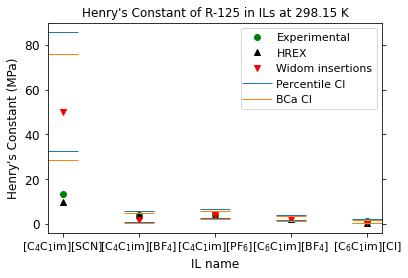

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


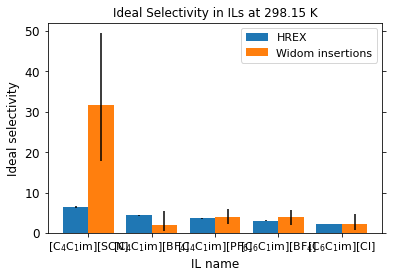

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


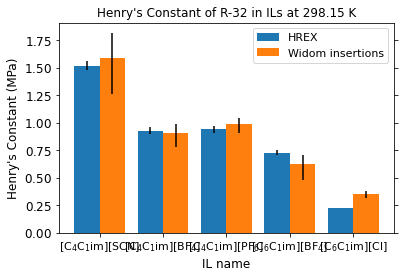

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


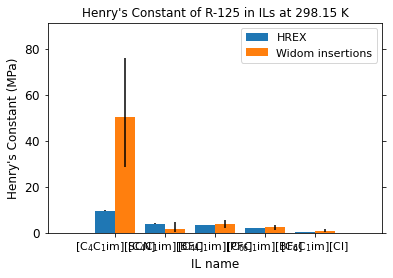

In [97]:
plot_results("Eij_max_estimation_2/vbs", "Eij_max_estimation_2", get_fbs=True, get_corr=True)

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.004094,-0.003274,0.009835,-0.003577
Temp,0.003750,-0.001042,0.001556,-0.001401
Volume,0.005750,0.156033,-0.000977,0.158417
Press,-0.001064,-0.008034,-0.004185,-0.008777
PotEng,-0.000657,0.065505,-0.002053,0.065270
KinEng,0.003750,-0.001042,0.001556,-0.001401
TotEng,0.001948,0.048865,-0.000539,0.048447
E_pair,0.005417,0.103515,0.001631,0.102822
E_vdwl,0.003820,0.098439,0.002131,0.100489
E_coul,0.003607,0.039595,-0.000196,0.037485


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.004241,-0.004241,-0.002097,-0.003395
Temp,-0.003879,-0.003879,-0.002761,-0.003074
Volume,0.143540,0.143540,0.152390,0.148519
Press,-0.008630,-0.008630,-0.008283,-0.008222
PotEng,0.062565,0.062565,0.060185,0.059011
KinEng,-0.003879,-0.003879,-0.002762,-0.003074
TotEng,0.044981,0.044981,0.043592,0.042420
E_pair,0.094590,0.094590,0.096648,0.094239
E_vdwl,0.089621,0.089621,0.093373,0.091294
E_coul,0.035571,0.035571,0.034910,0.033463


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.002831,-0.002831,-0.001430,-0.002290
Temp,-0.002575,-0.002575,-0.001846,-0.002053
Volume,0.096087,0.096087,0.102011,0.099379
Press,-0.005754,-0.005754,-0.005510,-0.005470
PotEng,0.041725,0.041725,0.040152,0.039367
KinEng,-0.002575,-0.002575,-0.001846,-0.002053
TotEng,0.030035,0.030035,0.029080,0.028299
E_pair,0.063130,0.063130,0.064507,0.062885
E_vdwl,0.059817,0.059817,0.062267,0.060866
E_coul,0.023712,0.023712,0.023292,0.022326


R-32 w column correlation (first 5 columns):
 [[ 1.00000000e+00 -1.01355366e-04 -2.52131575e-05  3.06377664e-03
  -1.54992587e-04]
 [-1.01355366e-04  1.00000000e+00 -4.22932472e-05 -1.64712382e-04
   7.48259491e-04]
 [-2.52131575e-05 -4.22932472e-05  1.00000000e+00  9.87836709e-04
  -1.77351747e-04]
 [ 3.06377664e-03 -1.64712382e-04  9.87836709e-04  1.00000000e+00
  -1.40973340e-04]
 [-1.54992587e-04  7.48259491e-04 -1.77351747e-04 -1.40973340e-04
   1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.13993892 0.12838318 0.13117267        nan]
 [0.13993892 1.         0.1251832  0.13566133        nan]
 [0.12838318 0.1251832  1.         0.13542383        nan]
 [0.13117267 0.13566133 0.13542383 1.                nan]
 [       nan        nan        nan        nan        nan]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.1450277  0.1357062  0.14251525 0.15001874]
 [0.1450277  1.         0.13263383 0.14477524 0.13745482]
 [0.1357062  0.

10 highest observations are:

[[2.31155727e+09 1.16164932e-04]
 [2.43268711e+09 1.36557226e-04]
 [2.47745729e+09 1.42402138e-04]
 [2.59842433e+09 1.44228455e-04]
 [2.86710462e+09 2.05618827e-04]
 [2.89197112e+09 2.07746503e-04]
 [3.36001976e+09 2.14122635e-04]
 [3.41218578e+09 2.31908144e-04]
 [6.38167066e+09 6.43850375e-04]
 [1.19050398e+10 7.86497899e-04]]
with indices:

[[270 492]
 [134 118]
 [348 106]
 [ 75 311]
 [213 422]
 [432  78]
 [275 345]
 [386 131]
 [254 475]
 [ 49 495]]


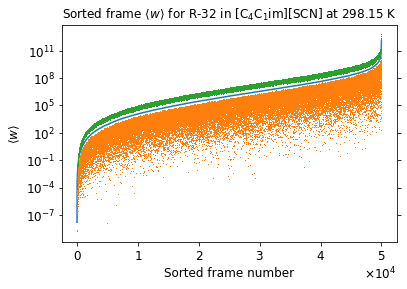

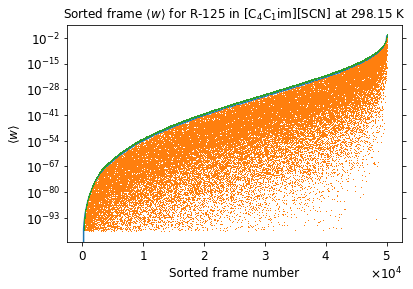

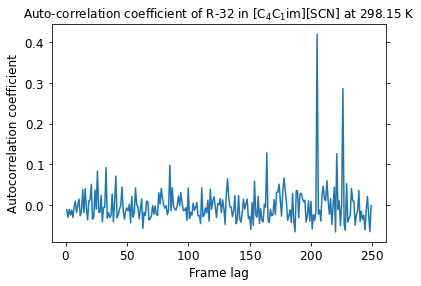

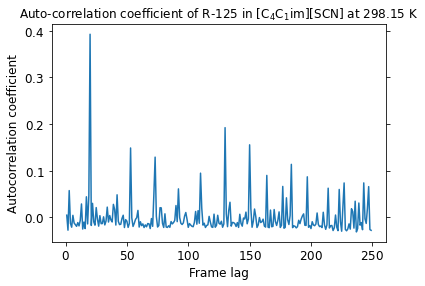

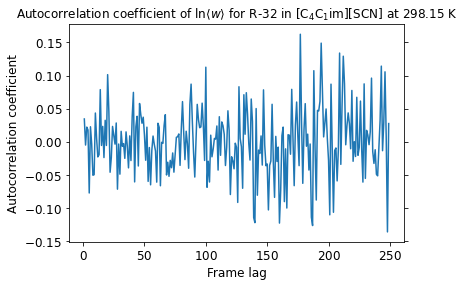

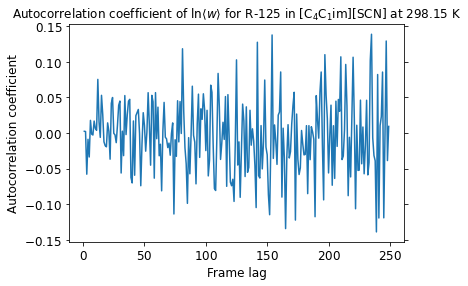

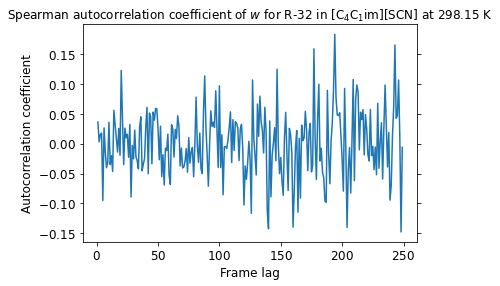

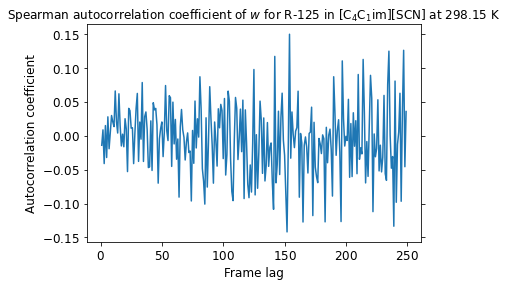

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


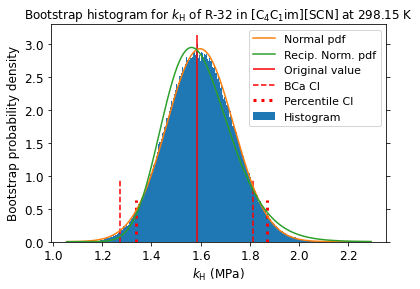

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


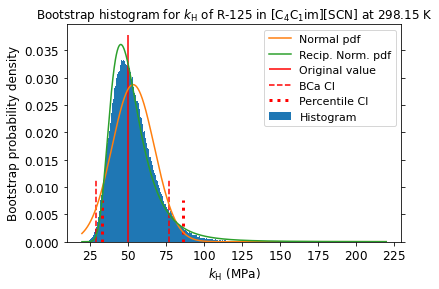

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


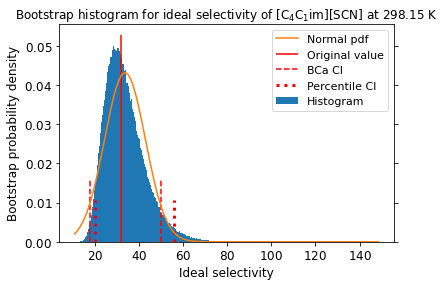

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


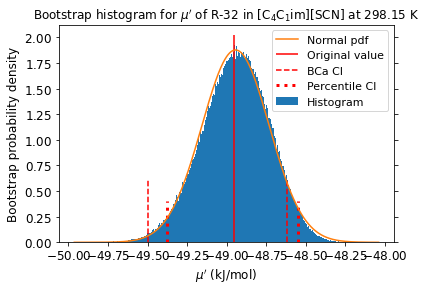

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


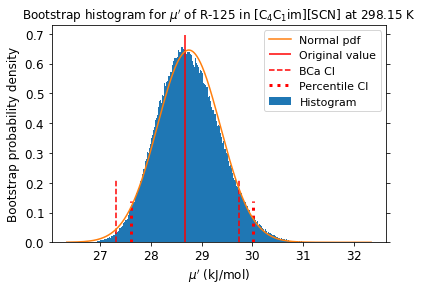

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


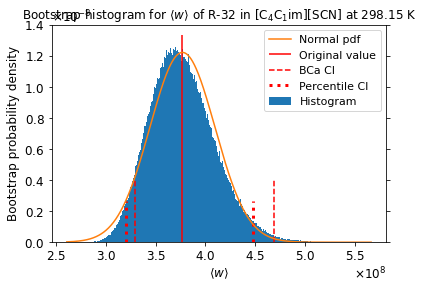

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


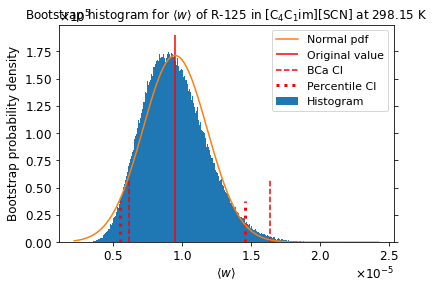

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.000488,0.014947,-0.000255,0.021984
Temp,-0.007144,-0.003439,0.001291,-0.001005
Volume,0.010482,0.157436,0.000857,0.181183
Press,-0.001300,-0.008888,0.004640,-0.006752
PotEng,0.001917,0.066232,0.001888,0.074505
KinEng,-0.007144,-0.003439,0.001291,-0.001005
TotEng,-0.003240,0.047639,0.002269,0.055468
E_pair,0.009640,0.109963,0.002381,0.114637
E_vdwl,0.011416,0.104670,-0.003252,0.110540
E_coul,-0.000215,0.045866,0.007669,0.047771


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.013710,0.013710,0.020462,0.020462
Temp,-0.003541,-0.003541,-0.001108,-0.001108
Volume,0.148015,0.148015,0.167609,0.167609
Press,-0.009239,-0.009239,-0.005392,-0.005392
PotEng,0.062742,0.062742,0.071870,0.071870
KinEng,-0.003541,-0.003541,-0.001108,-0.001108
TotEng,0.044550,0.044550,0.052969,0.052969
E_pair,0.102318,0.102318,0.104774,0.104774
E_vdwl,0.097992,0.097992,0.102215,0.102215
E_coul,0.042127,0.042127,0.042184,0.042184


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.009149,0.009149,0.013625,0.013625
Temp,-0.002366,-0.002366,-0.000731,-0.000731
Volume,0.099012,0.099012,0.112304,0.112304
Press,-0.006169,-0.006169,-0.003588,-0.003588
PotEng,0.041824,0.041824,0.047948,0.047948
KinEng,-0.002366,-0.002366,-0.000731,-0.000731
TotEng,0.029686,0.029686,0.035293,0.035293
E_pair,0.068271,0.068271,0.070006,0.070006
E_vdwl,0.065430,0.065430,0.068373,0.068373
E_coul,0.028081,0.028081,0.028130,0.028130


R-32 w column correlation (first 5 columns):
 [[ 1.00000000e+00  8.35351567e-04 -6.96525417e-05 -9.96247349e-05
   1.57516736e-04]
 [ 8.35351567e-04  1.00000000e+00  4.75289976e-03  4.87609384e-04
   2.20674520e-03]
 [-6.96525417e-05  4.75289976e-03  1.00000000e+00  2.10729546e-03
  -1.72717660e-04]
 [-9.96247349e-05  4.87609384e-04  2.10729546e-03  1.00000000e+00
  -2.60973253e-04]
 [ 1.57516736e-04  2.20674520e-03 -1.72717660e-04 -2.60973253e-04
   1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.14040318 0.14544025 0.14321816 0.14141293]
 [0.14040318 1.         0.13435651 0.14432586 0.14191152]
 [0.14544025 0.13435651 1.         0.14300732 0.14269558]
 [0.14321816 0.14432586 0.14300732 1.         0.13707884]
 [0.14141293 0.14191152 0.14269558 0.13707884 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.15091164 0.15389399 0.15575884 0.14844493]
 [0.15091164 1.         0.14460609 0.15255264 0.15060837]
 [0.15389399 0.

10 highest observations are:

[[2.26793320e+09 1.71878881e-03]
 [2.27218642e+09 1.80423588e-03]
 [2.34867158e+09 1.87343247e-03]
 [2.47281519e+09 1.96014768e-03]
 [3.36781835e+09 2.11455375e-03]
 [3.92282399e+09 2.18345434e-03]
 [4.66663773e+09 2.29663460e-03]
 [4.95119071e+09 2.73264901e-03]
 [6.48606943e+09 6.26739608e-03]
 [1.38081267e+10 8.16673902e-02]]
with indices:

[[164 388]
 [214 294]
 [318 496]
 [ 20  38]
 [326 192]
 [433 171]
 [ 44 215]
 [323 289]
 [220 236]
 [271 246]]


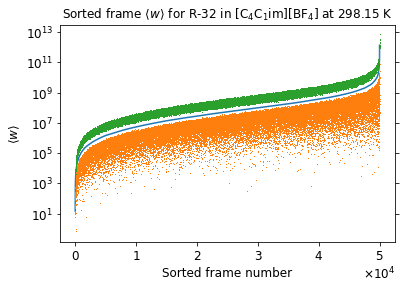

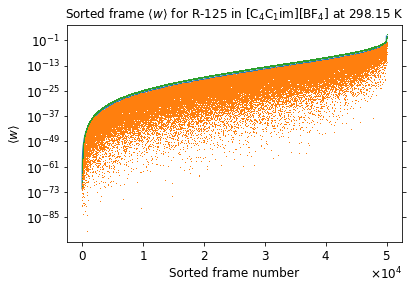

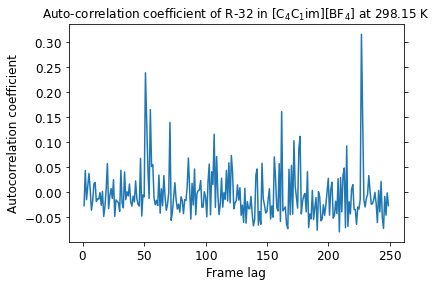

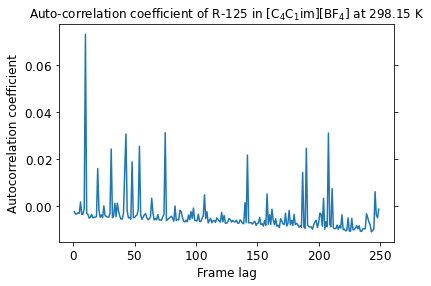

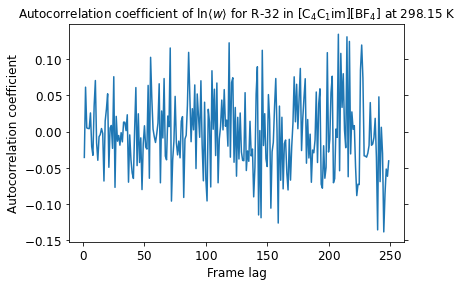

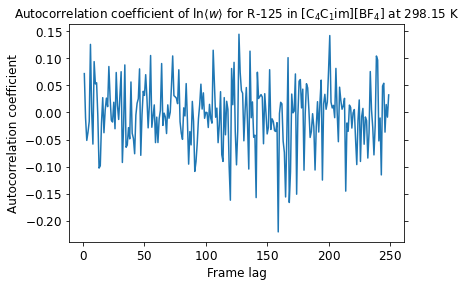

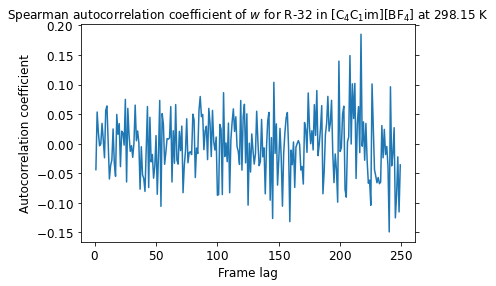

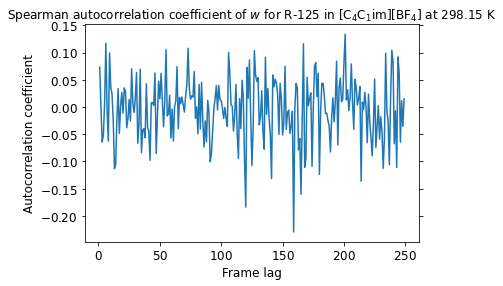

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


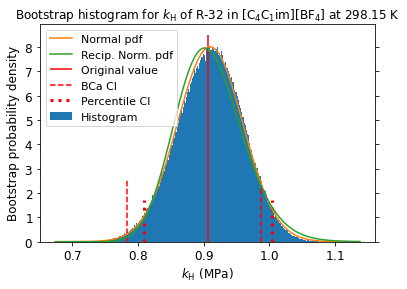

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


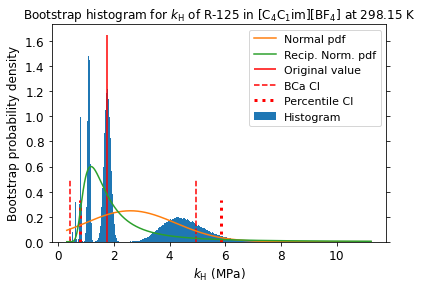

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


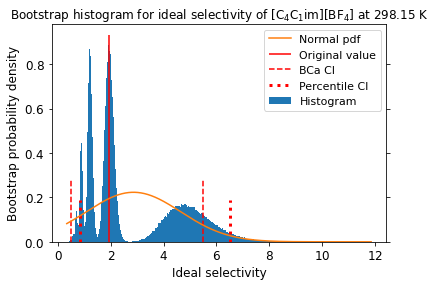

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


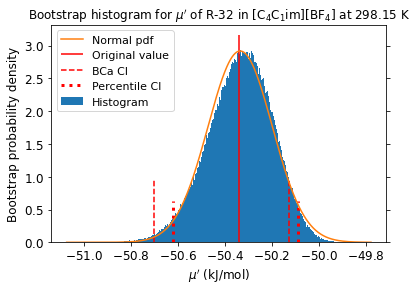

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


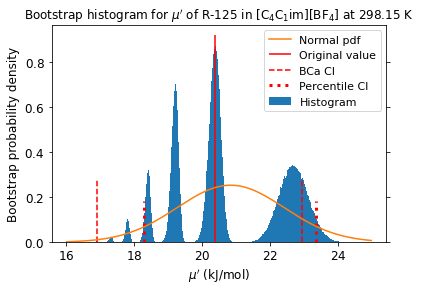

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


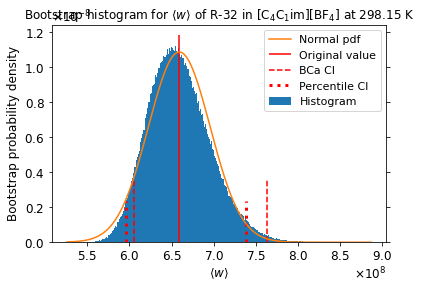

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


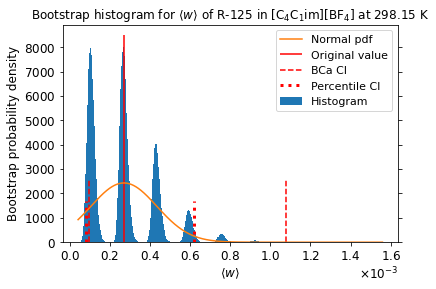

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.006549,0.005969,0.004959,0.007688
Temp,0.007728,0.000076,-0.005083,0.003217
Volume,0.003706,0.155508,0.006186,0.177387
Press,0.001836,-0.001944,-0.008171,-0.001153
PotEng,0.009789,0.064388,0.009248,0.064812
KinEng,0.007728,0.000076,-0.005083,0.003217
TotEng,0.012455,0.048711,0.003663,0.051086
E_pair,0.002535,0.108017,0.006996,0.113521
E_vdwl,-0.000392,0.109493,0.007581,0.118536
E_coul,0.002720,0.039264,0.002128,0.037943


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.005036,0.005036,0.007670,0.007670
Temp,-0.000955,-0.000955,0.004379,0.004379
Volume,0.145291,0.145291,0.162504,0.162504
Press,-0.001824,-0.001824,0.001236,0.001236
PotEng,0.059272,0.059272,0.059835,0.059835
KinEng,-0.000955,-0.000955,0.004379,0.004379
TotEng,0.044093,0.044093,0.048576,0.048576
E_pair,0.100778,0.100778,0.103082,0.103082
E_vdwl,0.101764,0.101764,0.107281,0.107281
E_coul,0.035773,0.035773,0.033624,0.033624


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.003385,0.003385,0.005160,0.005160
Temp,-0.000626,-0.000626,0.002926,0.002926
Volume,0.097360,0.097360,0.108813,0.108813
Press,-0.001207,-0.001207,0.000814,0.000814
PotEng,0.039569,0.039569,0.039926,0.039926
KinEng,-0.000626,-0.000626,0.002926,0.002926
TotEng,0.029470,0.029470,0.032457,0.032457
E_pair,0.067343,0.067343,0.068838,0.068838
E_vdwl,0.067977,0.067977,0.071686,0.071686
E_coul,0.023871,0.023871,0.022446,0.022446


R-32 w column correlation (first 5 columns):
 [[ 1.00000000e+00 -9.24216135e-07 -1.83821072e-04  5.10694660e-04
   8.36968009e-05]
 [-9.24216135e-07  1.00000000e+00 -2.42221017e-04 -2.27976921e-04
  -9.43522353e-05]
 [-1.83821072e-04 -2.42221017e-04  1.00000000e+00 -1.29337720e-04
   1.10772501e-03]
 [ 5.10694660e-04 -2.27976921e-04 -1.29337720e-04  1.00000000e+00
  -8.42166387e-04]
 [ 8.36968009e-05 -9.43522353e-05  1.10772501e-03 -8.42166387e-04
   1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.13646225 0.12880344 0.13020445 0.12989797]
 [0.13646225 1.         0.12594618 0.1291931  0.1295033 ]
 [0.12880344 0.12594618 1.         0.13238926 0.12493166]
 [0.13020445 0.1291931  0.13238926 1.         0.13082611]
 [0.12989797 0.1295033  0.12493166 0.13082611 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.14032844 0.13454716 0.13736994 0.13782297]
 [0.14032844 1.         0.13581997 0.13490342 0.1361052 ]
 [0.13454716 0.

10 highest observations are:

[[1.80742715e+09 8.57740403e-04]
 [1.85939145e+09 9.30718800e-04]
 [2.19029723e+09 1.25860900e-03]
 [2.22039344e+09 1.27324603e-03]
 [2.27231238e+09 1.39231980e-03]
 [2.45221542e+09 2.39585404e-03]
 [2.49743665e+09 2.68503649e-03]
 [2.50058664e+09 3.81495890e-03]
 [2.53518376e+09 5.53757623e-03]
 [7.09797727e+09 1.22351324e-02]]
with indices:

[[  1 465]
 [461 127]
 [339 421]
 [192 371]
 [199 210]
 [175 326]
 [355 320]
 [ 68 245]
 [466  98]
 [316 457]]


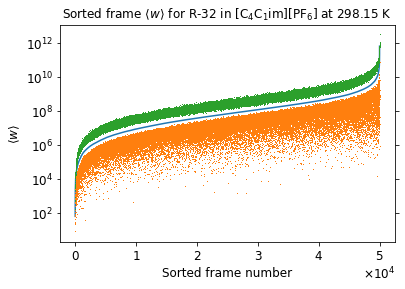

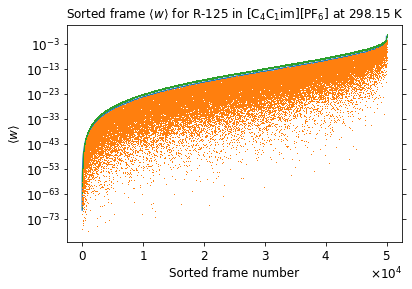

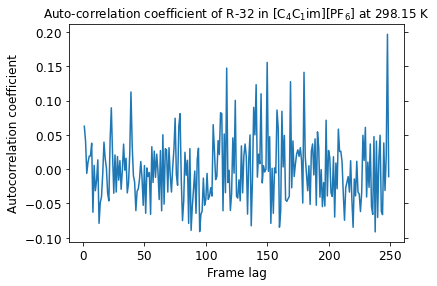

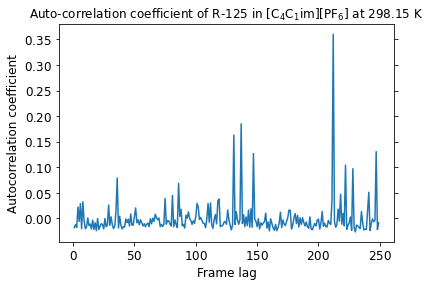

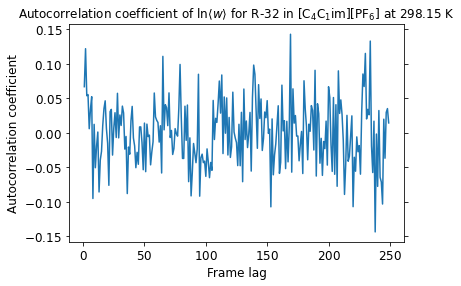

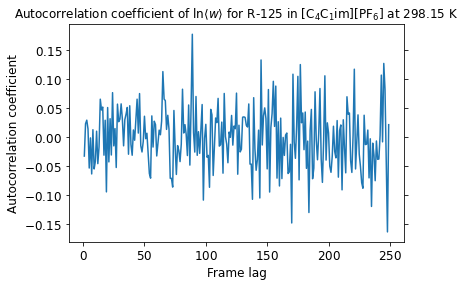

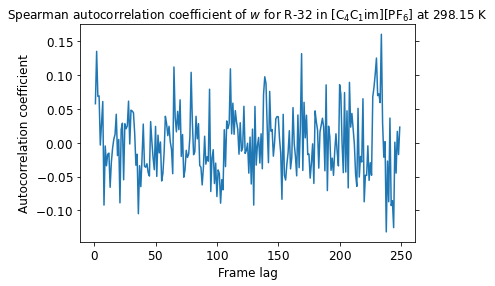

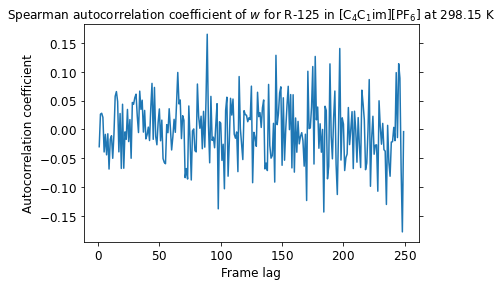

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


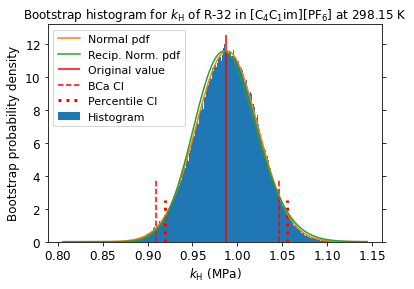

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


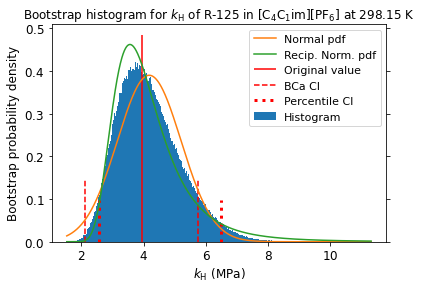

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


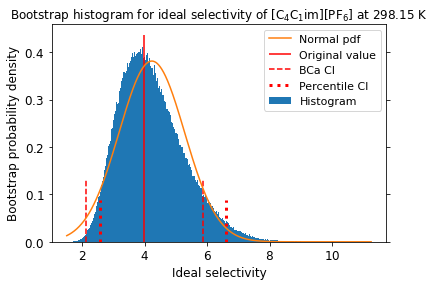

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


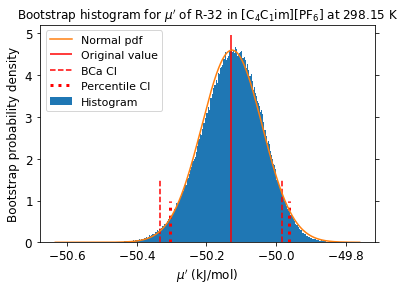

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


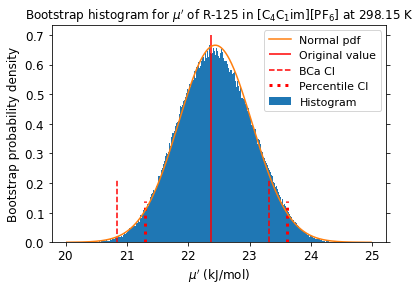

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


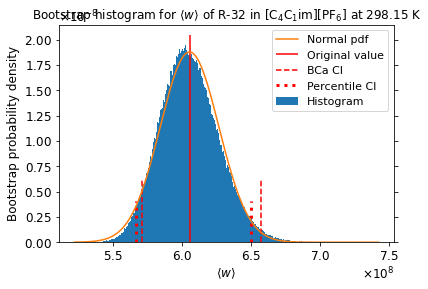

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


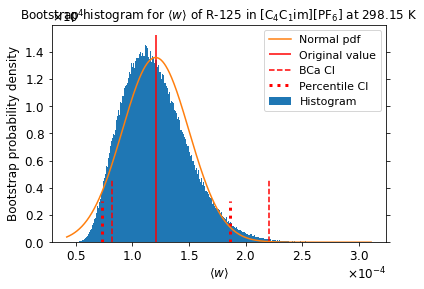

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.000813,0.009029,-0.008141,0.016726
Temp,-0.002151,-0.008014,-0.004272,-0.003271
Volume,0.002242,0.150067,0.008150,0.170669
Press,-0.001170,-0.000887,-0.008952,0.001146
PotEng,0.002691,0.055473,0.009251,0.054609
KinEng,-0.002151,-0.008014,-0.004272,-0.003271
TotEng,0.000623,0.036648,0.004189,0.039101
E_pair,0.007926,0.099215,0.005881,0.100215
E_vdwl,0.005710,0.092662,0.002117,0.101697
E_coul,0.006584,0.040727,0.007042,0.031446


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.007770,0.007770,0.017274,0.017274
Temp,-0.004802,-0.004802,0.000445,0.000445
Volume,0.141414,0.141414,0.156622,0.156622
Press,-0.000494,-0.000494,0.003752,0.003752
PotEng,0.052741,0.052741,0.049389,0.049389
KinEng,-0.004802,-0.004802,0.000445,0.000445
TotEng,0.036285,0.036285,0.037391,0.037391
E_pair,0.094878,0.094878,0.089794,0.089794
E_vdwl,0.088330,0.088330,0.090945,0.090945
E_coul,0.038743,0.038743,0.029896,0.029896


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.005173,0.005173,0.011511,0.011511
Temp,-0.003220,-0.003220,0.000305,0.000305
Volume,0.094554,0.094554,0.104833,0.104833
Press,-0.000333,-0.000333,0.002476,0.002476
PotEng,0.035111,0.035111,0.032909,0.032909
KinEng,-0.003220,-0.003220,0.000306,0.000306
TotEng,0.024145,0.024145,0.024948,0.024948
E_pair,0.063249,0.063249,0.060026,0.060026
E_vdwl,0.058914,0.058914,0.060846,0.060846
E_coul,0.025801,0.025801,0.019944,0.019944


R-32 w column correlation (first 5 columns):
 [[ 1.00000000e+00  1.57809219e-03  6.08536538e-03 -5.96462232e-04
   5.18128929e-03]
 [ 1.57809219e-03  1.00000000e+00 -2.78290631e-04  3.04677929e-03
   4.92436056e-04]
 [ 6.08536538e-03 -2.78290631e-04  1.00000000e+00  9.72517913e-04
  -3.24685410e-04]
 [-5.96462232e-04  3.04677929e-03  9.72517913e-04  1.00000000e+00
   9.34009573e-04]
 [ 5.18128929e-03  4.92436056e-04 -3.24685410e-04  9.34009573e-04
   1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.13120207 0.13410361 0.13494169 0.12747868]
 [0.13120207 1.         0.13106556 0.12992141 0.12664798]
 [0.13410361 0.13106556 1.         0.13020129 0.13086561]
 [0.13494169 0.12992141 0.13020129 1.         0.12931232]
 [0.12747868 0.12664798 0.13086561 0.12931232 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.14358128 0.13869828 0.1400031  0.13603777]
 [0.14358128 1.         0.13834504 0.14038288 0.13928693]
 [0.13869828 0.

10 highest observations are:

[[3.74418362e+09 1.51548663e-03]
 [4.06349296e+09 1.61399266e-03]
 [5.28000098e+09 2.09049629e-03]
 [5.87704547e+09 2.15377120e-03]
 [6.02513201e+09 2.46727596e-03]
 [6.40697355e+09 2.59488678e-03]
 [8.63834850e+09 4.11288890e-03]
 [1.07185868e+10 4.35733532e-03]
 [1.44112145e+10 1.19021261e-02]
 [3.89220672e+10 2.23460916e-02]]
with indices:

[[549  13]
 [103 346]
 [ 92 191]
 [455  25]
 [ 68  21]
 [357 334]
 [523  34]
 [  0 404]
 [333 181]
 [277  67]]


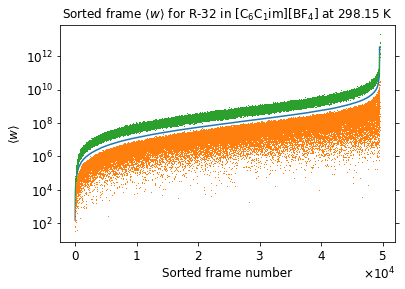

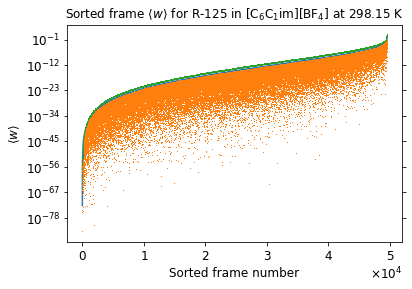

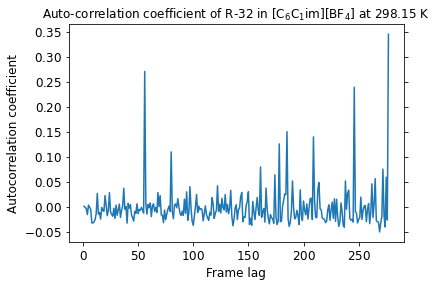

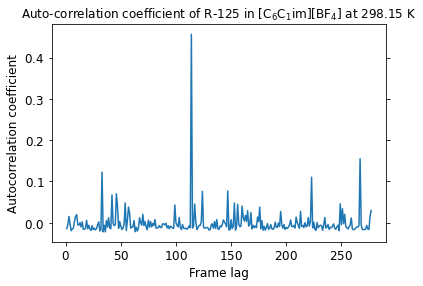

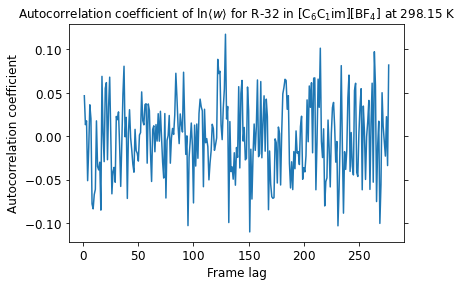

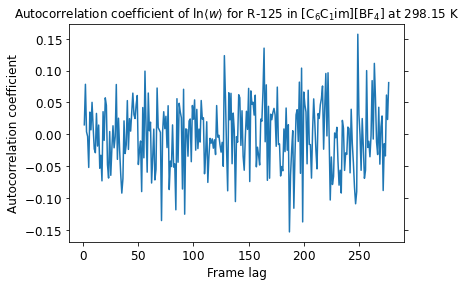

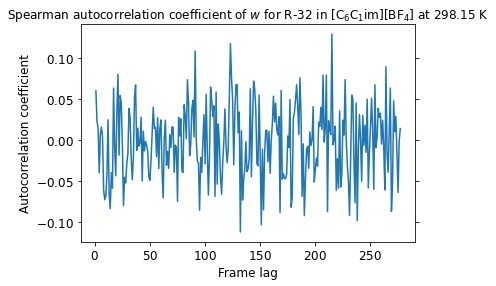

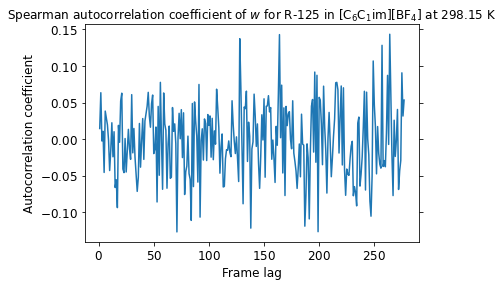

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


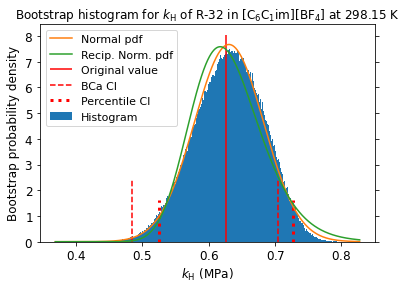

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


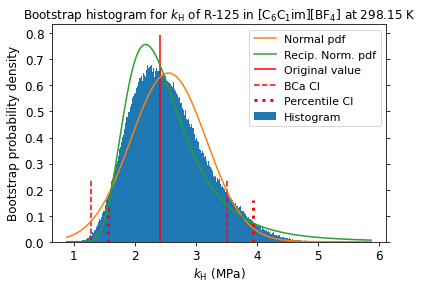

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


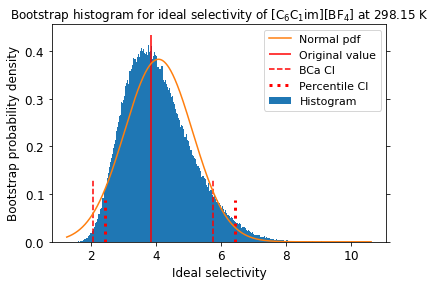

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


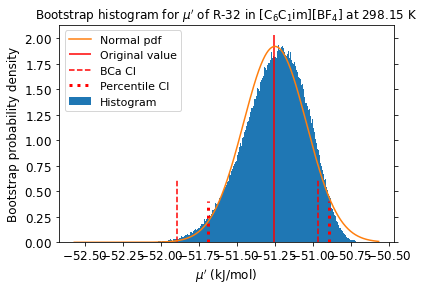

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


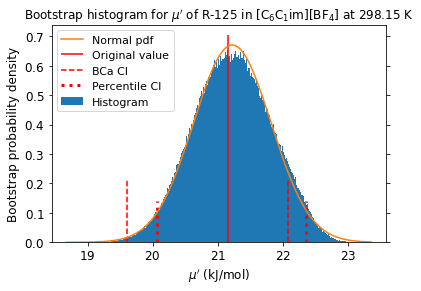

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


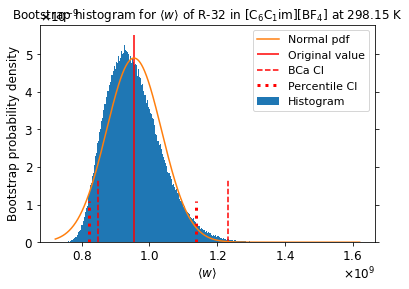

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


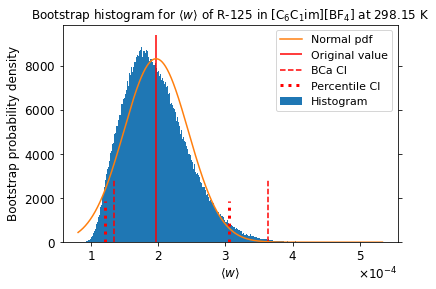

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.004591,-0.036325,0.006637,-0.017627
Temp,-0.003022,-0.003659,0.010984,-0.006744
Volume,0.017946,0.151725,-0.003845,0.185051
Press,0.003153,-0.005783,-0.003326,-0.015749
PotEng,0.014303,0.058880,-0.002077,0.067548
KinEng,-0.003022,-0.003659,0.010984,-0.006744
TotEng,0.008990,0.042651,0.005470,0.047294
E_pair,0.016670,0.096847,-0.005365,0.109069
E_vdwl,0.016457,0.080896,0.001192,0.100699
E_coul,0.002517,0.040012,-0.008393,0.034574


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.037274,-0.037274,-0.017090,-0.017090
Temp,-0.002118,-0.002118,-0.005292,-0.005292
Volume,0.140890,0.140890,0.170435,0.170435
Press,-0.003920,-0.003920,-0.014932,-0.014932
PotEng,0.054983,0.054983,0.061258,0.061258
KinEng,-0.002118,-0.002118,-0.005292,-0.005292
TotEng,0.039494,0.039494,0.042010,0.042010
E_pair,0.089056,0.089056,0.099344,0.099344
E_vdwl,0.075179,0.075179,0.093535,0.093535
E_coul,0.037074,0.037074,0.030097,0.030097


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.024765,-0.024765,-0.011398,-0.011398
Temp,-0.001404,-0.001404,-0.003528,-0.003528
Volume,0.094298,0.094298,0.114205,0.114205
Press,-0.002621,-0.002621,-0.009956,-0.009956
PotEng,0.036688,0.036688,0.040905,0.040905
KinEng,-0.001404,-0.001404,-0.003528,-0.003528
TotEng,0.026363,0.026363,0.028047,0.028047
E_pair,0.059547,0.059547,0.066351,0.066351
E_vdwl,0.050166,0.050166,0.062425,0.062425
E_coul,0.024737,0.024737,0.020100,0.020100


R-32 w column correlation (first 5 columns):
 [[ 1.00000000e+00 -3.87505163e-04 -2.63937091e-04  1.15794544e-03
  -3.47373405e-04]
 [-3.87505163e-04  1.00000000e+00  4.22641527e-04 -4.36806411e-04
  -2.75225132e-04]
 [-2.63937091e-04  4.22641527e-04  1.00000000e+00  1.18786731e-04
  -1.74164430e-04]
 [ 1.15794544e-03 -4.36806411e-04  1.18786731e-04  1.00000000e+00
   5.33825844e-04]
 [-3.47373405e-04 -2.75225132e-04 -1.74164430e-04  5.33825844e-04
   1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.14928063 0.13767289 0.14478252 0.14373624]
 [0.14928063 1.         0.14327647 0.13960729 0.13935408]
 [0.13767289 0.14327647 1.         0.14414636 0.1352374 ]
 [0.14478252 0.13960729 0.14414636 1.         0.13788301]
 [0.14373624 0.13935408 0.1352374  0.13788301 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.15750957 0.14467297 0.15851656 0.15191107]
 [0.15750957 1.         0.15098492 0.15181691 0.15107038]
 [0.14467297 0.

10 highest observations are:

[[7.48221514e+09 4.50649746e-03]
 [8.31091365e+09 4.91487972e-03]
 [9.15908972e+09 5.92752804e-03]
 [1.02350982e+10 6.06053469e-03]
 [1.23297059e+10 8.11308435e-03]
 [1.24955008e+10 1.12424665e-02]
 [1.35565524e+10 1.25395772e-02]
 [1.71410950e+10 1.70921944e-02]
 [1.73753673e+10 2.65275022e-02]
 [2.72547058e+10 1.55225143e-01]]
with indices:

[[106  40]
 [192 360]
 [476  48]
 [114  45]
 [193 317]
 [341 413]
 [ 14 430]
 [340 116]
 [  9 201]
 [399 479]]


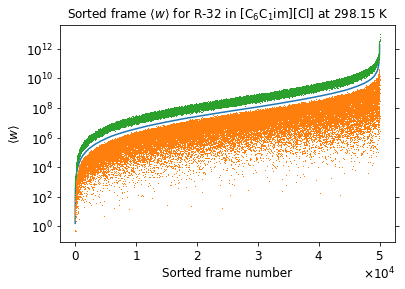

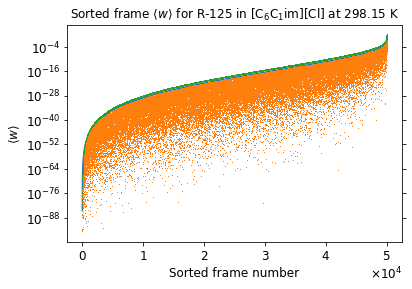

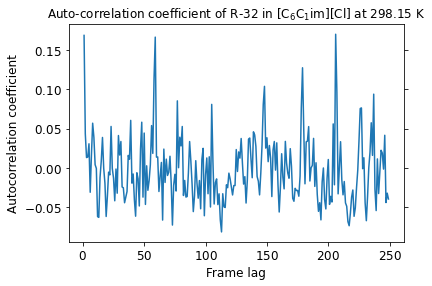

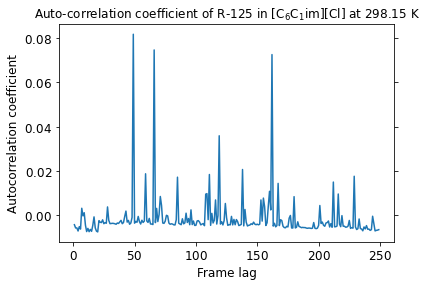

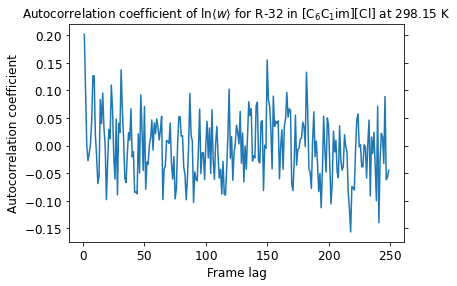

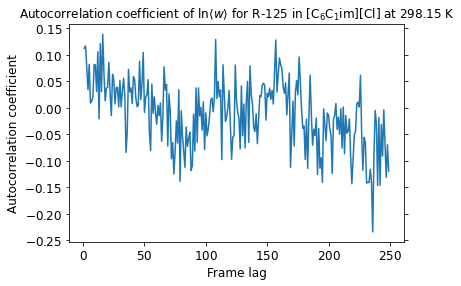

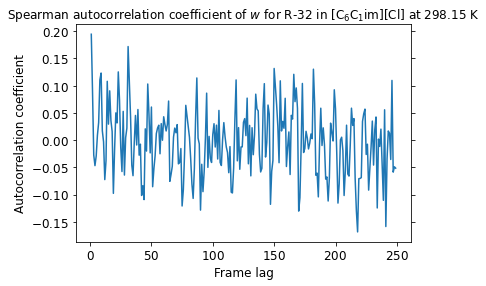

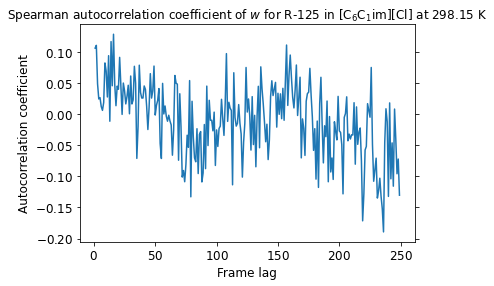

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


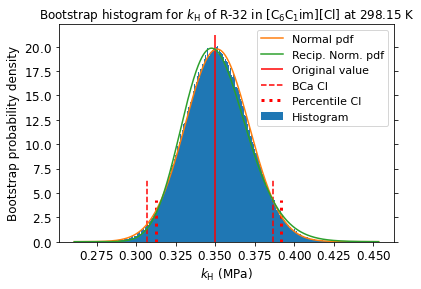

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


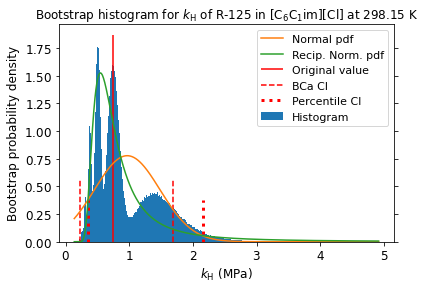

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


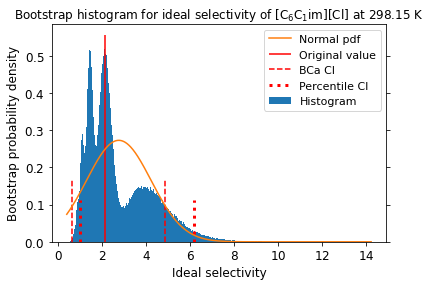

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


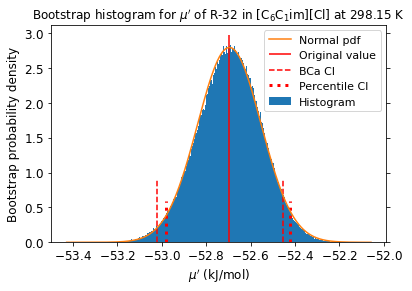

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


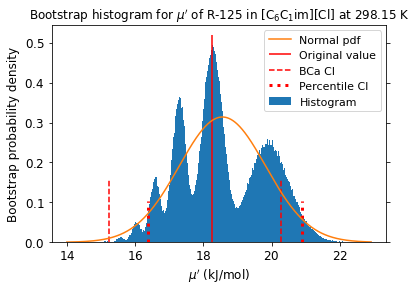

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


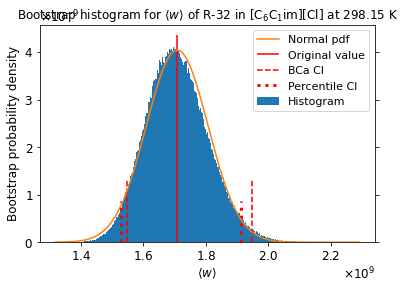

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


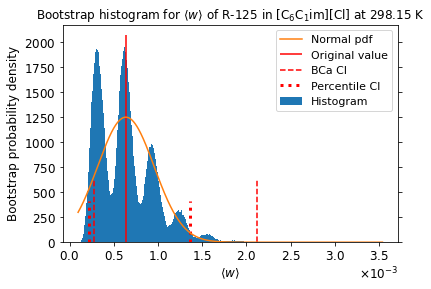

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


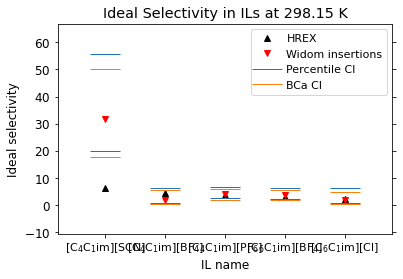

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


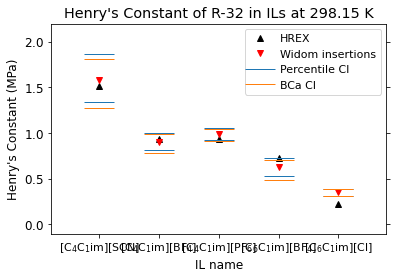

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


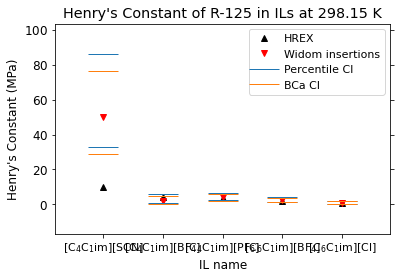

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


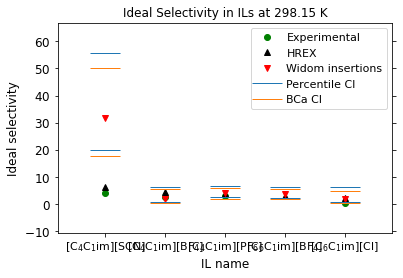

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


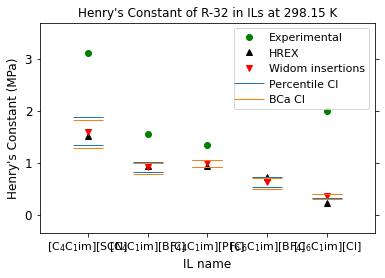

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


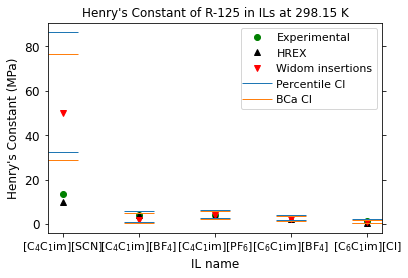

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


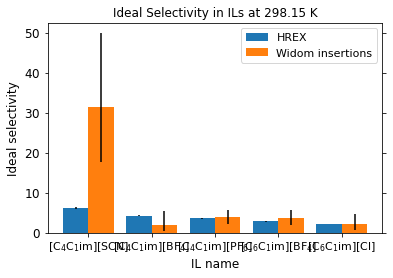

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


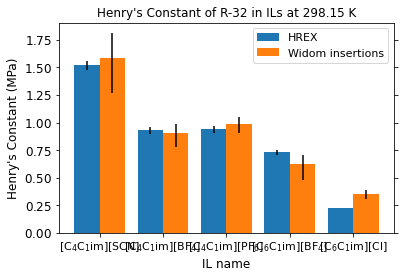

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


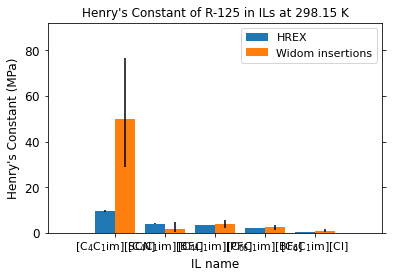

In [98]:
plot_results("Eij_max_estimation_2/vbs_blocksize100_89", "Eij_max_estimation_2", get_fbs=True, get_corr=True, blocksize=(100,100,100,89,100))

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.004094,-0.003274,0.009835,-0.003577
Temp,0.003750,-0.001042,0.001556,-0.001401
Volume,0.005750,0.156033,-0.000977,0.158417
Press,-0.001064,-0.008034,-0.004185,-0.008777
PotEng,-0.000657,0.065505,-0.002053,0.065270
KinEng,0.003750,-0.001042,0.001556,-0.001401
TotEng,0.001948,0.048865,-0.000539,0.048447
E_pair,0.005417,0.103515,0.001631,0.102822
E_vdwl,0.003820,0.098439,0.002131,0.100489
E_coul,0.003607,0.039595,-0.000196,0.037485


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.004241,-0.004241,-0.002097,-0.003395
Temp,-0.003879,-0.003879,-0.002761,-0.003074
Volume,0.143540,0.143540,0.152390,0.148519
Press,-0.008630,-0.008630,-0.008283,-0.008222
PotEng,0.062565,0.062565,0.060185,0.059011
KinEng,-0.003879,-0.003879,-0.002762,-0.003074
TotEng,0.044981,0.044981,0.043592,0.042420
E_pair,0.094590,0.094590,0.096648,0.094239
E_vdwl,0.089621,0.089621,0.093373,0.091294
E_coul,0.035571,0.035571,0.034910,0.033463


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.002831,-0.002831,-0.001430,-0.002290
Temp,-0.002575,-0.002575,-0.001846,-0.002053
Volume,0.096087,0.096087,0.102011,0.099379
Press,-0.005754,-0.005754,-0.005510,-0.005470
PotEng,0.041725,0.041725,0.040152,0.039367
KinEng,-0.002575,-0.002575,-0.001846,-0.002053
TotEng,0.030035,0.030035,0.029080,0.028299
E_pair,0.063130,0.063130,0.064507,0.062885
E_vdwl,0.059817,0.059817,0.062267,0.060866
E_coul,0.023712,0.023712,0.023292,0.022326


R-32 w column correlation (first 5 columns):
 [[ 1.00000000e+00 -1.01355366e-04 -2.52131575e-05  3.06377664e-03
  -1.54992587e-04]
 [-1.01355366e-04  1.00000000e+00 -4.22932472e-05 -1.64712382e-04
   7.48259491e-04]
 [-2.52131575e-05 -4.22932472e-05  1.00000000e+00  9.87836709e-04
  -1.77351747e-04]
 [ 3.06377664e-03 -1.64712382e-04  9.87836709e-04  1.00000000e+00
  -1.40973340e-04]
 [-1.54992587e-04  7.48259491e-04 -1.77351747e-04 -1.40973340e-04
   1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.13993892 0.12838318 0.13117267        nan]
 [0.13993892 1.         0.1251832  0.13566133        nan]
 [0.12838318 0.1251832  1.         0.13542383        nan]
 [0.13117267 0.13566133 0.13542383 1.                nan]
 [       nan        nan        nan        nan        nan]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.1450277  0.1357062  0.14251525 0.15001874]
 [0.1450277  1.         0.13263383 0.14477524 0.13745482]
 [0.1357062  0.

10 highest observations are:

[[6.52611248e+08 2.06829418e-05]
 [6.53741006e+08 2.73294388e-05]
 [7.22150673e+08 2.74730399e-05]
 [7.83210952e+08 2.86024218e-05]
 [7.95307585e+08 3.19247129e-05]
 [8.82365417e+08 4.19583304e-05]
 [1.16608202e+09 4.45001319e-05]
 [1.37524183e+09 7.36433544e-05]
 [1.40249195e+09 1.30544573e-04]
 [2.57853360e+09 1.39835933e-04]]
with indices:

[[98 31]
 [77  4]
 [30 20]
 [83 15]
 [84  1]
 [42 65]
 [46 92]
 [71 61]
 [23 29]
 [65 21]]


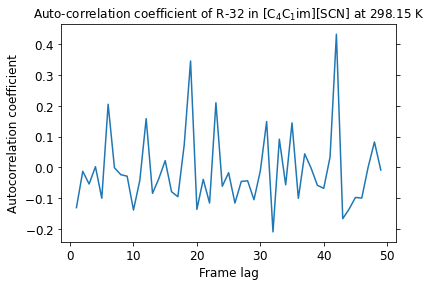

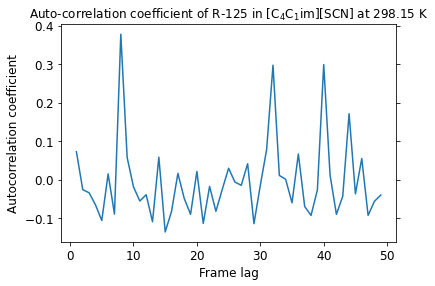

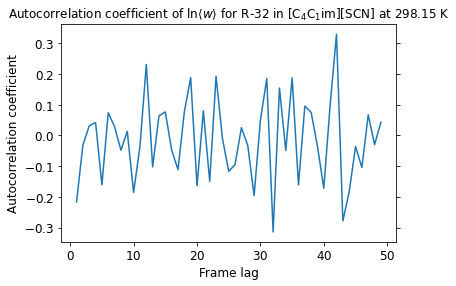

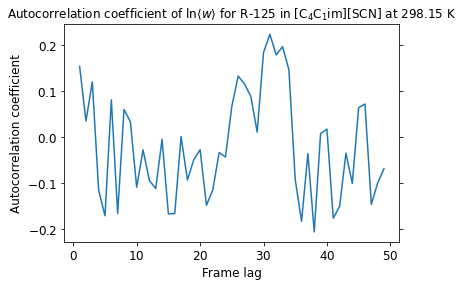

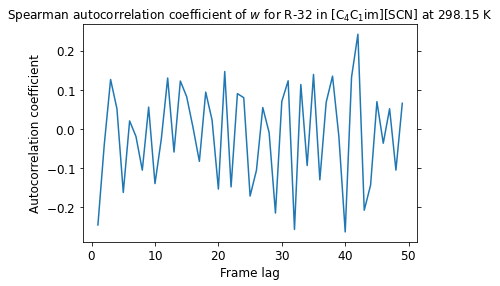

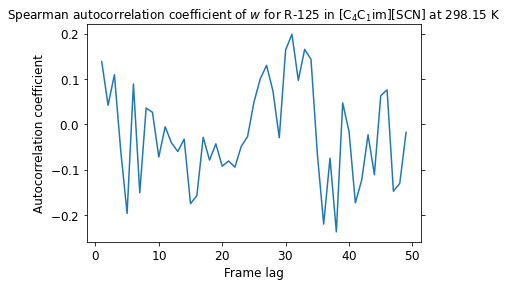

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


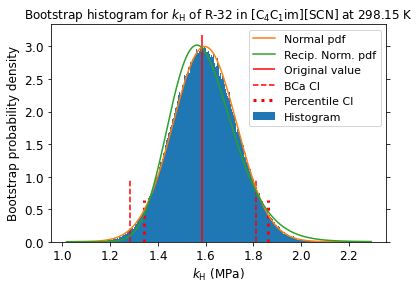

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


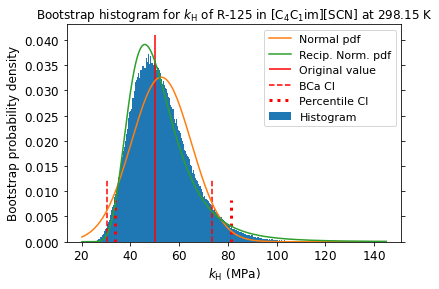

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


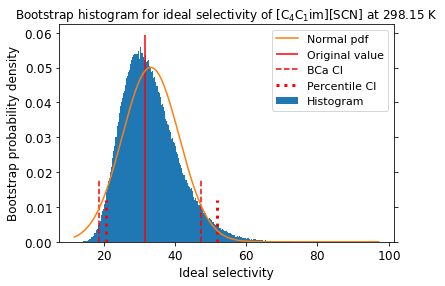

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


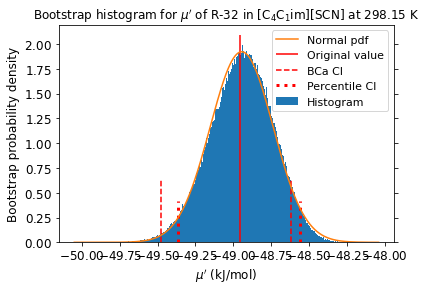

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


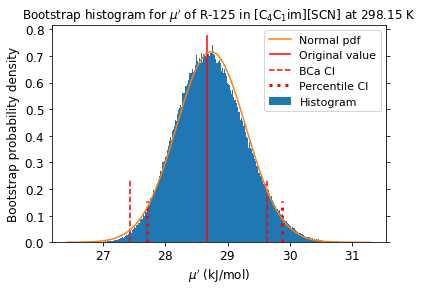

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


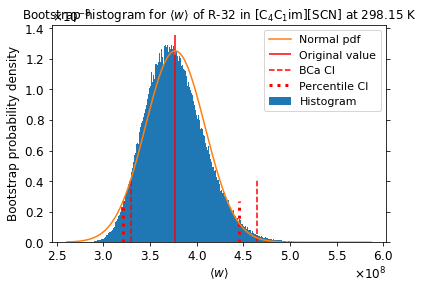

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


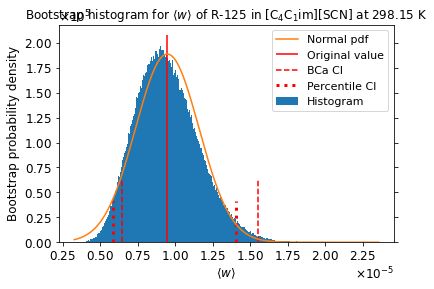

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.000488,0.014947,-0.000255,0.021984
Temp,-0.007144,-0.003439,0.001291,-0.001005
Volume,0.010482,0.157436,0.000857,0.181183
Press,-0.001300,-0.008888,0.004640,-0.006752
PotEng,0.001917,0.066232,0.001888,0.074505
KinEng,-0.007144,-0.003439,0.001291,-0.001005
TotEng,-0.003240,0.047639,0.002269,0.055468
E_pair,0.009640,0.109963,0.002381,0.114637
E_vdwl,0.011416,0.104670,-0.003252,0.110540
E_coul,-0.000215,0.045866,0.007669,0.047771


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.013710,0.013710,0.020462,0.020462
Temp,-0.003541,-0.003541,-0.001108,-0.001108
Volume,0.148015,0.148015,0.167609,0.167609
Press,-0.009239,-0.009239,-0.005392,-0.005392
PotEng,0.062742,0.062742,0.071870,0.071870
KinEng,-0.003541,-0.003541,-0.001108,-0.001108
TotEng,0.044550,0.044550,0.052969,0.052969
E_pair,0.102318,0.102318,0.104774,0.104774
E_vdwl,0.097992,0.097992,0.102215,0.102215
E_coul,0.042127,0.042127,0.042184,0.042184


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.009149,0.009149,0.013625,0.013625
Temp,-0.002366,-0.002366,-0.000731,-0.000731
Volume,0.099012,0.099012,0.112304,0.112304
Press,-0.006169,-0.006169,-0.003588,-0.003588
PotEng,0.041824,0.041824,0.047948,0.047948
KinEng,-0.002366,-0.002366,-0.000731,-0.000731
TotEng,0.029686,0.029686,0.035293,0.035293
E_pair,0.068271,0.068271,0.070006,0.070006
E_vdwl,0.065430,0.065430,0.068373,0.068373
E_coul,0.028081,0.028081,0.028130,0.028130


R-32 w column correlation (first 5 columns):
 [[ 1.00000000e+00  8.35351567e-04 -6.96525417e-05 -9.96247349e-05
   1.57516736e-04]
 [ 8.35351567e-04  1.00000000e+00  4.75289976e-03  4.87609384e-04
   2.20674520e-03]
 [-6.96525417e-05  4.75289976e-03  1.00000000e+00  2.10729546e-03
  -1.72717660e-04]
 [-9.96247349e-05  4.87609384e-04  2.10729546e-03  1.00000000e+00
  -2.60973253e-04]
 [ 1.57516736e-04  2.20674520e-03 -1.72717660e-04 -2.60973253e-04
   1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.14040318 0.14544025 0.14321816 0.14141293]
 [0.14040318 1.         0.13435651 0.14432586 0.14191152]
 [0.14544025 0.13435651 1.         0.14300732 0.14269558]
 [0.14321816 0.14432586 0.14300732 1.         0.13707884]
 [0.14141293 0.14191152 0.14269558 0.13707884 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.15091164 0.15389399 0.15575884 0.14844493]
 [0.15091164 1.         0.14460609 0.15255264 0.15060837]
 [0.15389399 0.

10 highest observations are:

[[9.24759408e+08 3.90856315e-04]
 [9.28985593e+08 4.25709306e-04]
 [9.90130411e+08 4.26399337e-04]
 [1.02836027e+09 4.33443467e-04]
 [1.03533075e+09 4.66532255e-04]
 [1.23757660e+09 4.75562035e-04]
 [1.37510571e+09 5.11555704e-04]
 [1.51220837e+09 5.55711378e-04]
 [1.60841104e+09 1.17480263e-03]
 [3.17824834e+09 1.63341574e-02]]
with indices:

[[17 19]
 [31 90]
 [97 25]
 [51 34]
 [93 52]
 [43 14]
 [87  8]
 [39 83]
 [34 55]
 [49 87]]


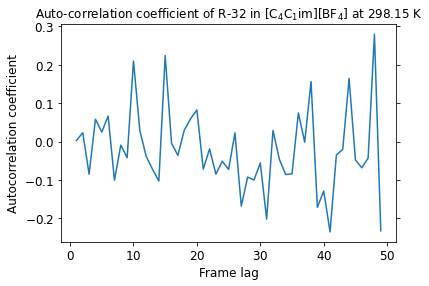

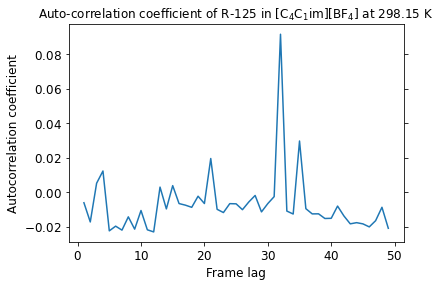

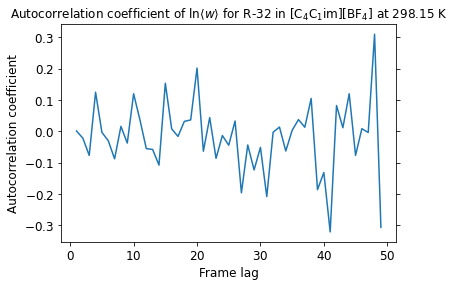

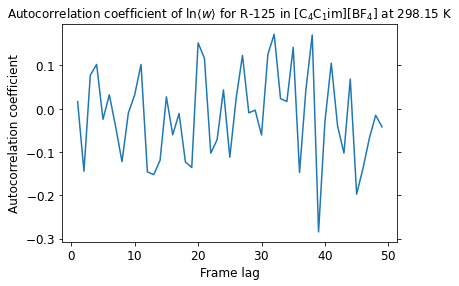

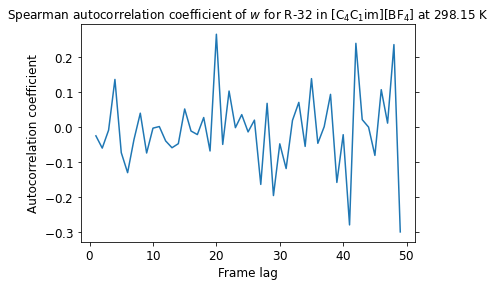

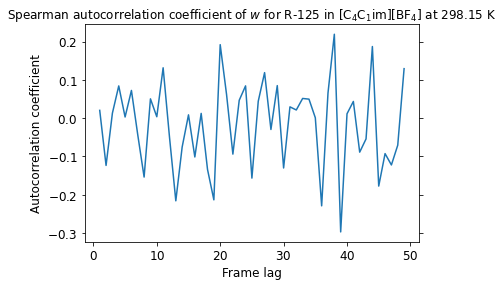

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


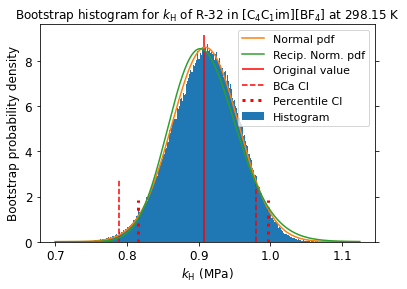

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


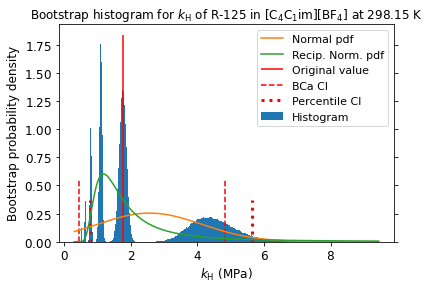

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


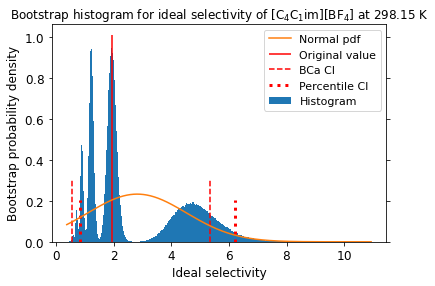

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


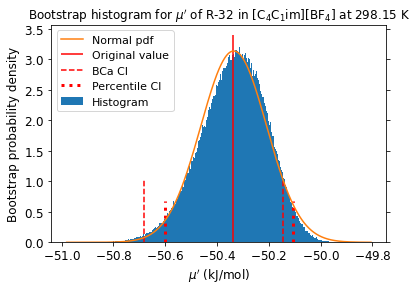

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


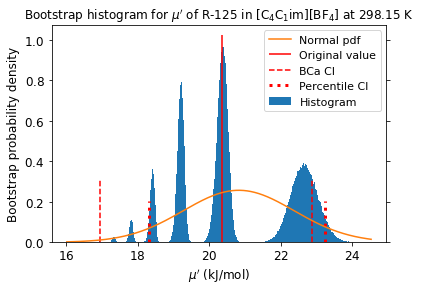

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


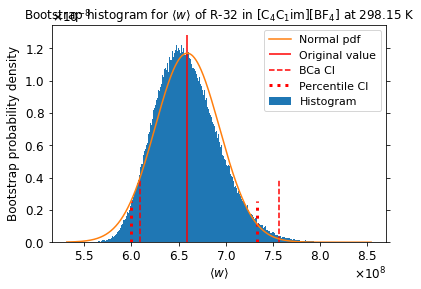

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


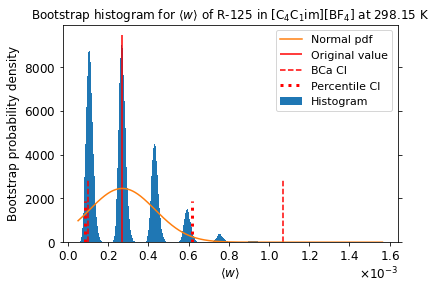

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.006549,0.005969,0.004959,0.007688
Temp,0.007728,0.000076,-0.005083,0.003217
Volume,0.003706,0.155508,0.006186,0.177387
Press,0.001836,-0.001944,-0.008171,-0.001153
PotEng,0.009789,0.064388,0.009248,0.064812
KinEng,0.007728,0.000076,-0.005083,0.003217
TotEng,0.012455,0.048711,0.003663,0.051086
E_pair,0.002535,0.108017,0.006996,0.113521
E_vdwl,-0.000392,0.109493,0.007581,0.118536
E_coul,0.002720,0.039264,0.002128,0.037943


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.005036,0.005036,0.007670,0.007670
Temp,-0.000955,-0.000955,0.004379,0.004379
Volume,0.145291,0.145291,0.162504,0.162504
Press,-0.001824,-0.001824,0.001236,0.001236
PotEng,0.059272,0.059272,0.059835,0.059835
KinEng,-0.000955,-0.000955,0.004379,0.004379
TotEng,0.044093,0.044093,0.048576,0.048576
E_pair,0.100778,0.100778,0.103082,0.103082
E_vdwl,0.101764,0.101764,0.107281,0.107281
E_coul,0.035773,0.035773,0.033624,0.033624


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.003385,0.003385,0.005160,0.005160
Temp,-0.000626,-0.000626,0.002926,0.002926
Volume,0.097360,0.097360,0.108813,0.108813
Press,-0.001207,-0.001207,0.000814,0.000814
PotEng,0.039569,0.039569,0.039926,0.039926
KinEng,-0.000626,-0.000626,0.002926,0.002926
TotEng,0.029470,0.029470,0.032457,0.032457
E_pair,0.067343,0.067343,0.068838,0.068838
E_vdwl,0.067977,0.067977,0.071686,0.071686
E_coul,0.023871,0.023871,0.022446,0.022446


R-32 w column correlation (first 5 columns):
 [[ 1.00000000e+00 -9.24216135e-07 -1.83821072e-04  5.10694660e-04
   8.36968009e-05]
 [-9.24216135e-07  1.00000000e+00 -2.42221017e-04 -2.27976921e-04
  -9.43522353e-05]
 [-1.83821072e-04 -2.42221017e-04  1.00000000e+00 -1.29337720e-04
   1.10772501e-03]
 [ 5.10694660e-04 -2.27976921e-04 -1.29337720e-04  1.00000000e+00
  -8.42166387e-04]
 [ 8.36968009e-05 -9.43522353e-05  1.10772501e-03 -8.42166387e-04
   1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.13646225 0.12880344 0.13020445 0.12989797]
 [0.13646225 1.         0.12594618 0.1291931  0.1295033 ]
 [0.12880344 0.12594618 1.         0.13238926 0.12493166]
 [0.13020445 0.1291931  0.13238926 1.         0.13082611]
 [0.12989797 0.1295033  0.12493166 0.13082611 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.14032844 0.13454716 0.13736994 0.13782297]
 [0.14032844 1.         0.13581997 0.13490342 0.1361052 ]
 [0.13454716 0.

10 highest observations are:

[[7.68097838e+08 1.99453343e-04]
 [8.25205128e+08 2.25588615e-04]
 [8.39172029e+08 2.69023641e-04]
 [8.62674258e+08 2.82130213e-04]
 [8.88291004e+08 2.85983234e-04]
 [9.93296318e+08 5.10615486e-04]
 [1.03431513e+09 6.37749709e-04]
 [1.13580852e+09 8.25483327e-04]
 [1.19573561e+09 1.25030564e-03]
 [1.77881133e+09 2.47401024e-03]]
with indices:

[[41 27]
 [59 34]
 [81 75]
 [43 59]
 [73 58]
 [54 37]
 [93 47]
 [76 83]
 [75 72]
 [53 62]]


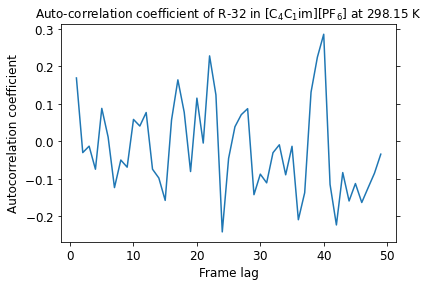

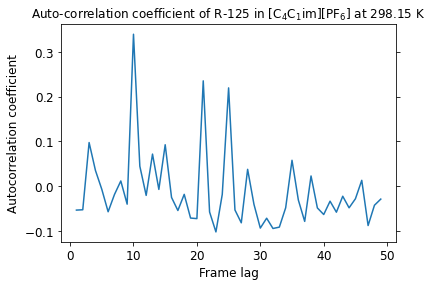

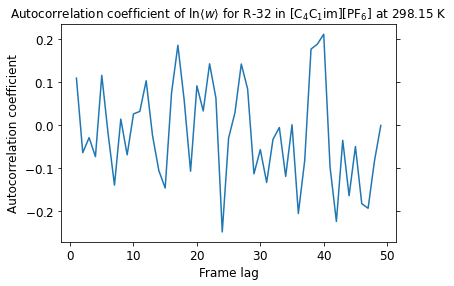

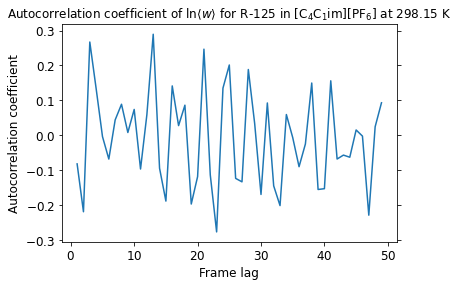

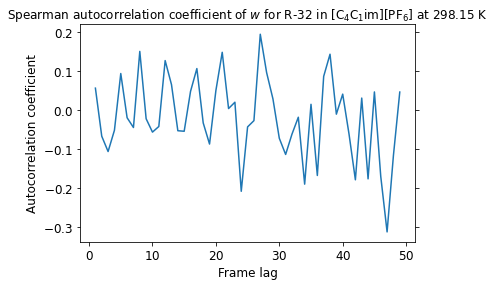

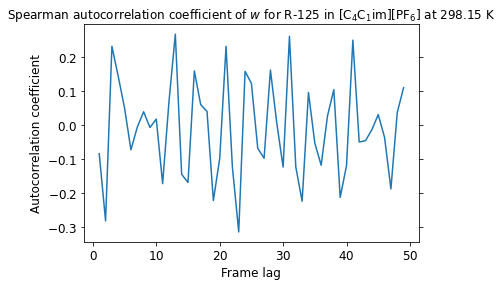

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


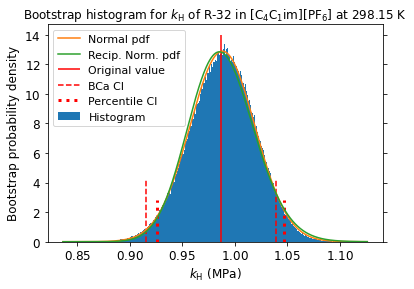

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


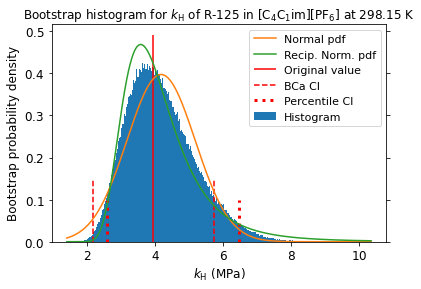

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


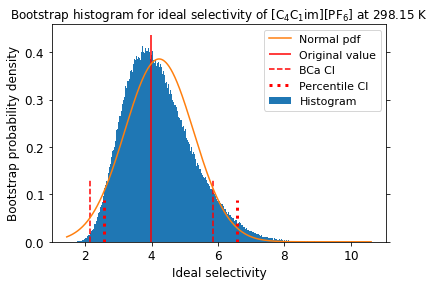

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


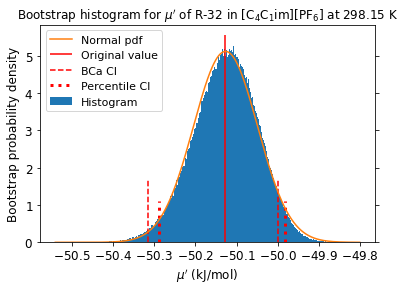

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


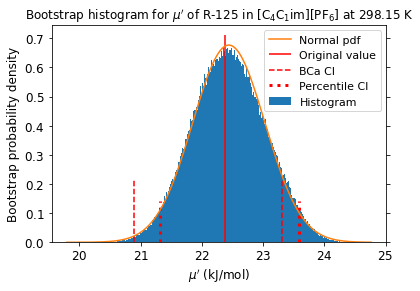

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


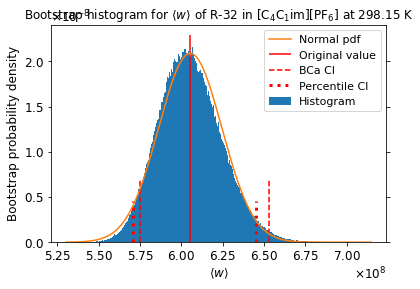

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


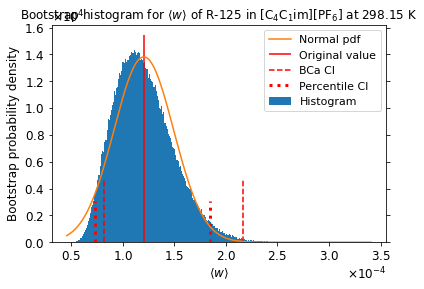

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.000813,0.009029,-0.008141,0.016726
Temp,-0.002151,-0.008014,-0.004272,-0.003271
Volume,0.002242,0.150067,0.008150,0.170669
Press,-0.001170,-0.000887,-0.008952,0.001146
PotEng,0.002691,0.055473,0.009251,0.054609
KinEng,-0.002151,-0.008014,-0.004272,-0.003271
TotEng,0.000623,0.036648,0.004189,0.039101
E_pair,0.007926,0.099215,0.005881,0.100215
E_vdwl,0.005710,0.092662,0.002117,0.101697
E_coul,0.006584,0.040727,0.007042,0.031446


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.007770,0.007770,0.017274,0.017274
Temp,-0.004802,-0.004802,0.000445,0.000445
Volume,0.141414,0.141414,0.156622,0.156622
Press,-0.000494,-0.000494,0.003752,0.003752
PotEng,0.052741,0.052741,0.049389,0.049389
KinEng,-0.004802,-0.004802,0.000445,0.000445
TotEng,0.036285,0.036285,0.037391,0.037391
E_pair,0.094878,0.094878,0.089794,0.089794
E_vdwl,0.088330,0.088330,0.090945,0.090945
E_coul,0.038743,0.038743,0.029896,0.029896


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.005173,0.005173,0.011511,0.011511
Temp,-0.003220,-0.003220,0.000305,0.000305
Volume,0.094554,0.094554,0.104833,0.104833
Press,-0.000333,-0.000333,0.002476,0.002476
PotEng,0.035111,0.035111,0.032909,0.032909
KinEng,-0.003220,-0.003220,0.000306,0.000306
TotEng,0.024145,0.024145,0.024948,0.024948
E_pair,0.063249,0.063249,0.060026,0.060026
E_vdwl,0.058914,0.058914,0.060846,0.060846
E_coul,0.025801,0.025801,0.019944,0.019944


R-32 w column correlation (first 5 columns):
 [[ 1.00000000e+00  1.57809219e-03  6.08536538e-03 -5.96462232e-04
   5.18128929e-03]
 [ 1.57809219e-03  1.00000000e+00 -2.78290631e-04  3.04677929e-03
   4.92436056e-04]
 [ 6.08536538e-03 -2.78290631e-04  1.00000000e+00  9.72517913e-04
  -3.24685410e-04]
 [-5.96462232e-04  3.04677929e-03  9.72517913e-04  1.00000000e+00
   9.34009573e-04]
 [ 5.18128929e-03  4.92436056e-04 -3.24685410e-04  9.34009573e-04
   1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.13120207 0.13410361 0.13494169 0.12747868]
 [0.13120207 1.         0.13106556 0.12992141 0.12664798]
 [0.13410361 0.13106556 1.         0.13020129 0.13086561]
 [0.13494169 0.12992141 0.13020129 1.         0.12931232]
 [0.12747868 0.12664798 0.13086561 0.12931232 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.14358128 0.13869828 0.1400031  0.13603777]
 [0.14358128 1.         0.13834504 0.14038288 0.13928693]
 [0.13869828 0.

10 highest observations are:

[[1.27099652e+09 3.06306058e-04]
 [1.27847870e+09 3.26723990e-04]
 [1.36396341e+09 3.84147060e-04]
 [1.55843081e+09 4.19265029e-04]
 [1.93860580e+09 4.87504710e-04]
 [2.02400628e+09 5.90696116e-04]
 [2.09502201e+09 7.64763983e-04]
 [2.28333677e+09 8.71420310e-04]
 [2.57724902e+09 2.15871525e-03]
 [7.55909820e+09 4.31229445e-03]]
with indices:

[[56 50]
 [ 8 23]
 [42 98]
 [82 83]
 [32 29]
 [19  0]
 [94 55]
 [85 26]
 [89 87]
 [20 30]]


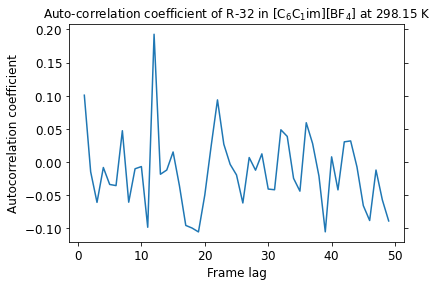

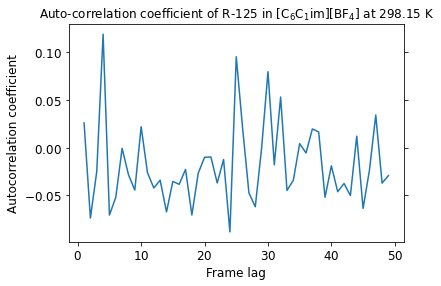

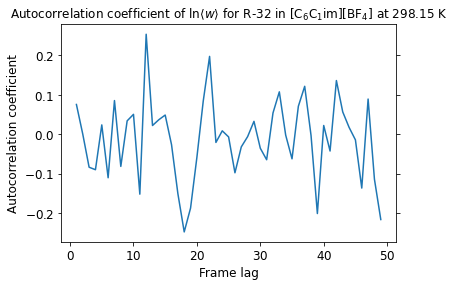

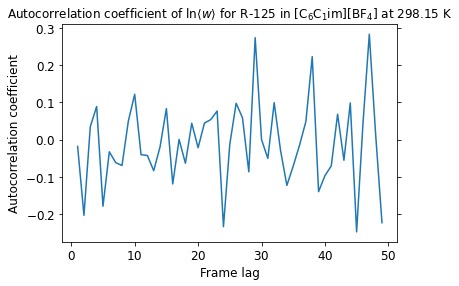

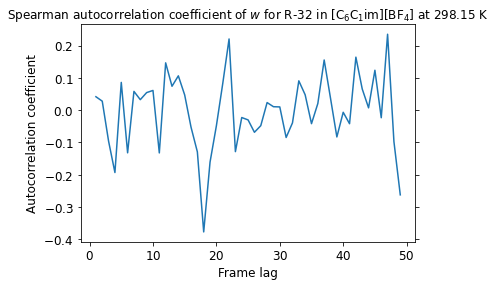

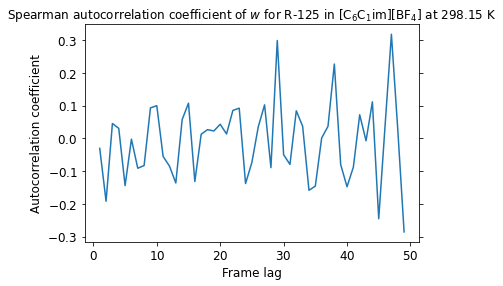

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


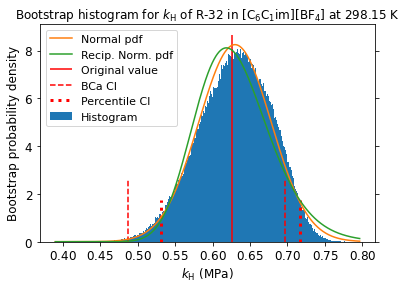

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


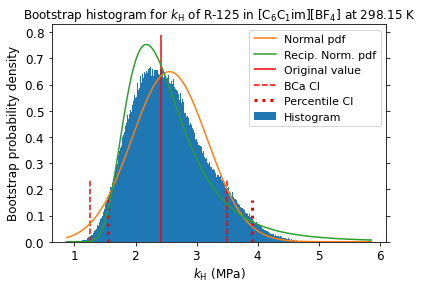

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


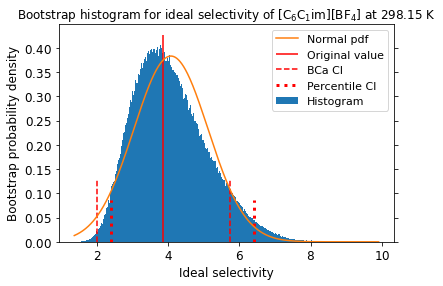

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


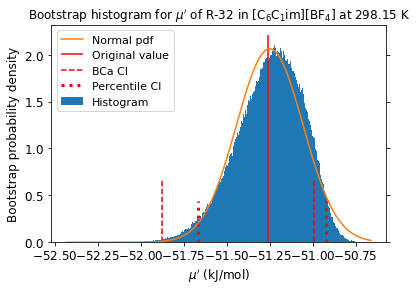

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


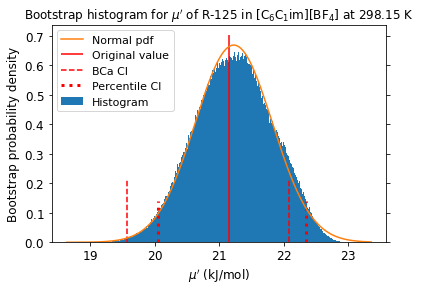

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


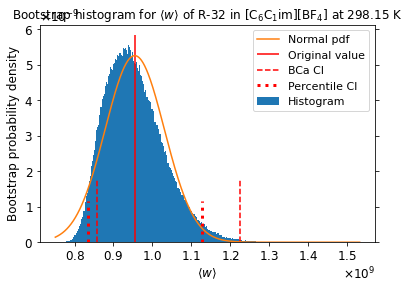

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


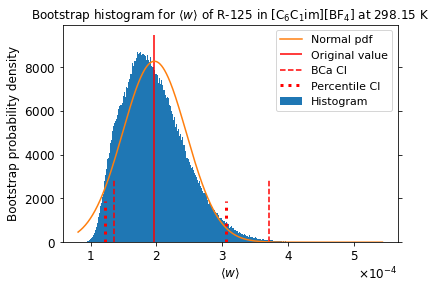

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.004591,-0.036325,0.006637,-0.017627
Temp,-0.003022,-0.003659,0.010984,-0.006744
Volume,0.017946,0.151725,-0.003845,0.185051
Press,0.003153,-0.005783,-0.003326,-0.015749
PotEng,0.014303,0.058880,-0.002077,0.067548
KinEng,-0.003022,-0.003659,0.010984,-0.006744
TotEng,0.008990,0.042651,0.005470,0.047294
E_pair,0.016670,0.096847,-0.005365,0.109069
E_vdwl,0.016457,0.080896,0.001192,0.100699
E_coul,0.002517,0.040012,-0.008393,0.034574


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.037274,-0.037274,-0.017090,-0.017090
Temp,-0.002118,-0.002118,-0.005292,-0.005292
Volume,0.140890,0.140890,0.170435,0.170435
Press,-0.003920,-0.003920,-0.014932,-0.014932
PotEng,0.054983,0.054983,0.061258,0.061258
KinEng,-0.002118,-0.002118,-0.005292,-0.005292
TotEng,0.039494,0.039494,0.042010,0.042010
E_pair,0.089056,0.089056,0.099344,0.099344
E_vdwl,0.075179,0.075179,0.093535,0.093535
E_coul,0.037074,0.037074,0.030097,0.030097


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.024765,-0.024765,-0.011398,-0.011398
Temp,-0.001404,-0.001404,-0.003528,-0.003528
Volume,0.094298,0.094298,0.114205,0.114205
Press,-0.002621,-0.002621,-0.009956,-0.009956
PotEng,0.036688,0.036688,0.040905,0.040905
KinEng,-0.001404,-0.001404,-0.003528,-0.003528
TotEng,0.026363,0.026363,0.028047,0.028047
E_pair,0.059547,0.059547,0.066351,0.066351
E_vdwl,0.050166,0.050166,0.062425,0.062425
E_coul,0.024737,0.024737,0.020100,0.020100


R-32 w column correlation (first 5 columns):
 [[ 1.00000000e+00 -3.87505163e-04 -2.63937091e-04  1.15794544e-03
  -3.47373405e-04]
 [-3.87505163e-04  1.00000000e+00  4.22641527e-04 -4.36806411e-04
  -2.75225132e-04]
 [-2.63937091e-04  4.22641527e-04  1.00000000e+00  1.18786731e-04
  -1.74164430e-04]
 [ 1.15794544e-03 -4.36806411e-04  1.18786731e-04  1.00000000e+00
   5.33825844e-04]
 [-3.47373405e-04 -2.75225132e-04 -1.74164430e-04  5.33825844e-04
   1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.14928063 0.13767289 0.14478252 0.14373624]
 [0.14928063 1.         0.14327647 0.13960729 0.13935408]
 [0.13767289 0.14327647 1.         0.14414636 0.1352374 ]
 [0.14478252 0.13960729 0.14414636 1.         0.13788301]
 [0.14373624 0.13935408 0.1352374  0.13788301 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.15750957 0.14467297 0.15851656 0.15191107]
 [0.15750957 1.         0.15098492 0.15181691 0.15107038]
 [0.14467297 0.

10 highest observations are:

[[2.83442187e+09 9.59329492e-04]
 [2.94208859e+09 1.06556724e-03]
 [3.27733182e+09 1.20560853e-03]
 [3.40282760e+09 1.42845000e-03]
 [3.42462689e+09 1.97145299e-03]
 [3.48826065e+09 2.65298311e-03]
 [3.52456819e+09 2.80053548e-03]
 [3.73610493e+09 2.91725630e-03]
 [4.58527659e+09 5.30705455e-03]
 [6.37524745e+09 2.81635176e-02]]
with indices:

[[18 92]
 [82 93]
 [92 48]
 [20 64]
 [27 29]
 [32 30]
 [89 78]
 [38 40]
 [22 73]
 [37 55]]


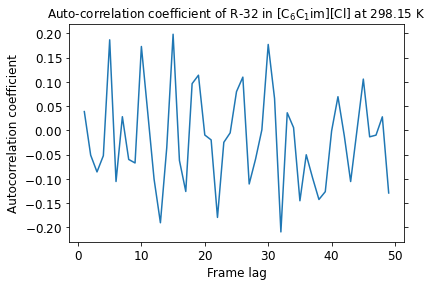

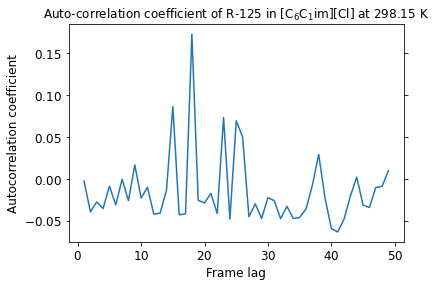

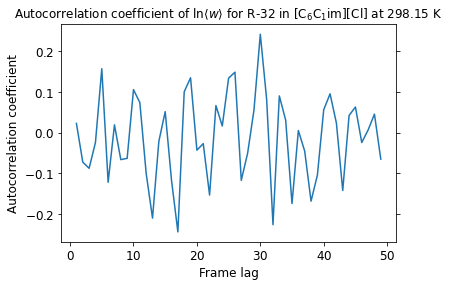

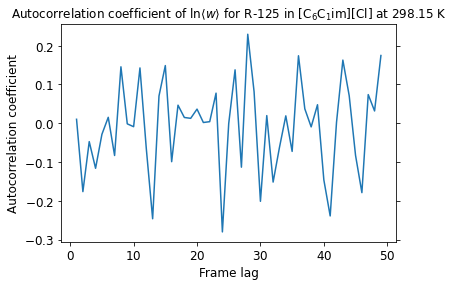

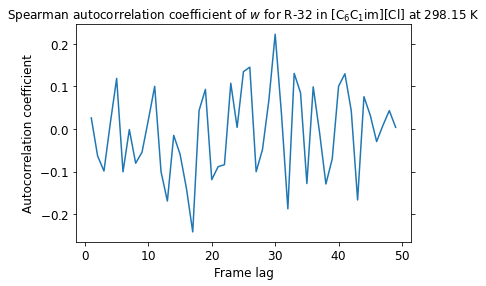

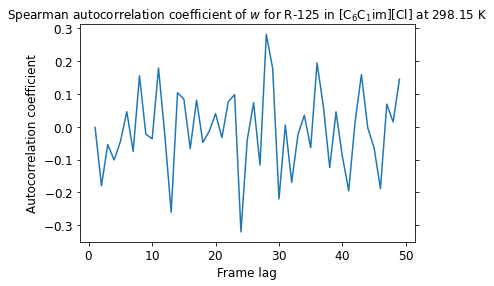

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


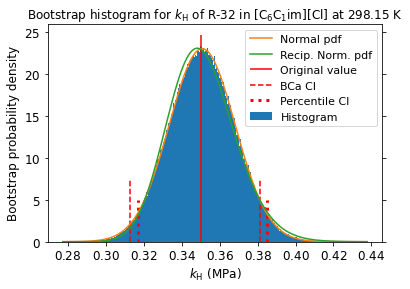

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


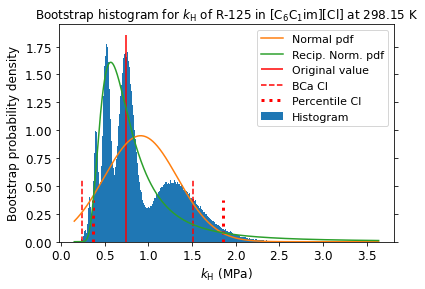

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


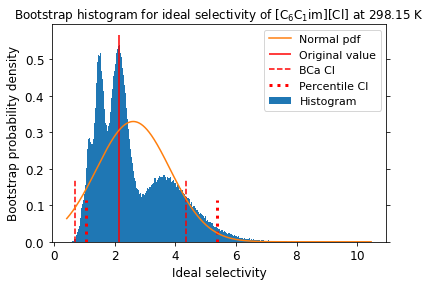

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


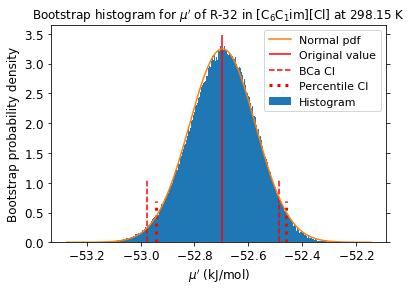

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


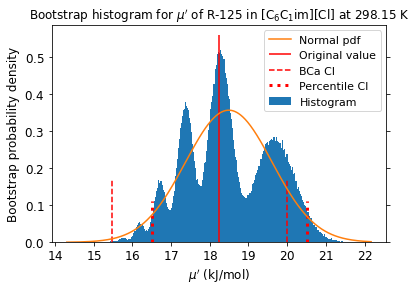

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


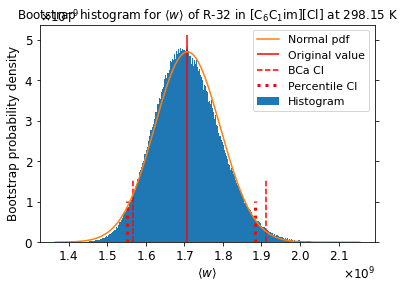

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


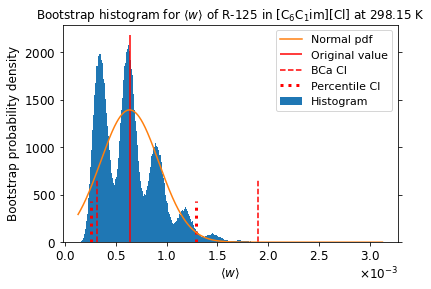

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


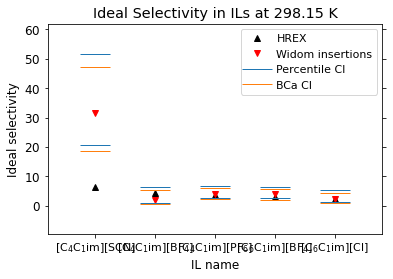

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


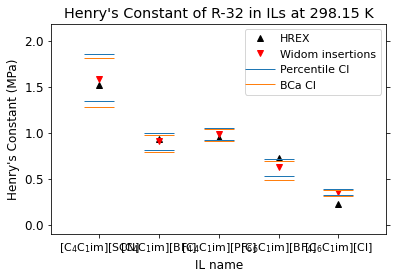

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


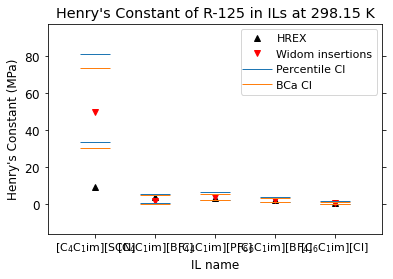

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


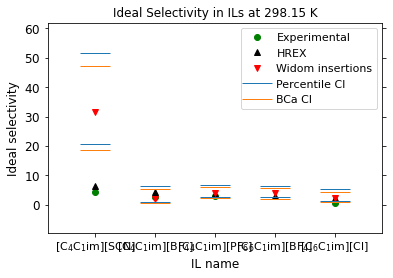

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


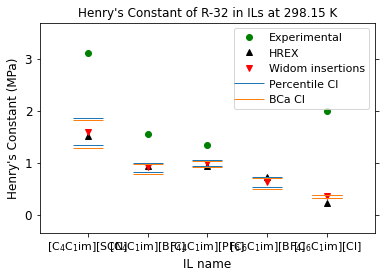

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


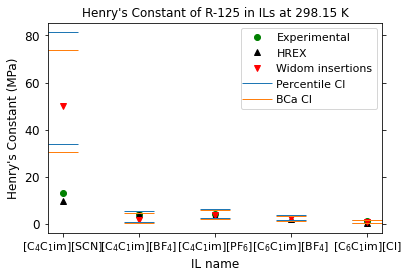

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


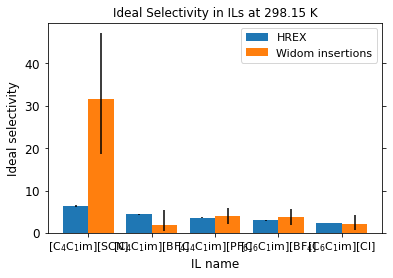

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


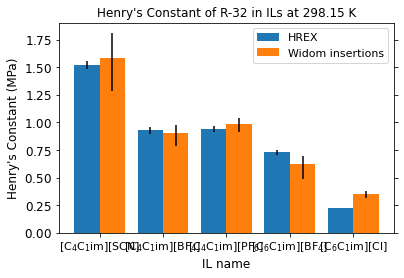

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


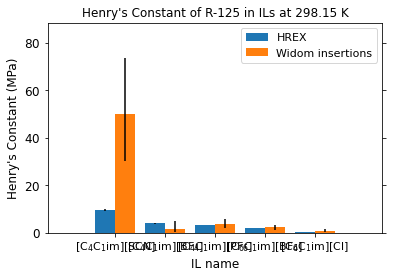

In [99]:
plot_results("Eij_max_estimation_2/hbs", "Eij_max_estimation_2", bs_axis=1, get_corr=True)

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.004094,-0.003274,0.009835,-0.003577
Temp,0.003750,-0.001042,0.001556,-0.001401
Volume,0.005750,0.156033,-0.000977,0.158417
Press,-0.001064,-0.008034,-0.004185,-0.008777
PotEng,-0.000657,0.065505,-0.002053,0.065270
KinEng,0.003750,-0.001042,0.001556,-0.001401
TotEng,0.001948,0.048865,-0.000539,0.048447
E_pair,0.005417,0.103515,0.001631,0.102822
E_vdwl,0.003820,0.098439,0.002131,0.100489
E_coul,0.003607,0.039595,-0.000196,0.037485


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.004241,-0.004241,-0.002097,-0.003395
Temp,-0.003879,-0.003879,-0.002761,-0.003074
Volume,0.143540,0.143540,0.152390,0.148519
Press,-0.008630,-0.008630,-0.008283,-0.008222
PotEng,0.062565,0.062565,0.060185,0.059011
KinEng,-0.003879,-0.003879,-0.002762,-0.003074
TotEng,0.044981,0.044981,0.043592,0.042420
E_pair,0.094590,0.094590,0.096648,0.094239
E_vdwl,0.089621,0.089621,0.093373,0.091294
E_coul,0.035571,0.035571,0.034910,0.033463


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.002831,-0.002831,-0.001430,-0.002290
Temp,-0.002575,-0.002575,-0.001846,-0.002053
Volume,0.096087,0.096087,0.102011,0.099379
Press,-0.005754,-0.005754,-0.005510,-0.005470
PotEng,0.041725,0.041725,0.040152,0.039367
KinEng,-0.002575,-0.002575,-0.001846,-0.002053
TotEng,0.030035,0.030035,0.029080,0.028299
E_pair,0.063130,0.063130,0.064507,0.062885
E_vdwl,0.059817,0.059817,0.062267,0.060866
E_coul,0.023712,0.023712,0.023292,0.022326


R-32 w column correlation (first 5 columns):
 [[ 1.00000000e+00 -1.01355366e-04 -2.52131575e-05  3.06377664e-03
  -1.54992587e-04]
 [-1.01355366e-04  1.00000000e+00 -4.22932472e-05 -1.64712382e-04
   7.48259491e-04]
 [-2.52131575e-05 -4.22932472e-05  1.00000000e+00  9.87836709e-04
  -1.77351747e-04]
 [ 3.06377664e-03 -1.64712382e-04  9.87836709e-04  1.00000000e+00
  -1.40973340e-04]
 [-1.54992587e-04  7.48259491e-04 -1.77351747e-04 -1.40973340e-04
   1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.13993892 0.12838318 0.13117267        nan]
 [0.13993892 1.         0.1251832  0.13566133        nan]
 [0.12838318 0.1251832  1.         0.13542383        nan]
 [0.13117267 0.13566133 0.13542383 1.                nan]
 [       nan        nan        nan        nan        nan]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.1450277  0.1357062  0.14251525 0.15001874]
 [0.1450277  1.         0.13263383 0.14477524 0.13745482]
 [0.1357062  0.

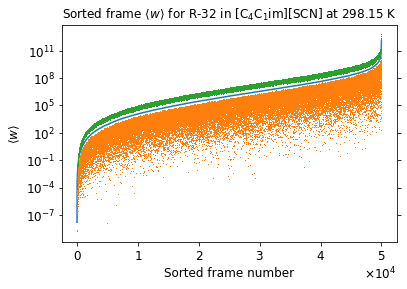

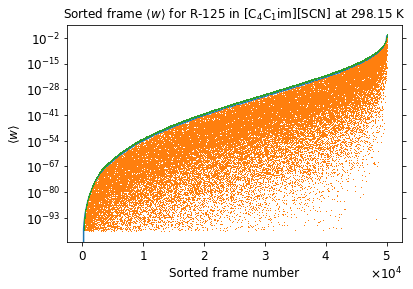

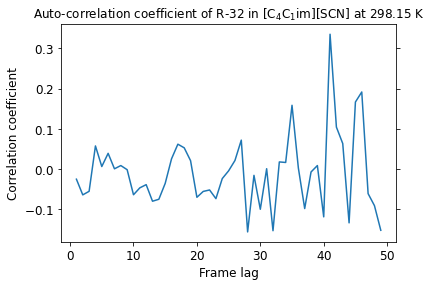

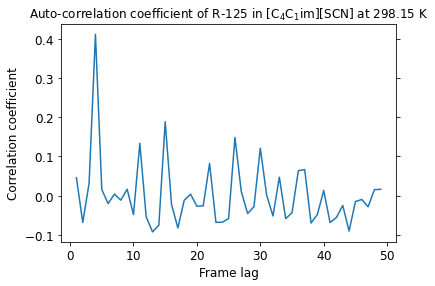

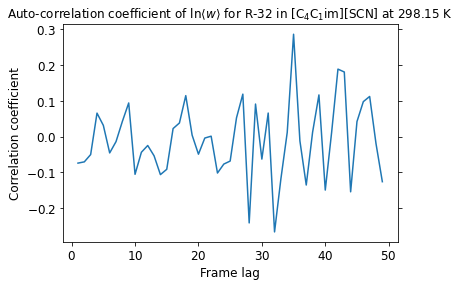

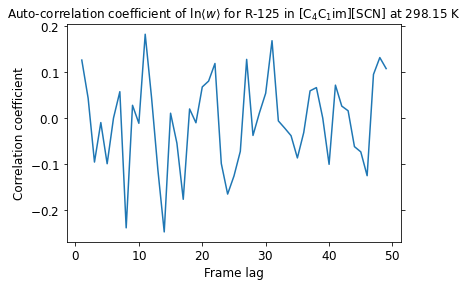

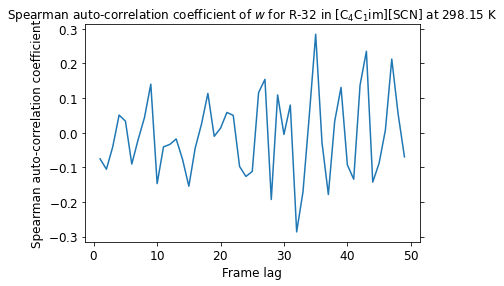

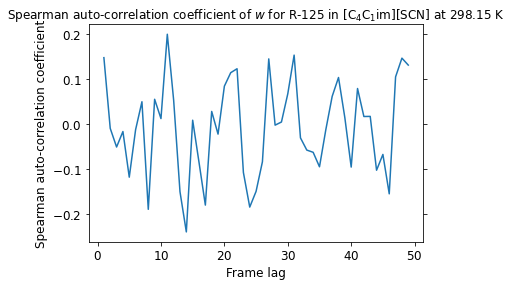

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


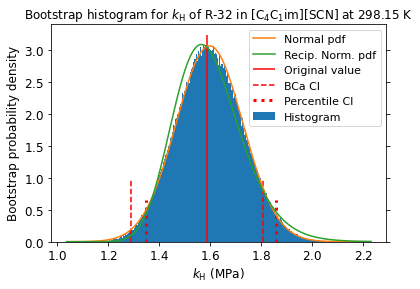

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


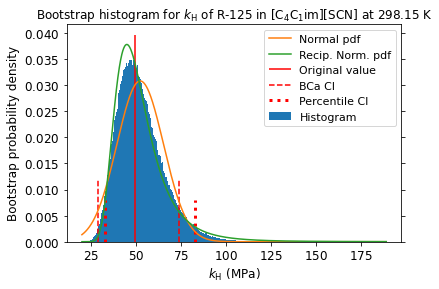

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


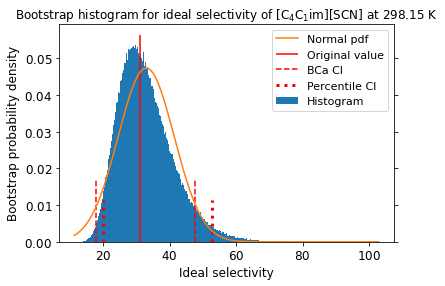

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


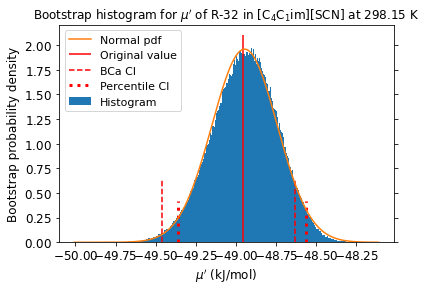

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


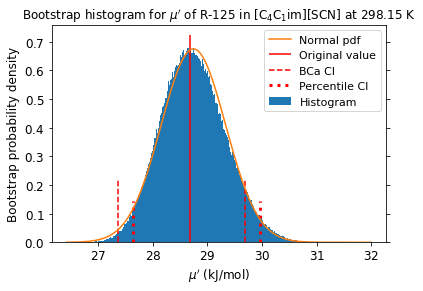

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


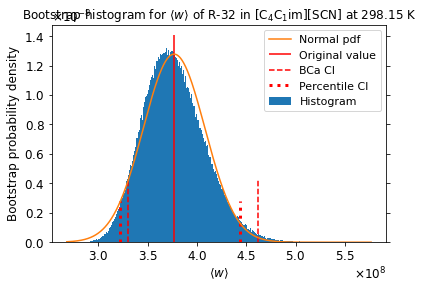

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


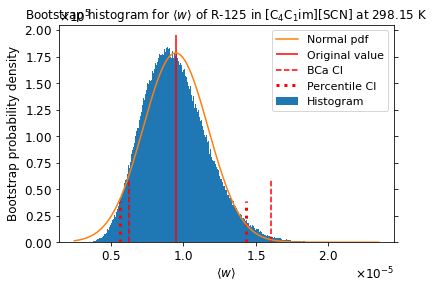

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.000488,0.014947,-0.000255,0.021984
Temp,-0.007144,-0.003439,0.001291,-0.001005
Volume,0.010482,0.157436,0.000857,0.181183
Press,-0.001300,-0.008888,0.004640,-0.006752
PotEng,0.001917,0.066232,0.001888,0.074505
KinEng,-0.007144,-0.003439,0.001291,-0.001005
TotEng,-0.003240,0.047639,0.002269,0.055468
E_pair,0.009640,0.109963,0.002381,0.114637
E_vdwl,0.011416,0.104670,-0.003252,0.110540
E_coul,-0.000215,0.045866,0.007669,0.047771


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.013710,0.013710,0.020462,0.020462
Temp,-0.003541,-0.003541,-0.001108,-0.001108
Volume,0.148015,0.148015,0.167609,0.167609
Press,-0.009239,-0.009239,-0.005392,-0.005392
PotEng,0.062742,0.062742,0.071870,0.071870
KinEng,-0.003541,-0.003541,-0.001108,-0.001108
TotEng,0.044550,0.044550,0.052969,0.052969
E_pair,0.102318,0.102318,0.104774,0.104774
E_vdwl,0.097992,0.097992,0.102215,0.102215
E_coul,0.042127,0.042127,0.042184,0.042184


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.009149,0.009149,0.013625,0.013625
Temp,-0.002366,-0.002366,-0.000731,-0.000731
Volume,0.099012,0.099012,0.112304,0.112304
Press,-0.006169,-0.006169,-0.003588,-0.003588
PotEng,0.041824,0.041824,0.047948,0.047948
KinEng,-0.002366,-0.002366,-0.000731,-0.000731
TotEng,0.029686,0.029686,0.035293,0.035293
E_pair,0.068271,0.068271,0.070006,0.070006
E_vdwl,0.065430,0.065430,0.068373,0.068373
E_coul,0.028081,0.028081,0.028130,0.028130


R-32 w column correlation (first 5 columns):
 [[ 1.00000000e+00  8.35351567e-04 -6.96525417e-05 -9.96247349e-05
   1.57516736e-04]
 [ 8.35351567e-04  1.00000000e+00  4.75289976e-03  4.87609384e-04
   2.20674520e-03]
 [-6.96525417e-05  4.75289976e-03  1.00000000e+00  2.10729546e-03
  -1.72717660e-04]
 [-9.96247349e-05  4.87609384e-04  2.10729546e-03  1.00000000e+00
  -2.60973253e-04]
 [ 1.57516736e-04  2.20674520e-03 -1.72717660e-04 -2.60973253e-04
   1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.14040318 0.14544025 0.14321816 0.14141293]
 [0.14040318 1.         0.13435651 0.14432586 0.14191152]
 [0.14544025 0.13435651 1.         0.14300732 0.14269558]
 [0.14321816 0.14432586 0.14300732 1.         0.13707884]
 [0.14141293 0.14191152 0.14269558 0.13707884 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.15091164 0.15389399 0.15575884 0.14844493]
 [0.15091164 1.         0.14460609 0.15255264 0.15060837]
 [0.15389399 0.

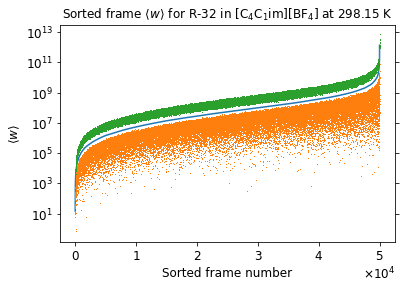

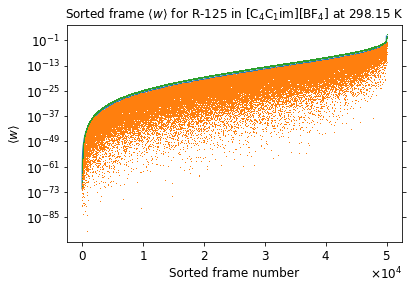

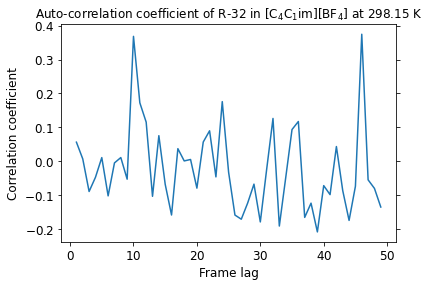

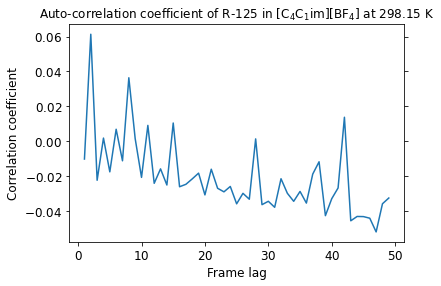

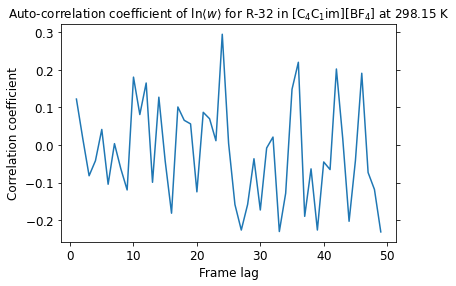

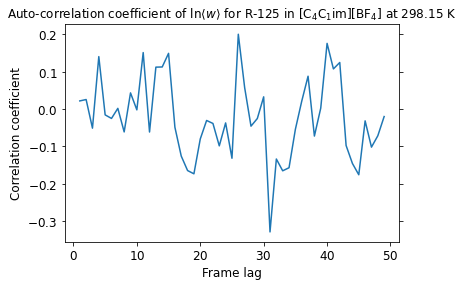

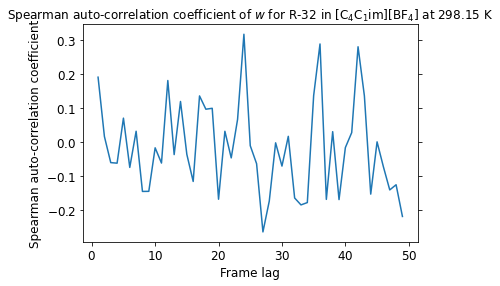

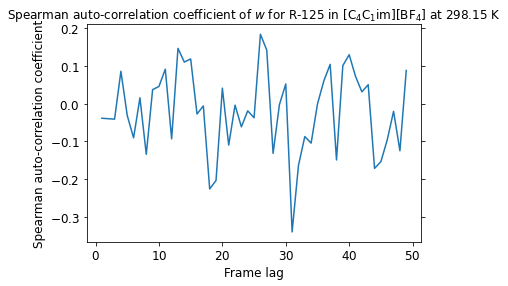

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


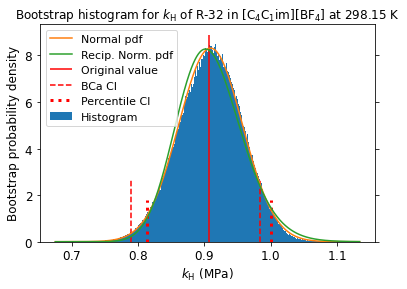

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


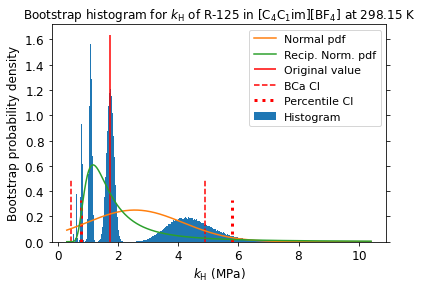

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


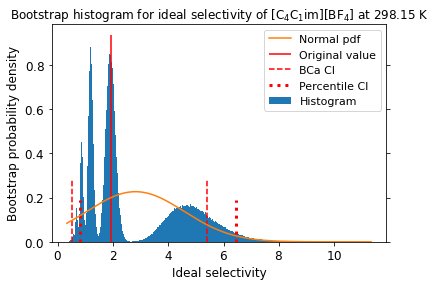

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


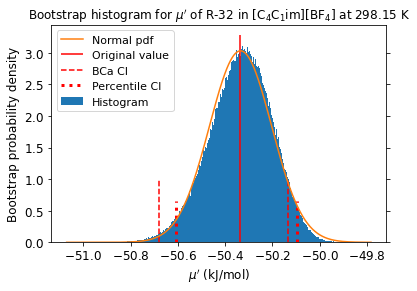

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


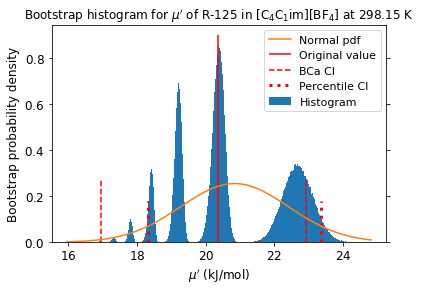

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


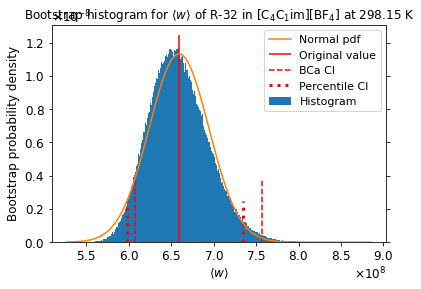

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


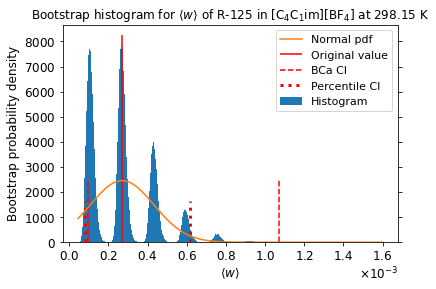

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.006549,0.005969,0.004959,0.007688
Temp,0.007728,0.000076,-0.005083,0.003217
Volume,0.003706,0.155508,0.006186,0.177387
Press,0.001836,-0.001944,-0.008171,-0.001153
PotEng,0.009789,0.064388,0.009248,0.064812
KinEng,0.007728,0.000076,-0.005083,0.003217
TotEng,0.012455,0.048711,0.003663,0.051086
E_pair,0.002535,0.108017,0.006996,0.113521
E_vdwl,-0.000392,0.109493,0.007581,0.118536
E_coul,0.002720,0.039264,0.002128,0.037943


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.005036,0.005036,0.007670,0.007670
Temp,-0.000955,-0.000955,0.004379,0.004379
Volume,0.145291,0.145291,0.162504,0.162504
Press,-0.001824,-0.001824,0.001236,0.001236
PotEng,0.059272,0.059272,0.059835,0.059835
KinEng,-0.000955,-0.000955,0.004379,0.004379
TotEng,0.044093,0.044093,0.048576,0.048576
E_pair,0.100778,0.100778,0.103082,0.103082
E_vdwl,0.101764,0.101764,0.107281,0.107281
E_coul,0.035773,0.035773,0.033624,0.033624


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.003385,0.003385,0.005160,0.005160
Temp,-0.000626,-0.000626,0.002926,0.002926
Volume,0.097360,0.097360,0.108813,0.108813
Press,-0.001207,-0.001207,0.000814,0.000814
PotEng,0.039569,0.039569,0.039926,0.039926
KinEng,-0.000626,-0.000626,0.002926,0.002926
TotEng,0.029470,0.029470,0.032457,0.032457
E_pair,0.067343,0.067343,0.068838,0.068838
E_vdwl,0.067977,0.067977,0.071686,0.071686
E_coul,0.023871,0.023871,0.022446,0.022446


R-32 w column correlation (first 5 columns):
 [[ 1.00000000e+00 -9.24216135e-07 -1.83821072e-04  5.10694660e-04
   8.36968009e-05]
 [-9.24216135e-07  1.00000000e+00 -2.42221017e-04 -2.27976921e-04
  -9.43522353e-05]
 [-1.83821072e-04 -2.42221017e-04  1.00000000e+00 -1.29337720e-04
   1.10772501e-03]
 [ 5.10694660e-04 -2.27976921e-04 -1.29337720e-04  1.00000000e+00
  -8.42166387e-04]
 [ 8.36968009e-05 -9.43522353e-05  1.10772501e-03 -8.42166387e-04
   1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.13646225 0.12880344 0.13020445 0.12989797]
 [0.13646225 1.         0.12594618 0.1291931  0.1295033 ]
 [0.12880344 0.12594618 1.         0.13238926 0.12493166]
 [0.13020445 0.1291931  0.13238926 1.         0.13082611]
 [0.12989797 0.1295033  0.12493166 0.13082611 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.14032844 0.13454716 0.13736994 0.13782297]
 [0.14032844 1.         0.13581997 0.13490342 0.1361052 ]
 [0.13454716 0.

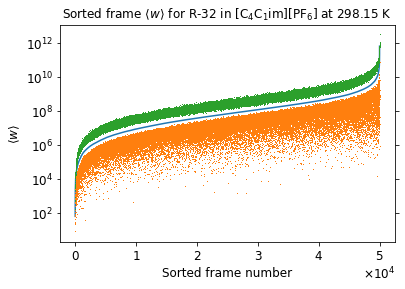

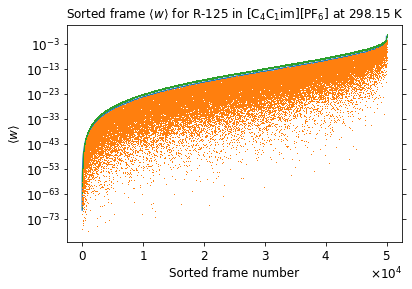

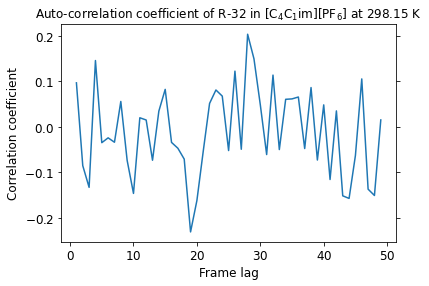

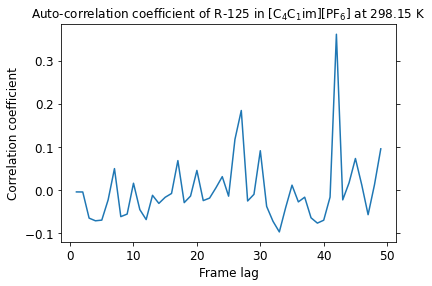

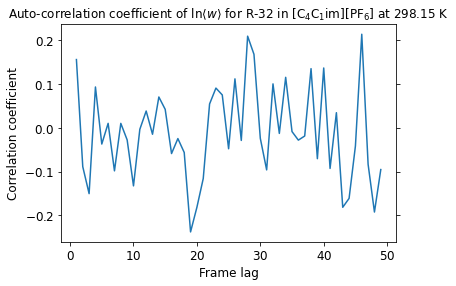

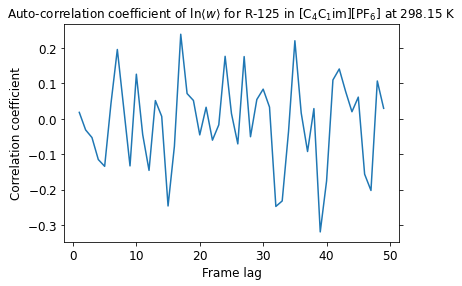

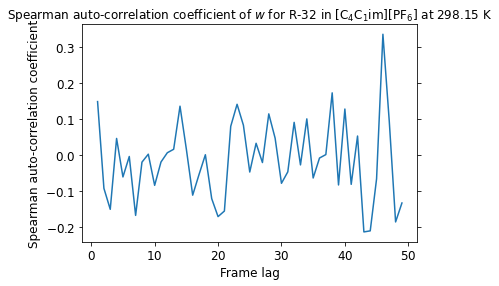

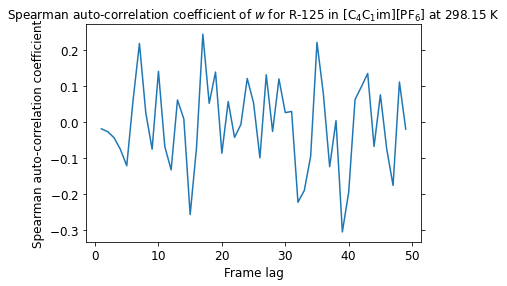

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


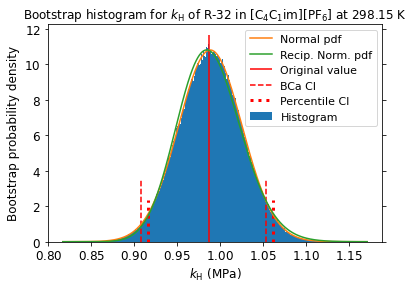

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


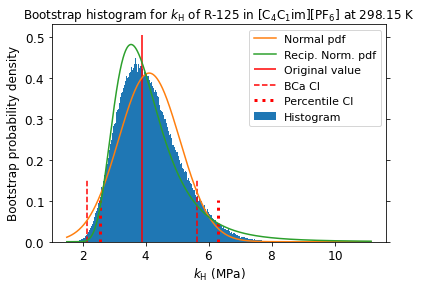

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


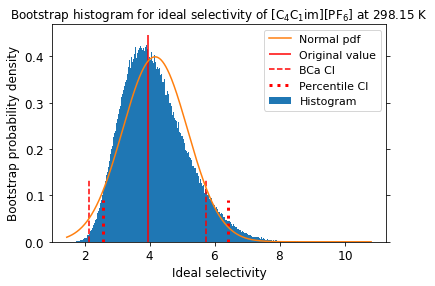

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


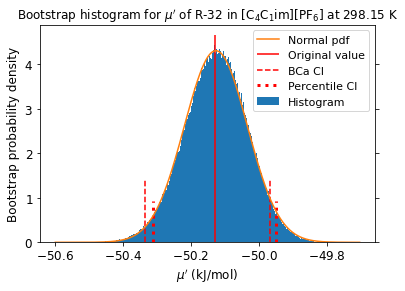

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


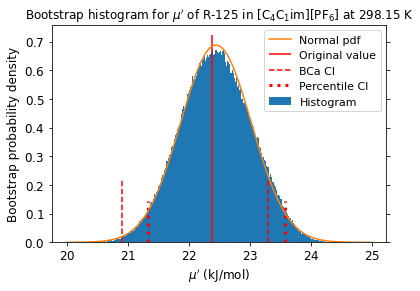

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


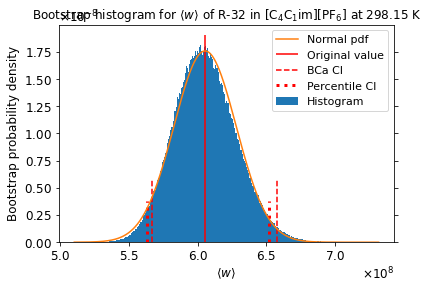

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


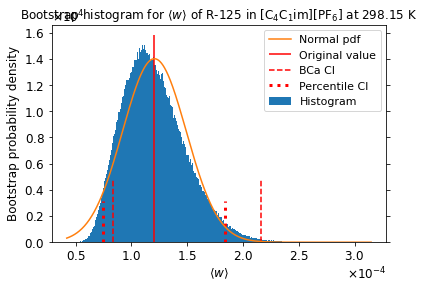

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.000813,0.009029,-0.008141,0.016726
Temp,-0.002151,-0.008014,-0.004272,-0.003271
Volume,0.002242,0.150067,0.008150,0.170669
Press,-0.001170,-0.000887,-0.008952,0.001146
PotEng,0.002691,0.055473,0.009251,0.054609
KinEng,-0.002151,-0.008014,-0.004272,-0.003271
TotEng,0.000623,0.036648,0.004189,0.039101
E_pair,0.007926,0.099215,0.005881,0.100215
E_vdwl,0.005710,0.092662,0.002117,0.101697
E_coul,0.006584,0.040727,0.007042,0.031446


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.007770,0.007770,0.017274,0.017274
Temp,-0.004802,-0.004802,0.000445,0.000445
Volume,0.141414,0.141414,0.156622,0.156622
Press,-0.000494,-0.000494,0.003752,0.003752
PotEng,0.052741,0.052741,0.049389,0.049389
KinEng,-0.004802,-0.004802,0.000445,0.000445
TotEng,0.036285,0.036285,0.037391,0.037391
E_pair,0.094878,0.094878,0.089794,0.089794
E_vdwl,0.088330,0.088330,0.090945,0.090945
E_coul,0.038743,0.038743,0.029896,0.029896


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,0.005173,0.005173,0.011511,0.011511
Temp,-0.003220,-0.003220,0.000305,0.000305
Volume,0.094554,0.094554,0.104833,0.104833
Press,-0.000333,-0.000333,0.002476,0.002476
PotEng,0.035111,0.035111,0.032909,0.032909
KinEng,-0.003220,-0.003220,0.000306,0.000306
TotEng,0.024145,0.024145,0.024948,0.024948
E_pair,0.063249,0.063249,0.060026,0.060026
E_vdwl,0.058914,0.058914,0.060846,0.060846
E_coul,0.025801,0.025801,0.019944,0.019944


R-32 w column correlation (first 5 columns):
 [[ 1.00000000e+00  1.57809219e-03  6.08536538e-03 -5.96462232e-04
   5.18128929e-03]
 [ 1.57809219e-03  1.00000000e+00 -2.78290631e-04  3.04677929e-03
   4.92436056e-04]
 [ 6.08536538e-03 -2.78290631e-04  1.00000000e+00  9.72517913e-04
  -3.24685410e-04]
 [-5.96462232e-04  3.04677929e-03  9.72517913e-04  1.00000000e+00
   9.34009573e-04]
 [ 5.18128929e-03  4.92436056e-04 -3.24685410e-04  9.34009573e-04
   1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.13120207 0.13410361 0.13494169 0.12747868]
 [0.13120207 1.         0.13106556 0.12992141 0.12664798]
 [0.13410361 0.13106556 1.         0.13020129 0.13086561]
 [0.13494169 0.12992141 0.13020129 1.         0.12931232]
 [0.12747868 0.12664798 0.13086561 0.12931232 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.14358128 0.13869828 0.1400031  0.13603777]
 [0.14358128 1.         0.13834504 0.14038288 0.13928693]
 [0.13869828 0.

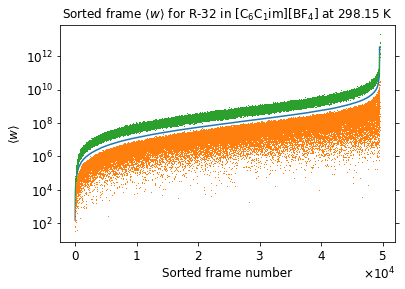

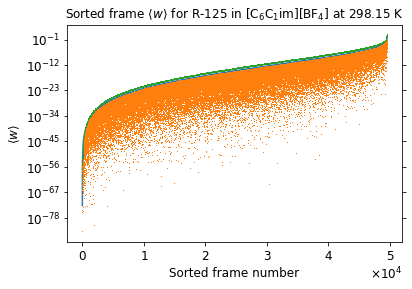

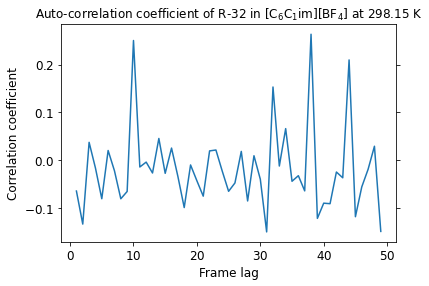

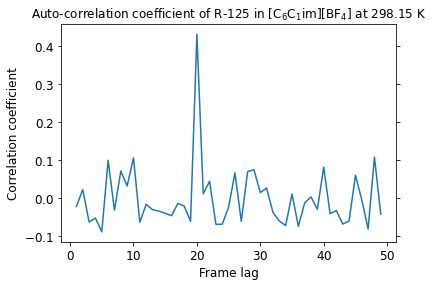

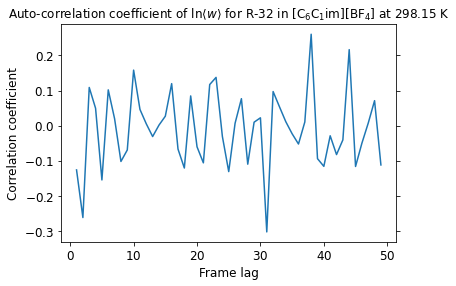

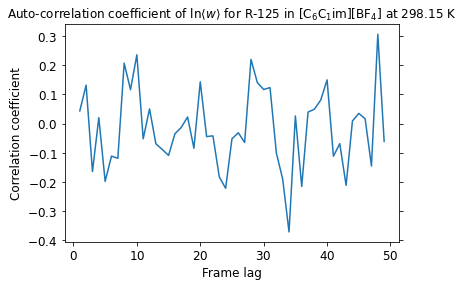

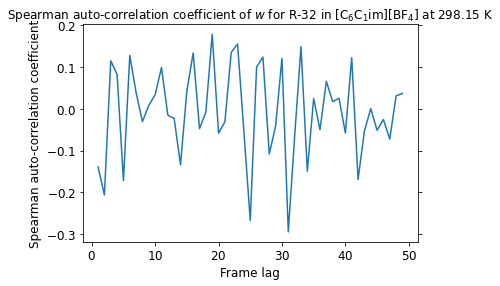

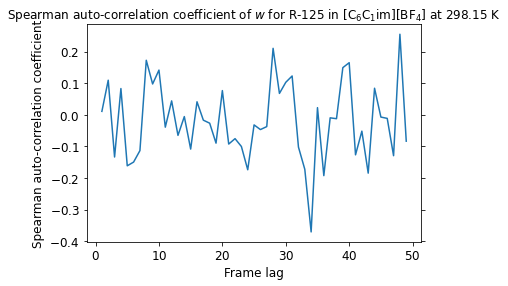

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


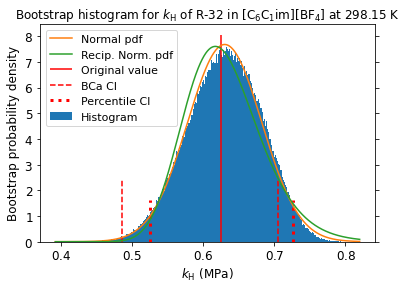

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


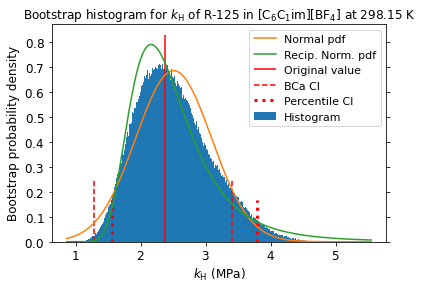

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


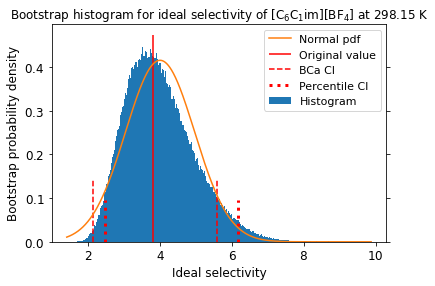

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


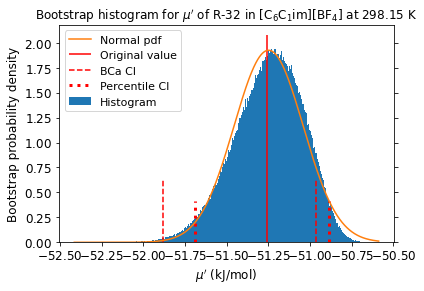

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


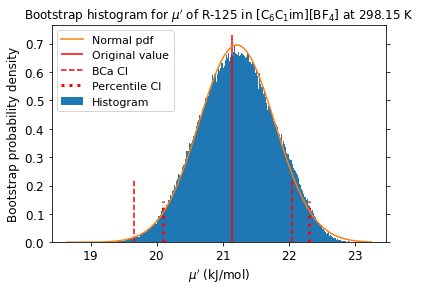

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


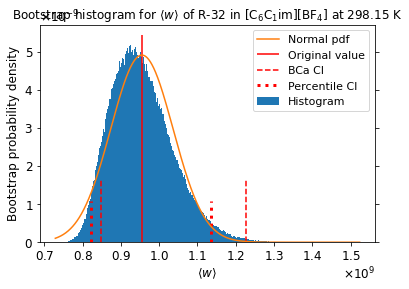

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


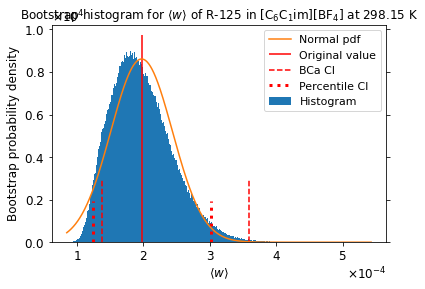

Pearson Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.004591,-0.036325,0.006637,-0.017627
Temp,-0.003022,-0.003659,0.010984,-0.006744
Volume,0.017946,0.151725,-0.003845,0.185051
Press,0.003153,-0.005783,-0.003326,-0.015749
PotEng,0.014303,0.058880,-0.002077,0.067548
KinEng,-0.003022,-0.003659,0.010984,-0.006744
TotEng,0.008990,0.042651,0.005470,0.047294
E_pair,0.016670,0.096847,-0.005365,0.109069
E_vdwl,0.016457,0.080896,0.001192,0.100699
E_coul,0.002517,0.040012,-0.008393,0.034574


Spearman rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.037274,-0.037274,-0.017090,-0.017090
Temp,-0.002118,-0.002118,-0.005292,-0.005292
Volume,0.140890,0.140890,0.170435,0.170435
Press,-0.003920,-0.003920,-0.014932,-0.014932
PotEng,0.054983,0.054983,0.061258,0.061258
KinEng,-0.002118,-0.002118,-0.005292,-0.005292
TotEng,0.039494,0.039494,0.042010,0.042010
E_pair,0.089056,0.089056,0.099344,0.099344
E_vdwl,0.075179,0.075179,0.093535,0.093535
E_coul,0.037074,0.037074,0.030097,0.030097


Kendall Tau rank Correlation Coefficients:


,w_r32,logw_r32,w_r125,logw_r125
Step,-0.024765,-0.024765,-0.011398,-0.011398
Temp,-0.001404,-0.001404,-0.003528,-0.003528
Volume,0.094298,0.094298,0.114205,0.114205
Press,-0.002621,-0.002621,-0.009956,-0.009956
PotEng,0.036688,0.036688,0.040905,0.040905
KinEng,-0.001404,-0.001404,-0.003528,-0.003528
TotEng,0.026363,0.026363,0.028047,0.028047
E_pair,0.059547,0.059547,0.066351,0.066351
E_vdwl,0.050166,0.050166,0.062425,0.062425
E_coul,0.024737,0.024737,0.020100,0.020100


R-32 w column correlation (first 5 columns):
 [[ 1.00000000e+00 -3.87505163e-04 -2.63937091e-04  1.15794544e-03
  -3.47373405e-04]
 [-3.87505163e-04  1.00000000e+00  4.22641527e-04 -4.36806411e-04
  -2.75225132e-04]
 [-2.63937091e-04  4.22641527e-04  1.00000000e+00  1.18786731e-04
  -1.74164430e-04]
 [ 1.15794544e-03 -4.36806411e-04  1.18786731e-04  1.00000000e+00
   5.33825844e-04]
 [-3.47373405e-04 -2.75225132e-04 -1.74164430e-04  5.33825844e-04
   1.00000000e+00]]
R-32 log(w) column correlation (first 5 columns):
 [[1.         0.14928063 0.13767289 0.14478252 0.14373624]
 [0.14928063 1.         0.14327647 0.13960729 0.13935408]
 [0.13767289 0.14327647 1.         0.14414636 0.1352374 ]
 [0.14478252 0.13960729 0.14414636 1.         0.13788301]
 [0.14373624 0.13935408 0.1352374  0.13788301 1.        ]]
R-32 w column Spearman correlation (first 5 columns):
 [[1.         0.15750957 0.14467297 0.15851656 0.15191107]
 [0.15750957 1.         0.15098492 0.15181691 0.15107038]
 [0.14467297 0.

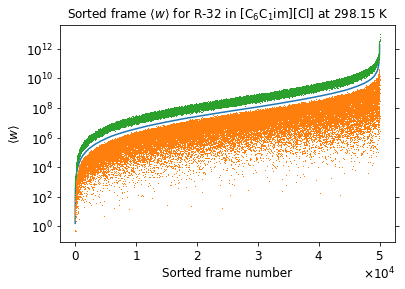

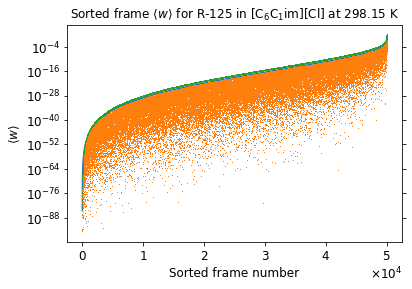

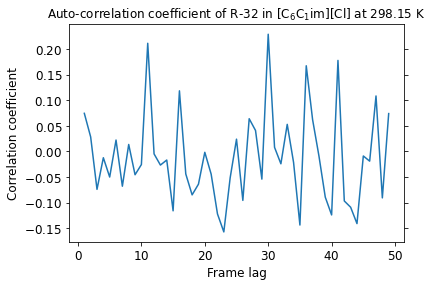

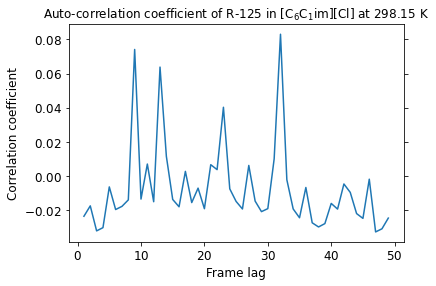

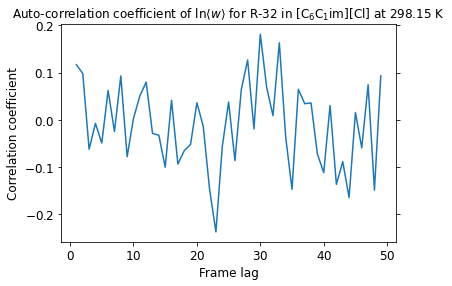

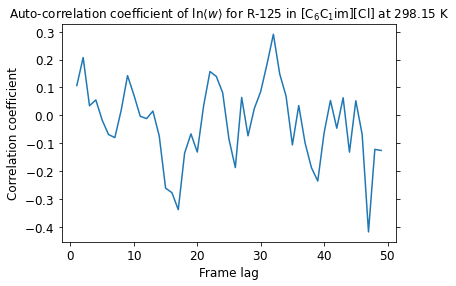

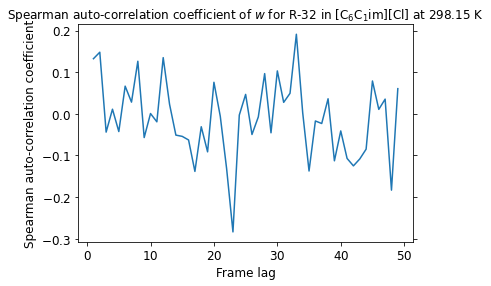

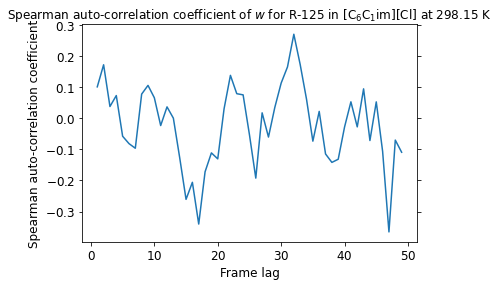

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


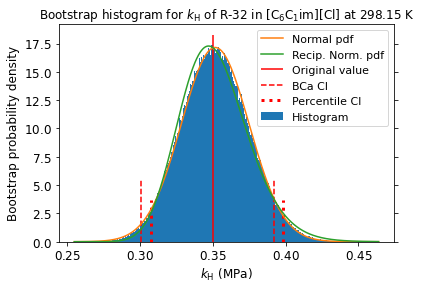

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


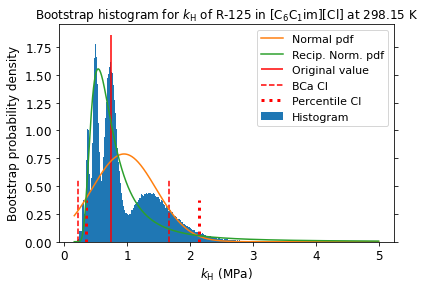

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


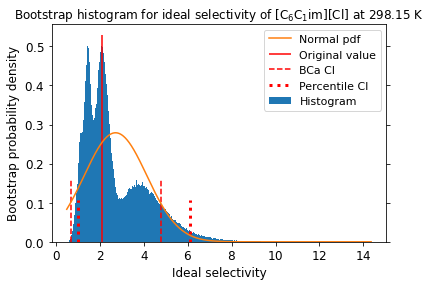

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


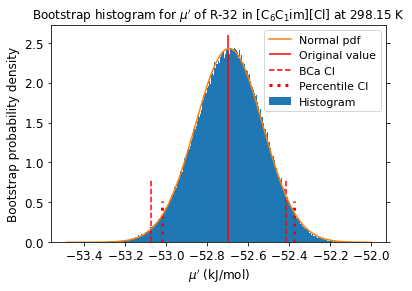

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


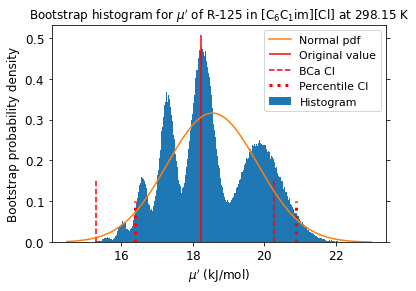

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


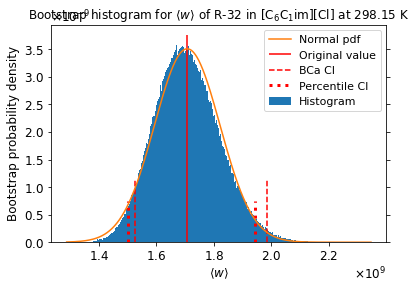

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


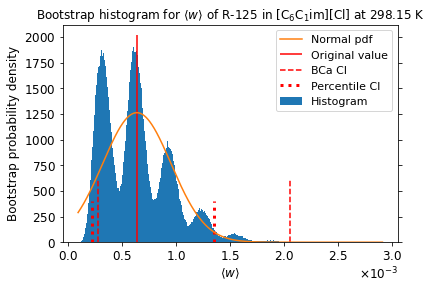

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


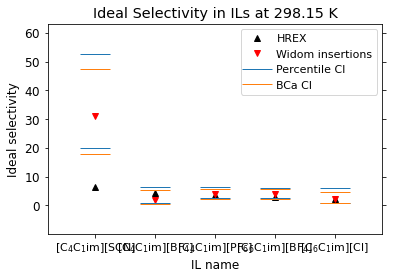

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


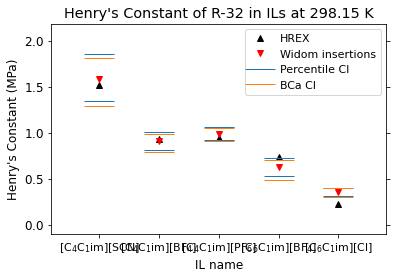

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


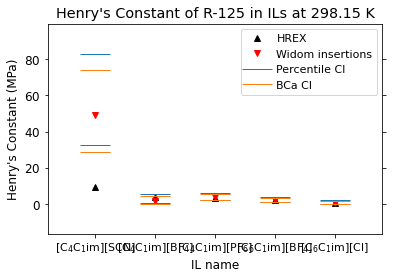

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


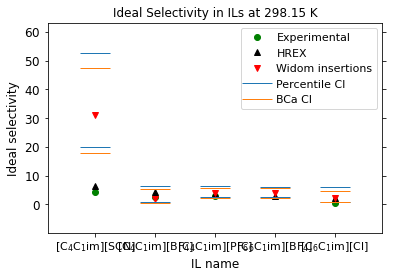

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


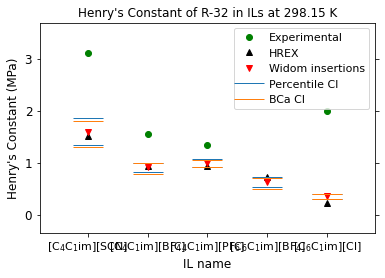

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


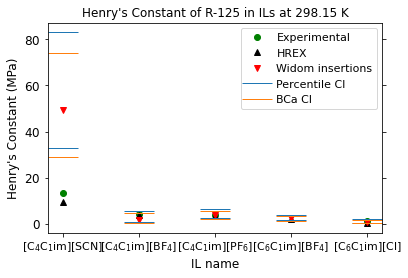

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


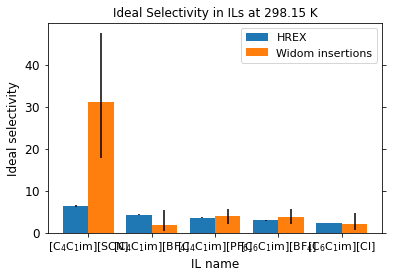

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


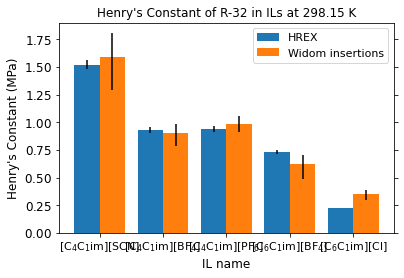

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


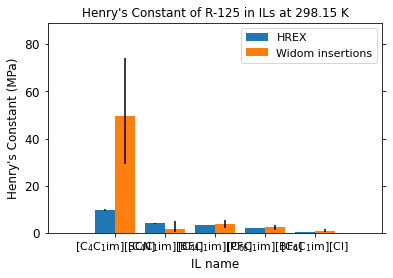

In [45]:
plot_results("Eij_max_estimation_2/vbs_100blocks", "Eij_max_estimation_2", nblocks=100, get_fbs=True, get_corr=True)

In [100]:
dir1list = [
    "cell_list_2",
    "adaptive_rmin_2",
    "adaptive_rmin_1",
    "Eij_max_estimation_1",
    "Eij_max_estimation_2",
]

outdir = Path("vbs")
if not outdir.is_dir():
    os.makedirs(outdir)
dirlist = [Path(x,outdir) for x in dir1list]
thispath = Path(outdir,"theta_orig_3d.npy")
if thispath.is_file():
    theta_orig_3d = np.load(thispath)
else:
    theta_orig_3d = np.stack([np.load(Path(d,"theta_orig_2d.npy")) for d in dirlist],axis=2)
    np.save(thispath, theta_orig_3d)
thispath = Path(outdir,"theta_bs_4d.npy")
if thispath.is_file():
    theta_bs_4d = np.load(thispath)
else:
    theta_bs_4d = np.stack([np.load(Path(d,"theta_bs_3d.npy")) for d in dirlist],axis=3)
    np.save(thispath, theta_bs_4d)
thispath = Path(outdir,"CI_BCa_4d.npy")
if thispath.is_file():
    CI_BCa_4d = np.load(thispath)
else:
    CI_BCa_4d = np.stack([np.load(Path(d,"CI_BCa_3d.npy")) for d in dirlist],axis=3)
    np.save(thispath, CI_BCa_4d)
thispath = Path(outdir,"CI_percentile_4d.npy")
if thispath.is_file():
    CI_percentile_4d = np.load(thispath)
else:
    CI_percentile_4d = np.stack([np.load(Path(d,"CI_percentile_3d.npy")) for d in dirlist],axis=3)
    np.save(thispath, CI_percentile_4d)

In [101]:
ILnames_latex_proper.keys()

dict_keys(['BMIM_SCN', 'BMIM_BF4', 'BMIM_PF6', 'HMIM_BF4', 'HMIM_Cl'])

In [102]:
yerr_BCa_4d = np.abs(CI_BCa_4d - theta_orig_3d)
yerr_percentile_4d = np.abs(CI_percentile_4d - theta_orig_3d)

In [103]:
hrex_2d = np.vstack([hrex_H_r32,hrex_H_r125,hrex_isel])
hrex_uc_2d = np.vstack([hrex_H_r32_uc,hrex_H_r125_uc,hrex_isel_uc])

In [104]:
experimental_values = {
    "BMIM_BF4": (1.54,4.19,0.37),
    "BMIM_PF6": (1.34,4.05,0.33),
    "BMIM_SCN": (3.11,13.32,0.23),
    "HMIM_Cl": (2.0,1.16,1.72),
}
experimental_uc = {
    "BMIM_BF4": (0.06, 0.17, 0.0),
    "BMIM_PF6": (0.01, 0.06, 0.0),
    "BMIM_SCN": (0.37, 2.44, 0.0),
    "HMIM_Cl":  (0.00, 0.03, 0.0),
}
exp_data = {ILnames_latex_proper[il]: t for il, t in experimental_values.items()}
exp_uc = {ILnames_latex_proper[il]: t for il, t in experimental_uc.items()}

In [105]:
solute_list = ["R-32", "R-125"]
mi1 = pd.MultiIndex.from_product([solute_list, ILnames_latex_proper.values()])
colnames = ["Exp.", "HREX","1 \AA\ overlap", r"$U_\mathrm{max}^* =$ 708", r"$U_\mathrm{max}^* =$ 50"]
dfdict = {}
for c in colnames:
    dfdict[c] = {}
df = pd.DataFrame(index=mi1,columns=colnames,dtype=pd.StringDtype())
for isolute, solutename in enumerate(solute_list):
    for i_IL, ILname in enumerate(ILnames_latex_proper.values()):
        if ILname in exp_data:
            dfdict[colnames[0]][(solutename,ILname)] = latex_with_uncertainty(exp_data[ILname][isolute],
                                                                              exp_uc[ILname][isolute],
                                                                             )
        else:
            dfdict[colnames[0]][(solutename,ILname)] = '---'
        dfdict[colnames[1]][(solutename,ILname)] = latex_with_uncertainty(hrex_2d[isolute,i_IL],
                                                                          hrex_uc_2d[isolute,i_IL],
                                                                         )
        for icol, colname in enumerate(colnames[2:]):
            df[colname][solutename][ILname] = latex_with_uncertainty(theta_orig_3d[isolute,i_IL,icol],
                                                                     yerr_BCa_4d[:,isolute,i_IL,icol],
                                                                    )
            dfdict[colname][(solutename,ILname)] = latex_with_uncertainty(theta_orig_3d[isolute,i_IL,icol],
                                                                          yerr_BCa_4d[:,isolute,i_IL,icol],
                                                                         )
df2 = pd.DataFrame(dfdict,dtype=pd.StringDtype())
df2

Exp.  \
R-32  $\mathrm{[C_4C_1im][SCN]}$    $\mathrm{3.1_{4}^{4}}$   
      $\mathrm{[C_4C_1im][BF_4]}$  $\mathrm{1.54_{6}^{6}}$   
      $\mathrm{[C_4C_1im][PF_6]}$  $\mathrm{1.34_{1}^{1}}$   
      $\mathrm{[C_6C_1im][BF_4]}$                      ---   
      $\mathrm{[C_6C_1im][Cl]}$                       2.00   
R-125 $\mathrm{[C_4C_1im][SCN]}$     $\mathrm{13_{2}^{2}}$   
      $\mathrm{[C_4C_1im][BF_4]}$   $\mathrm{4.2_{2}^{2}}$   
      $\mathrm{[C_4C_1im][PF_6]}$  $\mathrm{4.05_{6}^{6}}$   
      $\mathrm{[C_6C_1im][BF_4]}$                      ---   
      $\mathrm{[C_6C_1im][Cl]}$    $\mathrm{1.16_{3}^{3}}$   

                                                      HREX  \
R-32  $\mathrm{[C_4C_1im][SCN]}$   $\mathrm{1.52_{4}^{4}}$   
      $\mathrm{[C_4C_1im][BF_4]}$  $\mathrm{0.93_{3}^{3}}$   
      $\mathrm{[C_4C_1im][PF_6]}$  $\mathrm{0.94_{3}^{3}}$   
      $\mathrm{[C_6C_1im][BF_4]}$  $\mathrm{0.73_{2}^{2}}$   
      $\mathrm{[C_6C_1im][Cl]}$                       0.22   
R-125 $\mathrm{[C_4C_1im][SCN]}$    $\mathrm{9.7_{3}^{3}}$   
      $\mathrm{[C_4C_1im][BF_4]}$   $\mathrm{4.1_{1}^{1}}$   
      $\mathrm{[C_4C_1im][PF_6]}$   $\mathrm{3.4_{1}^{1}}$   
      $\mathrm{[C_6C_1im][BF_4]}$  $\mathrm{2.17_{6}^{6}}$   
      $\mathrm{[C_6C_1im][Cl]}$                       0.52   

                                             1 \AA\ overlap  \
R-32  $\mathrm{[C_4C_1im][SCN]}$     $\mathrm{1.4_{3}^{1}}$   
      $\mathrm{[C_4C_1im][BF_4]}$   $\mathrm{0.91_{4}^{4}}$   
      $\mathrm{[C_4C_1im][PF_6]}$   $\mathrm{0.97_{4}^{3}}$   
      $\mathrm{[C_6C_1im][BF_4]}$   $\mathrm{0.70_{5}^{3}}$   
      $\mathrm{[C_6C_1im][Cl]}$     $\mathrm{0.32_{4}^{2}}$   
R-125 $\mathrm{[C_4C_1im][SCN]}$    $\mathrm{10_{06}^{10}}$   
      $\mathrm{[C_4C_1im][BF_4]}$  $\mathrm{4.6_{11}^{08}}$   
      $\mathrm{[C_4C_1im][PF_6]}$    $\mathrm{4.7_{7}^{7}}$   
      $\mathrm{[C_6C_1im][BF_4]}$    $\mathrm{2.4_{6}^{5}}$   
      $\mathrm{[C_6C_1im][Cl]}$      $\mathrm{1.1_{3}^{3}}$   

                                   $U_\mathrm{max}^* =$ 708  \
R-32  $\mathrm{[C_4C_1im][SCN]}$     $\mathrm{1.5_{2}^{1}}$   
      $\mathrm{[C_4C_1im][BF_4]}$   $\mathrm{0.92_{4}^{4}}$   
      $\mathrm{[C_4C_1im][PF_6]}$   $\mathrm{0.94_{4}^{3}}$   
      $\mathrm{[C_6C_1im][BF_4]}$   $\mathrm{0.73_{3}^{3}}$   
      $\mathrm{[C_6C_1im][Cl]}$     $\mathrm{0.30_{8}^{3}}$   
R-125 $\mathrm{[C_4C_1im][SCN]}$      $\mathrm{13_{5}^{6}}$   
      $\mathrm{[C_4C_1im][BF_4]}$  $\mathrm{5.2_{15}^{10}}$   
      $\mathrm{[C_4C_1im][PF_6]}$    $\mathrm{4.5_{6}^{6}}$   
      $\mathrm{[C_6C_1im][BF_4]}$    $\mathrm{2.7_{6}^{5}}$   
      $\mathrm{[C_6C_1im][Cl]}$      $\mathrm{1.1_{4}^{4}}$   

                                    $U_\mathrm{max}^* =$ 50  
R-32  $\mathrm{[C_4C_1im][SCN]}$     $\mathrm{1.5_{1}^{1}}$  
      $\mathrm{[C_4C_1im][BF_4]}$   $\mathrm{0.92_{4}^{4}}$  
      $\mathrm{[C_4C_1im][PF_6]}$   $\mathrm{0.94_{4}^{3}}$  
      $\mathrm{[C_6C_1im][BF_4]}$   $\mathrm{0.74_{3}^{2}}$  
      $\mathrm{[C_6C_1im][Cl]}$     $\mathrm{0.31_{3}^{2}}$  
R-125 $\mathrm{[C_4C_1im][SCN]}$      $\mathrm{16_{5}^{7}}$  
      $\mathrm{[C_4C_1im][BF_4]}$    $\mathrm{5.4_{8}^{8}}$  
      $\mathrm{[C_4C_1im][PF_6]}$    $\mathrm{3.8_{8}^{7}}$  
      $\mathrm{[C_6C_1im][BF_4]}$  $\mathrm{1.3_{08}^{11}}$  
      $\mathrm{[C_6C_1im][Cl]}$      $\mathrm{1.3_{4}^{4}}$

In [106]:
print(df2.to_latex(escape=False))

\begin{tabular}{lllllll}
\toprule
      &                           &                     Exp. &                     HREX &            1 \AA\ overlap &  $U_\mathrm{max}^* =$ 708 &   $U_\mathrm{max}^* =$ 50 \\
\midrule
R-32 & $\mathrm{[C_4C_1im][SCN]}$ &   $\mathrm{3.1_{4}^{4}}$ &  $\mathrm{1.52_{4}^{4}}$ &    $\mathrm{1.4_{3}^{1}}$ &    $\mathrm{1.5_{2}^{1}}$ &    $\mathrm{1.5_{1}^{1}}$ \\
      & $\mathrm{[C_4C_1im][BF_4]}$ &  $\mathrm{1.54_{6}^{6}}$ &  $\mathrm{0.93_{3}^{3}}$ &   $\mathrm{0.91_{4}^{4}}$ &   $\mathrm{0.92_{4}^{4}}$ &   $\mathrm{0.92_{4}^{4}}$ \\
      & $\mathrm{[C_4C_1im][PF_6]}$ &  $\mathrm{1.34_{1}^{1}}$ &  $\mathrm{0.94_{3}^{3}}$ &   $\mathrm{0.97_{4}^{3}}$ &   $\mathrm{0.94_{4}^{3}}$ &   $\mathrm{0.94_{4}^{3}}$ \\
      & $\mathrm{[C_6C_1im][BF_4]}$ &                      --- &  $\mathrm{0.73_{2}^{2}}$ &   $\mathrm{0.70_{5}^{3}}$ &   $\mathrm{0.73_{3}^{3}}$ &   $\mathrm{0.74_{3}^{2}}$ \\
      & $\mathrm{[C_6C_1im][Cl]}$ &                     2.00 &              

In [107]:
soluteList = ["R-32", "R-125"]
dir1list_abr = [
    "CL_2",
    "AR_2",
    "AR_1",
    "EmE_1",
    "EmE_2",
]
for ILname in ILnames_latex_proper:
    print('\n\n\n\n\n----------')
    print('\n\n')
    print(ILname)
    wprp2_4d_path = Path(ILname,'wprp2_4d.npy')
    if not wprp2_4d_path.is_file():
        np.save(wprp2_4d_path,
            np.stack([np.stack([np.load(Path(ILname,rundir,f"cas_widom.out.spec{ispec}.wprp2.npy")) for ispec in (3,4)],axis=-1) for rundir in dir1list],axis=-1)
        )
    df=pd.DataFrame(
        np.load(wprp2_4d_path).mean(axis=1).reshape(-1,len(dir1list)*len(soluteList)),
        columns=pd.MultiIndex.from_product([soluteList,dir1list_abr], names=['Solute', "Run_id"])
    )
    df_pearson_corr = df.corr('pearson')
    df_spearman_corr = df.corr('spearman')
    df_kendall_corr = df.corr('kendall')
    df_log_pearson_corr = np.log(df).corr('pearson')
    df_log_spearman_corr = np.log(df).corr('spearman')
    df_log_kendall_corr = np.log(df).corr('kendall')
    print("w Pearson correlation")
    display(df_pearson_corr)
    print("w Spearman correlation")
    display(df_spearman_corr)
    print("w Kendall correlation")
    display(df_kendall_corr)
    print("log(w) Pearson correlation")
    display(df_log_pearson_corr)
    print("log(w) Spearman correlation")
    display(df_log_spearman_corr)
    print("log(w) Kendall correlation")
    display(df_log_kendall_corr)






----------



BMIM_SCN
w Pearson correlation


Solute             R-32                                             R-125  \
Run_id             CL_2      AR_2      AR_1     EmE_1     EmE_2      CL_2   
Solute Run_id                                                               
R-32   CL_2    1.000000  0.312543  0.426900  0.867936  0.108622  0.009262   
       AR_2    0.312543  1.000000  0.458615  0.349205  0.172853  0.009896   
       AR_1    0.426900  0.458615  1.000000  0.426525  0.266801  0.013625   
       EmE_1   0.867936  0.349205  0.426525  1.000000  0.097461  0.005956   
       EmE_2   0.108622  0.172853  0.266801  0.097461  1.000000  0.007529   
R-125  CL_2    0.009262  0.009896  0.013625  0.005956  0.007529  1.000000   
       AR_2    0.038411  0.043216  0.054713  0.021047  0.021126  0.267453   
       AR_1    0.033938  0.051593  0.058399  0.025966  0.023393  0.443958   
       EmE_1   0.045571  0.062320  0.082202  0.040098  0.036526  0.261477   
       EmE_2   0.014274  0.016835  0.019408  0.008999  0.015782  0.537846   

Solute                                                 
Run_id             AR_2      AR_1     EmE_1     EmE_2  
Solute Run_id                                          
R-32   CL_2    0.038411  0.033938  0.045571  0.014274  
       AR_2    0.043216  0.051593  0.062320  0.016835  
       AR_1    0.054713  0.058399  0.082202  0.019408  
       EmE_1   0.021047  0.025966  0.040098  0.008999  
       EmE_2   0.021126  0.023393  0.036526  0.015782  
R-125  CL_2    0.267453  0.443958  0.261477  0.537846  
       AR_2    1.000000  0.488335  0.331756  0.287101  
       AR_1    0.488335  1.000000  0.734482  0.439221  
       EmE_1   0.331756  0.734482  1.000000  0.251355  
       EmE_2   0.287101  0.439221  0.251355  1.000000

w Spearman correlation


Solute             R-32                                             R-125  \
Run_id             CL_2      AR_2      AR_1     EmE_1     EmE_2      CL_2   
Solute Run_id                                                               
R-32   CL_2    1.000000  0.827078  0.829288  0.830423  0.712644  0.686868   
       AR_2    0.827078  1.000000  0.828953  0.830248  0.710341  0.687106   
       AR_1    0.829288  0.828953  1.000000  0.831732  0.711597  0.688824   
       EmE_1   0.830423  0.830248  0.831732  1.000000  0.713647  0.690034   
       EmE_2   0.712644  0.710341  0.711597  0.713647  1.000000  0.664324   
R-125  CL_2    0.686868  0.687106  0.688824  0.690034  0.664324  1.000000   
       AR_2    0.688105  0.689112  0.691994  0.691980  0.664578  0.846846   
       AR_1    0.690291  0.688424  0.690759  0.691699  0.665772  0.844017   
       EmE_1   0.687496  0.689089  0.691478  0.692091  0.665102  0.845199   
       EmE_2   0.629825  0.632267  0.632275  0.633168  0.610504  0.764130   

Solute                                                 
Run_id             AR_2      AR_1     EmE_1     EmE_2  
Solute Run_id                                          
R-32   CL_2    0.688105  0.690291  0.687496  0.629825  
       AR_2    0.689112  0.688424  0.689089  0.632267  
       AR_1    0.691994  0.690759  0.691478  0.632275  
       EmE_1   0.691980  0.691699  0.692091  0.633168  
       EmE_2   0.664578  0.665772  0.665102  0.610504  
R-125  CL_2    0.846846  0.844017  0.845199  0.764130  
       AR_2    1.000000  0.848076  0.848002  0.763379  
       AR_1    0.848076  1.000000  0.846110  0.765070  
       EmE_1   0.848002  0.846110  1.000000  0.765439  
       EmE_2   0.763379  0.765070  0.765439  1.000000

w Kendall correlation


Solute             R-32                                             R-125  \
Run_id             CL_2      AR_2      AR_1     EmE_1     EmE_2      CL_2   
Solute Run_id                                                               
R-32   CL_2    1.000000  0.640430  0.642852  0.643826  0.522914  0.497478   
       AR_2    0.640430  1.000000  0.642899  0.643772  0.520877  0.497748   
       AR_1    0.642852  0.642899  1.000000  0.645208  0.522040  0.499336   
       EmE_1   0.643826  0.643772  0.645208  1.000000  0.523915  0.500529   
       EmE_2   0.522914  0.520877  0.522040  0.523915  1.000000  0.478120   
R-125  CL_2    0.497478  0.497748  0.499336  0.500529  0.478120  1.000000   
       AR_2    0.498456  0.499198  0.502126  0.501572  0.478060  0.659042   
       AR_1    0.500253  0.498687  0.501010  0.501460  0.479283  0.656308   
       EmE_1   0.497749  0.499284  0.501416  0.501736  0.478392  0.657152   
       EmE_2   0.448835  0.450307  0.450434  0.451056  0.432851  0.570883   

Solute                                                 
Run_id             AR_2      AR_1     EmE_1     EmE_2  
Solute Run_id                                          
R-32   CL_2    0.498456  0.500253  0.497749  0.448835  
       AR_2    0.499198  0.498687  0.499284  0.450307  
       AR_1    0.502126  0.501010  0.501416  0.450434  
       EmE_1   0.501572  0.501460  0.501736  0.451056  
       EmE_2   0.478060  0.479283  0.478392  0.432851  
R-125  CL_2    0.659042  0.656308  0.657152  0.570883  
       AR_2    1.000000  0.660826  0.660681  0.570133  
       AR_1    0.660826  1.000000  0.658589  0.572004  
       EmE_1   0.660681  0.658589  1.000000  0.572599  
       EmE_2   0.570133  0.572004  0.572599  1.000000

log(w) Pearson correlation


Solute             R-32                                             R-125  \
Run_id             CL_2      AR_2      AR_1     EmE_1     EmE_2      CL_2   
Solute Run_id                                                               
R-32   CL_2    1.000000  0.830695  0.832144  0.833541  0.718950  0.693895   
       AR_2    0.830695  1.000000  0.832772  0.832663  0.717171  0.692971   
       AR_1    0.832144  0.832772  1.000000  0.834486  0.718296  0.694759   
       EmE_1   0.833541  0.832663  0.834486  1.000000  0.720853  0.695261   
       EmE_2   0.718950  0.717171  0.718296  0.720853  1.000000  0.668265   
R-125  CL_2    0.693895  0.692971  0.694759  0.695261  0.668265  1.000000   
       AR_2    0.695771  0.695633  0.698162  0.697292  0.666185  0.834812   
       AR_1    0.697260  0.694783  0.696662  0.696585  0.668205  0.832654   
       EmE_1   0.694025  0.694873  0.696964  0.697123  0.666518  0.833765   
       EmE_2   0.627344  0.629492  0.628982  0.628536  0.605462  0.747767   

Solute                                                 
Run_id             AR_2      AR_1     EmE_1     EmE_2  
Solute Run_id                                          
R-32   CL_2    0.695771  0.697260  0.694025  0.627344  
       AR_2    0.695633  0.694783  0.694873  0.629492  
       AR_1    0.698162  0.696662  0.696964  0.628982  
       EmE_1   0.697292  0.696585  0.697123  0.628536  
       EmE_2   0.666185  0.668205  0.666518  0.605462  
R-125  CL_2    0.834812  0.832654  0.833765  0.747767  
       AR_2    1.000000  0.837655  0.837720  0.747340  
       AR_1    0.837655  1.000000  0.835570  0.748151  
       EmE_1   0.837720  0.835570  1.000000  0.749848  
       EmE_2   0.747340  0.748151  0.749848  1.000000

log(w) Spearman correlation


Solute             R-32                                             R-125  \
Run_id             CL_2      AR_2      AR_1     EmE_1     EmE_2      CL_2   
Solute Run_id                                                               
R-32   CL_2    1.000000  0.827078  0.829288  0.830423  0.712644  0.686868   
       AR_2    0.827078  1.000000  0.828953  0.830248  0.710341  0.687106   
       AR_1    0.829288  0.828953  1.000000  0.831732  0.711597  0.688824   
       EmE_1   0.830423  0.830248  0.831732  1.000000  0.713647  0.690034   
       EmE_2   0.712644  0.710341  0.711597  0.713647  1.000000  0.664324   
R-125  CL_2    0.686868  0.687106  0.688824  0.690034  0.664324  1.000000   
       AR_2    0.688105  0.689112  0.691994  0.691980  0.664578  0.846846   
       AR_1    0.690291  0.688424  0.690759  0.691699  0.665772  0.844017   
       EmE_1   0.687496  0.689089  0.691478  0.692091  0.665102  0.845199   
       EmE_2   0.626560  0.629507  0.629076  0.629762  0.607215  0.762087   

Solute                                                 
Run_id             AR_2      AR_1     EmE_1     EmE_2  
Solute Run_id                                          
R-32   CL_2    0.688105  0.690291  0.687496  0.626560  
       AR_2    0.689112  0.688424  0.689089  0.629507  
       AR_1    0.691994  0.690759  0.691478  0.629076  
       EmE_1   0.691980  0.691699  0.692091  0.629762  
       EmE_2   0.664578  0.665772  0.665102  0.607215  
R-125  CL_2    0.846846  0.844017  0.845199  0.762087  
       AR_2    1.000000  0.848076  0.848002  0.761363  
       AR_1    0.848076  1.000000  0.846110  0.763086  
       EmE_1   0.848002  0.846110  1.000000  0.763425  
       EmE_2   0.761363  0.763086  0.763425  1.000000

log(w) Kendall correlation


Solute             R-32                                             R-125  \
Run_id             CL_2      AR_2      AR_1     EmE_1     EmE_2      CL_2   
Solute Run_id                                                               
R-32   CL_2    1.000000  0.640430  0.642852  0.643826  0.522914  0.497478   
       AR_2    0.640430  1.000000  0.642899  0.643772  0.520877  0.497748   
       AR_1    0.642852  0.642899  1.000000  0.645208  0.522040  0.499336   
       EmE_1   0.643826  0.643772  0.645208  1.000000  0.523915  0.500529   
       EmE_2   0.522914  0.520877  0.522040  0.523915  1.000000  0.478120   
R-125  CL_2    0.497478  0.497748  0.499336  0.500529  0.478120  1.000000   
       AR_2    0.498456  0.499198  0.502126  0.501572  0.478060  0.659042   
       AR_1    0.500253  0.498687  0.501010  0.501460  0.479283  0.656308   
       EmE_1   0.497749  0.499284  0.501416  0.501736  0.478392  0.657152   
       EmE_2   0.445926  0.447758  0.447574  0.448000  0.430027  0.568720   

Solute                                                 
Run_id             AR_2      AR_1     EmE_1     EmE_2  
Solute Run_id                                          
R-32   CL_2    0.498456  0.500253  0.497749  0.445926  
       AR_2    0.499198  0.498687  0.499284  0.447758  
       AR_1    0.502126  0.501010  0.501416  0.447574  
       EmE_1   0.501572  0.501460  0.501736  0.448000  
       EmE_2   0.478060  0.479283  0.478392  0.430027  
R-125  CL_2    0.659042  0.656308  0.657152  0.568720  
       AR_2    1.000000  0.660826  0.660681  0.567923  
       AR_1    0.660826  1.000000  0.658589  0.569821  
       EmE_1   0.660681  0.658589  1.000000  0.570407  
       EmE_2   0.567923  0.569821  0.570407  1.000000






----------



BMIM_BF4
w Pearson correlation


Solute             R-32                                             R-125  \
Run_id             CL_2      AR_2      AR_1     EmE_1     EmE_2      CL_2   
Solute Run_id                                                               
R-32   CL_2    1.000000  0.408287  0.410996  0.383441  0.121416  0.039361   
       AR_2    0.408287  1.000000  0.416596  0.344185  0.171391  0.043255   
       AR_1    0.410996  0.416596  1.000000  0.359105  0.137282  0.043806   
       EmE_1   0.383441  0.344185  0.359105  1.000000  0.169674  0.033862   
       EmE_2   0.121416  0.171391  0.137282  0.169674  1.000000  0.014290   
R-125  CL_2    0.039361  0.043255  0.043806  0.033862  0.014290  1.000000   
       AR_2    0.056564  0.082297  0.058490  0.062851  0.037780  0.189762   
       AR_1    0.055478  0.063147  0.056119  0.051544  0.015185  0.256708   
       EmE_1   0.040252  0.041530  0.041808  0.037779  0.020678  0.223954   
       EmE_2   0.027368  0.030823  0.031040  0.022415  0.007239  0.123044   

Solute                                                 
Run_id             AR_2      AR_1     EmE_1     EmE_2  
Solute Run_id                                          
R-32   CL_2    0.056564  0.055478  0.040252  0.027368  
       AR_2    0.082297  0.063147  0.041530  0.030823  
       AR_1    0.058490  0.056119  0.041808  0.031040  
       EmE_1   0.062851  0.051544  0.037779  0.022415  
       EmE_2   0.037780  0.015185  0.020678  0.007239  
R-125  CL_2    0.189762  0.256708  0.223954  0.123044  
       AR_2    1.000000  0.213326  0.192742  0.108712  
       AR_1    0.213326  1.000000  0.223374  0.050782  
       EmE_1   0.192742  0.223374  1.000000  0.333893  
       EmE_2   0.108712  0.050782  0.333893  1.000000

w Spearman correlation


Solute             R-32                                             R-125  \
Run_id             CL_2      AR_2      AR_1     EmE_1     EmE_2      CL_2   
Solute Run_id                                                               
R-32   CL_2    1.000000  0.804638  0.809379  0.806741  0.648064  0.581915   
       AR_2    0.804638  1.000000  0.806939  0.806203  0.649590  0.579954   
       AR_1    0.809379  0.806939  1.000000  0.807647  0.654058  0.586508   
       EmE_1   0.806741  0.806203  0.807647  1.000000  0.649982  0.582123   
       EmE_2   0.648064  0.649590  0.654058  0.649982  1.000000  0.580406   
R-125  CL_2    0.581915  0.579954  0.586508  0.582123  0.580406  1.000000   
       AR_2    0.582355  0.579758  0.587965  0.580514  0.577411  0.860211   
       AR_1    0.580534  0.577230  0.583270  0.578326  0.575028  0.856908   
       EmE_1   0.581951  0.578065  0.586468  0.578394  0.577457  0.857323   
       EmE_2   0.532158  0.529605  0.535968  0.532228  0.533132  0.785062   

Solute                                                 
Run_id             AR_2      AR_1     EmE_1     EmE_2  
Solute Run_id                                          
R-32   CL_2    0.582355  0.580534  0.581951  0.532158  
       AR_2    0.579758  0.577230  0.578065  0.529605  
       AR_1    0.587965  0.583270  0.586468  0.535968  
       EmE_1   0.580514  0.578326  0.578394  0.532228  
       EmE_2   0.577411  0.575028  0.577457  0.533132  
R-125  CL_2    0.860211  0.856908  0.857323  0.785062  
       AR_2    1.000000  0.858712  0.857948  0.785369  
       AR_1    0.858712  1.000000  0.856475  0.784512  
       EmE_1   0.857948  0.856475  1.000000  0.784514  
       EmE_2   0.785369  0.784512  0.784514  1.000000

w Kendall correlation


Solute             R-32                                             R-125  \
Run_id             CL_2      AR_2      AR_1     EmE_1     EmE_2      CL_2   
Solute Run_id                                                               
R-32   CL_2    1.000000  0.620396  0.624339  0.622510  0.469484  0.410704   
       AR_2    0.620396  1.000000  0.622619  0.621823  0.470259  0.408987   
       AR_1    0.624339  0.622619  1.000000  0.623008  0.473877  0.413920   
       EmE_1   0.622510  0.621823  0.623008  1.000000  0.470938  0.410676   
       EmE_2   0.469484  0.470259  0.473877  0.470938  1.000000  0.408889   
R-125  CL_2    0.410704  0.408987  0.413920  0.410676  0.408889  1.000000   
       AR_2    0.411452  0.408998  0.415313  0.409775  0.407012  0.674692   
       AR_1    0.409798  0.406620  0.411430  0.407858  0.405068  0.670834   
       EmE_1   0.410907  0.407570  0.414177  0.408227  0.406755  0.671025   
       EmE_2   0.371011  0.368896  0.373492  0.371129  0.371299  0.590813   

Solute                                                 
Run_id             AR_2      AR_1     EmE_1     EmE_2  
Solute Run_id                                          
R-32   CL_2    0.411452  0.409798  0.410907  0.371011  
       AR_2    0.408998  0.406620  0.407570  0.368896  
       AR_1    0.415313  0.411430  0.414177  0.373492  
       EmE_1   0.409775  0.407858  0.408227  0.371129  
       EmE_2   0.407012  0.405068  0.406755  0.371299  
R-125  CL_2    0.674692  0.670834  0.671025  0.590813  
       AR_2    1.000000  0.672973  0.672094  0.590971  
       AR_1    0.672973  1.000000  0.670525  0.590611  
       EmE_1   0.672094  0.670525  1.000000  0.590633  
       EmE_2   0.590971  0.590611  0.590633  1.000000

log(w) Pearson correlation


Solute             R-32                                             R-125  \
Run_id             CL_2      AR_2      AR_1     EmE_1     EmE_2      CL_2   
Solute Run_id                                                               
R-32   CL_2    1.000000  0.813356  0.816093  0.816265  0.657603  0.598520   
       AR_2    0.813356  1.000000  0.814511  0.813301  0.660405  0.598249   
       AR_1    0.816093  0.814511  1.000000  0.814550  0.664160  0.602158   
       EmE_1   0.816265  0.813301  0.814550  1.000000  0.660086  0.598602   
       EmE_2   0.657603  0.660405  0.664160  0.660086  1.000000  0.591195   
R-125  CL_2    0.598520  0.598249  0.602158  0.598602  0.591195  1.000000   
       AR_2    0.597575  0.596352  0.602902  0.596208  0.587530  0.848067   
       AR_1    0.595299  0.592045  0.598475  0.594380  0.587502  0.845499   
       EmE_1   0.598879  0.595174  0.601458  0.594959  0.588277  0.846884   
       EmE_2   0.545738  0.544259  0.549909  0.545525  0.543309  0.768342   

Solute                                                 
Run_id             AR_2      AR_1     EmE_1     EmE_2  
Solute Run_id                                          
R-32   CL_2    0.597575  0.595299  0.598879  0.545738  
       AR_2    0.596352  0.592045  0.595174  0.544259  
       AR_1    0.602902  0.598475  0.601458  0.549909  
       EmE_1   0.596208  0.594380  0.594959  0.545525  
       EmE_2   0.587530  0.587502  0.588277  0.543309  
R-125  CL_2    0.848067  0.845499  0.846884  0.768342  
       AR_2    1.000000  0.845659  0.845546  0.768114  
       AR_1    0.845659  1.000000  0.843387  0.767345  
       EmE_1   0.845546  0.843387  1.000000  0.766673  
       EmE_2   0.768114  0.767345  0.766673  1.000000

log(w) Spearman correlation


Solute             R-32                                             R-125  \
Run_id             CL_2      AR_2      AR_1     EmE_1     EmE_2      CL_2   
Solute Run_id                                                               
R-32   CL_2    1.000000  0.804638  0.809379  0.806741  0.648064  0.581915   
       AR_2    0.804638  1.000000  0.806939  0.806203  0.649590  0.579954   
       AR_1    0.809379  0.806939  1.000000  0.807647  0.654058  0.586508   
       EmE_1   0.806741  0.806203  0.807647  1.000000  0.649982  0.582123   
       EmE_2   0.648064  0.649590  0.654058  0.649982  1.000000  0.580406   
R-125  CL_2    0.581915  0.579954  0.586508  0.582123  0.580406  1.000000   
       AR_2    0.582355  0.579758  0.587965  0.580514  0.577411  0.860211   
       AR_1    0.580534  0.577230  0.583270  0.578326  0.575028  0.856908   
       EmE_1   0.581951  0.578065  0.586468  0.578394  0.577457  0.857323   
       EmE_2   0.532158  0.529605  0.535968  0.532228  0.533132  0.785062   

Solute                                                 
Run_id             AR_2      AR_1     EmE_1     EmE_2  
Solute Run_id                                          
R-32   CL_2    0.582355  0.580534  0.581951  0.532158  
       AR_2    0.579758  0.577230  0.578065  0.529605  
       AR_1    0.587965  0.583270  0.586468  0.535968  
       EmE_1   0.580514  0.578326  0.578394  0.532228  
       EmE_2   0.577411  0.575028  0.577457  0.533132  
R-125  CL_2    0.860211  0.856908  0.857323  0.785062  
       AR_2    1.000000  0.858712  0.857948  0.785369  
       AR_1    0.858712  1.000000  0.856475  0.784512  
       EmE_1   0.857948  0.856475  1.000000  0.784514  
       EmE_2   0.785369  0.784512  0.784514  1.000000

log(w) Kendall correlation


Solute             R-32                                             R-125  \
Run_id             CL_2      AR_2      AR_1     EmE_1     EmE_2      CL_2   
Solute Run_id                                                               
R-32   CL_2    1.000000  0.620396  0.624339  0.622510  0.469484  0.410704   
       AR_2    0.620396  1.000000  0.622619  0.621823  0.470259  0.408987   
       AR_1    0.624339  0.622619  1.000000  0.623008  0.473877  0.413920   
       EmE_1   0.622510  0.621823  0.623008  1.000000  0.470938  0.410676   
       EmE_2   0.469484  0.470259  0.473877  0.470938  1.000000  0.408889   
R-125  CL_2    0.410704  0.408987  0.413920  0.410676  0.408889  1.000000   
       AR_2    0.411452  0.408998  0.415313  0.409775  0.407012  0.674692   
       AR_1    0.409798  0.406620  0.411430  0.407858  0.405068  0.670834   
       EmE_1   0.410907  0.407570  0.414177  0.408227  0.406755  0.671025   
       EmE_2   0.371011  0.368896  0.373492  0.371129  0.371299  0.590813   

Solute                                                 
Run_id             AR_2      AR_1     EmE_1     EmE_2  
Solute Run_id                                          
R-32   CL_2    0.411452  0.409798  0.410907  0.371011  
       AR_2    0.408998  0.406620  0.407570  0.368896  
       AR_1    0.415313  0.411430  0.414177  0.373492  
       EmE_1   0.409775  0.407858  0.408227  0.371129  
       EmE_2   0.407012  0.405068  0.406755  0.371299  
R-125  CL_2    0.674692  0.670834  0.671025  0.590813  
       AR_2    1.000000  0.672973  0.672094  0.590971  
       AR_1    0.672973  1.000000  0.670525  0.590611  
       EmE_1   0.672094  0.670525  1.000000  0.590633  
       EmE_2   0.590971  0.590611  0.590633  1.000000






----------



BMIM_PF6
w Pearson correlation


Solute             R-32                                             R-125  \
Run_id             CL_2      AR_2      AR_1     EmE_1     EmE_2      CL_2   
Solute Run_id                                                               
R-32   CL_2    1.000000  0.579130  0.573897  0.550159  0.196545  0.074129   
       AR_2    0.579130  1.000000  0.550235  0.554662  0.191435  0.068904   
       AR_1    0.573897  0.550235  1.000000  0.536667  0.278954  0.060934   
       EmE_1   0.550159  0.554662  0.536667  1.000000  0.195750  0.077939   
       EmE_2   0.196545  0.191435  0.278954  0.195750  1.000000  0.036900   
R-125  CL_2    0.074129  0.068904  0.060934  0.077939  0.036900  1.000000   
       AR_2    0.075332  0.064605  0.070676  0.092931  0.032786  0.421329   
       AR_1    0.092990  0.098324  0.109858  0.141630  0.044583  0.357841   
       EmE_1   0.082703  0.059302  0.053707  0.070819  0.032525  0.388869   
       EmE_2   0.020795  0.020459  0.011846  0.014810  0.008319  0.105296   

Solute                                                 
Run_id             AR_2      AR_1     EmE_1     EmE_2  
Solute Run_id                                          
R-32   CL_2    0.075332  0.092990  0.082703  0.020795  
       AR_2    0.064605  0.098324  0.059302  0.020459  
       AR_1    0.070676  0.109858  0.053707  0.011846  
       EmE_1   0.092931  0.141630  0.070819  0.014810  
       EmE_2   0.032786  0.044583  0.032525  0.008319  
R-125  CL_2    0.421329  0.357841  0.388869  0.105296  
       AR_2    1.000000  0.327334  0.362924  0.067400  
       AR_1    0.327334  1.000000  0.308900  0.077624  
       EmE_1   0.362924  0.308900  1.000000  0.064347  
       EmE_2   0.067400  0.077624  0.064347  1.000000

w Spearman correlation


Solute             R-32                                             R-125  \
Run_id             CL_2      AR_2      AR_1     EmE_1     EmE_2      CL_2   
Solute Run_id                                                               
R-32   CL_2    1.000000  0.797250  0.795969  0.796604  0.631614  0.562134   
       AR_2    0.797250  1.000000  0.797399  0.798292  0.628604  0.561674   
       AR_1    0.795969  0.797399  1.000000  0.795099  0.630525  0.561417   
       EmE_1   0.796604  0.798292  0.795099  1.000000  0.628688  0.562852   
       EmE_2   0.631614  0.628604  0.630525  0.628688  1.000000  0.554470   
R-125  CL_2    0.562134  0.561674  0.561417  0.562852  0.554470  1.000000   
       AR_2    0.562375  0.562897  0.560312  0.565783  0.555867  0.851034   
       AR_1    0.562325  0.561167  0.560659  0.564102  0.553998  0.850949   
       EmE_1   0.561941  0.561250  0.560736  0.563889  0.553427  0.851185   
       EmE_2   0.513559  0.514508  0.509531  0.515898  0.508467  0.775206   

Solute                                                 
Run_id             AR_2      AR_1     EmE_1     EmE_2  
Solute Run_id                                          
R-32   CL_2    0.562375  0.562325  0.561941  0.513559  
       AR_2    0.562897  0.561167  0.561250  0.514508  
       AR_1    0.560312  0.560659  0.560736  0.509531  
       EmE_1   0.565783  0.564102  0.563889  0.515898  
       EmE_2   0.555867  0.553998  0.553427  0.508467  
R-125  CL_2    0.851034  0.850949  0.851185  0.775206  
       AR_2    1.000000  0.850941  0.850968  0.775143  
       AR_1    0.850941  1.000000  0.851758  0.774600  
       EmE_1   0.850968  0.851758  1.000000  0.774743  
       EmE_2   0.775143  0.774600  0.774743  1.000000

w Kendall correlation


Solute             R-32                                             R-125  \
Run_id             CL_2      AR_2      AR_1     EmE_1     EmE_2      CL_2   
Solute Run_id                                                               
R-32   CL_2    1.000000  0.612816  0.611327  0.611858  0.455882  0.395376   
       AR_2    0.612816  1.000000  0.613203  0.613113  0.453463  0.394699   
       AR_1    0.611327  0.613203  1.000000  0.610735  0.454748  0.394796   
       EmE_1   0.611858  0.613113  0.610735  1.000000  0.453567  0.395746   
       EmE_2   0.455882  0.453463  0.454748  0.453567  1.000000  0.388846   
R-125  CL_2    0.395376  0.394699  0.394796  0.395746  0.388846  1.000000   
       AR_2    0.395395  0.396038  0.393541  0.397819  0.390344  0.663894   
       AR_1    0.395423  0.394717  0.393728  0.396551  0.388596  0.663735   
       EmE_1   0.395058  0.394637  0.394223  0.396378  0.388577  0.663784   
       EmE_2   0.356998  0.357514  0.354034  0.358307  0.353239  0.581214   

Solute                                                 
Run_id             AR_2      AR_1     EmE_1     EmE_2  
Solute Run_id                                          
R-32   CL_2    0.395395  0.395423  0.395058  0.356998  
       AR_2    0.396038  0.394717  0.394637  0.357514  
       AR_1    0.393541  0.393728  0.394223  0.354034  
       EmE_1   0.397819  0.396551  0.396378  0.358307  
       EmE_2   0.390344  0.388596  0.388577  0.353239  
R-125  CL_2    0.663894  0.663735  0.663784  0.581214  
       AR_2    1.000000  0.663769  0.663753  0.581157  
       AR_1    0.663769  1.000000  0.664751  0.580639  
       EmE_1   0.663753  0.664751  1.000000  0.580803  
       EmE_2   0.581157  0.580639  0.580803  1.000000

log(w) Pearson correlation


Solute             R-32                                             R-125  \
Run_id             CL_2      AR_2      AR_1     EmE_1     EmE_2      CL_2   
Solute Run_id                                                               
R-32   CL_2    1.000000  0.806751  0.805618  0.807510  0.646514  0.579500   
       AR_2    0.806751  1.000000  0.806801  0.806481  0.644068  0.578214   
       AR_1    0.805618  0.806801  1.000000  0.804711  0.644767  0.578598   
       EmE_1   0.807510  0.806481  0.804711  1.000000  0.643928  0.581952   
       EmE_2   0.646514  0.644068  0.644767  0.643928  1.000000  0.567848   
R-125  CL_2    0.579500  0.578214  0.578598  0.581952  0.567848  1.000000   
       AR_2    0.580756  0.580046  0.576810  0.584566  0.572405  0.839445   
       AR_1    0.581195  0.579120  0.578651  0.583726  0.569218  0.838296   
       EmE_1   0.580804  0.578608  0.577850  0.581106  0.566676  0.838688   
       EmE_2   0.529600  0.527561  0.525367  0.531275  0.521008  0.756773   

Solute                                                 
Run_id             AR_2      AR_1     EmE_1     EmE_2  
Solute Run_id                                          
R-32   CL_2    0.580756  0.581195  0.580804  0.529600  
       AR_2    0.580046  0.579120  0.578608  0.527561  
       AR_1    0.576810  0.578651  0.577850  0.525367  
       EmE_1   0.584566  0.583726  0.581106  0.531275  
       EmE_2   0.572405  0.569218  0.566676  0.521008  
R-125  CL_2    0.839445  0.838296  0.838688  0.756773  
       AR_2    1.000000  0.839320  0.840329  0.759668  
       AR_1    0.839320  1.000000  0.841057  0.756836  
       EmE_1   0.840329  0.841057  1.000000  0.758069  
       EmE_2   0.759668  0.756836  0.758069  1.000000

log(w) Spearman correlation


Solute             R-32                                             R-125  \
Run_id             CL_2      AR_2      AR_1     EmE_1     EmE_2      CL_2   
Solute Run_id                                                               
R-32   CL_2    1.000000  0.797250  0.795969  0.796604  0.631614  0.562134   
       AR_2    0.797250  1.000000  0.797399  0.798292  0.628604  0.561674   
       AR_1    0.795969  0.797399  1.000000  0.795099  0.630525  0.561417   
       EmE_1   0.796604  0.798292  0.795099  1.000000  0.628688  0.562852   
       EmE_2   0.631614  0.628604  0.630525  0.628688  1.000000  0.554470   
R-125  CL_2    0.562134  0.561674  0.561417  0.562852  0.554470  1.000000   
       AR_2    0.562375  0.562897  0.560312  0.565783  0.555867  0.851034   
       AR_1    0.562325  0.561167  0.560659  0.564102  0.553998  0.850949   
       EmE_1   0.561941  0.561250  0.560736  0.563889  0.553427  0.851185   
       EmE_2   0.513559  0.514508  0.509531  0.515898  0.508467  0.775206   

Solute                                                 
Run_id             AR_2      AR_1     EmE_1     EmE_2  
Solute Run_id                                          
R-32   CL_2    0.562375  0.562325  0.561941  0.513559  
       AR_2    0.562897  0.561167  0.561250  0.514508  
       AR_1    0.560312  0.560659  0.560736  0.509531  
       EmE_1   0.565783  0.564102  0.563889  0.515898  
       EmE_2   0.555867  0.553998  0.553427  0.508467  
R-125  CL_2    0.851034  0.850949  0.851185  0.775206  
       AR_2    1.000000  0.850941  0.850968  0.775143  
       AR_1    0.850941  1.000000  0.851758  0.774600  
       EmE_1   0.850968  0.851758  1.000000  0.774743  
       EmE_2   0.775143  0.774600  0.774743  1.000000

log(w) Kendall correlation


Solute             R-32                                             R-125  \
Run_id             CL_2      AR_2      AR_1     EmE_1     EmE_2      CL_2   
Solute Run_id                                                               
R-32   CL_2    1.000000  0.612816  0.611327  0.611858  0.455882  0.395376   
       AR_2    0.612816  1.000000  0.613203  0.613113  0.453463  0.394699   
       AR_1    0.611327  0.613203  1.000000  0.610735  0.454748  0.394796   
       EmE_1   0.611858  0.613113  0.610735  1.000000  0.453567  0.395746   
       EmE_2   0.455882  0.453463  0.454748  0.453567  1.000000  0.388846   
R-125  CL_2    0.395376  0.394699  0.394796  0.395746  0.388846  1.000000   
       AR_2    0.395395  0.396038  0.393541  0.397819  0.390344  0.663894   
       AR_1    0.395423  0.394717  0.393728  0.396551  0.388596  0.663735   
       EmE_1   0.395058  0.394637  0.394223  0.396378  0.388577  0.663784   
       EmE_2   0.356998  0.357514  0.354034  0.358307  0.353239  0.581214   

Solute                                                 
Run_id             AR_2      AR_1     EmE_1     EmE_2  
Solute Run_id                                          
R-32   CL_2    0.395395  0.395423  0.395058  0.356998  
       AR_2    0.396038  0.394717  0.394637  0.357514  
       AR_1    0.393541  0.393728  0.394223  0.354034  
       EmE_1   0.397819  0.396551  0.396378  0.358307  
       EmE_2   0.390344  0.388596  0.388577  0.353239  
R-125  CL_2    0.663894  0.663735  0.663784  0.581214  
       AR_2    1.000000  0.663769  0.663753  0.581157  
       AR_1    0.663769  1.000000  0.664751  0.580639  
       EmE_1   0.663753  0.664751  1.000000  0.580803  
       EmE_2   0.581157  0.580639  0.580803  1.000000






----------



HMIM_BF4
w Pearson correlation


Solute             R-32                                             R-125  \
Run_id             CL_2      AR_2      AR_1     EmE_1     EmE_2      CL_2   
Solute Run_id                                                               
R-32   CL_2    1.000000  0.556835  0.430518  0.356952  0.616872  0.036257   
       AR_2    0.556835  1.000000  0.466550  0.370455  0.384482  0.049321   
       AR_1    0.430518  0.466550  1.000000  0.532685  0.184368  0.053716   
       EmE_1   0.356952  0.370455  0.532685  1.000000  0.107347  0.052529   
       EmE_2   0.616872  0.384482  0.184368  0.107347  1.000000  0.007573   
R-125  CL_2    0.036257  0.049321  0.053716  0.052529  0.007573  1.000000   
       AR_2    0.037114  0.054322  0.054479  0.048017  0.010702  0.201929   
       AR_1    0.034091  0.094180  0.069259  0.090250  0.016901  0.060670   
       EmE_1   0.050297  0.103569  0.114734  0.123648  0.023065  0.222437   
       EmE_2   0.012400  0.016089  0.018706  0.013004  0.001622  0.072582   

Solute                                                 
Run_id             AR_2      AR_1     EmE_1     EmE_2  
Solute Run_id                                          
R-32   CL_2    0.037114  0.034091  0.050297  0.012400  
       AR_2    0.054322  0.094180  0.103569  0.016089  
       AR_1    0.054479  0.069259  0.114734  0.018706  
       EmE_1   0.048017  0.090250  0.123648  0.013004  
       EmE_2   0.010702  0.016901  0.023065  0.001622  
R-125  CL_2    0.201929  0.060670  0.222437  0.072582  
       AR_2    1.000000  0.048777  0.270897  0.065435  
       AR_1    0.048777  1.000000  0.274900  0.007485  
       EmE_1   0.270897  0.274900  1.000000  0.101924  
       EmE_2   0.065435  0.007485  0.101924  1.000000

w Spearman correlation


Solute             R-32                                             R-125  \
Run_id             CL_2      AR_2      AR_1     EmE_1     EmE_2      CL_2   
Solute Run_id                                                               
R-32   CL_2    1.000000  0.786976  0.787190  0.785663  0.613059  0.528402   
       AR_2    0.786976  1.000000  0.781654  0.782172  0.609747  0.527982   
       AR_1    0.787190  0.781654  1.000000  0.784645  0.614723  0.527691   
       EmE_1   0.785663  0.782172  0.784645  1.000000  0.613999  0.526403   
       EmE_2   0.613059  0.609747  0.614723  0.613999  1.000000  0.524170   
R-125  CL_2    0.528402  0.527982  0.527691  0.526403  0.524170  1.000000   
       AR_2    0.524928  0.526876  0.525399  0.525223  0.523098  0.848317   
       AR_1    0.524348  0.525455  0.525531  0.525614  0.521671  0.845532   
       EmE_1   0.526542  0.527511  0.527183  0.526807  0.523198  0.847231   
       EmE_2   0.473727  0.476003  0.475856  0.476487  0.477241  0.775588   

Solute                                                 
Run_id             AR_2      AR_1     EmE_1     EmE_2  
Solute Run_id                                          
R-32   CL_2    0.524928  0.524348  0.526542  0.473727  
       AR_2    0.526876  0.525455  0.527511  0.476003  
       AR_1    0.525399  0.525531  0.527183  0.475856  
       EmE_1   0.525223  0.525614  0.526807  0.476487  
       EmE_2   0.523098  0.521671  0.523198  0.477241  
R-125  CL_2    0.848317  0.845532  0.847231  0.775588  
       AR_2    1.000000  0.848183  0.849146  0.775397  
       AR_1    0.848183  1.000000  0.846819  0.776622  
       EmE_1   0.849146  0.846819  1.000000  0.775992  
       EmE_2   0.775397  0.776622  0.775992  1.000000

w Kendall correlation


Solute             R-32                                             R-125  \
Run_id             CL_2      AR_2      AR_1     EmE_1     EmE_2      CL_2   
Solute Run_id                                                               
R-32   CL_2    1.000000  0.602091  0.601812  0.601116  0.440524  0.369468   
       AR_2    0.602091  1.000000  0.597205  0.597825  0.438002  0.369005   
       AR_1    0.601812  0.597205  1.000000  0.599749  0.441628  0.368691   
       EmE_1   0.601116  0.597825  0.599749  1.000000  0.441327  0.367553   
       EmE_2   0.440524  0.438002  0.441628  0.441327  1.000000  0.365933   
R-125  CL_2    0.369468  0.369005  0.368691  0.367553  0.365933  1.000000   
       AR_2    0.367076  0.368205  0.366787  0.366703  0.365282  0.660799   
       AR_1    0.366498  0.367441  0.367366  0.367053  0.364517  0.658119   
       EmE_1   0.367930  0.368717  0.368156  0.367989  0.365306  0.659599   
       EmE_2   0.328092  0.329583  0.328828  0.329560  0.330169  0.581635   

Solute                                                 
Run_id             AR_2      AR_1     EmE_1     EmE_2  
Solute Run_id                                          
R-32   CL_2    0.367076  0.366498  0.367930  0.328092  
       AR_2    0.368205  0.367441  0.368717  0.329583  
       AR_1    0.366787  0.367366  0.368156  0.328828  
       EmE_1   0.366703  0.367053  0.367989  0.329560  
       EmE_2   0.365282  0.364517  0.365306  0.330169  
R-125  CL_2    0.660799  0.658119  0.659599  0.581635  
       AR_2    1.000000  0.660575  0.661784  0.580881  
       AR_1    0.660575  1.000000  0.659070  0.582255  
       EmE_1   0.661784  0.659070  1.000000  0.581198  
       EmE_2   0.580881  0.582255  0.581198  1.000000

log(w) Pearson correlation


Solute             R-32                                             R-125  \
Run_id             CL_2      AR_2      AR_1     EmE_1     EmE_2      CL_2   
Solute Run_id                                                               
R-32   CL_2    1.000000  0.796264  0.794871  0.794151  0.628545  0.548505   
       AR_2    0.796264  1.000000  0.792860  0.792011  0.627702  0.549352   
       AR_1    0.794871  0.792860  1.000000  0.796198  0.630628  0.549653   
       EmE_1   0.794151  0.792011  0.796198  1.000000  0.630268  0.546597   
       EmE_2   0.628545  0.627702  0.630628  0.630268  1.000000  0.542047   
R-125  CL_2    0.548505  0.549352  0.549653  0.546597  0.542047  1.000000   
       AR_2    0.545647  0.548517  0.548244  0.545404  0.543933  0.836640   
       AR_1    0.544416  0.546265  0.546709  0.543831  0.539288  0.835556   
       EmE_1   0.545064  0.549130  0.548232  0.545501  0.540606  0.835118   
       EmE_2   0.492779  0.495766  0.496185  0.494162  0.491127  0.758781   

Solute                                                 
Run_id             AR_2      AR_1     EmE_1     EmE_2  
Solute Run_id                                          
R-32   CL_2    0.545647  0.544416  0.545064  0.492779  
       AR_2    0.548517  0.546265  0.549130  0.495766  
       AR_1    0.548244  0.546709  0.548232  0.496185  
       EmE_1   0.545404  0.543831  0.545501  0.494162  
       EmE_2   0.543933  0.539288  0.540606  0.491127  
R-125  CL_2    0.836640  0.835556  0.835118  0.758781  
       AR_2    1.000000  0.837242  0.837328  0.759101  
       AR_1    0.837242  1.000000  0.834370  0.758732  
       EmE_1   0.837328  0.834370  1.000000  0.757295  
       EmE_2   0.759101  0.758732  0.757295  1.000000

log(w) Spearman correlation


Solute             R-32                                             R-125  \
Run_id             CL_2      AR_2      AR_1     EmE_1     EmE_2      CL_2   
Solute Run_id                                                               
R-32   CL_2    1.000000  0.786976  0.787190  0.785663  0.613059  0.528402   
       AR_2    0.786976  1.000000  0.781654  0.782172  0.609747  0.527982   
       AR_1    0.787190  0.781654  1.000000  0.784645  0.614723  0.527691   
       EmE_1   0.785663  0.782172  0.784645  1.000000  0.613999  0.526403   
       EmE_2   0.613059  0.609747  0.614723  0.613999  1.000000  0.524170   
R-125  CL_2    0.528402  0.527982  0.527691  0.526403  0.524170  1.000000   
       AR_2    0.524928  0.526876  0.525399  0.525223  0.523098  0.848317   
       AR_1    0.524348  0.525455  0.525531  0.525614  0.521671  0.845532   
       EmE_1   0.526542  0.527511  0.527183  0.526807  0.523198  0.847231   
       EmE_2   0.473727  0.476003  0.475856  0.476487  0.477241  0.775588   

Solute                                                 
Run_id             AR_2      AR_1     EmE_1     EmE_2  
Solute Run_id                                          
R-32   CL_2    0.524928  0.524348  0.526542  0.473727  
       AR_2    0.526876  0.525455  0.527511  0.476003  
       AR_1    0.525399  0.525531  0.527183  0.475856  
       EmE_1   0.525223  0.525614  0.526807  0.476487  
       EmE_2   0.523098  0.521671  0.523198  0.477241  
R-125  CL_2    0.848317  0.845532  0.847231  0.775588  
       AR_2    1.000000  0.848183  0.849146  0.775397  
       AR_1    0.848183  1.000000  0.846819  0.776622  
       EmE_1   0.849146  0.846819  1.000000  0.775992  
       EmE_2   0.775397  0.776622  0.775992  1.000000

log(w) Kendall correlation


Solute             R-32                                             R-125  \
Run_id             CL_2      AR_2      AR_1     EmE_1     EmE_2      CL_2   
Solute Run_id                                                               
R-32   CL_2    1.000000  0.602091  0.601812  0.601116  0.440524  0.369468   
       AR_2    0.602091  1.000000  0.597205  0.597825  0.438002  0.369005   
       AR_1    0.601812  0.597205  1.000000  0.599749  0.441628  0.368691   
       EmE_1   0.601116  0.597825  0.599749  1.000000  0.441327  0.367553   
       EmE_2   0.440524  0.438002  0.441628  0.441327  1.000000  0.365933   
R-125  CL_2    0.369468  0.369005  0.368691  0.367553  0.365933  1.000000   
       AR_2    0.367076  0.368205  0.366787  0.366703  0.365282  0.660799   
       AR_1    0.366498  0.367441  0.367366  0.367053  0.364517  0.658119   
       EmE_1   0.367930  0.368717  0.368156  0.367989  0.365306  0.659599   
       EmE_2   0.328092  0.329583  0.328828  0.329560  0.330169  0.581635   

Solute                                                 
Run_id             AR_2      AR_1     EmE_1     EmE_2  
Solute Run_id                                          
R-32   CL_2    0.367076  0.366498  0.367930  0.328092  
       AR_2    0.368205  0.367441  0.368717  0.329583  
       AR_1    0.366787  0.367366  0.368156  0.328828  
       EmE_1   0.366703  0.367053  0.367989  0.329560  
       EmE_2   0.365282  0.364517  0.365306  0.330169  
R-125  CL_2    0.660799  0.658119  0.659599  0.581635  
       AR_2    1.000000  0.660575  0.661784  0.580881  
       AR_1    0.660575  1.000000  0.659070  0.582255  
       EmE_1   0.661784  0.659070  1.000000  0.581198  
       EmE_2   0.580881  0.582255  0.581198  1.000000






----------



HMIM_Cl
w Pearson correlation


Solute             R-32                                             R-125  \
Run_id             CL_2      AR_2      AR_1     EmE_1     EmE_2      CL_2   
Solute Run_id                                                               
R-32   CL_2    1.000000  0.882902  0.281416  0.758975  0.185891  0.019184   
       AR_2    0.882902  1.000000  0.211349  0.772958  0.154533  0.008978   
       AR_1    0.281416  0.211349  1.000000  0.232136  0.266341  0.019398   
       EmE_1   0.758975  0.772958  0.232136  1.000000  0.152376  0.012558   
       EmE_2   0.185891  0.154533  0.266341  0.152376  1.000000  0.020693   
R-125  CL_2    0.019184  0.008978  0.019398  0.012558  0.020693  1.000000   
       AR_2    0.021596  0.008643  0.017150  0.010801  0.012504  0.189285   
       AR_1    0.019666  0.010931  0.017878  0.009763  0.013574  0.211200   
       EmE_1   0.020050  0.008508  0.019256  0.015211  0.018382  0.300842   
       EmE_2   0.011959  0.004508  0.015533  0.011153  0.025464  0.095488   

Solute                                                 
Run_id             AR_2      AR_1     EmE_1     EmE_2  
Solute Run_id                                          
R-32   CL_2    0.021596  0.019666  0.020050  0.011959  
       AR_2    0.008643  0.010931  0.008508  0.004508  
       AR_1    0.017150  0.017878  0.019256  0.015533  
       EmE_1   0.010801  0.009763  0.015211  0.011153  
       EmE_2   0.012504  0.013574  0.018382  0.025464  
R-125  CL_2    0.189285  0.211200  0.300842  0.095488  
       AR_2    1.000000  0.687216  0.142750  0.041248  
       AR_1    0.687216  1.000000  0.165918  0.069889  
       EmE_1   0.142750  0.165918  1.000000  0.146207  
       EmE_2   0.041248  0.069889  0.146207  1.000000

w Spearman correlation


Solute             R-32                                             R-125  \
Run_id             CL_2      AR_2      AR_1     EmE_1     EmE_2      CL_2   
Solute Run_id                                                               
R-32   CL_2    1.000000  0.784958  0.784294  0.784612  0.626615  0.544368   
       AR_2    0.784958  1.000000  0.785636  0.784764  0.628889  0.545395   
       AR_1    0.784294  0.785636  1.000000  0.784877  0.630173  0.543847   
       EmE_1   0.784612  0.784764  0.784877  1.000000  0.630187  0.544607   
       EmE_2   0.626615  0.628889  0.630173  0.630187  1.000000  0.547630   
R-125  CL_2    0.544368  0.545395  0.543847  0.544607  0.547630  1.000000   
       AR_2    0.545710  0.546869  0.545802  0.547344  0.553388  0.852131   
       AR_1    0.542700  0.543673  0.541459  0.543813  0.551499  0.851926   
       EmE_1   0.544325  0.545708  0.543941  0.546140  0.550140  0.850049   
       EmE_2   0.497680  0.496361  0.493931  0.496112  0.505711  0.779871   

Solute                                                 
Run_id             AR_2      AR_1     EmE_1     EmE_2  
Solute Run_id                                          
R-32   CL_2    0.545710  0.542700  0.544325  0.497680  
       AR_2    0.546869  0.543673  0.545708  0.496361  
       AR_1    0.545802  0.541459  0.543941  0.493931  
       EmE_1   0.547344  0.543813  0.546140  0.496112  
       EmE_2   0.553388  0.551499  0.550140  0.505711  
R-125  CL_2    0.852131  0.851926  0.850049  0.779871  
       AR_2    1.000000  0.850975  0.850693  0.778197  
       AR_1    0.850975  1.000000  0.852428  0.780169  
       EmE_1   0.850693  0.852428  1.000000  0.779569  
       EmE_2   0.778197  0.780169  0.779569  1.000000

w Kendall correlation


Solute             R-32                                             R-125  \
Run_id             CL_2      AR_2      AR_1     EmE_1     EmE_2      CL_2   
Solute Run_id                                                               
R-32   CL_2    1.000000  0.598276  0.597189  0.597952  0.450560  0.381370   
       AR_2    0.598276  1.000000  0.599021  0.597397  0.452081  0.381905   
       AR_1    0.597189  0.599021  1.000000  0.598074  0.453228  0.380863   
       EmE_1   0.597952  0.597397  0.598074  1.000000  0.453307  0.381061   
       EmE_2   0.450560  0.452081  0.453228  0.453307  1.000000  0.383226   
R-125  CL_2    0.381370  0.381905  0.380863  0.381061  0.383226  1.000000   
       AR_2    0.382532  0.383062  0.382171  0.383134  0.387796  0.665456   
       AR_1    0.380170  0.380663  0.378862  0.380520  0.386505  0.664853   
       EmE_1   0.381624  0.382045  0.380757  0.382299  0.385494  0.663158   
       EmE_2   0.345005  0.344191  0.342253  0.343708  0.350710  0.585987   

Solute                                                 
Run_id             AR_2      AR_1     EmE_1     EmE_2  
Solute Run_id                                          
R-32   CL_2    0.382532  0.380170  0.381624  0.345005  
       AR_2    0.383062  0.380663  0.382045  0.344191  
       AR_1    0.382171  0.378862  0.380757  0.342253  
       EmE_1   0.383134  0.380520  0.382299  0.343708  
       EmE_2   0.387796  0.386505  0.385494  0.350710  
R-125  CL_2    0.665456  0.664853  0.663158  0.585987  
       AR_2    1.000000  0.663983  0.663789  0.584020  
       AR_1    0.663983  1.000000  0.665980  0.586103  
       EmE_1   0.663789  0.665980  1.000000  0.585333  
       EmE_2   0.584020  0.586103  0.585333  1.000000

log(w) Pearson correlation


Solute             R-32                                             R-125  \
Run_id             CL_2      AR_2      AR_1     EmE_1     EmE_2      CL_2   
Solute Run_id                                                               
R-32   CL_2    1.000000  0.793898  0.792565  0.794529  0.640320  0.563216   
       AR_2    0.793898  1.000000  0.794800  0.794586  0.642328  0.563219   
       AR_1    0.792565  0.794800  1.000000  0.795888  0.644296  0.563528   
       EmE_1   0.794529  0.794586  0.795888  1.000000  0.642078  0.562657   
       EmE_2   0.640320  0.642328  0.644296  0.642078  1.000000  0.564640   
R-125  CL_2    0.563216  0.563219  0.563528  0.562657  0.564640  1.000000   
       AR_2    0.563765  0.564290  0.565956  0.563608  0.569311  0.841401   
       AR_1    0.560315  0.559650  0.560895  0.560135  0.566713  0.839912   
       EmE_1   0.562736  0.563671  0.563075  0.565431  0.567680  0.839672   
       EmE_2   0.514354  0.511924  0.512388  0.512847  0.522971  0.764330   

Solute                                                 
Run_id             AR_2      AR_1     EmE_1     EmE_2  
Solute Run_id                                          
R-32   CL_2    0.563765  0.560315  0.562736  0.514354  
       AR_2    0.564290  0.559650  0.563671  0.511924  
       AR_1    0.565956  0.560895  0.563075  0.512388  
       EmE_1   0.563608  0.560135  0.565431  0.512847  
       EmE_2   0.569311  0.566713  0.567680  0.522971  
R-125  CL_2    0.841401  0.839912  0.839672  0.764330  
       AR_2    1.000000  0.840811  0.840603  0.762001  
       AR_1    0.840811  1.000000  0.842265  0.764051  
       EmE_1   0.840603  0.842265  1.000000  0.763388  
       EmE_2   0.762001  0.764051  0.763388  1.000000

log(w) Spearman correlation


Solute             R-32                                             R-125  \
Run_id             CL_2      AR_2      AR_1     EmE_1     EmE_2      CL_2   
Solute Run_id                                                               
R-32   CL_2    1.000000  0.784958  0.784294  0.784612  0.626615  0.544368   
       AR_2    0.784958  1.000000  0.785636  0.784764  0.628889  0.545395   
       AR_1    0.784294  0.785636  1.000000  0.784877  0.630173  0.543847   
       EmE_1   0.784612  0.784764  0.784877  1.000000  0.630187  0.544607   
       EmE_2   0.626615  0.628889  0.630173  0.630187  1.000000  0.547630   
R-125  CL_2    0.544368  0.545395  0.543847  0.544607  0.547630  1.000000   
       AR_2    0.545710  0.546869  0.545802  0.547344  0.553388  0.852131   
       AR_1    0.542700  0.543673  0.541459  0.543813  0.551499  0.851926   
       EmE_1   0.544325  0.545708  0.543941  0.546140  0.550140  0.850049   
       EmE_2   0.497680  0.496361  0.493931  0.496112  0.505711  0.779871   

Solute                                                 
Run_id             AR_2      AR_1     EmE_1     EmE_2  
Solute Run_id                                          
R-32   CL_2    0.545710  0.542700  0.544325  0.497680  
       AR_2    0.546869  0.543673  0.545708  0.496361  
       AR_1    0.545802  0.541459  0.543941  0.493931  
       EmE_1   0.547344  0.543813  0.546140  0.496112  
       EmE_2   0.553388  0.551499  0.550140  0.505711  
R-125  CL_2    0.852131  0.851926  0.850049  0.779871  
       AR_2    1.000000  0.850975  0.850693  0.778197  
       AR_1    0.850975  1.000000  0.852428  0.780169  
       EmE_1   0.850693  0.852428  1.000000  0.779569  
       EmE_2   0.778197  0.780169  0.779569  1.000000

log(w) Kendall correlation


Solute             R-32                                             R-125  \
Run_id             CL_2      AR_2      AR_1     EmE_1     EmE_2      CL_2   
Solute Run_id                                                               
R-32   CL_2    1.000000  0.598276  0.597189  0.597952  0.450560  0.381370   
       AR_2    0.598276  1.000000  0.599021  0.597397  0.452081  0.381905   
       AR_1    0.597189  0.599021  1.000000  0.598074  0.453228  0.380863   
       EmE_1   0.597952  0.597397  0.598074  1.000000  0.453307  0.381061   
       EmE_2   0.450560  0.452081  0.453228  0.453307  1.000000  0.383226   
R-125  CL_2    0.381370  0.381905  0.380863  0.381061  0.383226  1.000000   
       AR_2    0.382532  0.383062  0.382171  0.383134  0.387796  0.665456   
       AR_1    0.380170  0.380663  0.378862  0.380520  0.386505  0.664853   
       EmE_1   0.381624  0.382045  0.380757  0.382299  0.385494  0.663158   
       EmE_2   0.345005  0.344191  0.342253  0.343708  0.350710  0.585987   

Solute                                                 
Run_id             AR_2      AR_1     EmE_1     EmE_2  
Solute Run_id                                          
R-32   CL_2    0.382532  0.380170  0.381624  0.345005  
       AR_2    0.383062  0.380663  0.382045  0.344191  
       AR_1    0.382171  0.378862  0.380757  0.342253  
       EmE_1   0.383134  0.380520  0.382299  0.343708  
       EmE_2   0.387796  0.386505  0.385494  0.350710  
R-125  CL_2    0.665456  0.664853  0.663158  0.585987  
       AR_2    1.000000  0.663983  0.663789  0.584020  
       AR_1    0.663983  1.000000  0.665980  0.586103  
       EmE_1   0.663789  0.665980  1.000000  0.585333  
       EmE_2   0.584020  0.586103  0.585333  1.000000

In [45]:
# tlabel = ["1 Å overlap", r"$U_\mathrm{max}^* =$ 708", r"$U_\mathrm{max}^* =$ 50"]
# for i_IL, ILname in enumerate(IL_list):
#     il_latex = ILnames_latex_proper[ILname]
#     figname = "r32_H_vs_Umax"
#     figtitle = r"$k_\mathrm{H}$ of R-32 in "+il_latex+" at 298.15 K"
#     plt.bar(-1,hrex_H_r32[i_IL], yerr=hrex_H_r32_uc[i_IL], tick_label='HREX')
#     plt.bar(np.arange(3), theta_orig_3d[0,i_IL,:3], yerr=yerr_BCa_4d[:,0,i_IL,:3], tick_label=tlabel)
#     plt.ylabel("Henry's Constant (MPa)")
#     plt.xlabel("Simulation")
# #     plt.legend(["HREX", "Widom insertions"])
#     plt.savefig('figures/untitled/'+figname+'.eps')
#     plt.savefig('figures/untitled/'+figname+'.png')
#     plt.title(figtitle)
#     plt.savefig('figures/titled/'+figname+'.eps')
#     plt.savefig('figures/titled/'+figname+'.png')
#     plt.show()
    

In [108]:
theta_orig_3d[0,i_IL,:].shape

(5,)

In [109]:
var_list_latex = ["$k_\mathrm{H}$"]*2+["Ideal Selectivity"]+["$\mu'$"]*2+["$\langle w \rangle$"]*2
var_list_short = ["kH"]*2+["isel"]+["mu"]*2+["w"]*2
var_unit_list = [" (MPa)"]*2+['']+[" (kJ/mol)"]*2+ ['']*2
ylabel_list = [v+var_unit_list[j] for j, v in enumerate(var_list_latex)]
hfc_list = ["R-32", "R-125", ""] + ["R-32", "R-125"]*2
hfc_in_list = [s+" in " if s else "" for s in hfc_list]
hfc_list_f = [s.replace("-","").lower()+"_" if s else "" for s in hfc_list]
hrex_2d = np.vstack([hrex_H_r32,hrex_H_r125,hrex_isel])
hrex_uc_2d = np.vstack([hrex_H_r32_uc,hrex_H_r125_uc,hrex_isel_uc])


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


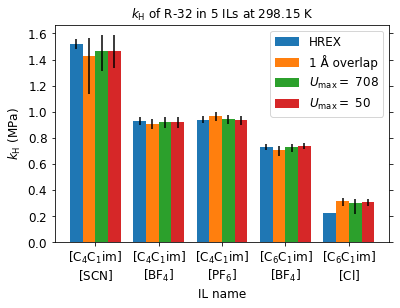

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


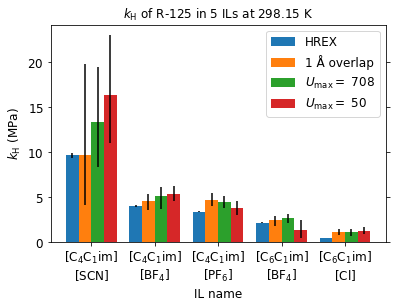

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


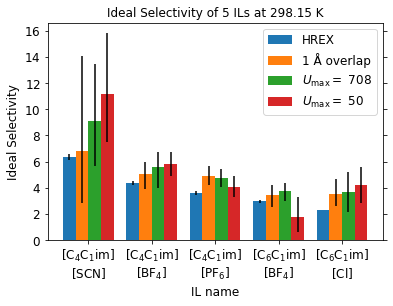

In [110]:
for i in range(3):
    plt.bar(np.arange(len(IL_list))-0.2, hrex_2d[i,:], yerr=hrex_uc_2d[i,:], width = -0.2, align='edge')
    plt.bar(np.arange(len(IL_list)), theta_orig_3d[i,:,0], yerr=yerr_BCa_4d[:,i,:,0], width=-0.2, align='edge')
    plt.bar(np.arange(len(IL_list)), theta_orig_3d[i,:,1], yerr=yerr_BCa_4d[:,i,:,1], width=0.2, align='edge')
    plt.bar(np.arange(len(IL_list))+0.2, theta_orig_3d[i,:,2], yerr=yerr_BCa_4d[:,i,:,2], width=0.2, align='edge')
    plt.ylabel(ylabel_list[i], fontdict=font)
    plt.xlabel("IL name", fontdict=font)
    plt.xticks(np.arange(len(IL_list)),[ILnames_latex_proper_2line[s] for s in IL_list], size=font['size'])
    plt.legend(["HREX", "1 Å overlap", r"$U_\mathrm{max} =$ 708", r"$U_\mathrm{max} =$ 50"], fontsize=font['size'])
    figtitle = var_list_latex[i]+" of "+hfc_in_list[i]+"5 ILs at 298.15 K"
    figname = hfc_list_f[i]+var_list_short[i]+"_vs_IL_all_bar" #"r32_H_vs_IL_all_bar"
    plt.savefig('figures/untitled/'+figname+'.eps')
    plt.savefig('figures/untitled/'+figname+'.png')
    plt.title(figtitle, fontdict=font)
    plt.savefig('figures/titled/'+figname+'.eps')
    plt.savefig('figures/titled/'+figname+'.png')
    plt.show()

In [111]:
dir1list = [
    "cell_list_2",
    "adaptive_rmin_2",
    "adaptive_rmin_1",
    "Eij_max_estimation_1",
    "Eij_max_estimation_2",
]

outdir = Path("vbs_blocksize100_89")
if not outdir.is_dir():
    os.makedirs(outdir)
dirlist = [Path(x,outdir) for x in dir1list]
thispath = Path(outdir,"theta_orig_3d.npy")
if thispath.is_file():
    theta_orig_3d = np.load(thispath)
else:
    theta_orig_3d = np.stack([np.load(Path(d,"theta_orig_2d.npy")) for d in dirlist],axis=2)
    np.save(thispath, theta_orig_3d)
thispath = Path(outdir,"theta_bs_4d.npy")
if thispath.is_file():
    theta_bs_4d = np.load(thispath)
else:
    theta_bs_4d = np.stack([np.load(Path(d,"theta_bs_3d.npy")) for d in dirlist],axis=3)
    np.save(thispath, theta_bs_4d)
thispath = Path(outdir,"CI_BCa_4d.npy")
if thispath.is_file():
    CI_BCa_4d = np.load(thispath)
else:
    CI_BCa_4d = np.stack([np.load(Path(d,"CI_BCa_3d.npy")) for d in dirlist],axis=3)
    np.save(thispath, CI_BCa_4d)
thispath = Path(outdir,"CI_percentile_4d.npy")
if thispath.is_file():
    CI_percentile_4d = np.load(thispath)
else:
    CI_percentile_4d = np.stack([np.load(Path(d,"CI_percentile_3d.npy")) for d in dirlist],axis=3)
    np.save(thispath, CI_percentile_4d)

In [112]:
yerr_BCa_4d = np.abs(CI_BCa_4d - theta_orig_3d)
yerr_percentile_4d = np.abs(CI_percentile_4d - theta_orig_3d)

In [113]:
hrex_2d = np.vstack([hrex_H_r32,hrex_H_r125,hrex_isel])
hrex_uc_2d = np.vstack([hrex_H_r32_uc,hrex_H_r125_uc,hrex_isel_uc])

In [114]:
experimental_values = {
    "BMIM_BF4": (1.54,4.19,0.37),
    "BMIM_PF6": (1.34,4.05,0.33),
    "BMIM_SCN": (3.11,13.32,0.23),
    "HMIM_Cl": (2.0,1.16,1.72),
}
experimental_uc = {
    "BMIM_BF4": (0.06, 0.17, 0.0),
    "BMIM_PF6": (0.01, 0.06, 0.0),
    "BMIM_SCN": (0.37, 2.44, 0.0),
    "HMIM_Cl":  (0.00, 0.03, 0.0),
}
exp_data = {ILnames_latex_proper[il]: t for il, t in experimental_values.items()}
exp_uc = {ILnames_latex_proper[il]: t for il, t in experimental_uc.items()}

In [115]:
solute_list = ["R-32", "R-125"]
mi1 = pd.MultiIndex.from_product([solute_list, ILnames_latex_proper.values()])
colnames = ["Exp.", "HREX","1 \AA\ overlap", r"$U_\mathrm{max} =$ 708", r"$U_\mathrm{max} =$ 50"]
dfdict = {}
for c in colnames:
    dfdict[c] = {}
df = pd.DataFrame(index=mi1,columns=colnames,dtype=pd.StringDtype())
for isolute, solutename in enumerate(solute_list):
    for i_IL, ILname in enumerate(ILnames_latex_proper.values()):
        if ILname in exp_data:
            dfdict[colnames[0]][(solutename,ILname)] = latex_with_uncertainty(exp_data[ILname][isolute],
                                                                              exp_uc[ILname][isolute],
                                                                             )
        else:
            dfdict[colnames[0]][(solutename,ILname)] = '---'
        dfdict[colnames[1]][(solutename,ILname)] = latex_with_uncertainty(hrex_2d[isolute,i_IL],
                                                                          hrex_uc_2d[isolute,i_IL],
                                                                         )
        for icol, colname in enumerate(colnames[2:]):
            df[colname][solutename][ILname] = latex_with_uncertainty(theta_orig_3d[isolute,i_IL,icol],
                                                                     yerr_BCa_4d[:,isolute,i_IL,icol],
                                                                    )
            dfdict[colname][(solutename,ILname)] = latex_with_uncertainty(theta_orig_3d[isolute,i_IL,icol],
                                                                          yerr_BCa_4d[:,isolute,i_IL,icol],
                                                                         )
df2 = pd.DataFrame(dfdict,dtype=pd.StringDtype())
df2

Exp.  \
R-32  $\mathrm{[C_4C_1im][SCN]}$    $\mathrm{3.1_{4}^{4}}$   
      $\mathrm{[C_4C_1im][BF_4]}$  $\mathrm{1.54_{6}^{6}}$   
      $\mathrm{[C_4C_1im][PF_6]}$  $\mathrm{1.34_{1}^{1}}$   
      $\mathrm{[C_6C_1im][BF_4]}$                      ---   
      $\mathrm{[C_6C_1im][Cl]}$                       2.00   
R-125 $\mathrm{[C_4C_1im][SCN]}$     $\mathrm{13_{2}^{2}}$   
      $\mathrm{[C_4C_1im][BF_4]}$   $\mathrm{4.2_{2}^{2}}$   
      $\mathrm{[C_4C_1im][PF_6]}$  $\mathrm{4.05_{6}^{6}}$   
      $\mathrm{[C_6C_1im][BF_4]}$                      ---   
      $\mathrm{[C_6C_1im][Cl]}$    $\mathrm{1.16_{3}^{3}}$   

                                                      HREX  \
R-32  $\mathrm{[C_4C_1im][SCN]}$   $\mathrm{1.52_{4}^{4}}$   
      $\mathrm{[C_4C_1im][BF_4]}$  $\mathrm{0.93_{3}^{3}}$   
      $\mathrm{[C_4C_1im][PF_6]}$  $\mathrm{0.94_{3}^{3}}$   
      $\mathrm{[C_6C_1im][BF_4]}$  $\mathrm{0.73_{2}^{2}}$   
      $\mathrm{[C_6C_1im][Cl]}$                       0.22   
R-125 $\mathrm{[C_4C_1im][SCN]}$    $\mathrm{9.7_{3}^{3}}$   
      $\mathrm{[C_4C_1im][BF_4]}$   $\mathrm{4.1_{1}^{1}}$   
      $\mathrm{[C_4C_1im][PF_6]}$   $\mathrm{3.4_{1}^{1}}$   
      $\mathrm{[C_6C_1im][BF_4]}$  $\mathrm{2.17_{6}^{6}}$   
      $\mathrm{[C_6C_1im][Cl]}$                       0.52   

                                             1 \AA\ overlap  \
R-32  $\mathrm{[C_4C_1im][SCN]}$     $\mathrm{1.4_{3}^{1}}$   
      $\mathrm{[C_4C_1im][BF_4]}$   $\mathrm{0.91_{4}^{4}}$   
      $\mathrm{[C_4C_1im][PF_6]}$   $\mathrm{0.97_{4}^{4}}$   
      $\mathrm{[C_6C_1im][BF_4]}$   $\mathrm{0.70_{5}^{4}}$   
      $\mathrm{[C_6C_1im][Cl]}$     $\mathrm{0.32_{4}^{3}}$   
R-125 $\mathrm{[C_4C_1im][SCN]}$    $\mathrm{10_{06}^{10}}$   
      $\mathrm{[C_4C_1im][BF_4]}$  $\mathrm{4.6_{10}^{08}}$   
      $\mathrm{[C_4C_1im][PF_6]}$    $\mathrm{4.7_{7}^{7}}$   
      $\mathrm{[C_6C_1im][BF_4]}$    $\mathrm{2.4_{7}^{5}}$   
      $\mathrm{[C_6C_1im][Cl]}$      $\mathrm{1.1_{3}^{4}}$   

                                    $U_\mathrm{max} =$ 708  \
R-32  $\mathrm{[C_4C_1im][SCN]}$    $\mathrm{1.5_{2}^{1}}$   
      $\mathrm{[C_4C_1im][BF_4]}$  $\mathrm{0.92_{4}^{4}}$   
      $\mathrm{[C_4C_1im][PF_6]}$  $\mathrm{0.94_{4}^{4}}$   
      $\mathrm{[C_6C_1im][BF_4]}$  $\mathrm{0.73_{4}^{3}}$   
      $\mathrm{[C_6C_1im][Cl]}$    $\mathrm{0.30_{8}^{4}}$   
R-125 $\mathrm{[C_4C_1im][SCN]}$     $\mathrm{13_{5}^{6}}$   
      $\mathrm{[C_4C_1im][BF_4]}$     $\mathrm{5_{1}^{1}}$   
      $\mathrm{[C_4C_1im][PF_6]}$   $\mathrm{4.5_{6}^{7}}$   
      $\mathrm{[C_6C_1im][BF_4]}$   $\mathrm{2.7_{6}^{5}}$   
      $\mathrm{[C_6C_1im][Cl]}$     $\mathrm{1.1_{4}^{4}}$   

                                      $U_\mathrm{max} =$ 50  
R-32  $\mathrm{[C_4C_1im][SCN]}$     $\mathrm{1.5_{1}^{1}}$  
      $\mathrm{[C_4C_1im][BF_4]}$   $\mathrm{0.92_{5}^{4}}$  
      $\mathrm{[C_4C_1im][PF_6]}$   $\mathrm{0.94_{4}^{4}}$  
      $\mathrm{[C_6C_1im][BF_4]}$   $\mathrm{0.74_{3}^{3}}$  
      $\mathrm{[C_6C_1im][Cl]}$     $\mathrm{0.31_{4}^{3}}$  
R-125 $\mathrm{[C_4C_1im][SCN]}$      $\mathrm{16_{5}^{7}}$  
      $\mathrm{[C_4C_1im][BF_4]}$    $\mathrm{5.4_{8}^{9}}$  
      $\mathrm{[C_4C_1im][PF_6]}$    $\mathrm{3.8_{8}^{8}}$  
      $\mathrm{[C_6C_1im][BF_4]}$  $\mathrm{1.3_{08}^{11}}$  
      $\mathrm{[C_6C_1im][Cl]}$      $\mathrm{1.3_{4}^{5}}$

In [116]:
print(df2.to_latex(escape=False))

\begin{tabular}{lllllll}
\toprule
      &                           &                     Exp. &                     HREX &            1 \AA\ overlap &   $U_\mathrm{max} =$ 708 &     $U_\mathrm{max} =$ 50 \\
\midrule
R-32 & $\mathrm{[C_4C_1im][SCN]}$ &   $\mathrm{3.1_{4}^{4}}$ &  $\mathrm{1.52_{4}^{4}}$ &    $\mathrm{1.4_{3}^{1}}$ &   $\mathrm{1.5_{2}^{1}}$ &    $\mathrm{1.5_{1}^{1}}$ \\
      & $\mathrm{[C_4C_1im][BF_4]}$ &  $\mathrm{1.54_{6}^{6}}$ &  $\mathrm{0.93_{3}^{3}}$ &   $\mathrm{0.91_{4}^{4}}$ &  $\mathrm{0.92_{4}^{4}}$ &   $\mathrm{0.92_{5}^{4}}$ \\
      & $\mathrm{[C_4C_1im][PF_6]}$ &  $\mathrm{1.34_{1}^{1}}$ &  $\mathrm{0.94_{3}^{3}}$ &   $\mathrm{0.97_{4}^{4}}$ &  $\mathrm{0.94_{4}^{4}}$ &   $\mathrm{0.94_{4}^{4}}$ \\
      & $\mathrm{[C_6C_1im][BF_4]}$ &                      --- &  $\mathrm{0.73_{2}^{2}}$ &   $\mathrm{0.70_{5}^{4}}$ &  $\mathrm{0.73_{4}^{3}}$ &   $\mathrm{0.74_{3}^{3}}$ \\
      & $\mathrm{[C_6C_1im][Cl]}$ &                     2.00 &                   

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


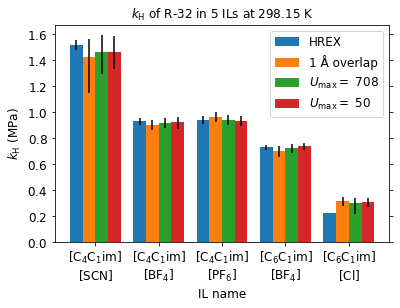

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


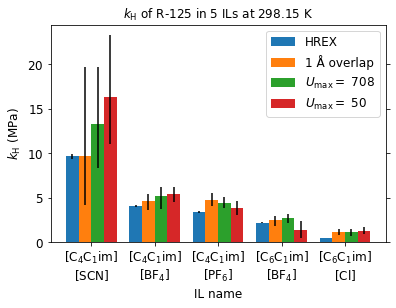

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


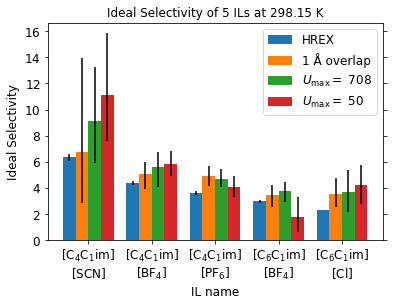

In [117]:
var_list_latex = ["$k_\mathrm{H}$"]*2+["Ideal Selectivity"]+["$\mu'$"]*2+["$\langle w \rangle$"]*2
var_list_short = ["kH"]*2+["isel"]+["mu"]*2+["w"]*2
var_unit_list = [" (MPa)"]*2+['']+[" (kJ/mol)"]*2+ ['']*2
ylabel_list = [v+var_unit_list[j] for j, v in enumerate(var_list_latex)]
hfc_list = ["R-32", "R-125", ""] + ["R-32", "R-125"]*2
hfc_in_list = [s+" in " if s else "" for s in hfc_list]
hfc_list_f = [s.replace("-","").lower()+"_" if s else "" for s in hfc_list]
hrex_2d = np.vstack([hrex_H_r32,hrex_H_r125,hrex_isel])
hrex_uc_2d = np.vstack([hrex_H_r32_uc,hrex_H_r125_uc,hrex_isel_uc])
for i in range(3):
    plt.bar(np.arange(len(IL_list))-0.2, hrex_2d[i,:], yerr=hrex_uc_2d[i,:], width = -0.2, align='edge')
    plt.bar(np.arange(len(IL_list)), theta_orig_3d[i,:,0], yerr=yerr_BCa_4d[:,i,:,0], width=-0.2, align='edge')
    plt.bar(np.arange(len(IL_list)), theta_orig_3d[i,:,1], yerr=yerr_BCa_4d[:,i,:,1], width=0.2, align='edge')
    plt.bar(np.arange(len(IL_list))+0.2, theta_orig_3d[i,:,2], yerr=yerr_BCa_4d[:,i,:,2], width=0.2, align='edge')
    plt.ylabel(ylabel_list[i], fontdict=font)
    plt.xlabel("IL name", fontdict=font)
    plt.xticks(np.arange(len(IL_list)),[ILnames_latex_proper_2line[s] for s in IL_list], size=font['size'])
    plt.legend(["HREX", "1 Å overlap", r"$U_\mathrm{max} =$ 708", r"$U_\mathrm{max} =$ 50"], fontsize=font['size'])
    figtitle = var_list_latex[i]+" of "+hfc_in_list[i]+"5 ILs at 298.15 K"
    figname = hfc_list_f[i]+var_list_short[i]+"_vs_IL_all_bar" #"r32_H_vs_IL_all_bar"
    ut_figdir = Path('figures/untitled',outdir)
    if not ut_figdir.is_dir():
        os.makedirs(ut_figdir)
    plt.savefig(Path(ut_figdir,figname+'.eps'))
    plt.savefig(Path(ut_figdir,figname+'.png'))
    plt.title(figtitle, fontdict=font)
    t_figdir = Path('figures/titled',outdir)
    if not t_figdir.is_dir():
        os.makedirs(t_figdir)
    plt.savefig(Path(t_figdir,figname+'.eps'))
    plt.savefig(Path(t_figdir,figname+'.png'))
    plt.show()

In [40]:
mi1 = pd.MultiIndex.from_product([ILnames_latex_proper.values(),['long']])

In [46]:
rec_Umax_df_1 = pd.DataFrame(
    {il_latex: readlog_mi(ilname+'/Eij_max_estimation_1/cas_widom.out.log')["rec_Umax"] for ilname, il_latex in ILnames_latex_proper.items()},
)
rec_Umax_df_1

,$\mathrm{[C_4C_1im][SCN]}$,$\mathrm{[C_4C_1im][BF_4]}$,$\mathrm{[C_4C_1im][PF_6]}$,$\mathrm{[C_6C_1im][BF_4]}$,$\mathrm{[C_6C_1im][Cl]}$
R-32,47.0,55.0,79.5,57.0,54.5
R-125,40.0,59.5,92.5,61.5,45.5


In [75]:
rec_Umax_df_1_mi = pd.DataFrame(
    {(il_latex, 4): readlog_mi(ilname+'/Eij_max_estimation_1/cas_widom.out.log')["rec_Umax"] for ilname, il_latex in ILnames_latex_proper.items()},
)
rec_Umax_df_1_mi

,$\mathrm{[C_4C_1im][SCN]}$,$\mathrm{[C_4C_1im][BF_4]}$,$\mathrm{[C_4C_1im][PF_6]}$,$\mathrm{[C_6C_1im][BF_4]}$,$\mathrm{[C_6C_1im][Cl]}$
,4,4,4,4,4
R-32,47.0,55.0,79.5,57.0,54.5
R-125,40.0,59.5,92.5,61.5,45.5


In [34]:
print(rec_Umax_df_1.rename(columns=ILnames_latex_proper).to_latex(escape=False))

\begin{tabular}{lrrrrr}
\toprule
{} &  $\mathrm{[C_4C_1im][SCN]}$ &  $\mathrm{[C_4C_1im][BF_4]}$ &  $\mathrm{[C_4C_1im][PF_6]}$ &  $\mathrm{[C_6C_1im][BF_4]}$ &  $\mathrm{[C_6C_1im][Cl]}$ \\
\midrule
R-32  &                        47.0 &                         55.0 &                         79.5 &                         57.0 &                       54.5 \\
R-125 &                        40.0 &                         59.5 &                         92.5 &                         61.5 &                       45.5 \\
\bottomrule
\end{tabular}



In [74]:
rec_Umax_df_2 = pd.DataFrame(
    {il_latex: readlog_mi(ilname+'/Eij_max_estimation_2/cas_widom.out.log')["rec_Umax"] for ilname, il_latex in ILnames_latex_proper.items()}
)
rec_Umax_df_2

,$\mathrm{[C_4C_1im][SCN]}$,$\mathrm{[C_4C_1im][BF_4]}$,$\mathrm{[C_4C_1im][PF_6]}$,$\mathrm{[C_6C_1im][BF_4]}$,$\mathrm{[C_6C_1im][Cl]}$
R-32,48.0,54.5,79.5,55.5,54.5
R-125,38.0,57.5,91.5,57.5,44.0


In [34]:
print(rec_Umax_df_2.rename(columns=ILnames_latex_proper).to_latex(escape=False))

\begin{tabular}{lrrrrr}
\toprule
{} &  $\mathrm{[C_4C_1im][SCN]}$ &  $\mathrm{[C_4C_1im][BF_4]}$ &  $\mathrm{[C_4C_1im][PF_6]}$ &  $\mathrm{[C_6C_1im][BF_4]}$ &  $\mathrm{[C_6C_1im][Cl]}$ \\
\midrule
R-32  &                        47.0 &                         55.0 &                         79.5 &                         57.0 &                       54.5 \\
R-125 &                        40.0 &                         59.5 &                         92.5 &                         61.5 &                       45.5 \\
\bottomrule
\end{tabular}



In [76]:
rec_Umax_df_2_mi = pd.DataFrame(
    {(il_latex,3): readlog_mi(ilname+'/Eij_max_estimation_2/cas_widom.out.log')["rec_Umax"] for ilname, il_latex in ILnames_latex_proper.items()}
)
rec_Umax_df_2_mi

,$\mathrm{[C_4C_1im][SCN]}$,$\mathrm{[C_4C_1im][BF_4]}$,$\mathrm{[C_4C_1im][PF_6]}$,$\mathrm{[C_6C_1im][BF_4]}$,$\mathrm{[C_6C_1im][Cl]}$
,3,3,3,3,3
R-32,48.0,54.5,79.5,55.5,54.5
R-125,38.0,57.5,91.5,57.5,44.0


In [49]:
pd.concat([rec_Umax_df_1_mi,rec_Umax_df_2_mi])

$\mathrm{[C_4C_1im][BF_4]}$       $\mathrm{[C_4C_1im][PF_6]}$        \
                             long short                        long short   
R-32                         55.0   NaN                        79.5   NaN   
R-125                        59.5   NaN                        92.5   NaN   
R-32                          NaN  54.5                         NaN  79.5   
R-125                         NaN  57.5                         NaN  91.5   

      $\mathrm{[C_4C_1im][SCN]}$       $\mathrm{[C_6C_1im][BF_4]}$        \
                            long short                        long short   
R-32                        47.0   NaN                        57.0   NaN   
R-125                       40.0   NaN                        61.5   NaN   
R-32                         NaN  48.0                         NaN  55.5   
R-125                        NaN  38.0                         NaN  57.5   

      $\mathrm{[C_6C_1im][Cl]}$        
                           long short  
R-32                       54.5   NaN  
R-125                      45.5   NaN  
R-32                        NaN  54.5  
R-125                       NaN  44.0

In [80]:
rec_Umax_df_1_mi.join(rec_Umax_df_2_mi).sort_index(axis=1)

$\mathrm{[C_4C_1im][BF_4]}$       $\mathrm{[C_4C_1im][PF_6]}$        \
                                3     4                           3     4   
R-32                         54.5  55.0                        79.5  79.5   
R-125                        57.5  59.5                        91.5  92.5   

      $\mathrm{[C_4C_1im][SCN]}$       $\mathrm{[C_6C_1im][BF_4]}$        \
                               3     4                           3     4   
R-32                        48.0  47.0                        55.5  57.0   
R-125                       38.0  40.0                        57.5  61.5   

      $\mathrm{[C_6C_1im][Cl]}$        
                              3     4  
R-32                       54.5  54.5  
R-125                      44.0  45.5

In [77]:
mi_c = pd.MultiIndex.from_product([ILnames_latex_proper.values(),[3,4]],names=["IL", "$\log_{10} n_\mathrm{IPF}$"])

In [78]:
rec_Umax_df_join = rec_Umax_df_1_mi.join(rec_Umax_df_2_mi).sort_index(axis=1).reindex(columns=mi_c)
rec_Umax_df_join

IL                         $\mathrm{[C_4C_1im][SCN]}$        \
$\log_{10} n_\mathrm{IPF}$                          3     4   
R-32                                             48.0  47.0   
R-125                                            38.0  40.0   

IL                         $\mathrm{[C_4C_1im][BF_4]}$        \
$\log_{10} n_\mathrm{IPF}$                           3     4   
R-32                                              54.5  55.0   
R-125                                             57.5  59.5   

IL                         $\mathrm{[C_4C_1im][PF_6]}$        \
$\log_{10} n_\mathrm{IPF}$                           3     4   
R-32                                              79.5  79.5   
R-125                                             91.5  92.5   

IL                         $\mathrm{[C_6C_1im][BF_4]}$        \
$\log_{10} n_\mathrm{IPF}$                           3     4   
R-32                                              55.5  57.0   
R-125                                             57.5  61.5   

IL                         $\mathrm{[C_6C_1im][Cl]}$        
$\log_{10} n_\mathrm{IPF}$                         3     4  
R-32                                            54.5  54.5  
R-125                                           44.0  45.5

In [79]:
print(rec_Umax_df_join.to_latex(escape=False))

\begin{tabular}{lrrrrrrrrrr}
\toprule
IL & \multicolumn{2}{l}{$\mathrm{[C_4C_1im][SCN]}$} & \multicolumn{2}{l}{$\mathrm{[C_4C_1im][BF_4]}$} & \multicolumn{2}{l}{$\mathrm{[C_4C_1im][PF_6]}$} & \multicolumn{2}{l}{$\mathrm{[C_6C_1im][BF_4]}$} & \multicolumn{2}{l}{$\mathrm{[C_6C_1im][Cl]}$} \\
$\log_{10} n_\mathrm{IPF}$ &                          3 &     4 &                           3 &     4 &                           3 &     4 &                           3 &     4 &                         3 &     4 \\
\midrule
R-32  &                       48.0 &  47.0 &                        54.5 &  55.0 &                        79.5 &  79.5 &                        55.5 &  57.0 &                      54.5 &  54.5 \\
R-125 &                       38.0 &  40.0 &                        57.5 &  59.5 &                        91.5 &  92.5 &                        57.5 &  61.5 &                      44.0 &  45.5 \\
\bottomrule
\end{tabular}



In [58]:
tolerance_dict = {}
emax_file_r32 = "/Eij_max_estimation_1/cas_widom.out.spec3.emax"
emax_file_r125 = "/Eij_max_estimation_1/cas_widom.out.spec4.emax"
for ilname in ILnames_latex_proper:
    tolerance_dict[ilname] = {}
    tolerance_dict[ilname]['R-32'] = pd.to_numeric(pd.read_csv(ilname+emax_file_r32,
                                                               delim_whitespace=True,
                                                              ).set_index('max_Eij').w_frac[50.5:],
                                                   errors='coerce',
                                                  ).fillna(0.0).sum()
    tolerance_dict[ilname]['R-125']= pd.to_numeric(pd.read_csv(ilname+emax_file_r125,
                                                               delim_whitespace=True,
                                                              ).set_index('max_Eij').w_frac[50.5:],
                                                   errors='coerce',
                                                  ).fillna(0.0).sum()
tolerance_df = pd.DataFrame(tolerance_dict)
print((-np.log10(tolerance_df.rename(columns=ILnames_latex_proper))).to_latex(float_format='%.2f',escape=False))
tolerance_df

\begin{tabular}{lrrrrr}
\toprule
{} &  $\mathrm{[C_4C_1im][SCN]}$ &  $\mathrm{[C_4C_1im][BF_4]}$ &  $\mathrm{[C_4C_1im][PF_6]}$ &  $\mathrm{[C_6C_1im][BF_4]}$ &  $\mathrm{[C_6C_1im][Cl]}$ \\
\midrule
R-32  &                       11.33 &                         5.49 &                         0.00 &                         5.70 &                       7.92 \\
R-125 &                       14.63 &                         2.78 &                         0.00 &                         2.63 &                      11.96 \\
\bottomrule
\end{tabular}



,BMIM_SCN,BMIM_BF4,BMIM_PF6,HMIM_BF4,HMIM_Cl
R-32,4.711375e-12,0.000003,0.996375,0.000002,1.192294e-08
R-125,2.366142e-15,0.001654,0.999998,0.002327,1.091585e-12


In [52]:
-np.log10(tolerance_df)

,BMIM_SCN,BMIM_BF4,BMIM_PF6,HMIM_BF4,HMIM_Cl
R-32,11.326852,5.486200,1.577391e-03,5.698735,7.923617
R-125,14.625959,2.781381,9.900611e-07,2.633167,11.961943


In [56]:
print((-np.log10(tolerance_df)).to_latex(float_format='%.2f'))

\begin{tabular}{lrrrrr}
\toprule
{} &  BMIM\_SCN &  BMIM\_BF4 &  BMIM\_PF6 &  HMIM\_BF4 &  HMIM\_Cl \\
\midrule
R-32  &     11.33 &      5.49 &      0.00 &      5.70 &     7.92 \\
R-125 &     14.63 &      2.78 &      0.00 &      2.63 &    11.96 \\
\bottomrule
\end{tabular}



In [35]:
df = pd.read_csv('BMIM_PF6/Eij_max_estimation_1/cas_widom.out.spec3.emax',
                 delim_whitespace=True
                )
df.head()

,Eij_index,max_Eij,w_frac,w_max,w_freq
0,69,34.5,0.122541115581E-37,0.376242287796E-20,1
1,70,35.0,0.416380933676E-35,0.127842899372E-17,1
2,71,35.5,0.153118375753E-16,0.344343359162E+01,11
3,72,36.0,0.301061108886E-09,0.671256069596E+08,22
4,73,36.5,0.151069734229E-08,0.373031305880E+09,70


In [36]:
df.set_index('max_Eij').head()

,Eij_index,w_frac,w_max,w_freq
max_Eij,,,,
34.5,69,0.122541115581E-37,0.376242287796E-20,1
35.0,70,0.416380933676E-35,0.127842899372E-17,1
35.5,71,0.153118375753E-16,0.344343359162E+01,11
36.0,72,0.301061108886E-09,0.671256069596E+08,22
36.5,73,0.151069734229E-08,0.373031305880E+09,70


In [47]:
df_sum = df.set_index('max_Eij').loc[50.5:][['w_frac','w_freq']].sum()

In [48]:
df_sum

w_frac    9.963745e-01
w_freq    4.931215e+08
dtype: float64

In [40]:
df_sum.dtypes

dtype('O')

In [41]:
df.dtypes

Eij_index      int64
max_Eij      float64
w_frac        object
w_max         object
w_freq         int64
dtype: object

In [42]:
df['w_frac'] = pd.to_numeric(df['w_frac'],errors='coerce')

In [43]:
df['w_max'] = pd.to_numeric(df['w_max'],errors='coerce')

In [46]:
df.fillna(0.0,inplace=True)

In [14]:
readlog('BMIM_SCN/cell_list_2/cas_widom.out.log')

{'overlap_r32': 1558123,
 'attempts_r32': 500000000,
 'overlap_r125': 275891076,
 'attempts_r125': 500000000,
 'wtime': 326884.3272,
 'cputime': 20815402.097}

In [15]:
readlog('BMIM_PF6/cell_list_2/cas_widom.out.log')

{'overlap_r32': 15857,
 'attempts_r32': 500000000,
 'overlap_r125': 130144948,
 'attempts_r125': 500000000,
 'wtime': 322145.6472,
 'cputime': 20600528.139}

In [62]:
IL_list = ["BMIM_SCN",
           "BMIM_BF4",
           "BMIM_PF6",
           "HMIM_BF4",
           "HMIM_Cl"]

In [63]:
logdata_dict_slow = {}
logdata_dict_ar1 = {}
logdata_dict_ar2 = {}
for ILname in IL_list:
    logdata_dict_slow[ILname] = readlog(ILname+'/cell_list_2/cas_widom.out.log')
    logdata_dict_ar1[ILname] = readlog(ILname+'/adaptive_rmin_1/cas_widom.out.log')
    logdata_dict_ar2[ILname] = readlog(ILname+'/adaptive_rmin_2/cas_widom.out.log')
logdata_df_slow = pd.DataFrame(logdata_dict_slow)
logdata_df_ar1 = pd.DataFrame(logdata_dict_ar1)
logdata_df_ar2 = pd.DataFrame(logdata_dict_ar2)

In [64]:
logdata_df_slow

,BMIM_SCN,BMIM_BF4,BMIM_PF6,HMIM_BF4,HMIM_Cl
overlap_r32,1.558123e+06,2.462800e+04,1.585700e+04,2.000300e+04,1.047310e+05
attempts_r32,5.000000e+08,5.000000e+08,5.000000e+08,4.948500e+08,5.000000e+08
overlap_r125,2.758911e+08,1.403157e+08,1.301449e+08,1.320886e+08,1.747590e+08
attempts_r125,5.000000e+08,5.000000e+08,5.000000e+08,4.948500e+08,5.000000e+08
wtime,3.268843e+05,3.228878e+05,3.221456e+05,3.653674e+05,3.890720e+05
cputime,2.081540e+07,2.056419e+07,2.060053e+07,2.326300e+07,2.471826e+07


In [65]:
logdata_df_ar1

,BMIM_SCN,BMIM_BF4,BMIM_PF6,HMIM_BF4,HMIM_Cl
overlap_r32,2.280841e+08,8.826971e+07,1.252388e+08,7.813906e+07,1.221570e+08
attempts_r32,5.000000e+08,5.000000e+08,5.000000e+08,4.948500e+08,5.000000e+08
t_cpu_r32,4.492631e+05,6.348474e+05,5.784128e+05,7.271500e+05,6.412527e+05
t_wallclock_r32,7.189359e+03,1.007378e+04,9.184710e+03,1.160895e+04,1.034996e+04
overlap_r125,4.897138e+08,4.684967e+08,4.650665e+08,4.579219e+08,4.709529e+08
attempts_r125,5.000000e+08,5.000000e+08,5.000000e+08,4.948500e+08,5.000000e+08
t_cpu_r125,2.167796e+05,2.512568e+05,2.673915e+05,2.845286e+05,2.780517e+05
t_wallclock_r125,3.517026e+03,4.024882e+03,4.281474e+03,4.709992e+03,4.545076e+03
wtime,1.075880e+04,1.413198e+04,1.350070e+04,1.635452e+04,1.492759e+04
cputime,8.199103e+05,1.039911e+06,1.010386e+06,1.201781e+06,1.085656e+06


In [66]:
logdata_df_ar2

,BMIM_SCN,BMIM_BF4,BMIM_PF6,HMIM_BF4,HMIM_Cl
overlap_r32,1.559784e+06,2.465600e+04,1.582100e+04,2.001600e+04,1.051840e+05
attempts_r32,5.000000e+08,5.000000e+08,5.000000e+08,4.948500e+08,5.000000e+08
t_cpu_r32,1.485300e+06,1.815523e+06,1.824312e+06,2.074322e+06,1.993306e+06
t_wallclock_r32,2.335634e+04,2.865518e+04,2.872272e+04,3.302444e+04,3.173268e+04
overlap_r125,3.177491e+08,1.910994e+08,1.833310e+08,1.810331e+08,2.225020e+08
attempts_r125,5.000000e+08,5.000000e+08,5.000000e+08,4.948500e+08,5.000000e+08
t_cpu_r125,6.790222e+05,9.951257e+05,1.019305e+06,1.138695e+06,1.028855e+06
t_wallclock_r125,1.072432e+04,1.626287e+04,1.604898e+04,1.810949e+04,1.639142e+04
wtime,3.411552e+04,4.495280e+04,4.481155e+04,5.117292e+04,4.815872e+04
cputime,2.303119e+06,2.953375e+06,3.004948e+06,3.383536e+06,3.179587e+06


In [67]:
logdata_df_ar2.loc['t_wallclock_r125']*64.0

BMIM_SCN     686356.736
BMIM_BF4    1040823.552
BMIM_PF6    1027134.528
HMIM_BF4    1159007.424
HMIM_Cl     1049050.560
Name: t_wallclock_r125, dtype: float64

In [68]:
jobeml_dict3 = {}
run_dir_dict = {
    "None": 'cell_list_2',
    "708": "adaptive_rmin_2",
    "50": "adaptive_rmin_1",
}
for ILname in IL_list:
    jobeml_dict2 = {}
    for Umax, run_dir in run_dir_dict.items():
        jobeml_dict1 = {}
        rundirpath = Path(ILname,run_dir)
        emlpath = Path(rundirpath,'jobeml.txt')
        untitledpath = Path(rundirpath,'untitled.txt')
        if untitledpath.is_file() and not emlpath.is_file():
            os.rename(untitledpath,emlpath)
        with emlpath.open() as emlfile:
            for linetxt in emlfile:
                if '=' not in linetxt:
                    continue
                linesplit = [s.strip() for s in linetxt.split('=')]
                jobeml_dict1[linesplit[0]] = linesplit[1]
        jobeml_dict2[Umax] = jobeml_dict1
    jobeml_dict3[ILname] = jobeml_dict2

In [69]:
hrex_walltime = pd.read_csv('hrex_walltime.csv', index_col=0)
hrex_walltime

,BMIM_BF4,BMIM_PF6,BMIM_SCN,HMIM_BF4
t_wallclock_r32,270320.238,280710.33,260039.434,317542.523
t_wallclock_r125,272233.673,285040.52,259868.556,332484.286


In [70]:
def colontime_to_seconds(tstr):
    tmult = np.cumprod([1,60,60,24,365])
    tvec = np.array([float(s) for s in reversed(tstr.split(':'))])
    return np.sum(tmult[:len(tvec)]*tvec)

In [71]:
jobeml_dict3['BMIM_BF4']['None']['Wallclock Time']

'3:18:16:08'

In [72]:
colontime_to_seconds(jobeml_dict3['BMIM_BF4']['None']['Wallclock Time'])

324968.0

In [73]:
tgtrows = {"R-32": "t_wallclock_r32",
           "R-125": "t_wallclock_r125",
           "Widom": "wtime",
#            "total": "cputime"}
          }
logdata_df_dict = {"None": logdata_df_slow,
                   "708": logdata_df_ar2,
                   "50": logdata_df_ar1,
                   "HREX": hrex_walltime,
                  }
# Umax_list = ["None", "708", "50"]
ncores = 64
hrex_ncores = 192
multi_idx_tuple_list = []
serieslist = []
for newrow, oldrow in tgtrows.items():
    for Umax, logdata_df in logdata_df_dict.items():
        if Umax == "None" and "R-" in newrow:
            continue
        if Umax == "HREX" and "R-" not in newrow:
            continue
        if Umax == "HREX":
            corefactor = hrex_ncores
        else:
            corefactor = ncores
        multi_idx_tuple_list.append((newrow,Umax))
        serieslist.append(logdata_df.loc[oldrow]*corefactor)


for Umax in logdata_df_dict:
    if (Umax == "None" and "R-" in newrow) or Umax == "HREX":
        continue
    multi_idx_tuple_list.append(('total',Umax))
    serieslist.append(pd.Series({ILname: colontime_to_seconds(jobeml_dict3[ILname][Umax]["Wallclock Time"]) for ILname in IL_list})*ncores)

col_mi = pd.MultiIndex.from_tuples([tuple(s.split('\n')) for s in ILnames_latex_proper_2line.values()])
col_mi_mapper = {il: tuple(s.split('\n')) for il, s in ILnames_latex_proper_2line.items()}

t_cpu_df_idx = pd.MultiIndex.from_tuples(multi_idx_tuple_list, names=["Part", "U_max"])
t_cpu_df = pd.DataFrame(serieslist, index=t_cpu_df_idx)
t_cpu_df_mi_col = pd.DataFrame(t_cpu_df.to_numpy(), index=t_cpu_df_idx, columns=col_mi)
t_cpu_df

BMIM_SCN      BMIM_BF4      BMIM_PF6      HMIM_BF4  \
Part  U_max                                                           
R-32  708    1.494806e+06  1.833931e+06  1.838254e+06  2.113564e+06   
      50     4.601190e+05  6.447217e+05  5.878214e+05  7.429730e+05   
      HREX   4.992757e+07  5.190149e+07  5.389638e+07  6.096816e+07   
R-125 708    6.863567e+05  1.040824e+06  1.027135e+06  1.159007e+06   
      50     2.250897e+05  2.575924e+05  2.740143e+05  3.014395e+05   
      HREX   4.989476e+07  5.226887e+07  5.472778e+07  6.383698e+07   
Widom None   2.092060e+07  2.066482e+07  2.061732e+07  2.338352e+07   
      708    2.183393e+06  2.876979e+06  2.867939e+06  3.275067e+06   
      50     6.885633e+05  9.044470e+05  8.640447e+05  1.046689e+06   
total None   2.105133e+07  2.079795e+07  2.084858e+07  2.355846e+07   
      708    2.318912e+06  3.017792e+06  3.027968e+06  3.454784e+06   
      50     8.350080e+05  1.052992e+06  1.028736e+06  1.291712e+06   

                  HMIM_Cl  
Part  U_max                
R-32  708    2.030892e+06  
      50     6.623975e+05  
      HREX            NaN  
R-125 708    1.049051e+06  
      50     2.908849e+05  
      HREX            NaN  
Widom None   2.490061e+07  
      708    3.082158e+06  
      50     9.553660e+05  
total None   2.508320e+07  
      708    3.238464e+06  
      50     1.175872e+06

In [74]:
t_cpu_df / 3600 / 24

BMIM_SCN    BMIM_BF4    BMIM_PF6    HMIM_BF4     HMIM_Cl
Part  U_max                                                            
R-32  708     17.300990   21.226057   21.276090   24.462545   23.505689
      50       5.325451    7.462057    6.803489    8.599224    7.666638
      HREX   577.865409  600.711640  623.800733  705.650051         NaN
R-125 708      7.943944   12.046569   11.888131   13.414438   12.141789
      50       2.605204    2.981394    3.171462    3.488883    3.366723
      HREX   577.485680  604.963718  633.423378  738.853969         NaN
Widom None   242.136539  239.176117  238.626405  270.642555  288.201448
      708     25.270757   33.298373   33.193744   37.905869   35.673125
      50       7.969483   10.468136   10.000517   12.114459   11.057477
total None   243.649630  240.717037  241.302963  272.667407  290.314815
      708     26.839259   34.928148   35.045926   39.985926   37.482222
      50       9.664444   12.187407   11.906667   14.950370   13.609630

In [76]:
print((t_cpu_df/3600/24).to_latex(float_format='%.2f', na_rep=''))

\begin{tabular}{llrrrrr}
\toprule
      &    &  BMIM\_SCN &  BMIM\_BF4 &  BMIM\_PF6 &  HMIM\_BF4 &  HMIM\_Cl \\
Part & U\_max &           &           &           &           &          \\
\midrule
R-32 & 708 &     17.30 &     21.23 &     21.28 &     24.46 &    23.51 \\
      & 50 &      5.33 &      7.46 &      6.80 &      8.60 &     7.67 \\
      & HREX &    577.87 &    600.71 &    623.80 &    705.65 &          \\
R-125 & 708 &      7.94 &     12.05 &     11.89 &     13.41 &    12.14 \\
      & 50 &      2.61 &      2.98 &      3.17 &      3.49 &     3.37 \\
      & HREX &    577.49 &    604.96 &    633.42 &    738.85 &          \\
Widom & None &    242.14 &    239.18 &    238.63 &    270.64 &   288.20 \\
      & 708 &     25.27 &     33.30 &     33.19 &     37.91 &    35.67 \\
      & 50 &      7.97 &     10.47 &     10.00 &     12.11 &    11.06 \\
total & None &    243.65 &    240.72 &    241.30 &    272.67 &   290.31 \\
      & 708 &     26.84 &     34.93 &     35.05 &     39.99 &  

In [77]:
t_cpu_df_mi_col.rename_axis(index=["Part","$U_\mathrm{max}$"], inplace=True)
# t_cpu_df.rename(columns=ILnames_latex_proper_2lines, inplace=True)

In [78]:
(t_cpu_df_mi_col/3600/24)

$\mathrm{[C_4C_1im]}$                    \
                            $\mathrm{[SCN]}$ $\mathrm{[BF_4]}$   
Part  $U_\mathrm{max}$                                           
R-32  708                          17.300990         21.226057   
      50                            5.325451          7.462057   
      HREX                        577.865409        600.711640   
R-125 708                           7.943944         12.046569   
      50                            2.605204          2.981394   
      HREX                        577.485680        604.963718   
Widom None                        242.136539        239.176117   
      708                          25.270757         33.298373   
      50                            7.969483         10.468136   
total None                        243.649630        240.717037   
      708                          26.839259         34.928148   
      50                            9.664444         12.187407   

                                         $\mathrm{[C_6C_1im]}$                  
                       $\mathrm{[PF_6]}$     $\mathrm{[BF_4]}$ $\mathrm{[Cl]}$  
Part  $U_\mathrm{max}$                                                          
R-32  708                      21.276090             24.462545       23.505689  
      50                        6.803489              8.599224        7.666638  
      HREX                    623.800733            705.650051             NaN  
R-125 708                      11.888131             13.414438       12.141789  
      50                        3.171462              3.488883        3.366723  
      HREX                    633.423378            738.853969             NaN  
Widom None                    238.626405            270.642555      288.201448  
      708                      33.193744             37.905869       35.673125  
      50                       10.000517             12.114459       11.057477  
total None                    241.302963            272.667407      290.314815  
      708                      35.045926             39.985926       37.482222  
      50                       11.906667             14.950370       13.609630

In [79]:
print((t_cpu_df_mi_col/3600/24).to_latex(float_format='%.2f', na_rep='---', escape=False, multicolumn_format='l'))

\begin{tabular}{llrrrrr}
\toprule
      &    & \multicolumn{3}{l}{$\mathrm{[C_4C_1im]}$} & \multicolumn{2}{l}{$\mathrm{[C_6C_1im]}$} \\
      &    &      $\mathrm{[SCN]}$ & $\mathrm{[BF_4]}$ & $\mathrm{[PF_6]}$ &     $\mathrm{[BF_4]}$ & $\mathrm{[Cl]}$ \\
Part & $U_\mathrm{max}$ &                       &                   &                   &                       &                 \\
\midrule
R-32 & 708 &                 17.30 &             21.23 &             21.28 &                 24.46 &           23.51 \\
      & 50 &                  5.33 &              7.46 &              6.80 &                  8.60 &            7.67 \\
      & HREX &                577.87 &            600.71 &            623.80 &                705.65 &             --- \\
R-125 & 708 &                  7.94 &             12.05 &             11.89 &                 13.41 &           12.14 \\
      & 50 &                  2.61 &              2.98 &              3.17 &                  3.49 &            3.37 \\

In [86]:
t_df = t_cpu_df_mi_col.copy()
t_df.pop(('$\mathrm{[C_6C_1im]}$',"$\mathrm{[Cl]}$"))

Part   $U_\mathrm{max}$
R-32   708                 2.030892e+06
       50                  6.623975e+05
       HREX                         NaN
R-125  708                 1.049051e+06
       50                  2.908849e+05
       HREX                         NaN
Widom  None                2.490061e+07
       708                 3.082158e+06
       50                  9.553660e+05
total  None                2.508320e+07
       708                 3.238464e+06
       50                  1.175872e+06
Name: ($\mathrm{[C_6C_1im]}$, $\mathrm{[Cl]}$), dtype: float64

In [87]:
t_cpu_df

BMIM_SCN      BMIM_BF4      BMIM_PF6      HMIM_BF4  \
Part  U_max                                                           
R-32  708    1.494806e+06  1.833931e+06  1.838254e+06  2.113564e+06   
      50     4.601190e+05  6.447217e+05  5.878214e+05  7.429730e+05   
      HREX   4.992757e+07  5.190149e+07  5.389638e+07  6.096816e+07   
R-125 708    6.863567e+05  1.040824e+06  1.027135e+06  1.159007e+06   
      50     2.250897e+05  2.575924e+05  2.740143e+05  3.014395e+05   
      HREX   4.989476e+07  5.226887e+07  5.472778e+07  6.383698e+07   
Widom None   2.092060e+07  2.066482e+07  2.061732e+07  2.338352e+07   
      708    2.183393e+06  2.876979e+06  2.867939e+06  3.275067e+06   
      50     6.885633e+05  9.044470e+05  8.640447e+05  1.046689e+06   
total None   2.105133e+07  2.079795e+07  2.084858e+07  2.355846e+07   
      708    2.318912e+06  3.017792e+06  3.027968e+06  3.454784e+06   
      50     8.350080e+05  1.052992e+06  1.028736e+06  1.291712e+06   

                  HMIM_Cl  
Part  U_max                
R-32  708    2.030892e+06  
      50     6.623975e+05  
      HREX            NaN  
R-125 708    1.049051e+06  
      50     2.908849e+05  
      HREX            NaN  
Widom None   2.490061e+07  
      708    3.082158e+06  
      50     9.553660e+05  
total None   2.508320e+07  
      708    3.238464e+06  
      50     1.175872e+06

In [88]:
t_df

$\mathrm{[C_4C_1im]}$                    \
                            $\mathrm{[SCN]}$ $\mathrm{[BF_4]}$   
Part  $U_\mathrm{max}$                                           
R-32  708                       1.494806e+06      1.833931e+06   
      50                        4.601190e+05      6.447217e+05   
      HREX                      4.992757e+07      5.190149e+07   
R-125 708                       6.863567e+05      1.040824e+06   
      50                        2.250897e+05      2.575924e+05   
      HREX                      4.989476e+07      5.226887e+07   
Widom None                      2.092060e+07      2.066482e+07   
      708                       2.183393e+06      2.876979e+06   
      50                        6.885633e+05      9.044470e+05   
total None                      2.105133e+07      2.079795e+07   
      708                       2.318912e+06      3.017792e+06   
      50                        8.350080e+05      1.052992e+06   

                                         $\mathrm{[C_6C_1im]}$  
                       $\mathrm{[PF_6]}$     $\mathrm{[BF_4]}$  
Part  $U_\mathrm{max}$                                          
R-32  708                   1.838254e+06          2.113564e+06  
      50                    5.878214e+05          7.429730e+05  
      HREX                  5.389638e+07          6.096816e+07  
R-125 708                   1.027135e+06          1.159007e+06  
      50                    2.740143e+05          3.014395e+05  
      HREX                  5.472778e+07          6.383698e+07  
Widom None                  2.061732e+07          2.338352e+07  
      708                   2.867939e+06          3.275067e+06  
      50                    8.640447e+05          1.046689e+06  
total None                  2.084858e+07          2.355846e+07  
      708                   3.027968e+06          3.454784e+06  
      50                    1.028736e+06          1.291712e+06

In [89]:
t_cpu_df.loc[['R-32','R-125']].index

MultiIndex([( 'R-32',  '708'),
            ( 'R-32',   '50'),
            ( 'R-32', 'HREX'),
            ('R-125',  '708'),
            ('R-125',   '50'),
            ('R-125', 'HREX')],
           names=['Part', 'U_max'])

In [90]:
2.776/np.sqrt(5)

1.241464941107883

In [91]:
comp_df = pd.DataFrame(index=t_df.loc[['R-32','R-125']].index,columns=t_df.columns)
# comp_list = ['R-32', 'R-125']
comp_df.loc['R-32','708'] = yerr_BCa_4d[:,0,:-1,1].mean(0) / np.sqrt(t_df.loc['R-32','HREX']/t_df.loc['R-32','708'])
comp_df.loc['R-32','50'] = yerr_BCa_4d[:,0,:-1,2].mean(0) / np.sqrt(t_df.loc['R-32','HREX']/t_df.loc['R-32','50'])
comp_df.loc['R-32','HREX'] = hrex_H_r32_uc[:-1]
comp_df.loc['R-125','708'] = yerr_BCa_4d[:,1,:-1,1].mean(0) / np.sqrt(t_df.loc['R-125','HREX']/t_df.loc['R-125','708'])
comp_df.loc['R-125','50'] = yerr_BCa_4d[:,1,:-1,2].mean(0) / np.sqrt(t_df.loc['R-125','HREX']/t_df.loc['R-125','50'])
comp_df.loc['R-125','HREX'] = hrex_H_r125_uc[:-1]
comp_df

$\mathrm{[C_4C_1im]}$                    \
                            $\mathrm{[SCN]}$ $\mathrm{[BF_4]}$   
Part  $U_\mathrm{max}$                                           
R-32  708                            0.02395           0.00726   
      50                             0.01204          0.004639   
      HREX                              0.04              0.03   
R-125 708                           0.647893          0.172222   
      50                            0.397014          0.057708   
      HREX                               0.3               0.1   

                                         $\mathrm{[C_6C_1im]}$  
                       $\mathrm{[PF_6]}$     $\mathrm{[BF_4]}$  
Part  $U_\mathrm{max}$                                          
R-32  708                       0.006633               0.00564  
      50                        0.003714              0.002759  
      HREX                          0.03                  0.02  
R-125 708                       0.086371              0.067601  
      50                        0.052944              0.066263  
      HREX                           0.1                  0.06

In [50]:
comp_df

BMIM_SCN  BMIM_BF4  BMIM_PF6  HMIM_BF4
Part  U_max                                        
R-32  708    0.024174   0.00729  0.006595   0.00562
      50     0.011969  0.004677  0.003736  0.002758
      HREX       0.04      0.03      0.03      0.02
R-125 708    0.645867  0.171169  0.086514   0.06782
      50     0.395616  0.057655  0.053043  0.066268
      HREX        0.3       0.1       0.1      0.06

In [92]:
print(t_df.to_latex(float_format='%.2g', na_rep='', escape=False))

\begin{tabular}{llrrrr}
\toprule
      &    & \multicolumn{3}{l}{$\mathrm{[C_4C_1im]}$} & $\mathrm{[C_6C_1im]}$ \\
      &    &      $\mathrm{[SCN]}$ & $\mathrm{[BF_4]}$ & $\mathrm{[PF_6]}$ &     $\mathrm{[BF_4]}$ \\
Part & $U_\mathrm{max}$ &                       &                   &                   &                       \\
\midrule
R-32 & 708 &               1.5e+06 &           1.8e+06 &           1.8e+06 &               2.1e+06 \\
      & 50 &               4.6e+05 &           6.4e+05 &           5.9e+05 &               7.4e+05 \\
      & HREX &                 5e+07 &           5.2e+07 &           5.4e+07 &               6.1e+07 \\
R-125 & 708 &               6.9e+05 &             1e+06 &             1e+06 &               1.2e+06 \\
      & 50 &               2.3e+05 &           2.6e+05 &           2.7e+05 &                 3e+05 \\
      & HREX &                 5e+07 &           5.2e+07 &           5.5e+07 &               6.4e+07 \\
Widom & None &               2.1e+07 &    

In [53]:
# comp_df.to_excel('comparison_table.xlsx', float_format='%.2g')
print(comp_df.to_latex())

\begin{tabular}{llllll}
\toprule
      &      &  BMIM\_SCN &  BMIM\_BF4 &  BMIM\_PF6 &  HMIM\_BF4 \\
Part & U\_max &           &           &           &           \\
\midrule
R-32 & 708 &  0.024174 &   0.00729 &  0.006595 &   0.00562 \\
      & 50 &  0.011969 &  0.004677 &  0.003736 &  0.002758 \\
      & HREX &      0.04 &      0.03 &      0.03 &      0.02 \\
R-125 & 708 &  0.645867 &  0.171169 &  0.086514 &   0.06782 \\
      & 50 &  0.395616 &  0.057655 &  0.053043 &  0.066268 \\
      & HREX &       0.3 &       0.1 &       0.1 &      0.06 \\
\bottomrule
\end{tabular}



In [93]:
print(comp_df.to_latex(float_format="{:0.2g}".format, escape=False))

\begin{tabular}{llllll}
\toprule
      &      & \multicolumn{3}{l}{$\mathrm{[C_4C_1im]}$} & $\mathrm{[C_6C_1im]}$ \\
      &      &      $\mathrm{[SCN]}$ & $\mathrm{[BF_4]}$ & $\mathrm{[PF_6]}$ &     $\mathrm{[BF_4]}$ \\
Part & $U_\mathrm{max}$ &                       &                   &                   &                       \\
\midrule
R-32 & 708 &                 0.024 &            0.0073 &            0.0066 &                0.0056 \\
      & 50 &                 0.012 &            0.0046 &            0.0037 &                0.0028 \\
      & HREX &                  0.04 &              0.03 &              0.03 &                  0.02 \\
R-125 & 708 &                  0.65 &              0.17 &             0.086 &                 0.068 \\
      & 50 &                   0.4 &             0.058 &             0.053 &                 0.066 \\
      & HREX &                   0.3 &               0.1 &               0.1 &                  0.06 \\
\bottomrule
\end{tabular}

